In [1]:
%matplotlib inline
import numpy as np
import sklearn
import pandas as pd
from PIL import Image
from matplotlib import pyplot as plt
import matplotlib
import torchvision
import torch
import os
import random
from tqdm import tqdm
from sklearn.metrics import roc_auc_score, roc_curve, plot_roc_curve, auc, accuracy_score, f1_score
from sklearn.model_selection import train_test_split
from collections import defaultdict
from pathlib import Path
import gc
import pickle
import torch.utils.data as data_utils
from torch.utils.data import DataLoader
import seaborn as sns
sns.set()

from joblib import Parallel, delayed
import time


matplotlib.style.use('ggplot')

In [2]:
class IconDataset(torch.utils.data.Dataset):
    def __init__(self, df, transform, data_root):
        self.class_names = df['class'].unique().tolist()
        self.image_dir = data_root
        self.transform = transform
        self.total = len(df)
        self.image_names = df['image_path'].to_list()
        self.labels = df['label'].to_numpy()
        self.targets = self.labels
                    
    def __len__(self):
        return self.total
    
    def __getitem__(self, idx):
        image_name = self.image_names[idx]
        image_path = os.path.join(self.image_dir, image_name)
        image = self.transform(Image.open(image_path).convert('RGB'))
        label = self.labels[idx]
        target = self.labels[idx]
        return image, label

    
image_size = (128, 128)
resnet_mean = [0.485, 0.456, 0.406]
resnet_std = [0.229, 0.224, 0.225]

#Creating a Transformation Object for train set
train_transform = torchvision.transforms.Compose([
    #Converting images to the size that the model expects
    torchvision.transforms.Resize(size=image_size),
    torchvision.transforms.RandomHorizontalFlip(), #A RandomHorizontalFlip to augment our data
    torchvision.transforms.ToTensor(), #Converting to tensor
    #Normalizing the data to the data that the ResNet18 was trained on
    torchvision.transforms.Normalize(mean = resnet_mean ,
                                    std = resnet_std) 
    
])


#Creating a Transformation Object for test set
test_transform = torchvision.transforms.Compose([
    #Converting images to the size that the model expects
    torchvision.transforms.Resize(size=image_size),
    # We don't do data augmentation in the test/val set    
    torchvision.transforms.ToTensor(), #Converting to tensor
    torchvision.transforms.Normalize(mean = resnet_mean,
                                    std = resnet_std) 
    
])

#build model using Resnext50 as backbone
class Resnext50(torch.nn.Module):
    def __init__(self, n_classes, name):
        super().__init__()
        self.name = name
        resnet = torchvision.models.resnext50_32x4d(pretrained=True, progress=True)
        resnet.fc = torch.nn.Sequential(
            torch.nn.Dropout(p=0.2),
            torch.nn.Linear(in_features=resnet.fc.in_features, out_features=n_classes)
        )
        self.base_model = resnet
        self.soft = torch.nn.Softmax(dim=1)

    def forward(self, x):
        return self.soft(self.base_model(x))

def train_loop(dataloader, model, loss_fn, optimizer, mode="flat", lookup=[], fine_to_coarse={}, 
               batch_size=64):
    size = len(dataloader.dataset)
    model.train()
    train_loss = 0
    counter = 0
    with tqdm(dataloader, unit="batch") as tepoch:
        for X_cpu, y_cpu in tepoch:
            counter += 1
            if mode == "fine":
                y_cpu = torch.tensor([lookup.index(i) for i in y_cpu])
            elif mode == "coarse":
                y_cpu = torch.tensor([fine_to_coarse[int(target)] for target in y_cpu])
            X, y = X_cpu.to(device), y_cpu.to(device)
            optimizer.zero_grad()
            outputs = model(X)
            loss = loss_fn(outputs, y.type(torch.long))
            loss.backward() 
            optimizer.step() 
            train_loss += loss.item() 
            avg_loss = train_loss / counter
            tepoch.set_postfix(loss=avg_loss)
    return avg_loss
    
    
def eval_model(dataloader, model, loss_fn, mode="flat", lookup=[], fine_to_coarse={}, 
               return_probab=False, batch_size=64):
    model.eval()
    predicts = []
    targets = []
    val_running_loss = 0.0
    
    for counter, (images, labels) in enumerate(dataloader):
        if mode == "fine":
            labels = torch.tensor([lookup.index(i) for i in labels])
        elif mode == "coarse":
            labels = torch.tensor([fine_to_coarse[int(i)] for i in labels])
        else:
            labels = torch.tensor(labels)
        imageGPU = images.to(device)
        
        outputs = torch.Tensor.cpu(model(imageGPU))
        loss = loss_fn(outputs, labels.type(torch.long))
        val_running_loss += loss.item()
        predicts.append(outputs.detach().numpy())
        targets.append(labels)
    val_loss = val_running_loss / (counter+1)  
    predicts = np.vstack(predicts)
    targets = np.hstack(targets)
    if return_probab:
        return predicts, targets
    else:
        predicts = np.argmax(predicts, axis=1)
        return val_loss, accuracy_score(targets, predicts)

    

def train_and_validate(epochs, model, loss_fn, optimizer, train_dl, test_dl, val_dl,
                       mode="flat", fine_to_coarse={}, coarse_label=None, lookup=[], 
                       model_path = None):

    early_stopping=EarlyStopping()
    
    if model_path is None:
        model_path = '/models/%s.pth' %model.name
    min_loss= 1000
    max_acc = 0
    train_loss= []
    val_loss, val_accuracy = [], []
    for t in range(epochs):
        if mode == "fine":
            print(f"Coarse label {coarse_label} Epoch {t+1}\n-------------------------------")
        else:
            print(f"Epoch {t+1}\n-------------------------------")
        train_epoch_loss = train_loop(train_dl, model, loss_fn, optimizer, mode=mode, fine_to_coarse=fine_to_coarse, lookup=lookup)
        val_epoch_loss, val_epoch_acc = eval_model(val_dl, model,loss_fn, mode=mode, fine_to_coarse=fine_to_coarse, lookup=lookup)
        
        train_loss.append(train_epoch_loss)
        val_loss.append(val_epoch_loss)
        val_accuracy.append(val_epoch_acc)
        if val_epoch_loss < min_loss:
            max_acc = val_epoch_acc
            min_loss = val_epoch_loss
            torch.save(model, model_path) 
        elif val_epoch_acc>max_acc:
            max_acc = val_epoch_acc
            torch.save(model, model_path) 
        early_stopping(val_epoch_loss)
        if early_stopping.early_stop:
            break
        print("train loss %s, validation loss %s, validation accuracy %s" %(train_epoch_loss, 
                                                                            val_epoch_loss, 
                                                                            val_epoch_acc))
    test_loss, test_acc = eval_model(test_dl, model, loss_fn, mode=mode, fine_to_coarse=fine_to_coarse, lookup=lookup)
    print("Done! Saved model with test accuracy %s and loss %s" %(test_acc, test_loss))
    # accuracy plots, optional
    plt.figure(figsize=(10, 7))
    plt.plot(val_accuracy, color='blue', label='validation accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.savefig(f"models/validationAccuracy{model.name}.png")
    plt.show()
    # loss plots
    plt.figure(figsize=(10, 7))
    plt.plot(train_loss, color='orange', label='train loss')
    plt.plot(val_loss, color='red', label='validation loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.savefig(f"models/losses{model.name}.png")
    plt.show()
    
    return  test_acc

class EarlyStopping():
    """
    Early stopping to stop the training when the loss does not improve after
    certain epochs.
    """
    def __init__(self, patience=5, min_delta=0):
        """
        :param patience: how many epochs to wait before stopping when loss is
               not improving
        :param min_delta: minimum difference between new loss and old loss for
               new loss to be considered as an improvement
        """
        self.patience = patience
        self.min_delta = min_delta
        self.counter = 0
        self.best_loss = None
        self.early_stop = False
    def __call__(self, val_loss):
        if self.best_loss == None:
            self.best_loss = val_loss
        elif self.best_loss - val_loss > self.min_delta:
            self.best_loss = val_loss
        elif self.best_loss - val_loss < self.min_delta:
            self.counter += 1
            print(f"INFO: Early stopping counter {self.counter} of {self.patience}")
            if self.counter >= self.patience:
                print('INFO: Early stopping')
                self.early_stop = True

def create_label_dictionaries(cluster_list):
    """Creates dictionaries from coarse to fine, from fine to coarse and concatenated list 
    of fine clusters

    Parameters:
    cluster_list: list
        A list where the index of the element represents the fine label and the value represents
        the coarse label(cluster)    
    """
    fine_to_coarse = {i:v for i,v in enumerate(cluster_list)}
    coarse_to_fine = defaultdict(list)
    for k, v in fine_to_coarse.items():
        coarse_to_fine[v].append(k)
    return fine_to_coarse, coarse_to_fine    

def filter_data(training_data, test_data, validation_data, filter_by_coarse=False, 
                coarse_label=None, coarse_to_fine=None,  batch_size=64): 
    """Filters datasets by coarse label if needed"""
    if filter_by_coarse:
        labels = coarse_to_fine[coarse_label]
        indices = [idx for idx,v in enumerate(training_data.labels) if v in labels]
        indices_test = [idx for idx,v in enumerate(test_data.labels) if v in labels] 
        indices_validation = [idx for idx,v in enumerate(validation_data.labels) if v in labels] 
    else:
        indices = [i for i in range(len(training_data.labels))]
        indices_test = [i for i in range(len(test_data.labels))]
        indices_validation = [i for i in range(len(validation_data.labels))]
        
    train = data_utils.Subset(training_data, indices) 
    test = data_utils.Subset(test_data, indices_test)
    validate = data_utils.Subset(validation_data, indices_validation)
    
    train_dl = DataLoader(train,  batch_size=batch_size, shuffle=True)
    validation_dl = DataLoader(validate, batch_size=batch_size, shuffle=False)
    test_dl = DataLoader(test,  batch_size=batch_size, shuffle=False)
    return train_dl, validation_dl, test_dl 

In [6]:
#learning rate is the same for all models
learning_rate = 1e-4 

teamdrive_root = '../../../../teamdrive/transmediasp/kate/'
seeds = [1234, 6512, 3845, 4321, 5888, 7356, 1834, 4628, 9375, 8372]
volumes = [15, 25, 35, 55, 85]
fine_tuned_model_path = teamdrive_root + 'icons_experiment/icons_fine_tuned_model.pth'

accuracies = {}

In [7]:
#load dataframe with labels (a dataframe with splits to test and train subsets that we use accross notebooks)
df = pd.read_csv(teamdrive_root + 'icons_experiment/data_frame_with_volume_splits.csv',index_col=0)

df.head()

,image_path,class,label,15_0,15_1,15_2,15_3,15_4,15_5,15_6,...,85_0,85_1,85_2,85_3,85_4,85_5,85_6,85_7,85_8,85_9
0,../../../data/testdotai/close/_e4530e1aae88750...,close,0,test,test,test,test,valid,test,test,...,train,train,test,train,train,train,train,train,train,valid
1,../../../data/testdotai/close/~02a0c54fd8374b4...,close,0,test,test,test,test,train,test,test,...,train,train,train,train,train,test,train,train,train,train
2,../../../data/testdotai/close/_10099f88fd8333f...,close,0,test,test,test,test,test,test,test,...,train,train,test,train,train,train,test,train,train,train
3,../../../data/testdotai/close/_bcd740021f1a62a...,close,0,test,test,valid,test,test,test,test,...,test,test,train,train,train,test,train,train,train,train
4,../../../data/testdotai/close/_047b3f69c7c53b8...,close,0,test,test,test,test,train,test,test,...,train,train,train,train,train,train,train,train,test,train


In [8]:
torch.cuda.is_available()

if torch.cuda.is_available():  
    dev = "cuda:0" 
else:  
    dev = "cpu"  
    
device = torch.device(dev)  

Starting run 0
defaultdict(<class 'list'>, {10: [0], 15: [1, 38, 54, 62], 12: [2, 7, 12, 45, 49, 91], 17: [3, 25, 66, 83], 5: [4, 77], 8: [5, 60, 70, 73, 75, 78, 82], 1: [6, 53, 56, 58, 79, 80], 11: [8, 31, 51, 61], 0: [9, 17, 26, 55, 69], 7: [10, 23, 39, 67], 9: [11, 18, 34, 46, 57, 63, 68, 76, 92, 93], 2: [13, 19, 20, 36, 41, 42, 47, 48, 71, 88], 6: [14, 15, 22, 32, 35, 43, 52], 4: [16, 21, 24, 30, 64, 72], 13: [27, 29, 81], 14: [28, 33, 37, 44, 89, 90], 16: [40, 59, 87], 18: [50], 19: [65, 74, 84, 85], 3: [86]})
Calculating for volume 15
Coarse label 0 Epoch 1
-------------------------------


  0%|          | 0/14 [00:00<?, ?batch/s]/anaconda/envs/py38_default/lib/python3.8/site-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /opt/conda/conda-bld/pytorch_1623448278899/work/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
100%|██████████| 14/14 [00:06<00:00,  2.31batch/s, loss=1.36]


train loss 1.3621377519198827, validation loss 1.1490497589111328, validation accuracy 0.7878787878787878
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.04batch/s, loss=1.01]


train loss 1.0097262689045496, validation loss 0.9961866651262555, validation accuracy 0.9184149184149184
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.04batch/s, loss=0.951]


train loss 0.9511447378567287, validation loss 0.9801611219133649, validation accuracy 0.9300699300699301
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.05batch/s, loss=0.927]


train loss 0.9267593239034925, validation loss 0.9677769371441433, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.01batch/s, loss=0.923]


INFO: Early stopping counter 1 of 5
train loss 0.9231829515525273, validation loss 0.9699116860117231, validation accuracy 0.9370629370629371
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.01batch/s, loss=0.929]


INFO: Early stopping counter 2 of 5
train loss 0.9290682247706822, validation loss 0.976541553224836, validation accuracy 0.9300699300699301
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.03batch/s, loss=0.924]


INFO: Early stopping counter 3 of 5
train loss 0.923690778868539, validation loss 0.9863022225243705, validation accuracy 0.916083916083916
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.02batch/s, loss=0.924]


INFO: Early stopping counter 4 of 5
train loss 0.9239655009337834, validation loss 0.9846611789294651, validation accuracy 0.9137529137529138
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.01batch/s, loss=0.918]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9163151449176759 and loss 0.9891540060872617


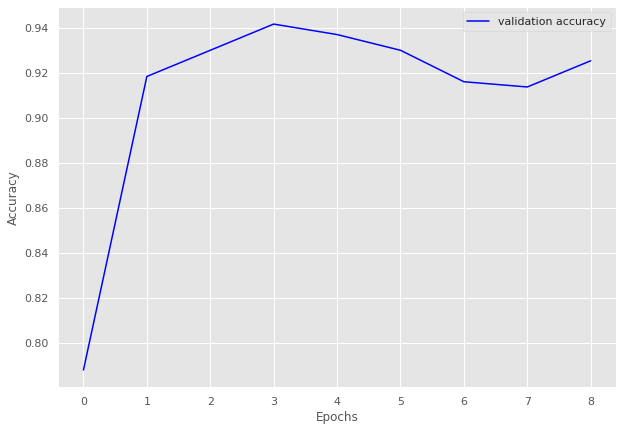

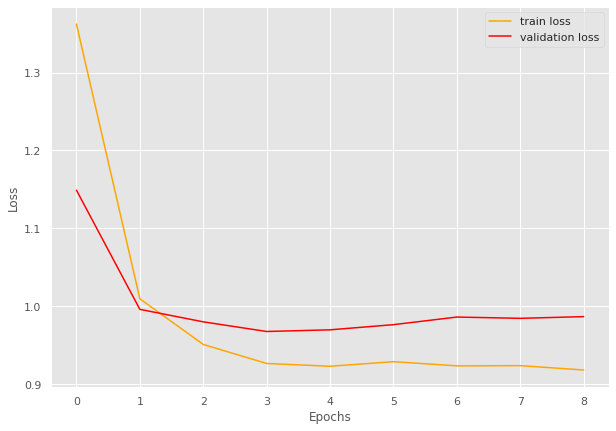

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759}}, 'whole': {}}}
Done training of a fine model with test accuracy 0.9163151449176759
Coarse label 1 Epoch 1
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.81batch/s, loss=1.61]


train loss 1.6130625406901042, validation loss 1.47026789188385, validation accuracy 0.7741935483870968
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.98batch/s, loss=1.23]


train loss 1.2341824968655903, validation loss 1.241779088973999, validation accuracy 0.8655913978494624
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.94batch/s, loss=1.11]


train loss 1.1118128498395283, validation loss 1.1684462626775105, validation accuracy 0.9086021505376344
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  3.00batch/s, loss=1.08]


train loss 1.0791760087013245, validation loss 1.1415669918060303, validation accuracy 0.9193548387096774
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  3.00batch/s, loss=1.06]


train loss 1.0579899946848552, validation loss 1.1219582557678223, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.81batch/s, loss=1.05]


train loss 1.0523701508839924, validation loss 1.1137242714564006, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 6/6 [00:01<00:00,  3.01batch/s, loss=1.05]


train loss 1.0464269916216533, validation loss 1.1100034316380818, validation accuracy 0.946236559139785
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.98batch/s, loss=1.05]


train loss 1.046039382616679, validation loss 1.1069542566935222, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.04]


train loss 1.044701059659322, validation loss 1.1045407851537068, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.93batch/s, loss=1.04]


train loss 1.0444232026735942, validation loss 1.102912425994873, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.97batch/s, loss=1.04]


train loss 1.0442343552907307, validation loss 1.1019725402196248, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 12
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  3.00batch/s, loss=1.04]


train loss 1.0440257787704468, validation loss 1.1010027726491292, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 13
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.98batch/s, loss=1.04]


train loss 1.0439769824345906, validation loss 1.1004566351572673, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 14
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.96batch/s, loss=1.04]


train loss 1.0442642370859783, validation loss 1.1003129482269287, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 15
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.98batch/s, loss=1.04]


INFO: Early stopping counter 1 of 5
train loss 1.0440396070480347, validation loss 1.1009835799535115, validation accuracy 0.946236559139785
Coarse label 1 Epoch 16
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.98batch/s, loss=1.04]


train loss 1.0440444151560466, validation loss 1.0994717280069988, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 17
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.98batch/s, loss=1.04]


INFO: Early stopping counter 2 of 5
train loss 1.0439355969429016, validation loss 1.1002524693806965, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 18
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.90batch/s, loss=1.04]


INFO: Early stopping counter 3 of 5
train loss 1.043895184993744, validation loss 1.100381334622701, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 19
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.95batch/s, loss=1.04]


INFO: Early stopping counter 4 of 5
train loss 1.0439687569936116, validation loss 1.100165605545044, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 20
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.04]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9299781181619255 and loss 1.1192972302436828


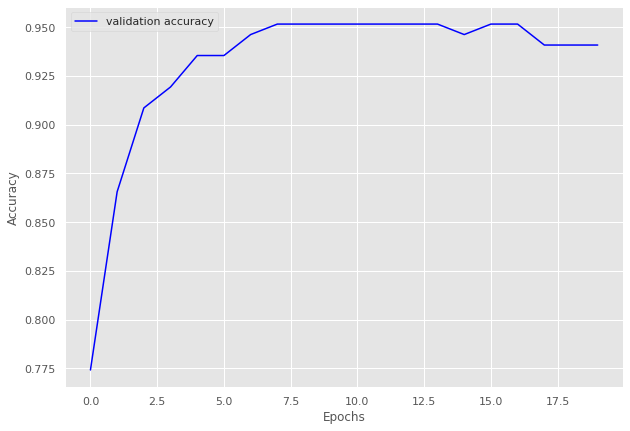

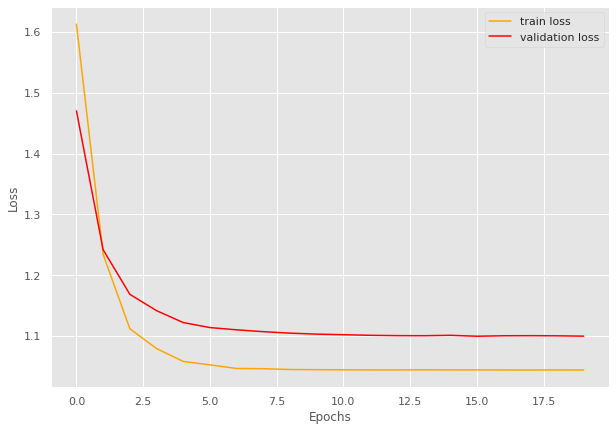

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255}}, 'whole': {}}}
Done training of a fine model with test accuracy 0.9299781181619255
Coarse label 2 Epoch 1
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.80batch/s, loss=1.94]


train loss 1.935673645564488, validation loss 1.7667351450238908, validation accuracy 0.728735632183908
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.89batch/s, loss=1.68]


train loss 1.6819840584482466, validation loss 1.6308868527412415, validation accuracy 0.8586206896551725
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=1.55]


train loss 1.5541181308882577, validation loss 1.568162739276886, validation accuracy 0.9
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=1.52]


train loss 1.51753426023892, validation loss 1.5680601767131261, validation accuracy 0.8977011494252873
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.5] 


train loss 1.5021909645625524, validation loss 1.5556506940296717, validation accuracy 0.9137931034482759
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=1.49]


train loss 1.4901006392070226, validation loss 1.5483944075448173, validation accuracy 0.9137931034482759
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4932374443326677, validation loss 1.5708250403404236, validation accuracy 0.8988505747126436
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.94batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4906947825636183, validation loss 1.5528566241264343, validation accuracy 0.9149425287356322
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.4943221083709173, validation loss 1.5559855273791723, validation accuracy 0.9149425287356322
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4792104278291975, validation loss 1.5619105015482222, validation accuracy 0.9011494252873563
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.00batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9183605017776884 and loss 1.5460786123644128


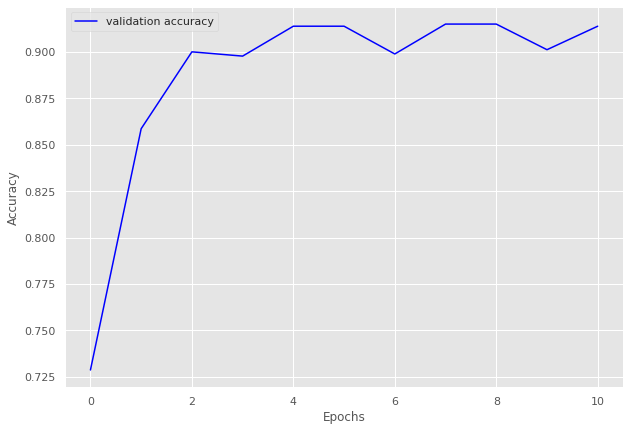

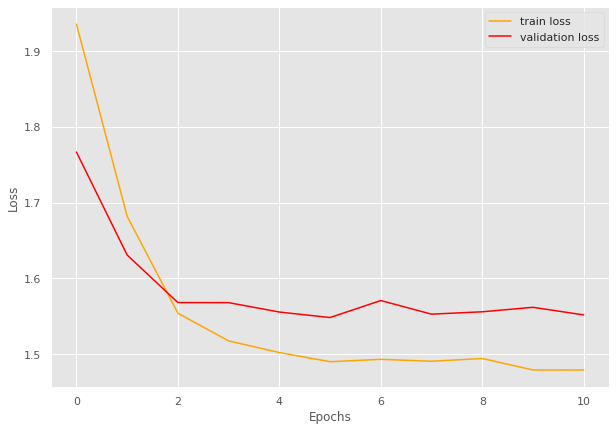

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884}}, 'whole': {}}}
Done training of a fine model with test accuracy 0.9183605017776884
Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.83batch/s, loss=1.55]


train loss 1.5499980724774873, validation loss 1.3399557897022791, validation accuracy 0.7766990291262136
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.68batch/s, loss=1.2] 


train loss 1.199278501363901, validation loss 1.2295590128217424, validation accuracy 0.8228155339805825
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.99batch/s, loss=1.11]


train loss 1.1057483966533954, validation loss 1.1848378011158534, validation accuracy 0.8689320388349514
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.99batch/s, loss=1.08]


train loss 1.0757829684477587, validation loss 1.1622791971479143, validation accuracy 0.8932038834951457
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.88batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0628746014374952, validation loss 1.1686340740748815, validation accuracy 0.8932038834951457
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0563568885509784, validation loss 1.1671267066683089, validation accuracy 0.8907766990291263
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.89batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0570086607566247, validation loss 1.1710758890424455, validation accuracy 0.883495145631068
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.98batch/s, loss=1.05]


train loss 1.051543061549847, validation loss 1.1619505711964198, validation accuracy 0.8932038834951457
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.88batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0619762402314405, validation loss 1.16708162852696, validation accuracy 0.8810679611650486
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  3.00batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9141557703240477 and loss 1.1338957526467064


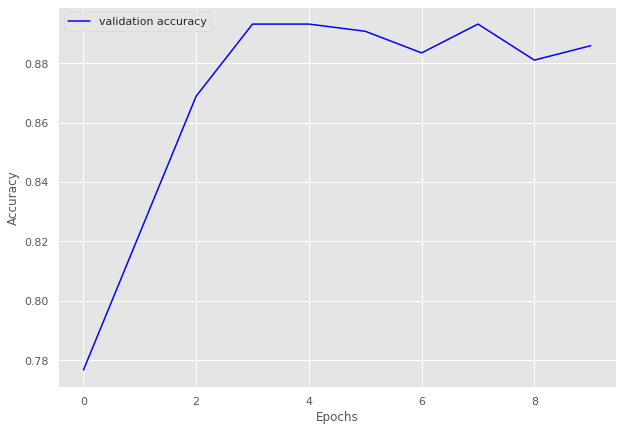

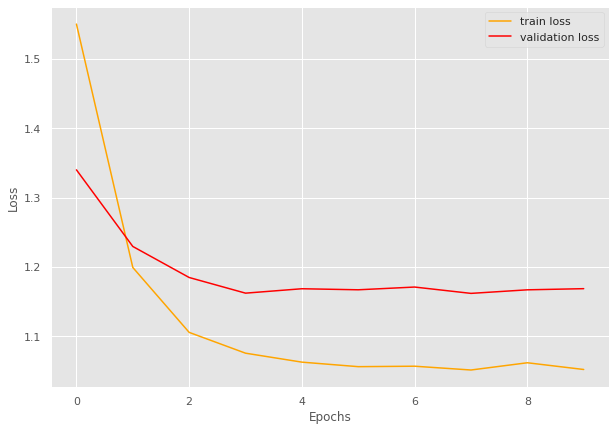

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477}}, 'whole': {}}}
Done training of a fine model with test accuracy 0.9141557703240477
Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.74batch/s, loss=0.517]


train loss 0.5170598745346069, validation loss 0.42862747112909955, validation accuracy 0.9371069182389937
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.93batch/s, loss=0.34] 


train loss 0.34035043716430663, validation loss 0.35417336225509644, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.95batch/s, loss=0.323]


train loss 0.3227540671825409, validation loss 0.33696249127388, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.94batch/s, loss=0.315]


train loss 0.3148740231990814, validation loss 0.33060043056805927, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.94batch/s, loss=0.314]


INFO: Early stopping counter 1 of 5
train loss 0.3136649429798126, validation loss 0.3350149194399516, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.92batch/s, loss=0.314]


INFO: Early stopping counter 2 of 5
train loss 0.31371297836303713, validation loss 0.3375542064507802, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.73batch/s, loss=0.314]


INFO: Early stopping counter 3 of 5
train loss 0.31383894085884095, validation loss 0.33701249957084656, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.96batch/s, loss=0.313]


INFO: Early stopping counter 4 of 5
train loss 0.3134606719017029, validation loss 0.33706050117810565, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.96batch/s, loss=0.313]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.957658321060383 and loss 0.3539817859960157


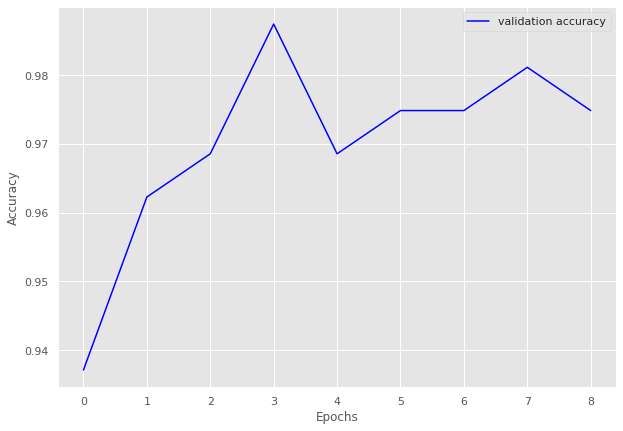

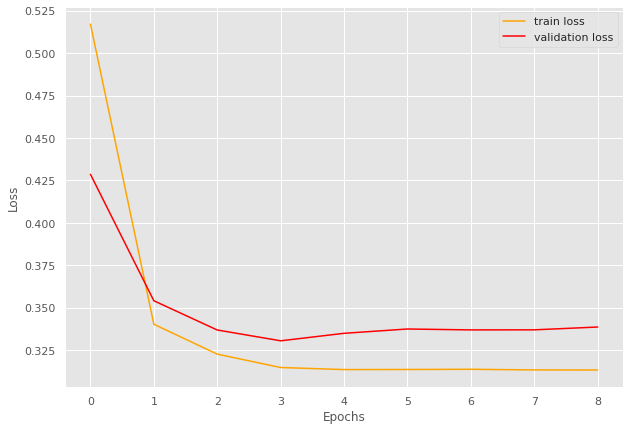

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383}}, 'whole': {}}}
Done training of a fine model with test accuracy 0.957658321060383
Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.89batch/s, loss=1.62]


train loss 1.624579620361328, validation loss 1.3656984567642212, validation accuracy 0.8275862068965517
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.02batch/s, loss=1.3] 


train loss 1.3008126020431519, validation loss 1.2860129475593567, validation accuracy 0.8685344827586207
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.02batch/s, loss=1.23]


train loss 1.225627342859904, validation loss 1.2613218128681183, validation accuracy 0.9051724137931034
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.99batch/s, loss=1.21]


INFO: Early stopping counter 1 of 5
train loss 1.2057289759318033, validation loss 1.2640248835086823, validation accuracy 0.9051724137931034
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.03batch/s, loss=1.19]


train loss 1.1936853965123495, validation loss 1.2577190697193146, validation accuracy 0.9073275862068966
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.01batch/s, loss=1.19]


train loss 1.1870458761850993, validation loss 1.243831992149353, validation accuracy 0.9202586206896551
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.94batch/s, loss=1.18]


INFO: Early stopping counter 2 of 5
train loss 1.1827719688415528, validation loss 1.2440780848264694, validation accuracy 0.9224137931034483
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.03batch/s, loss=1.18]


INFO: Early stopping counter 3 of 5
train loss 1.1779820839564006, validation loss 1.2481256574392319, validation accuracy 0.9181034482758621
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.03batch/s, loss=1.18]


INFO: Early stopping counter 4 of 5
train loss 1.181207577387492, validation loss 1.2632806301116943, validation accuracy 0.8987068965517241
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.94batch/s, loss=1.18]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.918745275888133 and loss 1.2482139320373535


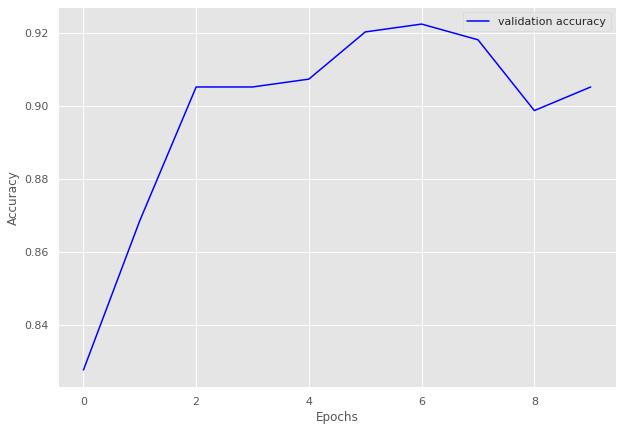

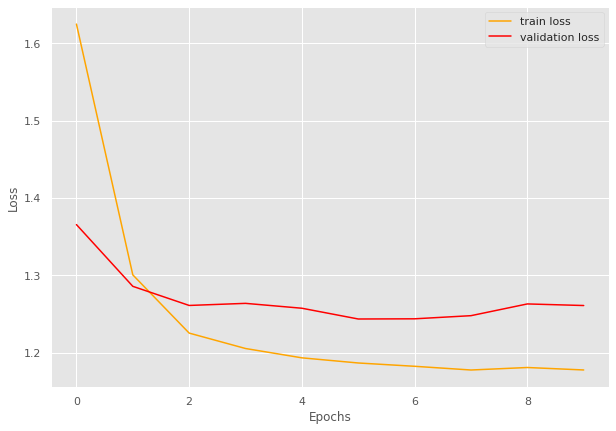

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133}}, 'whole': {}}}
Done training of a fine model with test accuracy 0.918745275888133
Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 12/12 [00:05<00:00,  2.28batch/s, loss=1.1] 


train loss 1.097017635901769, validation loss 0.8513201673825582, validation accuracy 0.9228650137741047
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.97batch/s, loss=0.783]


train loss 0.7832887023687363, validation loss 0.7928580741087595, validation accuracy 0.953168044077135
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 12/12 [00:06<00:00,  1.91batch/s, loss=0.758]


train loss 0.7575232436259588, validation loss 0.7824853261311849, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 12/12 [00:06<00:00,  1.72batch/s, loss=0.75] 


INFO: Early stopping counter 1 of 5
train loss 0.7500273634990057, validation loss 0.7833037277062734, validation accuracy 0.9586776859504132
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 12/12 [00:05<00:00,  2.03batch/s, loss=0.75] 


INFO: Early stopping counter 2 of 5
train loss 0.749886746207873, validation loss 0.782687246799469, validation accuracy 0.9559228650137741
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 12/12 [00:06<00:00,  1.89batch/s, loss=0.746]


train loss 0.7464397251605988, validation loss 0.7800438702106476, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 12/12 [00:07<00:00,  1.57batch/s, loss=0.746]


train loss 0.7457781831423441, validation loss 0.7768455644448599, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 12/12 [00:07<00:00,  1.55batch/s, loss=0.748]


INFO: Early stopping counter 3 of 5
train loss 0.7484010756015778, validation loss 0.7771072884400686, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 12/12 [00:08<00:00,  1.49batch/s, loss=0.748]


INFO: Early stopping counter 4 of 5
train loss 0.747747947772344, validation loss 0.7775463362534841, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 10
-------------------------------


100%|██████████| 12/12 [00:08<00:00,  1.46batch/s, loss=0.744]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9631595881595881 and loss 0.7811499055551023


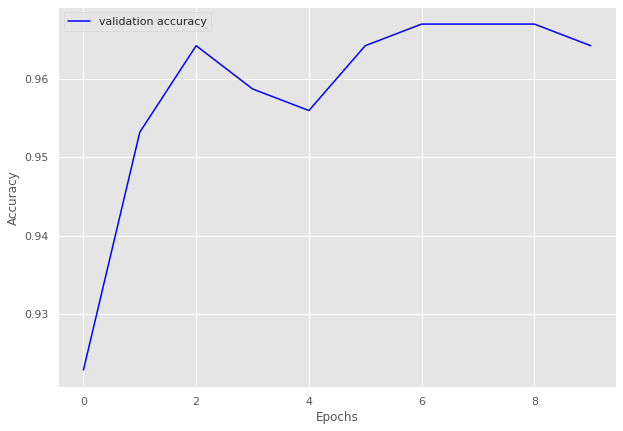

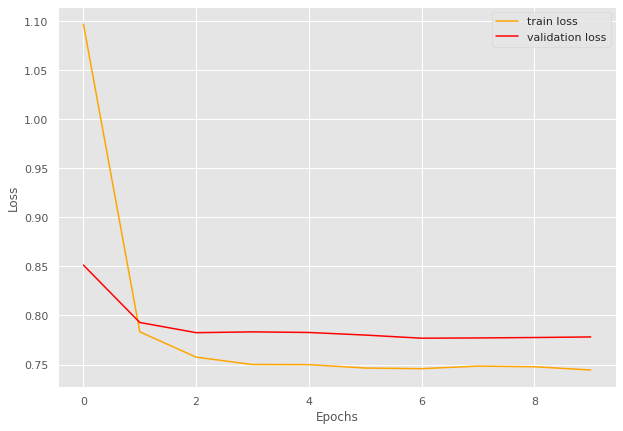

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881}}, 'whole': {}}}
Done training of a fine model with test accuracy 0.9631595881595881
Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 17/17 [00:20<00:00,  1.21s/batch, loss=1.72]


train loss 1.7218538522720337, validation loss 1.420664519071579, validation accuracy 0.776908023483366
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 17/17 [00:14<00:00,  1.14batch/s, loss=1.36]


train loss 1.357866139972911, validation loss 1.2858718633651733, validation accuracy 0.8923679060665362
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 17/17 [00:11<00:00,  1.47batch/s, loss=1.26]


train loss 1.2609475079704733, validation loss 1.2648808658123016, validation accuracy 0.9080234833659491
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 17/17 [00:06<00:00,  2.81batch/s, loss=1.23]


train loss 1.2285904112984152, validation loss 1.2625852823257446, validation accuracy 0.9158512720156555
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.08batch/s, loss=1.23]


INFO: Early stopping counter 1 of 5
train loss 1.2312468921436983, validation loss 1.2650164663791656, validation accuracy 0.9021526418786693
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.09batch/s, loss=1.22]


train loss 1.2222323838402243, validation loss 1.2612225860357285, validation accuracy 0.9060665362035225
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=1.22]


train loss 1.2208362537271835, validation loss 1.2591151148080826, validation accuracy 0.9099804305283757
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.06batch/s, loss=1.21]


train loss 1.2073689769296085, validation loss 1.2585479617118835, validation accuracy 0.913894324853229
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.06batch/s, loss=1.22]


INFO: Early stopping counter 2 of 5
train loss 1.2196439154007856, validation loss 1.2630570083856583, validation accuracy 0.9099804305283757
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=1.22]


INFO: Early stopping counter 3 of 5
train loss 1.2246133439681108, validation loss 1.2678352296352386, validation accuracy 0.9060665362035225
Coarse label 8 Epoch 11
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  2.98batch/s, loss=1.22]


INFO: Early stopping counter 4 of 5
train loss 1.223042978959925, validation loss 1.27281853556633, validation accuracy 0.9001956947162426
Coarse label 8 Epoch 12
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  2.99batch/s, loss=1.22]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9039166284928997 and loss 1.2629608925241624


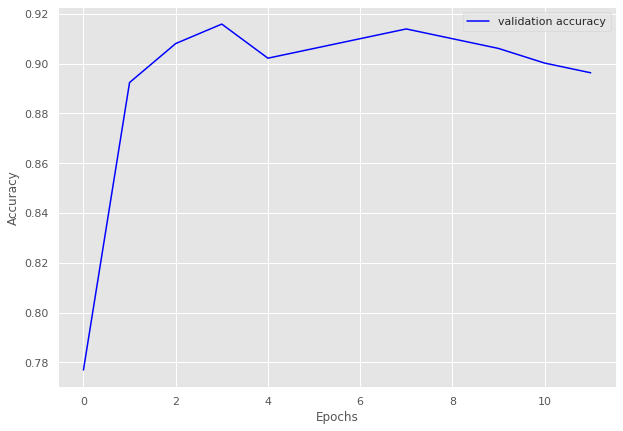

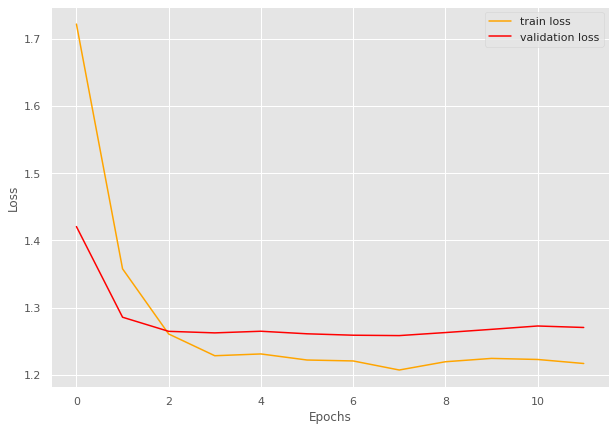

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997}}, 'whole': {}}}
Done training of a fine model with test accuracy 0.9039166284928997
Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.85batch/s, loss=1.92]


train loss 1.9236018373852684, validation loss 1.7207950028506191, validation accuracy 0.816358024691358
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.94batch/s, loss=1.6] 


train loss 1.6012483608155024, validation loss 1.628189737146551, validation accuracy 0.8796296296296297
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 21/21 [00:06<00:00,  3.01batch/s, loss=1.53]


train loss 1.527764291990371, validation loss 1.594205845486034, validation accuracy 0.9135802469135802
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  3.00batch/s, loss=1.5]


train loss 1.4961512769971574, validation loss 1.5851767713373357, validation accuracy 0.9104938271604939
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.98batch/s, loss=1.48]


INFO: Early stopping counter 1 of 5
train loss 1.4830543994903564, validation loss 1.5932425477287986, validation accuracy 0.9027777777777778
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.99batch/s, loss=1.47]


train loss 1.4739546719051542, validation loss 1.5819133520126343, validation accuracy 0.9135802469135802
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.97batch/s, loss=1.47]


train loss 1.4728913193657285, validation loss 1.579353852705522, validation accuracy 0.9120370370370371
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.94batch/s, loss=1.47]


train loss 1.4719514506203788, validation loss 1.575441685589877, validation accuracy 0.9135802469135802
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  3.00batch/s, loss=1.48]


INFO: Early stopping counter 2 of 5
train loss 1.476156575339181, validation loss 1.5762150937860662, validation accuracy 0.9089506172839507
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 21/21 [00:06<00:00,  3.01batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.476000706354777, validation loss 1.587472308765758, validation accuracy 0.9074074074074074
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  3.00batch/s, loss=1.47]


train loss 1.4737270673116047, validation loss 1.5653741034594448, validation accuracy 0.9228395061728395
Coarse label 9 Epoch 12
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.95batch/s, loss=1.49]


train loss 1.485405201003665, validation loss 1.5646272789348254, validation accuracy 0.9290123456790124
Coarse label 9 Epoch 13
-------------------------------


100%|██████████| 21/21 [00:06<00:00,  3.02batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4767267817542666, validation loss 1.5656730261715976, validation accuracy 0.9228395061728395
Coarse label 9 Epoch 14
-------------------------------


100%|██████████| 21/21 [00:06<00:00,  3.02batch/s, loss=1.47]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.912807525325615 and loss 1.5517317490770637


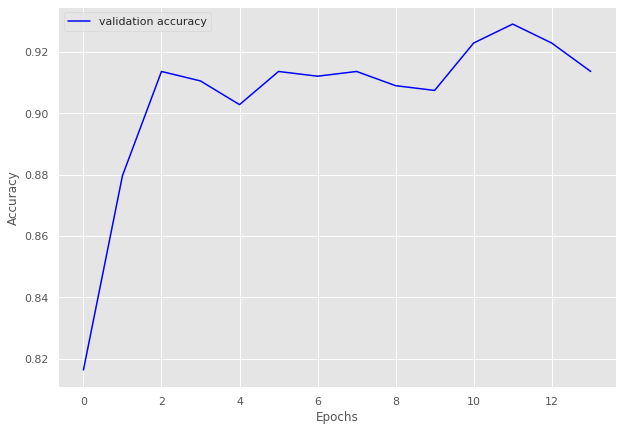

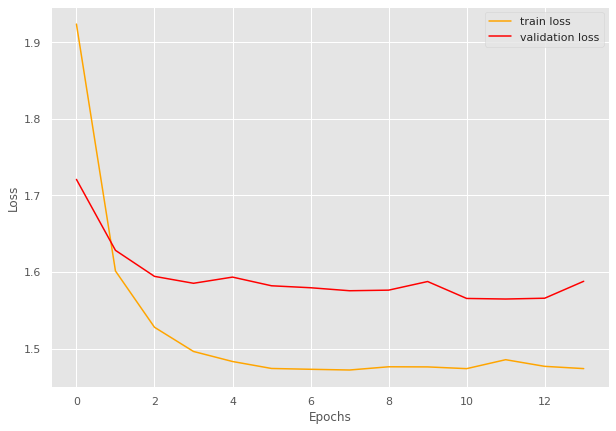

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615}}, 'whole': {}}}
Done training of a fine model with test accuracy 0.912807525325615
Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.91batch/s, loss=1.08]


train loss 1.0844163715839386, validation loss 0.8784165024757385, validation accuracy 0.8947368421052632
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.07batch/s, loss=0.803]


train loss 0.8030902981758118, validation loss 0.8155407309532166, validation accuracy 0.9276315789473685
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.07batch/s, loss=0.764]


train loss 0.7639075219631195, validation loss 0.7977832674980163, validation accuracy 0.9506578947368421
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.08batch/s, loss=0.747]


train loss 0.747136527299881, validation loss 0.7919037342071533, validation accuracy 0.9506578947368421
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.08batch/s, loss=0.745]


train loss 0.7453848123550415, validation loss 0.7912220120429992, validation accuracy 0.9473684210526315
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.07batch/s, loss=0.746]


INFO: Early stopping counter 1 of 5
train loss 0.7462845027446747, validation loss 0.7930096983909607, validation accuracy 0.9539473684210527
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=0.746]


INFO: Early stopping counter 2 of 5
train loss 0.7461945235729217, validation loss 0.7949134349822998, validation accuracy 0.9473684210526315
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.06batch/s, loss=0.747]


INFO: Early stopping counter 3 of 5
train loss 0.7472980797290802, validation loss 0.798980987071991, validation accuracy 0.9407894736842105
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.745]


INFO: Early stopping counter 4 of 5
train loss 0.7447795450687409, validation loss 0.7973505735397339, validation accuracy 0.9473684210526315
Coarse label 11 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.07batch/s, loss=0.746]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9576059850374065 and loss 0.7864108078363465


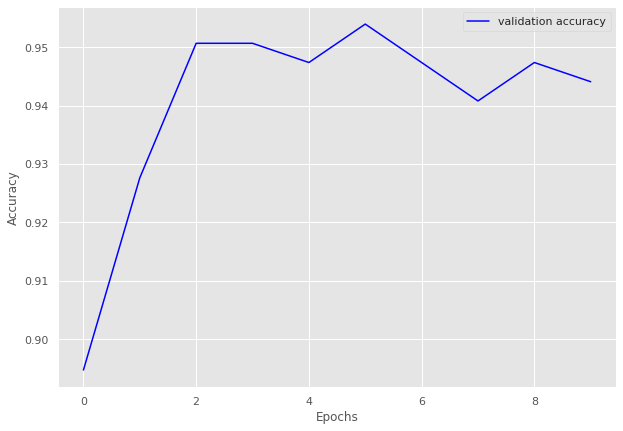

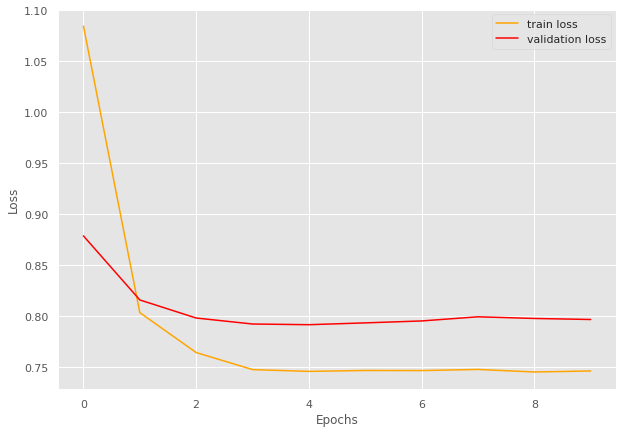

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065}}, 'whole': {}}}
Done training of a fine model with test accuracy 0.9576059850374065
Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=1.63]


train loss 1.6323085188865663, validation loss 1.491291356086731, validation accuracy 0.6241379310344828
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.25batch/s, loss=1.29]


train loss 1.2882601141929626, validation loss 1.3093258380889892, validation accuracy 0.7724137931034483
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.24batch/s, loss=1.14]


train loss 1.1407827258110046, validation loss 1.230737066268921, validation accuracy 0.8379310344827586
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.20batch/s, loss=1.09]


train loss 1.089381992816925, validation loss 1.1898094415664673, validation accuracy 0.8517241379310345
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.14batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0689451694488525, validation loss 1.1907203197479248, validation accuracy 0.8620689655172413
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.24batch/s, loss=1.06]


train loss 1.062459897994995, validation loss 1.1862331628799438, validation accuracy 0.8620689655172413
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.10batch/s, loss=1.08]


INFO: Early stopping counter 2 of 5
train loss 1.0815232753753663, validation loss 1.2035983085632325, validation accuracy 0.8448275862068966
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.21batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0619794011116028, validation loss 1.202906060218811, validation accuracy 0.8379310344827586
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.13batch/s, loss=1.08]


INFO: Early stopping counter 4 of 5
train loss 1.0769273400306703, validation loss 1.1928641319274902, validation accuracy 0.8655172413793103
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.23batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.8733694561509131 and loss 1.1760781758870833


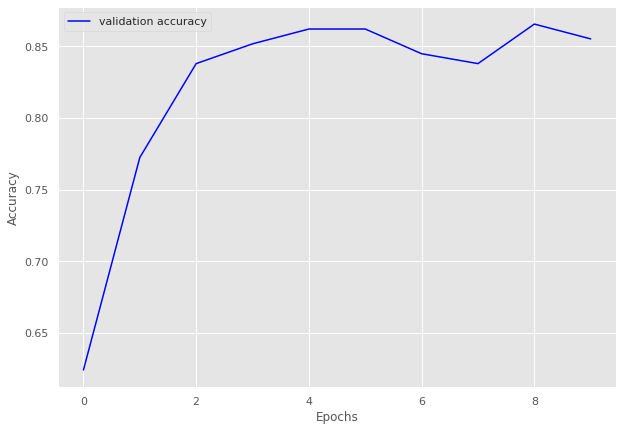

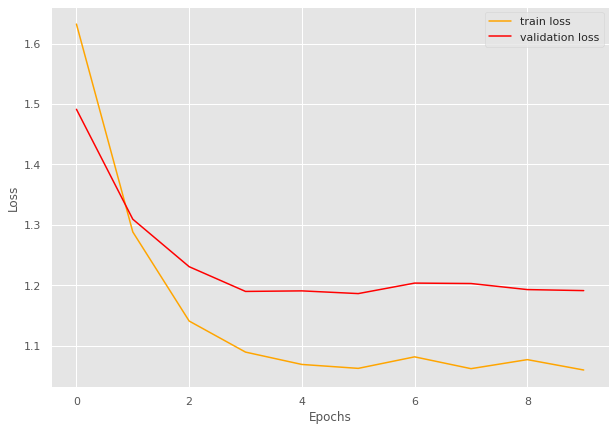

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131}}, 'whole': {}}}
Done training of a fine model with test accuracy 0.8733694561509131
Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.11batch/s, loss=0.847]


train loss 0.8474135398864746, validation loss 0.6590271472930909, validation accuracy 0.9034749034749034
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.28batch/s, loss=0.624]


train loss 0.6238559219572279, validation loss 0.6327459573745727, validation accuracy 0.888030888030888
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.26batch/s, loss=0.583]


train loss 0.5834079186121622, validation loss 0.6209139108657837, validation accuracy 0.9111969111969112
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.20batch/s, loss=0.571]


INFO: Early stopping counter 1 of 5
train loss 0.5713305208418105, validation loss 0.6235475420951844, validation accuracy 0.9073359073359073
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.25batch/s, loss=0.584]


INFO: Early stopping counter 2 of 5
train loss 0.5835258298450046, validation loss 0.6292525410652161, validation accuracy 0.9073359073359073
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.24batch/s, loss=0.579]


INFO: Early stopping counter 3 of 5
train loss 0.5793960359361436, validation loss 0.7156523823738098, validation accuracy 0.8803088803088803
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.28batch/s, loss=0.588]


INFO: Early stopping counter 4 of 5
train loss 0.5879387458165487, validation loss 0.6916624665260315, validation accuracy 0.8803088803088803
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.13batch/s, loss=0.574]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9011759384893713 and loss 0.653062892811639


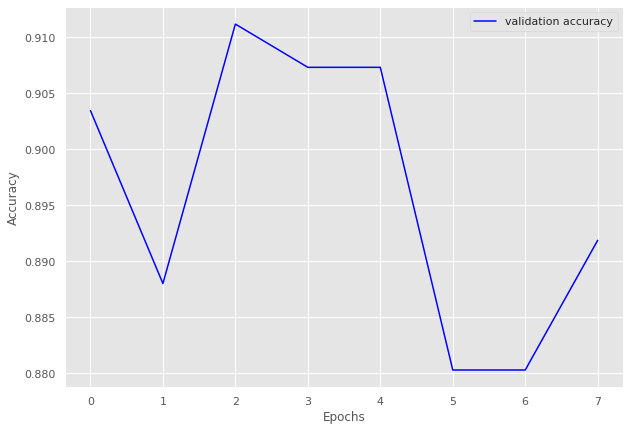

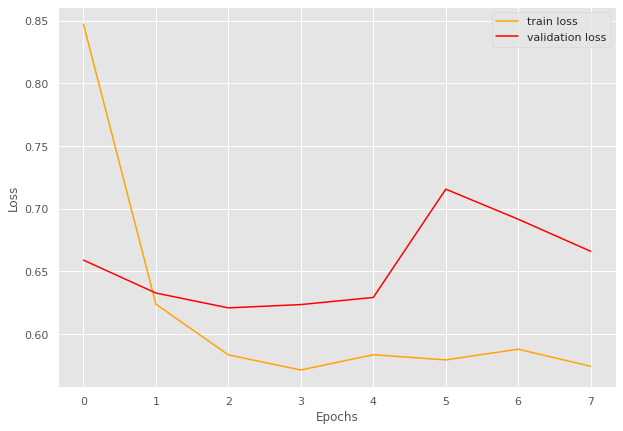

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713}}, 'whole': {}}}
Done training of a fine model with test accuracy 0.9011759384893713
Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.85batch/s, loss=1.41]


train loss 1.4138758684459485, validation loss 1.161363685131073, validation accuracy 0.9074074074074074
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.94batch/s, loss=1.11]


train loss 1.105961981572603, validation loss 1.108998990058899, validation accuracy 0.9377104377104377
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=1.07]


train loss 1.0691856271342228, validation loss 1.1057835936546325, validation accuracy 0.9461279461279462
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.93batch/s, loss=1.06]


train loss 1.0611671962236102, validation loss 1.1029561638832093, validation accuracy 0.9427609427609428
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=1.06]


train loss 1.0563866966649105, validation loss 1.097924292087555, validation accuracy 0.9478114478114478
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=1.06]


train loss 1.0555120204624378, validation loss 1.0967871308326722, validation accuracy 0.9528619528619529
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=1.05]


INFO: Early stopping counter 1 of 5
train loss 1.053243549246537, validation loss 1.1038069128990173, validation accuracy 0.9461279461279462
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.93batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.0537522341075696, validation loss 1.1088325023651122, validation accuracy 0.9427609427609428
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.91batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.049828523083737, validation loss 1.1006105899810792, validation accuracy 0.9478114478114478
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0489017586959035, validation loss 1.1032196044921876, validation accuracy 0.9478114478114478
Coarse label 14 Epoch 11
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.947383978717115 and loss 1.097630428068293


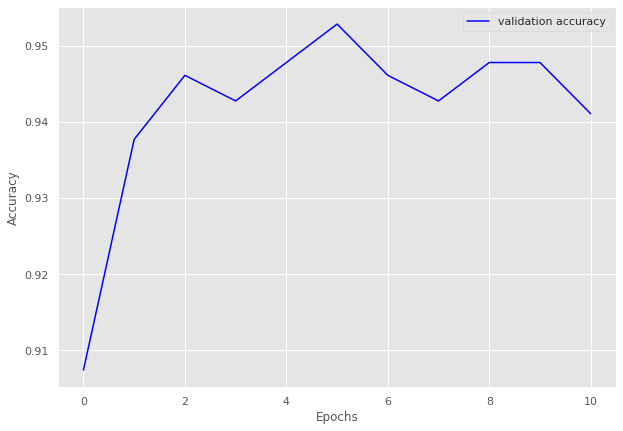

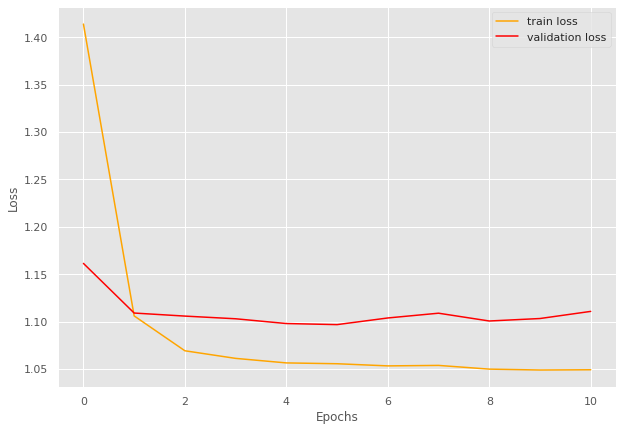

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115}}, 'whole': {}}}
Done training of a fine model with test accuracy 0.947383978717115
Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.03batch/s, loss=1.15]


train loss 1.1479939997196198, validation loss 0.9591695427894592, validation accuracy 0.7789115646258503
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.12batch/s, loss=0.848]


train loss 0.8477823317050934, validation loss 0.8482573628425598, validation accuracy 0.891156462585034
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=0.774]


train loss 0.7736927747726441, validation loss 0.821426510810852, validation accuracy 0.9387755102040817
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.761]


train loss 0.7605770528316498, validation loss 0.8065501928329468, validation accuracy 0.9455782312925171
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.14batch/s, loss=0.75]


INFO: Early stopping counter 1 of 5
train loss 0.7495255887508392, validation loss 0.8106979012489319, validation accuracy 0.9319727891156463
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.755]


train loss 0.7545372605323791, validation loss 0.8006216049194336, validation accuracy 0.9455782312925171
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.762]


train loss 0.7624526739120483, validation loss 0.7953318953514099, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.12batch/s, loss=0.759]


INFO: Early stopping counter 2 of 5
train loss 0.7590758681297303, validation loss 0.8098051071166992, validation accuracy 0.935374149659864
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.15batch/s, loss=0.764]


INFO: Early stopping counter 3 of 5
train loss 0.7635847151279449, validation loss 0.8164822340011597, validation accuracy 0.9217687074829932
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.20batch/s, loss=0.773]


INFO: Early stopping counter 4 of 5
train loss 0.7726631999015808, validation loss 0.8132713556289672, validation accuracy 0.9455782312925171
Coarse label 15 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.755]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9235986435268302 and loss 0.8222739998298355


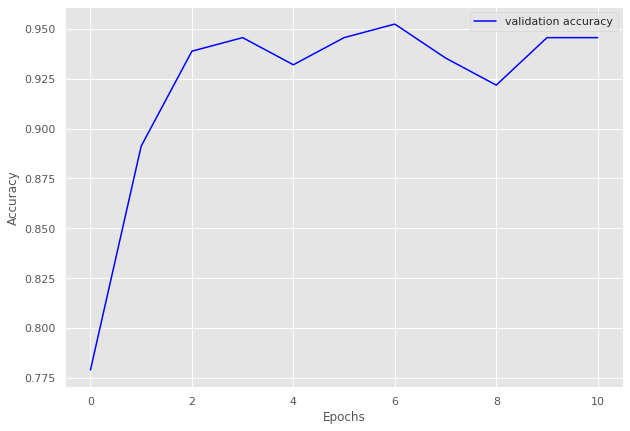

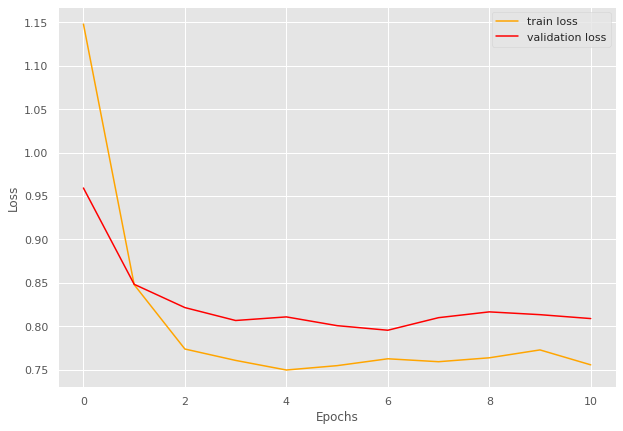

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302}}, 'whole': {}}}
Done training of a fine model with test accuracy 0.9235986435268302
Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.34batch/s, loss=0.865]


train loss 0.8652756015459696, validation loss 0.710876190662384, validation accuracy 0.8794326241134752
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.03batch/s, loss=0.608]


train loss 0.6082183453771803, validation loss 0.6434230089187623, validation accuracy 0.9184397163120568
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.88batch/s, loss=0.567]


train loss 0.5669059620963203, validation loss 0.6101598143577576, validation accuracy 0.9397163120567376
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.99batch/s, loss=0.558]


INFO: Early stopping counter 1 of 5
train loss 0.5579810076289706, validation loss 0.6102133393287659, validation accuracy 0.9397163120567376
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.01batch/s, loss=0.555]


INFO: Early stopping counter 2 of 5
train loss 0.5554224716292487, validation loss 0.6169559955596924, validation accuracy 0.9361702127659575
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.03batch/s, loss=0.556]


train loss 0.5558289686838785, validation loss 0.6095955014228821, validation accuracy 0.9361702127659575
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  3.00batch/s, loss=0.554]


train loss 0.5544051263067458, validation loss 0.6025150299072266, validation accuracy 0.950354609929078
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.86batch/s, loss=0.553]


train loss 0.5532218482759264, validation loss 0.6015751004219055, validation accuracy 0.950354609929078
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.02batch/s, loss=0.556]


INFO: Early stopping counter 3 of 5
train loss 0.5564505921469795, validation loss 0.6019484400749207, validation accuracy 0.9539007092198581
Coarse label 16 Epoch 10
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.90batch/s, loss=0.552]


INFO: Early stopping counter 4 of 5
train loss 0.552099605401357, validation loss 0.6088300704956054, validation accuracy 0.9468085106382979
Coarse label 16 Epoch 11
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.02batch/s, loss=0.554]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9349407607565995 and loss 0.6166666573599765


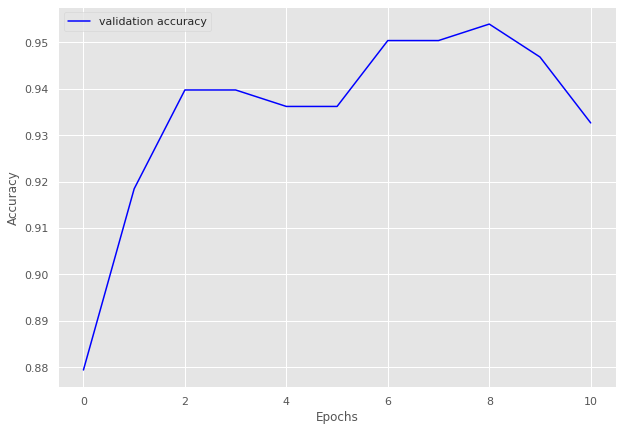

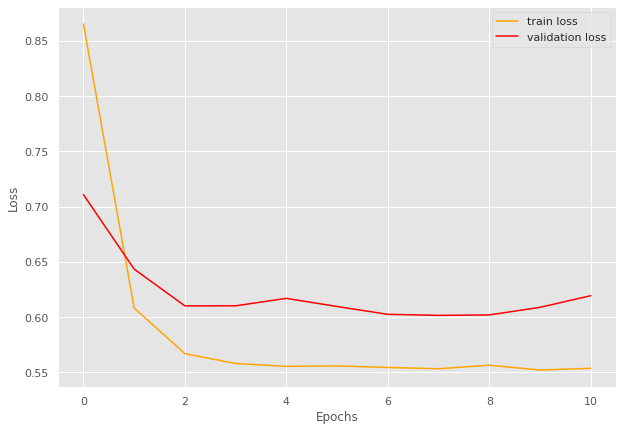

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995}}, 'whole': {}}}
Done training of a fine model with test accuracy 0.9349407607565995
Coarse label 17 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.72batch/s, loss=1.13]


train loss 1.1321404159069062, validation loss 0.9620478987693787, validation accuracy 0.7896440129449838
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.71batch/s, loss=0.856]


train loss 0.8560972332954406, validation loss 0.8974441170692444, validation accuracy 0.86084142394822
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.03batch/s, loss=0.788]


train loss 0.7875816345214843, validation loss 0.8713783740997314, validation accuracy 0.8705501618122977
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.762]


train loss 0.7618194401264191, validation loss 0.8564584732055665, validation accuracy 0.889967637540453
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.753]


train loss 0.7528884172439575, validation loss 0.8563158273696899, validation accuracy 0.8770226537216829
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.95batch/s, loss=0.751]


train loss 0.7509199142456054, validation loss 0.8444419622421264, validation accuracy 0.8964401294498382
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.748]


INFO: Early stopping counter 1 of 5
train loss 0.7482159018516541, validation loss 0.8490845680236816, validation accuracy 0.8932038834951457
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.98batch/s, loss=0.746]


INFO: Early stopping counter 2 of 5
train loss 0.7462392210960388, validation loss 0.8514121770858765, validation accuracy 0.8932038834951457
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=0.748]


INFO: Early stopping counter 3 of 5
train loss 0.7476327538490295, validation loss 0.8523571848869324, validation accuracy 0.8867313915857605
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=0.75]


INFO: Early stopping counter 4 of 5
train loss 0.7495651245117188, validation loss 0.8537195682525635, validation accuracy 0.883495145631068
Coarse label 17 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.92batch/s, loss=0.749]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.8990895295902883 and loss 0.8433913193553327


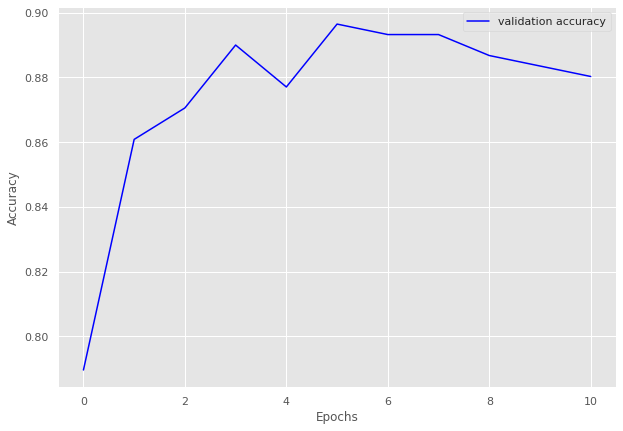

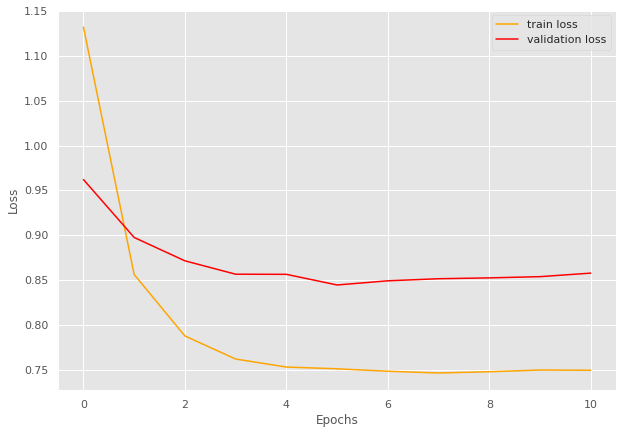

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883}}, 'whole': {}}}
Done training of a fine model with test accuracy 0.8990895295902883
Coarse label 19 Epoch 1
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  2.54batch/s, loss=1.34]


train loss 1.3351437449455261, validation loss 1.2581013441085815, validation accuracy 0.5416666666666666
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.76batch/s, loss=1.08]


train loss 1.0838958770036697, validation loss 1.1289905905723572, validation accuracy 0.7395833333333334
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.77batch/s, loss=0.908]


train loss 0.9084822833538055, validation loss 1.0295448303222656, validation accuracy 0.8020833333333334
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.76batch/s, loss=0.882]


train loss 0.8819692730903625, validation loss 0.9477677941322327, validation accuracy 0.8229166666666666
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.78batch/s, loss=0.825]


train loss 0.8246585577726364, validation loss 0.9239894449710846, validation accuracy 0.8229166666666666
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.80batch/s, loss=0.807]


train loss 0.8070680350065231, validation loss 0.9179675877094269, validation accuracy 0.8229166666666666
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.79batch/s, loss=0.811]


INFO: Early stopping counter 1 of 5
train loss 0.8109266608953476, validation loss 0.9346009790897369, validation accuracy 0.7916666666666666
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.76batch/s, loss=0.864]


INFO: Early stopping counter 2 of 5
train loss 0.8642863780260086, validation loss 0.9341938495635986, validation accuracy 0.78125
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.80batch/s, loss=0.778]


INFO: Early stopping counter 3 of 5
train loss 0.7781970053911209, validation loss 0.9194985330104828, validation accuracy 0.7604166666666666
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.73batch/s, loss=0.768]


train loss 0.7676132917404175, validation loss 0.9048266410827637, validation accuracy 0.8125
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.80batch/s, loss=0.761]


train loss 0.7610861361026764, validation loss 0.8985599875450134, validation accuracy 0.8229166666666666
Coarse label 19 Epoch 12
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.81batch/s, loss=0.809]


train loss 0.8086880594491959, validation loss 0.8980257511138916, validation accuracy 0.7916666666666666
Coarse label 19 Epoch 13
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.79batch/s, loss=0.756]


train loss 0.7559295147657394, validation loss 0.8860385119915009, validation accuracy 0.8333333333333334
Coarse label 19 Epoch 14
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.72batch/s, loss=0.82] 


train loss 0.8204526752233505, validation loss 0.8799418210983276, validation accuracy 0.8333333333333334
Coarse label 19 Epoch 15
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.78batch/s, loss=0.802]


INFO: Early stopping counter 4 of 5
train loss 0.8021453320980072, validation loss 0.8825215399265289, validation accuracy 0.84375
Coarse label 19 Epoch 16
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.79batch/s, loss=0.769]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.829736211031175 and loss 0.9241116179360284


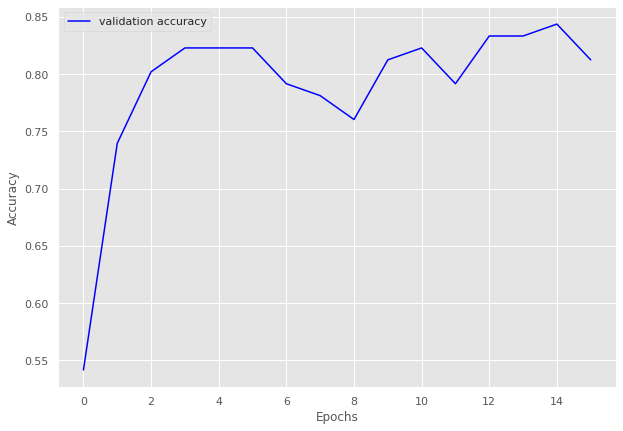

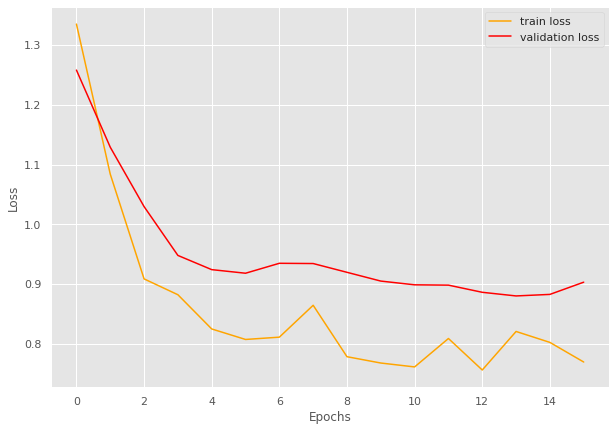

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}}, 'whole': {}}}
Done training of a fine model with test accuracy 0.829736211031175
Starting model evaluation...
Evaluating fine model 0
Evaluating fine model 1
Evaluating fine model 2
Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16
Evaluating fine model 17
Evaluating fine model 19
overall

100%|██████████| 28/28 [00:09<00:00,  3.00batch/s, loss=1.23]


train loss 1.2257274389266968, validation loss 0.9967703478676933, validation accuracy 0.9067599067599068
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=0.999]


train loss 0.9993104296071189, validation loss 0.9805841360773359, validation accuracy 0.9277389277389277
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.03batch/s, loss=0.949]


train loss 0.9491780528000423, validation loss 0.9666881305830819, validation accuracy 0.9440559440559441
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.89batch/s, loss=0.934]


train loss 0.9336676959480558, validation loss 0.9577942320278713, validation accuracy 0.9533799533799534
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.01batch/s, loss=0.937]


INFO: Early stopping counter 1 of 5
train loss 0.9370226860046387, validation loss 0.9581541844776699, validation accuracy 0.951048951048951
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.02batch/s, loss=0.933]


INFO: Early stopping counter 2 of 5
train loss 0.9327792546578816, validation loss 0.960351152079446, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.00batch/s, loss=0.944]


INFO: Early stopping counter 3 of 5
train loss 0.9443156399897167, validation loss 0.9698003956249782, validation accuracy 0.9347319347319347
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.01batch/s, loss=0.931]


INFO: Early stopping counter 4 of 5
train loss 0.9309877859694617, validation loss 0.9601498246192932, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=0.944]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9396977174583591 and loss 0.9637486028905008


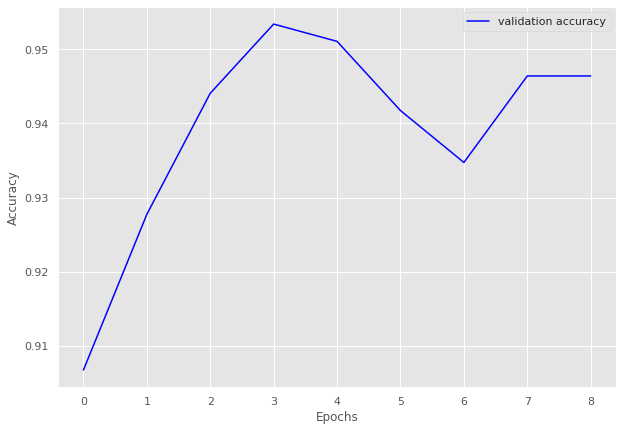

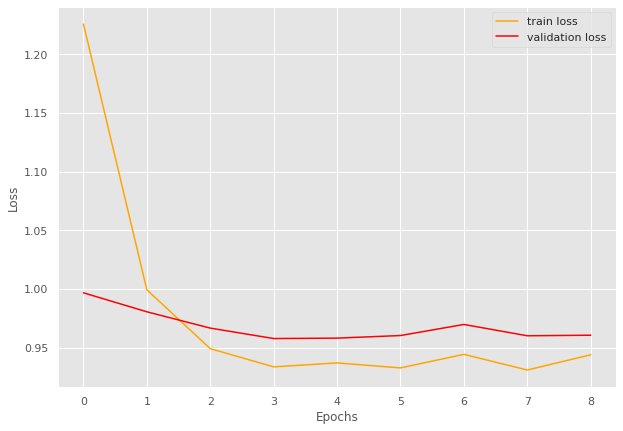

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591}}, 'whole': {'15': 0.7423636109460735}}}
Done training of a fine model with test accuracy 0.9396977174583591
Coarse label 1 Epoch 1
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.94batch/s, loss=1.47]


train loss 1.469275524218877, validation loss 1.2379441261291504, validation accuracy 0.8494623655913979
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.96batch/s, loss=1.14]


train loss 1.1429946720600128, validation loss 1.1319478750228882, validation accuracy 0.9247311827956989
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  3.00batch/s, loss=1.07]


train loss 1.0739716788132985, validation loss 1.1113964319229126, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.97batch/s, loss=1.06]


train loss 1.0566992262999217, validation loss 1.1054577032725017, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.97batch/s, loss=1.05]


train loss 1.0512817402680714, validation loss 1.0977596044540405, validation accuracy 0.946236559139785
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.97batch/s, loss=1.05]


INFO: Early stopping counter 1 of 5
train loss 1.0480240285396576, validation loss 1.1018133163452148, validation accuracy 0.946236559139785
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.98batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.0474960605303447, validation loss 1.1047076781590779, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.99batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0467036763827007, validation loss 1.1042552789052327, validation accuracy 0.946236559139785
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.98batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0496957699457805, validation loss 1.1028871536254883, validation accuracy 0.946236559139785
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.90batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9390934844192634 and loss 1.1086592965655857


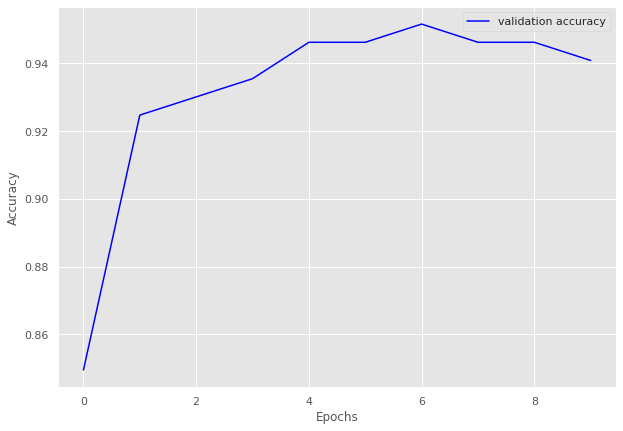

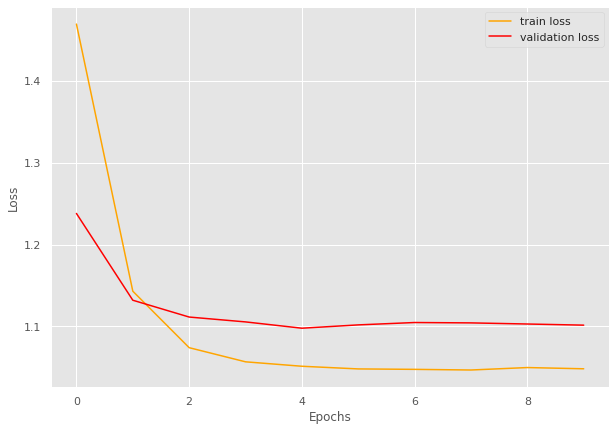

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634}}, 'whole': {'15': 0.7423636109460735}}}
Done training of a fine model with test accuracy 0.9390934844192634
Coarse label 2 Epoch 1
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.92batch/s, loss=1.8] 


train loss 1.7957057714462281, validation loss 1.5839515669005257, validation accuracy 0.9022988505747126
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 55/55 [00:19<00:00,  2.88batch/s, loss=1.56]


train loss 1.559177652272311, validation loss 1.577695097242083, validation accuracy 0.8827586206896552
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.90batch/s, loss=1.53]


train loss 1.5271285100416703, validation loss 1.5489589401653834, validation accuracy 0.9241379310344827
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.94batch/s, loss=1.51]


train loss 1.5127617619254372, validation loss 1.5319280198642187, validation accuracy 0.9321839080459771
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.92batch/s, loss=1.5]


INFO: Early stopping counter 1 of 5
train loss 1.5009207313710993, validation loss 1.540355316230229, validation accuracy 0.9275862068965517
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.92batch/s, loss=1.5] 


train loss 1.49573025486686, validation loss 1.5302289894648962, validation accuracy 0.9356321839080459
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.92batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4892847082831644, validation loss 1.5391995991979326, validation accuracy 0.9241379310344827
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.93batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.489576968279752, validation loss 1.5385428411620004, validation accuracy 0.9264367816091954
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.95batch/s, loss=1.49]


INFO: Early stopping counter 4 of 5
train loss 1.4870101538571445, validation loss 1.5436938830784388, validation accuracy 0.9229885057471264
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.92batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9342305352798054 and loss 1.5290226201409276


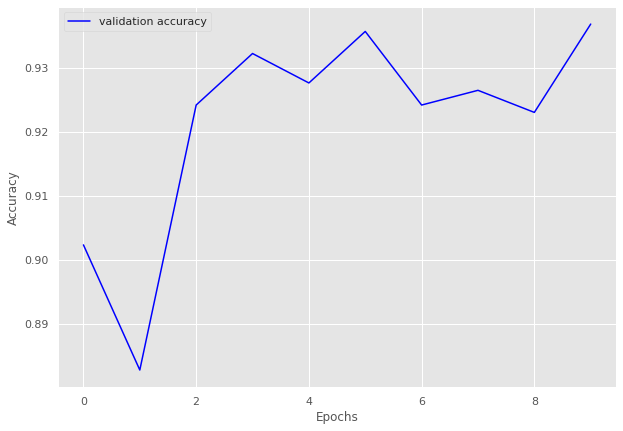

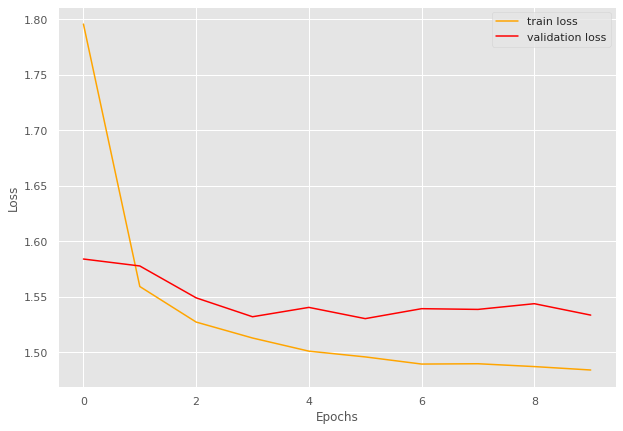

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054}}, 'whole': {'15': 0.7423636109460735}}}
Done training of a fine model with test accuracy 0.9342305352798054
Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.94batch/s, loss=1.41]


train loss 1.412815300317911, validation loss 1.2578640154429845, validation accuracy 0.7815533980582524
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 26/26 [00:13<00:00,  1.87batch/s, loss=1.14]


train loss 1.1383486848611097, validation loss 1.1544503995350428, validation accuracy 0.8907766990291263
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 26/26 [00:14<00:00,  1.74batch/s, loss=1.09]


train loss 1.092021038899055, validation loss 1.1406978879656111, validation accuracy 0.9101941747572816
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 26/26 [00:14<00:00,  1.79batch/s, loss=1.08]


train loss 1.0768863558769226, validation loss 1.132967744554792, validation accuracy 0.9150485436893204
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 26/26 [00:15<00:00,  1.73batch/s, loss=1.07]


train loss 1.0663739717923677, validation loss 1.1290528263364519, validation accuracy 0.9199029126213593
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 26/26 [00:18<00:00,  1.43batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0639301905265222, validation loss 1.1395248004368372, validation accuracy 0.912621359223301
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 26/26 [00:21<00:00,  1.18batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0605228864229643, validation loss 1.1321462903703963, validation accuracy 0.9199029126213593
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 26/26 [00:15<00:00,  1.63batch/s, loss=1.06]


train loss 1.061800649532905, validation loss 1.1227562427520752, validation accuracy 0.9223300970873787
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 26/26 [00:16<00:00,  1.55batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0626977590414195, validation loss 1.1228808164596558, validation accuracy 0.9247572815533981
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 26/26 [00:23<00:00,  1.11batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0563933299137995, validation loss 1.124202745301383, validation accuracy 0.9247572815533981
Coarse label 4 Epoch 11
-------------------------------


100%|██████████| 26/26 [00:20<00:00,  1.27batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9358995007247544 and loss 1.1088379901282641


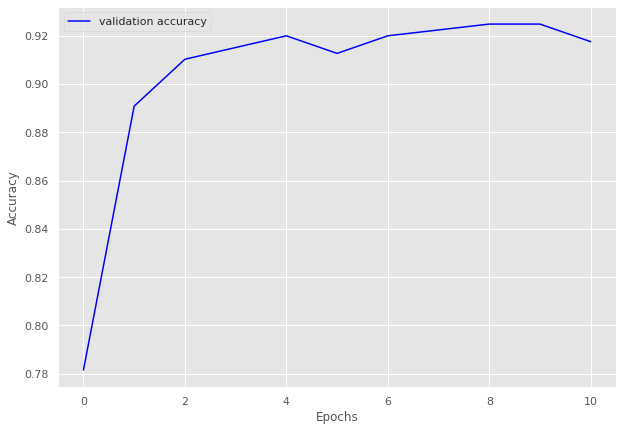

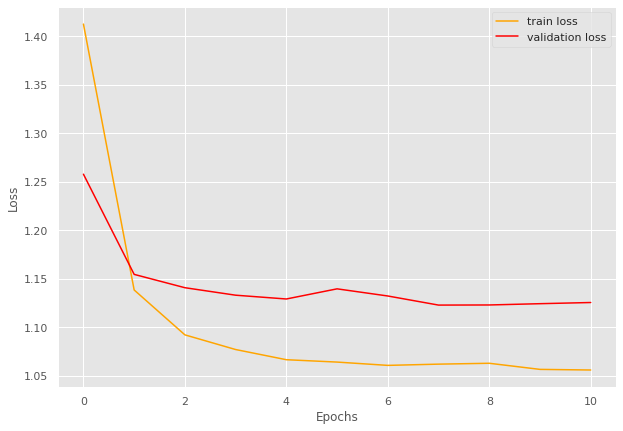

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544}}, 'whole': {'15': 0.7423636109460735}}}
Done training of a fine model with test accuracy 0.9358995007247544
Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.95batch/s, loss=0.47]


train loss 0.4696936130523682, validation loss 0.33535953362782794, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.95batch/s, loss=0.326]


train loss 0.32617533802986143, validation loss 0.3290246327718099, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.95batch/s, loss=0.318]


train loss 0.3177553743124008, validation loss 0.3255850374698639, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.95batch/s, loss=0.316]


train loss 0.31578727066516876, validation loss 0.3225625654061635, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.83batch/s, loss=0.315]


INFO: Early stopping counter 1 of 5
train loss 0.31532024443149564, validation loss 0.3310923178990682, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.95batch/s, loss=0.314]


INFO: Early stopping counter 2 of 5
train loss 0.3137586027383804, validation loss 0.3373294472694397, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.54batch/s, loss=0.316]


INFO: Early stopping counter 3 of 5
train loss 0.31613666415214536, validation loss 0.3319406807422638, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.94batch/s, loss=0.315]


INFO: Early stopping counter 4 of 5
train loss 0.31500623524189, validation loss 0.32370198766390484, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.92batch/s, loss=0.314]


train loss 0.3139499187469482, validation loss 0.3216117521127065, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=0.314]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9724655819774718 and loss 0.33864357675376694


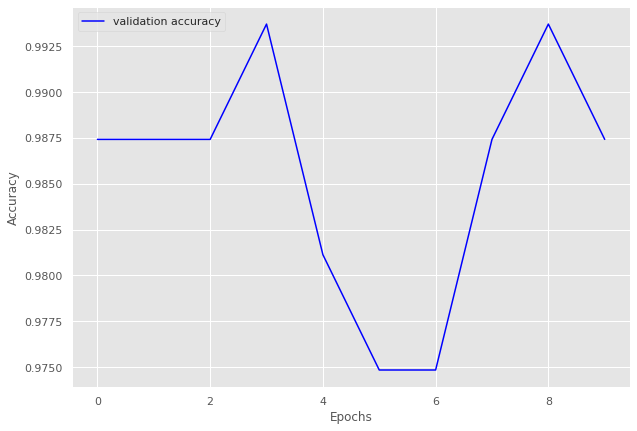

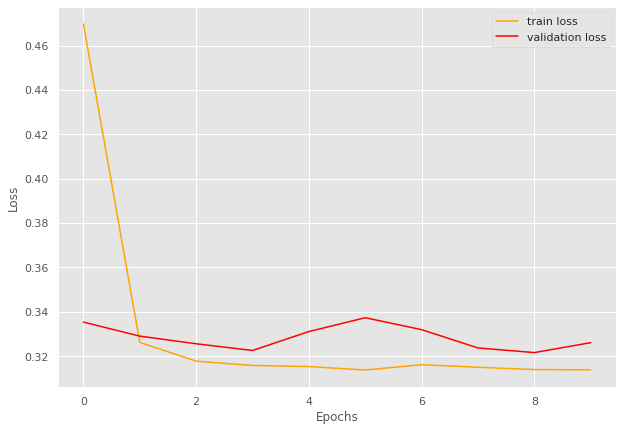

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718}}, 'whole': {'15': 0.7423636109460735}}}
Done training of a fine model with test accuracy 0.9724655819774718
Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.00batch/s, loss=1.47]


train loss 1.4714092135429382, validation loss 1.2683311104774475, validation accuracy 0.896551724137931
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.03batch/s, loss=1.24]


train loss 1.242034629980723, validation loss 1.2587632238864899, validation accuracy 0.9073275862068966
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.84batch/s, loss=1.22]


train loss 1.2179746627807617, validation loss 1.2456710189580917, validation accuracy 0.9181034482758621
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.02batch/s, loss=1.2] 


INFO: Early stopping counter 1 of 5
train loss 1.2045129378636679, validation loss 1.2470834106206894, validation accuracy 0.9116379310344828
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.04batch/s, loss=1.2]


INFO: Early stopping counter 2 of 5
train loss 1.19947061141332, validation loss 1.2564720809459686, validation accuracy 0.9094827586206896
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.04batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1940014918645223, validation loss 1.246667504310608, validation accuracy 0.9116379310344828
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1865825335184732, validation loss 1.2467849999666214, validation accuracy 0.9137931034482759
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.02batch/s, loss=1.19]


train loss 1.1903536359469096, validation loss 1.2421497851610184, validation accuracy 0.9202586206896551
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.21]


train loss 1.20733984708786, validation loss 1.231712207198143, validation accuracy 0.9288793103448276
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=1.2]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9326195574589579 and loss 1.2331897280432962


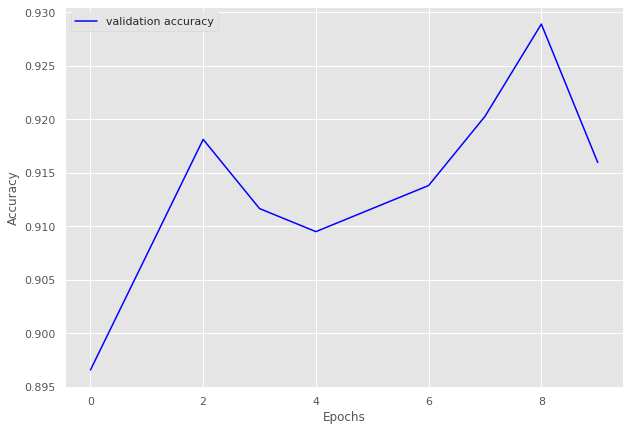

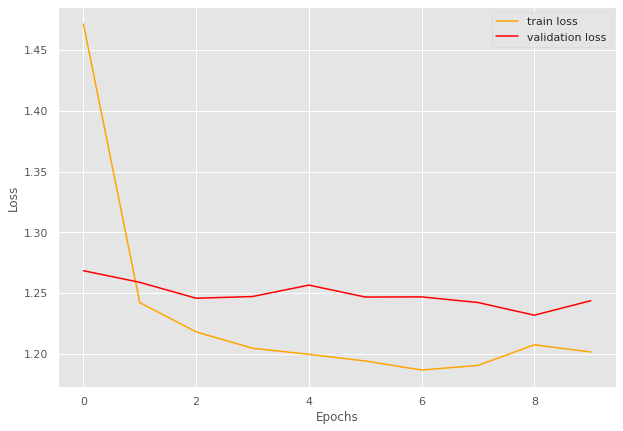

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579}}, 'whole': {'15': 0.7423636109460735}}}
Done training of a fine model with test accuracy 0.9326195574589579
Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.91batch/s, loss=0.945]


train loss 0.9445507759633271, validation loss 0.7882465918858846, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.89batch/s, loss=0.766]


train loss 0.7658871515937473, validation loss 0.7775452236334482, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.89batch/s, loss=0.763]


INFO: Early stopping counter 1 of 5
train loss 0.7627327053443246, validation loss 0.7836686273415884, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.93batch/s, loss=0.759]


INFO: Early stopping counter 2 of 5
train loss 0.7592435427333998, validation loss 0.7890511055787405, validation accuracy 0.953168044077135
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.94batch/s, loss=0.757]


INFO: Early stopping counter 3 of 5
train loss 0.7566510853560074, validation loss 0.7794755299886068, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.93batch/s, loss=0.752]


train loss 0.7524575383766837, validation loss 0.7739211022853851, validation accuracy 0.9724517906336089
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 23/23 [00:08<00:00,  2.75batch/s, loss=0.75] 


train loss 0.7500376494034476, validation loss 0.7713175217310587, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.94batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.750829173171002, validation loss 0.7823956906795502, validation accuracy 0.9586776859504132
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.96batch/s, loss=0.753]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9669948942377826 and loss 0.7766292413999868


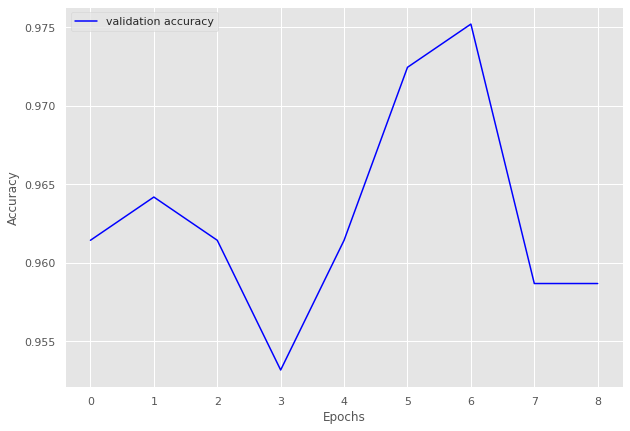

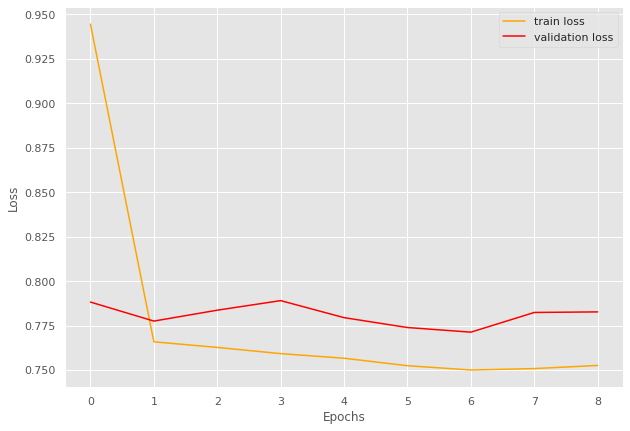

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826}}, 'whole': {'15': 0.7423636109460735}}}
Done training of a fine model with test accuracy 0.9669948942377826
Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.97batch/s, loss=1.55]


train loss 1.5474878079963452, validation loss 1.3317943066358566, validation accuracy 0.837573385518591
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  3.00batch/s, loss=1.27]


train loss 1.2737458077344028, validation loss 1.2816519737243652, validation accuracy 0.8923679060665362
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 33/33 [00:10<00:00,  3.01batch/s, loss=1.22]


train loss 1.2190168518008608, validation loss 1.2671019285917282, validation accuracy 0.9021526418786693
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 33/33 [00:10<00:00,  3.01batch/s, loss=1.21]


INFO: Early stopping counter 1 of 5
train loss 1.2148241599400837, validation loss 1.291604146361351, validation accuracy 0.8786692759295499
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.97batch/s, loss=1.22]


INFO: Early stopping counter 2 of 5
train loss 1.2179715850136497, validation loss 1.2687110006809235, validation accuracy 0.9001956947162426
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.98batch/s, loss=1.21]


INFO: Early stopping counter 3 of 5
train loss 1.2074469111182473, validation loss 1.267211452126503, validation accuracy 0.9001956947162426
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.95batch/s, loss=1.19]


train loss 1.187742287462408, validation loss 1.260843187570572, validation accuracy 0.9060665362035225
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.99batch/s, loss=1.19]


train loss 1.1939125277779319, validation loss 1.2558303326368332, validation accuracy 0.913894324853229
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.96batch/s, loss=1.2] 


INFO: Early stopping counter 4 of 5
train loss 1.19688398549051, validation loss 1.2669399976730347, validation accuracy 0.8962818003913894
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.98batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9084772166688303 and loss 1.2593242826540607


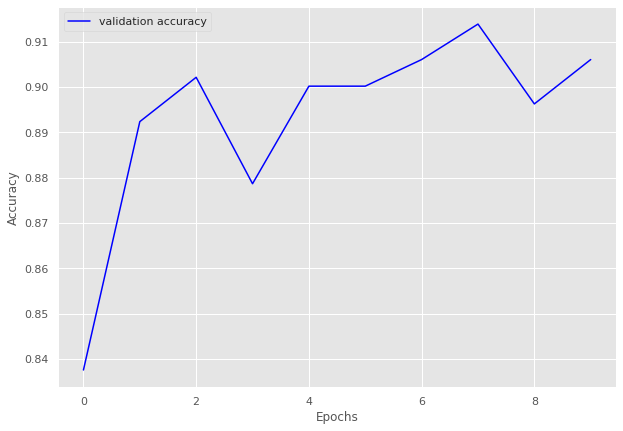

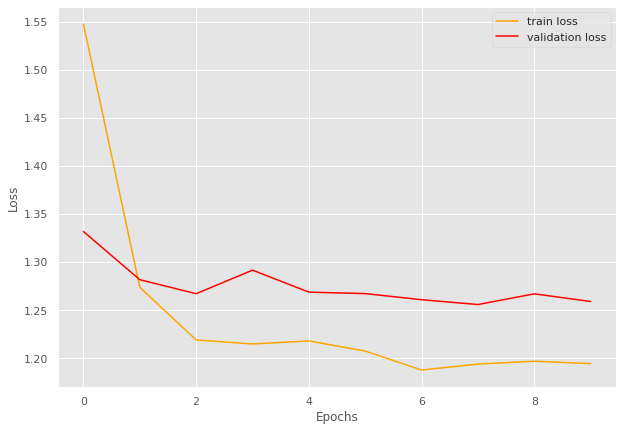

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303}}, 'whole': {'15': 0.7423636109460735}}}
Done training of a fine model with test accuracy 0.9084772166688303
Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.80batch/s, loss=1.78]


train loss 1.781101412889434, validation loss 1.6696974255821921, validation accuracy 0.8441358024691358
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.90batch/s, loss=1.57]


train loss 1.5688002545659134, validation loss 1.5620295567946, validation accuracy 0.9027777777777778
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=1.52]


train loss 1.5153717238728592, validation loss 1.5354860045693137, validation accuracy 0.9212962962962963
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.87batch/s, loss=1.5] 


INFO: Early stopping counter 1 of 5
train loss 1.4964376775229848, validation loss 1.5383194143121892, validation accuracy 0.9305555555555556
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4911630560712117, validation loss 1.5391071818091653, validation accuracy 0.9274691358024691
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=1.49]


train loss 1.4854450167679205, validation loss 1.5308685952966863, validation accuracy 0.9351851851851852
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=1.49]


train loss 1.4879382180004586, validation loss 1.5156395652077415, validation accuracy 0.941358024691358
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4812785852246169, validation loss 1.527385646646673, validation accuracy 0.9367283950617284
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.89batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4823098880488699, validation loss 1.5336365049535579, validation accuracy 0.933641975308642
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9356359536742851 and loss 1.5277234814525429


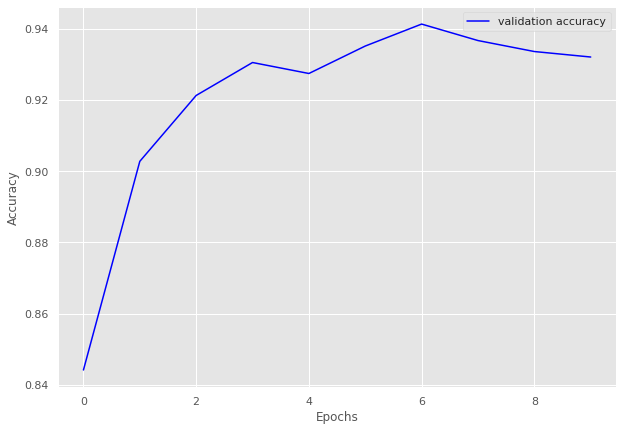

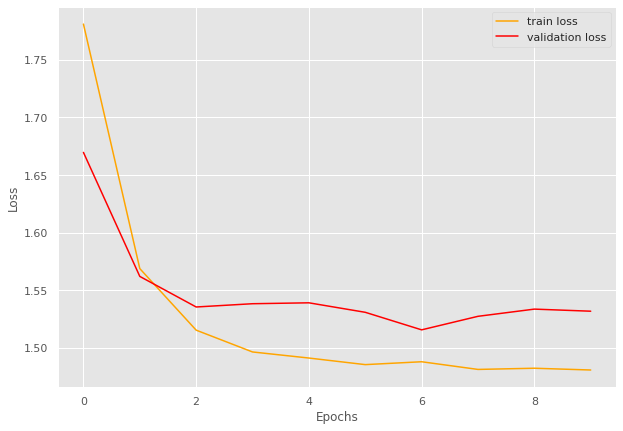

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851}}, 'whole': {'15': 0.7423636109460735}}}
Done training of a fine model with test accuracy 0.9356359536742851
Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.06batch/s, loss=0.966]


train loss 0.9663556665182114, validation loss 0.80106520652771, validation accuracy 0.9506578947368421
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.98batch/s, loss=0.787]


train loss 0.786763659119606, validation loss 0.7907670378684998, validation accuracy 0.9473684210526315
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.07batch/s, loss=0.763]


train loss 0.763378793001175, validation loss 0.7902425646781921, validation accuracy 0.9539473684210527
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.00batch/s, loss=0.755]


train loss 0.754825982451439, validation loss 0.7810400247573852, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.05batch/s, loss=0.755]


train loss 0.7548925995826721, validation loss 0.7771840453147888, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.753]


INFO: Early stopping counter 1 of 5
train loss 0.7528360605239868, validation loss 0.785976767539978, validation accuracy 0.9605263157894737
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.99batch/s, loss=0.753]


INFO: Early stopping counter 2 of 5
train loss 0.752933344244957, validation loss 0.782107663154602, validation accuracy 0.9539473684210527
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.99batch/s, loss=0.752]


INFO: Early stopping counter 3 of 5
train loss 0.7524332284927369, validation loss 0.785210382938385, validation accuracy 0.9506578947368421
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.08batch/s, loss=0.751]


train loss 0.7509265214204788, validation loss 0.7748137354850769, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 10
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.07batch/s, loss=0.749]


INFO: Early stopping counter 4 of 5
train loss 0.7493274420499801, validation loss 0.7763362288475036, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 11
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.04batch/s, loss=0.748]


train loss 0.7483307212591171, validation loss 0.7747393012046814, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 12
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.93batch/s, loss=0.747]


train loss 0.7468811839818954, validation loss 0.7646939635276795, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 13
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.04batch/s, loss=0.746]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9752120026092629 and loss 0.7690419620937772


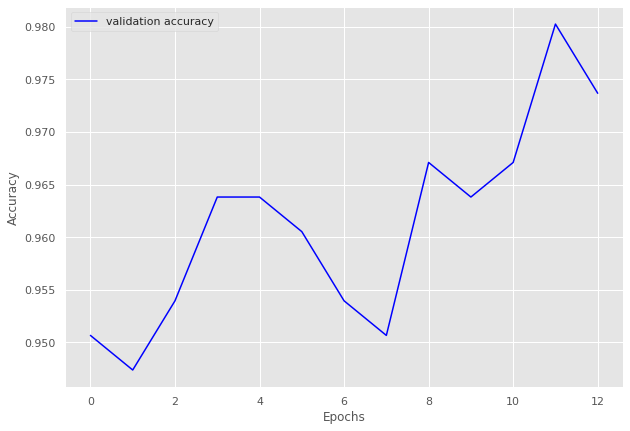

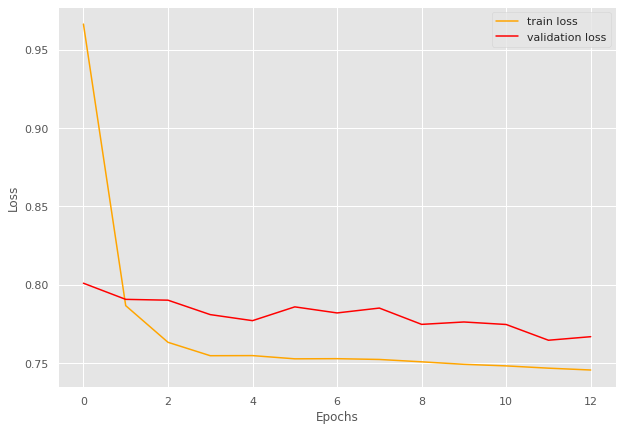

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629}}, 'whole': {'15': 0.7423636109460735}}}
Done training of a fine model with test accuracy 0.9752120026092629
Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=1.5] 


train loss 1.5042363467969393, validation loss 1.257928991317749, validation accuracy 0.8
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.01batch/s, loss=1.17]


train loss 1.1690771893451088, validation loss 1.177265191078186, validation accuracy 0.8586206896551725
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.09batch/s, loss=1.11]


train loss 1.111408835963199, validation loss 1.1629596471786499, validation accuracy 0.8758620689655172
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.03batch/s, loss=1.09]


train loss 1.0886049647080271, validation loss 1.1613860845565795, validation accuracy 0.8655172413793103
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.06batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.076853821152135, validation loss 1.1673246622085571, validation accuracy 0.8689655172413793
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.07]


train loss 1.072542761501513, validation loss 1.1522822618484496, validation accuracy 0.8862068965517241
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0636758992546482, validation loss 1.1640206813812255, validation accuracy 0.8689655172413793
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.05batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0586399279142682, validation loss 1.1552897691726685, validation accuracy 0.8931034482758621
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.01batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0604991159941022, validation loss 1.1544991493225099, validation accuracy 0.8862068965517241
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9176336746302617 and loss 1.1267857292424077


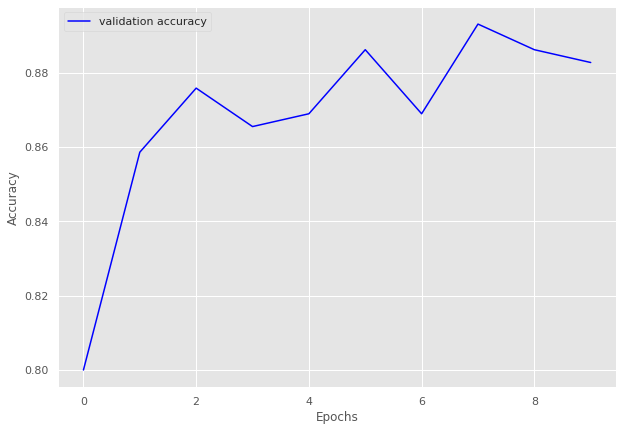

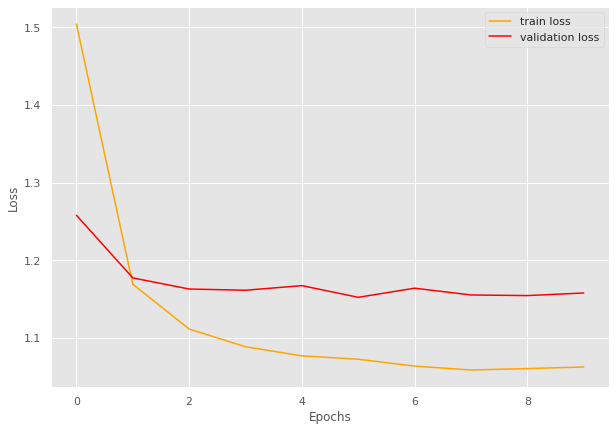

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617}}, 'whole': {'15': 0.7423636109460735}}}
Done training of a fine model with test accuracy 0.9176336746302617
Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  2.94batch/s, loss=0.755]


train loss 0.7546004477669211, validation loss 0.6212414026260376, validation accuracy 0.915057915057915
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.10batch/s, loss=0.604]


train loss 0.6035557319136227, validation loss 0.6110293745994568, validation accuracy 0.9343629343629344
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.08batch/s, loss=0.585]


train loss 0.5846570765270906, validation loss 0.6087010264396667, validation accuracy 0.9343629343629344
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  2.98batch/s, loss=0.575]


train loss 0.5750415290103239, validation loss 0.6063321948051452, validation accuracy 0.9382239382239382
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.04batch/s, loss=0.573]


train loss 0.572979657089009, validation loss 0.5988602638244629, validation accuracy 0.9420849420849421
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.06batch/s, loss=0.563]


INFO: Early stopping counter 1 of 5
train loss 0.5632868864957024, validation loss 0.6068268179893493, validation accuracy 0.9343629343629344
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  2.98batch/s, loss=0.561]


INFO: Early stopping counter 2 of 5
train loss 0.5605129599571228, validation loss 0.6128495931625366, validation accuracy 0.915057915057915
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.09batch/s, loss=0.564]


INFO: Early stopping counter 3 of 5
train loss 0.5636267697109896, validation loss 0.6119958162307739, validation accuracy 0.9227799227799228
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.10batch/s, loss=0.575]


INFO: Early stopping counter 4 of 5
train loss 0.5750015518244576, validation loss 0.6084486961364746, validation accuracy 0.9343629343629344
Coarse label 13 Epoch 10
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.03batch/s, loss=0.568]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9264291207382722 and loss 0.6230313289360921


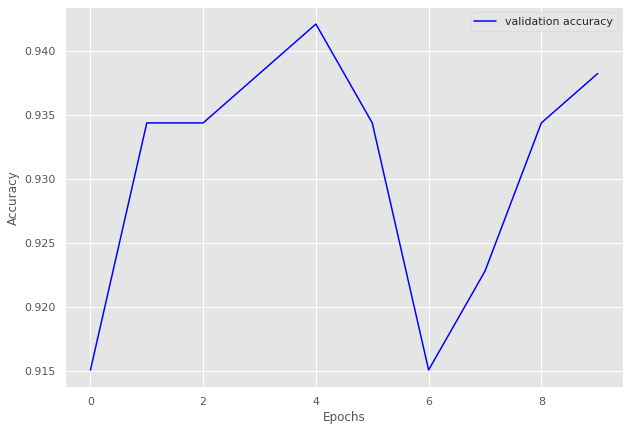

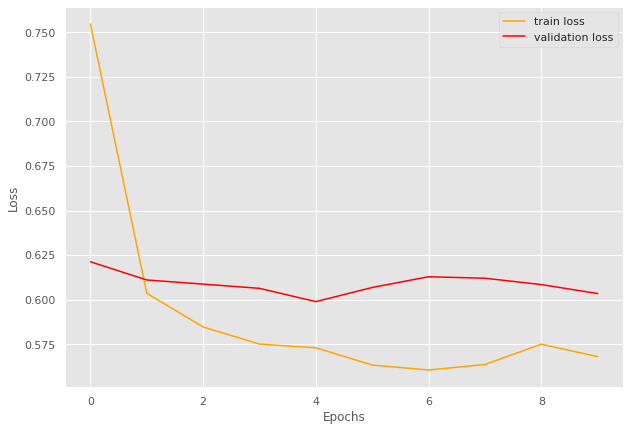

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722}}, 'whole': {'15': 0.7423636109460735}}}
Done training of a fine model with test accuracy 0.9264291207382722
Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  3.00batch/s, loss=1.27]


train loss 1.2680306842452602, validation loss 1.1053268313407898, validation accuracy 0.9377104377104377
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.99batch/s, loss=1.09]


train loss 1.0886708027438114, validation loss 1.1039999127388, validation accuracy 0.9410774410774411
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.93batch/s, loss=1.07]


train loss 1.069602840825131, validation loss 1.090146267414093, validation accuracy 0.9545454545454546
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.98batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0632775237685756, validation loss 1.0995056629180908, validation accuracy 0.9427609427609428
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.94batch/s, loss=1.06]


train loss 1.0621161774585122, validation loss 1.0826664090156555, validation accuracy 0.9629629629629629
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.97batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0636765549057408, validation loss 1.092841911315918, validation accuracy 0.9562289562289562
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.98batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0590668101059764, validation loss 1.091056728363037, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0562784263962193, validation loss 1.0894593954086305, validation accuracy 0.9545454545454546
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9558807103764101 and loss 1.0882363779204232


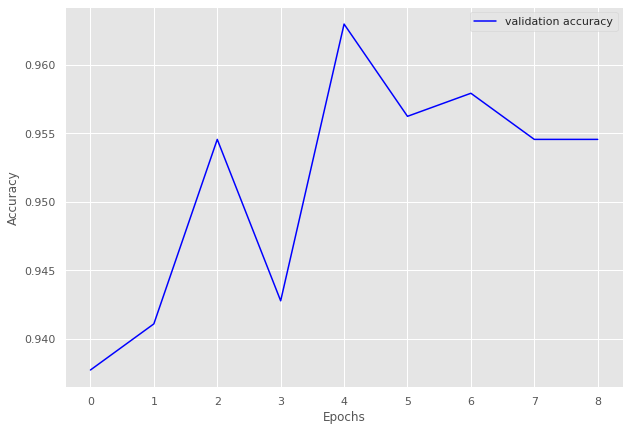

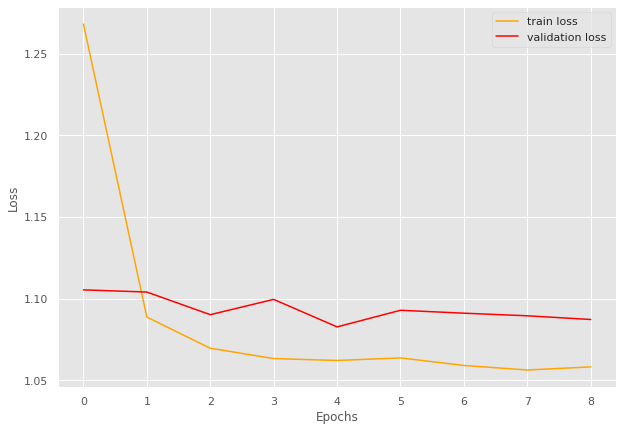

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101}}, 'whole': {'15': 0.7423636109460735}}}
Done training of a fine model with test accuracy 0.9558807103764101
Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.96batch/s, loss=1.01]


train loss 1.008974762339341, validation loss 0.8454097390174866, validation accuracy 0.9047619047619048
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=0.781]


train loss 0.7807659255830866, validation loss 0.7995977759361267, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.94batch/s, loss=0.765]


INFO: Early stopping counter 1 of 5
train loss 0.7645132510285628, validation loss 0.8007938623428345, validation accuracy 0.9387755102040817
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=0.756]


train loss 0.7557977908536008, validation loss 0.7909133434295654, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.01batch/s, loss=0.749]


INFO: Early stopping counter 2 of 5
train loss 0.7492161330423857, validation loss 0.7986968994140625, validation accuracy 0.9455782312925171
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=0.751]


train loss 0.7509383904306512, validation loss 0.781731367111206, validation accuracy 0.9591836734693877
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=0.748]


INFO: Early stopping counter 3 of 5
train loss 0.7478945851325989, validation loss 0.7919740796089172, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=0.748]


INFO: Early stopping counter 4 of 5
train loss 0.7477182808675265, validation loss 0.7888618588447571, validation accuracy 0.95578231292517
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.74batch/s, loss=0.749]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9479990956364458 and loss 0.7965764829090664


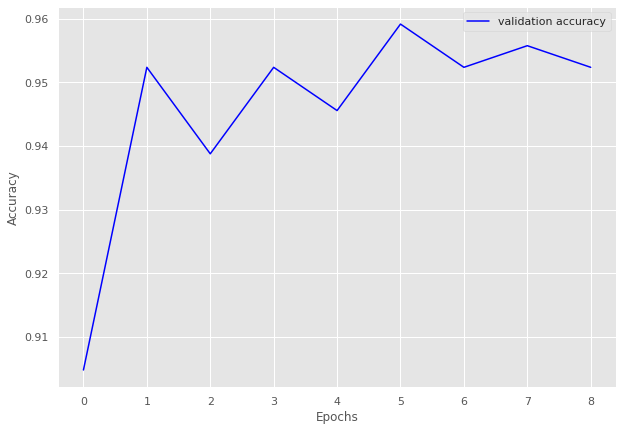

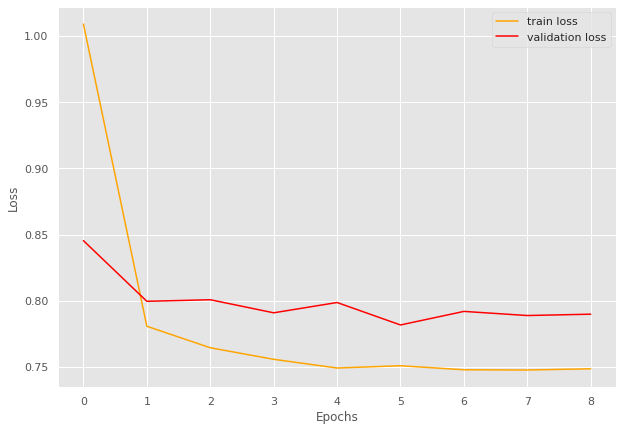

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458}}, 'whole': {'15': 0.7423636109460735}}}
Done training of a fine model with test accuracy 0.9479990956364458
Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.99batch/s, loss=0.762]


train loss 0.7616609003808763, validation loss 0.6268094778060913, validation accuracy 0.9361702127659575
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.99batch/s, loss=0.582]


train loss 0.5816860463884141, validation loss 0.6041266441345214, validation accuracy 0.9468085106382979
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.00batch/s, loss=0.568]


INFO: Early stopping counter 1 of 5
train loss 0.5679573582278358, validation loss 0.6054474353790283, validation accuracy 0.9539007092198581
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.92batch/s, loss=0.56] 


INFO: Early stopping counter 2 of 5
train loss 0.5604031549559699, validation loss 0.6124495744705201, validation accuracy 0.9361702127659575
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.97batch/s, loss=0.559]


INFO: Early stopping counter 3 of 5
train loss 0.559296190738678, validation loss 0.6152484059333801, validation accuracy 0.9326241134751773
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.90batch/s, loss=0.559]


INFO: Early stopping counter 4 of 5
train loss 0.5588182277149625, validation loss 0.6163887858390809, validation accuracy 0.9361702127659575
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.93batch/s, loss=0.562]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9578327444051825 and loss 0.5921077443592584


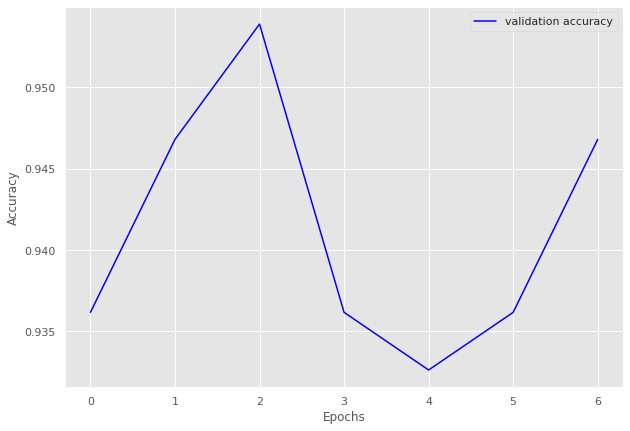

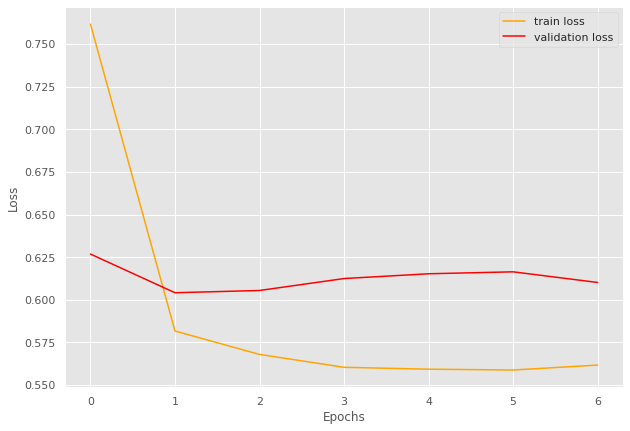

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825}}, 'whole': {'15': 0.7423636109460735}}}
Done training of a fine model with test accuracy 0.9578327444051825
Coarse label 17 Epoch 1
--------------

100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=1.04]


train loss 1.0413534879684447, validation loss 0.8591932415962219, validation accuracy 0.889967637540453
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.815]


train loss 0.8154908418655396, validation loss 0.8193968057632446, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.97batch/s, loss=0.777]


train loss 0.7770354866981506, validation loss 0.8069547414779663, validation accuracy 0.9385113268608414
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.767]


INFO: Early stopping counter 1 of 5
train loss 0.7668287545442581, validation loss 0.8116277694702149, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.767]


train loss 0.7669684559106826, validation loss 0.8068201184272766, validation accuracy 0.9385113268608414
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 20/20 [00:13<00:00,  1.50batch/s, loss=0.76] 


train loss 0.7599779397249222, validation loss 0.7936585783958435, validation accuracy 0.9514563106796117
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 20/20 [00:12<00:00,  1.63batch/s, loss=0.755]


train loss 0.7549121499061584, validation loss 0.7896812200546265, validation accuracy 0.9514563106796117
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 20/20 [00:11<00:00,  1.67batch/s, loss=0.751]


INFO: Early stopping counter 2 of 5
train loss 0.7506447523832321, validation loss 0.7951607584953309, validation accuracy 0.948220064724919
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 20/20 [00:13<00:00,  1.45batch/s, loss=0.75] 


INFO: Early stopping counter 3 of 5
train loss 0.7503325164318084, validation loss 0.7942208886146546, validation accuracy 0.9514563106796117
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 20/20 [00:13<00:00,  1.48batch/s, loss=0.751]


train loss 0.7505154460668564, validation loss 0.7885713100433349, validation accuracy 0.9546925566343042
Coarse label 17 Epoch 11
-------------------------------


100%|██████████| 20/20 [00:17<00:00,  1.16batch/s, loss=0.749]


train loss 0.7493721932172775, validation loss 0.7838762998580933, validation accuracy 0.9611650485436893
Coarse label 17 Epoch 12
-------------------------------


100%|██████████| 20/20 [00:13<00:00,  1.43batch/s, loss=0.751]


train loss 0.7508960515260696, validation loss 0.782853651046753, validation accuracy 0.9644012944983819
Coarse label 17 Epoch 13
-------------------------------


100%|██████████| 20/20 [00:14<00:00,  1.35batch/s, loss=0.754]


INFO: Early stopping counter 4 of 5
train loss 0.754319104552269, validation loss 0.7930485844612122, validation accuracy 0.9546925566343042
Coarse label 17 Epoch 14
-------------------------------


100%|██████████| 20/20 [00:11<00:00,  1.79batch/s, loss=0.753]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.927128116938951 and loss 0.8165676210024585


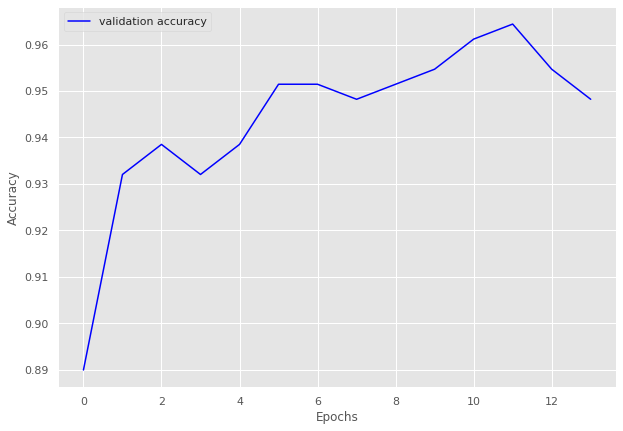

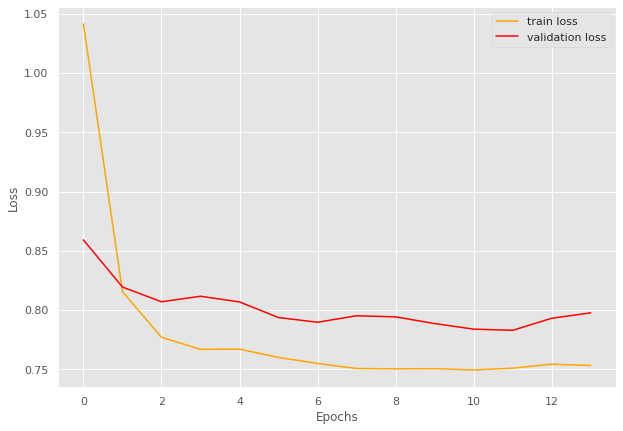

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951}}, 'whole': {'15': 0.7423636109460735}}}
Done training of a fine model with test accuracy 0.927128116938951
Coarse label 1

100%|██████████| 7/7 [00:03<00:00,  2.05batch/s, loss=1.22]


train loss 1.2237641981669836, validation loss 1.141408085823059, validation accuracy 0.6666666666666666
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 7/7 [00:04<00:00,  1.74batch/s, loss=0.93] 


train loss 0.9297991820744106, validation loss 0.9261072278022766, validation accuracy 0.8125
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 7/7 [00:05<00:00,  1.32batch/s, loss=0.82] 


train loss 0.8203805088996887, validation loss 0.8454746603965759, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.36batch/s, loss=0.781]


train loss 0.7806012630462646, validation loss 0.8062267303466797, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.36batch/s, loss=0.77] 


train loss 0.7700746825763157, validation loss 0.7932422459125519, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.33batch/s, loss=0.779]


train loss 0.779037994997842, validation loss 0.7831242978572845, validation accuracy 0.96875
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.36batch/s, loss=0.786]


INFO: Early stopping counter 1 of 5
train loss 0.786023701940264, validation loss 0.7874616384506226, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.15batch/s, loss=0.759]


train loss 0.7587806241852897, validation loss 0.7829490303993225, validation accuracy 0.96875
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.34batch/s, loss=0.756]


INFO: Early stopping counter 2 of 5
train loss 0.7558077488626752, validation loss 0.7858530879020691, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.31batch/s, loss=0.752]


train loss 0.7516873053142002, validation loss 0.7813480198383331, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.15batch/s, loss=0.769]


train loss 0.7687612516539437, validation loss 0.778592437505722, validation accuracy 0.96875
Coarse label 19 Epoch 12
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.35batch/s, loss=0.75] 


train loss 0.7500918933323452, validation loss 0.7772313058376312, validation accuracy 0.96875
Coarse label 19 Epoch 13
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.32batch/s, loss=0.772]


train loss 0.7723756517682757, validation loss 0.7693545520305634, validation accuracy 0.9895833333333334
Coarse label 19 Epoch 14
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.15batch/s, loss=0.775]


INFO: Early stopping counter 3 of 5
train loss 0.7749722940581185, validation loss 0.7767162919044495, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 15
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.37batch/s, loss=0.756]


INFO: Early stopping counter 4 of 5
train loss 0.7559125593730381, validation loss 0.7896323502063751, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 16
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.32batch/s, loss=0.757]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9245923913043478 and loss 0.8233417816784071


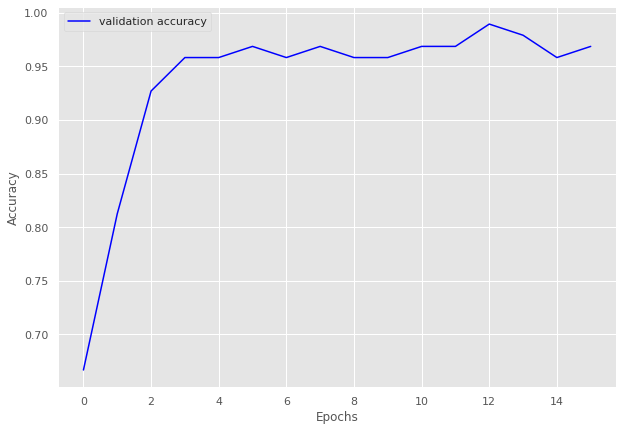

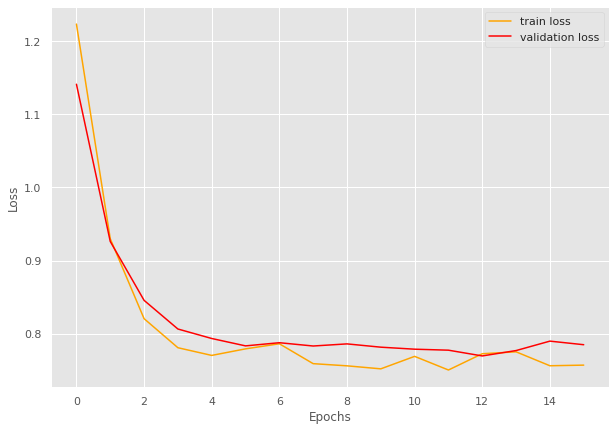

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}}, 'whole': {'15': 0.7423636109460735}}}
Done training of a fine model with test accuracy 0.9245

100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=1.13]


train loss 1.1317954136104118, validation loss 0.974079396043505, validation accuracy 0.9324009324009324
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.90batch/s, loss=0.952]


train loss 0.9523641627009322, validation loss 0.9684685724122184, validation accuracy 0.9370629370629371
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.941]


INFO: Early stopping counter 1 of 5
train loss 0.9412812765051679, validation loss 0.9708842890603202, validation accuracy 0.9277389277389277
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.98batch/s, loss=0.936]


train loss 0.9358187564989415, validation loss 0.9617073365620205, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.96batch/s, loss=0.934]


train loss 0.9341236251156505, validation loss 0.9601801378386361, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.93batch/s, loss=0.932]


train loss 0.9322314189701546, validation loss 0.9477923427309308, validation accuracy 0.9557109557109557
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.932]


INFO: Early stopping counter 2 of 5
train loss 0.9320123355563094, validation loss 0.9499516572271075, validation accuracy 0.9533799533799534
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.97batch/s, loss=0.931]


INFO: Early stopping counter 3 of 5
train loss 0.9308545196928629, validation loss 0.9496127111571175, validation accuracy 0.9533799533799534
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:16<00:00,  2.53batch/s, loss=0.924]


INFO: Early stopping counter 4 of 5
train loss 0.9237554247786359, validation loss 0.9480081285749163, validation accuracy 0.958041958041958
Coarse label 0 Epoch 10
-------------------------------


100%|██████████| 41/41 [00:24<00:00,  1.68batch/s, loss=0.924]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9494661921708185 and loss 0.9539590098641135


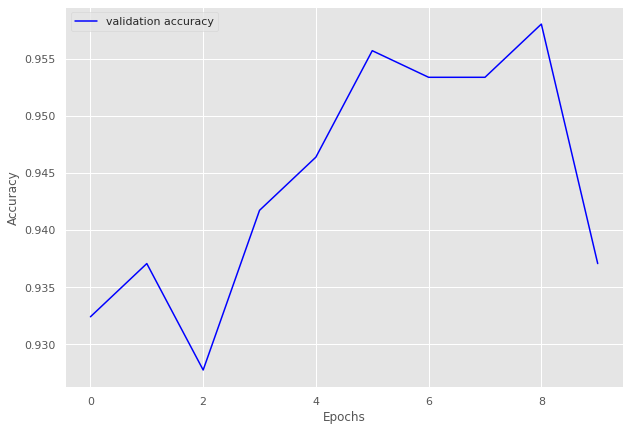

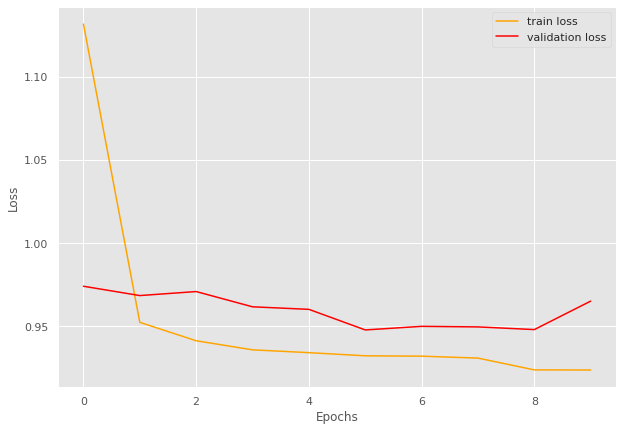

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185}}, 'whole': {'15': 0.7423636109460735, '25': 0.765299453378753}

100%|██████████| 18/18 [00:08<00:00,  2.20batch/s, loss=1.38]


train loss 1.3764646251996357, validation loss 1.1851027806599934, validation accuracy 0.8655913978494624
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 18/18 [00:15<00:00,  1.16batch/s, loss=1.12]


train loss 1.11893626054128, validation loss 1.136185884475708, validation accuracy 0.9139784946236559
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 18/18 [00:11<00:00,  1.54batch/s, loss=1.08]


train loss 1.080062554942237, validation loss 1.1143194834391277, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 18/18 [00:12<00:00,  1.43batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.061264865928226, validation loss 1.1258906523386638, validation accuracy 0.9193548387096774
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 18/18 [00:13<00:00,  1.37batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0558623472849529, validation loss 1.1345911820729573, validation accuracy 0.9086021505376344
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 18/18 [00:11<00:00,  1.50batch/s, loss=1.06]


train loss 1.0585307081540425, validation loss 1.1009204785029094, validation accuracy 0.946236559139785
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 18/18 [00:14<00:00,  1.25batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.054328825738695, validation loss 1.1225602229436238, validation accuracy 0.9193548387096774
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 18/18 [00:16<00:00,  1.09batch/s, loss=1.05]


train loss 1.0530046688185797, validation loss 1.0985213915507, validation accuracy 0.946236559139785
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 18/18 [00:12<00:00,  1.41batch/s, loss=1.05]


train loss 1.0490348007943895, validation loss 1.0899802843729656, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 18/18 [00:10<00:00,  1.75batch/s, loss=1.05]


train loss 1.0465968118773565, validation loss 1.0850543975830078, validation accuracy 0.956989247311828
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.92batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0454064276483324, validation loss 1.0870910088221233, validation accuracy 0.9623655913978495
Coarse label 1 Epoch 12
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.98batch/s, loss=1.04]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9660809154066203 and loss 1.0792666979325123


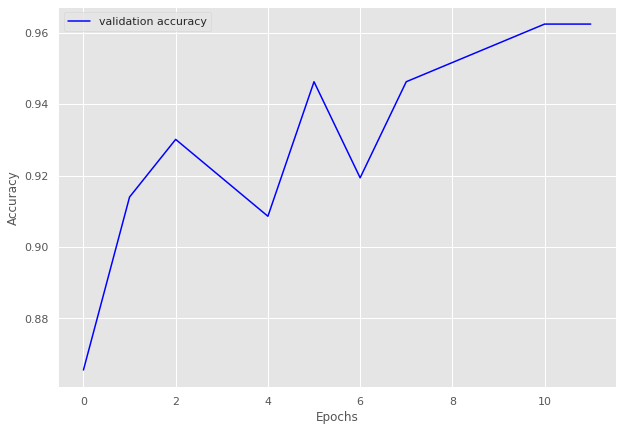

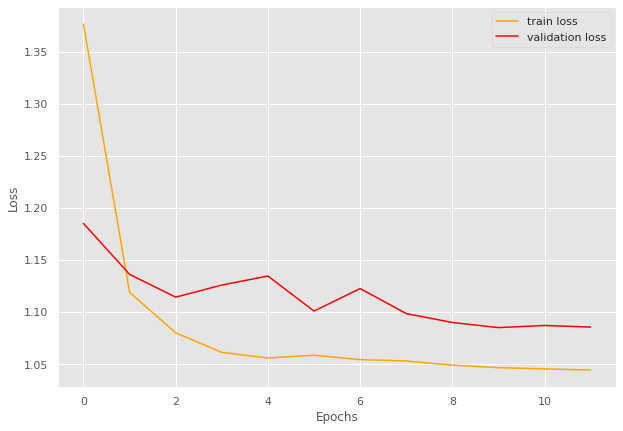

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203}}, 'whole': {'15': 0.7423636109460735,

100%|██████████| 83/83 [00:28<00:00,  2.93batch/s, loss=1.72]


train loss 1.7192596771630897, validation loss 1.548257555280413, validation accuracy 0.9195402298850575
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.95batch/s, loss=1.54]


train loss 1.5422278886818024, validation loss 1.5363238198416573, validation accuracy 0.9287356321839081
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.93batch/s, loss=1.52]


train loss 1.5194788826517311, validation loss 1.5201748694692339, validation accuracy 0.9413793103448276
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.95batch/s, loss=1.51]


INFO: Early stopping counter 1 of 5
train loss 1.5094815923506955, validation loss 1.5372850554330009, validation accuracy 0.9241379310344827
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.91batch/s, loss=1.51]


INFO: Early stopping counter 2 of 5
train loss 1.5059897928352814, validation loss 1.520745302949633, validation accuracy 0.9436781609195403
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.93batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.4933253742126098, validation loss 1.5262007202420915, validation accuracy 0.9390804597701149
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.94batch/s, loss=1.5] 


train loss 1.4951646801937057, validation loss 1.5138462441308158, validation accuracy 0.9494252873563218
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.95batch/s, loss=1.49]


INFO: Early stopping counter 4 of 5
train loss 1.4943088048911957, validation loss 1.5216130358832223, validation accuracy 0.9413793103448276
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.92batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9390350877192982 and loss 1.5226895023324636


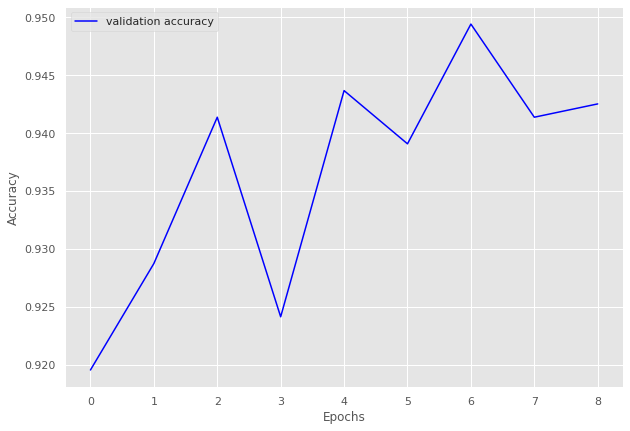

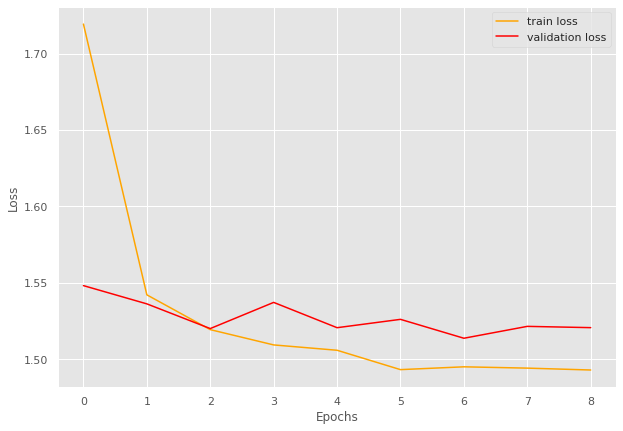

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982}}, 'whole': {

100%|██████████| 39/39 [00:13<00:00,  2.95batch/s, loss=1.34]


train loss 1.3446796857393706, validation loss 1.1544646195002966, validation accuracy 0.8932038834951457
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.95batch/s, loss=1.12]


train loss 1.1178294511941762, validation loss 1.1308954102652413, validation accuracy 0.9174757281553398
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.94batch/s, loss=1.09]


train loss 1.0913123106345153, validation loss 1.1175882986613683, validation accuracy 0.9247572815533981
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.82batch/s, loss=1.08]


train loss 1.08343501885732, validation loss 1.1060171127319336, validation accuracy 0.9368932038834952
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.94batch/s, loss=1.07]


train loss 1.0694996699308739, validation loss 1.1038254840033395, validation accuracy 0.9393203883495146
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.98batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0654965455715473, validation loss 1.119869555745806, validation accuracy 0.9199029126213593
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.93batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0654126069484613, validation loss 1.1152522563934326, validation accuracy 0.9247572815533981
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.96batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0704861604250395, validation loss 1.110225796699524, validation accuracy 0.9271844660194175
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.06]


train loss 1.0645936727523804, validation loss 1.0991451910563879, validation accuracy 0.941747572815534
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.07]


train loss 1.0663649149430103, validation loss 1.0975011076245988, validation accuracy 0.9393203883495146
Coarse label 4 Epoch 11
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.93batch/s, loss=1.06]


train loss 1.060009852433816, validation loss 1.0887451001576014, validation accuracy 0.9514563106796117
Coarse label 4 Epoch 12
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.91batch/s, loss=1.06]


train loss 1.0580758559398162, validation loss 1.0865658351353236, validation accuracy 0.9538834951456311
Coarse label 4 Epoch 13
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0563440659107306, validation loss 1.0895957606179374, validation accuracy 0.9514563106796117
Coarse label 4 Epoch 14
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.98batch/s, loss=1.06]


train loss 1.055524278909732, validation loss 1.0859342472893851, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 15
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9566914498141263 and loss 1.0863661653855268


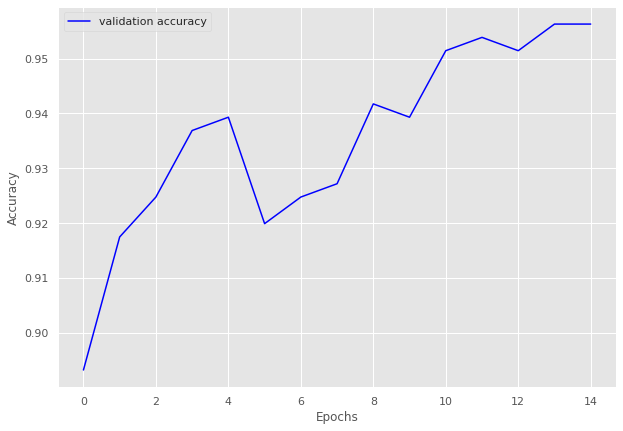

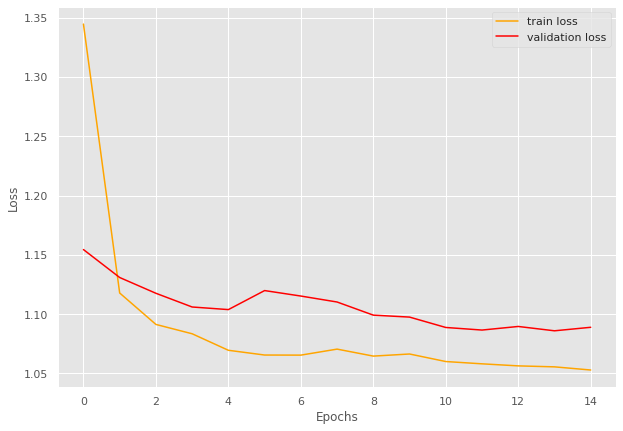

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 15/15 [00:05<00:00,  2.89batch/s, loss=0.417]


train loss 0.41726455291112263, validation loss 0.35006649295488995, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.97batch/s, loss=0.331]


train loss 0.3307828346888224, validation loss 0.34625527262687683, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.92batch/s, loss=0.328]


train loss 0.3283815562725067, validation loss 0.34458338220914203, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.95batch/s, loss=0.325]


INFO: Early stopping counter 1 of 5
train loss 0.32468154033025104, validation loss 0.3495573004086812, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.96batch/s, loss=0.316]


INFO: Early stopping counter 2 of 5
train loss 0.3162105560302734, validation loss 0.34831197063128155, validation accuracy 0.949685534591195
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.92batch/s, loss=0.316]


INFO: Early stopping counter 3 of 5
train loss 0.3164810657501221, validation loss 0.34705987572669983, validation accuracy 0.949685534591195
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.88batch/s, loss=0.317]


INFO: Early stopping counter 4 of 5
train loss 0.3168870727221171, validation loss 0.34608615438143414, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.93batch/s, loss=0.316]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9817131857555341 and loss 0.33236361814267706


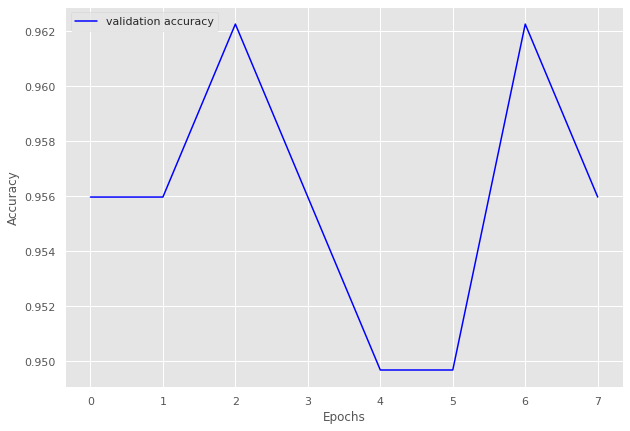

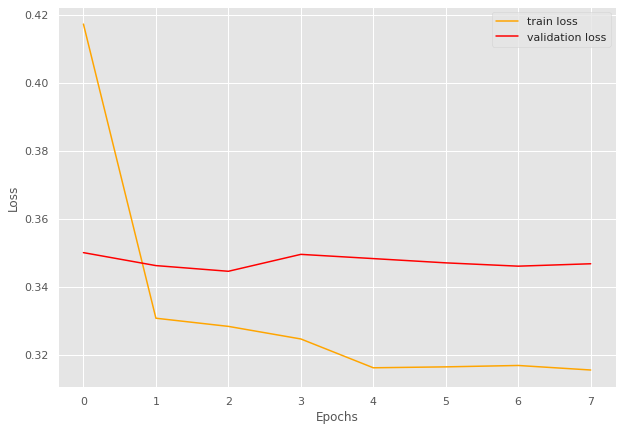

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 44/44 [00:14<00:00,  2.94batch/s, loss=1.41]


train loss 1.4063088460402056, validation loss 1.245699554681778, validation accuracy 0.915948275862069
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.97batch/s, loss=1.23]


train loss 1.2289056317372755, validation loss 1.237234354019165, validation accuracy 0.9245689655172413
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.97batch/s, loss=1.21]


train loss 1.2118148478594692, validation loss 1.2365024834871292, validation accuracy 0.9224137931034483
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.95batch/s, loss=1.2] 


train loss 1.203222239559347, validation loss 1.2298766076564789, validation accuracy 0.9310344827586207
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.96batch/s, loss=1.2] 


INFO: Early stopping counter 1 of 5
train loss 1.2018440772186627, validation loss 1.239722803235054, validation accuracy 0.9224137931034483
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 44/44 [00:15<00:00,  2.92batch/s, loss=1.2]


INFO: Early stopping counter 2 of 5
train loss 1.1983493214303798, validation loss 1.2373710125684738, validation accuracy 0.9181034482758621
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.94batch/s, loss=1.21]


INFO: Early stopping counter 3 of 5
train loss 1.211998782374642, validation loss 1.2505155056715012, validation accuracy 0.9116379310344828
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 44/44 [00:15<00:00,  2.89batch/s, loss=1.2] 


train loss 1.1970171630382538, validation loss 1.2285545021295547, validation accuracy 0.9331896551724138
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.96batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.189463580196554, validation loss 1.2377621531486511, validation accuracy 0.9224137931034483
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.95batch/s, loss=1.2] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.939897908776552 and loss 1.2265718748694971


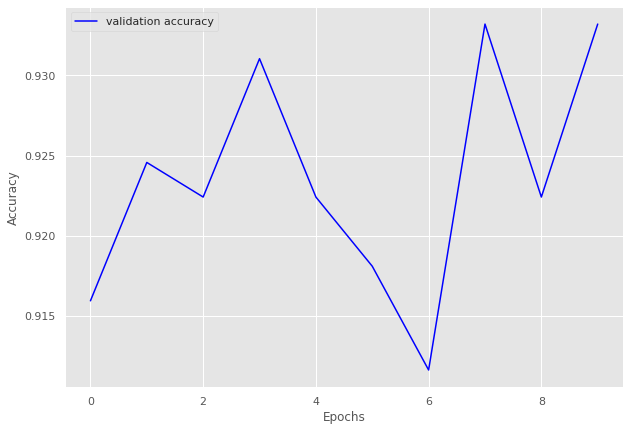

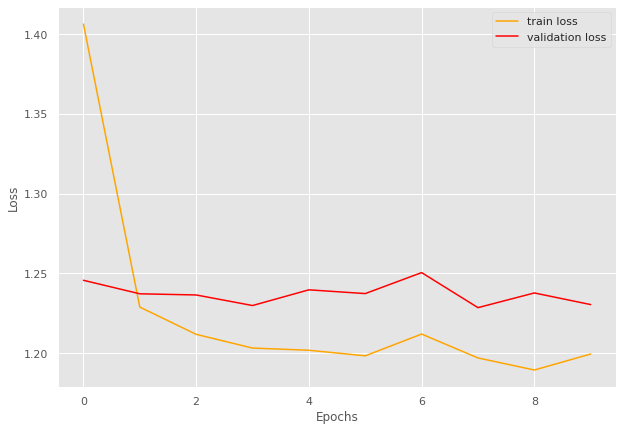

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 35/35 [00:11<00:00,  2.95batch/s, loss=0.904]


train loss 0.9042280384472439, validation loss 0.7913717726866404, validation accuracy 0.9504132231404959
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.99batch/s, loss=0.769]


train loss 0.7685721431459699, validation loss 0.7858723203341166, validation accuracy 0.9559228650137741
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.98batch/s, loss=0.765]


train loss 0.7652701258659362, validation loss 0.7830215791861216, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  3.01batch/s, loss=0.76] 


train loss 0.7601802587509155, validation loss 0.779332568248113, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.93batch/s, loss=0.754]


train loss 0.754202231339046, validation loss 0.7739791572093964, validation accuracy 0.9724517906336089
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  3.01batch/s, loss=0.754]


INFO: Early stopping counter 1 of 5
train loss 0.7544436454772949, validation loss 0.7774912516276041, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.95batch/s, loss=0.753]


INFO: Early stopping counter 2 of 5
train loss 0.753024765423366, validation loss 0.775202602148056, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.97batch/s, loss=0.758]


INFO: Early stopping counter 3 of 5
train loss 0.7576073612485613, validation loss 0.7801698446273804, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  3.00batch/s, loss=0.757]


train loss 0.7567998392241342, validation loss 0.7727009554704031, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 10
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.95batch/s, loss=0.763]


INFO: Early stopping counter 4 of 5
train loss 0.763411249433245, validation loss 0.7750654816627502, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 11
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.95batch/s, loss=0.752]


train loss 0.752380701473781, validation loss 0.7694383164246877, validation accuracy 0.9724517906336089
Coarse label 7 Epoch 12
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.97batch/s, loss=0.749]


train loss 0.7492074166025434, validation loss 0.7654595871766409, validation accuracy 0.977961432506887
Coarse label 7 Epoch 13
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.97batch/s, loss=0.75] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9760151483273722 and loss 0.7680200338363647


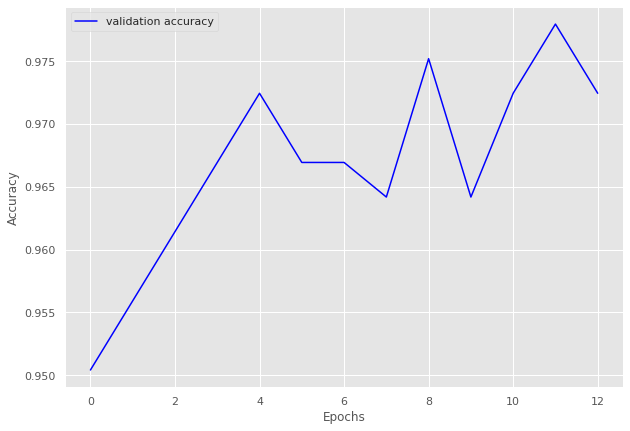

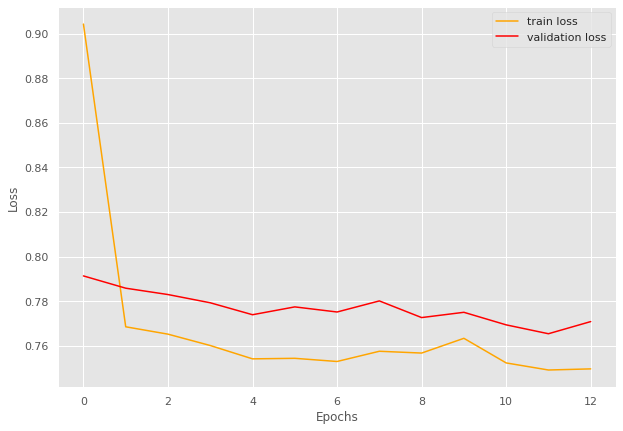

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 49/49 [00:16<00:00,  2.97batch/s, loss=1.45]


train loss 1.4457080437212575, validation loss 1.2541191577911377, validation accuracy 0.9119373776908023
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=1.24]


train loss 1.2429420729072727, validation loss 1.2528511583805084, validation accuracy 0.9178082191780822
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.96batch/s, loss=1.22]


train loss 1.2180104158362564, validation loss 1.2343009412288666, validation accuracy 0.9354207436399217
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.98batch/s, loss=1.2]


INFO: Early stopping counter 1 of 5
train loss 1.1998668519818052, validation loss 1.2455681413412094, validation accuracy 0.9158512720156555
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.92batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.195037233586214, validation loss 1.238170474767685, validation accuracy 0.9217221135029354
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.89batch/s, loss=1.19]


train loss 1.1914358747248748, validation loss 1.2279658317565918, validation accuracy 0.9373776908023483
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.93batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1928848149825115, validation loss 1.2393689900636673, validation accuracy 0.9256360078277887
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.97batch/s, loss=1.19]


train loss 1.1912282389037463, validation loss 1.2260843366384506, validation accuracy 0.9373776908023483
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.96batch/s, loss=1.18]


train loss 1.1838586573698082, validation loss 1.2179461568593979, validation accuracy 0.9471624266144814
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1892766709230385, validation loss 1.2251220494508743, validation accuracy 0.9412915851272016
Coarse label 8 Epoch 11
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9327542309420398 and loss 1.2331965378352574


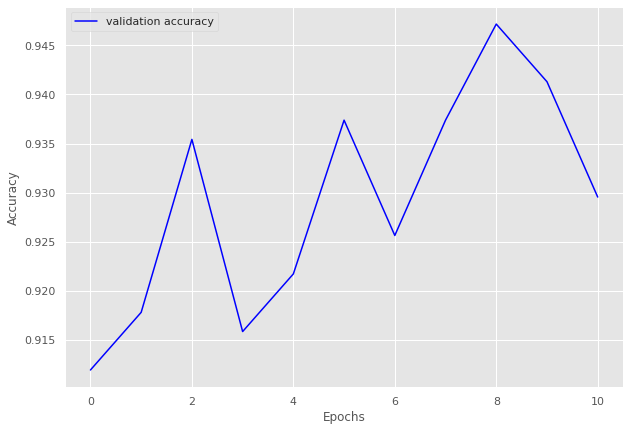

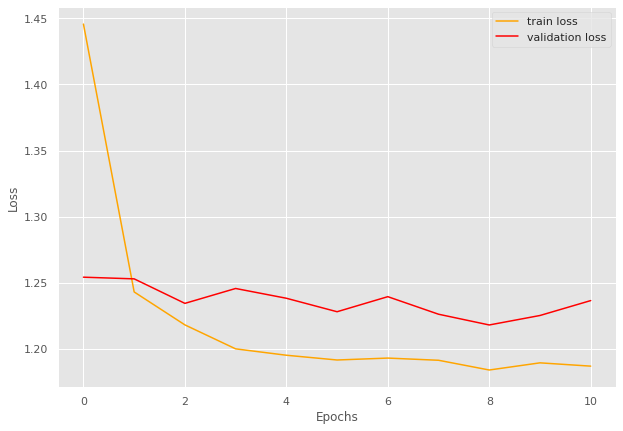

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 61/61 [00:21<00:00,  2.87batch/s, loss=1.73]


train loss 1.7280496710636577, validation loss 1.6372620951045642, validation accuracy 0.8827160493827161
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 61/61 [00:20<00:00,  2.94batch/s, loss=1.54]


train loss 1.5435303918650893, validation loss 1.555111289024353, validation accuracy 0.9274691358024691
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.82batch/s, loss=1.51]


train loss 1.5142841417281354, validation loss 1.5205651738426902, validation accuracy 0.9429012345679012
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.90batch/s, loss=1.5] 


INFO: Early stopping counter 1 of 5
train loss 1.49787859838517, validation loss 1.5337949124249546, validation accuracy 0.9475308641975309
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.88batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4942260062108275, validation loss 1.5434188084168867, validation accuracy 0.9382716049382716
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.84batch/s, loss=1.49]


train loss 1.4853759515480918, validation loss 1.515733783895319, validation accuracy 0.9444444444444444
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.88batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4845700947964777, validation loss 1.550234166058627, validation accuracy 0.9398148148148148
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 61/61 [00:36<00:00,  1.65batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4800035523586585, validation loss 1.5243676900863647, validation accuracy 0.9459876543209876
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 61/61 [00:46<00:00,  1.31batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9440633869441817 and loss 1.5178175510320449


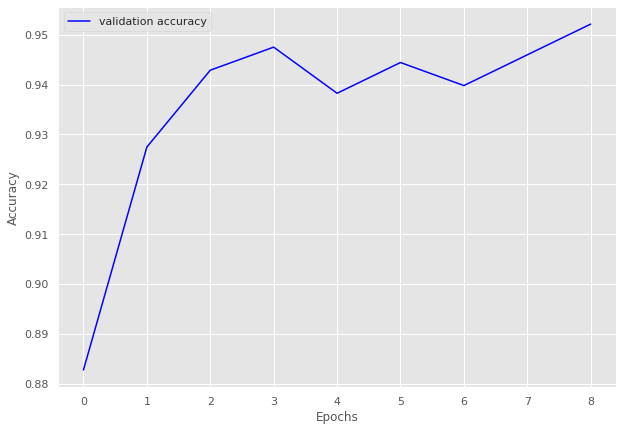

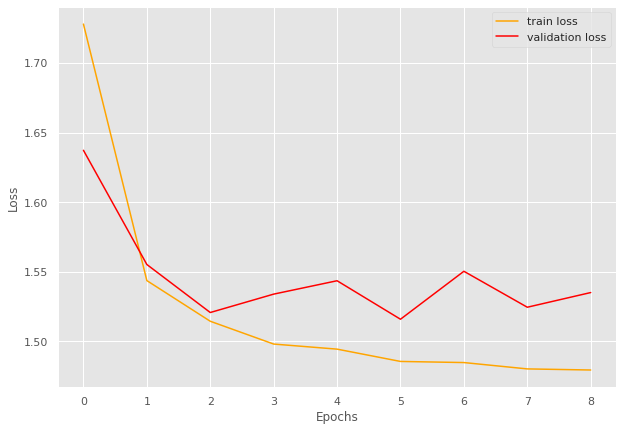

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 29/29 [00:25<00:00,  1.15batch/s, loss=0.931]


train loss 0.9305886420710333, validation loss 0.7785121917724609, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 29/29 [00:16<00:00,  1.79batch/s, loss=0.772]


train loss 0.7723797950251349, validation loss 0.7759207367897034, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 29/29 [00:13<00:00,  2.22batch/s, loss=0.764]


train loss 0.7641602137993122, validation loss 0.7725820660591125, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 29/29 [00:16<00:00,  1.79batch/s, loss=0.759]


train loss 0.7590550677529697, validation loss 0.7707570195198059, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 29/29 [00:10<00:00,  2.83batch/s, loss=0.757]


train loss 0.7565611765302461, validation loss 0.7694121479988099, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 29/29 [00:10<00:00,  2.90batch/s, loss=0.754]


train loss 0.7535784450070612, validation loss 0.7680850863456726, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.93batch/s, loss=0.752]


train loss 0.7515363898770563, validation loss 0.757643461227417, validation accuracy 0.9901315789473685
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.94batch/s, loss=0.75] 


INFO: Early stopping counter 1 of 5
train loss 0.7497886583722871, validation loss 0.7610163211822509, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.97batch/s, loss=0.749]


INFO: Early stopping counter 2 of 5
train loss 0.7494940038385063, validation loss 0.7705552577972412, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 10
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.93batch/s, loss=0.752]


INFO: Early stopping counter 3 of 5
train loss 0.7515956183959698, validation loss 0.7736822128295898, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 11
-------------------------------


100%|██████████| 29/29 [00:10<00:00,  2.87batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.7512694926097475, validation loss 0.7668537497520447, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 12
-------------------------------


100%|██████████| 29/29 [00:10<00:00,  2.80batch/s, loss=0.749]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9716507777220271 and loss 0.7721260965816559


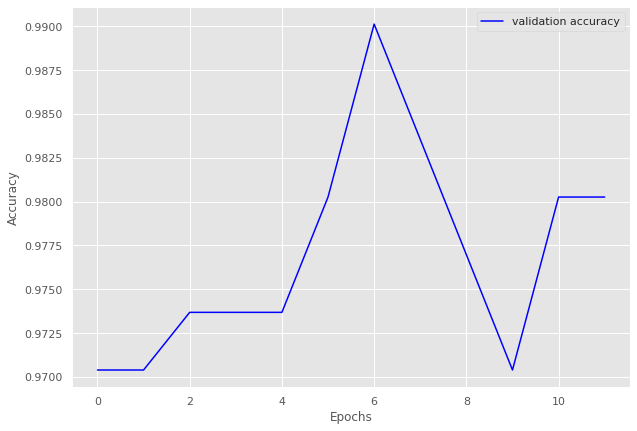

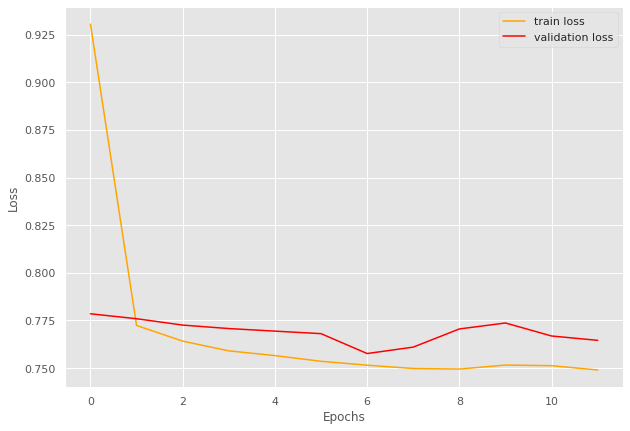

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=1.4] 


train loss 1.403727454798562, validation loss 1.2096725940704345, validation accuracy 0.8517241379310345
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.01batch/s, loss=1.13]


train loss 1.1276502438953944, validation loss 1.1379278421401977, validation accuracy 0.903448275862069
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.09]


train loss 1.093797036579677, validation loss 1.1312897205352783, validation accuracy 0.9103448275862069
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.08]


train loss 1.0798425206116267, validation loss 1.1172231435775757, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.02batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0711768397263117, validation loss 1.1233314275741577, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.00batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.06656642471041, validation loss 1.122432804107666, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.00batch/s, loss=1.07]


train loss 1.0698003768920898, validation loss 1.1112236499786377, validation accuracy 0.9379310344827586
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.02batch/s, loss=1.06]


train loss 1.0599600289549147, validation loss 1.102919340133667, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0616245695522852, validation loss 1.1263967990875243, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.00batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0610602242606026, validation loss 1.1112858295440673, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9283652584623459 and loss 1.114587930838267


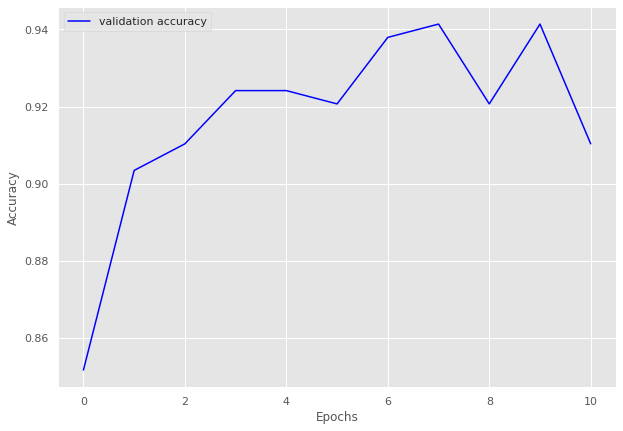

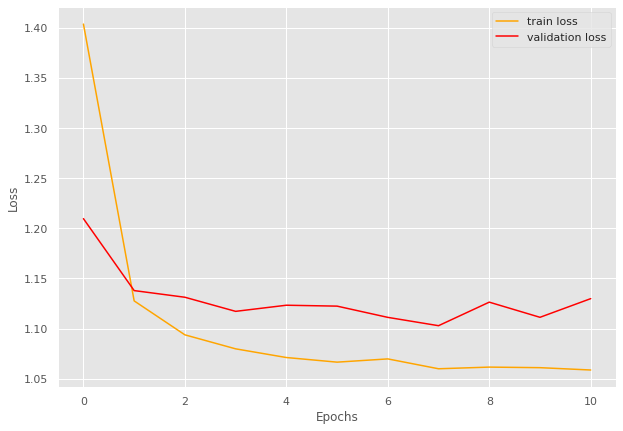

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 25/25 [00:08<00:00,  2.96batch/s, loss=0.713]


train loss 0.7127747297286987, validation loss 0.6038516521453857, validation accuracy 0.9305019305019305
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.99batch/s, loss=0.594]


train loss 0.5941987895965576, validation loss 0.5875364542007446, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.99batch/s, loss=0.585]


INFO: Early stopping counter 1 of 5
train loss 0.5848162341117858, validation loss 0.5909879565238952, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.98batch/s, loss=0.576]


train loss 0.5761075067520142, validation loss 0.5846178770065308, validation accuracy 0.9613899613899614
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.02batch/s, loss=0.57] 


INFO: Early stopping counter 2 of 5
train loss 0.5703189897537232, validation loss 0.5847974181175232, validation accuracy 0.9613899613899614
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.00batch/s, loss=0.57] 


INFO: Early stopping counter 3 of 5
train loss 0.5695005178451538, validation loss 0.5851955652236939, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.97batch/s, loss=0.571]


train loss 0.5706959986686706, validation loss 0.5798540949821472, validation accuracy 0.9652509652509652
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.01batch/s, loss=0.564]


INFO: Early stopping counter 4 of 5
train loss 0.564151360988617, validation loss 0.5807610154151917, validation accuracy 0.9652509652509652
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.88batch/s, loss=0.565]


train loss 0.5646172428131103, validation loss 0.5748397946357727, validation accuracy 0.972972972972973
Coarse label 13 Epoch 10
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.00batch/s, loss=0.563]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9512123004139562 and loss 0.5993127969076049


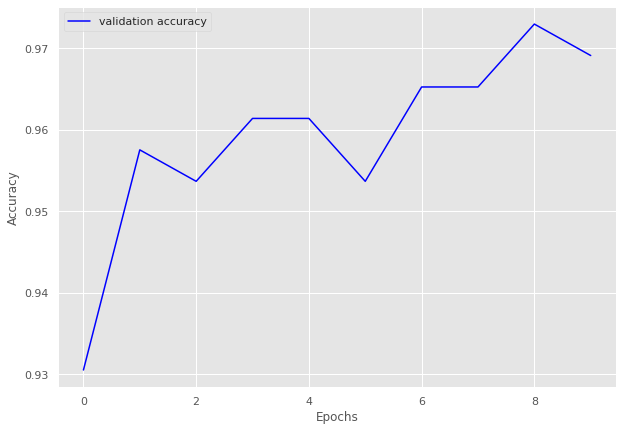

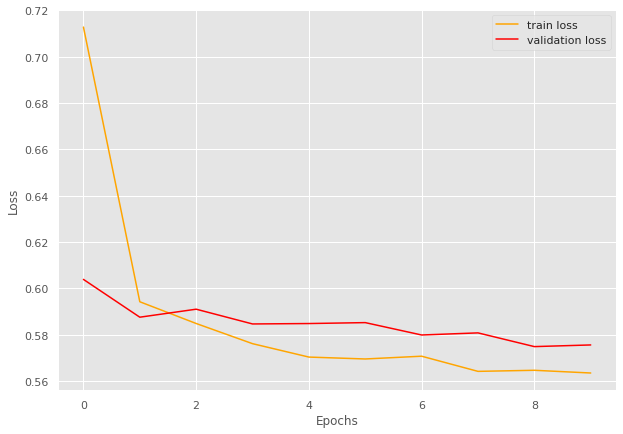

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 56/56 [00:19<00:00,  2.92batch/s, loss=1.22]


train loss 1.2181508136647088, validation loss 1.1068812727928161, validation accuracy 0.9377104377104377
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.95batch/s, loss=1.09]


train loss 1.0859962616647993, validation loss 1.0923733234405517, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.92batch/s, loss=1.07]


train loss 1.0720668307372503, validation loss 1.0831855535507202, validation accuracy 0.9663299663299664
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.92batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0687806606292725, validation loss 1.1009939670562745, validation accuracy 0.9562289562289562
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.86batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0623208050216948, validation loss 1.0856858491897583, validation accuracy 0.9646464646464646
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 56/56 [00:18<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.060743517109326, validation loss 1.087175726890564, validation accuracy 0.9663299663299664
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0604210134063448, validation loss 1.091831386089325, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9630202293518877 and loss 1.0819505267455929


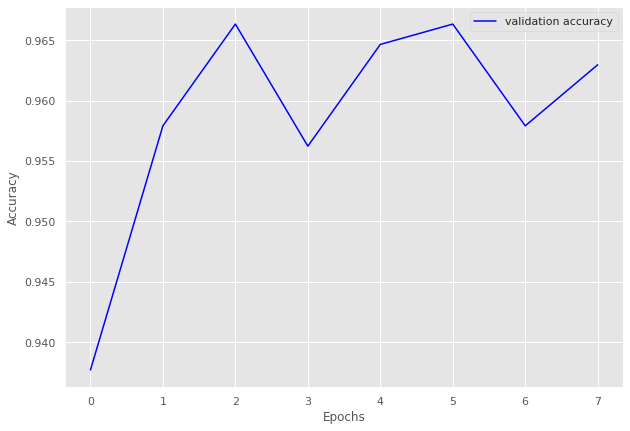

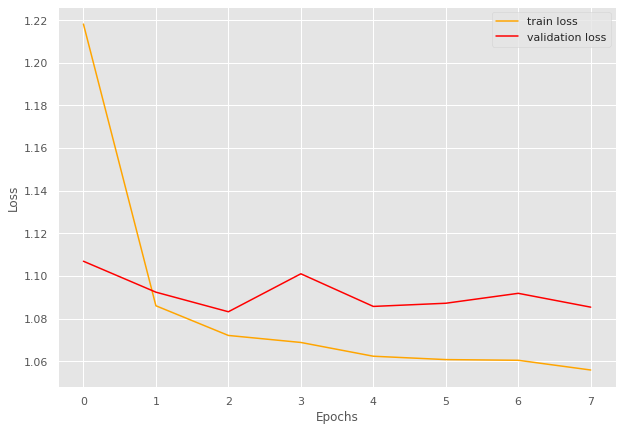

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=0.962]


train loss 0.9621711394616536, validation loss 0.79764404296875, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.88batch/s, loss=0.778]


train loss 0.778251975774765, validation loss 0.7734496235847473, validation accuracy 0.9761904761904762
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.83batch/s, loss=0.761]


train loss 0.7607839235237667, validation loss 0.7684251666069031, validation accuracy 0.9761904761904762
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=0.754]


INFO: Early stopping counter 1 of 5
train loss 0.7536309489182064, validation loss 0.7755198836326599, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=0.753]


train loss 0.7525041486535754, validation loss 0.7650808453559875, validation accuracy 0.9761904761904762
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=0.75] 


INFO: Early stopping counter 2 of 5
train loss 0.7504598817655018, validation loss 0.7706523418426514, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=0.757]


INFO: Early stopping counter 3 of 5
train loss 0.7570928101028714, validation loss 0.7723580479621888, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=0.758]


INFO: Early stopping counter 4 of 5
train loss 0.7584661032472338, validation loss 0.7711731910705566, validation accuracy 0.9761904761904762
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=0.75] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9543557642149192 and loss 0.7899750918149948


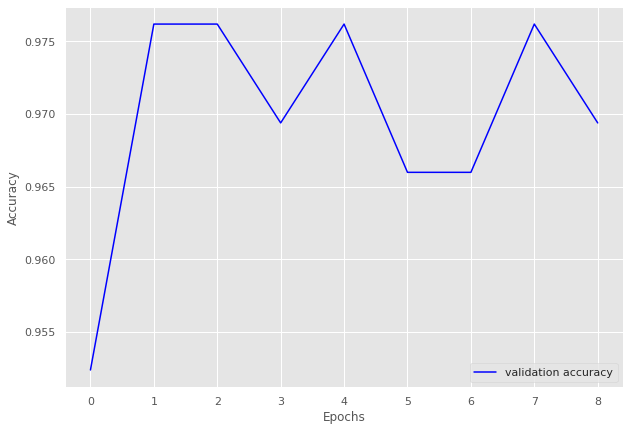

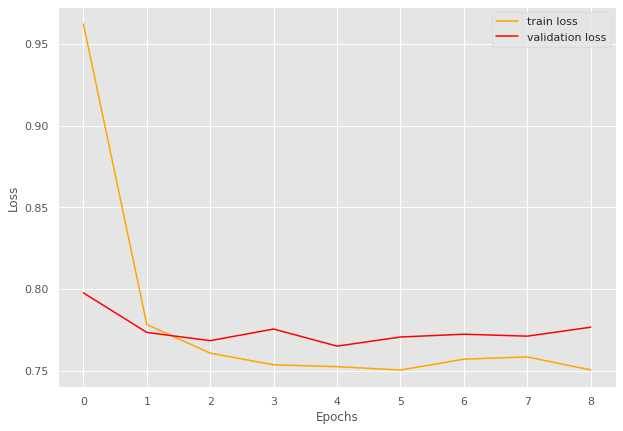

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 27/27 [00:09<00:00,  2.95batch/s, loss=0.719]


train loss 0.7194057967927721, validation loss 0.6008891344070435, validation accuracy 0.9574468085106383
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 27/27 [00:08<00:00,  3.00batch/s, loss=0.59] 


train loss 0.590124679936303, validation loss 0.579381811618805, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.85batch/s, loss=0.573]


train loss 0.5731149382061429, validation loss 0.5751896977424622, validation accuracy 0.975177304964539
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.96batch/s, loss=0.566]


train loss 0.5660186829390349, validation loss 0.5741538405418396, validation accuracy 0.9787234042553191
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.96batch/s, loss=0.563]


INFO: Early stopping counter 1 of 5
train loss 0.563167342433223, validation loss 0.5752367854118348, validation accuracy 0.9822695035460993
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.96batch/s, loss=0.56] 


train loss 0.5602060379805388, validation loss 0.5656367421150208, validation accuracy 0.9858156028368794
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.97batch/s, loss=0.559]


INFO: Early stopping counter 2 of 5
train loss 0.5587652745070281, validation loss 0.5696001291275025, validation accuracy 0.9822695035460993
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.97batch/s, loss=0.558]


INFO: Early stopping counter 3 of 5
train loss 0.5582870774798923, validation loss 0.5756813287734985, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.97batch/s, loss=0.556]


INFO: Early stopping counter 4 of 5
train loss 0.5561676444830718, validation loss 0.5736598014831543, validation accuracy 0.975177304964539
Coarse label 16 Epoch 10
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.96batch/s, loss=0.555]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9744495786898614 and loss 0.5769183193815166


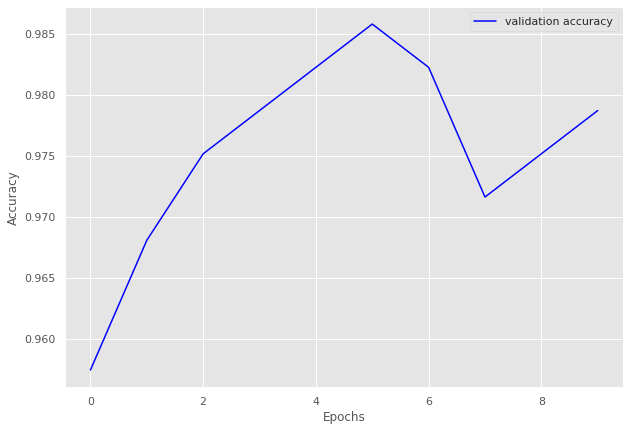

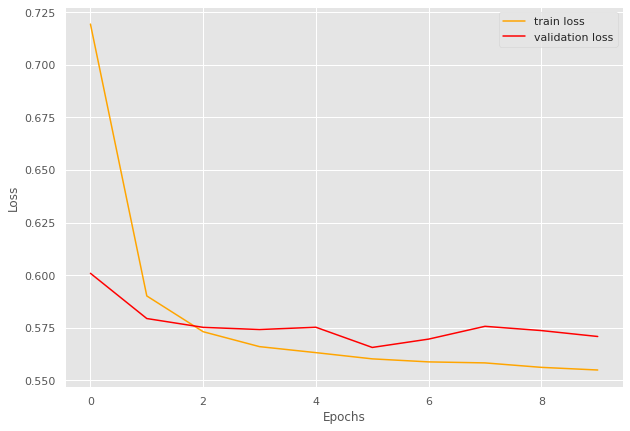

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 30/30 [00:09<00:00,  3.00batch/s, loss=0.977]


train loss 0.9766408920288085, validation loss 0.8786988258361816, validation accuracy 0.8770226537216829
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.03batch/s, loss=0.803]


train loss 0.8028457661469778, validation loss 0.8513669013977051, validation accuracy 0.8964401294498382
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.89batch/s, loss=0.779]


train loss 0.7788760622342428, validation loss 0.8272116899490356, validation accuracy 0.9158576051779935
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=0.775]


train loss 0.7745712657769521, validation loss 0.823456859588623, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.767]


train loss 0.7666555186112721, validation loss 0.8218913674354553, validation accuracy 0.919093851132686
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.776]


train loss 0.7761676390965779, validation loss 0.8073624849319458, validation accuracy 0.9385113268608414
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.03batch/s, loss=0.776]


INFO: Early stopping counter 1 of 5
train loss 0.7761270701885223, validation loss 0.809509551525116, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.00batch/s, loss=0.773]


INFO: Early stopping counter 2 of 5
train loss 0.7726399620374044, validation loss 0.8291980624198914, validation accuracy 0.919093851132686
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.772]


INFO: Early stopping counter 3 of 5
train loss 0.7716140111287435, validation loss 0.8347392320632935, validation accuracy 0.8964401294498382
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.76] 


INFO: Early stopping counter 4 of 5
train loss 0.7597132345040639, validation loss 0.8145341396331787, validation accuracy 0.9288025889967637
Coarse label 17 Epoch 11
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  3.00batch/s, loss=0.751]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9432043650793651 and loss 0.8000309126717704


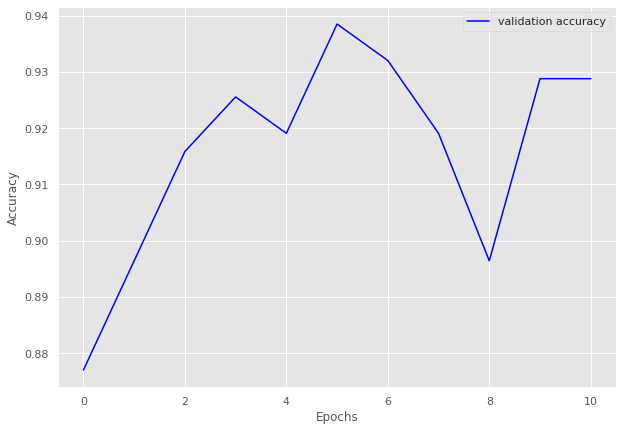

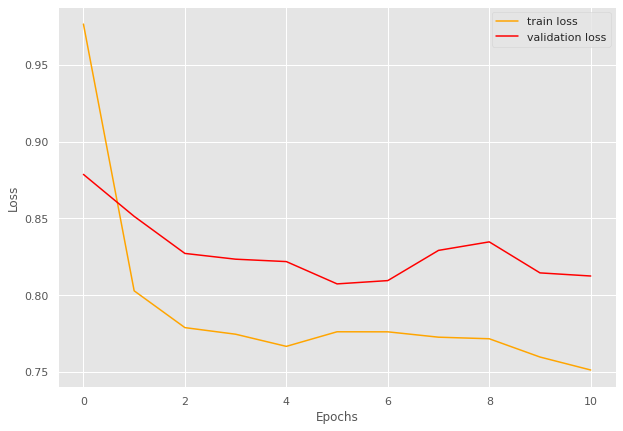

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 10/10 [00:03<00:00,  3.20batch/s, loss=1.17]


train loss 1.1651522755622863, validation loss 1.0349469780921936, validation accuracy 0.8020833333333334
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.852]


train loss 0.8520233929157257, validation loss 0.8544218838214874, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.786]


train loss 0.786238181591034, validation loss 0.8004402220249176, validation accuracy 0.9375
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.78batch/s, loss=0.763]


train loss 0.7633162856101989, validation loss 0.7968068420886993, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.06batch/s, loss=0.755]


train loss 0.7553816318511963, validation loss 0.7874051034450531, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.752]


INFO: Early stopping counter 1 of 5
train loss 0.7521890878677369, validation loss 0.7918282151222229, validation accuracy 0.9375
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.753]


INFO: Early stopping counter 2 of 5
train loss 0.7526719629764557, validation loss 0.798257052898407, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.22batch/s, loss=0.754]


INFO: Early stopping counter 3 of 5
train loss 0.7541181564331054, validation loss 0.7921630144119263, validation accuracy 0.9375
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.16batch/s, loss=0.761]


INFO: Early stopping counter 4 of 5
train loss 0.7612017035484314, validation loss 0.78876793384552, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.13batch/s, loss=0.757]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.927115987460815 and loss 0.8152864873409271


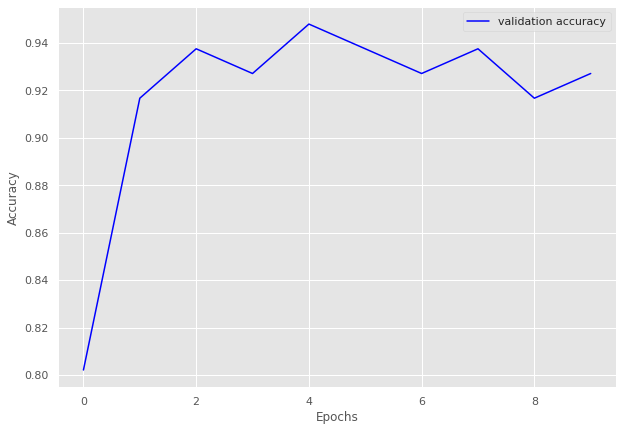

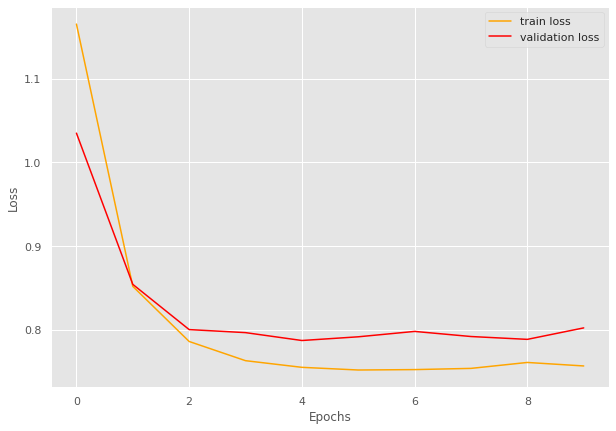

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 68/68 [00:23<00:00,  2.94batch/s, loss=1.07]


train loss 1.0682910023366703, validation loss 0.9736952611378261, validation accuracy 0.9277389277389277
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.95batch/s, loss=0.952]


train loss 0.9520688539042192, validation loss 0.9645948580333165, validation accuracy 0.9370629370629371
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.95batch/s, loss=0.944]


train loss 0.9441040692960515, validation loss 0.9584029316902161, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.94batch/s, loss=0.94] 


train loss 0.9404472875244477, validation loss 0.9541157739503043, validation accuracy 0.9487179487179487
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.90batch/s, loss=0.938]


train loss 0.9384139688575969, validation loss 0.9453093664986747, validation accuracy 0.958041958041958
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.95batch/s, loss=0.938]


INFO: Early stopping counter 1 of 5
train loss 0.9379257217926138, validation loss 0.9524580069950649, validation accuracy 0.9487179487179487
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.94batch/s, loss=0.934]


INFO: Early stopping counter 2 of 5
train loss 0.9342136067502639, validation loss 0.9493124314716884, validation accuracy 0.9557109557109557
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.931]


INFO: Early stopping counter 3 of 5
train loss 0.9310596462558297, validation loss 0.9530492680413383, validation accuracy 0.951048951048951
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.92batch/s, loss=0.932]


train loss 0.9318637435927111, validation loss 0.9424245527812413, validation accuracy 0.9603729603729604
Coarse label 0 Epoch 10
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.88batch/s, loss=0.928]


INFO: Early stopping counter 4 of 5
train loss 0.9284540108021568, validation loss 0.9468239034925189, validation accuracy 0.958041958041958
Coarse label 0 Epoch 11
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.95batch/s, loss=0.927]


train loss 0.9265891585279914, validation loss 0.9418626853397915, validation accuracy 0.9603729603729604
Coarse label 0 Epoch 12
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.94batch/s, loss=0.924]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9599280760339071 and loss 0.9435585659058368


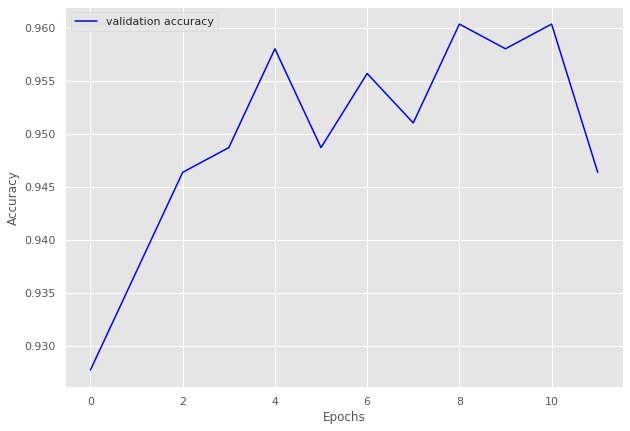

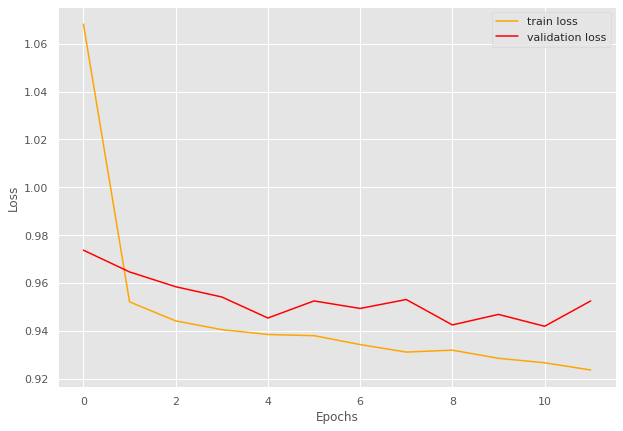

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 30/30 [00:10<00:00,  2.97batch/s, loss=1.29]


train loss 1.2868543187777202, validation loss 1.1271186272303264, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.1] 


train loss 1.0962525844573974, validation loss 1.1014819939931233, validation accuracy 0.946236559139785
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.95batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.0752544164657594, validation loss 1.106783111890157, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.94batch/s, loss=1.06]


train loss 1.0609090805053711, validation loss 1.086463451385498, validation accuracy 0.956989247311828
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.74batch/s, loss=1.06]


train loss 1.0598831017812094, validation loss 1.080589731534322, validation accuracy 0.967741935483871
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.06]


train loss 1.060059122244517, validation loss 1.0737029711405437, validation accuracy 0.967741935483871
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0551499406496683, validation loss 1.089855154355367, validation accuracy 0.956989247311828
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.00batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0545251051584879, validation loss 1.096553881963094, validation accuracy 0.946236559139785
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.056698163350423, validation loss 1.0935548543930054, validation accuracy 0.946236559139785
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9634433962264151 and loss 1.0790107206062034


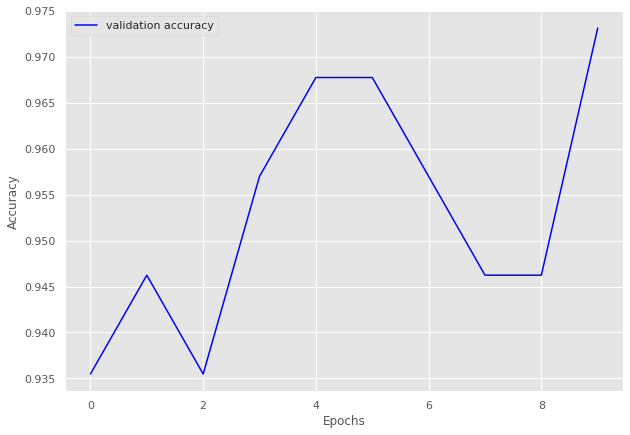

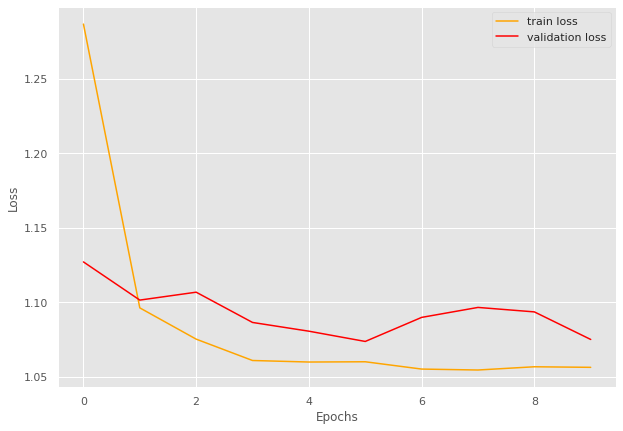

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 137/137 [00:47<00:00,  2.89batch/s, loss=1.67]


train loss 1.6662406155662814, validation loss 1.5425734860556466, validation accuracy 0.9275862068965517
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 137/137 [00:46<00:00,  2.92batch/s, loss=1.53]


train loss 1.5324896130248578, validation loss 1.5203580856323242, validation accuracy 0.9459770114942528
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.51]


train loss 1.512149539307086, validation loss 1.5175627384866988, validation accuracy 0.9471264367816092
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.88batch/s, loss=1.5]


train loss 1.5021014300576092, validation loss 1.5147699458258492, validation accuracy 0.9505747126436782
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 137/137 [00:46<00:00,  2.93batch/s, loss=1.5]


train loss 1.4996786674443823, validation loss 1.5142430748258318, validation accuracy 0.9505747126436782
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.89batch/s, loss=1.49]


train loss 1.494824111026569, validation loss 1.5136319313730513, validation accuracy 0.9505747126436782
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 137/137 [00:46<00:00,  2.92batch/s, loss=1.49]


train loss 1.4903479170625227, validation loss 1.5049335190228053, validation accuracy 0.957471264367816
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 137/137 [00:46<00:00,  2.92batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4891435534414583, validation loss 1.5107690010751997, validation accuracy 0.9517241379310345
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.89batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.489754179968451, validation loss 1.511141564164843, validation accuracy 0.9528735632183908
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 137/137 [00:46<00:00,  2.92batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.483764166379497, validation loss 1.5234956060137068, validation accuracy 0.9367816091954023
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.88batch/s, loss=1.49]


INFO: Early stopping counter 4 of 5
train loss 1.4902349492929277, validation loss 1.5153023515428816, validation accuracy 0.9471264367816092
Coarse label 2 Epoch 12
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9531230203978208 and loss 1.5082340278933126


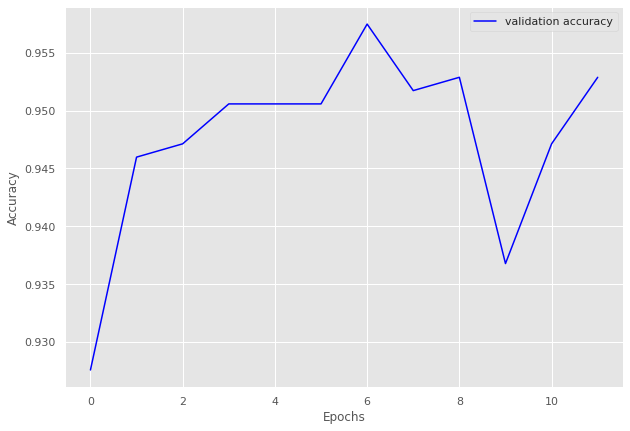

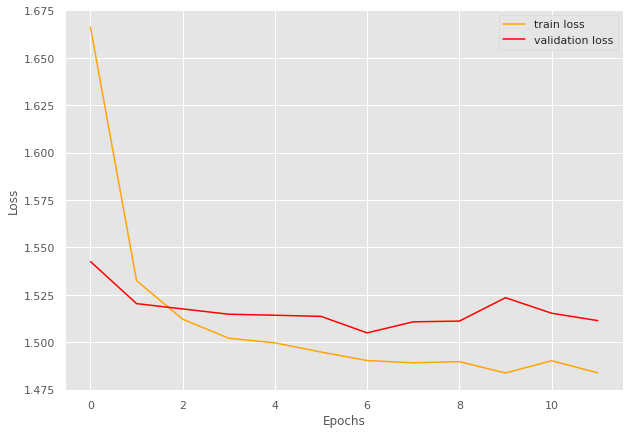

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.25]


train loss 1.2453492127932035, validation loss 1.1215697186333793, validation accuracy 0.9247572815533981
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.1] 


train loss 1.1007342723699716, validation loss 1.0949859619140625, validation accuracy 0.9538834951456311
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.09]


INFO: Early stopping counter 1 of 5
train loss 1.088158053618211, validation loss 1.1016743523733956, validation accuracy 0.9393203883495146
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.08]


INFO: Early stopping counter 2 of 5
train loss 1.0784354338279136, validation loss 1.0988080160958427, validation accuracy 0.941747572815534
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.073925258563115, validation loss 1.1048359530312675, validation accuracy 0.9320388349514563
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.07]


train loss 1.0696080171144926, validation loss 1.0797446625573295, validation accuracy 0.9635922330097088
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 65/65 [00:24<00:00,  2.64batch/s, loss=1.06]


train loss 1.0634293776292068, validation loss 1.0742061308452062, validation accuracy 0.9684466019417476
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 65/65 [00:40<00:00,  1.61batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0640280100015493, validation loss 1.087309377534049, validation accuracy 0.9587378640776699
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 65/65 [00:50<00:00,  1.28batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9562650925677488 and loss 1.088470323611114


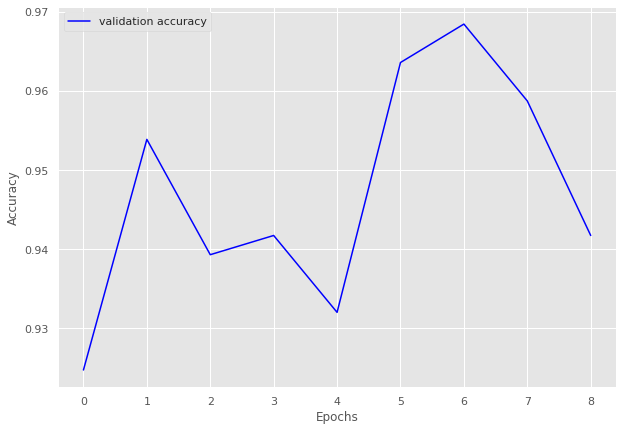

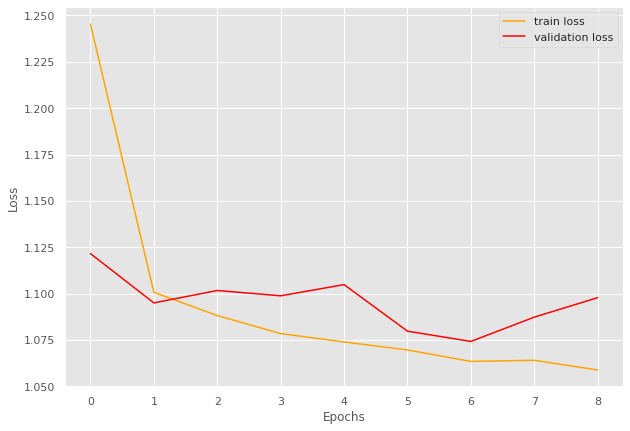

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 25/25 [00:16<00:00,  1.54batch/s, loss=0.393]


train loss 0.3925812995433807, validation loss 0.3230338493982951, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:22<00:00,  1.10batch/s, loss=0.331]


train loss 0.330599330663681, validation loss 0.3217977186044057, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:21<00:00,  1.17batch/s, loss=0.323]


INFO: Early stopping counter 1 of 5
train loss 0.32331191301345824, validation loss 0.33581050237019855, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:15<00:00,  1.58batch/s, loss=0.328]


train loss 0.32834524035453794, validation loss 0.31949320435523987, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:09<00:00,  2.70batch/s, loss=0.322]


train loss 0.32158414959907533, validation loss 0.31937679648399353, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.88batch/s, loss=0.319]


INFO: Early stopping counter 2 of 5
train loss 0.31907700061798094, validation loss 0.3222270905971527, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:09<00:00,  2.76batch/s, loss=0.32] 


INFO: Early stopping counter 3 of 5
train loss 0.320004049539566, validation loss 0.32561641931533813, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.88batch/s, loss=0.318]


INFO: Early stopping counter 4 of 5
train loss 0.31847393155097964, validation loss 0.3295750617980957, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.94batch/s, loss=0.316]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9770674079221682 and loss 0.33427196870679443


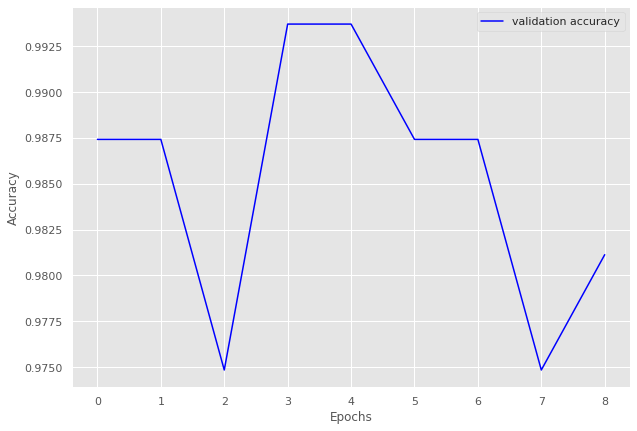

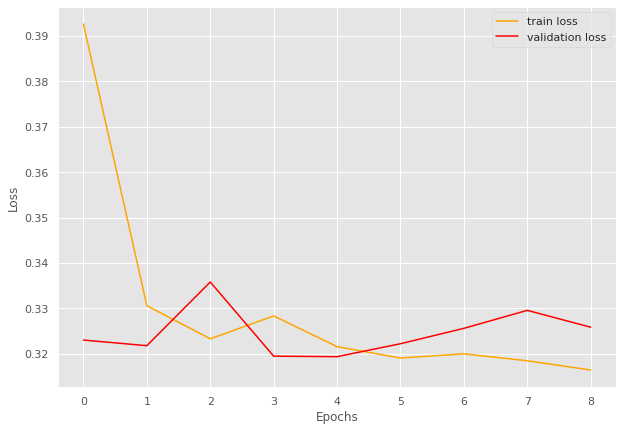

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 73/73 [00:24<00:00,  2.94batch/s, loss=1.34]


train loss 1.3381708533796546, validation loss 1.2491651475429535, validation accuracy 0.9202586206896551
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.94batch/s, loss=1.23]


train loss 1.2301008636004305, validation loss 1.2340355813503265, validation accuracy 0.9310344827586207
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 73/73 [00:25<00:00,  2.88batch/s, loss=1.21]


train loss 1.2121462185088903, validation loss 1.2274145931005478, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.93batch/s, loss=1.21]


train loss 1.212354452642676, validation loss 1.2197028994560242, validation accuracy 0.9439655172413793
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.93batch/s, loss=1.21]


INFO: Early stopping counter 1 of 5
train loss 1.2064079928071532, validation loss 1.219983771443367, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.94batch/s, loss=1.21]


train loss 1.2062482621571788, validation loss 1.2125737965106964, validation accuracy 0.9482758620689655
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.94batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.1979703184676498, validation loss 1.2126532942056656, validation accuracy 0.9504310344827587
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 73/73 [00:25<00:00,  2.86batch/s, loss=1.2] 


train loss 1.1980291196744737, validation loss 1.2011777609586716, validation accuracy 0.9612068965517241
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.93batch/s, loss=1.2] 


INFO: Early stopping counter 3 of 5
train loss 1.1987094585209677, validation loss 1.2044208198785782, validation accuracy 0.959051724137931
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.94batch/s, loss=1.2]


INFO: Early stopping counter 4 of 5
train loss 1.1997487675653744, validation loss 1.213801845908165, validation accuracy 0.9461206896551724
Coarse label 6 Epoch 11
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.94batch/s, loss=1.2] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.949346016646849 and loss 1.2151744437940193


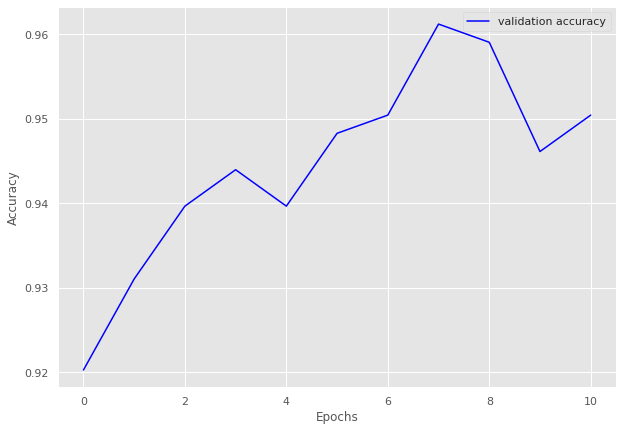

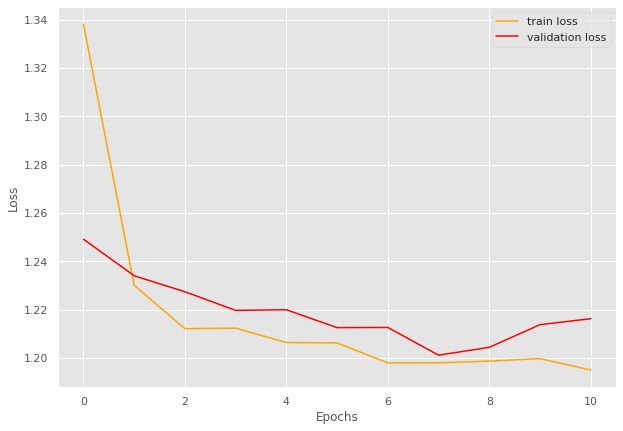

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 58/58 [00:20<00:00,  2.89batch/s, loss=0.859]


train loss 0.8585436662723278, validation loss 0.7623257339000702, validation accuracy 0.9834710743801653
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.95batch/s, loss=0.771]


INFO: Early stopping counter 1 of 5
train loss 0.770816747484536, validation loss 0.7654457787672678, validation accuracy 0.977961432506887
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.98batch/s, loss=0.764]


train loss 0.7641002443330042, validation loss 0.7614131073156992, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.95batch/s, loss=0.766]


train loss 0.7656355366624635, validation loss 0.7579727669556936, validation accuracy 0.9834710743801653
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.95batch/s, loss=0.768]


INFO: Early stopping counter 2 of 5
train loss 0.7678120937840692, validation loss 0.7620510558287302, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.94batch/s, loss=0.763]


INFO: Early stopping counter 3 of 5
train loss 0.7626195663008196, validation loss 0.7599890132745107, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.96batch/s, loss=0.756]


INFO: Early stopping counter 4 of 5
train loss 0.7564487128422178, validation loss 0.761096199353536, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 58/58 [00:20<00:00,  2.89batch/s, loss=0.754]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9805589307411907 and loss 0.7632109511357087


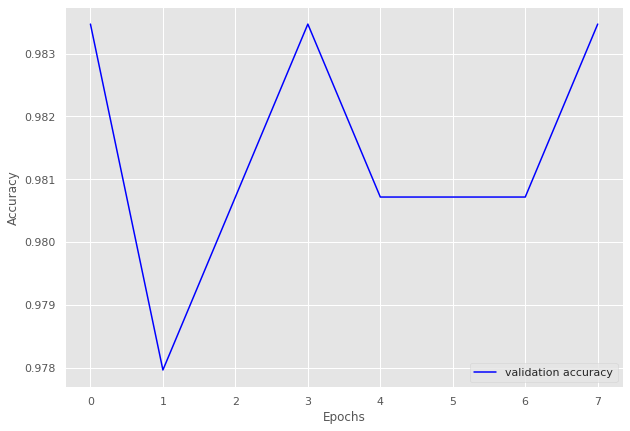

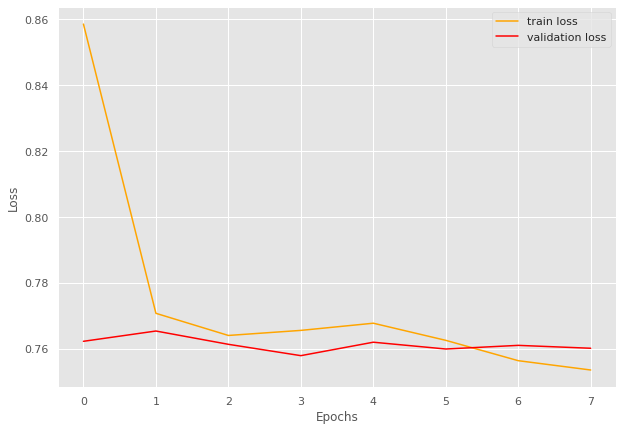

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 81/81 [00:27<00:00,  2.91batch/s, loss=1.37]


train loss 1.3735330870122084, validation loss 1.2512980848550797, validation accuracy 0.9217221135029354
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.24]


train loss 1.2365977307896556, validation loss 1.22285757958889, validation accuracy 0.9412915851272016
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 81/81 [00:28<00:00,  2.89batch/s, loss=1.21]


train loss 1.2129352902188713, validation loss 1.2116549760103226, validation accuracy 0.9510763209393346
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.96batch/s, loss=1.21]


train loss 1.2054629840968567, validation loss 1.2094454616308212, validation accuracy 0.9569471624266145
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.92batch/s, loss=1.2] 


train loss 1.201788819866416, validation loss 1.2073163539171219, validation accuracy 0.958904109589041
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 81/81 [00:28<00:00,  2.89batch/s, loss=1.19]


INFO: Early stopping counter 1 of 5
train loss 1.1937251797428838, validation loss 1.211980864405632, validation accuracy 0.9549902152641878
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 81/81 [00:28<00:00,  2.86batch/s, loss=1.2]


train loss 1.1969021676499167, validation loss 1.2043266743421555, validation accuracy 0.9608610567514677
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.95batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.1977774522922657, validation loss 1.2057979255914688, validation accuracy 0.958904109589041
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.94batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1937845327236034, validation loss 1.210531786084175, validation accuracy 0.9569471624266145
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.94batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1912092441394004, validation loss 1.215169981122017, validation accuracy 0.9530332681017613
Coarse label 8 Epoch 11
-------------------------------


100%|██████████| 81/81 [00:28<00:00,  2.89batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.946583044982699 and loss 1.2194278632124809


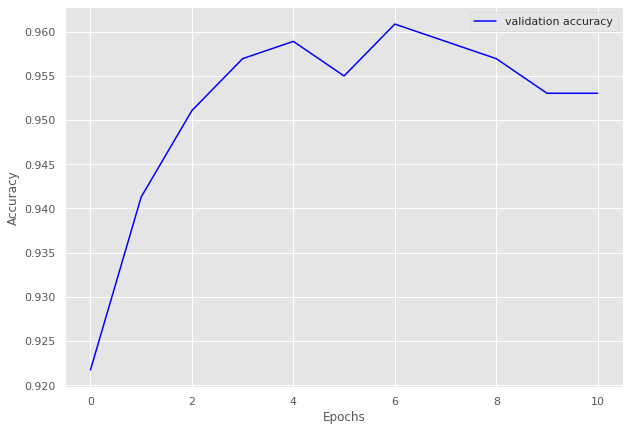

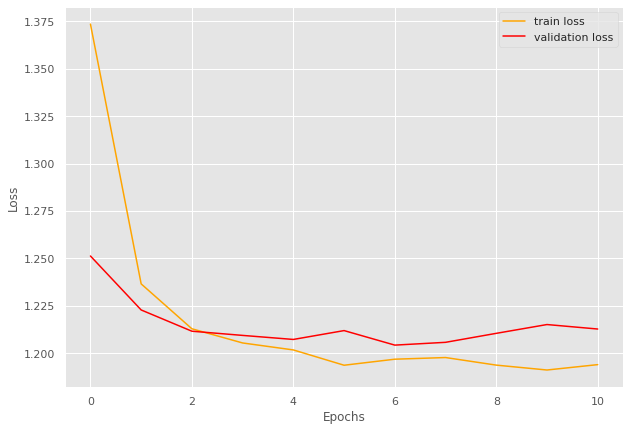

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.68]


train loss 1.67548665229012, validation loss 1.6059627532958984, validation accuracy 0.9058641975308642
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 102/102 [00:34<00:00,  2.93batch/s, loss=1.54]


train loss 1.53608799681944, validation loss 1.5273739749735051, validation accuracy 0.9444444444444444
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.88batch/s, loss=1.51]


INFO: Early stopping counter 1 of 5
train loss 1.5072451116991978, validation loss 1.538047649643638, validation accuracy 0.9475308641975309
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 102/102 [00:34<00:00,  2.93batch/s, loss=1.5]


INFO: Early stopping counter 2 of 5
train loss 1.502178243562287, validation loss 1.558939283544367, validation accuracy 0.9382716049382716
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 102/102 [00:34<00:00,  2.92batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.4941216321552502, validation loss 1.5288851802999324, validation accuracy 0.9537037037037037
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.88batch/s, loss=1.49]


train loss 1.487719013410456, validation loss 1.512158523906361, validation accuracy 0.9691358024691358
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.90batch/s, loss=1.48]


train loss 1.4832673388368942, validation loss 1.5103838552128186, validation accuracy 0.9583333333333334
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4841198851080502, validation loss 1.5168016715483232, validation accuracy 0.9567901234567902
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 102/102 [00:50<00:00,  2.01batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9545765027322405 and loss 1.5072480751120525


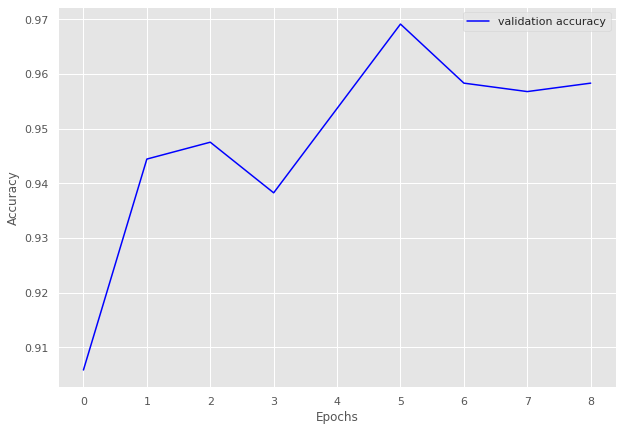

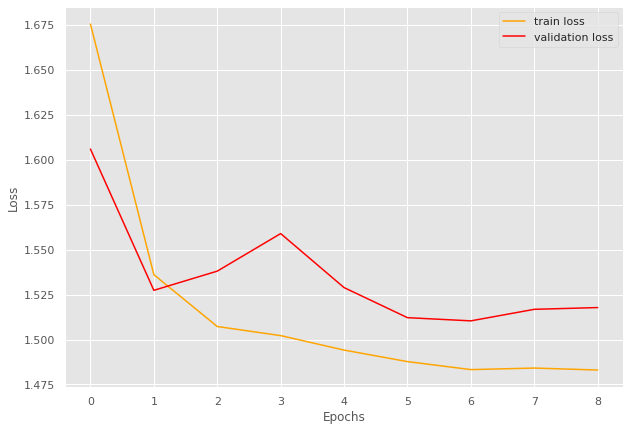

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 48/48 [00:39<00:00,  1.21batch/s, loss=0.865]


train loss 0.8652816861867905, validation loss 0.7888969779014587, validation accuracy 0.9539473684210527
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 48/48 [00:35<00:00,  1.34batch/s, loss=0.766]


train loss 0.7656077581147352, validation loss 0.786130177974701, validation accuracy 0.9572368421052632
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 48/48 [00:34<00:00,  1.37batch/s, loss=0.758]


train loss 0.7579979511598746, validation loss 0.7823793649673462, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 48/48 [00:19<00:00,  2.50batch/s, loss=0.761]


train loss 0.7608107961714268, validation loss 0.7741846323013306, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 48/48 [00:17<00:00,  2.81batch/s, loss=0.753]


train loss 0.7527144700288773, validation loss 0.7729539036750793, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.83batch/s, loss=0.75] 


train loss 0.7500222635765871, validation loss 0.7676504135131836, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.95batch/s, loss=0.75] 


INFO: Early stopping counter 1 of 5
train loss 0.749969539542993, validation loss 0.7797629952430725, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.91batch/s, loss=0.749]


INFO: Early stopping counter 2 of 5
train loss 0.7493111118674278, validation loss 0.7759771108627319, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.92batch/s, loss=0.752]


INFO: Early stopping counter 3 of 5
train loss 0.7523918524384499, validation loss 0.7737126827239991, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 10
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.89batch/s, loss=0.749]


INFO: Early stopping counter 4 of 5
train loss 0.7485750118891398, validation loss 0.777910315990448, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 11
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.89batch/s, loss=0.747]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9833333333333333 and loss 0.7597956440665505


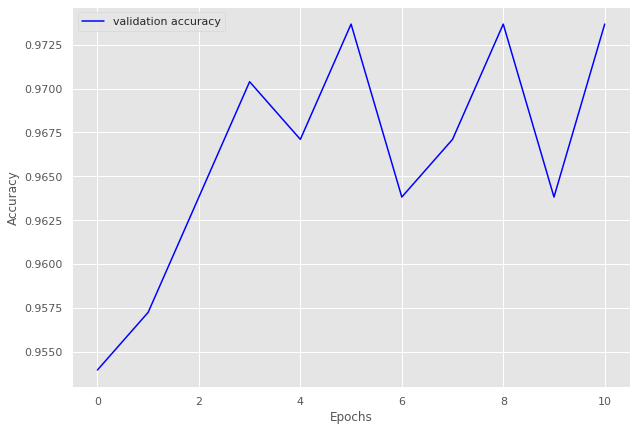

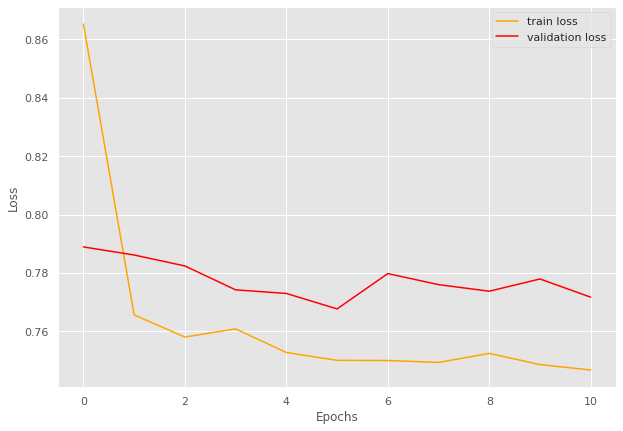

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 46/46 [00:15<00:00,  2.97batch/s, loss=1.31]


train loss 1.307772545710854, validation loss 1.1433907508850099, validation accuracy 0.8931034482758621
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.94batch/s, loss=1.12]


train loss 1.1237690604251365, validation loss 1.1093984842300415, validation accuracy 0.9275862068965517
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.97batch/s, loss=1.11]


INFO: Early stopping counter 1 of 5
train loss 1.1050011100976362, validation loss 1.1128597021102906, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 46/46 [00:16<00:00,  2.86batch/s, loss=1.09]


INFO: Early stopping counter 2 of 5
train loss 1.0911547697108726, validation loss 1.1176704168319702, validation accuracy 0.9275862068965517
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.97batch/s, loss=1.09]


train loss 1.0924344684766687, validation loss 1.1053995370864869, validation accuracy 0.9310344827586207
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.94batch/s, loss=1.09]


train loss 1.0864454715148262, validation loss 1.1020362377166748, validation accuracy 0.9379310344827586
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 46/46 [00:16<00:00,  2.87batch/s, loss=1.09]


INFO: Early stopping counter 3 of 5
train loss 1.0851420941560164, validation loss 1.105667281150818, validation accuracy 0.9344827586206896
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.98batch/s, loss=1.08]


INFO: Early stopping counter 4 of 5
train loss 1.0798401573429937, validation loss 1.1063093900680543, validation accuracy 0.9344827586206896
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.97batch/s, loss=1.07]


train loss 1.0723677718121072, validation loss 1.0969282388687134, validation accuracy 0.9448275862068966
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.96batch/s, loss=1.07]


train loss 1.0705901902654897, validation loss 1.0916199445724488, validation accuracy 0.9551724137931035
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.96batch/s, loss=1.07]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9393939393939394 and loss 1.1024160101300193


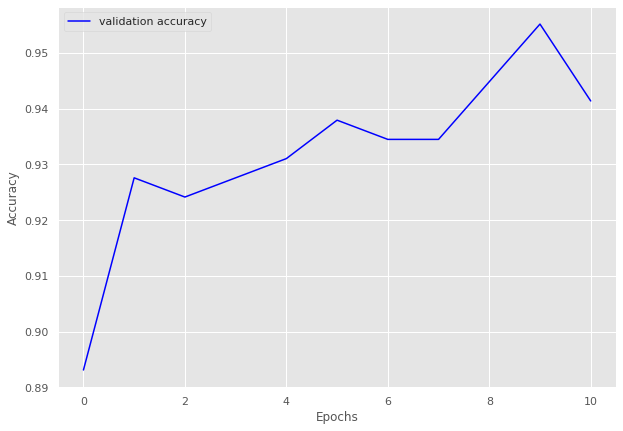

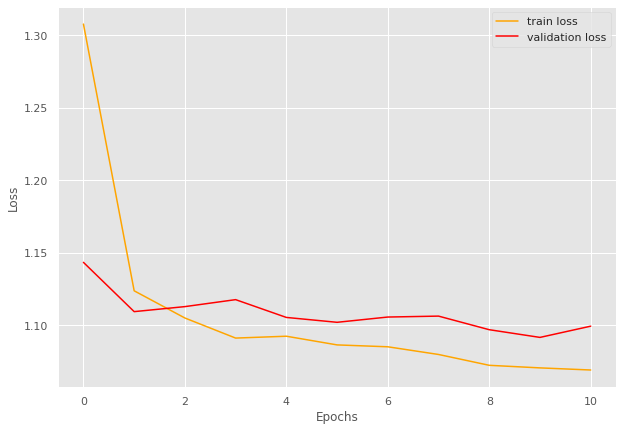

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=0.675]


train loss 0.6753099226370091, validation loss 0.592408287525177, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.599]


train loss 0.5994827311213423, validation loss 0.5918610572814942, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.87batch/s, loss=0.588]


train loss 0.5877683947725993, validation loss 0.5860027074813843, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.84batch/s, loss=0.575]


INFO: Early stopping counter 1 of 5
train loss 0.574622985793323, validation loss 0.5862390637397766, validation accuracy 0.9613899613899614
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=0.583]


INFO: Early stopping counter 2 of 5
train loss 0.5825909245304945, validation loss 0.5954081892967225, validation accuracy 0.9459459459459459
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.96batch/s, loss=0.575]


INFO: Early stopping counter 3 of 5
train loss 0.5745610885503816, validation loss 0.5879406929016113, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.573]


train loss 0.5733986714991127, validation loss 0.5846199870109559, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.568]


train loss 0.5682941878714213, validation loss 0.5799102902412414, validation accuracy 0.9652509652509652
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.565]


train loss 0.5652559036161842, validation loss 0.574538791179657, validation accuracy 0.972972972972973
Coarse label 13 Epoch 10
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.564]


INFO: Early stopping counter 4 of 5
train loss 0.5636483372711554, validation loss 0.5773136019706726, validation accuracy 0.9691119691119691
Coarse label 13 Epoch 11
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.89batch/s, loss=0.567]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9500213583938488 and loss 0.6008341022439905


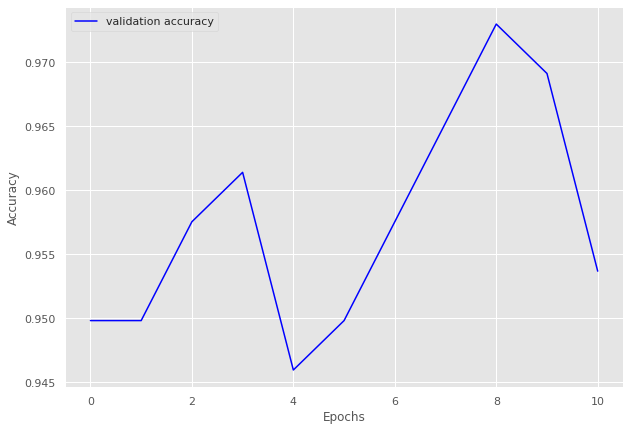

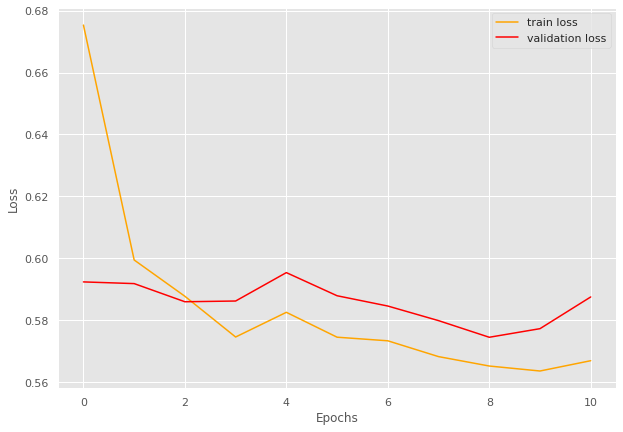

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 94/94 [00:31<00:00,  2.94batch/s, loss=1.16]


train loss 1.164803995731029, validation loss 1.112114131450653, validation accuracy 0.930976430976431
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.93batch/s, loss=1.08]


train loss 1.0804040279794247, validation loss 1.0990209698677063, validation accuracy 0.9461279461279462
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.97batch/s, loss=1.08]


train loss 1.0772084086499316, validation loss 1.092410409450531, validation accuracy 0.9545454545454546
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0680499508025798, validation loss 1.098038911819458, validation accuracy 0.9494949494949495
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.07]


train loss 1.0682862959009536, validation loss 1.0830787062644958, validation accuracy 0.9612794612794613
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.93batch/s, loss=1.06]


train loss 1.062506598360995, validation loss 1.0793984651565551, validation accuracy 0.9646464646464646
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.89batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0598956663557824, validation loss 1.080388069152832, validation accuracy 0.9663299663299664
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0636329245060048, validation loss 1.0830262422561645, validation accuracy 0.9612794612794613
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.96batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.0651465007599363, validation loss 1.0876636147499084, validation accuracy 0.9545454545454546
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9681860465116279 and loss 1.0753618748415084


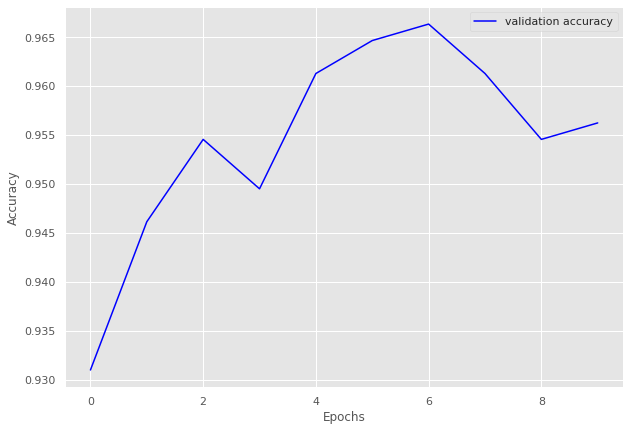

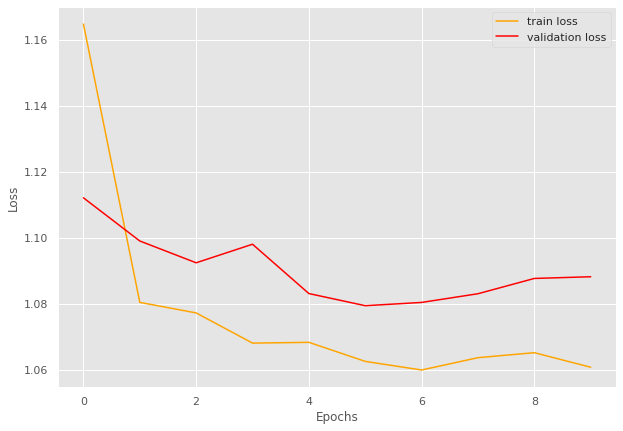

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 47/47 [00:15<00:00,  3.00batch/s, loss=0.904]


train loss 0.9035842000169957, validation loss 0.7987507462501526, validation accuracy 0.9387755102040817
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  3.00batch/s, loss=0.779]


train loss 0.7791580190049842, validation loss 0.7809821248054505, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.95batch/s, loss=0.768]


INFO: Early stopping counter 1 of 5
train loss 0.7683835473466427, validation loss 0.7888794422149659, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.97batch/s, loss=0.757]


train loss 0.7571691819962035, validation loss 0.7696415543556213, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.96batch/s, loss=0.755]


INFO: Early stopping counter 2 of 5
train loss 0.7553763199359813, validation loss 0.7814885020256043, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.96batch/s, loss=0.757]


INFO: Early stopping counter 3 of 5
train loss 0.7571242337531232, validation loss 0.7786929965019226, validation accuracy 0.9591836734693877
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.92batch/s, loss=0.755]


INFO: Early stopping counter 4 of 5
train loss 0.7545419969457261, validation loss 0.7734906315803528, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.98batch/s, loss=0.758]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9623210248681235 and loss 0.7811694996697562


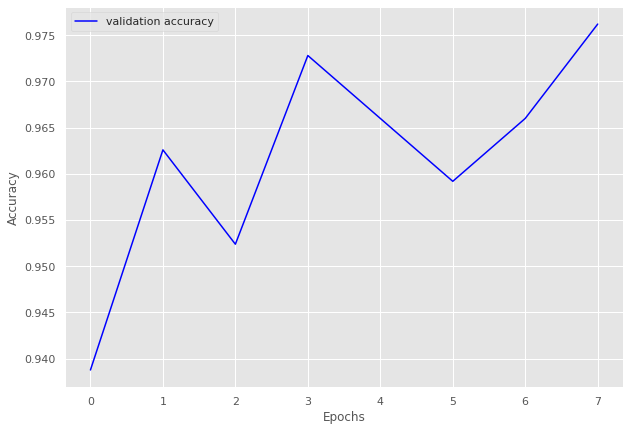

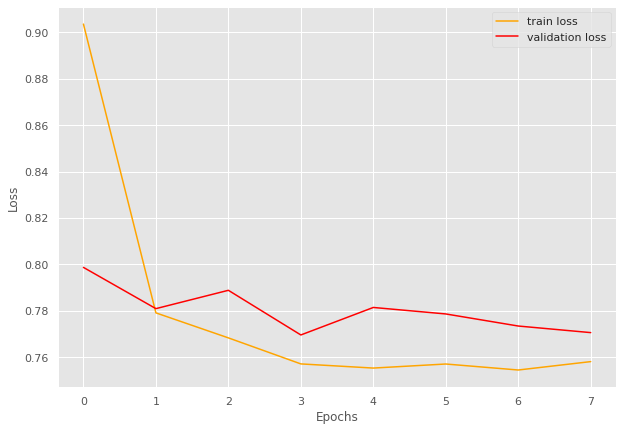

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 45/45 [00:14<00:00,  3.01batch/s, loss=0.675]


train loss 0.6745951533317566, validation loss 0.5842497944831848, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.98batch/s, loss=0.577]


INFO: Early stopping counter 1 of 5
train loss 0.5769866691695319, validation loss 0.5976871967315673, validation accuracy 0.9539007092198581
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.98batch/s, loss=0.571]


train loss 0.5707125743230184, validation loss 0.5825365066528321, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.97batch/s, loss=0.564]


train loss 0.5643809835116068, validation loss 0.5798336267471313, validation accuracy 0.975177304964539
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 45/45 [00:16<00:00,  2.78batch/s, loss=0.562]


train loss 0.5618259204758538, validation loss 0.5754382371902466, validation accuracy 0.9787234042553191
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.97batch/s, loss=0.561]


train loss 0.5611427148183187, validation loss 0.5699576616287232, validation accuracy 0.9822695035460993
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.94batch/s, loss=0.568]


INFO: Early stopping counter 2 of 5
train loss 0.5683968318833246, validation loss 0.5765354633331299, validation accuracy 0.9787234042553191
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.99batch/s, loss=0.569]


INFO: Early stopping counter 3 of 5
train loss 0.5687967035505507, validation loss 0.5753009438514709, validation accuracy 0.9822695035460993
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.99batch/s, loss=0.563]


INFO: Early stopping counter 4 of 5
train loss 0.5633710238668653, validation loss 0.5780048131942749, validation accuracy 0.9787234042553191
Coarse label 16 Epoch 10
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.97batch/s, loss=0.556]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9815541601255887 and loss 0.5710599392652511


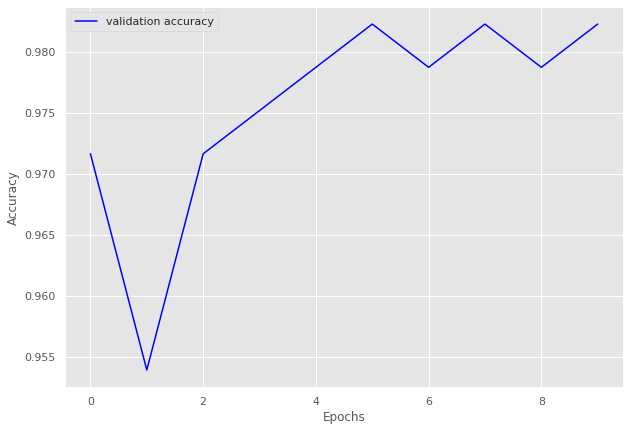

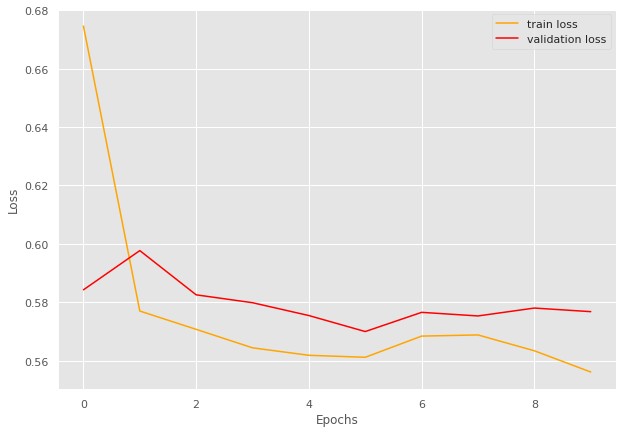

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=0.92] 


train loss 0.9196632942374872, validation loss 0.811874508857727, validation accuracy 0.9449838187702265
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 49/49 [00:17<00:00,  2.77batch/s, loss=0.787]


INFO: Early stopping counter 1 of 5
train loss 0.7873458619020424, validation loss 0.8174704074859619, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.98batch/s, loss=0.776]


train loss 0.7762327826752955, validation loss 0.8084773778915405, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.98batch/s, loss=0.773]


train loss 0.7729878072835961, validation loss 0.8024559617042542, validation accuracy 0.9385113268608414
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.97batch/s, loss=0.769]


train loss 0.7694941455004166, validation loss 0.7900816440582276, validation accuracy 0.9546925566343042
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.97batch/s, loss=0.763]


train loss 0.7632767387798854, validation loss 0.7819947123527526, validation accuracy 0.9611650485436893
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.98batch/s, loss=0.763]


INFO: Early stopping counter 2 of 5
train loss 0.7627098219735282, validation loss 0.7932071447372436, validation accuracy 0.9546925566343042
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.89batch/s, loss=0.762]


INFO: Early stopping counter 3 of 5
train loss 0.761566090340517, validation loss 0.7952392101287842, validation accuracy 0.941747572815534
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=0.76] 


INFO: Early stopping counter 4 of 5
train loss 0.7598541074869584, validation loss 0.7863353371620179, validation accuracy 0.9546925566343042
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=0.755]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9606017191977078 and loss 0.7839115546508268


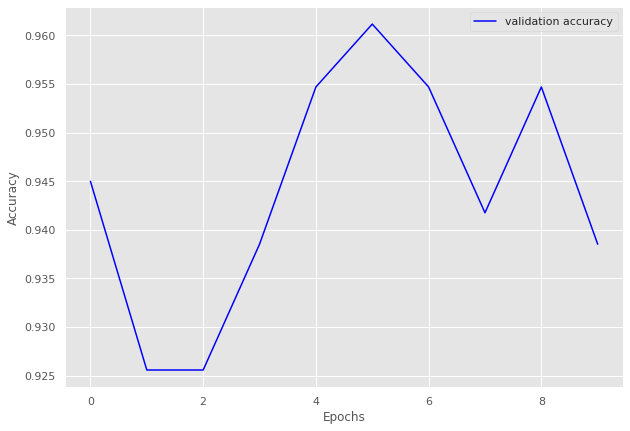

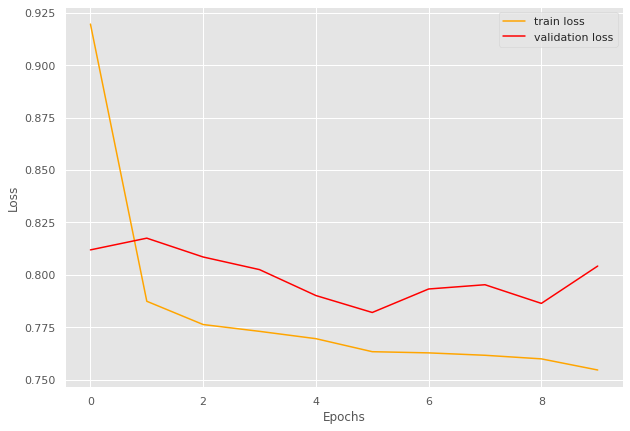

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 16/16 [00:05<00:00,  3.00batch/s, loss=1.05]


train loss 1.0512854680418968, validation loss 0.842602550983429, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  2.97batch/s, loss=0.8]  


train loss 0.7997285537421703, validation loss 0.79981330037117, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.09batch/s, loss=0.759]


train loss 0.7585372030735016, validation loss 0.7941065430641174, validation accuracy 0.9375
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.06batch/s, loss=0.751]


train loss 0.7513626217842102, validation loss 0.769264429807663, validation accuracy 0.96875
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.07batch/s, loss=0.75] 


INFO: Early stopping counter 1 of 5
train loss 0.7500424906611443, validation loss 0.7927352488040924, validation accuracy 0.9375
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.06batch/s, loss=0.749]


INFO: Early stopping counter 2 of 5
train loss 0.7494419664144516, validation loss 0.7843862771987915, validation accuracy 0.9375
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.02batch/s, loss=0.75] 


train loss 0.749623604118824, validation loss 0.7596242129802704, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.07batch/s, loss=0.75] 


train loss 0.750232208520174, validation loss 0.7557228803634644, validation accuracy 0.9895833333333334
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.02batch/s, loss=0.754]


INFO: Early stopping counter 3 of 5
train loss 0.753874272108078, validation loss 0.7634293735027313, validation accuracy 0.96875
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.06batch/s, loss=0.764]


INFO: Early stopping counter 4 of 5
train loss 0.7638583146035671, validation loss 0.7770240306854248, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.08batch/s, loss=0.763]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9671945701357466 and loss 0.7809816726616451


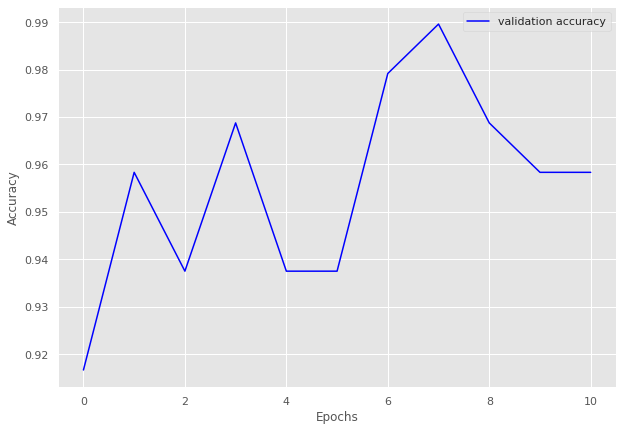

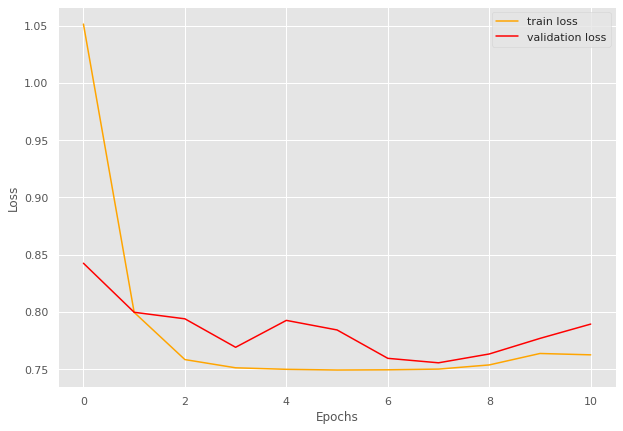

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=1.04]


train loss 1.0378154707611154, validation loss 0.9640478662082127, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 109/109 [00:36<00:00,  2.95batch/s, loss=0.951]


train loss 0.9510819458086556, validation loss 0.9540730629648481, validation accuracy 0.9533799533799534
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.945]


INFO: Early stopping counter 1 of 5
train loss 0.9451302869604268, validation loss 0.9543163776397705, validation accuracy 0.9533799533799534
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.90batch/s, loss=0.938]


train loss 0.937678596295348, validation loss 0.9534055590629578, validation accuracy 0.958041958041958
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.93batch/s, loss=0.94] 


INFO: Early stopping counter 2 of 5
train loss 0.9403007965569102, validation loss 0.9549207857676915, validation accuracy 0.9487179487179487
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.934]


train loss 0.9341825930350417, validation loss 0.9418295707021441, validation accuracy 0.9627039627039627
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 109/109 [00:38<00:00,  2.86batch/s, loss=0.936]


INFO: Early stopping counter 3 of 5
train loss 0.9358480343031227, validation loss 0.9499516572271075, validation accuracy 0.9533799533799534
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 109/109 [00:36<00:00,  2.96batch/s, loss=0.937]


INFO: Early stopping counter 4 of 5
train loss 0.9366541072862957, validation loss 0.9447237423488072, validation accuracy 0.9603729603729604
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.93batch/s, loss=0.941]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9715165511932256 and loss 0.9334456892240615


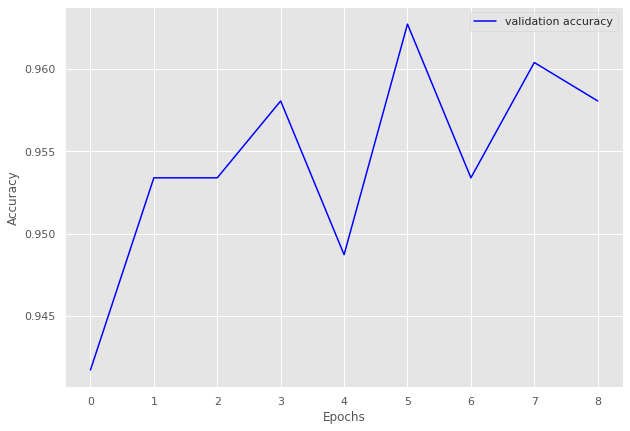

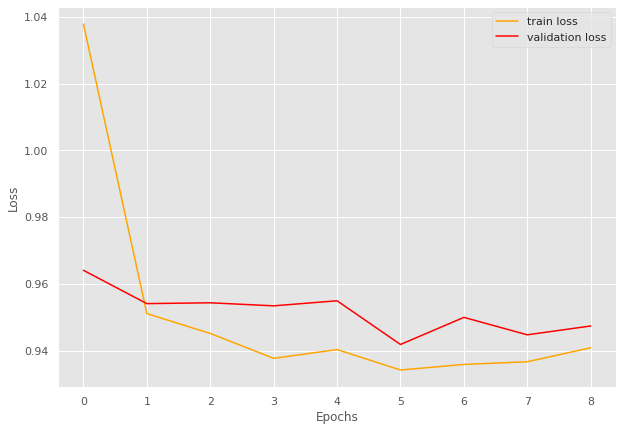

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 47/47 [00:16<00:00,  2.82batch/s, loss=1.22]


train loss 1.2226969967497157, validation loss 1.0716056029001872, validation accuracy 0.978494623655914
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.91batch/s, loss=1.09]


train loss 1.0894058004338691, validation loss 1.0622031291325886, validation accuracy 0.9838709677419355
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.92batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0730867182954829, validation loss 1.066490610440572, validation accuracy 0.9731182795698925
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.89batch/s, loss=1.07]


train loss 1.0691733081290062, validation loss 1.059279243151347, validation accuracy 0.989247311827957
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.90batch/s, loss=1.06]


train loss 1.059334635734558, validation loss 1.0569287935892742, validation accuracy 0.989247311827957
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.92batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.0536897562919778, validation loss 1.0581831137339275, validation accuracy 0.9838709677419355
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.92batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0544361281902233, validation loss 1.0614993572235107, validation accuracy 0.9838709677419355
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.83batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0555412972227056, validation loss 1.066177209218343, validation accuracy 0.978494623655914
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.92batch/s, loss=1.05]


train loss 1.0505131685987432, validation loss 1.0534494717915852, validation accuracy 0.989247311827957
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.90batch/s, loss=1.05]


train loss 1.0512992955268698, validation loss 1.050350268681844, validation accuracy 0.9946236559139785
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.90batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9683098591549296 and loss 1.0756007697847154


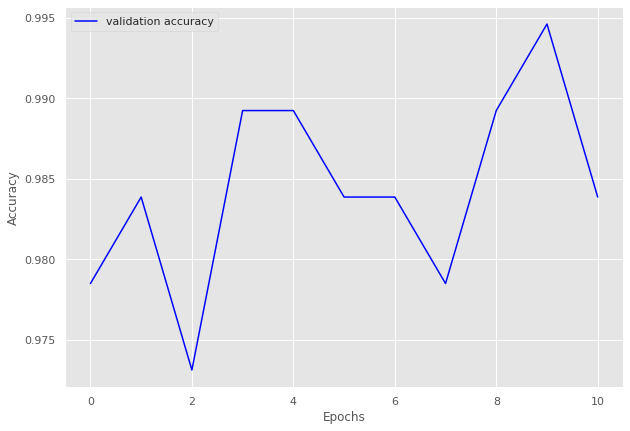

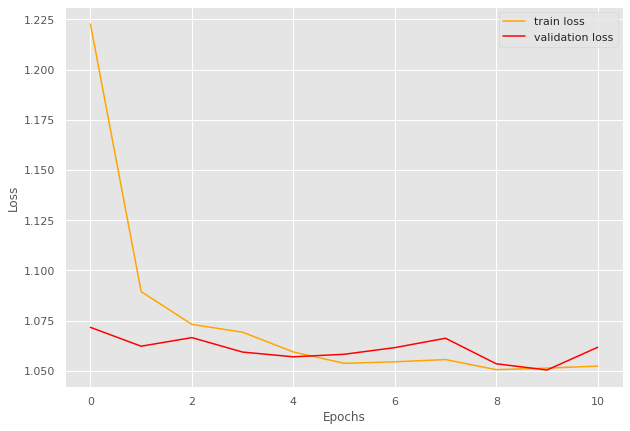

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 220/220 [01:16<00:00,  2.89batch/s, loss=1.62]


train loss 1.6214727179570632, validation loss 1.5375950251306807, validation accuracy 0.9310344827586207
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.92batch/s, loss=1.53]


train loss 1.5273957214572214, validation loss 1.5156190225056239, validation accuracy 0.9494252873563218
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.90batch/s, loss=1.51]


INFO: Early stopping counter 1 of 5
train loss 1.5143684804439546, validation loss 1.5204456789152963, validation accuracy 0.9402298850574713
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 220/220 [01:16<00:00,  2.87batch/s, loss=1.51]


INFO: Early stopping counter 2 of 5
train loss 1.5057097657160325, validation loss 1.5178351317133223, validation accuracy 0.9448275862068966
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.91batch/s, loss=1.5]


INFO: Early stopping counter 3 of 5
train loss 1.499501234292984, validation loss 1.5163241624832153, validation accuracy 0.9459770114942528
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 220/220 [01:20<00:00,  2.74batch/s, loss=1.5]


INFO: Early stopping counter 4 of 5
train loss 1.4989824430509047, validation loss 1.5248666065079826, validation accuracy 0.9367816091954023
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 220/220 [02:18<00:00,  1.59batch/s, loss=1.49]


train loss 1.4934285223484038, validation loss 1.5125635521752494, validation accuracy 0.9517241379310345
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 220/220 [02:02<00:00,  1.80batch/s, loss=1.49]


train loss 1.4911218827421016, validation loss 1.5117018137659346, validation accuracy 0.9528735632183908
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.90batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9582225598176984 and loss 1.505110760529836


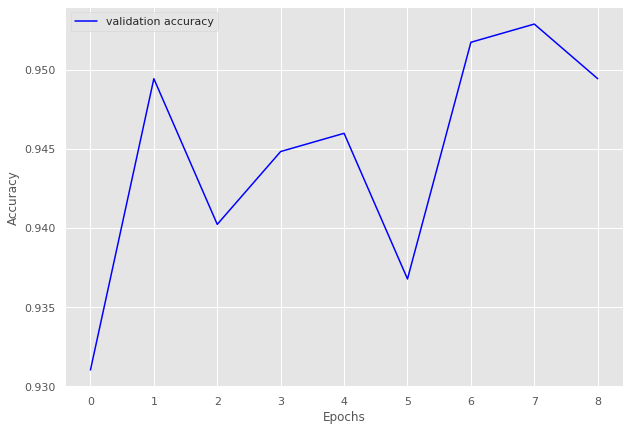

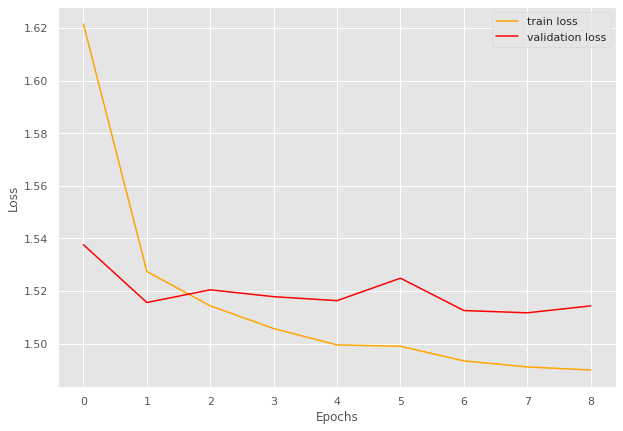

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 104/104 [00:35<00:00,  2.95batch/s, loss=1.2]


train loss 1.2018108413769648, validation loss 1.1156297411237444, validation accuracy 0.9344660194174758
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.90batch/s, loss=1.1]


train loss 1.0961494354101329, validation loss 1.094105873789106, validation accuracy 0.9466019417475728
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.96batch/s, loss=1.08]


train loss 1.0830424599922621, validation loss 1.0794520378112793, validation accuracy 0.9635922330097088
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.95batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.078390093950125, validation loss 1.085487689290728, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.90batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.072529775591997, validation loss 1.0875760657446725, validation accuracy 0.9514563106796117
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.94batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0682137574140842, validation loss 1.080580404826573, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.95batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.0663615671487956, validation loss 1.085817473275321, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 104/104 [00:36<00:00,  2.88batch/s, loss=1.07]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9662379421221865 and loss 1.0772060811519624


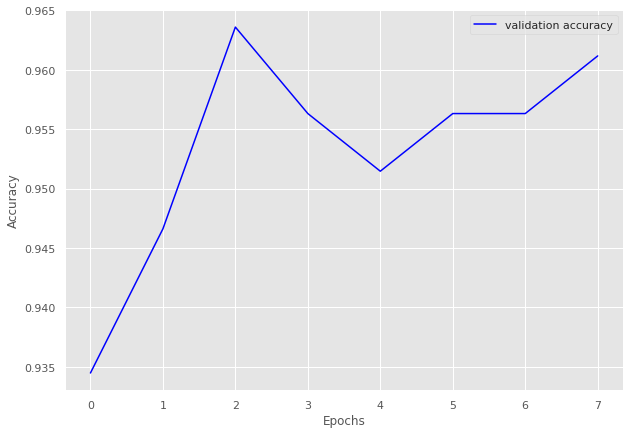

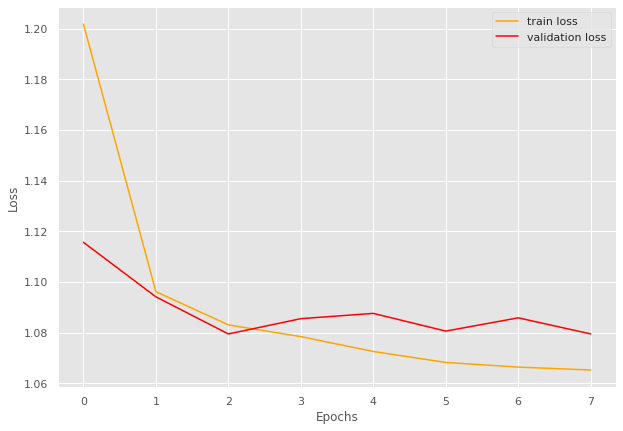

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 40/40 [00:13<00:00,  2.91batch/s, loss=0.377]


train loss 0.3774651028215885, validation loss 0.32449207703272503, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.94batch/s, loss=0.328]


train loss 0.3283145070075989, validation loss 0.32347529133160907, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.91batch/s, loss=0.32] 


INFO: Early stopping counter 1 of 5
train loss 0.32044014930725095, validation loss 0.3237876395384471, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.91batch/s, loss=0.32] 


INFO: Early stopping counter 2 of 5
train loss 0.3204094909131527, validation loss 0.3302570680777232, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.88batch/s, loss=0.321]


train loss 0.32086180374026296, validation loss 0.3233415484428406, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.93batch/s, loss=0.32] 


train loss 0.320296174287796, validation loss 0.31616803010304767, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.94batch/s, loss=0.317]


train loss 0.3174067310988903, validation loss 0.3134140769640605, validation accuracy 1.0
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.92batch/s, loss=0.316]


INFO: Early stopping counter 3 of 5
train loss 0.31603338941931725, validation loss 0.32331812381744385, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 40/40 [00:14<00:00,  2.78batch/s, loss=0.315]


INFO: Early stopping counter 4 of 5
train loss 0.3154635116457939, validation loss 0.3240373233954112, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 10
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.95batch/s, loss=0.315]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9854469854469855 and loss 0.32628875225782394


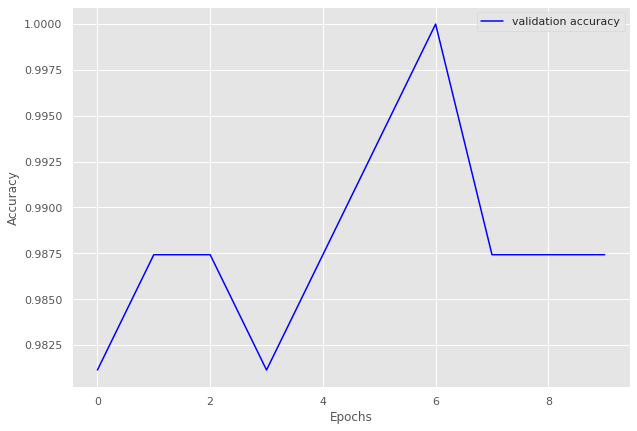

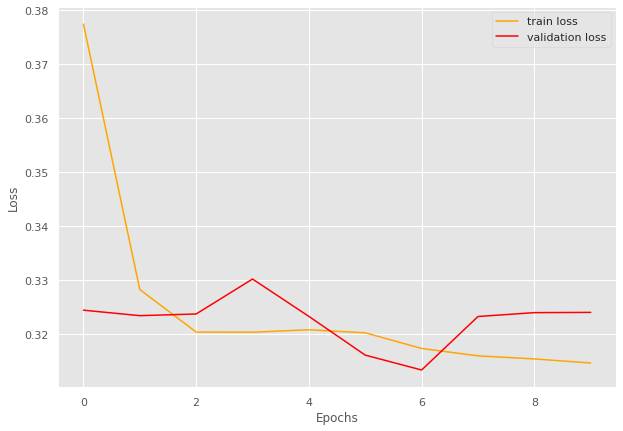

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.31]


train loss 1.3050742088220058, validation loss 1.2390439212322235, validation accuracy 0.9224137931034483
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.22]


train loss 1.2228511072631576, validation loss 1.2242918461561203, validation accuracy 0.9418103448275862
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.95batch/s, loss=1.22]


train loss 1.2222612902649448, validation loss 1.2217557430267334, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 117/117 [00:40<00:00,  2.89batch/s, loss=1.21]


train loss 1.2113240437629895, validation loss 1.217827394604683, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.2]


train loss 1.2020770678153405, validation loss 1.2168562859296799, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.21]


train loss 1.2082345842296243, validation loss 1.2145681381225586, validation accuracy 0.9461206896551724
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.2]


INFO: Early stopping counter 1 of 5
train loss 1.1984072862527309, validation loss 1.2158969789743423, validation accuracy 0.9439655172413793
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 117/117 [00:40<00:00,  2.90batch/s, loss=1.19]


train loss 1.1947220645399175, validation loss 1.2080583721399307, validation accuracy 0.9525862068965517
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.19]


INFO: Early stopping counter 2 of 5
train loss 1.193760178028009, validation loss 1.2099801450967789, validation accuracy 0.9482758620689655
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.95batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1892127705435467, validation loss 1.2089113891124725, validation accuracy 0.9504310344827587
Coarse label 6 Epoch 11
-------------------------------


100%|██████████| 117/117 [00:40<00:00,  2.89batch/s, loss=1.19]


train loss 1.1863242133050902, validation loss 1.203356295824051, validation accuracy 0.959051724137931
Coarse label 6 Epoch 12
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.95batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1851499651232336, validation loss 1.2136931270360947, validation accuracy 0.9461206896551724
Coarse label 6 Epoch 13
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.95batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9679715302491103 and loss 1.1977407011118801


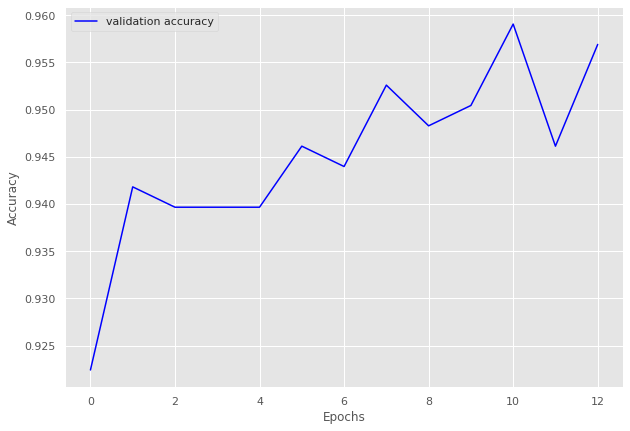

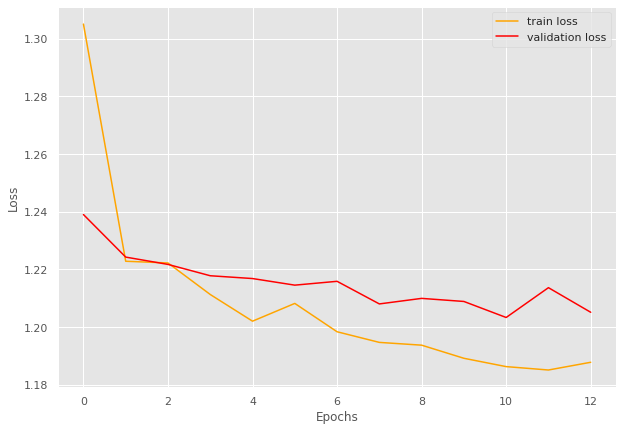

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 92/92 [00:46<00:00,  1.97batch/s, loss=0.824]


train loss 0.8242604875046274, validation loss 0.7666227916876475, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 92/92 [01:08<00:00,  1.34batch/s, loss=0.775]


train loss 0.7747834713562675, validation loss 0.7593962450822195, validation accuracy 0.9834710743801653
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 92/92 [01:10<00:00,  1.30batch/s, loss=0.768]


INFO: Early stopping counter 1 of 5
train loss 0.7678268221409424, validation loss 0.7640390396118164, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 92/92 [00:47<00:00,  1.94batch/s, loss=0.759]


train loss 0.7592624633208566, validation loss 0.7576607465744019, validation accuracy 0.9862258953168044
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.88batch/s, loss=0.76] 


INFO: Early stopping counter 2 of 5
train loss 0.7600934816443402, validation loss 0.7581961850325266, validation accuracy 0.9862258953168044
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.92batch/s, loss=0.757]


train loss 0.7567166413949884, validation loss 0.7536705533663431, validation accuracy 0.9917355371900827
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.89batch/s, loss=0.754]


INFO: Early stopping counter 3 of 5
train loss 0.7542237581118293, validation loss 0.7607550521691641, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.93batch/s, loss=0.754]


INFO: Early stopping counter 4 of 5
train loss 0.7544931205718414, validation loss 0.7567581633726755, validation accuracy 0.9862258953168044
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 92/92 [00:32<00:00,  2.83batch/s, loss=0.753]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9854280510018215 and loss 0.7587729427549574


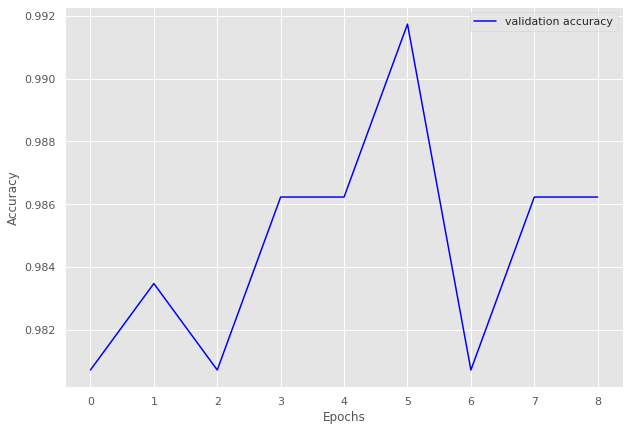

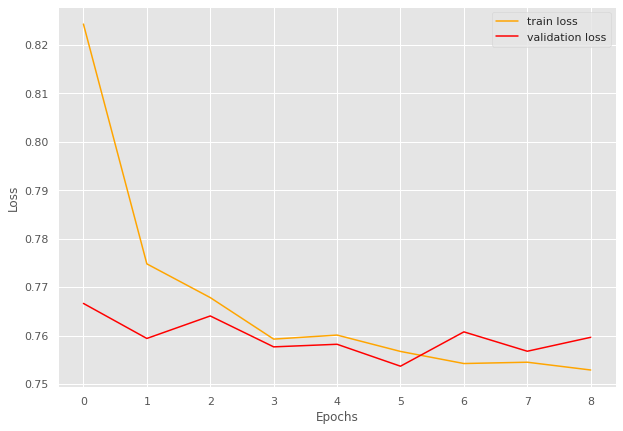

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 129/129 [00:44<00:00,  2.91batch/s, loss=1.33]


train loss 1.3292092500731003, validation loss 1.2531981617212296, validation accuracy 0.9158512720156555
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.91batch/s, loss=1.23]


train loss 1.228540256965992, validation loss 1.2339790314435959, validation accuracy 0.9373776908023483
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.89batch/s, loss=1.21]


train loss 1.2144804656967636, validation loss 1.2180685102939606, validation accuracy 0.9471624266144814
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.91batch/s, loss=1.2]


INFO: Early stopping counter 1 of 5
train loss 1.203420689863752, validation loss 1.2365867495536804, validation accuracy 0.9256360078277887
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.90batch/s, loss=1.2]


INFO: Early stopping counter 2 of 5
train loss 1.201832279678463, validation loss 1.2318031042814255, validation accuracy 0.9334637964774951
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.91batch/s, loss=1.2]


INFO: Early stopping counter 3 of 5
train loss 1.1996896248455196, validation loss 1.236574798822403, validation accuracy 0.9275929549902152
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.88batch/s, loss=1.2]


train loss 1.1984846675118734, validation loss 1.2173977494239807, validation accuracy 0.949119373776908
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.90batch/s, loss=1.19]


train loss 1.1928410225136334, validation loss 1.2132212221622467, validation accuracy 0.9510763209393346
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.91batch/s, loss=1.19]


train loss 1.190379304479259, validation loss 1.2075541615486145, validation accuracy 0.958904109589041
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 129/129 [00:45<00:00,  2.86batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1926057079965755, validation loss 1.2109725326299667, validation accuracy 0.9549902152641878
Coarse label 8 Epoch 11
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.91batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9442644199611148 and loss 1.2184176015853883


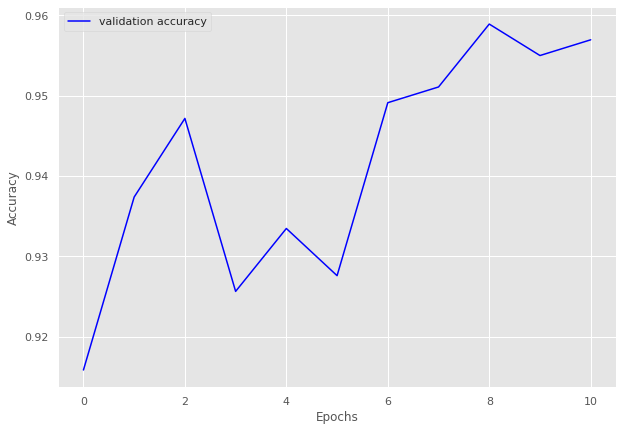

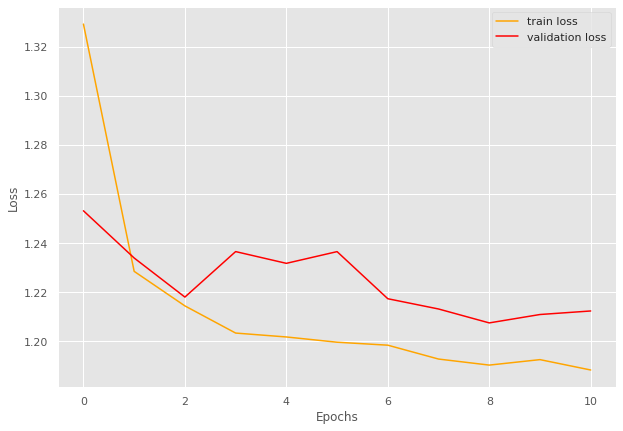

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 163/163 [00:56<00:00,  2.90batch/s, loss=1.63]


train loss 1.6255910813442769, validation loss 1.541395750912753, validation accuracy 0.9367283950617284
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.88batch/s, loss=1.52]


train loss 1.519699176396329, validation loss 1.5207292166623203, validation accuracy 0.9367283950617284
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.88batch/s, loss=1.5]


train loss 1.5023457674892402, validation loss 1.5091382698579268, validation accuracy 0.9583333333333334
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.88batch/s, loss=1.5]


INFO: Early stopping counter 1 of 5
train loss 1.4980738748070652, validation loss 1.5264184258200906, validation accuracy 0.9475308641975309
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 163/163 [00:57<00:00,  2.86batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4917173444127745, validation loss 1.5212969779968262, validation accuracy 0.9567901234567902
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.90batch/s, loss=1.48]


train loss 1.4849190426750418, validation loss 1.5088260498913852, validation accuracy 0.9552469135802469
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.90batch/s, loss=1.48]


train loss 1.482150943001355, validation loss 1.5056061527945779, validation accuracy 0.9583333333333334
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.90batch/s, loss=1.48]


train loss 1.4797824189706814, validation loss 1.4875131953846326, validation accuracy 0.9691358024691358
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4784381638275335, validation loss 1.5174438953399658, validation accuracy 0.9506172839506173
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 163/163 [00:57<00:00,  2.86batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4785824721576246, validation loss 1.5012518926100298, validation accuracy 0.9567901234567902
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 163/163 [00:55<00:00,  2.92batch/s, loss=1.47]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9769938650306749 and loss 1.48594283288525


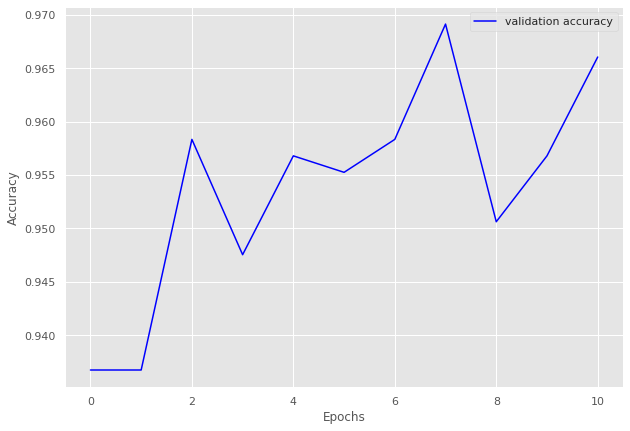

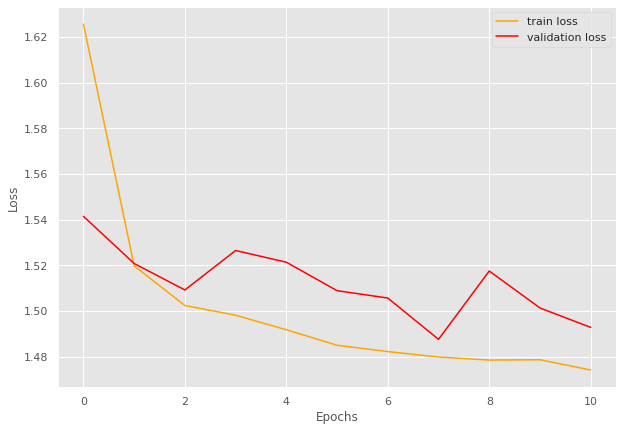

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 77/77 [00:26<00:00,  2.95batch/s, loss=0.833]


train loss 0.8330439762635664, validation loss 0.7837638974189758, validation accuracy 0.9572368421052632
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.93batch/s, loss=0.764]


train loss 0.7641826690017403, validation loss 0.7705810904502869, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.85batch/s, loss=0.759]


INFO: Early stopping counter 1 of 5
train loss 0.7592961958476475, validation loss 0.7750700831413269, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.92batch/s, loss=0.756]


train loss 0.7559046691114252, validation loss 0.7627776861190796, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.93batch/s, loss=0.755]


train loss 0.7545300675677015, validation loss 0.7614674687385559, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.91batch/s, loss=0.755]


INFO: Early stopping counter 2 of 5
train loss 0.7551629334301143, validation loss 0.7686551928520202, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.91batch/s, loss=0.756]


INFO: Early stopping counter 3 of 5
train loss 0.7563613150026891, validation loss 0.7783008098602295, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.94batch/s, loss=0.754]


train loss 0.7541943277631488, validation loss 0.7602934241294861, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 77/77 [00:27<00:00,  2.80batch/s, loss=0.753]


train loss 0.7529322791409183, validation loss 0.7575917363166809, validation accuracy 0.9868421052631579
Coarse label 11 Epoch 10
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.93batch/s, loss=0.749]


train loss 0.7491615979702442, validation loss 0.7542171001434326, validation accuracy 0.9901315789473685
Coarse label 11 Epoch 11
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.91batch/s, loss=0.753]


INFO: Early stopping counter 4 of 5
train loss 0.7525279382606606, validation loss 0.7591785073280335, validation accuracy 0.9868421052631579
Coarse label 11 Epoch 12
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.92batch/s, loss=0.751]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9771986970684039 and loss 0.7667569557825724


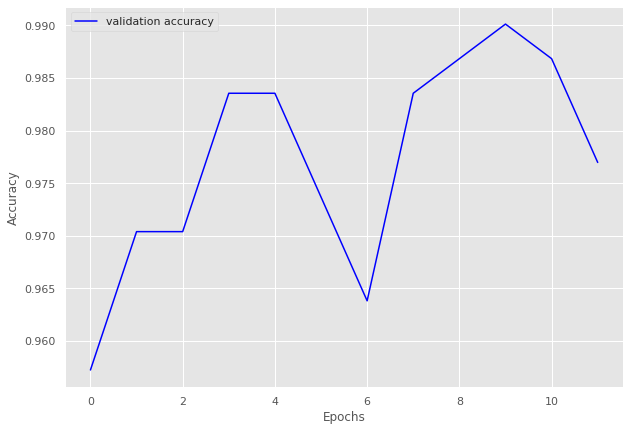

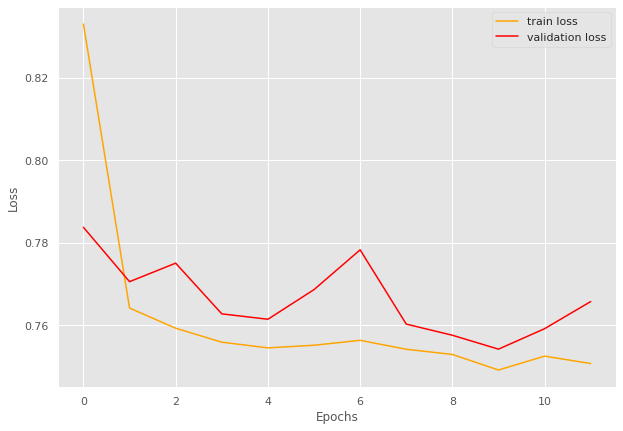

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 74/74 [00:44<00:00,  1.65batch/s, loss=1.24]


train loss 1.2375349644068125, validation loss 1.1053482294082642, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 74/74 [00:55<00:00,  1.33batch/s, loss=1.11]


INFO: Early stopping counter 1 of 5
train loss 1.111902164446341, validation loss 1.1083972215652467, validation accuracy 0.9344827586206896
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 74/74 [00:52<00:00,  1.40batch/s, loss=1.11]


train loss 1.1083255941803392, validation loss 1.09013671875, validation accuracy 0.9517241379310345
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 74/74 [00:48<00:00,  1.52batch/s, loss=1.1] 


INFO: Early stopping counter 2 of 5
train loss 1.0991111719930493, validation loss 1.0941583395004273, validation accuracy 0.9482758620689655
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 74/74 [00:26<00:00,  2.83batch/s, loss=1.09]


train loss 1.092091660241823, validation loss 1.0778367519378662, validation accuracy 0.9655172413793104
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 74/74 [00:27<00:00,  2.72batch/s, loss=1.09]


INFO: Early stopping counter 3 of 5
train loss 1.0888507333961692, validation loss 1.0895073413848877, validation accuracy 0.9551724137931035
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.95batch/s, loss=1.08]


INFO: Early stopping counter 4 of 5
train loss 1.0817029170087866, validation loss 1.0947050094604491, validation accuracy 0.9482758620689655
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=1.09]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9477866061293984 and loss 1.0969278301511491


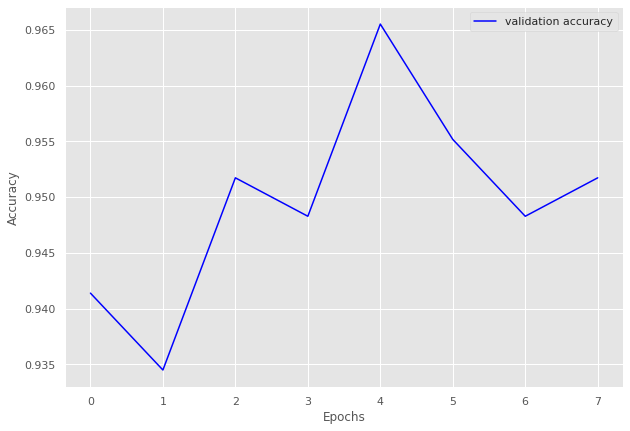

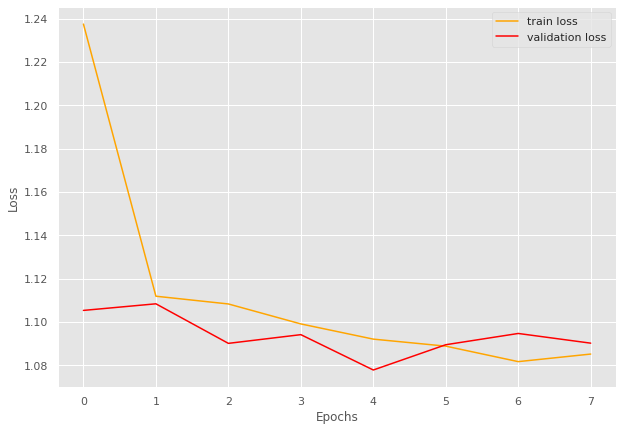

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=0.653]


train loss 0.6531814703574548, validation loss 0.5934587478637695, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.90batch/s, loss=0.593]


INFO: Early stopping counter 1 of 5
train loss 0.5932092354847834, validation loss 0.59664865732193, validation accuracy 0.9382239382239382
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.84batch/s, loss=0.586]


train loss 0.585868474153372, validation loss 0.5869314312934876, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=0.581]


train loss 0.5812564950722915, validation loss 0.584424364566803, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=0.578]


train loss 0.5782781793521001, validation loss 0.5783499121665955, validation accuracy 0.9613899613899614
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=0.577]


INFO: Early stopping counter 2 of 5
train loss 0.5769754180541405, validation loss 0.5827038407325744, validation accuracy 0.9613899613899614
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.94batch/s, loss=0.573]


INFO: Early stopping counter 3 of 5
train loss 0.5727170990063594, validation loss 0.5888887286186218, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=0.565]


INFO: Early stopping counter 4 of 5
train loss 0.5653957275243906, validation loss 0.5808306097984314, validation accuracy 0.9613899613899614
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.84batch/s, loss=0.565]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9590268886043534 and loss 0.5941957556284391


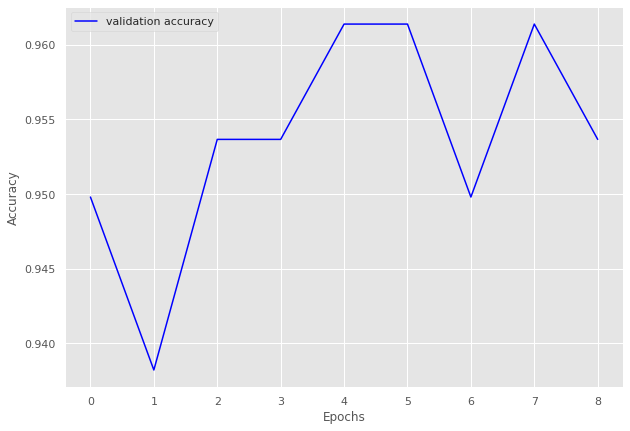

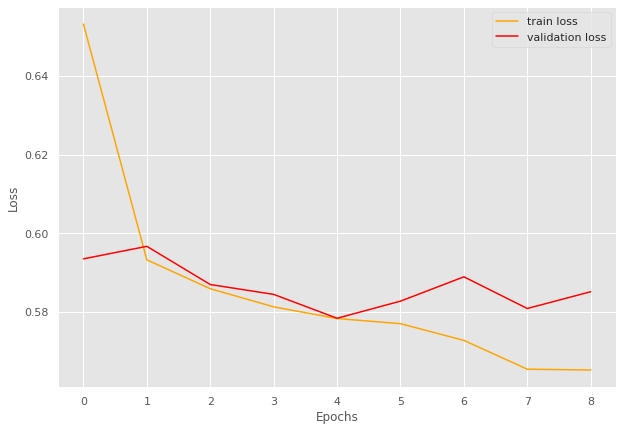

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 150/150 [00:51<00:00,  2.93batch/s, loss=1.14]


train loss 1.1440471307436626, validation loss 1.0763483047485352, validation accuracy 0.9696969696969697
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.92batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.0823870023091635, validation loss 1.0828354120254517, validation accuracy 0.9612794612794613
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.91batch/s, loss=1.07]


train loss 1.0719446190198263, validation loss 1.0648755073547362, validation accuracy 0.9797979797979798
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.93batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0677972976366679, validation loss 1.0755921602249146, validation accuracy 0.9764309764309764
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.92batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0638768521944681, validation loss 1.0662116050720214, validation accuracy 0.9781144781144782
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 150/150 [00:52<00:00,  2.88batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0634432156880698, validation loss 1.0710761427879334, validation accuracy 0.9730639730639731
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 150/150 [00:50<00:00,  2.94batch/s, loss=1.06]


train loss 1.0620320018132527, validation loss 1.0635356187820435, validation accuracy 0.9814814814814815
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.90batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9743446737311768 and loss 1.0685012669398868


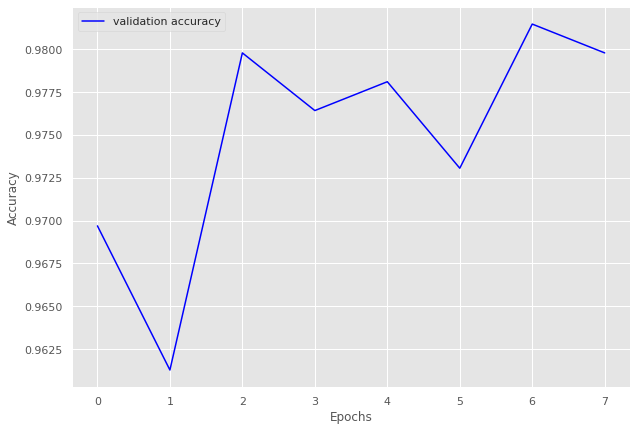

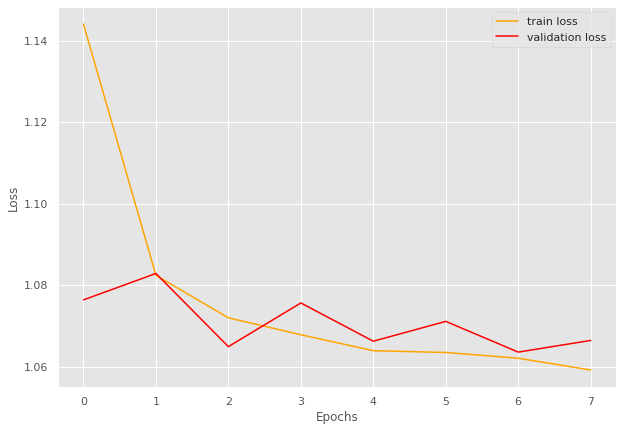

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 74/74 [00:25<00:00,  2.91batch/s, loss=0.86] 


train loss 0.8601459756090835, validation loss 0.764456033706665, validation accuracy 0.9795918367346939
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.86batch/s, loss=0.774]


INFO: Early stopping counter 1 of 5
train loss 0.7736455588727384, validation loss 0.7683019638061523, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.94batch/s, loss=0.766]


train loss 0.7661198812562067, validation loss 0.7570554375648498, validation accuracy 0.9863945578231292
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=0.76] 


INFO: Early stopping counter 2 of 5
train loss 0.7602211704125276, validation loss 0.7652506351470947, validation accuracy 0.9795918367346939
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.92batch/s, loss=0.759]


train loss 0.7591759667203233, validation loss 0.7528288006782532, validation accuracy 0.9863945578231292
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.92batch/s, loss=0.751]


INFO: Early stopping counter 3 of 5
train loss 0.7513239947525231, validation loss 0.7564717292785644, validation accuracy 0.9829931972789115
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.90batch/s, loss=0.752]


train loss 0.7515063237499546, validation loss 0.7517759203910828, validation accuracy 0.9897959183673469
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.88batch/s, loss=0.75] 


train loss 0.7504948361499889, validation loss 0.7508594274520874, validation accuracy 0.9931972789115646
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.7514578957815428, validation loss 0.7608554840087891, validation accuracy 0.9795918367346939
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=0.753]


train loss 0.7529298236241212, validation loss 0.7486975908279419, validation accuracy 0.9965986394557823
Coarse label 15 Epoch 11
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.91batch/s, loss=0.75] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9774266365688488 and loss 0.7662009128502437


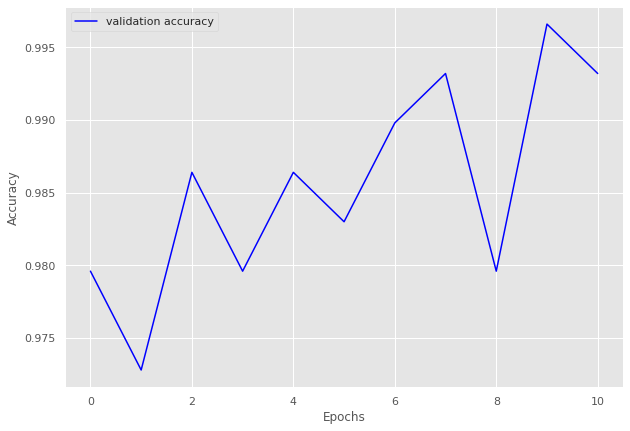

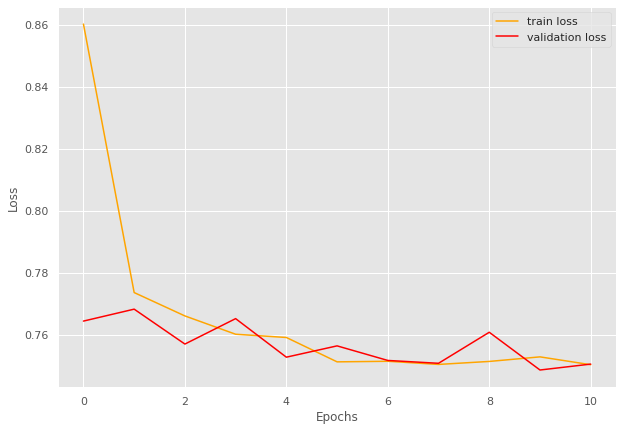

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 71/71 [00:24<00:00,  2.94batch/s, loss=0.64] 


train loss 0.6403097888113747, validation loss 0.5906582713127136, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.93batch/s, loss=0.582]


train loss 0.5824763682526601, validation loss 0.5749249458312988, validation accuracy 0.9787234042553191
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 71/71 [00:25<00:00,  2.84batch/s, loss=0.571]


INFO: Early stopping counter 1 of 5
train loss 0.5706562836405257, validation loss 0.5826131105422974, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.94batch/s, loss=0.568]


train loss 0.568337234812723, validation loss 0.5736608862876892, validation accuracy 0.9822695035460993
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.94batch/s, loss=0.564]


train loss 0.5644639419837737, validation loss 0.5691824078559875, validation accuracy 0.9787234042553191
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.94batch/s, loss=0.563]


INFO: Early stopping counter 2 of 5
train loss 0.5630180886094, validation loss 0.576776123046875, validation accuracy 0.975177304964539
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.92batch/s, loss=0.558]


train loss 0.5580807554889733, validation loss 0.5617433071136475, validation accuracy 0.9858156028368794
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.94batch/s, loss=0.559]


INFO: Early stopping counter 3 of 5
train loss 0.5590578090976661, validation loss 0.5618821144104004, validation accuracy 0.9858156028368794
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 71/71 [00:25<00:00,  2.84batch/s, loss=0.556]


INFO: Early stopping counter 4 of 5
train loss 0.5557686636145686, validation loss 0.5628480672836303, validation accuracy 0.9893617021276596
Coarse label 16 Epoch 10
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.96batch/s, loss=0.559]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.98 and loss 0.5743512255804879


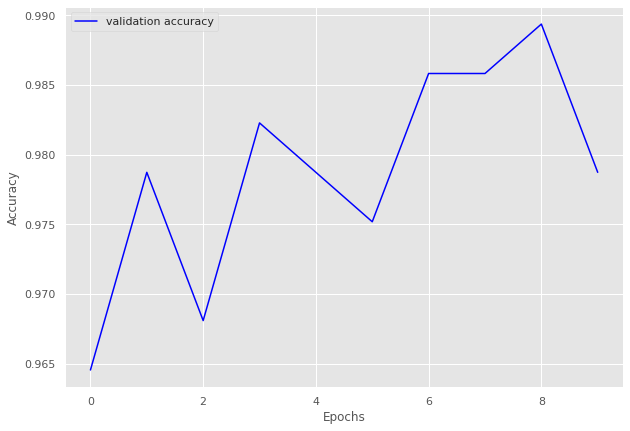

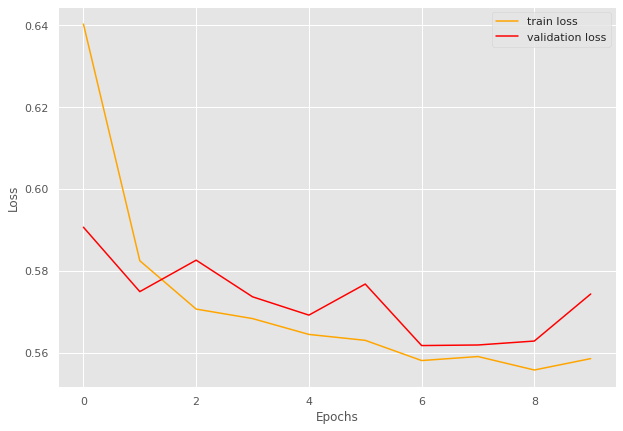

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 78/78 [00:26<00:00,  2.94batch/s, loss=0.885]


train loss 0.8851198103183355, validation loss 0.7994878053665161, validation accuracy 0.9385113268608414
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.92batch/s, loss=0.789]


train loss 0.7885836347555503, validation loss 0.797019624710083, validation accuracy 0.9449838187702265
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.96batch/s, loss=0.78] 


train loss 0.7796945663598868, validation loss 0.778740668296814, validation accuracy 0.9644012944983819
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.94batch/s, loss=0.772]


train loss 0.7716331672974122, validation loss 0.7749492526054382, validation accuracy 0.970873786407767
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 78/78 [00:27<00:00,  2.85batch/s, loss=0.767]


INFO: Early stopping counter 1 of 5
train loss 0.7666211219934317, validation loss 0.7799449563026428, validation accuracy 0.9611650485436893
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.94batch/s, loss=0.769]


INFO: Early stopping counter 2 of 5
train loss 0.7688965759216211, validation loss 0.7842843413352967, validation accuracy 0.9644012944983819
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.95batch/s, loss=0.765]


train loss 0.7648347784311343, validation loss 0.7728114128112793, validation accuracy 0.9741100323624595
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.93batch/s, loss=0.762]


INFO: Early stopping counter 3 of 5
train loss 0.7620221957182273, validation loss 0.78246089220047, validation accuracy 0.9579288025889967
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.94batch/s, loss=0.759]


INFO: Early stopping counter 4 of 5
train loss 0.7591771108981891, validation loss 0.7758695602416992, validation accuracy 0.9676375404530745
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 78/78 [00:27<00:00,  2.87batch/s, loss=0.757]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9645922746781116 and loss 0.7816256284713745


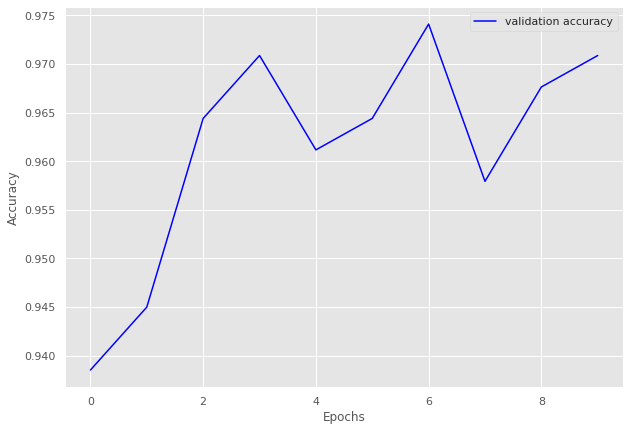

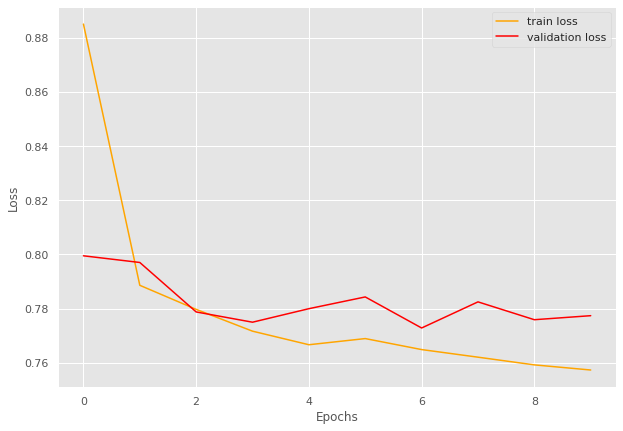

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 25/25 [00:08<00:00,  3.01batch/s, loss=0.971]


train loss 0.97134286403656, validation loss 0.8226163387298584, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.99batch/s, loss=0.784]


train loss 0.7842531061172485, validation loss 0.8059099316596985, validation accuracy 0.9375
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.82batch/s, loss=0.766]


train loss 0.7659984683990478, validation loss 0.7792241871356964, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.00batch/s, loss=0.756]


train loss 0.7563050937652588, validation loss 0.7703163921833038, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.98batch/s, loss=0.755]


INFO: Early stopping counter 1 of 5
train loss 0.755033700466156, validation loss 0.7896665632724762, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.99batch/s, loss=0.756]


train loss 0.7558698773384094, validation loss 0.7594054043292999, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.01batch/s, loss=0.751]


INFO: Early stopping counter 2 of 5
train loss 0.7512433791160583, validation loss 0.7672519385814667, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.96batch/s, loss=0.753]


INFO: Early stopping counter 3 of 5
train loss 0.7528360080718994, validation loss 0.759892612695694, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.95batch/s, loss=0.752]


INFO: Early stopping counter 4 of 5
train loss 0.752424201965332, validation loss 0.7615080177783966, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.92batch/s, loss=0.751]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9864864864864865 and loss 0.7560929775238037


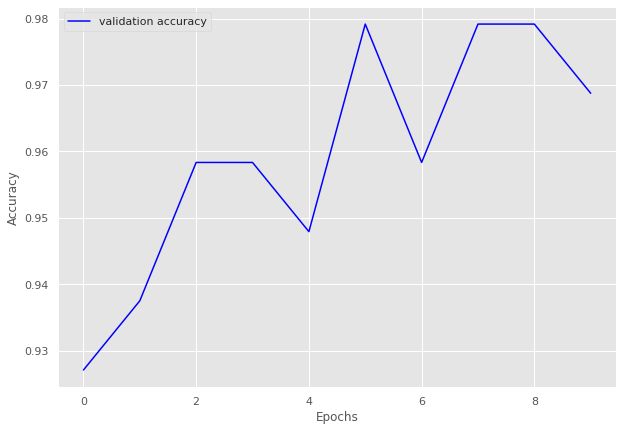

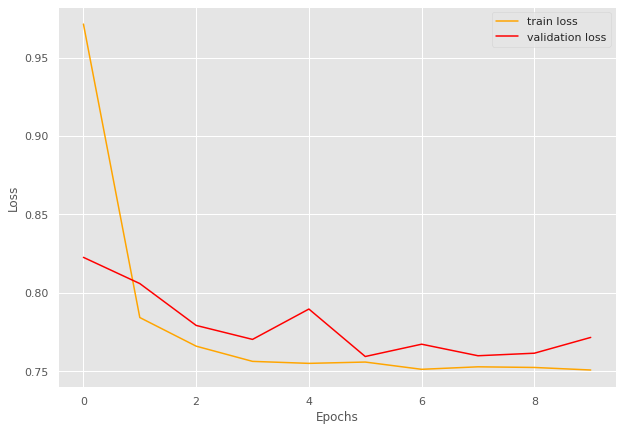

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 14/14 [00:04<00:00,  3.02batch/s, loss=1.34]


train loss 1.3354725582259042, validation loss 1.1131076642445155, validation accuracy 0.8181818181818182
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.01batch/s, loss=1]    


train loss 1.0004818950380598, validation loss 1.0008637990270342, validation accuracy 0.9044289044289044
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.02batch/s, loss=0.944]


INFO: Early stopping counter 1 of 5
train loss 0.9444448777607509, validation loss 1.00378052677427, validation accuracy 0.8974358974358975
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.04batch/s, loss=0.924]


train loss 0.9237312376499176, validation loss 0.9862777931349618, validation accuracy 0.916083916083916
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.94batch/s, loss=0.92] 


train loss 0.9199130918298449, validation loss 0.9800845554896763, validation accuracy 0.9277389277389277
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.03batch/s, loss=0.915]


INFO: Early stopping counter 2 of 5
train loss 0.9147684957299914, validation loss 0.9821667415755135, validation accuracy 0.9207459207459208
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 14/14 [00:05<00:00,  2.65batch/s, loss=0.917]


INFO: Early stopping counter 3 of 5
train loss 0.9168561697006226, validation loss 0.9867895586150033, validation accuracy 0.9137529137529138
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.99batch/s, loss=0.915]


INFO: Early stopping counter 4 of 5
train loss 0.9153456347329276, validation loss 0.9813824892044067, validation accuracy 0.916083916083916
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.01batch/s, loss=0.915]


train loss 0.9153869833265033, validation loss 0.9778108085904803, validation accuracy 0.9254079254079254
Coarse label 0 Epoch 10
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.98batch/s, loss=0.912]


train loss 0.9121272478784833, validation loss 0.9761109777859279, validation accuracy 0.9230769230769231
Coarse label 0 Epoch 11
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.02batch/s, loss=0.912]


train loss 0.9117298253944942, validation loss 0.9710990701402936, validation accuracy 0.9300699300699301
Coarse label 0 Epoch 12
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.05batch/s, loss=0.911]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9331881888692339 and loss 0.9712678525758827


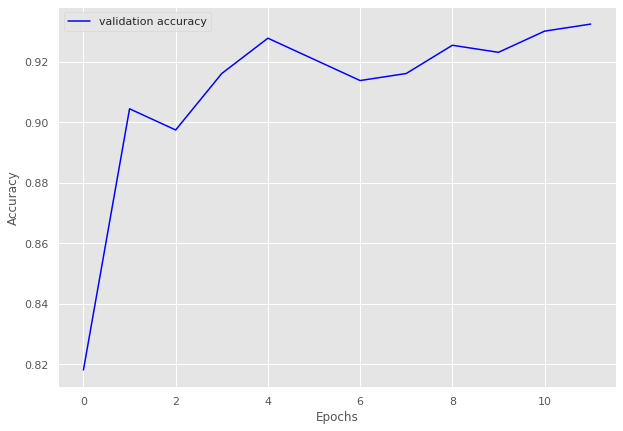

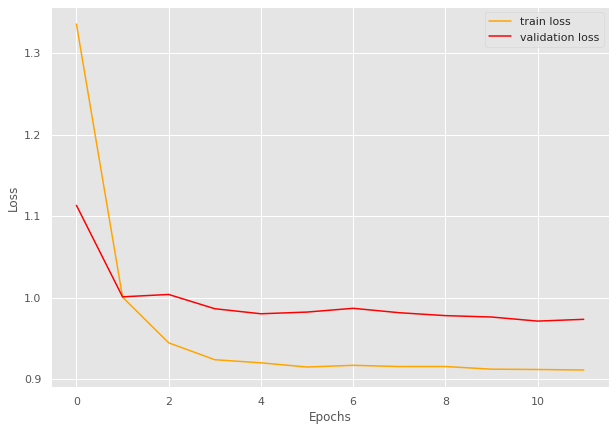

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 6/6 [00:02<00:00,  2.82batch/s, loss=1.63]


train loss 1.6293658812840779, validation loss 1.4550485610961914, validation accuracy 0.7526881720430108
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.24]


train loss 1.2350126504898071, validation loss 1.2456039587656658, validation accuracy 0.8440860215053764
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.97batch/s, loss=1.1] 


train loss 1.1015443404515584, validation loss 1.175828218460083, validation accuracy 0.8978494623655914
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.98batch/s, loss=1.06]


train loss 1.060074766476949, validation loss 1.1465859413146973, validation accuracy 0.9139784946236559
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 6/6 [00:01<00:00,  3.01batch/s, loss=1.05]


train loss 1.0536116758982341, validation loss 1.1338988542556763, validation accuracy 0.9139784946236559
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.97batch/s, loss=1.05]


train loss 1.0465591152509053, validation loss 1.126784364382426, validation accuracy 0.9247311827956989
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.05]


train loss 1.0465020338694255, validation loss 1.1263922850290935, validation accuracy 0.9139784946236559
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.95batch/s, loss=1.05]


INFO: Early stopping counter 1 of 5
train loss 1.0450882116953533, validation loss 1.127404014269511, validation accuracy 0.9086021505376344
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  3.00batch/s, loss=1.05]


train loss 1.0504199862480164, validation loss 1.125739296277364, validation accuracy 0.9247311827956989
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.80batch/s, loss=1.04]


INFO: Early stopping counter 2 of 5
train loss 1.0441903273264568, validation loss 1.1306318839391072, validation accuracy 0.9086021505376344
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.96batch/s, loss=1.04]


INFO: Early stopping counter 3 of 5
train loss 1.0442285935084026, validation loss 1.1334168513615925, validation accuracy 0.9086021505376344
Coarse label 1 Epoch 12
-------------------------------


100%|██████████| 6/6 [00:01<00:00,  3.01batch/s, loss=1.04]


INFO: Early stopping counter 4 of 5
train loss 1.0441563924153645, validation loss 1.1347742080688477, validation accuracy 0.9139784946236559
Coarse label 1 Epoch 13
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.97batch/s, loss=1.04]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9115348546420756 and loss 1.1363032364845276


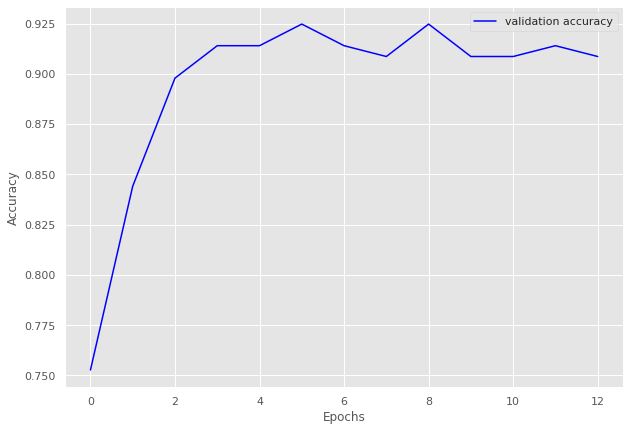

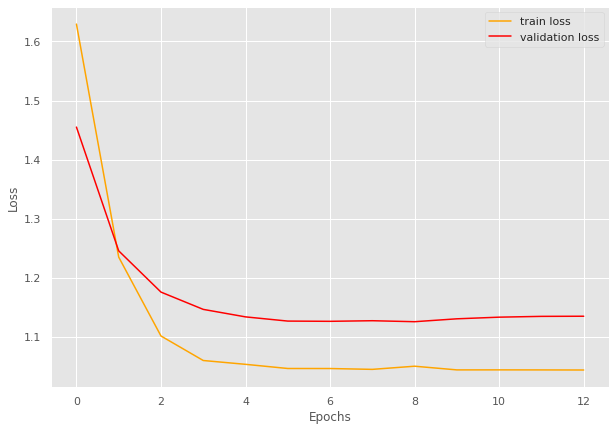

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.93]


train loss 1.929997980594635, validation loss 1.7380052294049944, validation accuracy 0.7655172413793103
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.62]


train loss 1.6185294687747955, validation loss 1.6320945705686296, validation accuracy 0.8540229885057471
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=1.53]


train loss 1.534936432327543, validation loss 1.6081595420837402, validation accuracy 0.8735632183908046
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.00batch/s, loss=1.51]


train loss 1.5070624777248927, validation loss 1.5865868500300817, validation accuracy 0.8850574712643678
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=1.5] 


INFO: Early stopping counter 1 of 5
train loss 1.4976145454815455, validation loss 1.5899525369916643, validation accuracy 0.8827586206896552
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=1.49]


train loss 1.487036602837699, validation loss 1.5847236173493522, validation accuracy 0.8804597701149425
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=1.48]


train loss 1.4823164897305625, validation loss 1.582264014652797, validation accuracy 0.8862068965517241
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.49]


train loss 1.4868967533111572, validation loss 1.5757233585630144, validation accuracy 0.896551724137931
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=1.48]


INFO: Early stopping counter 2 of 5
train loss 1.4817983210086823, validation loss 1.5771690011024475, validation accuracy 0.8908045977011494
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.477330859218325, validation loss 1.5762307814189367, validation accuracy 0.8873563218390804
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=1.47]


train loss 1.4745268949440546, validation loss 1.5743112478937422, validation accuracy 0.8885057471264368
Coarse label 2 Epoch 12
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4807069259030479, validation loss 1.588514770780291, validation accuracy 0.8827586206896552
Coarse label 2 Epoch 13
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.94batch/s, loss=1.48]


train loss 1.4785765877791814, validation loss 1.5734504887035914, validation accuracy 0.8977011494252873
Coarse label 2 Epoch 14
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9089018581874287 and loss 1.5543419045951745


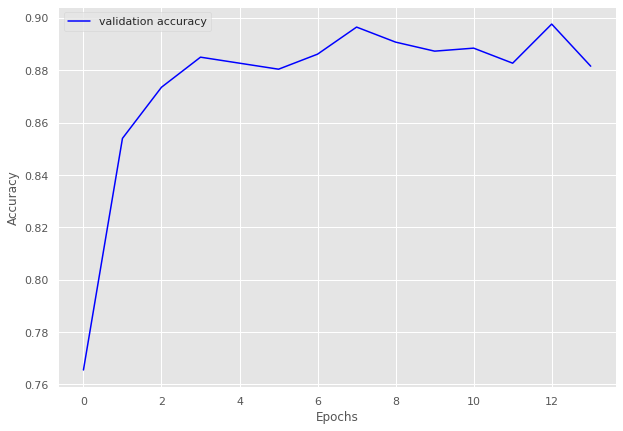

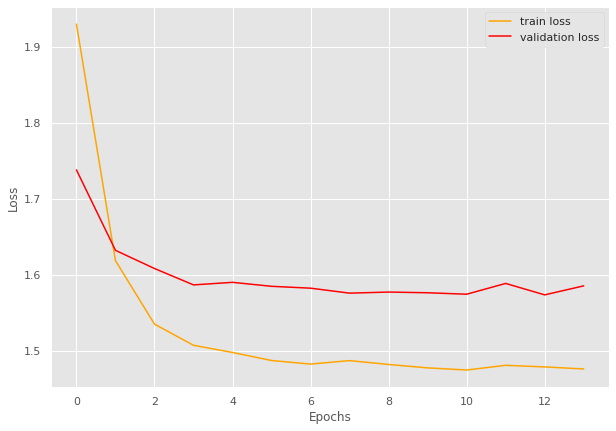

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 13/13 [00:04<00:00,  2.98batch/s, loss=1.52]


train loss 1.5240742793449988, validation loss 1.390692847115653, validation accuracy 0.720873786407767
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.95batch/s, loss=1.23]


train loss 1.2291967593706572, validation loss 1.2413000890186854, validation accuracy 0.8446601941747572
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.96batch/s, loss=1.12]


train loss 1.123356003027696, validation loss 1.1835077830723353, validation accuracy 0.8737864077669902
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.98batch/s, loss=1.08]


train loss 1.0798487113072321, validation loss 1.1666952541896276, validation accuracy 0.8907766990291263
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  3.00batch/s, loss=1.07]


train loss 1.065676395709698, validation loss 1.151826092175075, validation accuracy 0.9077669902912622
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.92batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.061528279231145, validation loss 1.1583139215196883, validation accuracy 0.8980582524271845
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  3.00batch/s, loss=1.06]


train loss 1.0623998091771052, validation loss 1.151449237551008, validation accuracy 0.9077669902912622
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.91batch/s, loss=1.06]


train loss 1.0553337518985455, validation loss 1.150182809148516, validation accuracy 0.9077669902912622
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.98batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.0543175568947425, validation loss 1.1520948239735194, validation accuracy 0.8980582524271845
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.98batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0510935049790602, validation loss 1.1527116979871477, validation accuracy 0.8980582524271845
Coarse label 4 Epoch 11
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.98batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0528683845813458, validation loss 1.1526141166687012, validation accuracy 0.8980582524271845
Coarse label 4 Epoch 12
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  3.00batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9100341102899374 and loss 1.1360126278617166


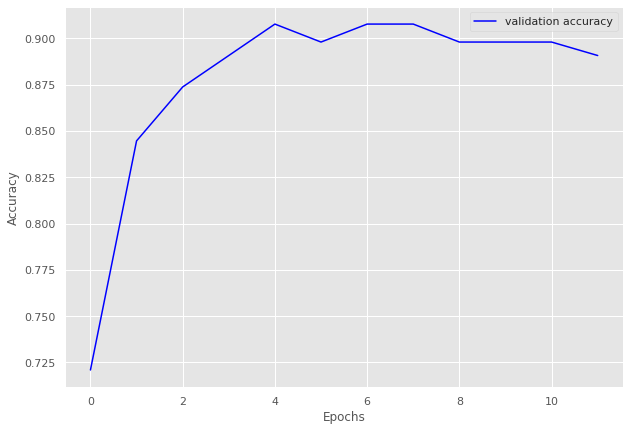

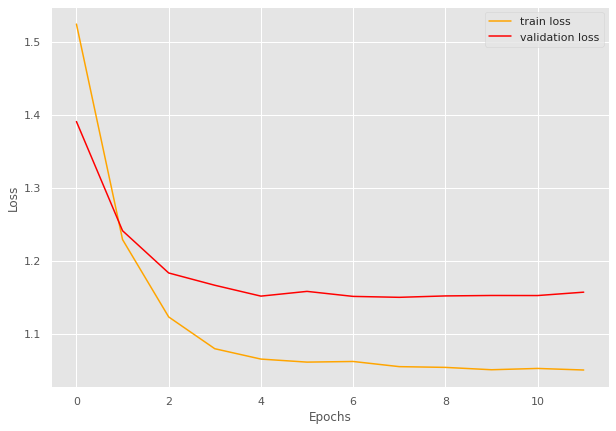

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 5/5 [00:01<00:00,  2.93batch/s, loss=0.536]


train loss 0.5356029987335205, validation loss 0.3965914746125539, validation accuracy 0.9433962264150944
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.92batch/s, loss=0.35] 


train loss 0.3497359037399292, validation loss 0.33506788810094196, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.93batch/s, loss=0.32] 


train loss 0.31958922147750857, validation loss 0.33010969559351605, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.92batch/s, loss=0.317]


train loss 0.3167829573154449, validation loss 0.3282558818658193, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.84batch/s, loss=0.321]


train loss 0.3209316790103912, validation loss 0.32721588015556335, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.91batch/s, loss=0.314]


INFO: Early stopping counter 1 of 5
train loss 0.3142456591129303, validation loss 0.3284010986487071, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.94batch/s, loss=0.314]


INFO: Early stopping counter 2 of 5
train loss 0.31350858211517335, validation loss 0.3313695987065633, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.93batch/s, loss=0.313]


INFO: Early stopping counter 3 of 5
train loss 0.3133959650993347, validation loss 0.33450742562611896, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.70batch/s, loss=0.313]


INFO: Early stopping counter 4 of 5
train loss 0.3134065747261047, validation loss 0.33764784534772235, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 10
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.94batch/s, loss=0.314]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9642857142857143 and loss 0.34800442637399187


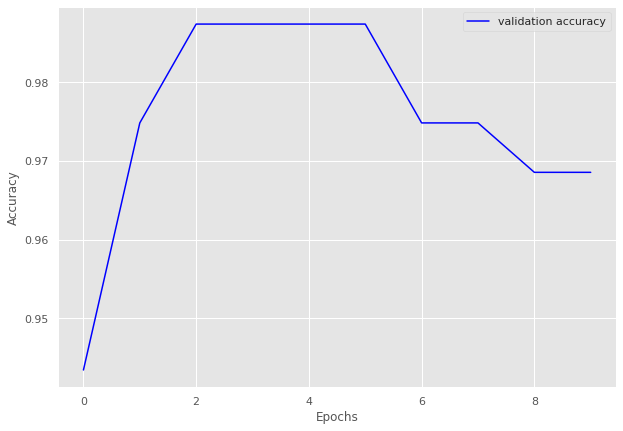

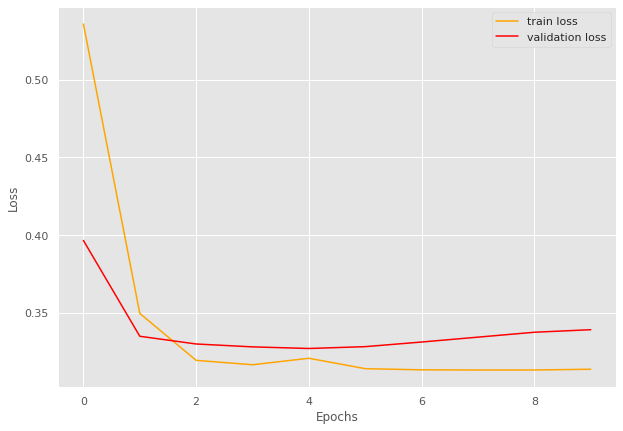

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 15/15 [00:04<00:00,  3.04batch/s, loss=1.6] 


train loss 1.598489801088969, validation loss 1.3832895904779434, validation accuracy 0.7866379310344828
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.89batch/s, loss=1.27]


train loss 1.2695561647415161, validation loss 1.2950463443994522, validation accuracy 0.8642241379310345
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.99batch/s, loss=1.21]


train loss 1.212198026974996, validation loss 1.2621238380670547, validation accuracy 0.9030172413793104
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.68batch/s, loss=1.2]


INFO: Early stopping counter 1 of 5
train loss 1.2019622008005777, validation loss 1.2630776315927505, validation accuracy 0.8987068965517241
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  3.00batch/s, loss=1.19]


INFO: Early stopping counter 2 of 5
train loss 1.1906878232955933, validation loss 1.2681088596582413, validation accuracy 0.8922413793103449
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.99batch/s, loss=1.18]


train loss 1.1838117361068725, validation loss 1.2580411583185196, validation accuracy 0.9051724137931034
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.01batch/s, loss=1.19]


train loss 1.1857511123021445, validation loss 1.251936912536621, validation accuracy 0.915948275862069
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.02batch/s, loss=1.19]


train loss 1.1873903195063273, validation loss 1.2510601431131363, validation accuracy 0.9202586206896551
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.02batch/s, loss=1.18]


INFO: Early stopping counter 3 of 5
train loss 1.1830876509348551, validation loss 1.2524867355823517, validation accuracy 0.9137931034482759
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.03batch/s, loss=1.18]


train loss 1.1772940317789713, validation loss 1.2359715104103088, validation accuracy 0.9331896551724138
Coarse label 6 Epoch 11
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.03batch/s, loss=1.18]


INFO: Early stopping counter 4 of 5
train loss 1.178669238090515, validation loss 1.2410227358341217, validation accuracy 0.9331896551724138
Coarse label 6 Epoch 12
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.93batch/s, loss=1.17]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9132023179642227 and loss 1.2540822219848633


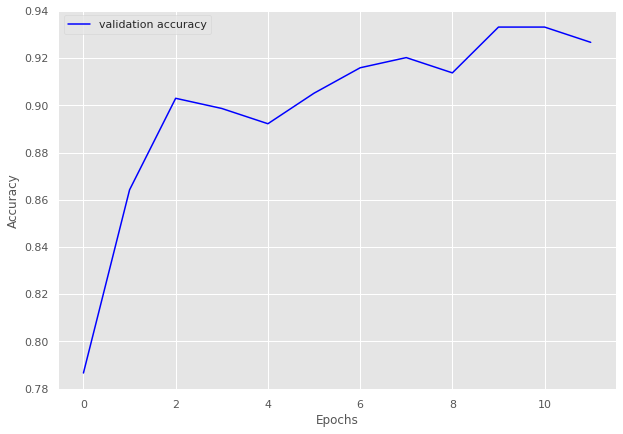

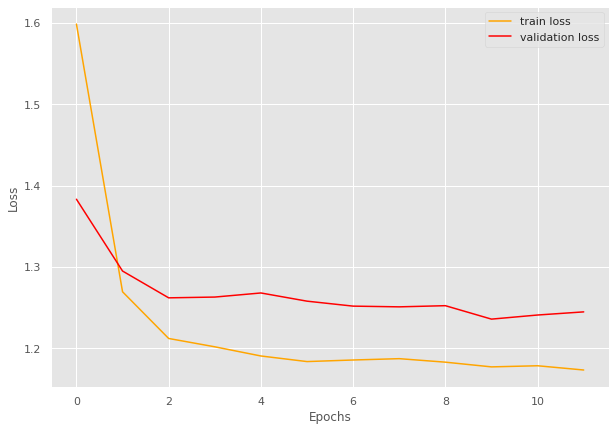

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 12/12 [00:04<00:00,  2.79batch/s, loss=1.06]


train loss 1.0600908994674683, validation loss 0.8422441681226095, validation accuracy 0.9090909090909091
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.07batch/s, loss=0.785]


train loss 0.7851017763217291, validation loss 0.7990321616331736, validation accuracy 0.9449035812672176
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.06batch/s, loss=0.767]


train loss 0.7673103113969167, validation loss 0.7981041669845581, validation accuracy 0.9476584022038568
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.08batch/s, loss=0.759]


INFO: Early stopping counter 1 of 5
train loss 0.7592712144056956, validation loss 0.798880527416865, validation accuracy 0.9421487603305785
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.02batch/s, loss=0.757]


train loss 0.7573190033435822, validation loss 0.7942868570486704, validation accuracy 0.9504132231404959
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.08batch/s, loss=0.748]


INFO: Early stopping counter 2 of 5
train loss 0.7481030523777008, validation loss 0.7954942286014557, validation accuracy 0.9476584022038568
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.97batch/s, loss=0.748]


INFO: Early stopping counter 3 of 5
train loss 0.747580423951149, validation loss 0.7953999042510986, validation accuracy 0.9504132231404959
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.08batch/s, loss=0.748]


INFO: Early stopping counter 4 of 5
train loss 0.7480189303557078, validation loss 0.7952487369378408, validation accuracy 0.9504132231404959
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.97batch/s, loss=0.747]


train loss 0.7467940002679825, validation loss 0.7935935258865356, validation accuracy 0.9504132231404959
Coarse label 7 Epoch 10
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.07batch/s, loss=0.748]


train loss 0.7482880602280298, validation loss 0.7911858856678009, validation accuracy 0.9504132231404959
Coarse label 7 Epoch 11
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.05batch/s, loss=0.747]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9673423423423423 and loss 0.7782500215939113


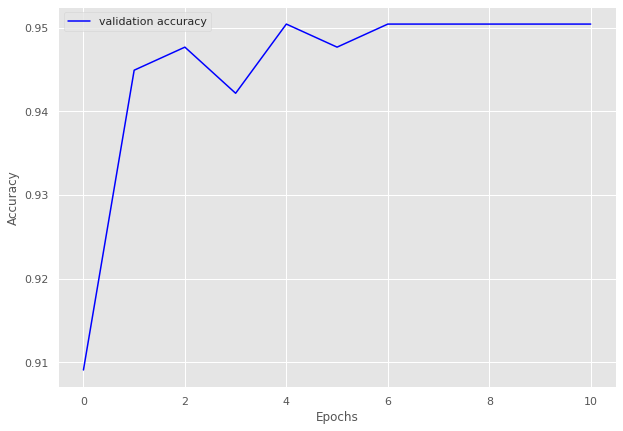

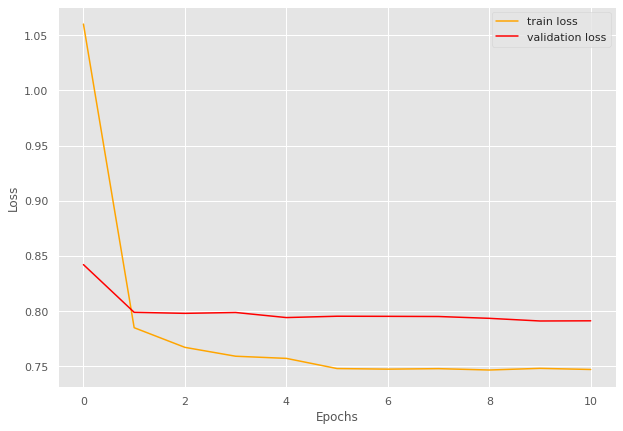

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 17/17 [00:05<00:00,  2.97batch/s, loss=1.73]


train loss 1.7311197519302368, validation loss 1.4474605172872543, validation accuracy 0.7514677103718199
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.06batch/s, loss=1.36]


train loss 1.3575521567288567, validation loss 1.284122422337532, validation accuracy 0.9021526418786693
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=1.26]


train loss 1.2632699643864351, validation loss 1.2774233669042587, validation accuracy 0.898238747553816
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.03batch/s, loss=1.23]


INFO: Early stopping counter 1 of 5
train loss 1.229212249026579, validation loss 1.279440313577652, validation accuracy 0.8923679060665362
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.06batch/s, loss=1.23]


train loss 1.229188421193291, validation loss 1.2709138095378876, validation accuracy 0.9001956947162426
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.10batch/s, loss=1.23]


INFO: Early stopping counter 2 of 5
train loss 1.22836575087379, validation loss 1.2762420028448105, validation accuracy 0.8923679060665362
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.04batch/s, loss=1.21]


train loss 1.2120514547123629, validation loss 1.2675058245658875, validation accuracy 0.9041095890410958
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=1.22]


INFO: Early stopping counter 3 of 5
train loss 1.224933098344242, validation loss 1.2794246226549149, validation accuracy 0.8923679060665362
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=1.21]


INFO: Early stopping counter 4 of 5
train loss 1.2121865609112907, validation loss 1.2747843563556671, validation accuracy 0.8943248532289628
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=1.22]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.886165826843793 and loss 1.2856197922769255


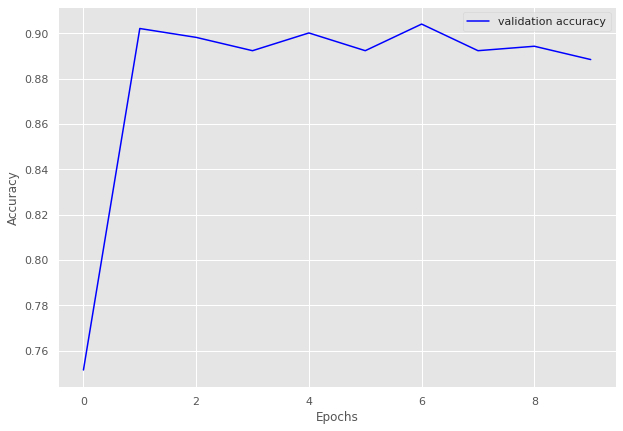

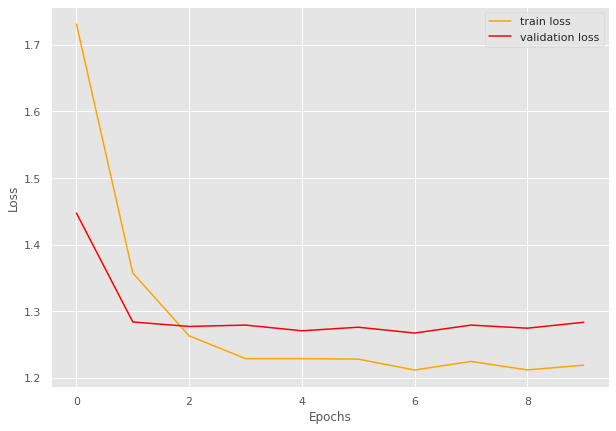

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 21/21 [00:07<00:00,  2.99batch/s, loss=1.93]


train loss 1.9308658951804751, validation loss 1.7264527515931563, validation accuracy 0.8101851851851852
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 21/21 [00:10<00:00,  2.00batch/s, loss=1.62]


train loss 1.6165924412863595, validation loss 1.6687796982851895, validation accuracy 0.8626543209876543
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.97batch/s, loss=1.56]


train loss 1.556697232382638, validation loss 1.6552505059675737, validation accuracy 0.8657407407407407
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.70batch/s, loss=1.52]


train loss 1.5239056632632302, validation loss 1.5934430902654475, validation accuracy 0.8888888888888888
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.99batch/s, loss=1.5] 


train loss 1.4971373308272589, validation loss 1.5707496946508235, validation accuracy 0.8935185185185185
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.68batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4866712547483898, validation loss 1.570906942540949, validation accuracy 0.9074074074074074
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.95batch/s, loss=1.48]


train loss 1.4840964646566481, validation loss 1.5594410246068782, validation accuracy 0.9089506172839507
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.94batch/s, loss=1.48]


INFO: Early stopping counter 2 of 5
train loss 1.4811785788763137, validation loss 1.5691842057488181, validation accuracy 0.8966049382716049
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.97batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4764332033339, validation loss 1.5672101432626897, validation accuracy 0.8935185185185185
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.98batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4818229164396013, validation loss 1.5660203045064753, validation accuracy 0.9012345679012346
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  3.00batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9124457308248914 and loss 1.5512069243227127


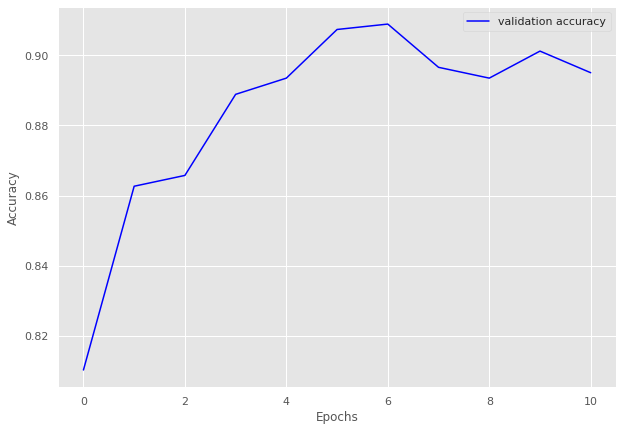

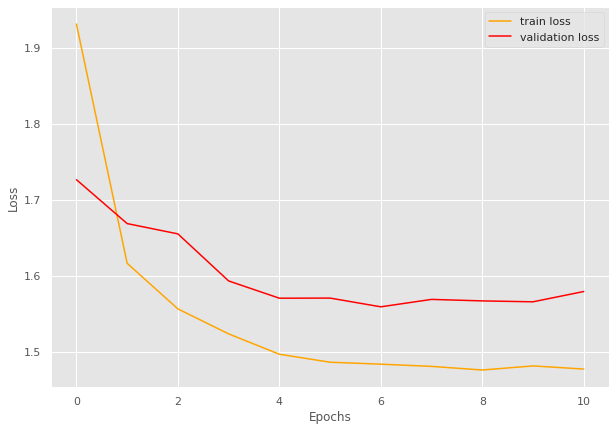

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 10/10 [00:03<00:00,  3.07batch/s, loss=1.08]


train loss 1.0823264837265014, validation loss 0.8931991815567016, validation accuracy 0.8947368421052632
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.94batch/s, loss=0.804]


train loss 0.8042582154273987, validation loss 0.8214197397232056, validation accuracy 0.9243421052631579
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=0.764]


INFO: Early stopping counter 1 of 5
train loss 0.7635270357131958, validation loss 0.8222294211387634, validation accuracy 0.9276315789473685
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.756]


train loss 0.7564331591129303, validation loss 0.8130618929862976, validation accuracy 0.930921052631579
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.749]


train loss 0.7489003777503968, validation loss 0.8051188707351684, validation accuracy 0.9375
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=0.747]


train loss 0.7471433341503143, validation loss 0.8000915050506592, validation accuracy 0.9407894736842105
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.745]


INFO: Early stopping counter 2 of 5
train loss 0.7448919117450714, validation loss 0.8048925638198853, validation accuracy 0.9407894736842105
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=0.746]


INFO: Early stopping counter 3 of 5
train loss 0.7462321579456329, validation loss 0.8029984354972839, validation accuracy 0.9375
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:04<00:00,  2.21batch/s, loss=0.748]


INFO: Early stopping counter 4 of 5
train loss 0.7475302696228028, validation loss 0.803339421749115, validation accuracy 0.944078947368421
Coarse label 11 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:06<00:00,  1.60batch/s, loss=0.745]


train loss 0.7446884751319885, validation loss 0.7998997807502747, validation accuracy 0.9342105263157895
Coarse label 11 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:05<00:00,  1.92batch/s, loss=0.746]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9558795319393824 and loss 0.7888475045925234


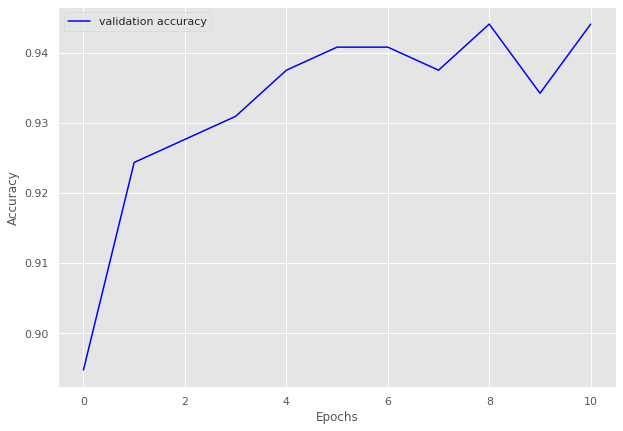

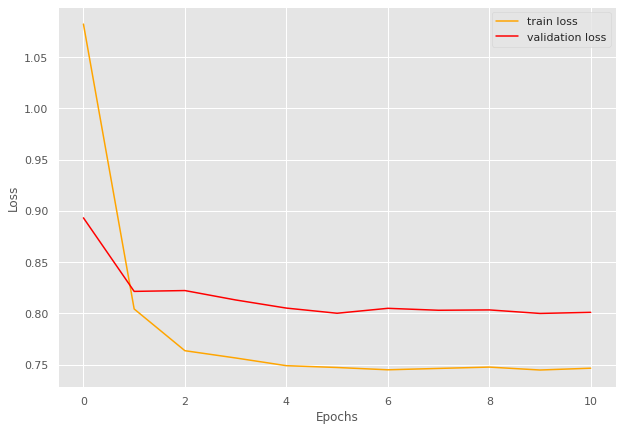

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 10/10 [00:07<00:00,  1.29batch/s, loss=1.63]


train loss 1.6338993191719056, validation loss 1.4758504390716554, validation accuracy 0.6793103448275862
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:06<00:00,  1.50batch/s, loss=1.27]


train loss 1.2691007137298584, validation loss 1.2717305898666382, validation accuracy 0.8241379310344827
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:06<00:00,  1.45batch/s, loss=1.14]


train loss 1.1443551898002624, validation loss 1.1883103132247925, validation accuracy 0.8827586206896552
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:06<00:00,  1.51batch/s, loss=1.1]


train loss 1.0980015039443969, validation loss 1.1827336549758911, validation accuracy 0.8793103448275862
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:06<00:00,  1.59batch/s, loss=1.08]


train loss 1.0797527074813842, validation loss 1.1825160264968873, validation accuracy 0.8724137931034482
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:06<00:00,  1.57batch/s, loss=1.09]


train loss 1.0941659212112427, validation loss 1.1807398557662965, validation accuracy 0.8689655172413793
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:06<00:00,  1.57batch/s, loss=1.1]


INFO: Early stopping counter 1 of 5
train loss 1.0971482276916504, validation loss 1.1930260896682738, validation accuracy 0.8586206896551725
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:05<00:00,  1.88batch/s, loss=1.09]


INFO: Early stopping counter 2 of 5
train loss 1.0868800163269043, validation loss 1.1949426651000976, validation accuracy 0.8620689655172413
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:04<00:00,  2.32batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0737617015838623, validation loss 1.2001999855041503, validation accuracy 0.8482758620689655
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:08<00:00,  1.19batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.0701720356941222, validation loss 1.217465376853943, validation accuracy 0.8344827586206897
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:07<00:00,  1.33batch/s, loss=1.08]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.8803933373469798 and loss 1.171206003580338


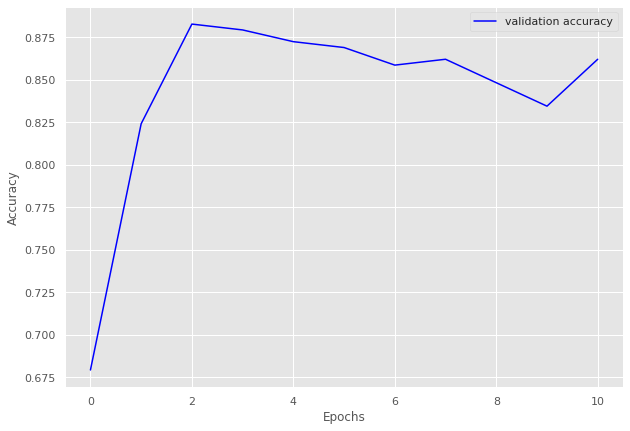

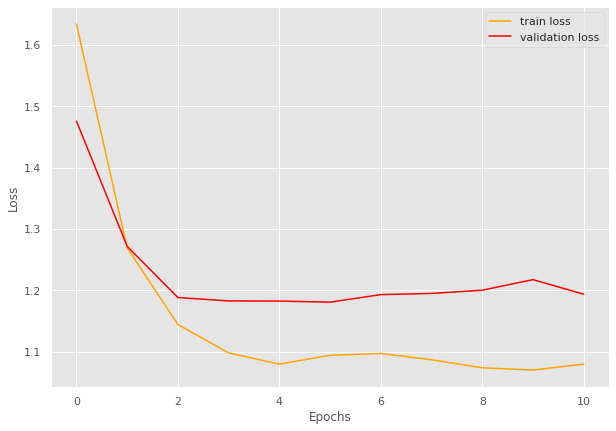

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 9/9 [00:05<00:00,  1.62batch/s, loss=0.84] 


train loss 0.8400519887606303, validation loss 0.7259716153144836, validation accuracy 0.8455598455598455
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.23batch/s, loss=0.616]


train loss 0.6163630684216818, validation loss 0.6594830751419067, validation accuracy 0.8918918918918919
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.22batch/s, loss=0.599]


train loss 0.5994959937201606, validation loss 0.638392698764801, validation accuracy 0.8957528957528957
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.22batch/s, loss=0.582]


train loss 0.5816975831985474, validation loss 0.6359938144683838, validation accuracy 0.888030888030888
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.25batch/s, loss=0.564]


INFO: Early stopping counter 1 of 5
train loss 0.5642434888415866, validation loss 0.637571370601654, validation accuracy 0.888030888030888
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.24batch/s, loss=0.572]


INFO: Early stopping counter 2 of 5
train loss 0.5719909005694919, validation loss 0.6505980491638184, validation accuracy 0.8687258687258688
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.21batch/s, loss=0.57] 


INFO: Early stopping counter 3 of 5
train loss 0.5704532994164361, validation loss 0.6408869862556458, validation accuracy 0.8841698841698842
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.19batch/s, loss=0.576]


train loss 0.5761477086279128, validation loss 0.6231706500053406, validation accuracy 0.915057915057915
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.22batch/s, loss=0.567]


INFO: Early stopping counter 4 of 5
train loss 0.5672164625591702, validation loss 0.6269312143325806, validation accuracy 0.9111969111969112
Coarse label 13 Epoch 10
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.26batch/s, loss=0.567]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9038896426956129 and loss 0.6535362269197191


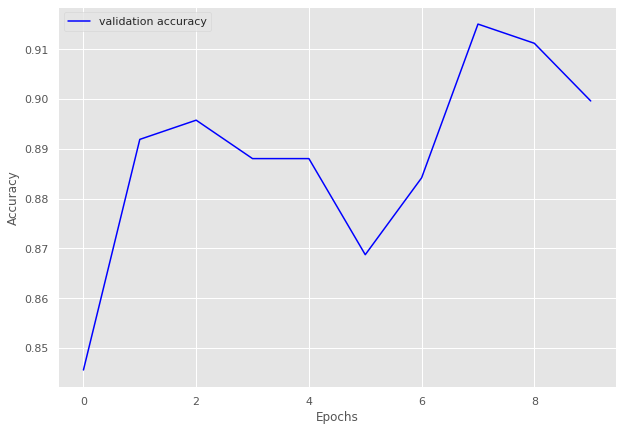

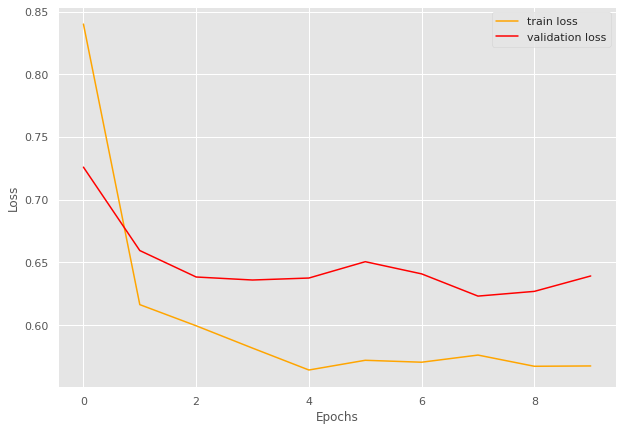

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.41]


train loss 1.4050066722066779, validation loss 1.1573943614959716, validation accuracy 0.9124579124579124
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=1.1] 


train loss 1.1047923251202232, validation loss 1.1067996978759767, validation accuracy 0.9427609427609428
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=1.08]


train loss 1.076478820098074, validation loss 1.102966570854187, validation accuracy 0.9427609427609428
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=1.07]


train loss 1.0659652195478742, validation loss 1.0936714649200439, validation accuracy 0.9478114478114478
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.90batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0593083908683376, validation loss 1.0996077179908752, validation accuracy 0.9377104377104377
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.94batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.052283801530537, validation loss 1.1000539660453796, validation accuracy 0.9427609427609428
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.05]


train loss 1.0541706022463346, validation loss 1.088827335834503, validation accuracy 0.9511784511784511
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.01batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0507097118779232, validation loss 1.089825701713562, validation accuracy 0.9562289562289562
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=1.05]


train loss 1.0489149156369661, validation loss 1.0886977314949036, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0480247924202366, validation loss 1.0937047123908996, validation accuracy 0.9494949494949495
Coarse label 14 Epoch 11
-------------------------------


100%|██████████| 19/19 [00:07<00:00,  2.65batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9469898512168686 and loss 1.0977617487217646


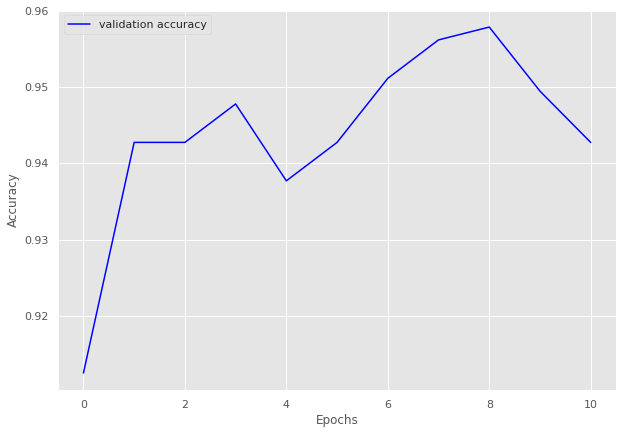

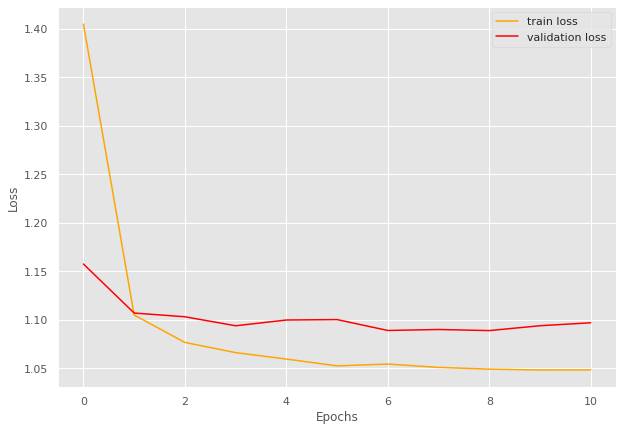

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=1.16]


train loss 1.1637575507164002, validation loss 0.964384114742279, validation accuracy 0.8435374149659864
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=0.816]


train loss 0.8164048314094543, validation loss 0.8541464686393738, validation accuracy 0.9081632653061225
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=0.768]


train loss 0.7681199312210083, validation loss 0.850746500492096, validation accuracy 0.9013605442176871
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.16batch/s, loss=0.755]


train loss 0.7547919929027558, validation loss 0.8357083439826966, validation accuracy 0.9217687074829932
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=0.747]


train loss 0.7471030235290528, validation loss 0.8326963782310486, validation accuracy 0.9183673469387755
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.15batch/s, loss=0.754]


train loss 0.7541499257087707, validation loss 0.8207746744155884, validation accuracy 0.9251700680272109
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.16batch/s, loss=0.745]


train loss 0.7451432883739472, validation loss 0.8117692589759826, validation accuracy 0.9387755102040817
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.746]


INFO: Early stopping counter 1 of 5
train loss 0.7458493113517761, validation loss 0.8129124402999878, validation accuracy 0.9285714285714286
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.744]


INFO: Early stopping counter 2 of 5
train loss 0.7443483650684357, validation loss 0.8159332633018493, validation accuracy 0.9251700680272109
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=0.744]


INFO: Early stopping counter 3 of 5
train loss 0.7441746592521667, validation loss 0.8171262860298156, validation accuracy 0.9251700680272109
Coarse label 15 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.7509749114513398, validation loss 0.8157965540885925, validation accuracy 0.935374149659864
Coarse label 15 Epoch 12
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.15batch/s, loss=0.75]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9116297626171953 and loss 0.8331139902525311


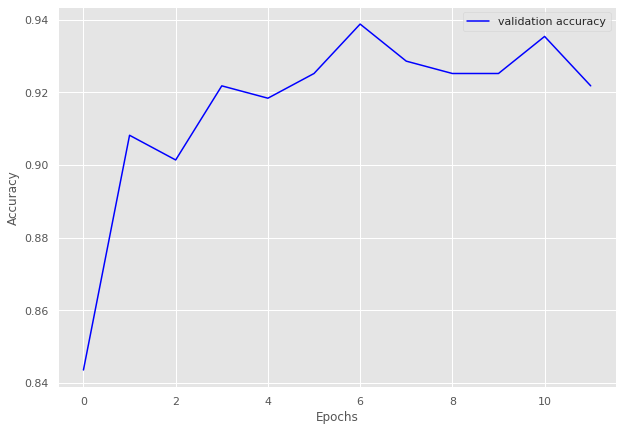

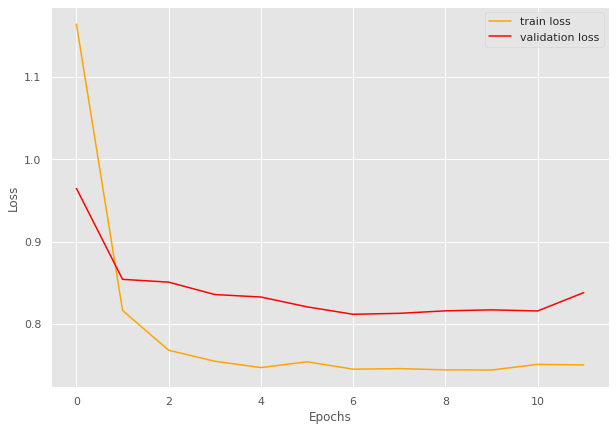

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 9/9 [00:03<00:00,  2.99batch/s, loss=0.878]


train loss 0.877502421538035, validation loss 0.7126009941101075, validation accuracy 0.8936170212765957
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.86batch/s, loss=0.611]


train loss 0.6105825702349345, validation loss 0.6283167362213135, validation accuracy 0.925531914893617
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.95batch/s, loss=0.564]


train loss 0.5639970435036553, validation loss 0.6124072551727295, validation accuracy 0.9361702127659575
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.02batch/s, loss=0.56] 


INFO: Early stopping counter 1 of 5
train loss 0.5604831510119967, validation loss 0.615666675567627, validation accuracy 0.9361702127659575
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.01batch/s, loss=0.556]


INFO: Early stopping counter 2 of 5
train loss 0.5559599200884501, validation loss 0.6242714047431945, validation accuracy 0.925531914893617
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.01batch/s, loss=0.553]


INFO: Early stopping counter 3 of 5
train loss 0.5531487928496467, validation loss 0.63120596408844, validation accuracy 0.9219858156028369
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.03batch/s, loss=0.555]


INFO: Early stopping counter 4 of 5
train loss 0.5546153320206536, validation loss 0.6251457333564758, validation accuracy 0.9361702127659575
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.02batch/s, loss=0.552]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9361879027229266 and loss 0.6147227161809018


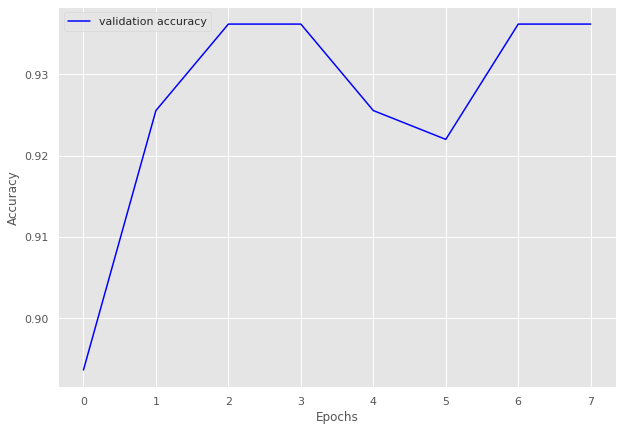

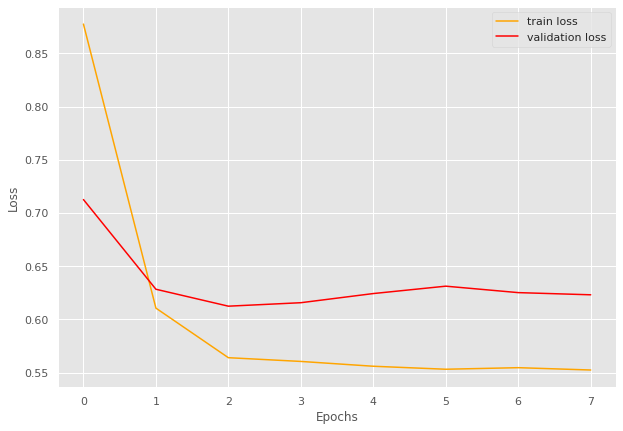

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=1.16]


train loss 1.1631955623626709, validation loss 0.9654049038887024, validation accuracy 0.8122977346278317
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.00batch/s, loss=0.864]


train loss 0.8643133819103241, validation loss 0.8614649176597595, validation accuracy 0.889967637540453
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.50batch/s, loss=0.786]


train loss 0.7859900653362274, validation loss 0.8456874251365661, validation accuracy 0.8964401294498382
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.03batch/s, loss=0.76]


train loss 0.7600839734077454, validation loss 0.8198811173439026, validation accuracy 0.9385113268608414
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.03batch/s, loss=0.753]


train loss 0.752786111831665, validation loss 0.8157923579216003, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.92batch/s, loss=0.749]


INFO: Early stopping counter 1 of 5
train loss 0.7492986798286438, validation loss 0.8184502005577088, validation accuracy 0.9223300970873787
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=0.745]


INFO: Early stopping counter 2 of 5
train loss 0.7453125476837158, validation loss 0.8171207785606385, validation accuracy 0.9288025889967637
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.03batch/s, loss=0.746]


INFO: Early stopping counter 3 of 5
train loss 0.7455385625362396, validation loss 0.8159954667091369, validation accuracy 0.9352750809061489
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.745]


INFO: Early stopping counter 4 of 5
train loss 0.744745934009552, validation loss 0.8213078141212463, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.746]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9076251896813353 and loss 0.8380366585340845


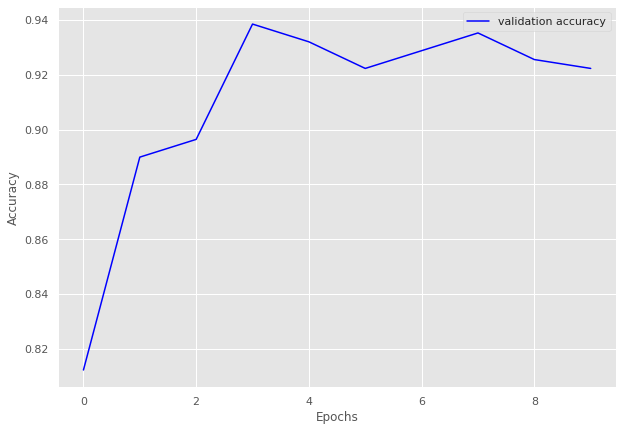

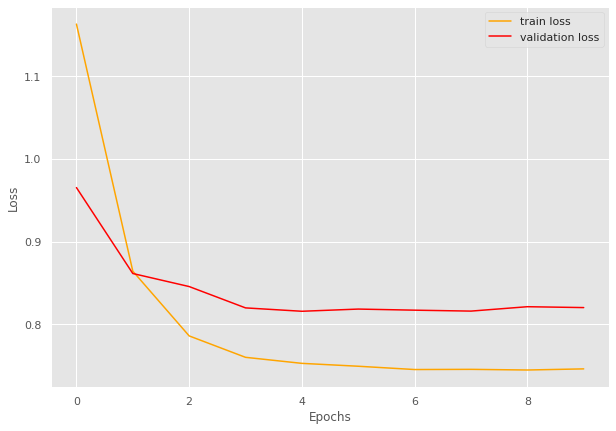

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 4/4 [00:01<00:00,  3.79batch/s, loss=1.29]


train loss 1.2909499406814575, validation loss 1.2533038854599, validation accuracy 0.4479166666666667
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.74batch/s, loss=0.991]


train loss 0.9906874299049377, validation loss 1.1901382207870483, validation accuracy 0.5729166666666666
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.76batch/s, loss=0.924]


train loss 0.9236765056848526, validation loss 1.0781456232070923, validation accuracy 0.7708333333333334
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.79batch/s, loss=0.812]


train loss 0.8120601773262024, validation loss 0.9840399026870728, validation accuracy 0.84375
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.69batch/s, loss=0.843]


train loss 0.8433023989200592, validation loss 0.9295236766338348, validation accuracy 0.875
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.78batch/s, loss=0.767]


INFO: Early stopping counter 1 of 5
train loss 0.7669576853513718, validation loss 0.9393703043460846, validation accuracy 0.84375
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.78batch/s, loss=0.809]


train loss 0.8094495236873627, validation loss 0.9058660566806793, validation accuracy 0.8541666666666666
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.74batch/s, loss=0.762]


train loss 0.7615489512681961, validation loss 0.8707303106784821, validation accuracy 0.8958333333333334
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.79batch/s, loss=0.805]


INFO: Early stopping counter 2 of 5
train loss 0.8054495304822922, validation loss 0.8752634227275848, validation accuracy 0.8958333333333334
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.80batch/s, loss=0.813]


INFO: Early stopping counter 3 of 5
train loss 0.8130681812763214, validation loss 0.8722940683364868, validation accuracy 0.875
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.78batch/s, loss=0.76] 


INFO: Early stopping counter 4 of 5
train loss 0.7595115453004837, validation loss 0.8778160810470581, validation accuracy 0.8854166666666666
Coarse label 19 Epoch 12
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.80batch/s, loss=0.802]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.842326139088729 and loss 0.9048992505779972


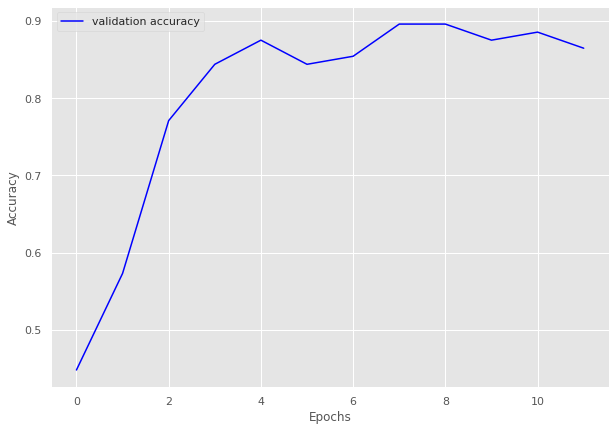

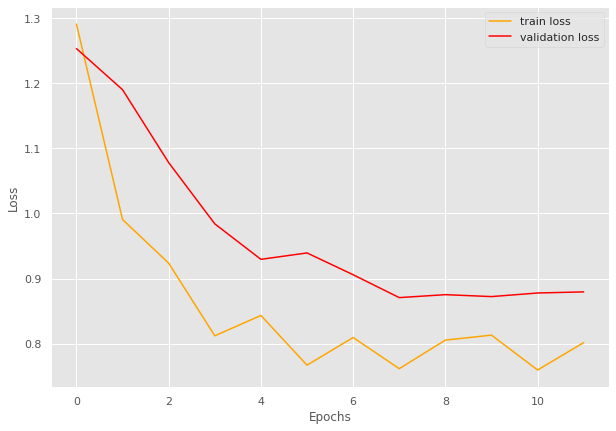

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=1.22]


train loss 1.2189078714166368, validation loss 1.003439724445343, validation accuracy 0.8997668997668997
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=0.985]


train loss 0.9850709076438632, validation loss 0.9901121003287179, validation accuracy 0.916083916083916
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.02batch/s, loss=0.956]


train loss 0.956172159739903, validation loss 0.9770412019320897, validation accuracy 0.9277389277389277
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.00batch/s, loss=0.94] 


train loss 0.9401171122278486, validation loss 0.9591409734317234, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=0.938]


INFO: Early stopping counter 1 of 5
train loss 0.9381764360836574, validation loss 0.9627282449177333, validation accuracy 0.9440559440559441
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.00batch/s, loss=0.938]


train loss 0.9380147627421788, validation loss 0.9547930955886841, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=0.95] 


INFO: Early stopping counter 2 of 5
train loss 0.9504313383783612, validation loss 0.9601032478468758, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=0.952]


INFO: Early stopping counter 3 of 5
train loss 0.9517418976340976, validation loss 0.9573455793516976, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:16<00:00,  1.65batch/s, loss=0.969]


INFO: Early stopping counter 4 of 5
train loss 0.9685836221490588, validation loss 0.9615426744733538, validation accuracy 0.9393939393939394
Coarse label 0 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:15<00:00,  1.76batch/s, loss=0.931]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9497223935842073 and loss 0.9553050726067787


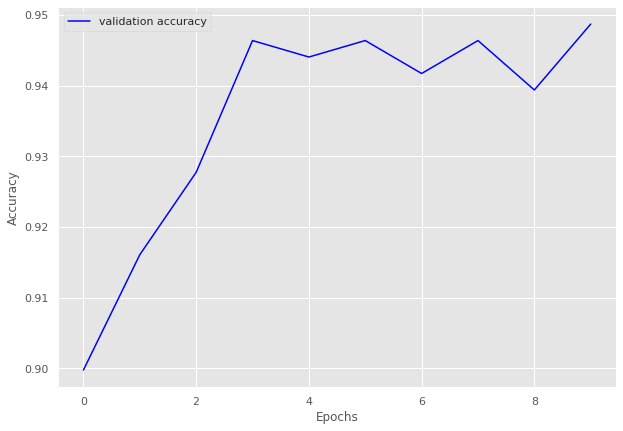

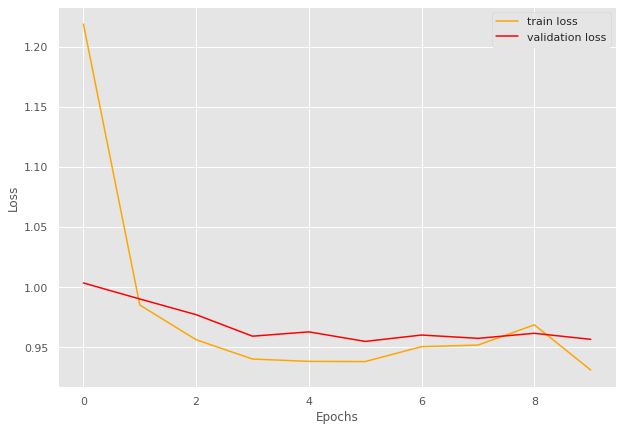

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 12/12 [00:10<00:00,  1.17batch/s, loss=1.46]


train loss 1.4601373374462128, validation loss 1.2187960545221965, validation accuracy 0.8978494623655914
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 12/12 [00:08<00:00,  1.48batch/s, loss=1.14]


train loss 1.1367705166339874, validation loss 1.1199995676676433, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 12/12 [00:07<00:00,  1.59batch/s, loss=1.08]


train loss 1.0754152437051137, validation loss 1.1083467801411946, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 12/12 [00:07<00:00,  1.63batch/s, loss=1.06]


train loss 1.0637183090051014, validation loss 1.1066406567891438, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 12/12 [00:09<00:00,  1.33batch/s, loss=1.06]


train loss 1.0564782619476318, validation loss 1.1064923604329426, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 12/12 [00:09<00:00,  1.30batch/s, loss=1.05]


INFO: Early stopping counter 1 of 5
train loss 1.0530239244302113, validation loss 1.1101415157318115, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 12/12 [00:09<00:00,  1.24batch/s, loss=1.06]


train loss 1.0561015407244365, validation loss 1.1026703119277954, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 12/12 [00:09<00:00,  1.26batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.050559252500534, validation loss 1.1036710739135742, validation accuracy 0.946236559139785
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 12/12 [00:11<00:00,  1.08batch/s, loss=1.05]


train loss 1.0478326280911763, validation loss 1.101741909980774, validation accuracy 0.946236559139785
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 12/12 [00:08<00:00,  1.48batch/s, loss=1.05]


train loss 1.0495988726615906, validation loss 1.0963544050852458, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 12/12 [00:10<00:00,  1.09batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0514777799447377, validation loss 1.1020475625991821, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 12
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.97batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0518818795681, validation loss 1.100656787554423, validation accuracy 0.946236559139785
Coarse label 1 Epoch 13
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  3.00batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9444050991501416 and loss 1.1004619571897718


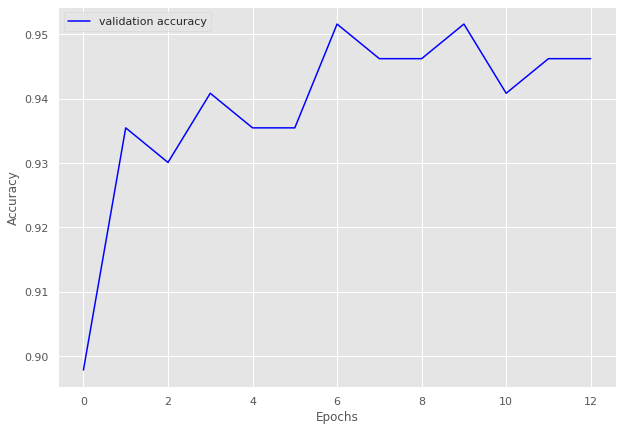

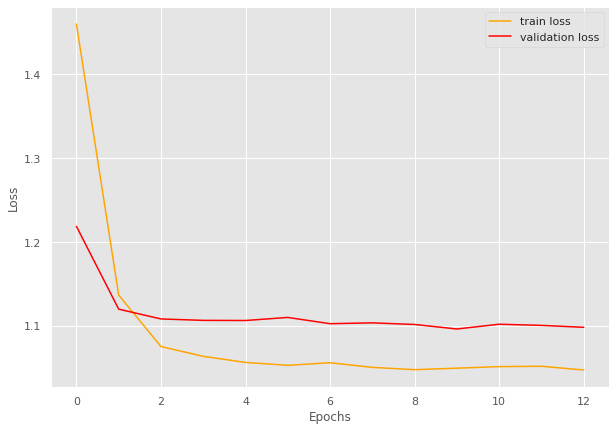

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 55/55 [00:19<00:00,  2.83batch/s, loss=1.8] 


train loss 1.7965909871188077, validation loss 1.614841674055372, validation accuracy 0.8586206896551725
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.92batch/s, loss=1.56]


train loss 1.5589632120999424, validation loss 1.5566513197762626, validation accuracy 0.9103448275862069
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.95batch/s, loss=1.52]


train loss 1.5216060096567328, validation loss 1.5473066908972604, validation accuracy 0.9195402298850575
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.94batch/s, loss=1.51]


train loss 1.508323487368497, validation loss 1.5436601809092931, validation accuracy 0.9229885057471264
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 55/55 [00:19<00:00,  2.86batch/s, loss=1.5] 


INFO: Early stopping counter 1 of 5
train loss 1.4995163397355513, validation loss 1.5477020314761571, validation accuracy 0.9149425287356322
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.93batch/s, loss=1.49]


train loss 1.494195946780118, validation loss 1.536126732826233, validation accuracy 0.9264367816091954
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.93batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4893642555583606, validation loss 1.5482319848878043, validation accuracy 0.9160919540229885
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 55/55 [00:19<00:00,  2.81batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.490384006500244, validation loss 1.5405604328427995, validation accuracy 0.9229885057471264
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 55/55 [00:23<00:00,  2.38batch/s, loss=1.49]


INFO: Early stopping counter 4 of 5
train loss 1.4898591041564941, validation loss 1.5504181129591805, validation accuracy 0.9160919540229885
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.92batch/s, loss=1.49]


train loss 1.4877434166994963, validation loss 1.530470379761287, validation accuracy 0.9287356321839081
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.90batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.919860097323601 and loss 1.5423105937763326


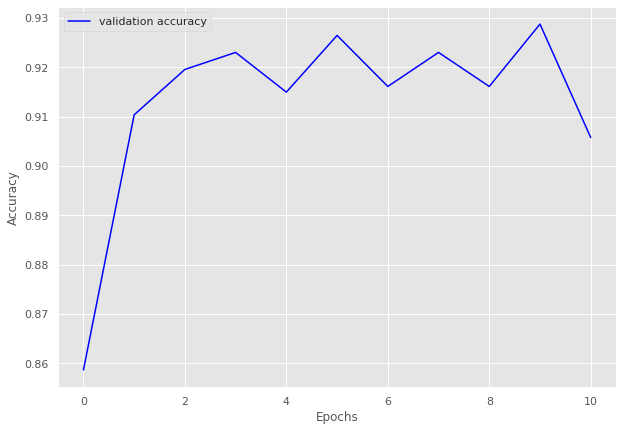

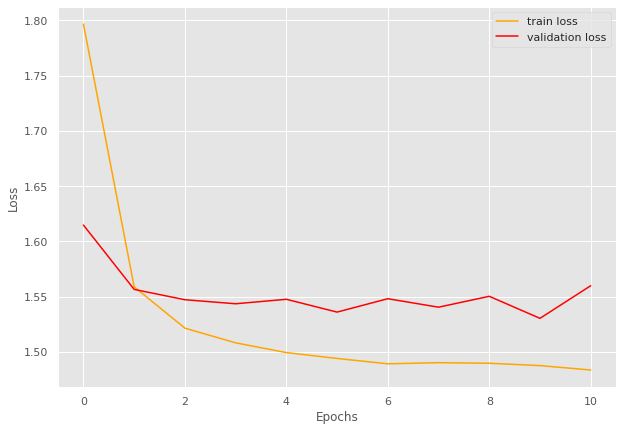

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 26/26 [00:08<00:00,  2.93batch/s, loss=1.41]


train loss 1.4054275980362525, validation loss 1.207979440689087, validation accuracy 0.8446601941747572
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.99batch/s, loss=1.15]


train loss 1.1489457396360545, validation loss 1.1573728833879744, validation accuracy 0.8907766990291263
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.94batch/s, loss=1.1] 


train loss 1.0998006967397838, validation loss 1.1379753862108504, validation accuracy 0.8980582524271845
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.93batch/s, loss=1.08]


train loss 1.0829516282448401, validation loss 1.1200742721557617, validation accuracy 0.9247572815533981
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.97batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0737440356841454, validation loss 1.129738211631775, validation accuracy 0.9101941747572816
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.96batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0695268603471608, validation loss 1.1318119083132063, validation accuracy 0.9101941747572816
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.98batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0657993004872248, validation loss 1.136638981955392, validation accuracy 0.9004854368932039
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.97batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0626420745482812, validation loss 1.1339388063975744, validation accuracy 0.9077669902912622
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.98batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.928329843775165 and loss 1.1137835359086796


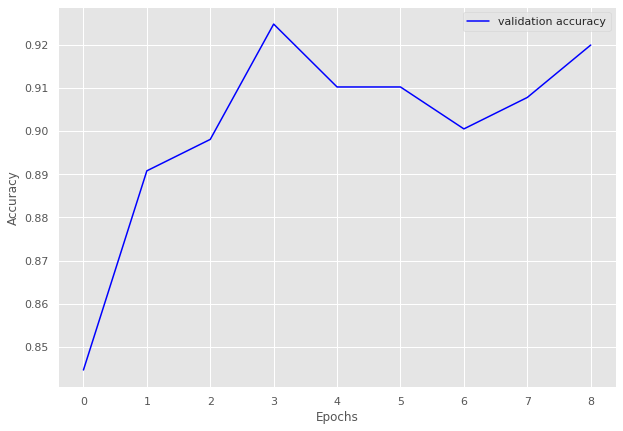

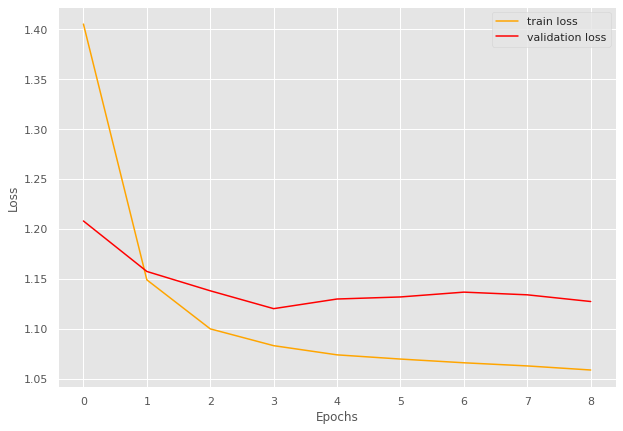

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 10/10 [00:03<00:00,  2.95batch/s, loss=0.461]


train loss 0.4605037599802017, validation loss 0.3824458221594493, validation accuracy 0.9433962264150944
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.83batch/s, loss=0.328]


train loss 0.3282706826925278, validation loss 0.3708552320798238, validation accuracy 0.9433962264150944
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.85batch/s, loss=0.319]


train loss 0.3187668830156326, validation loss 0.3607649505138397, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.94batch/s, loss=0.317]


train loss 0.31706611514091493, validation loss 0.35980520645777386, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.96batch/s, loss=0.319]


train loss 0.3188243925571442, validation loss 0.35643120606740314, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.96batch/s, loss=0.317]


INFO: Early stopping counter 1 of 5
train loss 0.3166398912668228, validation loss 0.3623292048772176, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.95batch/s, loss=0.317]


INFO: Early stopping counter 2 of 5
train loss 0.3165774494409561, validation loss 0.35889115929603577, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.92batch/s, loss=0.317]


INFO: Early stopping counter 3 of 5
train loss 0.31697797775268555, validation loss 0.36093664169311523, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.89batch/s, loss=0.317]


INFO: Early stopping counter 4 of 5
train loss 0.31651661098003386, validation loss 0.3693509598573049, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.96batch/s, loss=0.315]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9703796412181894 and loss 0.3416882839642073


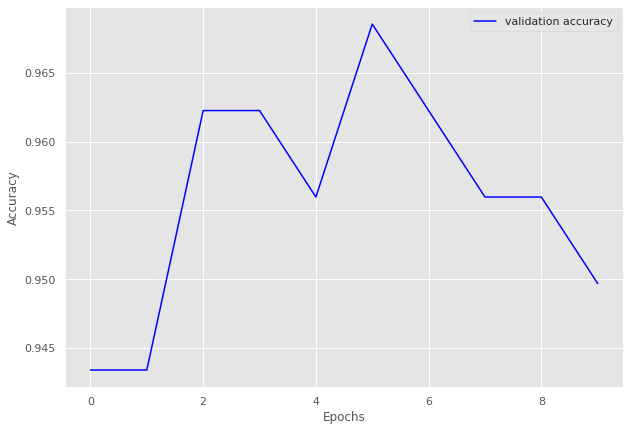

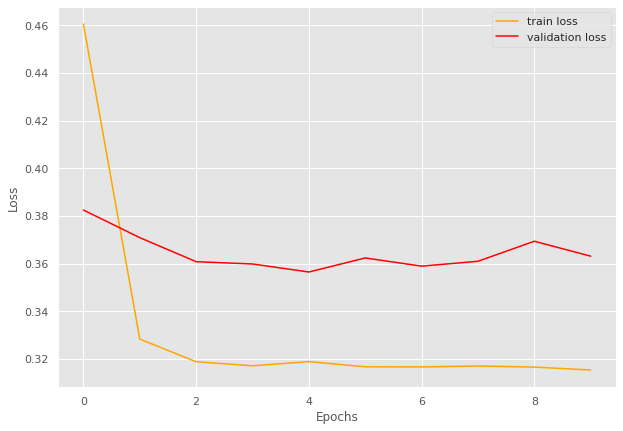

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=1.48]


train loss 1.4789079229036968, validation loss 1.2738375216722488, validation accuracy 0.9030172413793104
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.24]


train loss 1.2443543910980224, validation loss 1.2448860704898834, validation accuracy 0.9181034482758621
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.02batch/s, loss=1.21]


train loss 1.2060627102851869, validation loss 1.2377861589193344, validation accuracy 0.9267241379310345
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=1.2] 


train loss 1.1979010701179504, validation loss 1.223959743976593, validation accuracy 0.9418103448275862
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=1.19]


INFO: Early stopping counter 1 of 5
train loss 1.1916229923566182, validation loss 1.2353238314390182, validation accuracy 0.9267241379310345
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.03batch/s, loss=1.19]


INFO: Early stopping counter 2 of 5
train loss 1.1864983518918355, validation loss 1.2244510650634766, validation accuracy 0.9375
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.18]


INFO: Early stopping counter 3 of 5
train loss 1.183488400777181, validation loss 1.2311933040618896, validation accuracy 0.9353448275862069
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.03batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.193330184618632, validation loss 1.2263989746570587, validation accuracy 0.9418103448275862
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9286224125624554 and loss 1.2378105261109091


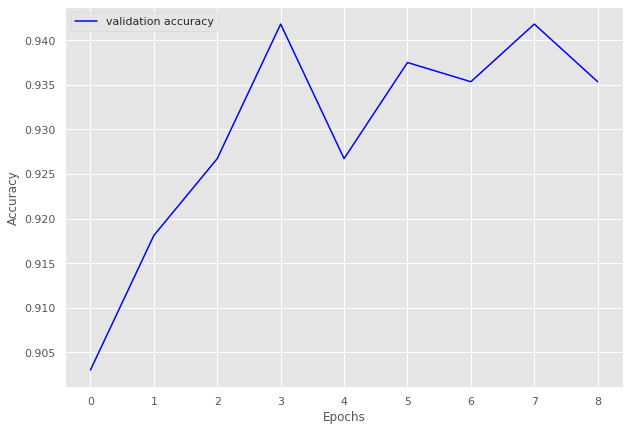

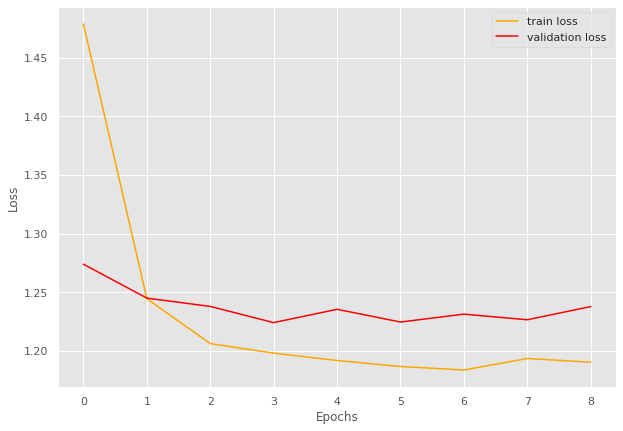

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 23/23 [00:07<00:00,  2.94batch/s, loss=0.95] 


train loss 0.9499363717825516, validation loss 0.7922757069269816, validation accuracy 0.953168044077135
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.91batch/s, loss=0.775]


train loss 0.7753248085146365, validation loss 0.7866071164608002, validation accuracy 0.9559228650137741
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.93batch/s, loss=0.762]


train loss 0.7624518897222436, validation loss 0.785173644622167, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.90batch/s, loss=0.758]


train loss 0.7578251387761987, validation loss 0.7835881610711416, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.92batch/s, loss=0.761]


train loss 0.7605494468108468, validation loss 0.7745985190073649, validation accuracy 0.9724517906336089
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.95batch/s, loss=0.761]


INFO: Early stopping counter 1 of 5
train loss 0.7605244569156481, validation loss 0.7797214984893799, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.93batch/s, loss=0.752]


INFO: Early stopping counter 2 of 5
train loss 0.7519676659418189, validation loss 0.7799272735913595, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.96batch/s, loss=0.751]


INFO: Early stopping counter 3 of 5
train loss 0.7505134395931078, validation loss 0.7798640330632528, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.95batch/s, loss=0.752]


INFO: Early stopping counter 4 of 5
train loss 0.7517833528311356, validation loss 0.7908183336257935, validation accuracy 0.953168044077135
Coarse label 7 Epoch 10
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.93batch/s, loss=0.751]


train loss 0.7506088199822799, validation loss 0.774037112792333, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 11
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.95batch/s, loss=0.753]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9668125455871627 and loss 0.7763158928516299


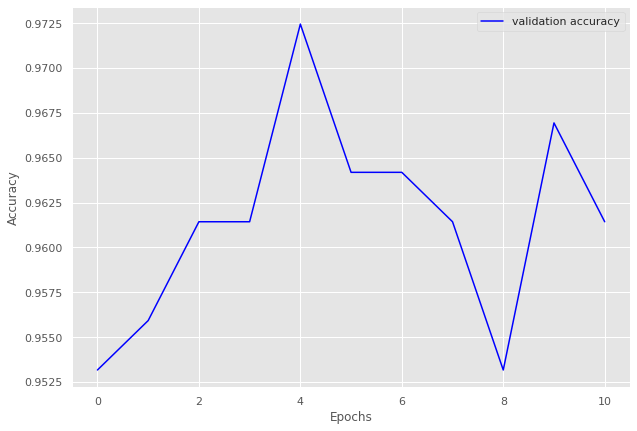

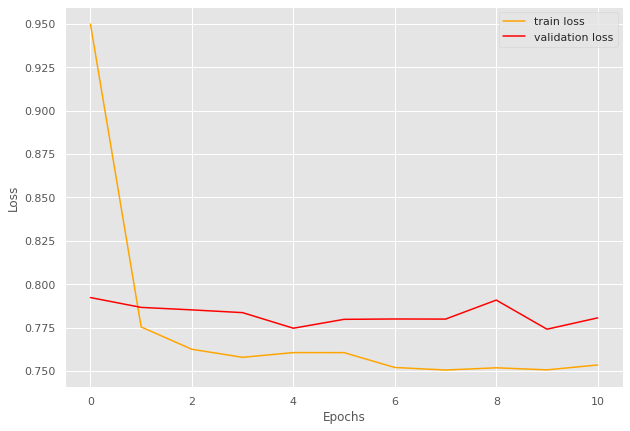

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 33/33 [00:11<00:00,  2.96batch/s, loss=1.52]


train loss 1.5236130158106487, validation loss 1.324987143278122, validation accuracy 0.8493150684931506
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.76batch/s, loss=1.27]


train loss 1.2659726106759273, validation loss 1.2886442840099335, validation accuracy 0.8747553816046967
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.97batch/s, loss=1.22]


train loss 1.2208395473884814, validation loss 1.2681514620780945, validation accuracy 0.898238747553816
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.93batch/s, loss=1.21]


train loss 1.207687623573072, validation loss 1.2449826300144196, validation accuracy 0.9217221135029354
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.97batch/s, loss=1.21]


INFO: Early stopping counter 1 of 5
train loss 1.2095132777185151, validation loss 1.2578821927309036, validation accuracy 0.9060665362035225
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.98batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.1981828393358174, validation loss 1.2528503835201263, validation accuracy 0.9119373776908023
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.99batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1943874070138643, validation loss 1.2522228360176086, validation accuracy 0.9099804305283757
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  3.00batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.193323810895284, validation loss 1.2558847069740295, validation accuracy 0.9099804305283757
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.95batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9171751265740621 and loss 1.249403403810233


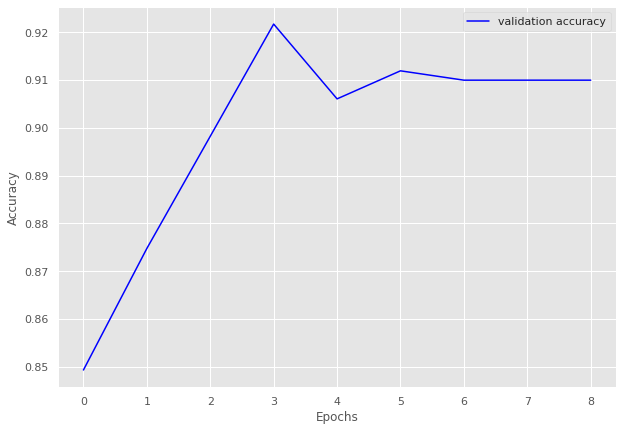

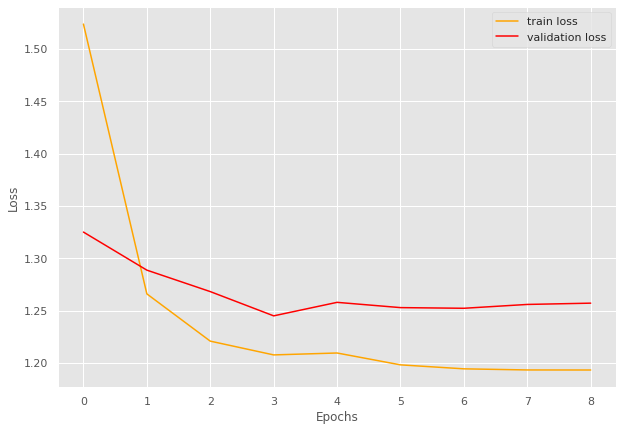

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 41/41 [00:14<00:00,  2.93batch/s, loss=1.79]


train loss 1.7928232041800893, validation loss 1.6649813868782737, validation accuracy 0.8595679012345679
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=1.57]


train loss 1.5658354642914563, validation loss 1.5690603147853504, validation accuracy 0.9027777777777778
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.89batch/s, loss=1.52]


train loss 1.5210737920388944, validation loss 1.5558788776397705, validation accuracy 0.9182098765432098
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=1.5]


train loss 1.5033456872149211, validation loss 1.5401061664928088, validation accuracy 0.9305555555555556
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=1.49]


train loss 1.4941336323575276, validation loss 1.5353830402547664, validation accuracy 0.9382716049382716
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4941206821581212, validation loss 1.5469581972468982, validation accuracy 0.9182098765432098
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=1.48]


INFO: Early stopping counter 2 of 5
train loss 1.484145652957079, validation loss 1.5422204732894897, validation accuracy 0.9367283950617284
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4813126354682735, validation loss 1.5383993062106045, validation accuracy 0.9305555555555556
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.74batch/s, loss=1.48]


train loss 1.4809407809885538, validation loss 1.5345523357391357, validation accuracy 0.9351851851851852
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4796154091997844, validation loss 1.5360309319062666, validation accuracy 0.9320987654320988
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9325612380854771 and loss 1.5298832654953003


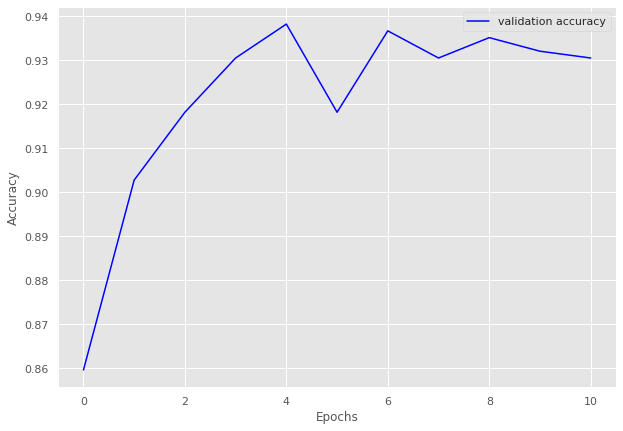

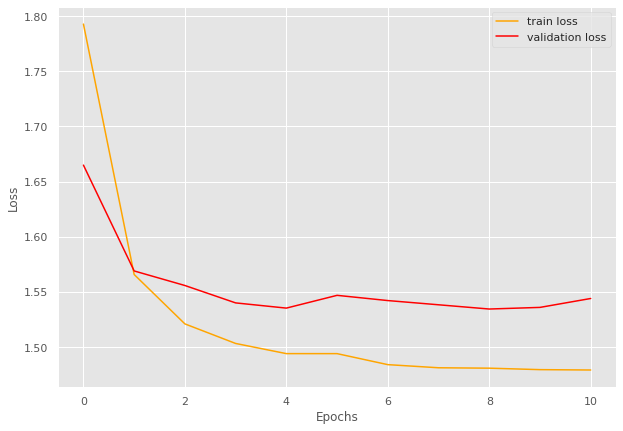

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 20/20 [00:06<00:00,  3.05batch/s, loss=0.98]


train loss 0.980267783999443, validation loss 0.8009860754013062, validation accuracy 0.944078947368421
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.04batch/s, loss=0.796]


train loss 0.7959044307470322, validation loss 0.7892718076705932, validation accuracy 0.9572368421052632
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.769]


train loss 0.7694821774959564, validation loss 0.7829902052879334, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.99batch/s, loss=0.767]


train loss 0.7669483721256256, validation loss 0.7742855787277222, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.764]


INFO: Early stopping counter 1 of 5
train loss 0.7644914418458939, validation loss 0.7758599042892456, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.05batch/s, loss=0.755]


train loss 0.7546292781829834, validation loss 0.7666388154029846, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.01batch/s, loss=0.758]


INFO: Early stopping counter 2 of 5
train loss 0.7584254026412964, validation loss 0.7766709089279175, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.98batch/s, loss=0.755]


INFO: Early stopping counter 3 of 5
train loss 0.7550190448760986, validation loss 0.7853183150291443, validation accuracy 0.9572368421052632
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.753]


INFO: Early stopping counter 4 of 5
train loss 0.7534546881914139, validation loss 0.7693720459938049, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 10
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.05batch/s, loss=0.756]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9671667753859534 and loss 0.7766184028651979


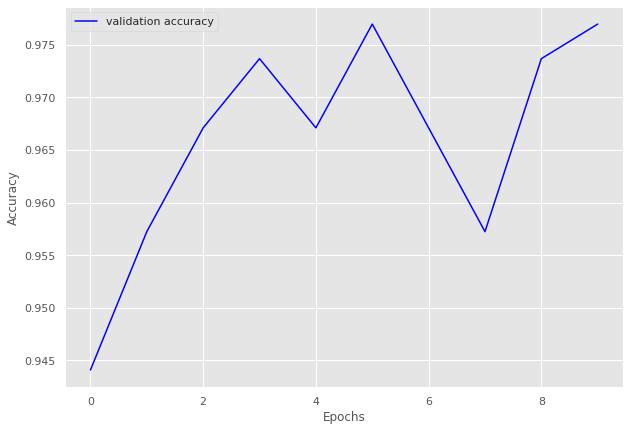

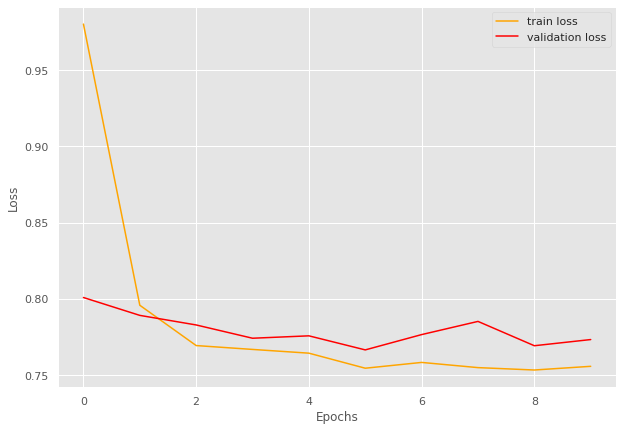

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 19/19 [00:06<00:00,  3.06batch/s, loss=1.5] 


train loss 1.4987266440140574, validation loss 1.2699973344802857, validation accuracy 0.7931034482758621
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.08batch/s, loss=1.16]


train loss 1.1602303354363692, validation loss 1.1465481281280518, validation accuracy 0.8896551724137931
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.01batch/s, loss=1.1]


train loss 1.098424898950677, validation loss 1.130569863319397, validation accuracy 0.9103448275862069
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.01batch/s, loss=1.09]


train loss 1.0868043021151894, validation loss 1.119688296318054, validation accuracy 0.9172413793103448
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.072753536073785, validation loss 1.1315636396408082, validation accuracy 0.903448275862069
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.05batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0715537761387073, validation loss 1.1212997913360596, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.07batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0645812561637478, validation loss 1.1285982847213745, validation accuracy 0.9137931034482759
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.01batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.0657528136905872, validation loss 1.1257194995880127, validation accuracy 0.9103448275862069
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.06batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9185437997724687 and loss 1.1261010360026704


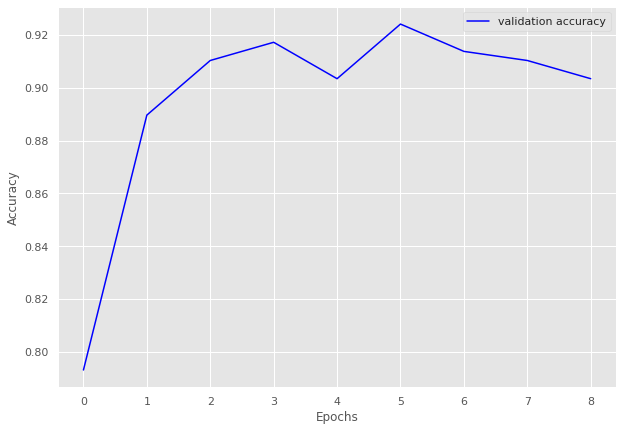

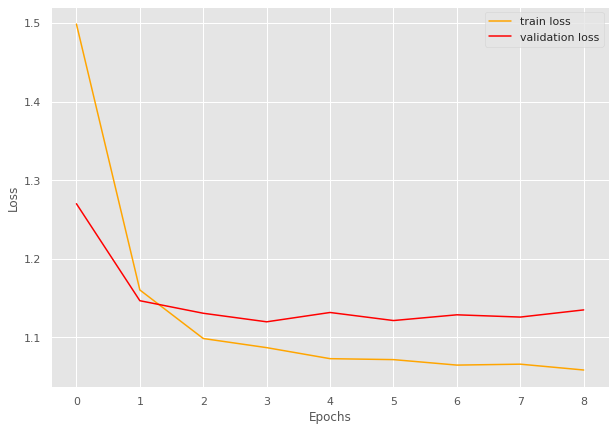

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 17/17 [00:05<00:00,  3.05batch/s, loss=0.743]


train loss 0.742878843756283, validation loss 0.6452437758445739, validation accuracy 0.8841698841698842
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=0.61] 


train loss 0.6099629612529979, validation loss 0.6386533975601196, validation accuracy 0.888030888030888
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  2.99batch/s, loss=0.58] 


train loss 0.5798677170977873, validation loss 0.6297069549560547, validation accuracy 0.9034749034749034
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.01batch/s, loss=0.568]


train loss 0.5681350055862876, validation loss 0.6284199833869935, validation accuracy 0.9073359073359073
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.06batch/s, loss=0.568]


train loss 0.5679559742703157, validation loss 0.6276714682579041, validation accuracy 0.8996138996138996
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=0.57] 


INFO: Early stopping counter 1 of 5
train loss 0.5701659146477195, validation loss 0.6281440377235412, validation accuracy 0.9034749034749034
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.00batch/s, loss=0.562]


INFO: Early stopping counter 2 of 5
train loss 0.5618572761030758, validation loss 0.6297512173652648, validation accuracy 0.8957528957528957
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.08batch/s, loss=0.564]


train loss 0.564069439383114, validation loss 0.6269593596458435, validation accuracy 0.9073359073359073
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=0.559]


train loss 0.5591988142798928, validation loss 0.6182864308357239, validation accuracy 0.918918918918919
Coarse label 13 Epoch 10
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=0.56] 


INFO: Early stopping counter 3 of 5
train loss 0.5602166687740999, validation loss 0.6237012147903442, validation accuracy 0.9073359073359073
Coarse label 13 Epoch 11
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.00batch/s, loss=0.562]


train loss 0.5624061752768124, validation loss 0.6083274841308594, validation accuracy 0.9266409266409267
Coarse label 13 Epoch 12
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.06batch/s, loss=0.561]


INFO: Early stopping counter 4 of 5
train loss 0.5609732690979453, validation loss 0.6213548898696899, validation accuracy 0.9111969111969112
Coarse label 13 Epoch 13
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=0.557]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9436042040502435 and loss 0.606891077072894


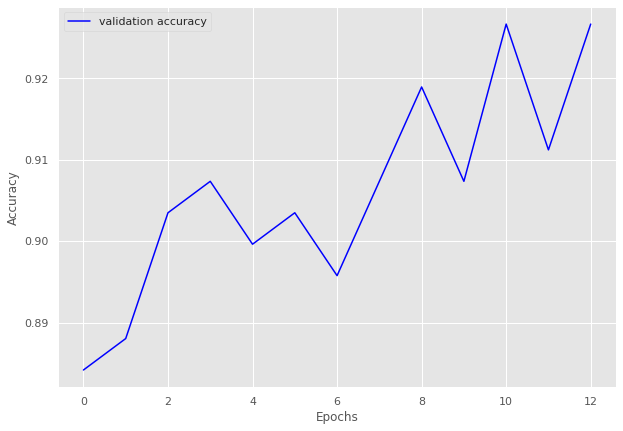

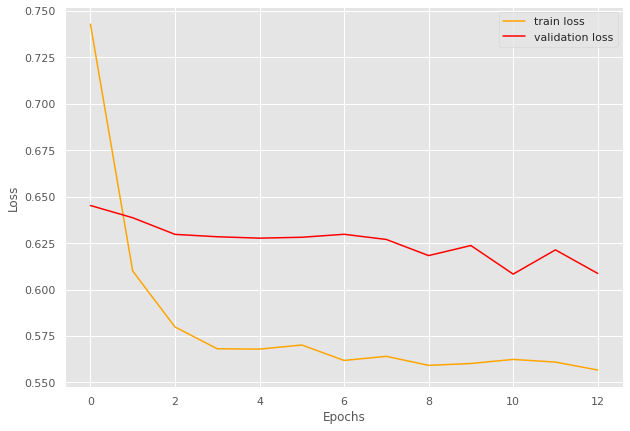

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 38/38 [00:12<00:00,  2.98batch/s, loss=1.28]


train loss 1.2826727409111827, validation loss 1.1194069385528564, validation accuracy 0.936026936026936
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.98batch/s, loss=1.09]


train loss 1.0934902115872032, validation loss 1.0998602032661438, validation accuracy 0.9478114478114478
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.97batch/s, loss=1.08]


train loss 1.0757073854145252, validation loss 1.0946417927742005, validation accuracy 0.9545454545454546
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.98batch/s, loss=1.07]


train loss 1.06928687346609, validation loss 1.0922292590141296, validation accuracy 0.9528619528619529
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 38/38 [00:13<00:00,  2.86batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0650577325569957, validation loss 1.0954621195793153, validation accuracy 0.9545454545454546
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.95batch/s, loss=1.07]


train loss 1.065372906233135, validation loss 1.090338361263275, validation accuracy 0.9562289562289562
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.99batch/s, loss=1.06]


train loss 1.0622592631139254, validation loss 1.0871023058891296, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 38/38 [00:23<00:00,  1.61batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0597669356747677, validation loss 1.0957923769950866, validation accuracy 0.9494949494949495
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 38/38 [00:21<00:00,  1.74batch/s, loss=1.06]


train loss 1.0598881683851544, validation loss 1.0842274308204651, validation accuracy 0.9595959595959596
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 38/38 [00:27<00:00,  1.39batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0564561235277277, validation loss 1.0885488986968994, validation accuracy 0.9528619528619529
Coarse label 14 Epoch 11
-------------------------------


100%|██████████| 38/38 [00:26<00:00,  1.43batch/s, loss=1.05]


train loss 1.0539421846992092, validation loss 1.080121111869812, validation accuracy 0.9646464646464646
Coarse label 14 Epoch 12
-------------------------------


100%|██████████| 38/38 [00:24<00:00,  1.52batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.053239687492973, validation loss 1.0888957381248474, validation accuracy 0.9562289562289562
Coarse label 14 Epoch 13
-------------------------------


100%|██████████| 38/38 [00:29<00:00,  1.27batch/s, loss=1.05]


train loss 1.0517810206664235, validation loss 1.0791951537132263, validation accuracy 0.9629629629629629
Coarse label 14 Epoch 14
-------------------------------


100%|██████████| 38/38 [00:24<00:00,  1.57batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9601250977326036 and loss 1.0833028886999403


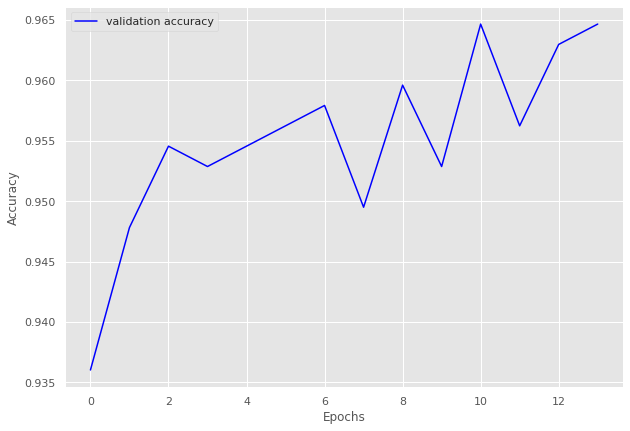

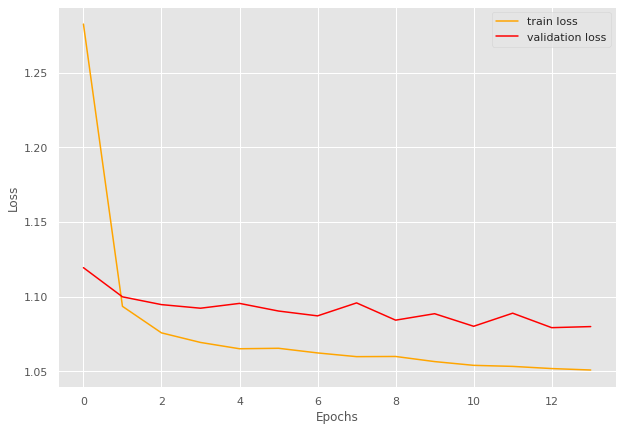

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=1.03]


train loss 1.0268216289972003, validation loss 0.8283349275588989, validation accuracy 0.9285714285714286
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.04batch/s, loss=0.799]


train loss 0.7991299848807486, validation loss 0.7909870147705078, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=0.76] 


train loss 0.7603118011825963, validation loss 0.7880706429481507, validation accuracy 0.95578231292517
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=0.755]


train loss 0.7549575128053364, validation loss 0.7850715041160583, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=0.751]


INFO: Early stopping counter 1 of 5
train loss 0.7508898785239772, validation loss 0.7973695755004883, validation accuracy 0.9319727891156463
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=0.751]


INFO: Early stopping counter 2 of 5
train loss 0.750762403011322, validation loss 0.7976582884788513, validation accuracy 0.9319727891156463
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.03batch/s, loss=0.75] 


train loss 0.7501205300029955, validation loss 0.7839081048965454, validation accuracy 0.95578231292517
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.03batch/s, loss=0.748]


train loss 0.7484398892051295, validation loss 0.7823293566703796, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=0.748]


train loss 0.7478479241069994, validation loss 0.7784441709518433, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.97batch/s, loss=0.748]


train loss 0.7476706944013897, validation loss 0.7756584405899047, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 11
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.03batch/s, loss=0.755]


INFO: Early stopping counter 3 of 5
train loss 0.7551535242482236, validation loss 0.7818538904190063, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 12
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.03batch/s, loss=0.758]


INFO: Early stopping counter 4 of 5
train loss 0.757554713048433, validation loss 0.7884488582611084, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 13
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.76batch/s, loss=0.75] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9437033687542392 and loss 0.7988183447292873


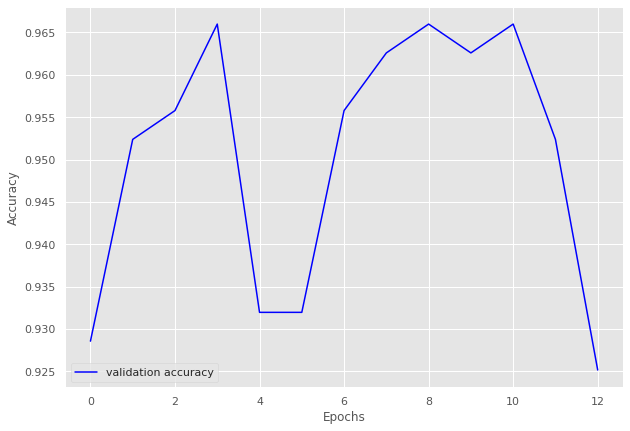

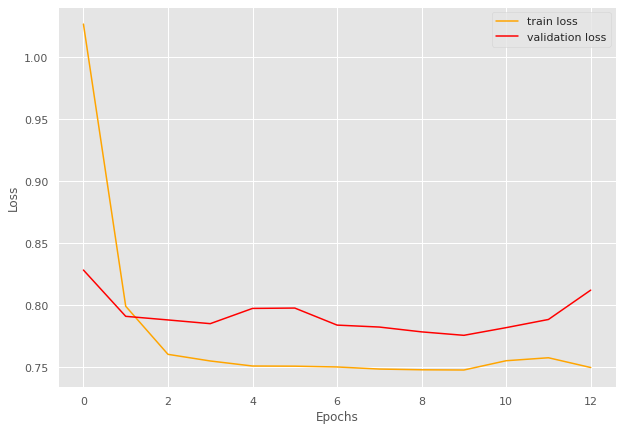

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 18/18 [00:06<00:00,  2.90batch/s, loss=0.771]


train loss 0.7712277273337046, validation loss 0.6516180872917176, validation accuracy 0.900709219858156
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.93batch/s, loss=0.589]


train loss 0.5887690153386858, validation loss 0.6132601976394654, validation accuracy 0.9361702127659575
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.99batch/s, loss=0.569]


train loss 0.5689057442877028, validation loss 0.6041184544563294, validation accuracy 0.950354609929078
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.00batch/s, loss=0.561]


train loss 0.560757060845693, validation loss 0.6031244993209839, validation accuracy 0.9468085106382979
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.00batch/s, loss=0.559]


train loss 0.5590235988299052, validation loss 0.5896210908889771, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  3.00batch/s, loss=0.555]


INFO: Early stopping counter 1 of 5
train loss 0.5552434358331892, validation loss 0.5958184480667115, validation accuracy 0.9574468085106383
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.98batch/s, loss=0.557]


train loss 0.5568185514873929, validation loss 0.5890419483184814, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.01batch/s, loss=0.555]


INFO: Early stopping counter 2 of 5
train loss 0.5551591946019067, validation loss 0.6078300833702087, validation accuracy 0.9539007092198581
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  3.00batch/s, loss=0.555]


INFO: Early stopping counter 3 of 5
train loss 0.55486328403155, validation loss 0.6050702095031738, validation accuracy 0.9539007092198581
Coarse label 16 Epoch 10
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.00batch/s, loss=0.555]


INFO: Early stopping counter 4 of 5
train loss 0.5546895530488756, validation loss 0.6028857350349426, validation accuracy 0.950354609929078
Coarse label 16 Epoch 11
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.98batch/s, loss=0.555]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9627797408716137 and loss 0.5872500013949266


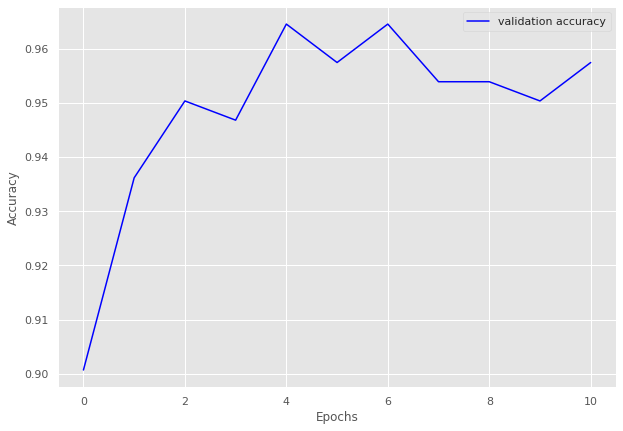

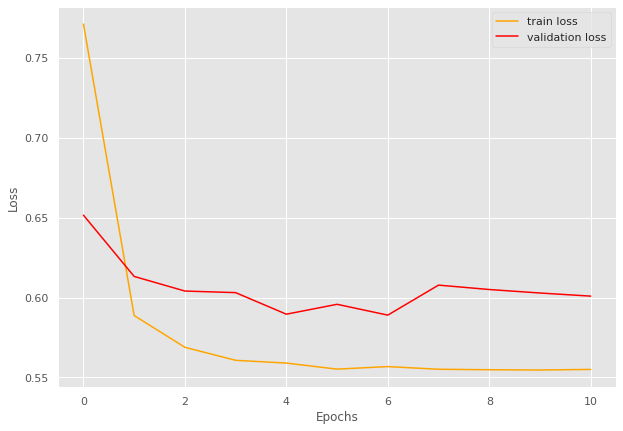

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 20/20 [00:06<00:00,  3.06batch/s, loss=1.04]


train loss 1.0421382009983062, validation loss 0.8785932779312133, validation accuracy 0.883495145631068
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.815]


train loss 0.8154224574565887, validation loss 0.8287426948547363, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.04batch/s, loss=0.78] 


train loss 0.7801448076963424, validation loss 0.8152316212654114, validation accuracy 0.9288025889967637
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.767]


INFO: Early stopping counter 1 of 5
train loss 0.766881737112999, validation loss 0.8162191867828369, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.96batch/s, loss=0.766]


train loss 0.766188257932663, validation loss 0.8106520533561706, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.96batch/s, loss=0.77] 


train loss 0.7698469400405884, validation loss 0.8036865353584289, validation accuracy 0.941747572815534
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.04batch/s, loss=0.759]


INFO: Early stopping counter 2 of 5
train loss 0.7590443968772889, validation loss 0.8119723558425903, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.762]


INFO: Early stopping counter 3 of 5
train loss 0.7622393906116486, validation loss 0.8071220874786377, validation accuracy 0.9352750809061489
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 20/20 [00:07<00:00,  2.83batch/s, loss=0.758]


INFO: Early stopping counter 4 of 5
train loss 0.7575988739728927, validation loss 0.8084844946861267, validation accuracy 0.9352750809061489
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.98batch/s, loss=0.756]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9204643164230438 and loss 0.8223887845261456


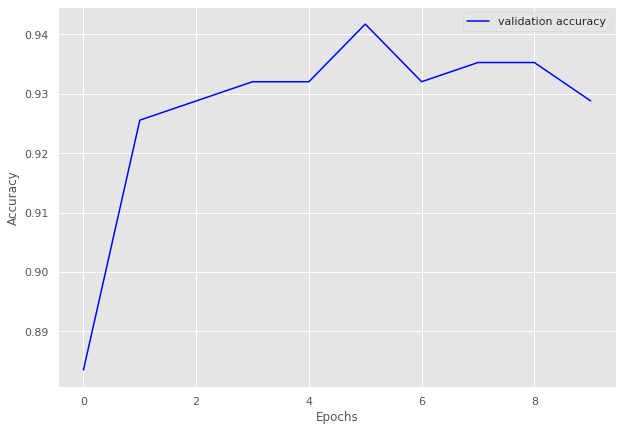

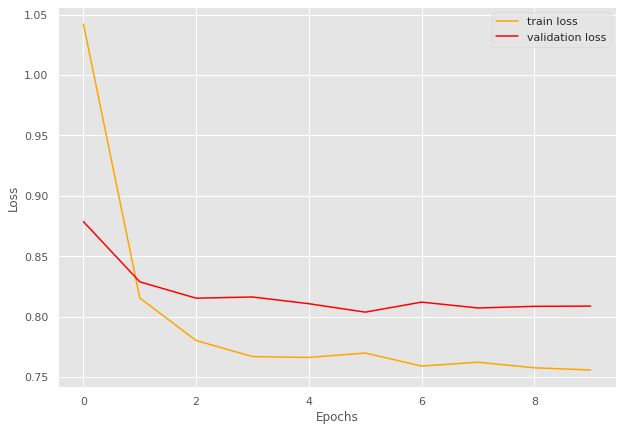

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 7/7 [00:02<00:00,  3.31batch/s, loss=1.21]


train loss 1.2104867356164115, validation loss 1.076687753200531, validation accuracy 0.7708333333333334
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.29batch/s, loss=0.923]


train loss 0.9229200567517962, validation loss 0.9177055954933167, validation accuracy 0.8541666666666666
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  2.62batch/s, loss=0.829]


train loss 0.8293420842715672, validation loss 0.8811317384243011, validation accuracy 0.8645833333333334
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.24batch/s, loss=0.782]


train loss 0.7815255607877459, validation loss 0.8588990271091461, validation accuracy 0.8645833333333334
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.33batch/s, loss=0.772]


train loss 0.7721931423459735, validation loss 0.8426544666290283, validation accuracy 0.90625
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.33batch/s, loss=0.775]


train loss 0.7745386276926313, validation loss 0.8403635621070862, validation accuracy 0.8958333333333334
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.30batch/s, loss=0.776]


INFO: Early stopping counter 1 of 5
train loss 0.776070203099932, validation loss 0.8467977941036224, validation accuracy 0.90625
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.32batch/s, loss=0.751]


INFO: Early stopping counter 2 of 5
train loss 0.7508343969072614, validation loss 0.8443027138710022, validation accuracy 0.90625
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.34batch/s, loss=0.75] 


INFO: Early stopping counter 3 of 5
train loss 0.7499903099877494, validation loss 0.8414888083934784, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.32batch/s, loss=0.785]


train loss 0.784760594367981, validation loss 0.8362989127635956, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.34batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.7513042518070766, validation loss 0.8879928588867188, validation accuracy 0.8854166666666666
Coarse label 19 Epoch 12
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.32batch/s, loss=0.76] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.8845108695652174 and loss 0.8593164526897928


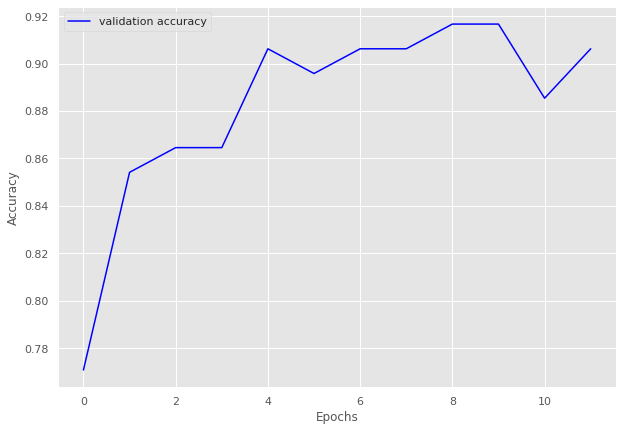

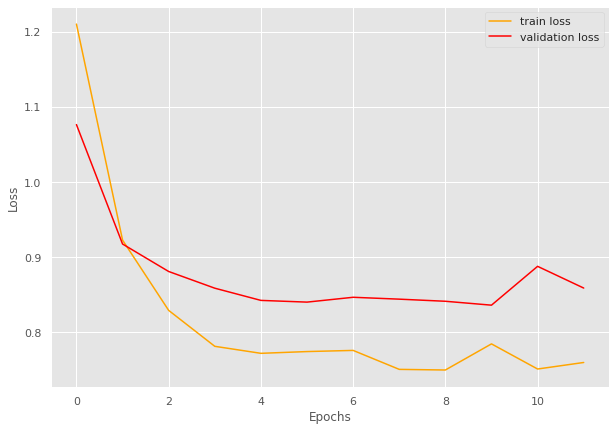

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=1.13]


train loss 1.1321583012255227, validation loss 0.9815766130174909, validation accuracy 0.9277389277389277
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=0.959]


train loss 0.9591792938185901, validation loss 0.9718283329691205, validation accuracy 0.9300699300699301
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.90batch/s, loss=0.94] 


train loss 0.9397801974924599, validation loss 0.9665674567222595, validation accuracy 0.9370629370629371
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.935]


train loss 0.9352315504376482, validation loss 0.9579889178276062, validation accuracy 0.9487179487179487
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:16<00:00,  2.50batch/s, loss=0.929]


INFO: Early stopping counter 1 of 5
train loss 0.9286118382360877, validation loss 0.9619366441454206, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=0.928]


INFO: Early stopping counter 2 of 5
train loss 0.9275633387449311, validation loss 0.9628560798508781, validation accuracy 0.9393939393939394
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=0.931]


INFO: Early stopping counter 3 of 5
train loss 0.9310647409136702, validation loss 0.9743396895272392, validation accuracy 0.9254079254079254
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.97batch/s, loss=0.924]


INFO: Early stopping counter 4 of 5
train loss 0.9236578287147894, validation loss 0.9612905383110046, validation accuracy 0.9440559440559441
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.77batch/s, loss=0.925]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9241992882562278 and loss 0.9816421893509951


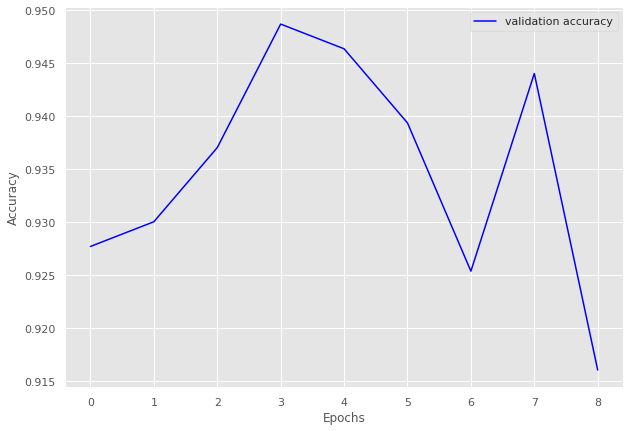

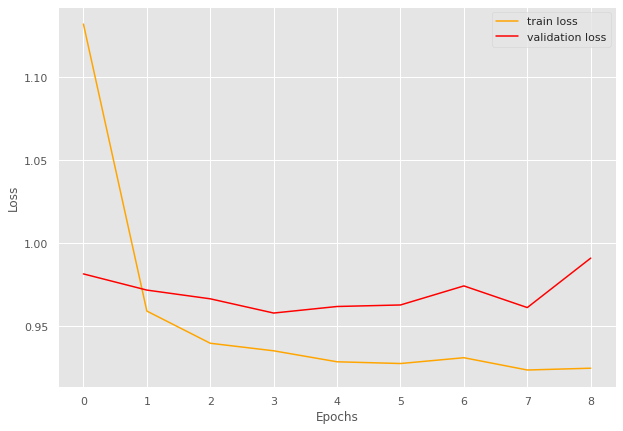

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 18/18 [00:06<00:00,  2.99batch/s, loss=1.37]


train loss 1.3747769660419888, validation loss 1.2000354925791423, validation accuracy 0.8548387096774194
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.02batch/s, loss=1.11]


train loss 1.109695401456621, validation loss 1.14952286084493, validation accuracy 0.9032258064516129
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.96batch/s, loss=1.08]


train loss 1.0755409399668376, validation loss 1.1261300245920818, validation accuracy 0.9247311827956989
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.00batch/s, loss=1.06]


train loss 1.0597782929738362, validation loss 1.1132140556971233, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.96batch/s, loss=1.06]


train loss 1.05572905143102, validation loss 1.106451153755188, validation accuracy 0.946236559139785
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0554464393191867, validation loss 1.119924505551656, validation accuracy 0.9247311827956989
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.00batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.0522779557440016, validation loss 1.124999205271403, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.99batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.055393980609046, validation loss 1.137839635213216, validation accuracy 0.9032258064516129
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.01batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.055930945608351, validation loss 1.1174782514572144, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  3.00batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9530036779730282 and loss 1.092825513619643


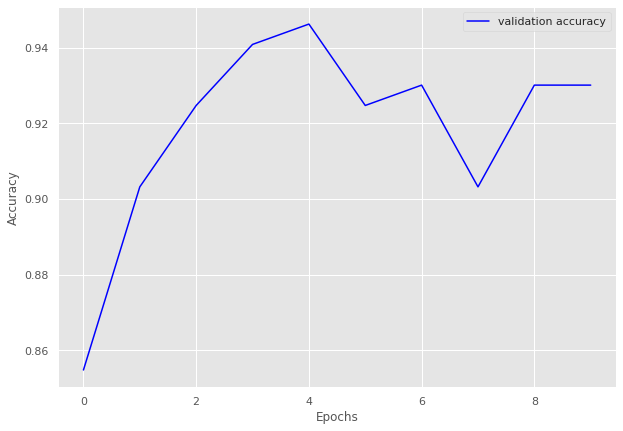

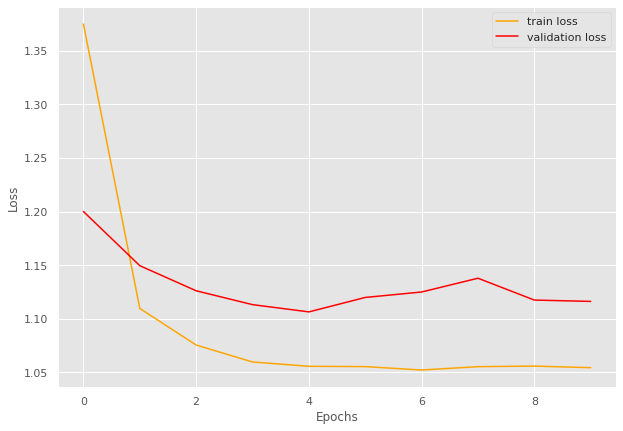

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 83/83 [00:28<00:00,  2.94batch/s, loss=1.72]


train loss 1.7193360759551266, validation loss 1.5655440092086792, validation accuracy 0.9091954022988505
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.91batch/s, loss=1.54]


train loss 1.5372421712760467, validation loss 1.5508879337991988, validation accuracy 0.9149425287356322
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.95batch/s, loss=1.52]


train loss 1.5224952740841602, validation loss 1.5333339997700282, validation accuracy 0.9333333333333333
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.95batch/s, loss=1.51]


INFO: Early stopping counter 1 of 5
train loss 1.5066863901643868, validation loss 1.5460476534707206, validation accuracy 0.9172413793103448
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.96batch/s, loss=1.51]


INFO: Early stopping counter 2 of 5
train loss 1.5108289359563805, validation loss 1.5360301051821028, validation accuracy 0.9275862068965517
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 83/83 [00:29<00:00,  2.81batch/s, loss=1.5] 


INFO: Early stopping counter 3 of 5
train loss 1.498713519199785, validation loss 1.5410881638526917, validation accuracy 0.9252873563218391
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.95batch/s, loss=1.5]


train loss 1.4950771259974285, validation loss 1.5324812361172266, validation accuracy 0.9275862068965517
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.93batch/s, loss=1.49]


INFO: Early stopping counter 4 of 5
train loss 1.4929888995296985, validation loss 1.5408050588199071, validation accuracy 0.9229885057471264
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.92batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9381578947368421 and loss 1.524761212604672


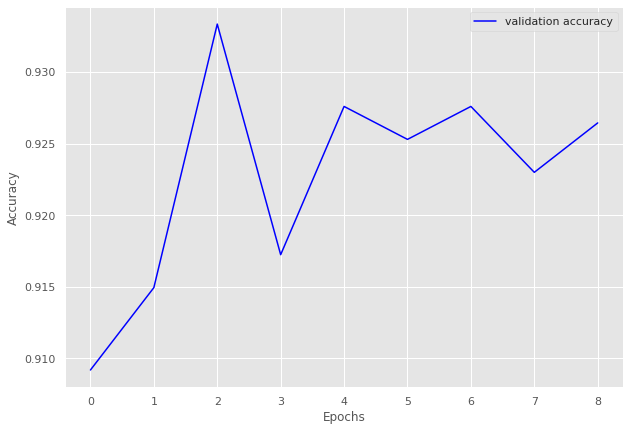

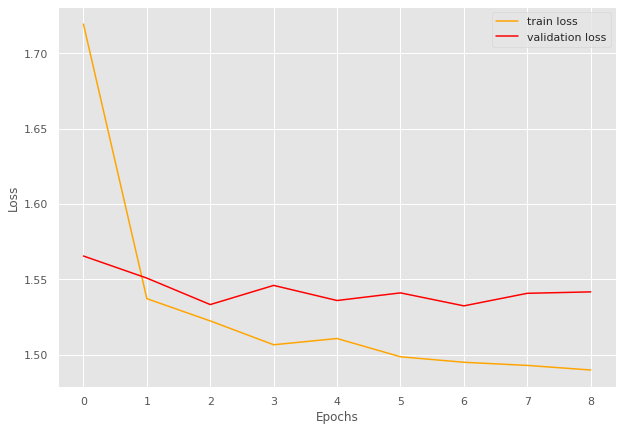

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 39/39 [00:13<00:00,  2.96batch/s, loss=1.34]


train loss 1.3359148441216884, validation loss 1.1802717106682914, validation accuracy 0.8592233009708737
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.92batch/s, loss=1.13]


train loss 1.126194715499878, validation loss 1.111608522278922, validation accuracy 0.9344660194174758
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.98batch/s, loss=1.09]


INFO: Early stopping counter 1 of 5
train loss 1.0899667403636835, validation loss 1.1180888244083949, validation accuracy 0.9271844660194175
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.08]


train loss 1.0838352227822328, validation loss 1.1016488586153304, validation accuracy 0.9441747572815534
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.94batch/s, loss=1.07]


train loss 1.0703319372274938, validation loss 1.1002551828111922, validation accuracy 0.941747572815534
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0647027034025927, validation loss 1.1055063349860055, validation accuracy 0.941747572815534
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.06]


train loss 1.0644310865646753, validation loss 1.0961879662105016, validation accuracy 0.9441747572815534
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0631048648785322, validation loss 1.1160820211683, validation accuracy 0.9271844660194175
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 39/39 [00:14<00:00,  2.77batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0646651830428686, validation loss 1.101512840815953, validation accuracy 0.9393203883495146
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.98batch/s, loss=1.07]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9405204460966543 and loss 1.1019873030045453


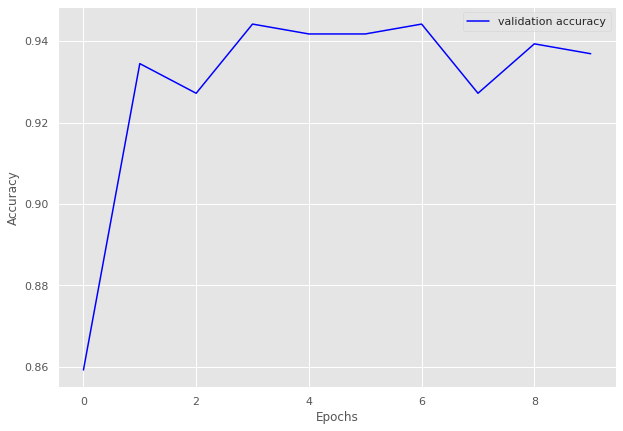

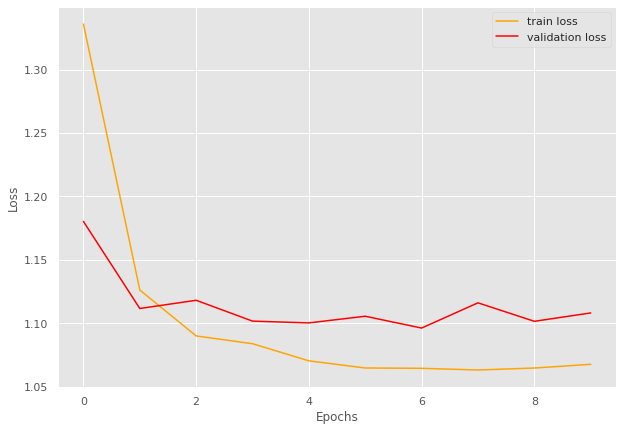

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 15/15 [00:05<00:00,  2.92batch/s, loss=0.42] 


train loss 0.420193604628245, validation loss 0.3589549660682678, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.88batch/s, loss=0.328]


INFO: Early stopping counter 1 of 5
train loss 0.3280514061450958, validation loss 0.36255696415901184, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.94batch/s, loss=0.33] 


INFO: Early stopping counter 2 of 5
train loss 0.33003105719884235, validation loss 0.3627428511778514, validation accuracy 0.949685534591195
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.92batch/s, loss=0.32] 


train loss 0.32032086650530495, validation loss 0.3534966806570689, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.73batch/s, loss=0.322]


train loss 0.32154525915781657, validation loss 0.3388398587703705, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.93batch/s, loss=0.321]


INFO: Early stopping counter 3 of 5
train loss 0.3207050085067749, validation loss 0.35457123319307965, validation accuracy 0.949685534591195
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.93batch/s, loss=0.32] 


INFO: Early stopping counter 4 of 5
train loss 0.31984508434931436, validation loss 0.3542109628518422, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.96batch/s, loss=0.319]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9672762271414822 and loss 0.34329953338160657


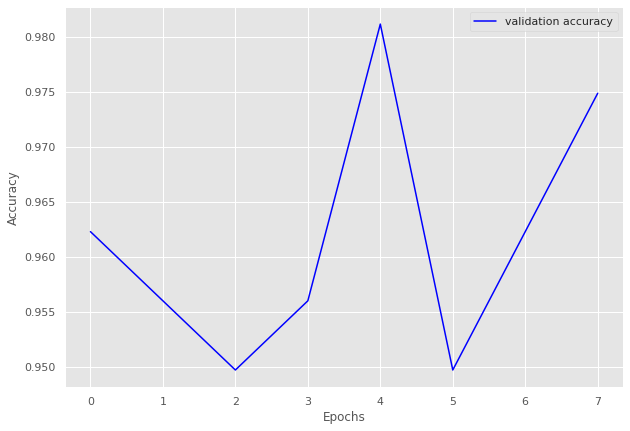

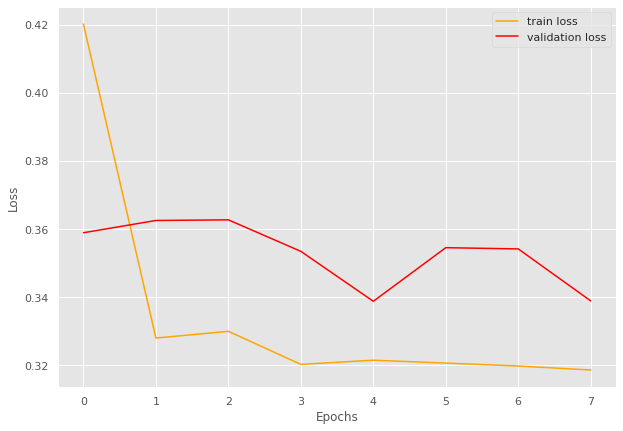

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 44/44 [00:14<00:00,  2.94batch/s, loss=1.39]


train loss 1.3941825221885333, validation loss 1.2689264863729477, validation accuracy 0.9008620689655172
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.97batch/s, loss=1.23]


train loss 1.2285885377363726, validation loss 1.2581810653209686, validation accuracy 0.9073275862068966
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 44/44 [00:15<00:00,  2.91batch/s, loss=1.21]


train loss 1.2104283706708387, validation loss 1.255369022488594, validation accuracy 0.9202586206896551
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.96batch/s, loss=1.2] 


train loss 1.2044236985119907, validation loss 1.229247346520424, validation accuracy 0.9353448275862069
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.94batch/s, loss=1.19]


INFO: Early stopping counter 1 of 5
train loss 1.1948700059543957, validation loss 1.2539806067943573, validation accuracy 0.9116379310344828
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 44/44 [00:15<00:00,  2.92batch/s, loss=1.21]


INFO: Early stopping counter 2 of 5
train loss 1.2062066928906874, validation loss 1.2593402862548828, validation accuracy 0.9094827586206896
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 44/44 [00:15<00:00,  2.93batch/s, loss=1.2] 


INFO: Early stopping counter 3 of 5
train loss 1.1959818601608276, validation loss 1.2414269149303436, validation accuracy 0.9267241379310345
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.95batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1884364431554622, validation loss 1.2357375621795654, validation accuracy 0.9288793103448276
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 44/44 [00:15<00:00,  2.93batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9361106537131566 and loss 1.2304157470401964


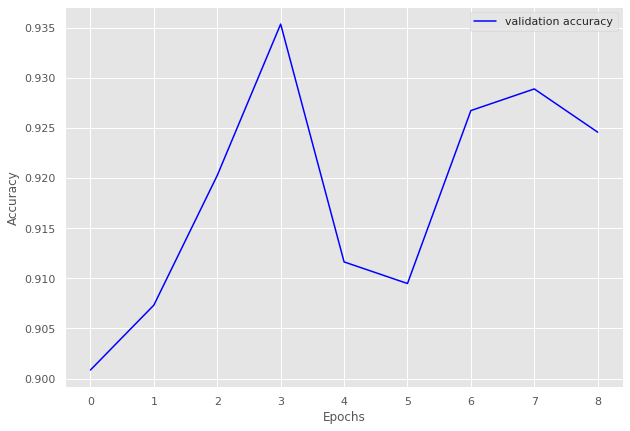

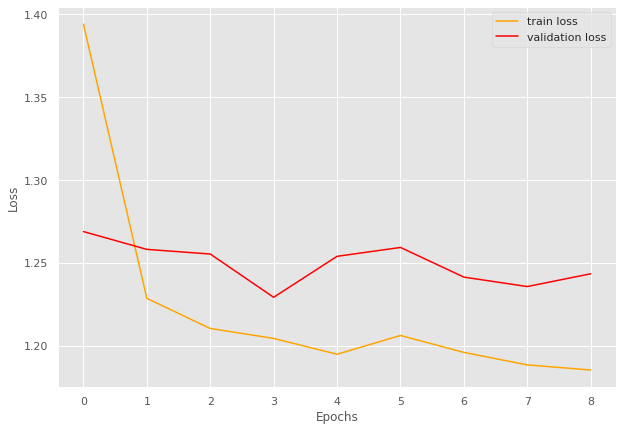

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 35/35 [00:13<00:00,  2.67batch/s, loss=0.902]


train loss 0.9023667097091674, validation loss 0.7858665585517883, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  3.00batch/s, loss=0.774]


train loss 0.7736237049102783, validation loss 0.7786317567030588, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.95batch/s, loss=0.767]


INFO: Early stopping counter 1 of 5
train loss 0.7668820176805768, validation loss 0.7917492190996805, validation accuracy 0.9504132231404959
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.95batch/s, loss=0.766]


train loss 0.7658093077795846, validation loss 0.7743632892767588, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.99batch/s, loss=0.758]


INFO: Early stopping counter 2 of 5
train loss 0.7576207944325039, validation loss 0.7790831029415131, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.95batch/s, loss=0.758]


INFO: Early stopping counter 3 of 5
train loss 0.7576161282403129, validation loss 0.7820372978846232, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.98batch/s, loss=0.761]


train loss 0.7609978556632996, validation loss 0.7713516354560852, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.97batch/s, loss=0.756]


INFO: Early stopping counter 4 of 5
train loss 0.7560298510960171, validation loss 0.7782418330510458, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.95batch/s, loss=0.753]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9833789185777404 and loss 0.7616090194384257


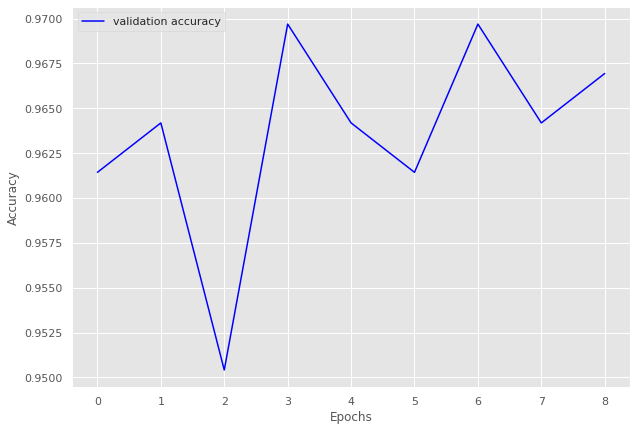

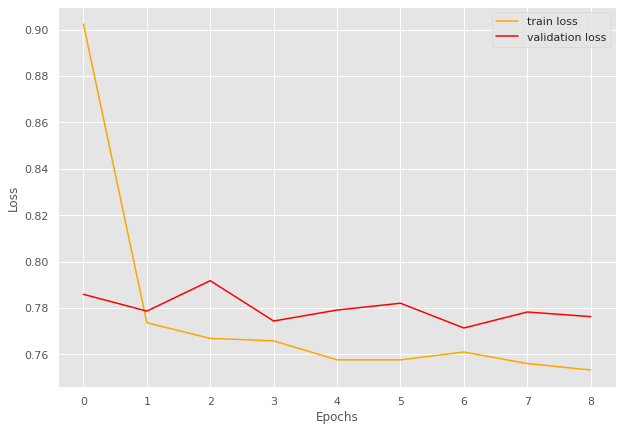

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=1.45]


train loss 1.452980131519084, validation loss 1.2780092507600784, validation accuracy 0.8923679060665362
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.98batch/s, loss=1.24]


train loss 1.238431794302804, validation loss 1.2572854459285736, validation accuracy 0.9099804305283757
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.97batch/s, loss=1.22]


train loss 1.2200097015925817, validation loss 1.2493202090263367, validation accuracy 0.9178082191780822
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=1.21]


train loss 1.2063405951675104, validation loss 1.2352470308542252, validation accuracy 0.9354207436399217
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=1.21]


INFO: Early stopping counter 1 of 5
train loss 1.2077347356445935, validation loss 1.244307354092598, validation accuracy 0.9256360078277887
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.89batch/s, loss=1.2] 


train loss 1.199852617419496, validation loss 1.2329297363758087, validation accuracy 0.9373776908023483
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=1.19]


INFO: Early stopping counter 2 of 5
train loss 1.1884284214097627, validation loss 1.2426550537347794, validation accuracy 0.9217221135029354
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 49/49 [00:29<00:00,  1.64batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1938693085495307, validation loss 1.261680617928505, validation accuracy 0.9021526418786693
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 49/49 [00:27<00:00,  1.78batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1861724245304963, validation loss 1.2416515499353409, validation accuracy 0.9217221135029354
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 49/49 [00:39<00:00,  1.23batch/s, loss=1.18]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9364984274374719 and loss 1.229515098390125


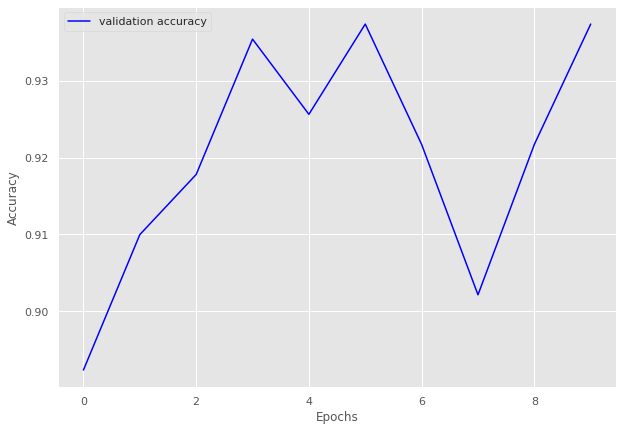

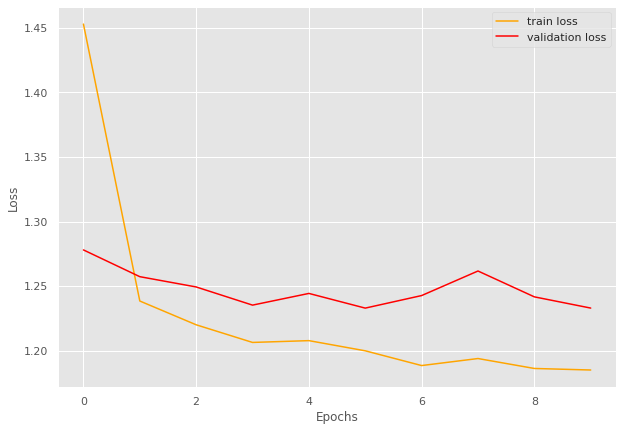

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 61/61 [00:50<00:00,  1.22batch/s, loss=1.72]


train loss 1.7163180562316394, validation loss 1.584375966678966, validation accuracy 0.8981481481481481
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.80batch/s, loss=1.54]


train loss 1.5391384539056996, validation loss 1.5644040541215376, validation accuracy 0.9228395061728395
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.82batch/s, loss=1.52]


train loss 1.5228793034788037, validation loss 1.5566403974186291, validation accuracy 0.9305555555555556
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.79batch/s, loss=1.5] 


train loss 1.5020116137676551, validation loss 1.5547116561369463, validation accuracy 0.9305555555555556
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 61/61 [00:20<00:00,  2.91batch/s, loss=1.5] 


train loss 1.4963983727283166, validation loss 1.5496761148626155, validation accuracy 0.9382716049382716
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 61/61 [00:20<00:00,  2.91batch/s, loss=1.49]


train loss 1.4889354490842976, validation loss 1.5385608889839866, validation accuracy 0.9398148148148148
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 61/61 [00:20<00:00,  2.91batch/s, loss=1.49]


train loss 1.4883937308045685, validation loss 1.5250774513591419, validation accuracy 0.9429012345679012
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.90batch/s, loss=1.48]


train loss 1.4811912970464738, validation loss 1.5215265425768765, validation accuracy 0.9459876543209876
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 61/61 [00:20<00:00,  2.92batch/s, loss=1.48]


train loss 1.4829571149388299, validation loss 1.5190831639549949, validation accuracy 0.9459876543209876
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.89batch/s, loss=1.48]


INFO: Early stopping counter 1 of 5
train loss 1.4803430584610486, validation loss 1.530495448545976, validation accuracy 0.933641975308642
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.86batch/s, loss=1.48]


INFO: Early stopping counter 2 of 5
train loss 1.4792330988117905, validation loss 1.5304124355316162, validation accuracy 0.9444444444444444
Coarse label 9 Epoch 12
-------------------------------


100%|██████████| 61/61 [00:20<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.475094660383756, validation loss 1.5345399596474387, validation accuracy 0.9398148148148148
Coarse label 9 Epoch 13
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.90batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4763254962983678, validation loss 1.5338802879506892, validation accuracy 0.9429012345679012
Coarse label 9 Epoch 14
-------------------------------


100%|██████████| 61/61 [00:20<00:00,  2.90batch/s, loss=1.47]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9537606433301797 and loss 1.5084474131576997


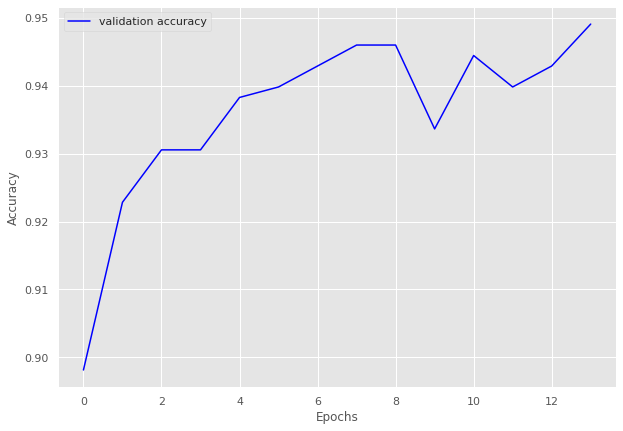

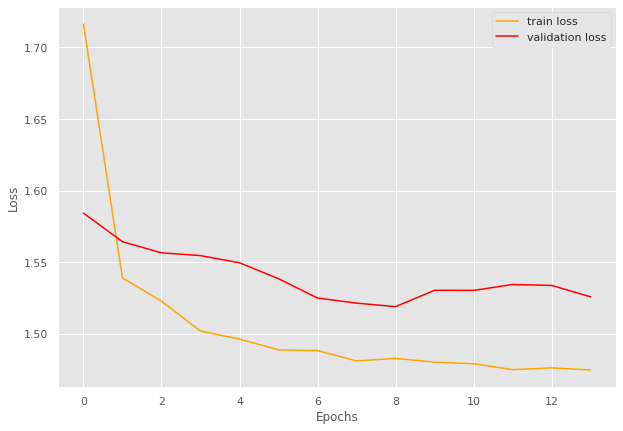

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 29/29 [00:09<00:00,  2.91batch/s, loss=0.919]


train loss 0.9190595725487019, validation loss 0.789661455154419, validation accuracy 0.9506578947368421
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.96batch/s, loss=0.77] 


train loss 0.7704955709391627, validation loss 0.7804447174072265, validation accuracy 0.9572368421052632
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.94batch/s, loss=0.763]


train loss 0.7634980390811789, validation loss 0.7736924052238464, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.92batch/s, loss=0.758]


INFO: Early stopping counter 1 of 5
train loss 0.7582328833382705, validation loss 0.7767869591712951, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.97batch/s, loss=0.76] 


INFO: Early stopping counter 2 of 5
train loss 0.7598541214548308, validation loss 0.7802463173866272, validation accuracy 0.9605263157894737
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.92batch/s, loss=0.756]


INFO: Early stopping counter 3 of 5
train loss 0.7557505204759795, validation loss 0.7809189677238464, validation accuracy 0.9605263157894737
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.93batch/s, loss=0.752]


INFO: Early stopping counter 4 of 5
train loss 0.7524896613482771, validation loss 0.7841002941131592, validation accuracy 0.9572368421052632
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.95batch/s, loss=0.752]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9799297541394882 and loss 0.7642676527537997


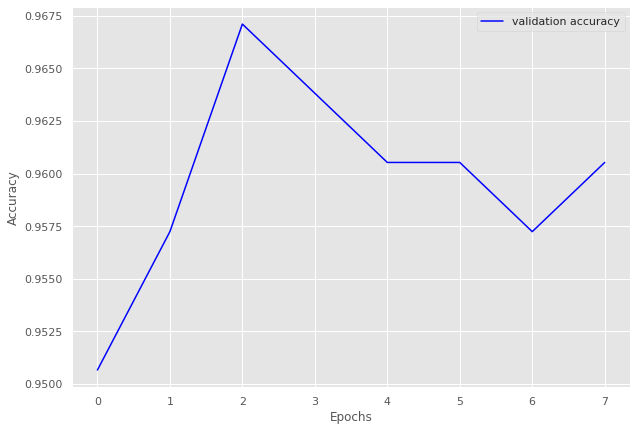

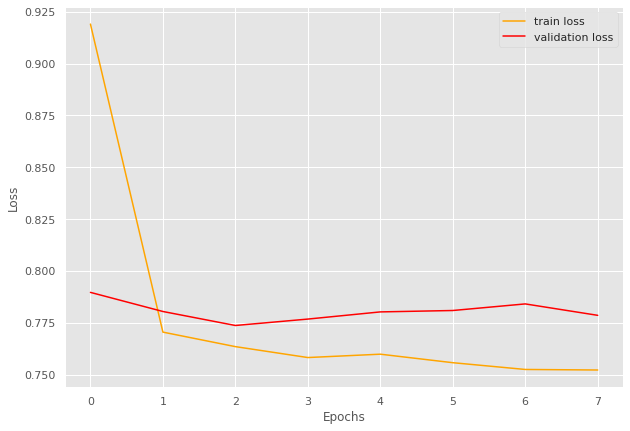

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 28/28 [00:09<00:00,  3.03batch/s, loss=1.39]


train loss 1.3948444468634469, validation loss 1.1593708038330077, validation accuracy 0.8793103448275862
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.84batch/s, loss=1.13]


train loss 1.1318442097732, validation loss 1.1464526891708373, validation accuracy 0.8931034482758621
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.1]


train loss 1.1012015896184104, validation loss 1.1312380313873291, validation accuracy 0.906896551724138
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.09]


train loss 1.090045758656093, validation loss 1.1206053256988526, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.08]


train loss 1.0781851964337485, validation loss 1.1161266565322876, validation accuracy 0.9275862068965517
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=1.08]


train loss 1.0762877464294434, validation loss 1.1096556186676025, validation accuracy 0.9310344827586207
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.94batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.0750496600355421, validation loss 1.1141555547714233, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.07]


train loss 1.071118312222617, validation loss 1.099437141418457, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0696416795253754, validation loss 1.1329232454299927, validation accuracy 0.906896551724138
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.08]


INFO: Early stopping counter 3 of 5
train loss 1.0774548053741455, validation loss 1.1282691955566406, validation accuracy 0.9137931034482759
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.0718383533614022, validation loss 1.1160528898239135, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 12
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9239044870112831 and loss 1.119514536857605


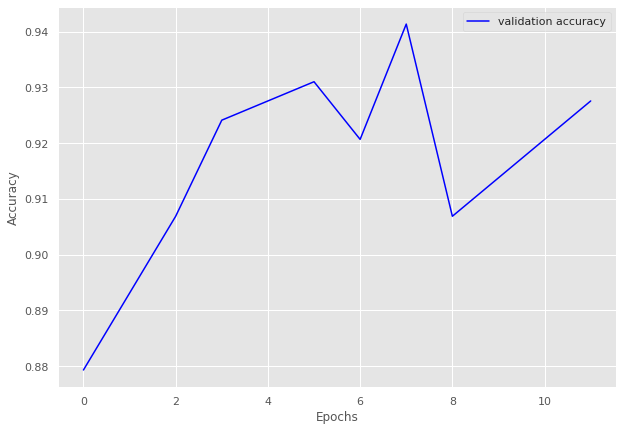

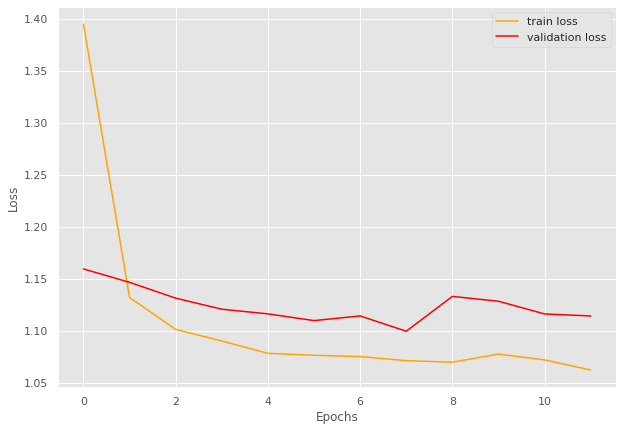

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 25/25 [00:08<00:00,  2.97batch/s, loss=0.715]


train loss 0.7148025369644165, validation loss 0.6890906929969788, validation accuracy 0.9034749034749034
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.96batch/s, loss=0.603]


train loss 0.6029101991653443, validation loss 0.6768071532249451, validation accuracy 0.9227799227799228
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.83batch/s, loss=0.586]


train loss 0.5859688711166382, validation loss 0.6725887775421142, validation accuracy 0.9227799227799228
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.01batch/s, loss=0.578]


INFO: Early stopping counter 1 of 5
train loss 0.5779376459121705, validation loss 0.6747785210609436, validation accuracy 0.9227799227799228
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.97batch/s, loss=0.573]


train loss 0.5726227688789368, validation loss 0.660779845714569, validation accuracy 0.9343629343629344
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.00batch/s, loss=0.574]


train loss 0.5740014934539794, validation loss 0.6601732730865478, validation accuracy 0.9459459459459459
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.96batch/s, loss=0.574]


INFO: Early stopping counter 2 of 5
train loss 0.5736865687370301, validation loss 0.6740815758705139, validation accuracy 0.915057915057915
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.96batch/s, loss=0.569]


INFO: Early stopping counter 3 of 5
train loss 0.5689241337776184, validation loss 0.6646507740020752, validation accuracy 0.9382239382239382
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.96batch/s, loss=0.571]


INFO: Early stopping counter 4 of 5
train loss 0.5713809967041016, validation loss 0.6607217907905578, validation accuracy 0.9420849420849421
Coarse label 13 Epoch 10
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.95batch/s, loss=0.564]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9441159077468954 and loss 0.6072246004950326


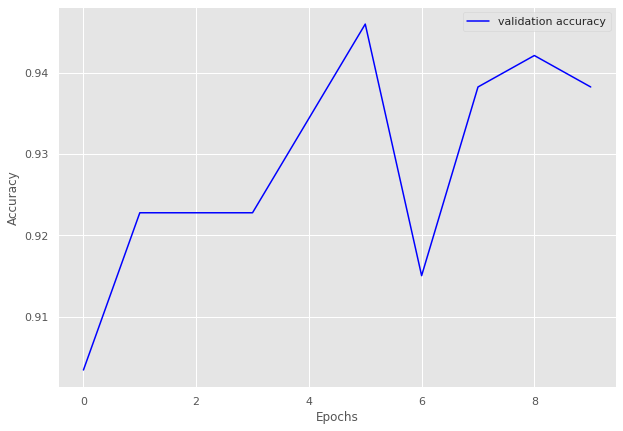

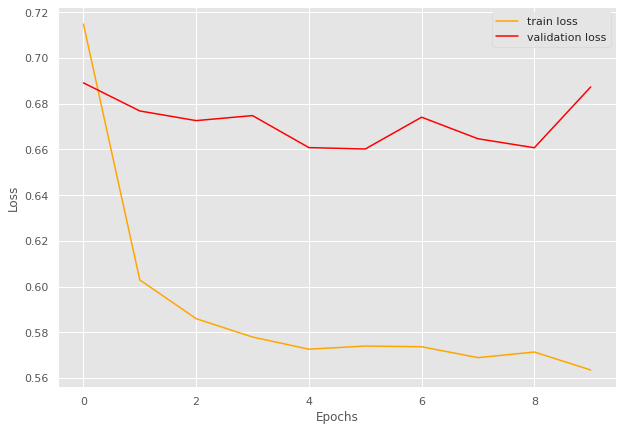

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 56/56 [00:19<00:00,  2.93batch/s, loss=1.22]


train loss 1.2173084105764116, validation loss 1.0963156580924989, validation accuracy 0.9494949494949495
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.92batch/s, loss=1.09]


INFO: Early stopping counter 1 of 5
train loss 1.088547672544207, validation loss 1.0998042225837708, validation accuracy 0.9444444444444444
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.93batch/s, loss=1.07]


train loss 1.0726186058350973, validation loss 1.0858461260795593, validation accuracy 0.9629629629629629
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.91batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0699039016451155, validation loss 1.0882904529571533, validation accuracy 0.9545454545454546
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.95batch/s, loss=1.06]


train loss 1.0639493422848838, validation loss 1.0824853658676148, validation accuracy 0.9629629629629629
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 56/56 [00:18<00:00,  2.95batch/s, loss=1.06]


train loss 1.059221280472619, validation loss 1.079441249370575, validation accuracy 0.9629629629629629
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.91batch/s, loss=1.06]


train loss 1.0587280094623566, validation loss 1.0777756214141845, validation accuracy 0.968013468013468
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.058248724256243, validation loss 1.0798511862754823, validation accuracy 0.9646464646464646
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 56/56 [00:20<00:00,  2.76batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0571739843913488, validation loss 1.0896022081375123, validation accuracy 0.9545454545454546
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.92batch/s, loss=1.05]


train loss 1.0549210160970688, validation loss 1.0773672223091126, validation accuracy 0.968013468013468
Coarse label 14 Epoch 11
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9610874887256797 and loss 1.0820588772414161


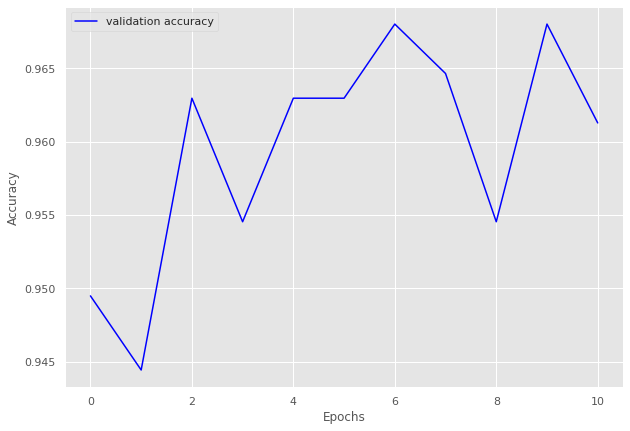

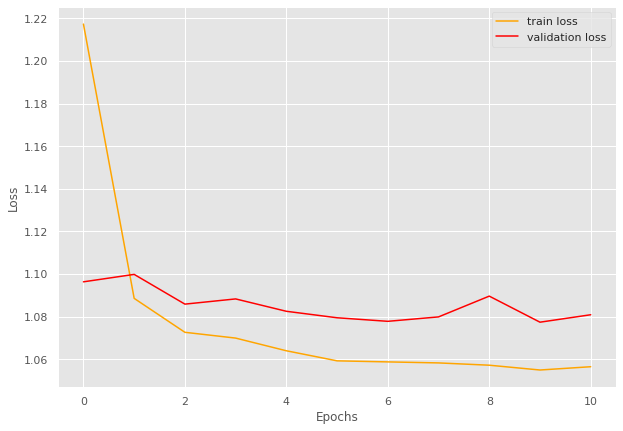

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 28/28 [00:09<00:00,  2.94batch/s, loss=0.947]


train loss 0.947267411010606, validation loss 0.7945746421813965, validation accuracy 0.9489795918367347
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=0.778]


train loss 0.7780428911958422, validation loss 0.7726133704185486, validation accuracy 0.9761904761904762
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=0.758]


INFO: Early stopping counter 1 of 5
train loss 0.7583960784333093, validation loss 0.7921754479408264, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=0.752]


INFO: Early stopping counter 2 of 5
train loss 0.7519480756350926, validation loss 0.7840999007225037, validation accuracy 0.9591836734693877
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.82batch/s, loss=0.752]


INFO: Early stopping counter 3 of 5
train loss 0.7518267972128732, validation loss 0.7793142080307007, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.7514632535832269, validation loss 0.7827473998069763, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=0.751]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9632237871674492 and loss 0.7815506855646769


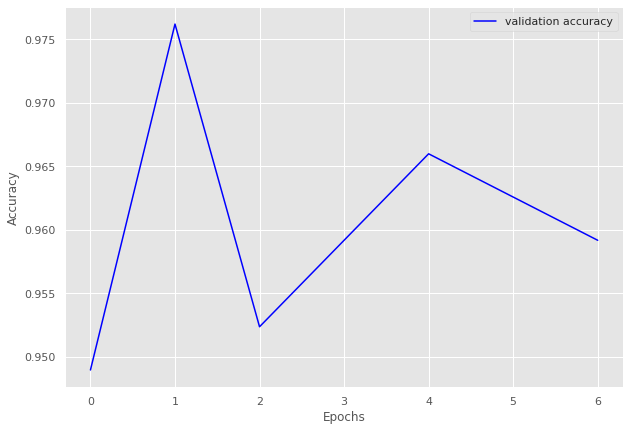

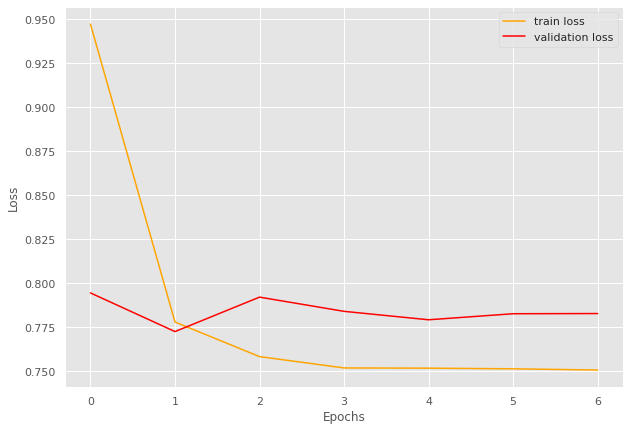

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 27/27 [00:09<00:00,  2.97batch/s, loss=0.717]


train loss 0.7174280462441621, validation loss 0.6409312605857849, validation accuracy 0.9184397163120568
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.95batch/s, loss=0.578]


train loss 0.5782343634852657, validation loss 0.603769850730896, validation accuracy 0.9539007092198581
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.95batch/s, loss=0.566]


train loss 0.5655893418524001, validation loss 0.5878933906555176, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.95batch/s, loss=0.56] 


INFO: Early stopping counter 1 of 5
train loss 0.5602515251548202, validation loss 0.5949796319007874, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.97batch/s, loss=0.558]


INFO: Early stopping counter 2 of 5
train loss 0.5579333746874774, validation loss 0.5989503622055053, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.98batch/s, loss=0.557]


INFO: Early stopping counter 3 of 5
train loss 0.5568119419945611, validation loss 0.6038430571556092, validation accuracy 0.950354609929078
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.97batch/s, loss=0.558]


INFO: Early stopping counter 4 of 5
train loss 0.557900071144104, validation loss 0.5915174126625061, validation accuracy 0.9574468085106383
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.96batch/s, loss=0.556]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.967110627888013 and loss 0.5831358227236517


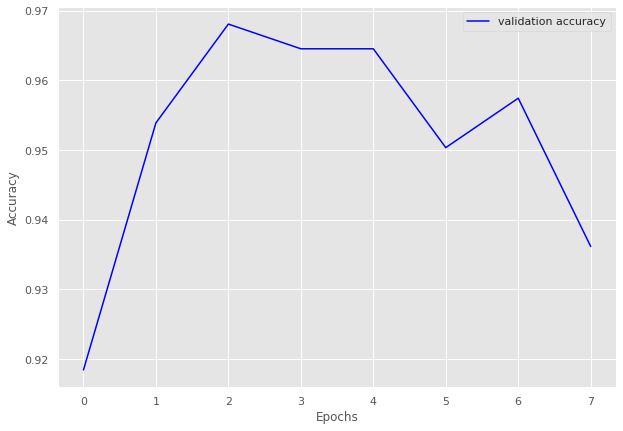

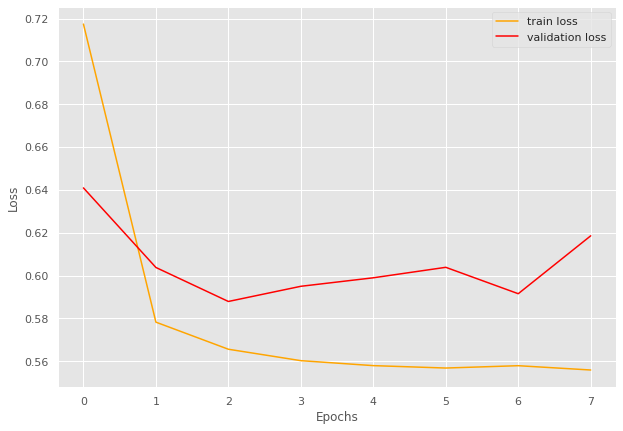

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.981]


train loss 0.9812867343425751, validation loss 0.8668463587760925, validation accuracy 0.883495145631068
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.74batch/s, loss=0.815]


train loss 0.8147342185179393, validation loss 0.8223837494850159, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.03batch/s, loss=0.789]


INFO: Early stopping counter 1 of 5
train loss 0.7886731704076131, validation loss 0.8307181835174561, validation accuracy 0.9158576051779935
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.00batch/s, loss=0.772]


train loss 0.7715819239616394, validation loss 0.8177370309829712, validation accuracy 0.919093851132686
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.772]


INFO: Early stopping counter 2 of 5
train loss 0.772281962633133, validation loss 0.8182167649269104, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.03batch/s, loss=0.766]


INFO: Early stopping counter 3 of 5
train loss 0.7659208059310914, validation loss 0.8235128879547119, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.77] 


INFO: Early stopping counter 4 of 5
train loss 0.7695761899153392, validation loss 0.8204408049583435, validation accuracy 0.9223300970873787
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.97batch/s, loss=0.755]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9432043650793651 and loss 0.8005991190198868


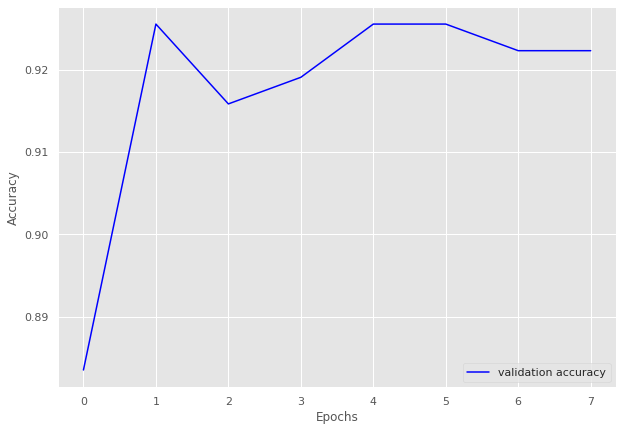

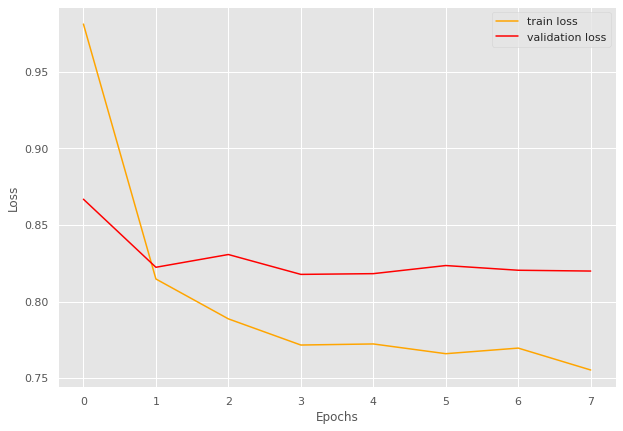

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 10/10 [00:03<00:00,  3.15batch/s, loss=1.15]


train loss 1.1494511425495149, validation loss 1.1103644371032715, validation accuracy 0.65625
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.22batch/s, loss=0.864]


train loss 0.863809734582901, validation loss 0.8329395949840546, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.20batch/s, loss=0.791]


train loss 0.7914532124996185, validation loss 0.800859808921814, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.22batch/s, loss=0.775]


train loss 0.7749486446380616, validation loss 0.8002131879329681, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.16batch/s, loss=0.757]


INFO: Early stopping counter 1 of 5
train loss 0.757264518737793, validation loss 0.8068385422229767, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.16batch/s, loss=0.764]


train loss 0.7644121527671814, validation loss 0.799711674451828, validation accuracy 0.9375
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.756]


INFO: Early stopping counter 2 of 5
train loss 0.7561566829681396, validation loss 0.8128429353237152, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.76]


train loss 0.7602248311042785, validation loss 0.7937406003475189, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.759]


train loss 0.7585628867149353, validation loss 0.793342798948288, validation accuracy 0.9375
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.06batch/s, loss=0.768]


INFO: Early stopping counter 3 of 5
train loss 0.7683502972126007, validation loss 0.8073941469192505, validation accuracy 0.90625
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.16batch/s, loss=0.762]


INFO: Early stopping counter 4 of 5
train loss 0.7620902895927429, validation loss 0.8369721174240112, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 12
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.772]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9420062695924765 and loss 0.8063038021326066


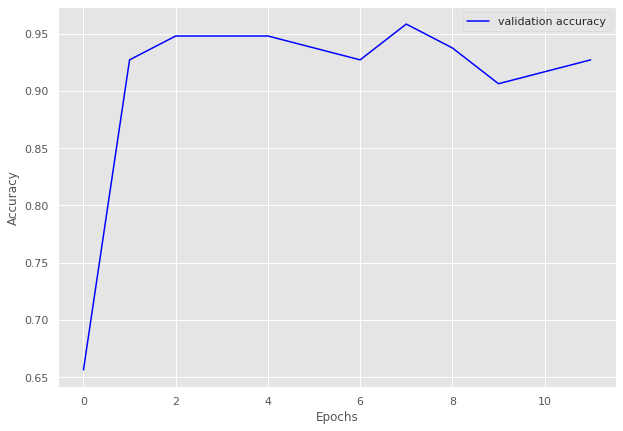

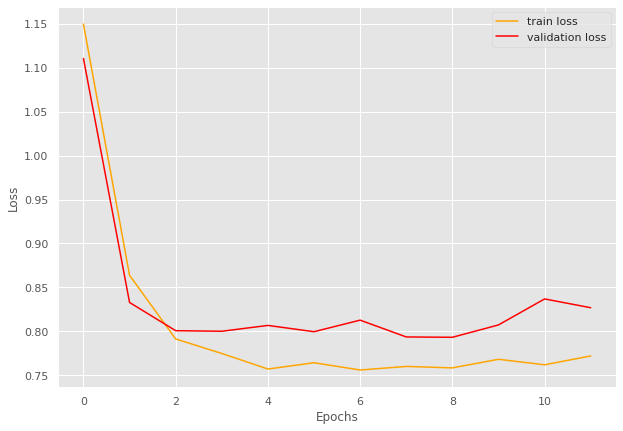

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 68/68 [00:23<00:00,  2.89batch/s, loss=1.08]


train loss 1.0782619495602215, validation loss 0.9736031549317496, validation accuracy 0.9277389277389277
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.955]


train loss 0.9548035150065142, validation loss 0.9608481185776847, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 68/68 [00:24<00:00,  2.79batch/s, loss=0.941]


train loss 0.9405318691450006, validation loss 0.9497895666531154, validation accuracy 0.958041958041958
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.92batch/s, loss=0.938]


train loss 0.9378920477979323, validation loss 0.947242796421051, validation accuracy 0.9603729603729604
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.94batch/s, loss=0.938]


train loss 0.9381997620358187, validation loss 0.9389156528881618, validation accuracy 0.965034965034965
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.94batch/s, loss=0.933]


INFO: Early stopping counter 1 of 5
train loss 0.932662678992047, validation loss 0.9420316985675267, validation accuracy 0.9627039627039627
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.932]


INFO: Early stopping counter 2 of 5
train loss 0.9320438320145887, validation loss 0.94510931628091, validation accuracy 0.958041958041958
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.95batch/s, loss=0.929]


INFO: Early stopping counter 3 of 5
train loss 0.9291358283337425, validation loss 0.9441878284726825, validation accuracy 0.9603729603729604
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.94batch/s, loss=0.927]


INFO: Early stopping counter 4 of 5
train loss 0.9273327299777199, validation loss 0.9435352342469352, validation accuracy 0.9627039627039627
Coarse label 0 Epoch 10
-------------------------------


100%|██████████| 68/68 [00:22<00:00,  2.96batch/s, loss=0.929]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9455432828153095 and loss 0.9581104223845435


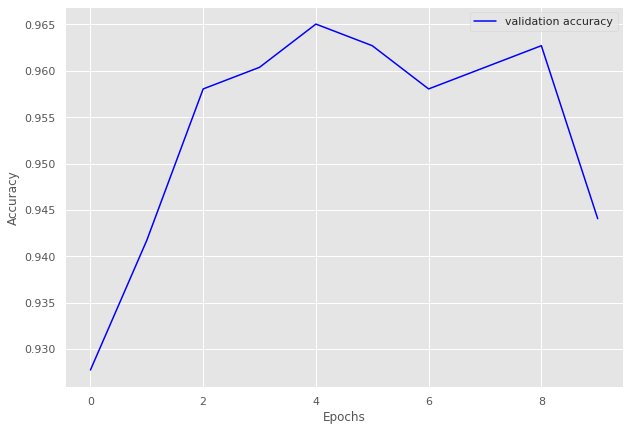

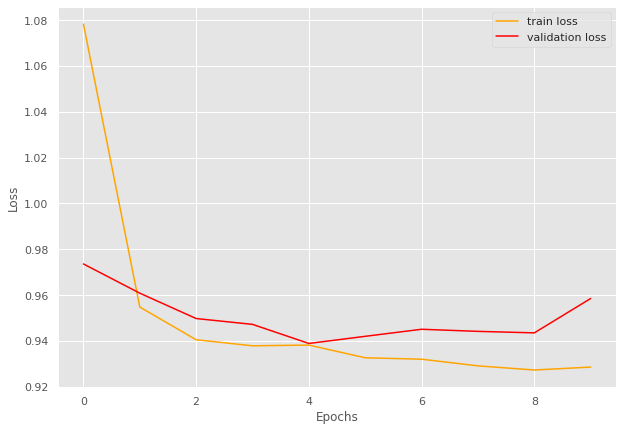

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 30/30 [00:09<00:00,  3.00batch/s, loss=1.28]


train loss 1.2806787768999734, validation loss 1.143183946609497, validation accuracy 0.9086021505376344
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=1.09]


train loss 1.0936236421267191, validation loss 1.096666733423869, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.96batch/s, loss=1.07]


train loss 1.0657016158103942, validation loss 1.0946214596430461, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.95batch/s, loss=1.06]


train loss 1.058607546488444, validation loss 1.0837403535842896, validation accuracy 0.9623655913978495
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.95batch/s, loss=1.06]


train loss 1.0588636159896851, validation loss 1.0814429918924968, validation accuracy 0.967741935483871
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:11<00:00,  2.66batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0596856077512105, validation loss 1.0864874521891277, validation accuracy 0.9623655913978495
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.060215961933136, validation loss 1.096885363260905, validation accuracy 0.946236559139785
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0578367749849955, validation loss 1.0930746793746948, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0593206604321799, validation loss 1.0876063108444214, validation accuracy 0.956989247311828
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9569575471698113 and loss 1.0861850138063784


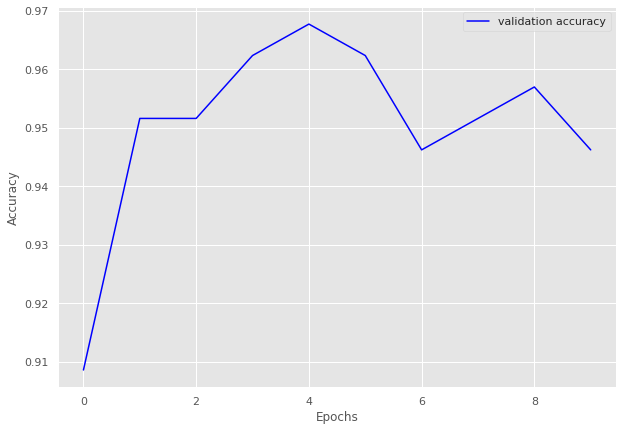

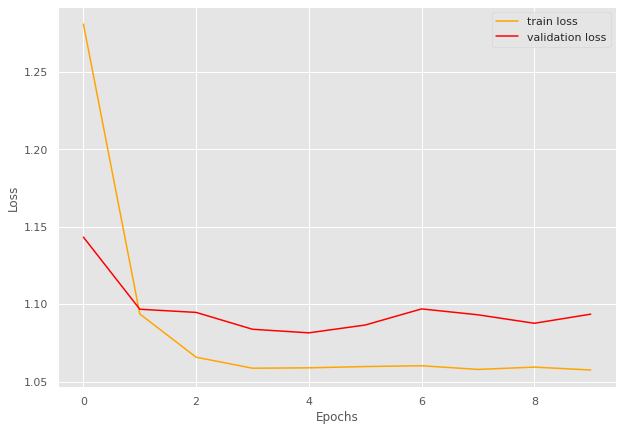

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 137/137 [00:46<00:00,  2.92batch/s, loss=1.66]


train loss 1.6553494878058885, validation loss 1.534047782421112, validation accuracy 0.9310344827586207
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 137/137 [00:46<00:00,  2.92batch/s, loss=1.53]


train loss 1.5306307921444413, validation loss 1.5108811088970728, validation accuracy 0.9528735632183908
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.51]


INFO: Early stopping counter 1 of 5
train loss 1.5117230789504783, validation loss 1.5145389522824968, validation accuracy 0.9459770114942528
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.88batch/s, loss=1.51]


INFO: Early stopping counter 2 of 5
train loss 1.5069238112790742, validation loss 1.5154297607285636, validation accuracy 0.9471264367816092
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 137/137 [00:48<00:00,  2.84batch/s, loss=1.5]


INFO: Early stopping counter 3 of 5
train loss 1.500847951339109, validation loss 1.5134692106928145, validation accuracy 0.9482758620689655
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.5]


INFO: Early stopping counter 4 of 5
train loss 1.4975988107876186, validation loss 1.5128429276602608, validation accuracy 0.9528735632183908
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 137/137 [00:46<00:00,  2.92batch/s, loss=1.49]


train loss 1.492913528950545, validation loss 1.5104602830750602, validation accuracy 0.9528735632183908
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.49]


train loss 1.4891527299463314, validation loss 1.4995358416012354, validation accuracy 0.960919540229885
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 137/137 [00:46<00:00,  2.92batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9510959077663753 and loss 1.510005514467916


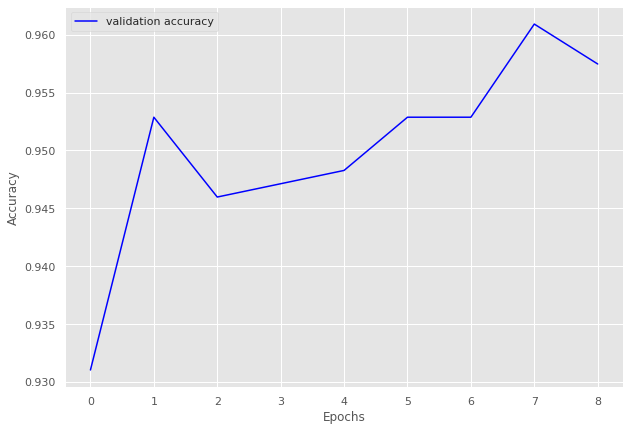

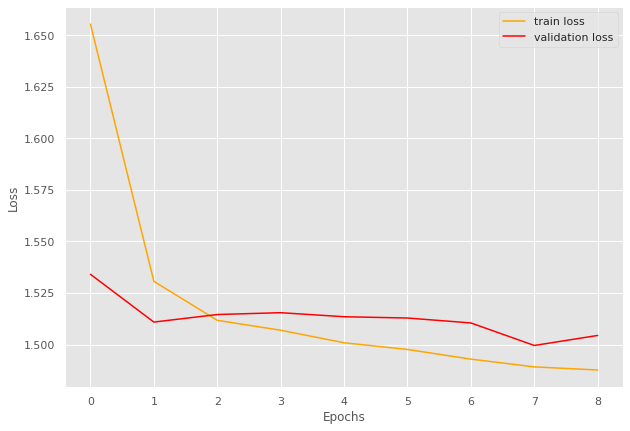

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 65/65 [00:23<00:00,  2.79batch/s, loss=1.29]


train loss 1.2900425397432767, validation loss 1.1670140368597848, validation accuracy 0.8883495145631068
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.12]


train loss 1.11816757275508, validation loss 1.1272044352122716, validation accuracy 0.9150485436893204
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.08]


train loss 1.08344886302948, validation loss 1.1017121246882848, validation accuracy 0.9441747572815534
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=1.08]


train loss 1.076783481011024, validation loss 1.100150465965271, validation accuracy 0.9490291262135923
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.97batch/s, loss=1.07]


train loss 1.0730612553082979, validation loss 1.0981241124016898, validation accuracy 0.9490291262135923
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=1.07]


train loss 1.0703950881958009, validation loss 1.0974997622626168, validation accuracy 0.941747572815534
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.06]


train loss 1.0649375475369967, validation loss 1.0911255393709456, validation accuracy 0.9538834951456311
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.97batch/s, loss=1.07]


train loss 1.0658743693278385, validation loss 1.084540503365653, validation accuracy 0.9611650485436893
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.06]


train loss 1.0613421018307025, validation loss 1.0754718950816564, validation accuracy 0.9684466019417476
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.94batch/s, loss=1.06]


train loss 1.06133538209475, validation loss 1.0749505587986536, validation accuracy 0.9660194174757282
Coarse label 4 Epoch 11
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0608620515236489, validation loss 1.0823024000440324, validation accuracy 0.9635922330097088
Coarse label 4 Epoch 12
-------------------------------


100%|██████████| 65/65 [00:23<00:00,  2.80batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0588621157866258, validation loss 1.083563310759408, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 13
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0583931024257953, validation loss 1.0780820846557617, validation accuracy 0.9684466019417476
Coarse label 4 Epoch 14
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.97batch/s, loss=1.07]


train loss 1.066022540972783, validation loss 1.0737390858786446, validation accuracy 0.9660194174757282
Coarse label 4 Epoch 15
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0608836045631995, validation loss 1.07665182862963, validation accuracy 0.9660194174757282
Coarse label 4 Epoch 16
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.94batch/s, loss=1.06]


train loss 1.0555887350669273, validation loss 1.0714701925005232, validation accuracy 0.9733009708737864
Coarse label 4 Epoch 17
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9624362758250604 and loss 1.0806352930553889


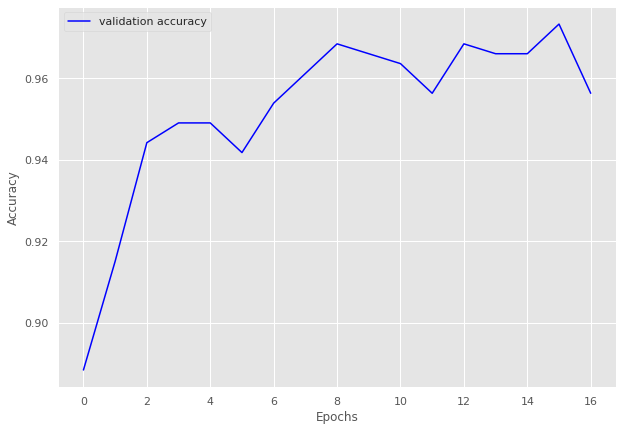

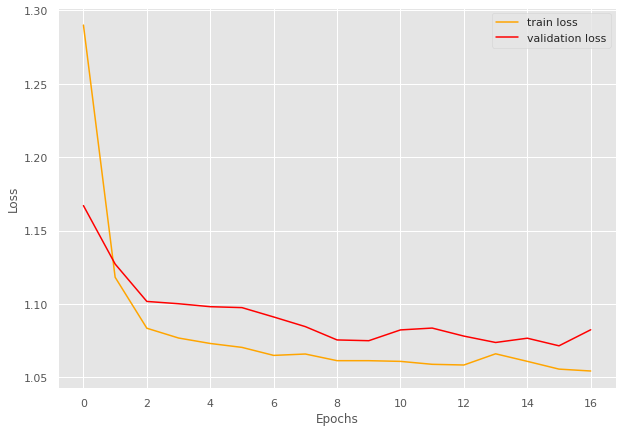

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 25/25 [00:08<00:00,  2.91batch/s, loss=0.394]


train loss 0.39363125324249265, validation loss 0.3314432402451833, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:10<00:00,  2.29batch/s, loss=0.33] 


INFO: Early stopping counter 1 of 5
train loss 0.33048789858818056, validation loss 0.3436920444170634, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:16<00:00,  1.49batch/s, loss=0.322]


train loss 0.32151150226593017, validation loss 0.31922972202301025, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:14<00:00,  1.71batch/s, loss=0.32] 


train loss 0.3198450434207916, validation loss 0.3182773192723592, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:16<00:00,  1.52batch/s, loss=0.319]


INFO: Early stopping counter 2 of 5
train loss 0.31931334614753726, validation loss 0.3314429223537445, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:19<00:00,  1.29batch/s, loss=0.317]


INFO: Early stopping counter 3 of 5
train loss 0.31742432475090027, validation loss 0.3277818063894908, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:19<00:00,  1.28batch/s, loss=0.321]


INFO: Early stopping counter 4 of 5
train loss 0.3207670545578003, validation loss 0.32213571667671204, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 25/25 [00:18<00:00,  1.35batch/s, loss=0.318]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.985406532314107 and loss 0.32720844382825104


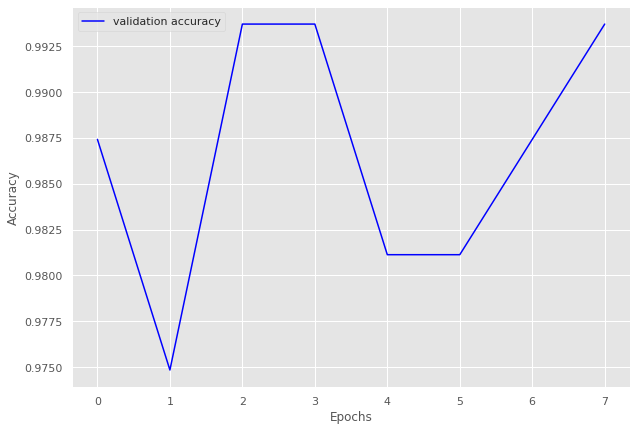

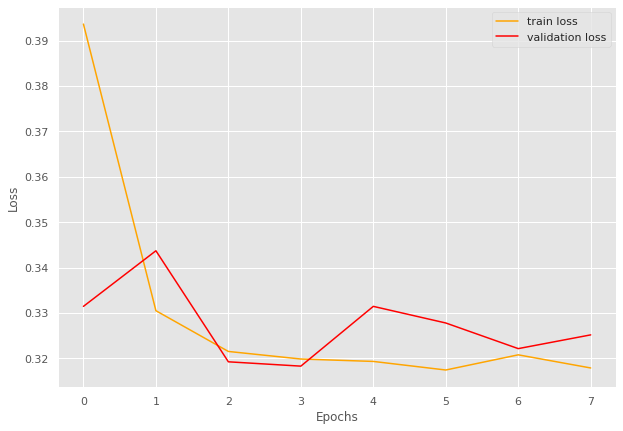

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 73/73 [00:25<00:00,  2.82batch/s, loss=1.21]


train loss 1.2078665903169814, validation loss 1.2232061177492142, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.93batch/s, loss=1.2]


train loss 1.2006363362482149, validation loss 1.2191614359617233, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.94batch/s, loss=1.2] 


train loss 1.1992602446307874, validation loss 1.2185642272233963, validation accuracy 0.9418103448275862
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 73/73 [00:25<00:00,  2.82batch/s, loss=1.2] 


train loss 1.1984204364149538, validation loss 1.2128445208072662, validation accuracy 0.9504310344827587
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.93batch/s, loss=1.19]


train loss 1.1872016093502307, validation loss 1.209573194384575, validation accuracy 0.9504310344827587
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.95batch/s, loss=1.18]


INFO: Early stopping counter 2 of 5
train loss 1.1845717446444786, validation loss 1.211660847067833, validation accuracy 0.9482758620689655
Coarse label 6 Epoch 11
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.95batch/s, loss=1.19]


train loss 1.1925779548409867, validation loss 1.2045762240886688, validation accuracy 0.959051724137931
Coarse label 6 Epoch 12
-------------------------------


100%|██████████| 73/73 [00:27<00:00,  2.70batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1859807020997348, validation loss 1.2110860496759415, validation accuracy 0.9504310344827587
Coarse label 6 Epoch 13
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.93batch/s, loss=1.18]


INFO: Early stopping counter 4 of 5
train loss 1.184626185730712, validation loss 1.215714454650879, validation accuracy 0.9461206896551724
Coarse label 6 Epoch 14
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.94batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9545778834720571 and loss 1.210588570797082


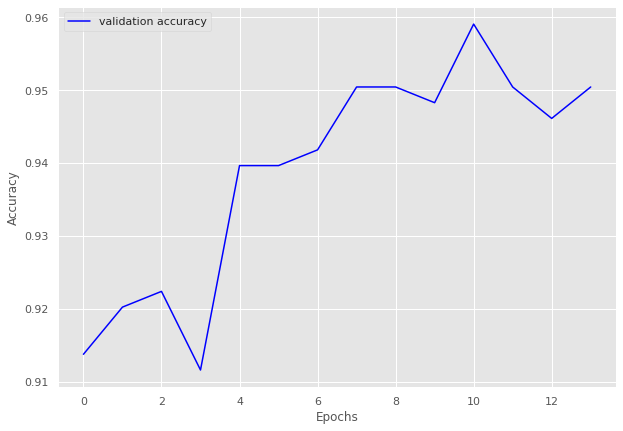

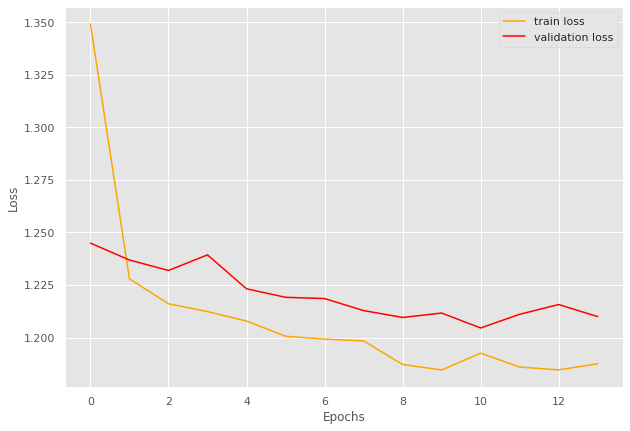

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 58/58 [00:19<00:00,  2.95batch/s, loss=0.859]


train loss 0.8587636618778623, validation loss 0.8105550408363342, validation accuracy 0.9256198347107438
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.96batch/s, loss=0.777]


INFO: Early stopping counter 1 of 5
train loss 0.7767332555918858, validation loss 0.8215546905994415, validation accuracy 0.9201101928374655
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.93batch/s, loss=0.768]


train loss 0.7679649252316048, validation loss 0.7802755733331045, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.96batch/s, loss=0.764]


INFO: Early stopping counter 2 of 5
train loss 0.763694181524474, validation loss 0.7805728713671366, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.94batch/s, loss=0.754]


train loss 0.7542728535060225, validation loss 0.7762459417184194, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.96batch/s, loss=0.756]


INFO: Early stopping counter 3 of 5
train loss 0.7561753104472982, validation loss 0.7826701700687408, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.98batch/s, loss=0.754]


train loss 0.75438035459354, validation loss 0.7737810214360555, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.99batch/s, loss=0.752]


INFO: Early stopping counter 4 of 5
train loss 0.7521394265109095, validation loss 0.7880810797214508, validation accuracy 0.9559228650137741
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.96batch/s, loss=0.756]


train loss 0.7555559966070898, validation loss 0.7732654710610708, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 10
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.94batch/s, loss=0.759]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.979951397326853 and loss 0.7637750368851882


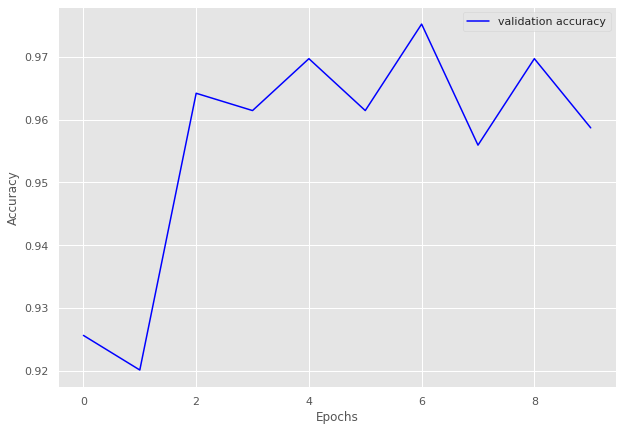

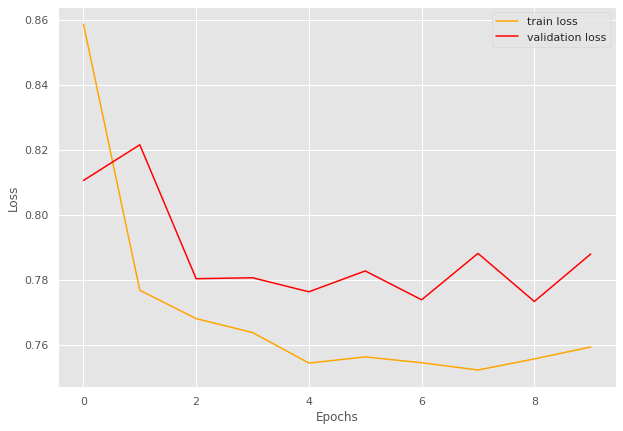

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 81/81 [00:27<00:00,  2.94batch/s, loss=1.39]


train loss 1.3869949373198145, validation loss 1.2552856355905533, validation accuracy 0.913894324853229
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.92batch/s, loss=1.24]


train loss 1.2354452433409515, validation loss 1.2277144193649292, validation accuracy 0.9393346379647749
Coarse label 8 Epoch 3
-------------------------------


  0%|          | 0/81 [00:00<?, ?batch/s]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.4943230596243167, validation loss 1.5175182169133967, validation accuracy 0.9614197530864198
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.49]


train loss 1.4858649022438948, validation loss 1.5072322542017156, validation accuracy 0.9645061728395061
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 102/102 [00:34<00:00,  2.92batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.48376453740924, validation loss 1.5073971098119563, validation accuracy 0.9598765432098766
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.90batch/s, loss=1.48]


train loss 1.4789020512618272, validation loss 1.4996867179870605, validation accuracy 0.9737654320987654
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9651639344262295 and loss 1.4964605699414792


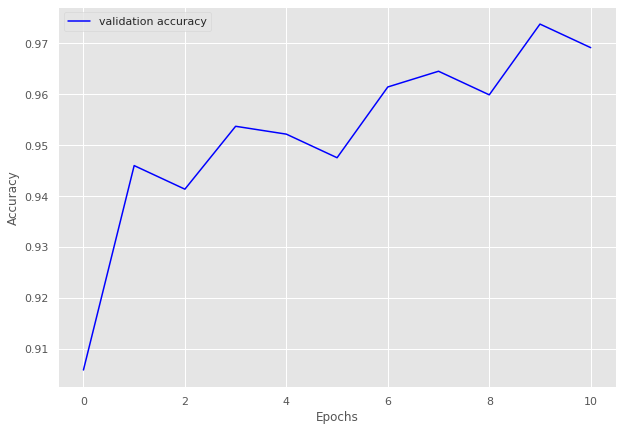

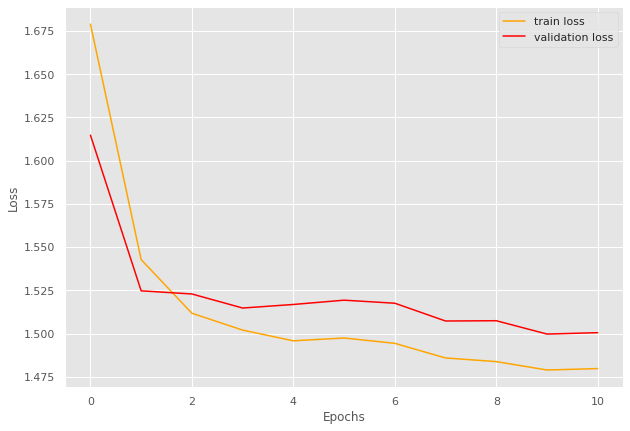

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 48/48 [00:16<00:00,  2.91batch/s, loss=0.866]


train loss 0.8657206309338411, validation loss 0.7722283840179444, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.87batch/s, loss=0.773]


INFO: Early stopping counter 1 of 5
train loss 0.7729054739077886, validation loss 0.7727690696716308, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.89batch/s, loss=0.761]


INFO: Early stopping counter 2 of 5
train loss 0.7611723107596239, validation loss 0.7723133563995361, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.91batch/s, loss=0.758]


train loss 0.7579813885192076, validation loss 0.7574964880943298, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.91batch/s, loss=0.754]


INFO: Early stopping counter 3 of 5
train loss 0.7544539210697015, validation loss 0.7654828548431396, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 48/48 [00:18<00:00,  2.61batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.7513894302149614, validation loss 0.7588179349899292, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.92batch/s, loss=0.749]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9815217391304348 and loss 0.7630185376514088


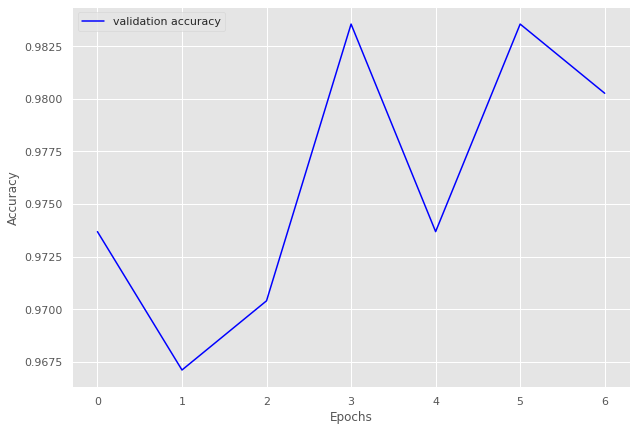

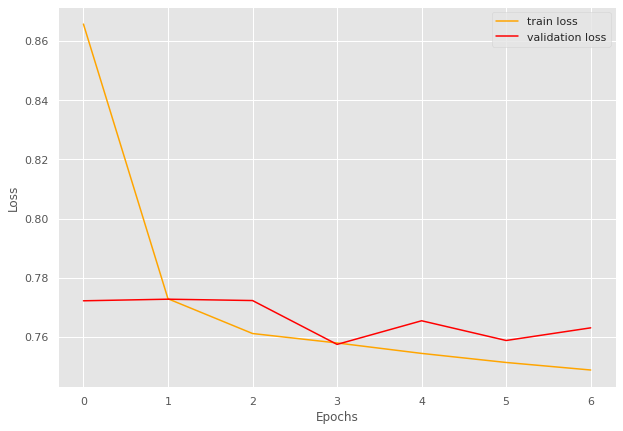

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 46/46 [00:16<00:00,  2.71batch/s, loss=1.31]


train loss 1.311514051064201, validation loss 1.128432536125183, validation accuracy 0.9137931034482759
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.94batch/s, loss=1.12]


train loss 1.1205956210260806, validation loss 1.1206194162368774, validation accuracy 0.9172413793103448
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.94batch/s, loss=1.1]


INFO: Early stopping counter 1 of 5
train loss 1.1007045922072038, validation loss 1.1289303779602051, validation accuracy 0.9137931034482759
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.98batch/s, loss=1.09]


INFO: Early stopping counter 2 of 5
train loss 1.089189835216688, validation loss 1.1269569635391234, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.95batch/s, loss=1.09]


train loss 1.0858973031458647, validation loss 1.1146925210952758, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.93batch/s, loss=1.08]


INFO: Early stopping counter 3 of 5
train loss 1.084938215172809, validation loss 1.1188538312911986, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.98batch/s, loss=1.08]


INFO: Early stopping counter 4 of 5
train loss 1.080570531928021, validation loss 1.1148464679718018, validation accuracy 0.9344827586206896
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.97batch/s, loss=1.08]


train loss 1.0776609260102976, validation loss 1.1109546661376952, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.92batch/s, loss=1.08]


train loss 1.0765731749327287, validation loss 1.1036706209182738, validation accuracy 0.9344827586206896
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.94batch/s, loss=1.08]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9242424242424242 and loss 1.1174675595192682


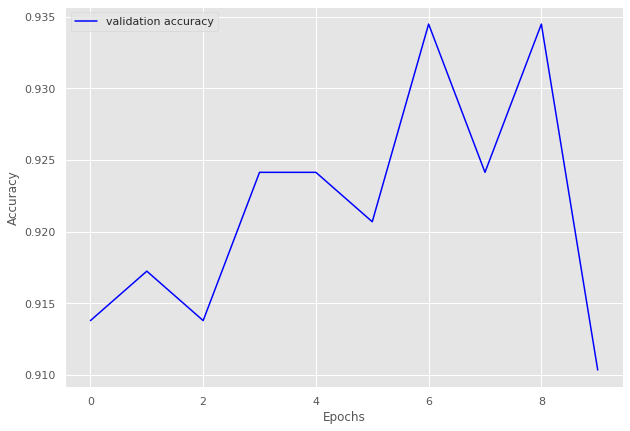

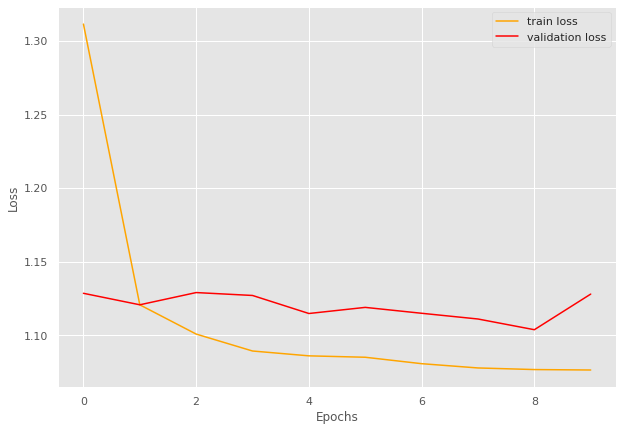

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 41/41 [00:14<00:00,  2.93batch/s, loss=0.688]


train loss 0.6875914553316628, validation loss 0.6259294390678406, validation accuracy 0.9459459459459459
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=0.598]


train loss 0.5984420282084767, validation loss 0.6029293417930603, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.93batch/s, loss=0.582]


train loss 0.5818191185230162, validation loss 0.595608925819397, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.574]


train loss 0.5743167269520644, validation loss 0.584569799900055, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.96batch/s, loss=0.574]


INFO: Early stopping counter 1 of 5
train loss 0.5738105425020543, validation loss 0.5915431022644043, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.573]


INFO: Early stopping counter 2 of 5
train loss 0.5725793576822048, validation loss 0.5872876167297363, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.571]


INFO: Early stopping counter 3 of 5
train loss 0.5712447907866501, validation loss 0.5978534817695618, validation accuracy 0.9420849420849421
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.97batch/s, loss=0.568]


INFO: Early stopping counter 4 of 5
train loss 0.5683575941295158, validation loss 0.5913973927497864, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.569]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9653994019649722 and loss 0.585873623152037


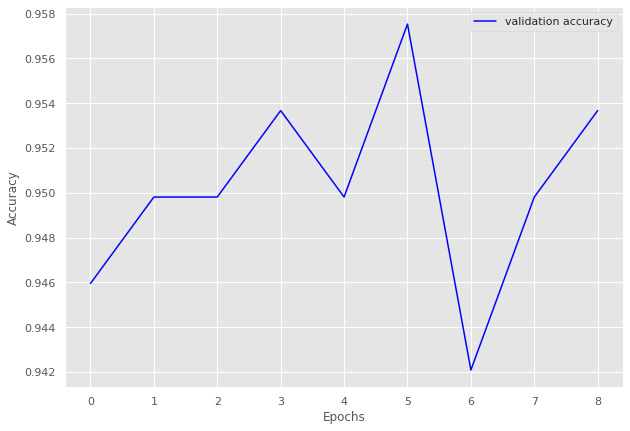

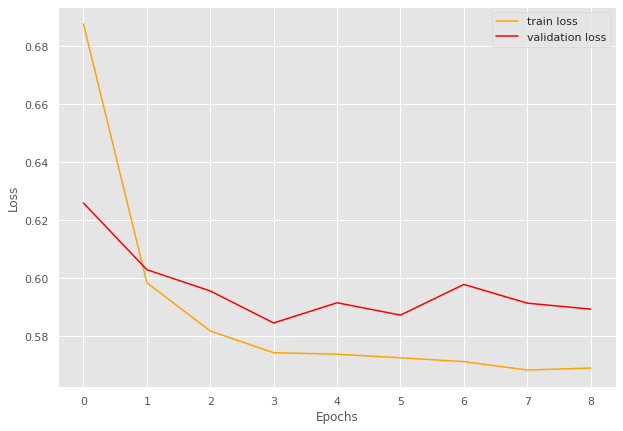

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 94/94 [00:32<00:00,  2.92batch/s, loss=1.17]


train loss 1.1695936030529914, validation loss 1.0944290041923523, validation accuracy 0.9511784511784511
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 94/94 [00:35<00:00,  2.64batch/s, loss=1.08]


train loss 1.0835231314314173, validation loss 1.0890658736228942, validation accuracy 0.9562289562289562
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.92batch/s, loss=1.08]


train loss 1.0766712604685034, validation loss 1.086191749572754, validation accuracy 0.9612794612794613
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 94/94 [01:01<00:00,  1.52batch/s, loss=1.07]


train loss 1.0667848599717973, validation loss 1.0718909621238708, validation accuracy 0.9730639730639731
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 94/94 [01:11<00:00,  1.32batch/s, loss=1.06]


train loss 1.0617205500602722, validation loss 1.0682006359100342, validation accuracy 0.9747474747474747
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 94/94 [01:10<00:00,  1.33batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.066266913363274, validation loss 1.0716712474822998, validation accuracy 0.9696969696969697
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0595941467488066, validation loss 1.0729700088500977, validation accuracy 0.968013468013468
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0588674190196585, validation loss 1.076114571094513, validation accuracy 0.9663299663299664
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.90batch/s, loss=1.06]


train loss 1.0601560676351507, validation loss 1.0661529898643494, validation accuracy 0.9764309764309764
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.94batch/s, loss=1.06]


train loss 1.056616060277249, validation loss 1.0599212050437927, validation accuracy 0.9831649831649831
Coarse label 14 Epoch 11
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.93batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.054688552592663, validation loss 1.068713402748108, validation accuracy 0.9730639730639731
Coarse label 14 Epoch 12
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9663255813953489 and loss 1.0770400578067416


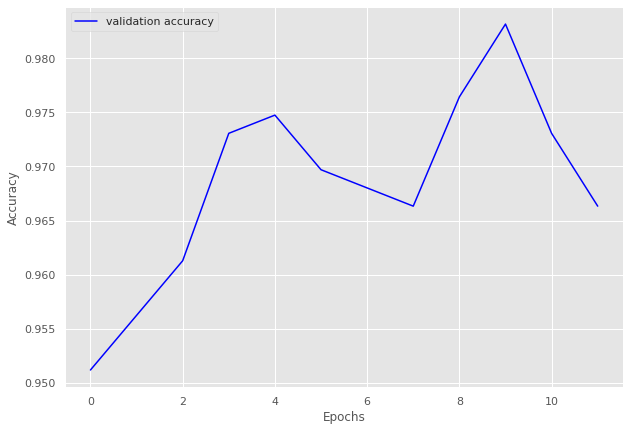

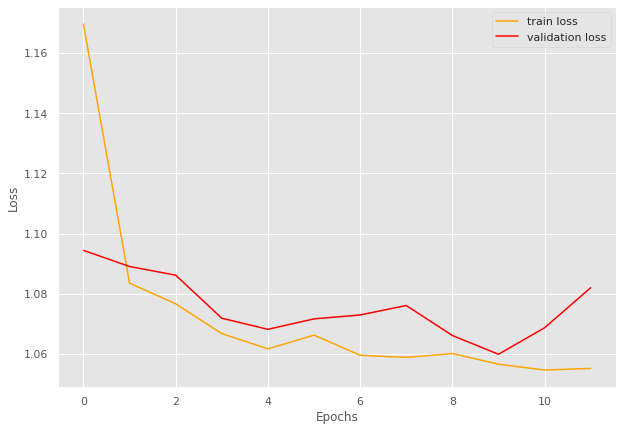

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 47/47 [00:15<00:00,  2.97batch/s, loss=0.899]


train loss 0.898730587452016, validation loss 0.7849402785301208, validation accuracy 0.95578231292517
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.98batch/s, loss=0.779]


train loss 0.7790656318055823, validation loss 0.7693940877914429, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.98batch/s, loss=0.771]


INFO: Early stopping counter 1 of 5
train loss 0.7706416338048083, validation loss 0.7841659426689148, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.95batch/s, loss=0.772]


train loss 0.7715661753999427, validation loss 0.7677491188049317, validation accuracy 0.9795918367346939
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.95batch/s, loss=0.767]


train loss 0.7669175165764829, validation loss 0.7666411161422729, validation accuracy 0.9761904761904762
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.96batch/s, loss=0.768]


INFO: Early stopping counter 2 of 5
train loss 0.768201748107342, validation loss 0.781440281867981, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.98batch/s, loss=0.763]


INFO: Early stopping counter 3 of 5
train loss 0.7634516650057853, validation loss 0.7803642511367798, validation accuracy 0.9591836734693877
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.95batch/s, loss=0.764]


INFO: Early stopping counter 4 of 5
train loss 0.7642116140812001, validation loss 0.7749525666236877, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.97batch/s, loss=0.753]


train loss 0.7533500803277847, validation loss 0.7646776556968689, validation accuracy 0.9795918367346939
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.94batch/s, loss=0.762]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9781461944235117 and loss 0.7643466222853887


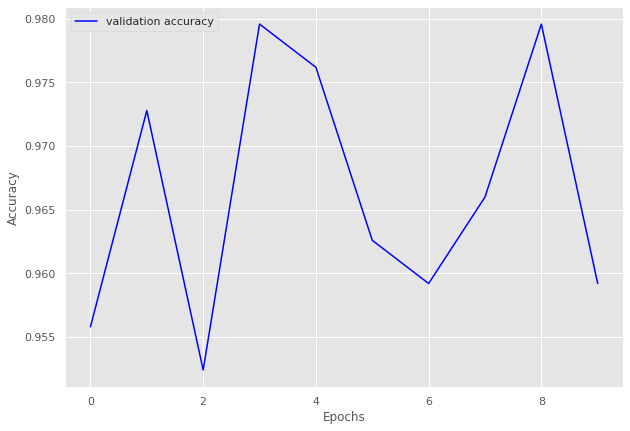

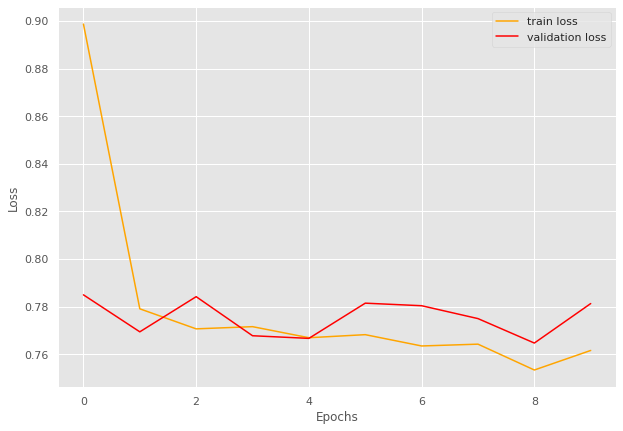

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 45/45 [00:15<00:00,  2.97batch/s, loss=0.666]


train loss 0.6659651796023051, validation loss 0.6037007927894592, validation accuracy 0.9468085106382979
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.96batch/s, loss=0.575]


INFO: Early stopping counter 1 of 5
train loss 0.5746909313731723, validation loss 0.6049907565116882, validation accuracy 0.9539007092198581
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.96batch/s, loss=0.575]


train loss 0.5753554542859395, validation loss 0.5974130272865296, validation accuracy 0.9468085106382979
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.97batch/s, loss=0.569]


train loss 0.5689933061599731, validation loss 0.59354647397995, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.96batch/s, loss=0.56] 


INFO: Early stopping counter 2 of 5
train loss 0.5604701386557684, validation loss 0.6079476952552796, validation accuracy 0.9432624113475178
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 45/45 [00:16<00:00,  2.71batch/s, loss=0.564]


train loss 0.5636527564790513, validation loss 0.582948100566864, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.99batch/s, loss=0.563]


INFO: Early stopping counter 3 of 5
train loss 0.5628747436735365, validation loss 0.5978088736534118, validation accuracy 0.9609929078014184
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.98batch/s, loss=0.566]


INFO: Early stopping counter 4 of 5
train loss 0.5656790865792168, validation loss 0.6019718408584595, validation accuracy 0.950354609929078
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.98batch/s, loss=0.569]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.978021978021978 and loss 0.5720718517899513


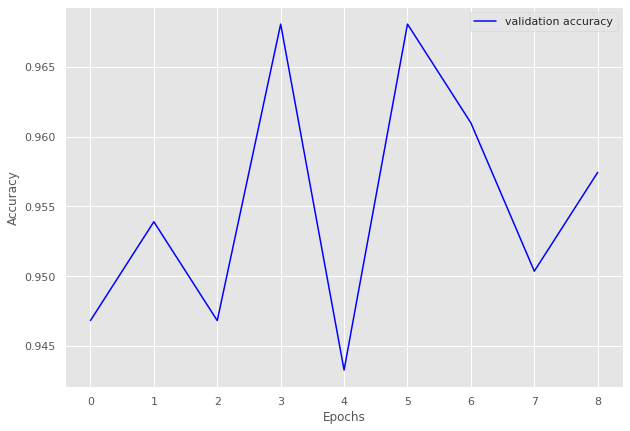

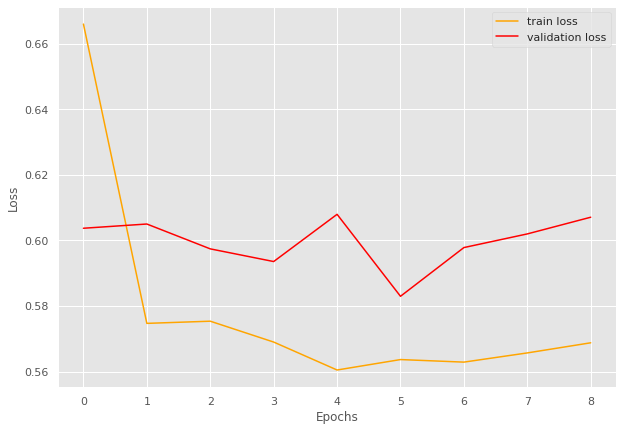

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 49/49 [00:17<00:00,  2.84batch/s, loss=0.921]


train loss 0.9207470684635396, validation loss 0.8053638219833374, validation accuracy 0.948220064724919
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=0.791]


train loss 0.791236547791228, validation loss 0.792256760597229, validation accuracy 0.9546925566343042
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.97batch/s, loss=0.776]


INFO: Early stopping counter 1 of 5
train loss 0.7760239644926421, validation loss 0.7964332461357116, validation accuracy 0.9546925566343042
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.93batch/s, loss=0.772]


INFO: Early stopping counter 2 of 5
train loss 0.7722274429944097, validation loss 0.7978924989700318, validation accuracy 0.948220064724919
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.97batch/s, loss=0.764]


train loss 0.7638788758491983, validation loss 0.7868939161300659, validation accuracy 0.9579288025889967
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=0.764]


train loss 0.7640343101657167, validation loss 0.7867879509925843, validation accuracy 0.9611650485436893
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.91batch/s, loss=0.764]


INFO: Early stopping counter 3 of 5
train loss 0.7642727603717726, validation loss 0.7952241420745849, validation accuracy 0.9514563106796117
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.96batch/s, loss=0.761]


INFO: Early stopping counter 4 of 5
train loss 0.7608482801184362, validation loss 0.7949975967407227, validation accuracy 0.9579288025889967
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.97batch/s, loss=0.757]


train loss 0.7571495272675339, validation loss 0.7843519687652588, validation accuracy 0.9644012944983819
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.98batch/s, loss=0.754]


train loss 0.754108364484748, validation loss 0.7816068530082703, validation accuracy 0.9611650485436893
Coarse label 17 Epoch 11
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.92batch/s, loss=0.753]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9634670487106017 and loss 0.7806953354315325


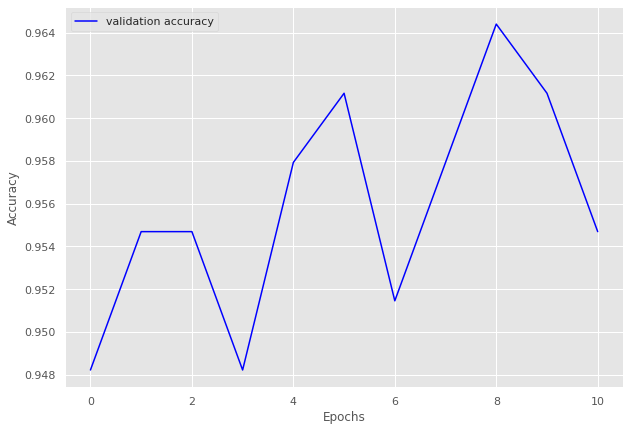

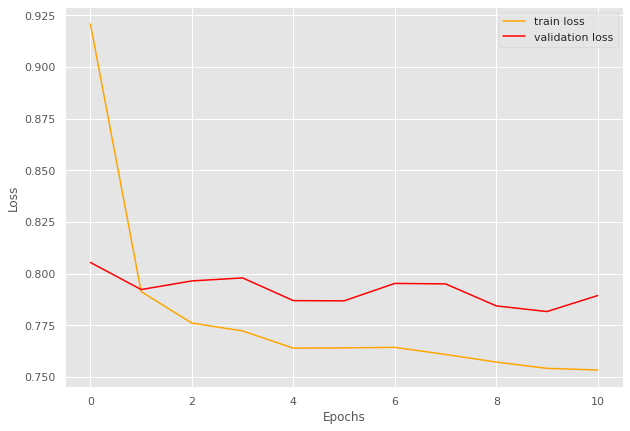

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 16/16 [00:05<00:00,  3.04batch/s, loss=1.08]


train loss 1.0797415561974049, validation loss 0.8928736448287964, validation accuracy 0.84375
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.03batch/s, loss=0.803]


train loss 0.8027474395930767, validation loss 0.827572762966156, validation accuracy 0.9375
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.09batch/s, loss=0.766]


train loss 0.7662366554141045, validation loss 0.7865734100341797, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.04batch/s, loss=0.754]


INFO: Early stopping counter 1 of 5
train loss 0.7544748336076736, validation loss 0.7907316386699677, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.01batch/s, loss=0.751]


train loss 0.7513783499598503, validation loss 0.7855015695095062, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.06batch/s, loss=0.751]


INFO: Early stopping counter 2 of 5
train loss 0.7509591020643711, validation loss 0.7973761260509491, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  2.99batch/s, loss=0.75] 


train loss 0.749825544655323, validation loss 0.7782950699329376, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.07batch/s, loss=0.752]


train loss 0.7517352439463139, validation loss 0.7764931321144104, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.09batch/s, loss=0.749]


train loss 0.7494109123945236, validation loss 0.7698074579238892, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  2.83batch/s, loss=0.752]


INFO: Early stopping counter 3 of 5
train loss 0.7522495053708553, validation loss 0.7940745651721954, validation accuracy 0.9375
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.08batch/s, loss=0.75] 


INFO: Early stopping counter 4 of 5
train loss 0.7496095858514309, validation loss 0.7936244606971741, validation accuracy 0.9375
Coarse label 19 Epoch 12
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  2.99batch/s, loss=0.746]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9502262443438914 and loss 0.7927952706813812


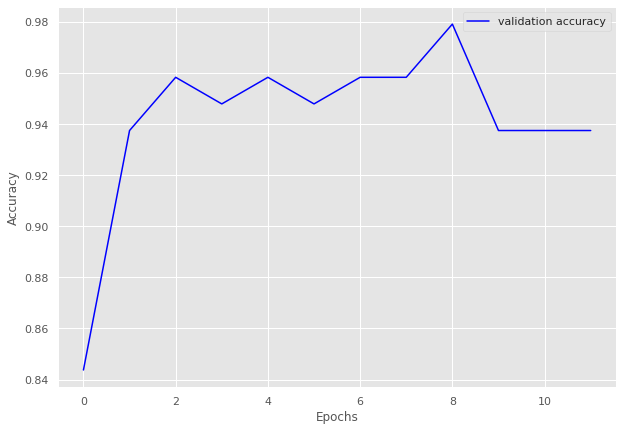

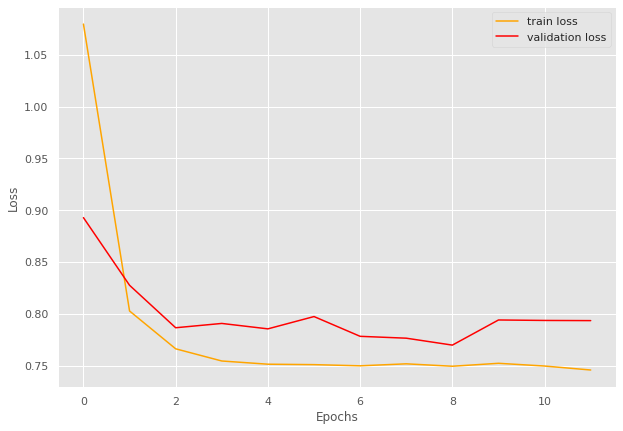

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Calculating for volume 85
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 109/109 [00:36<00:00,  2.95batch/s, loss=1.03]


train loss 1.0325122907621052, validation loss 0.9530171411378043, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.953]


train loss 0.9530054915935622, validation loss 0.9455061214310783, validation accuracy 0.9603729603729604
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.90batch/s, loss=0.949]


train loss 0.9493362493471268, validation loss 0.9444481389863151, validation accuracy 0.9603729603729604
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.945]


INFO: Early stopping counter 1 of 5
train loss 0.9451951882161131, validation loss 0.9491181458745684, validation accuracy 0.9533799533799534
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.938]


train loss 0.9381247840890097, validation loss 0.9380570905549186, validation accuracy 0.965034965034965
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.90batch/s, loss=0.939]


INFO: Early stopping counter 2 of 5
train loss 0.9387871557419453, validation loss 0.9481262053762164, validation accuracy 0.9557109557109557
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.942]


INFO: Early stopping counter 3 of 5
train loss 0.9421961509853328, validation loss 0.9478199992861066, validation accuracy 0.951048951048951
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.94]


train loss 0.9396178995797394, validation loss 0.9376903516905648, validation accuracy 0.9627039627039627
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.933]


INFO: Early stopping counter 4 of 5
train loss 0.9328192942733065, validation loss 0.9378476994378226, validation accuracy 0.9673659673659674
Coarse label 0 Epoch 10
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.929]


train loss 0.9290514375091693, validation loss 0.9317564283098493, validation accuracy 0.9743589743589743
Coarse label 0 Epoch 11
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.92batch/s, loss=0.925]


train loss 0.9254364338489848, validation loss 0.925656225000109, validation accuracy 0.9813519813519813
Coarse label 0 Epoch 12
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.932]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.962278675904542 and loss 0.9411418324425107


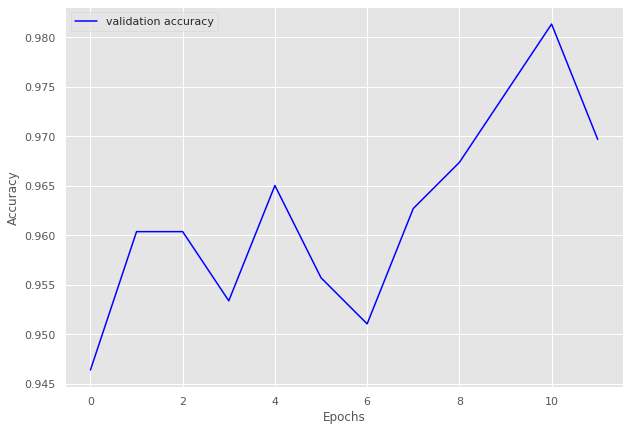

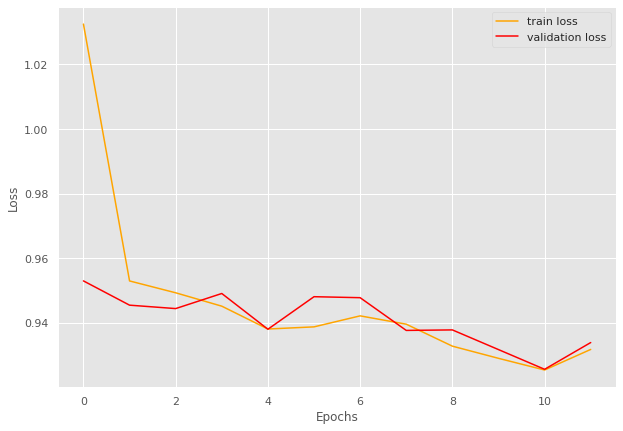

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 47/47 [00:16<00:00,  2.92batch/s, loss=1.23]


train loss 1.2286743001734957, validation loss 1.122713565826416, validation accuracy 0.9193548387096774
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.91batch/s, loss=1.09]


train loss 1.0919188184941069, validation loss 1.094083348910014, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.93batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0719896986129436, validation loss 1.112763245900472, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.91batch/s, loss=1.07]


train loss 1.067416011018956, validation loss 1.0846307277679443, validation accuracy 0.967741935483871
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.93batch/s, loss=1.06]


train loss 1.0596321846576446, validation loss 1.0843228499094646, validation accuracy 0.967741935483871
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.92batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0559977749560743, validation loss 1.1002158323923747, validation accuracy 0.946236559139785
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.93batch/s, loss=1.06]


train loss 1.0574452572680535, validation loss 1.0780304670333862, validation accuracy 0.967741935483871
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.93batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0530644071863053, validation loss 1.0819392601648967, validation accuracy 0.9623655913978495
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.88batch/s, loss=1.05]


train loss 1.0512280565627077, validation loss 1.0730133851369221, validation accuracy 0.9731182795698925
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.86batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.050669068985797, validation loss 1.0777867237726848, validation accuracy 0.967741935483871
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.90batch/s, loss=1.05]


train loss 1.0483024830513812, validation loss 1.071732799212138, validation accuracy 0.9731182795698925
Coarse label 1 Epoch 12
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.87batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9735915492957746 and loss 1.0699450307422214


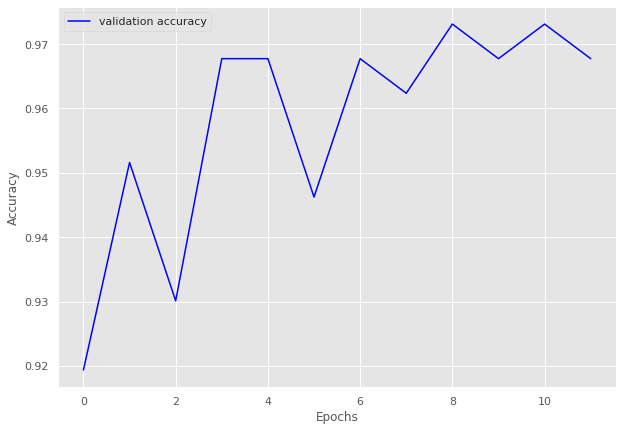

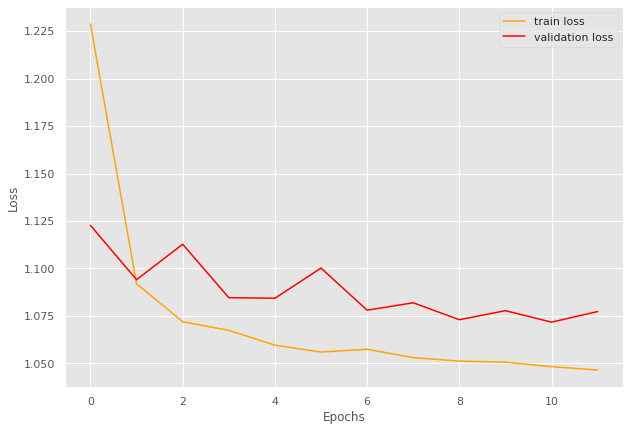

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 220/220 [01:18<00:00,  2.82batch/s, loss=1.63]


train loss 1.6276480983604085, validation loss 1.539120852947235, validation accuracy 0.9298850574712644
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 220/220 [02:37<00:00,  1.39batch/s, loss=1.53]


train loss 1.5269554940136996, validation loss 1.534909929547991, validation accuracy 0.9287356321839081
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 220/220 [01:35<00:00,  2.30batch/s, loss=1.51]


train loss 1.5115824699401856, validation loss 1.5308369568416051, validation accuracy 0.9356321839080459
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.91batch/s, loss=1.51]


train loss 1.509540890563618, validation loss 1.525628992489406, validation accuracy 0.9367816091954023
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.91batch/s, loss=1.5]


train loss 1.5005695115436206, validation loss 1.5154359425817217, validation accuracy 0.9459770114942528
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.93batch/s, loss=1.5] 


INFO: Early stopping counter 1 of 5
train loss 1.5033522020686756, validation loss 1.5229893582207816, validation accuracy 0.9413793103448276
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 220/220 [01:16<00:00,  2.89batch/s, loss=1.5] 


train loss 1.4952564174478704, validation loss 1.5072363359587533, validation accuracy 0.957471264367816
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.92batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4927038566632704, validation loss 1.5155513882637024, validation accuracy 0.9494252873563218
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.92batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.4904680333354257, validation loss 1.5157778092793055, validation accuracy 0.9471264367816092
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.92batch/s, loss=1.49]


INFO: Early stopping counter 4 of 5
train loss 1.4882478789849716, validation loss 1.5155623810631889, validation accuracy 0.9505747126436782
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.93batch/s, loss=1.49]


train loss 1.4892105530608784, validation loss 1.5036485876355852, validation accuracy 0.960919540229885
Coarse label 2 Epoch 12
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9635396885681732 and loss 1.5016860961914062


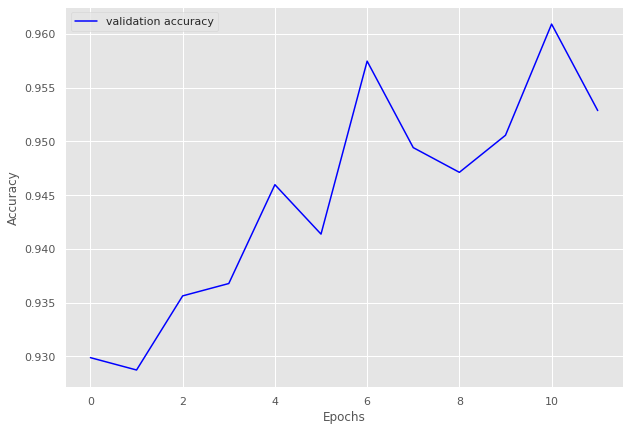

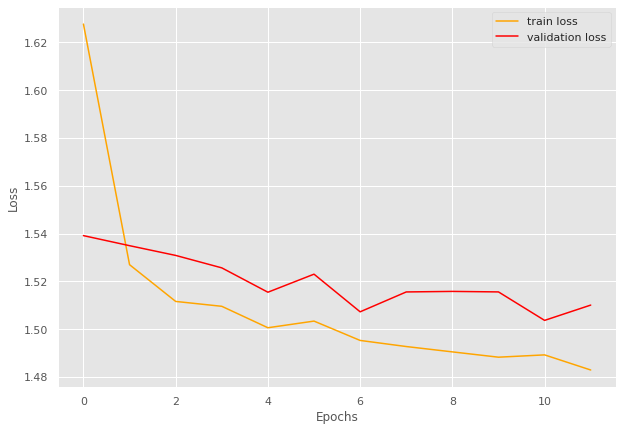

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 104/104 [00:34<00:00,  2.98batch/s, loss=1.21]


train loss 1.2060516728804662, validation loss 1.1287517547607422, validation accuracy 0.9174757281553398
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 104/104 [00:34<00:00,  2.97batch/s, loss=1.11]


train loss 1.105445683002472, validation loss 1.0994900635310583, validation accuracy 0.9368932038834952
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.93batch/s, loss=1.08]


train loss 1.0834285192764723, validation loss 1.0858535936900549, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.95batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.078017934010579, validation loss 1.0867894547326225, validation accuracy 0.9587378640776699
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.97batch/s, loss=1.07]


train loss 1.0723156069333737, validation loss 1.0837951387677873, validation accuracy 0.9587378640776699
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.96batch/s, loss=1.07]


train loss 1.0690675664406557, validation loss 1.0830058370317732, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.97batch/s, loss=1.06]


train loss 1.0647602940981205, validation loss 1.074027725628444, validation accuracy 0.9660194174757282
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0639755106889284, validation loss 1.0839439800807409, validation accuracy 0.9611650485436893
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 104/104 [00:36<00:00,  2.83batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0663347782996984, validation loss 1.0742251532418388, validation accuracy 0.9733009708737864
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.06338971050886, validation loss 1.084018349647522, validation accuracy 0.9684466019417476
Coarse label 4 Epoch 11
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9614147909967846 and loss 1.0813403189182282


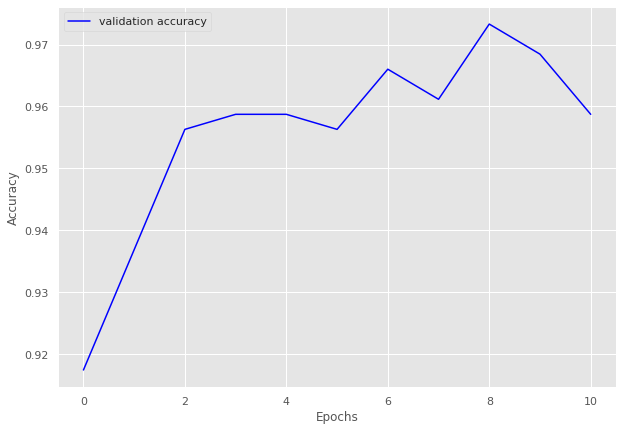

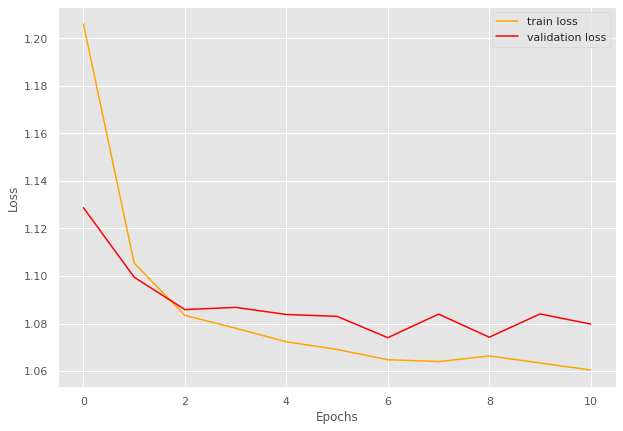

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 40/40 [00:13<00:00,  2.90batch/s, loss=0.377]


train loss 0.37659557312726977, validation loss 0.3419406811396281, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.94batch/s, loss=0.327]


train loss 0.32678513079881666, validation loss 0.3354548116525014, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.90batch/s, loss=0.324]


train loss 0.3240544483065605, validation loss 0.31966887911160785, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.91batch/s, loss=0.319]


INFO: Early stopping counter 1 of 5
train loss 0.31924820095300677, validation loss 0.3238857686519623, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.90batch/s, loss=0.319]


INFO: Early stopping counter 2 of 5
train loss 0.319231192022562, validation loss 0.32628270983695984, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.90batch/s, loss=0.317]


INFO: Early stopping counter 3 of 5
train loss 0.31738428920507433, validation loss 0.3236186405022939, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.91batch/s, loss=0.319]


INFO: Early stopping counter 4 of 5
train loss 0.3190732814371586, validation loss 0.33237749338150024, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.90batch/s, loss=0.317]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9812889812889813 and loss 0.3304525911808014


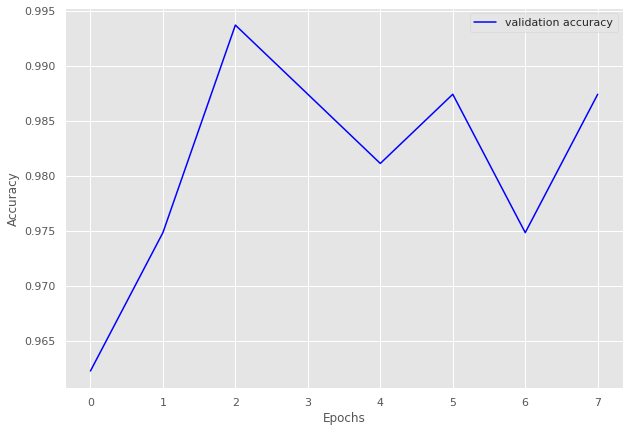

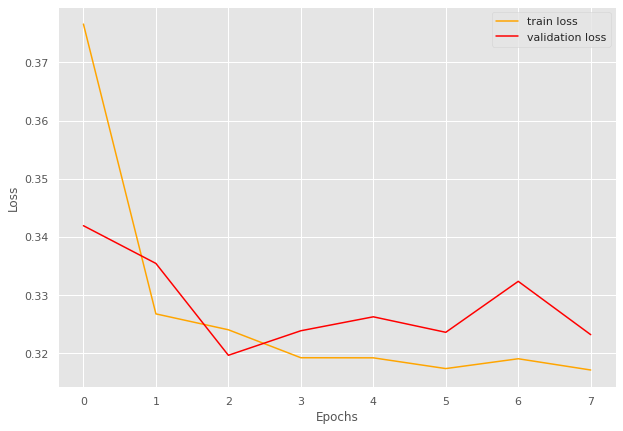

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 117/117 [00:39<00:00,  2.96batch/s, loss=1.31]


train loss 1.3131395873860416, validation loss 1.2247393876314163, validation accuracy 0.9310344827586207
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.96batch/s, loss=1.23]


train loss 1.2294734726604233, validation loss 1.214817613363266, validation accuracy 0.9482758620689655
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.22]


train loss 1.217337153915666, validation loss 1.2138780504465103, validation accuracy 0.9439655172413793
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.93batch/s, loss=1.21]


train loss 1.2125839015357516, validation loss 1.2136310040950775, validation accuracy 0.9482758620689655
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.95batch/s, loss=1.2]


train loss 1.2036474932972183, validation loss 1.2134132087230682, validation accuracy 0.9504310344827587
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.95batch/s, loss=1.2]


INFO: Early stopping counter 1 of 5
train loss 1.1991621103042212, validation loss 1.2137759178876877, validation accuracy 0.9482758620689655
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 117/117 [00:49<00:00,  2.34batch/s, loss=1.2]


train loss 1.1967796596706424, validation loss 1.2059787958860397, validation accuracy 0.9568965517241379
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 117/117 [01:22<00:00,  1.41batch/s, loss=1.19]


train loss 1.1938239437902076, validation loss 1.2025875747203827, validation accuracy 0.959051724137931
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 117/117 [01:30<00:00,  1.30batch/s, loss=1.19]


INFO: Early stopping counter 2 of 5
train loss 1.1939388615453346, validation loss 1.2085436880588531, validation accuracy 0.9568965517241379
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 117/117 [00:47<00:00,  2.47batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1937157740959754, validation loss 1.203882023692131, validation accuracy 0.9568965517241379
Coarse label 6 Epoch 11
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.93batch/s, loss=1.2]


train loss 1.2027076605038765, validation loss 1.1997603476047516, validation accuracy 0.9633620689655172
Coarse label 6 Epoch 12
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.96batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1878597125028953, validation loss 1.2036949545145035, validation accuracy 0.9568965517241379
Coarse label 6 Epoch 13
-------------------------------


100%|██████████| 117/117 [00:40<00:00,  2.91batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9793594306049822 and loss 1.186840225349773


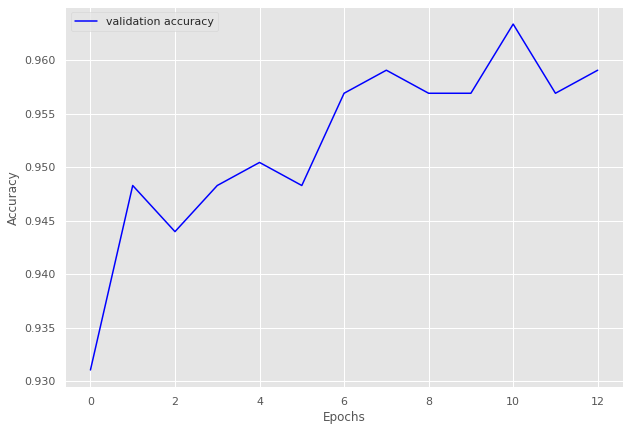

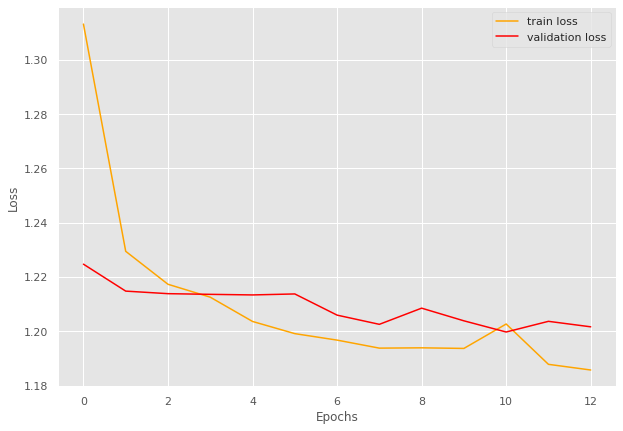

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 92/92 [00:31<00:00,  2.92batch/s, loss=0.827]


train loss 0.8265970271566639, validation loss 0.7680367132027944, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 92/92 [00:32<00:00,  2.87batch/s, loss=0.769]


INFO: Early stopping counter 1 of 5
train loss 0.7692846105150555, validation loss 0.7782394587993622, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.92batch/s, loss=0.763]


train loss 0.7629737795695014, validation loss 0.7521483798821768, validation accuracy 0.9917355371900827
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 92/92 [00:35<00:00,  2.56batch/s, loss=0.764]


INFO: Early stopping counter 2 of 5
train loss 0.7640749805647394, validation loss 0.7522511780261993, validation accuracy 0.9917355371900827
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.93batch/s, loss=0.76] 


INFO: Early stopping counter 3 of 5
train loss 0.7600485650093659, validation loss 0.7542349497477213, validation accuracy 0.9889807162534435
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.89batch/s, loss=0.757]


INFO: Early stopping counter 4 of 5
train loss 0.7565082460641861, validation loss 0.7611969212690989, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 92/92 [00:32<00:00,  2.80batch/s, loss=0.758]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9799635701275046 and loss 0.7639442119333479


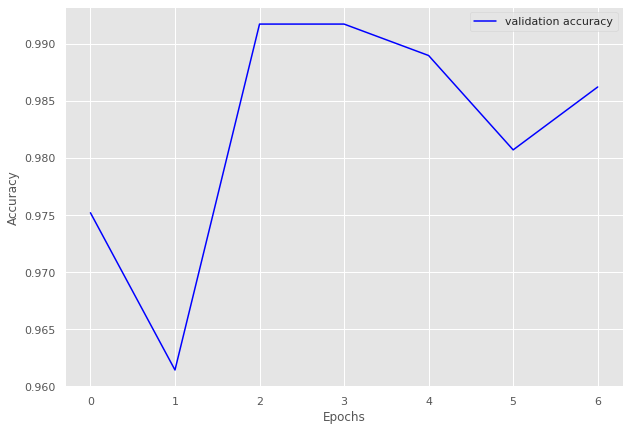

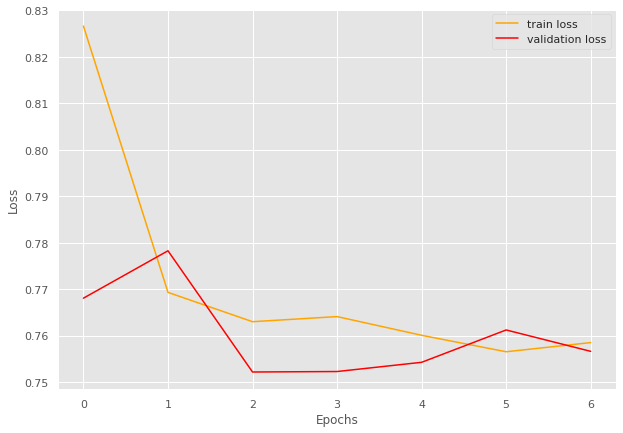

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 129/129 [00:44<00:00,  2.88batch/s, loss=1.33]


train loss 1.3314898097237875, validation loss 1.2298545688390732, validation accuracy 0.9334637964774951
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.90batch/s, loss=1.23]


INFO: Early stopping counter 1 of 5
train loss 1.2255382870518885, validation loss 1.2358301728963852, validation accuracy 0.9275929549902152
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.92batch/s, loss=1.22]


train loss 1.2159942185231882, validation loss 1.2201775163412094, validation accuracy 0.949119373776908
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.91batch/s, loss=1.21]


train loss 1.2083216609880907, validation loss 1.216585248708725, validation accuracy 0.9471624266144814
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.91batch/s, loss=1.2]


train loss 1.2006234540495762, validation loss 1.2130500674247742, validation accuracy 0.9510763209393346
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.91batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.195091301156569, validation loss 1.2190864980220795, validation accuracy 0.9471624266144814
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.91batch/s, loss=1.2]


train loss 1.1953454599824063, validation loss 1.2128974944353104, validation accuracy 0.9569471624266145
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.89batch/s, loss=1.19]


train loss 1.1891291899274485, validation loss 1.2082165628671646, validation accuracy 0.9569471624266145
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.89batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1882886350616928, validation loss 1.212210401892662, validation accuracy 0.9530332681017613
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.91batch/s, loss=1.18]


train loss 1.1849055216293927, validation loss 1.2043229639530182, validation accuracy 0.9608610567514677
Coarse label 8 Epoch 11
-------------------------------


100%|██████████| 129/129 [00:45<00:00,  2.86batch/s, loss=1.18]


train loss 1.1838403302569722, validation loss 1.200399249792099, validation accuracy 0.9667318982387475
Coarse label 8 Epoch 12
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.90batch/s, loss=1.18]


INFO: Early stopping counter 4 of 5
train loss 1.184605642806652, validation loss 1.2015240043401718, validation accuracy 0.9628180039138943
Coarse label 8 Epoch 13
-------------------------------


100%|██████████| 129/129 [00:47<00:00,  2.74batch/s, loss=1.18]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.948801036941024 and loss 1.2189454793930055


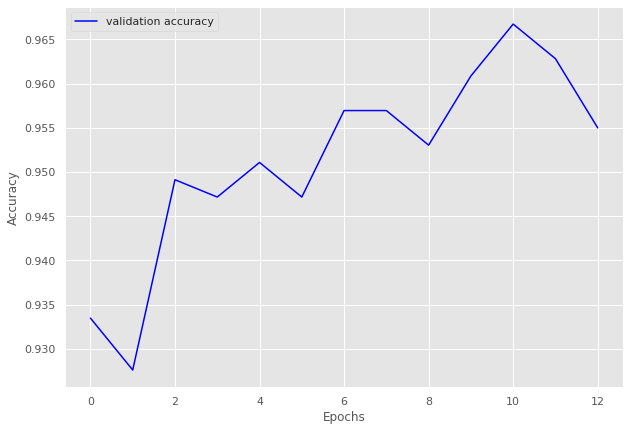

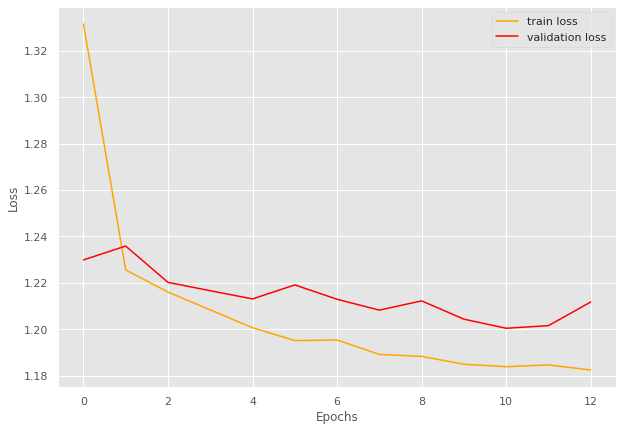

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 163/163 [00:56<00:00,  2.88batch/s, loss=1.62]


train loss 1.6233881141510478, validation loss 1.5449943108992144, validation accuracy 0.9274691358024691
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 163/163 [00:57<00:00,  2.84batch/s, loss=1.52]


train loss 1.5226171916247877, validation loss 1.5189198905771428, validation accuracy 0.9521604938271605
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.87batch/s, loss=1.51]


INFO: Early stopping counter 1 of 5
train loss 1.5093557922386684, validation loss 1.5226876952431418, validation accuracy 0.9444444444444444
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.89batch/s, loss=1.5]


train loss 1.4978213251734072, validation loss 1.5133593515916304, validation accuracy 0.9537037037037037
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.89batch/s, loss=1.49]


train loss 1.4903337831146146, validation loss 1.5070600292899392, validation accuracy 0.9567901234567902
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.89batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4905874429304906, validation loss 1.512617750601335, validation accuracy 0.9552469135802469
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.88batch/s, loss=1.49]


train loss 1.4871600200793496, validation loss 1.5056834654374556, validation accuracy 0.9629629629629629
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 163/163 [00:58<00:00,  2.81batch/s, loss=1.48]


train loss 1.4836879193417134, validation loss 1.505373629656705, validation accuracy 0.9629629629629629
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.87batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4814576758928826, validation loss 1.5073068358681418, validation accuracy 0.9583333333333334
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.89batch/s, loss=1.48]


train loss 1.4799077262176326, validation loss 1.4975384907288984, validation accuracy 0.9722222222222222
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.88batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4763928805392212, validation loss 1.5034716346047141, validation accuracy 0.9691358024691358
Coarse label 9 Epoch 12
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9815950920245399 and loss 1.4811656475067139


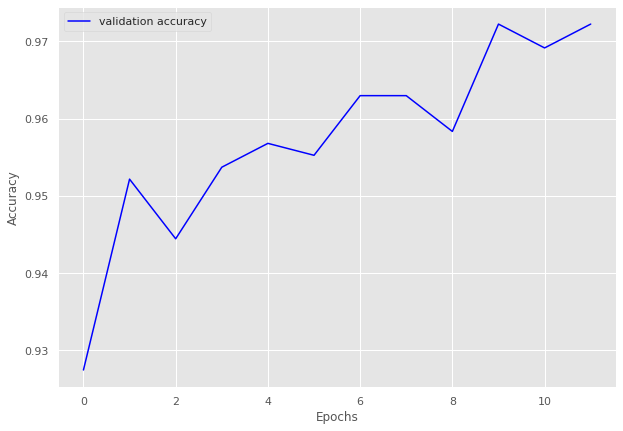

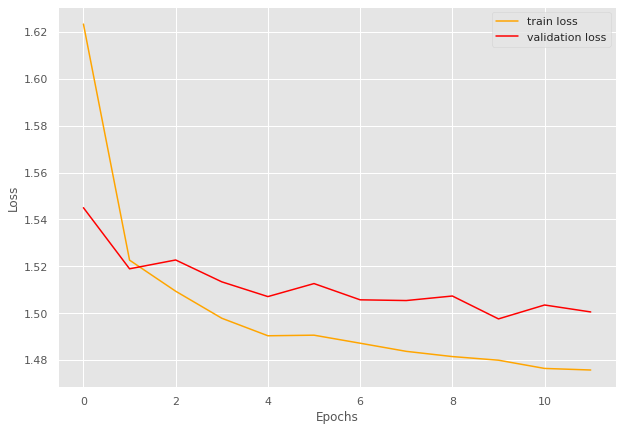

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 77/77 [00:26<00:00,  2.91batch/s, loss=0.83] 


train loss 0.830192163393095, validation loss 0.7598595261573792, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.93batch/s, loss=0.762]


INFO: Early stopping counter 1 of 5
train loss 0.7624185905828105, validation loss 0.7684220671653748, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 77/77 [00:50<00:00,  1.52batch/s, loss=0.762]


INFO: Early stopping counter 2 of 5
train loss 0.7624638428935757, validation loss 0.7605785369873047, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 77/77 [00:58<00:00,  1.32batch/s, loss=0.757]


train loss 0.7572115412006131, validation loss 0.7541571497917176, validation accuracy 0.9901315789473685
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 77/77 [00:57<00:00,  1.35batch/s, loss=0.755]


INFO: Early stopping counter 3 of 5
train loss 0.7553730816036076, validation loss 0.7646277546882629, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 77/77 [00:46<00:00,  1.66batch/s, loss=0.754]


INFO: Early stopping counter 4 of 5
train loss 0.7539717346042781, validation loss 0.756238329410553, validation accuracy 0.9901315789473685
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.91batch/s, loss=0.756]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.991313789359392 and loss 0.7523236354192098


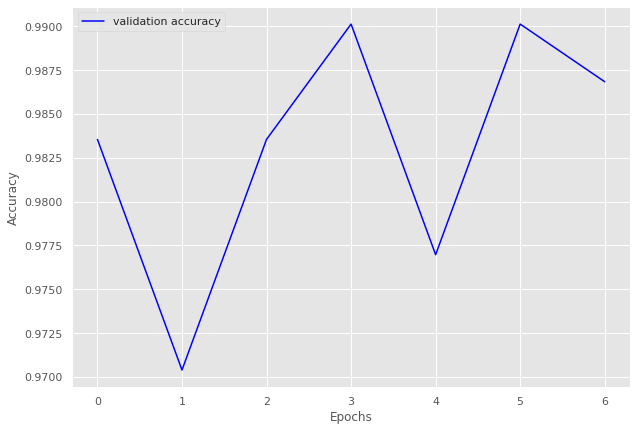

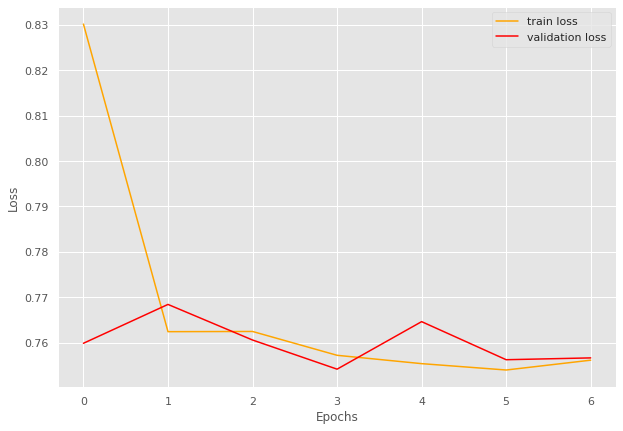

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 74/74 [00:24<00:00,  2.98batch/s, loss=1.24]


train loss 1.2404802151628442, validation loss 1.1321011781692505, validation accuracy 0.903448275862069
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 74/74 [00:24<00:00,  2.96batch/s, loss=1.11]


train loss 1.1138511670602333, validation loss 1.1146506547927857, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.95batch/s, loss=1.1] 


INFO: Early stopping counter 1 of 5
train loss 1.0993961514653385, validation loss 1.1224101305007934, validation accuracy 0.9172413793103448
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.92batch/s, loss=1.09]


train loss 1.089543659944792, validation loss 1.1067832231521606, validation accuracy 0.9344827586206896
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 74/74 [00:24<00:00,  2.97batch/s, loss=1.09]


INFO: Early stopping counter 2 of 5
train loss 1.0858314085651088, validation loss 1.1300093412399292, validation accuracy 0.9103448275862069
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 74/74 [00:24<00:00,  2.97batch/s, loss=1.08]


INFO: Early stopping counter 3 of 5
train loss 1.0843910333272573, validation loss 1.1160481691360473, validation accuracy 0.9275862068965517
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 74/74 [00:24<00:00,  2.98batch/s, loss=1.08]


train loss 1.081421845668071, validation loss 1.1020877838134766, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.95batch/s, loss=1.08]


INFO: Early stopping counter 4 of 5
train loss 1.084248470293509, validation loss 1.1137965440750122, validation accuracy 0.9275862068965517
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.92batch/s, loss=1.08]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9477866061293984 and loss 1.0935282281466894


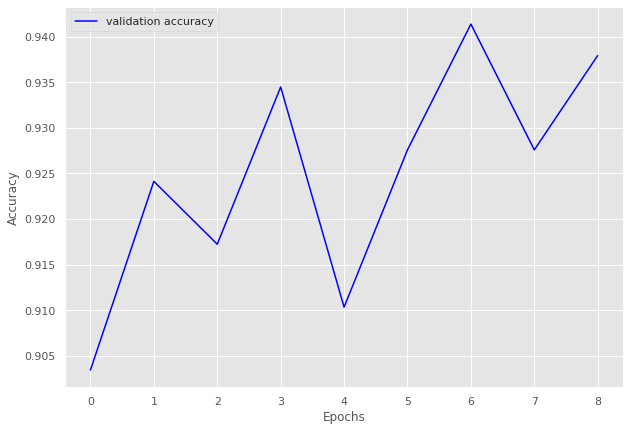

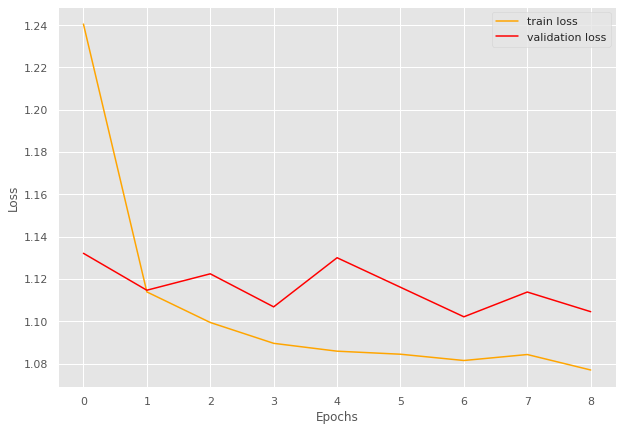

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 65/65 [00:22<00:00,  2.89batch/s, loss=0.653]


train loss 0.652778840981997, validation loss 0.7094735622406005, validation accuracy 0.9111969111969112
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=0.591]


train loss 0.5911804731075581, validation loss 0.6771611213684082, validation accuracy 0.9266409266409267
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.93batch/s, loss=0.59] 


train loss 0.5895551800727844, validation loss 0.661592960357666, validation accuracy 0.9420849420849421
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.94batch/s, loss=0.578]


train loss 0.5780371775993934, validation loss 0.6581169128417969, validation accuracy 0.9459459459459459
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.91batch/s, loss=0.577]


INFO: Early stopping counter 1 of 5
train loss 0.5774418088106009, validation loss 0.660312271118164, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=0.573]


INFO: Early stopping counter 2 of 5
train loss 0.5727153713886555, validation loss 0.6600924372673035, validation accuracy 0.9420849420849421
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=0.573]


train loss 0.5730807020114018, validation loss 0.6544377326965332, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.93batch/s, loss=0.573]


train loss 0.5728206451122577, validation loss 0.6100584268569946, validation accuracy 0.9459459459459459
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.94batch/s, loss=0.572]


train loss 0.5715897532609793, validation loss 0.5902807593345643, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 10
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.93batch/s, loss=0.568]


train loss 0.5676728202746465, validation loss 0.5849563837051391, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 11
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.91batch/s, loss=0.571]


INFO: Early stopping counter 3 of 5
train loss 0.5708631698901837, validation loss 0.6480581402778626, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 12
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=0.564]


INFO: Early stopping counter 4 of 5
train loss 0.564353833748744, validation loss 0.5994876861572266, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 13
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.93batch/s, loss=0.565]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9667093469910372 and loss 0.5816658322627728


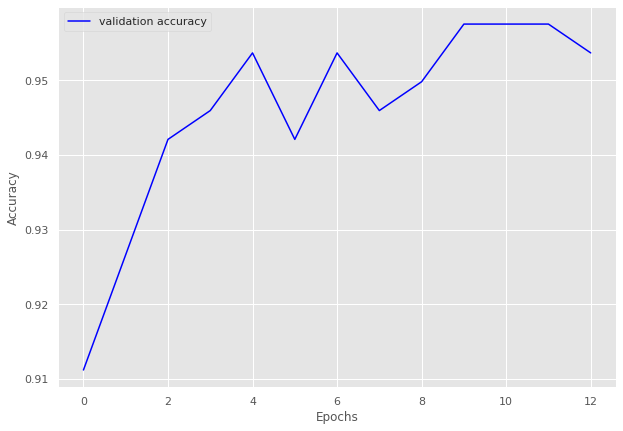

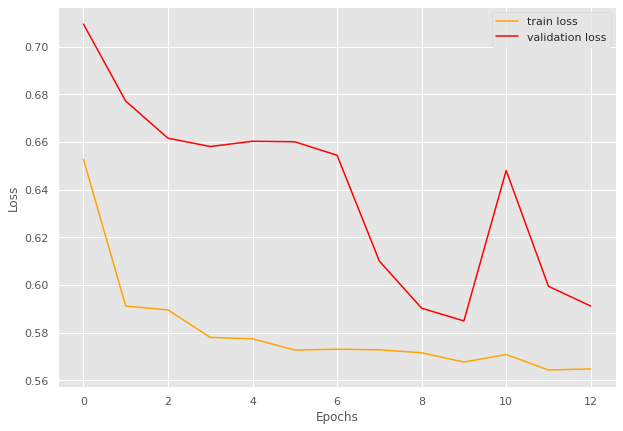

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 150/150 [00:57<00:00,  2.60batch/s, loss=1.15]


train loss 1.1450579905509948, validation loss 1.079958474636078, validation accuracy 0.9629629629629629
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 150/150 [00:52<00:00,  2.87batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.0820225628217062, validation loss 1.08827748298645, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 150/150 [00:50<00:00,  2.94batch/s, loss=1.08]


train loss 1.0763949259122212, validation loss 1.0780140042304993, validation accuracy 0.9713804713804713
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 150/150 [00:56<00:00,  2.67batch/s, loss=1.07]


train loss 1.0673817507425944, validation loss 1.069325041770935, validation accuracy 0.9713804713804713
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 150/150 [00:52<00:00,  2.87batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0685475508371989, validation loss 1.0707499742507935, validation accuracy 0.9730639730639731
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 150/150 [00:50<00:00,  2.95batch/s, loss=1.06]


train loss 1.0625402530034382, validation loss 1.0618469834327697, validation accuracy 0.9814814814814815
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0602523763974507, validation loss 1.0621019721031189, validation accuracy 0.9814814814814815
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0573088097572327, validation loss 1.0648185729980468, validation accuracy 0.9764309764309764
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9726715002788623 and loss 1.069672202241832


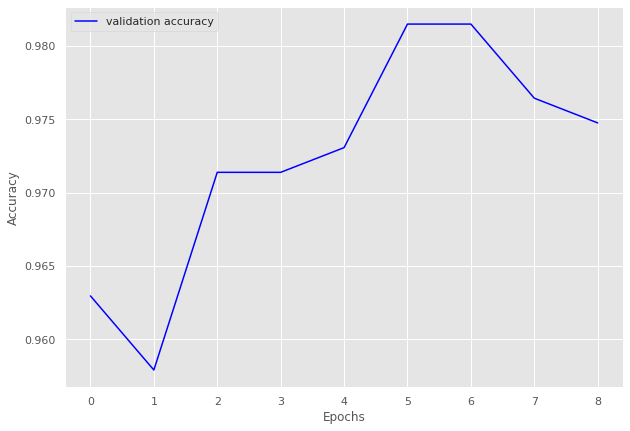

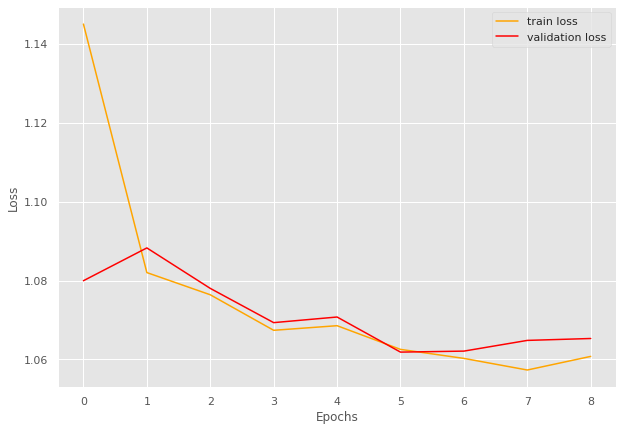

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 74/74 [00:30<00:00,  2.43batch/s, loss=0.86] 


train loss 0.8603506160748972, validation loss 0.7710314631462097, validation accuracy 0.9761904761904762
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.90batch/s, loss=0.77] 


train loss 0.7697838593173671, validation loss 0.7697234869003295, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 74/74 [00:26<00:00,  2.76batch/s, loss=0.768]


train loss 0.7675273136512654, validation loss 0.7591497898101807, validation accuracy 0.9829931972789115
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.94batch/s, loss=0.759]


INFO: Early stopping counter 1 of 5
train loss 0.7589248467136074, validation loss 0.768319058418274, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=0.758]


INFO: Early stopping counter 2 of 5
train loss 0.7576071120597221, validation loss 0.7677923679351807, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=0.754]


train loss 0.7538593016766213, validation loss 0.7581064224243164, validation accuracy 0.9863945578231292
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.96batch/s, loss=0.754]


INFO: Early stopping counter 3 of 5
train loss 0.7542449686978314, validation loss 0.7606751203536988, validation accuracy 0.9829931972789115
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 74/74 [00:35<00:00,  2.06batch/s, loss=0.753]


train loss 0.7527815441827517, validation loss 0.75670884847641, validation accuracy 0.9863945578231292
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 74/74 [00:48<00:00,  1.54batch/s, loss=0.749]


train loss 0.7489475197083241, validation loss 0.7498474359512329, validation accuracy 0.9931972789115646
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 74/74 [00:56<00:00,  1.31batch/s, loss=0.748]


INFO: Early stopping counter 4 of 5
train loss 0.7482174377183657, validation loss 0.7513776659965515, validation accuracy 0.9897959183673469
Coarse label 15 Epoch 11
-------------------------------


100%|██████████| 74/74 [00:55<00:00,  1.34batch/s, loss=0.753]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9841986455981941 and loss 0.7611052181039538


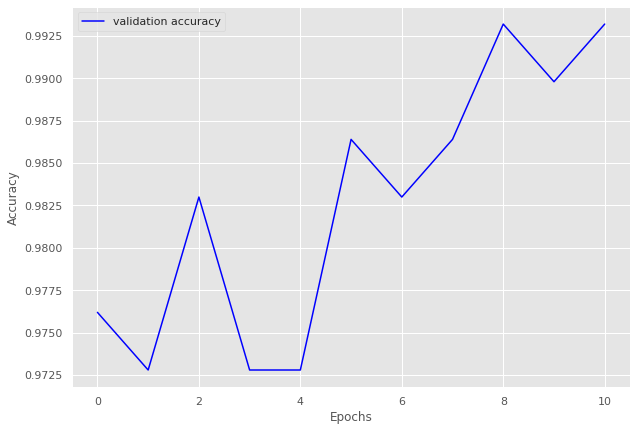

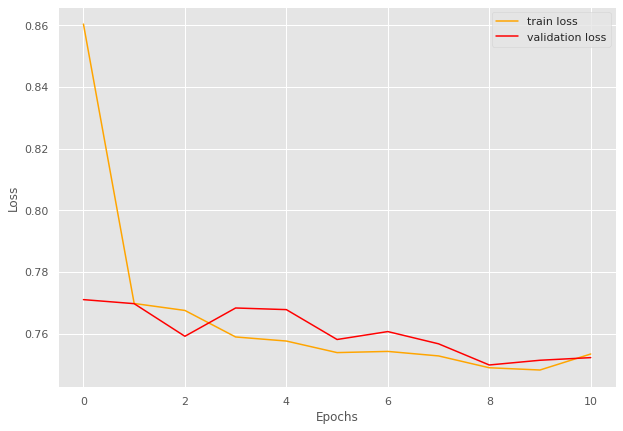

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 71/71 [00:32<00:00,  2.17batch/s, loss=0.648]


train loss 0.6477837042069771, validation loss 0.5867183446884155, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.94batch/s, loss=0.583]


INFO: Early stopping counter 1 of 5
train loss 0.5827945260934426, validation loss 0.5930521726608277, validation accuracy 0.9609929078014184
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.94batch/s, loss=0.573]


train loss 0.5733022118957949, validation loss 0.5753921508789063, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.88batch/s, loss=0.569]


INFO: Early stopping counter 2 of 5
train loss 0.5688036461951027, validation loss 0.5771899342536926, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.95batch/s, loss=0.566]


train loss 0.5655331762743668, validation loss 0.5654677987098694, validation accuracy 0.9858156028368794
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.92batch/s, loss=0.562]


train loss 0.5621807491275627, validation loss 0.5639740109443665, validation accuracy 0.9822695035460993
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.93batch/s, loss=0.566]


INFO: Early stopping counter 3 of 5
train loss 0.5662594941300405, validation loss 0.5750857830047608, validation accuracy 0.975177304964539
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 71/71 [00:25<00:00,  2.77batch/s, loss=0.564]


INFO: Early stopping counter 4 of 5
train loss 0.5644239690941824, validation loss 0.5701166868209839, validation accuracy 0.975177304964539
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.93batch/s, loss=0.559]


train loss 0.5586406999910382, validation loss 0.5586884140968322, validation accuracy 0.9929078014184397
Coarse label 16 Epoch 10
-------------------------------


100%|██████████| 71/71 [00:23<00:00,  2.96batch/s, loss=0.558]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9870588235294118 and loss 0.5654613333089011


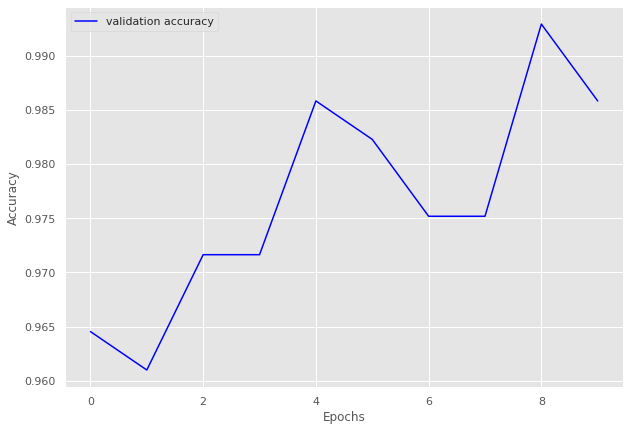

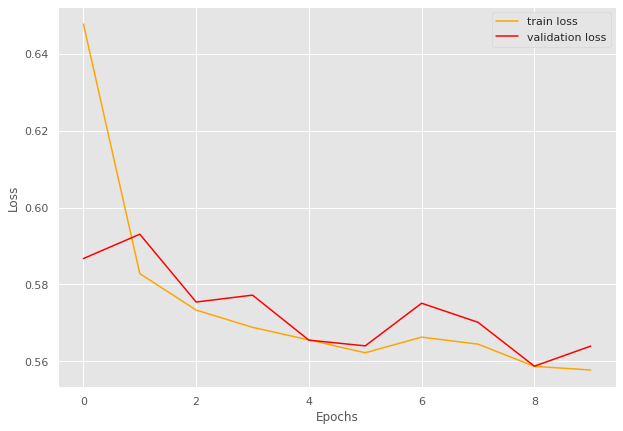

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 78/78 [00:26<00:00,  2.94batch/s, loss=0.884]


train loss 0.8839662036834619, validation loss 0.804449200630188, validation accuracy 0.9385113268608414
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.94batch/s, loss=0.791]


train loss 0.7914216556610205, validation loss 0.7928393602371215, validation accuracy 0.9514563106796117
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.96batch/s, loss=0.777]


train loss 0.7773557175428439, validation loss 0.7863136768341065, validation accuracy 0.9579288025889967
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.94batch/s, loss=0.771]


train loss 0.770832515679873, validation loss 0.783032238483429, validation accuracy 0.9611650485436893
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.95batch/s, loss=0.769]


INFO: Early stopping counter 1 of 5
train loss 0.7692808501231365, validation loss 0.7947800040245057, validation accuracy 0.948220064724919
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.94batch/s, loss=0.765]


train loss 0.7653102989380176, validation loss 0.7742053389549255, validation accuracy 0.9676375404530745
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.95batch/s, loss=0.763]


INFO: Early stopping counter 2 of 5
train loss 0.7632458125933622, validation loss 0.7922117710113525, validation accuracy 0.9514563106796117
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.95batch/s, loss=0.768]


INFO: Early stopping counter 3 of 5
train loss 0.7681394823086567, validation loss 0.7910271048545837, validation accuracy 0.9514563106796117
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.94batch/s, loss=0.76] 


INFO: Early stopping counter 4 of 5
train loss 0.7595039292787894, validation loss 0.7887870907783509, validation accuracy 0.9546925566343042
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.93batch/s, loss=0.757]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.973175965665236 and loss 0.7688025395075481


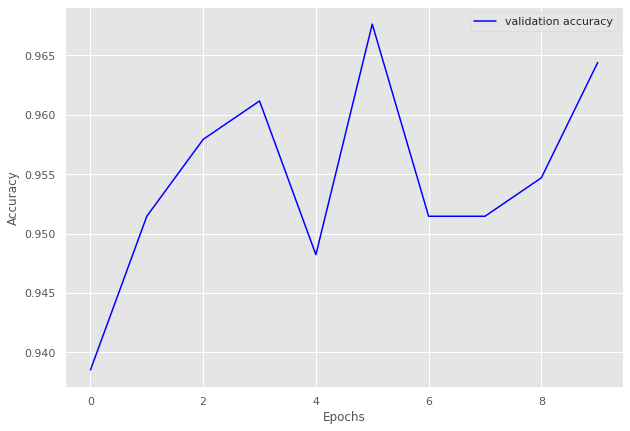

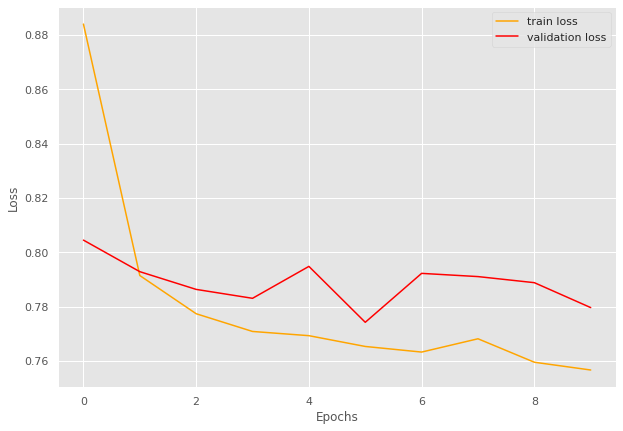

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 25/25 [00:08<00:00,  2.95batch/s, loss=0.98] 


train loss 0.9802730011940003, validation loss 0.7967710494995117, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.98batch/s, loss=0.785]


train loss 0.785263078212738, validation loss 0.7618180513381958, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.97batch/s, loss=0.767]


INFO: Early stopping counter 1 of 5
train loss 0.7669562983512879, validation loss 0.7628763914108276, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.95batch/s, loss=0.764]


INFO: Early stopping counter 2 of 5
train loss 0.763954622745514, validation loss 0.7747729122638702, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.95batch/s, loss=0.759]


INFO: Early stopping counter 3 of 5
train loss 0.7593870711326599, validation loss 0.7742946743965149, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.01batch/s, loss=0.753]


INFO: Early stopping counter 4 of 5
train loss 0.7525489354133605, validation loss 0.7733824253082275, validation accuracy 0.96875
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.95batch/s, loss=0.75] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9763513513513513 and loss 0.767438268661499


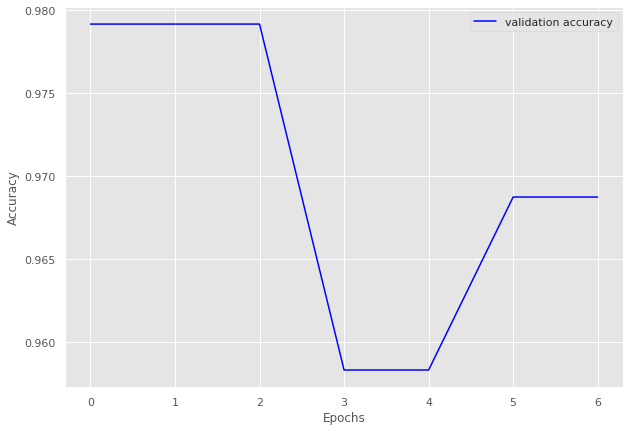

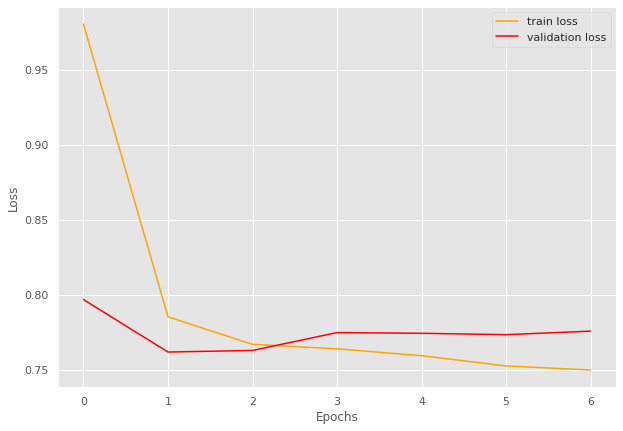

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Starting run 2
defaultdict(<class 'list'>, {10: [0], 15: [1, 38, 54, 62], 12: [2, 7, 12, 45, 49, 91], 17: [3, 25, 66, 83], 5: [4, 77], 8: [5, 60, 70, 73, 75, 78, 82], 1: [6, 53, 56, 58, 79, 80], 11: [8, 31, 51, 61], 0: [9, 17, 26, 55, 69], 7: [10, 23, 39, 67], 9: [11, 18, 34, 46, 57, 63, 68, 76, 92, 93], 2: [13, 19, 20, 36, 41, 42, 47, 48, 71, 88], 6: [14, 15, 22, 32, 35, 43, 52], 4: [16, 21, 24, 30, 64, 72], 13: [27, 29, 81], 14: [28, 33, 37, 44, 89, 90], 16: [40, 59, 87], 18: [50], 19: [65, 74, 84, 85], 3: [86]})
Calculating for volume 15
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 14/14 [00:07<00:00,  1.93batch/s, loss=1.36]


train loss 1.3600694452013289, validation loss 1.1460100752966744, validation accuracy 0.7668997668997669
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 14/14 [00:11<00:00,  1.19batch/s, loss=1.01]


train loss 1.0130166283675603, validation loss 1.0165488464491708, validation accuracy 0.8881118881118881
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 14/14 [00:10<00:00,  1.30batch/s, loss=0.949]


train loss 0.9490139867578234, validation loss 1.0001105751310075, validation accuracy 0.8997668997668997
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 14/14 [00:11<00:00,  1.23batch/s, loss=0.931]


train loss 0.930834195443562, validation loss 0.9882088388715472, validation accuracy 0.916083916083916
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 14/14 [00:11<00:00,  1.23batch/s, loss=0.922]


train loss 0.9218055350439889, validation loss 0.9878663676125663, validation accuracy 0.916083916083916
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.97batch/s, loss=0.916]


train loss 0.9162513954298837, validation loss 0.9877305797168187, validation accuracy 0.916083916083916
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.97batch/s, loss=0.915]


train loss 0.9150603115558624, validation loss 0.9831422993115017, validation accuracy 0.9254079254079254
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.03batch/s, loss=0.911]


train loss 0.9114158749580383, validation loss 0.9818910275186811, validation accuracy 0.9230769230769231
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.96batch/s, loss=0.911]


train loss 0.9108914860657283, validation loss 0.9812536920819964, validation accuracy 0.9184149184149184
Coarse label 0 Epoch 10
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.00batch/s, loss=0.91] 


train loss 0.9102610519954136, validation loss 0.9759024041039603, validation accuracy 0.9254079254079254
Coarse label 0 Epoch 11
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.01batch/s, loss=0.911]


INFO: Early stopping counter 1 of 5
train loss 0.9112997055053711, validation loss 0.9785587532179696, validation accuracy 0.9230769230769231
Coarse label 0 Epoch 12
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.93batch/s, loss=0.912]


INFO: Early stopping counter 2 of 5
train loss 0.9120751363890511, validation loss 0.9774742381913322, validation accuracy 0.9277389277389277
Coarse label 0 Epoch 13
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.92batch/s, loss=0.913]


INFO: Early stopping counter 3 of 5
train loss 0.9129705514226641, validation loss 0.9767900109291077, validation accuracy 0.9207459207459208
Coarse label 0 Epoch 14
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.04batch/s, loss=0.919]


INFO: Early stopping counter 4 of 5
train loss 0.9185563453606197, validation loss 0.9770012497901917, validation accuracy 0.9230769230769231
Coarse label 0 Epoch 15
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.03batch/s, loss=0.915]


train loss 0.9145394052777972, validation loss 0.9752016493252346, validation accuracy 0.9277389277389277
Coarse label 0 Epoch 16
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.04batch/s, loss=0.912]


train loss 0.9119347248758588, validation loss 0.9731658356530326, validation accuracy 0.9324009324009324
Coarse label 0 Epoch 17
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.98batch/s, loss=0.914]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9273370526602259 and loss 0.9775412948235221


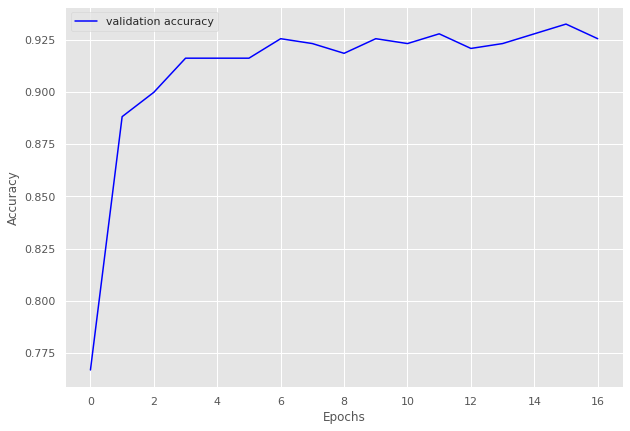

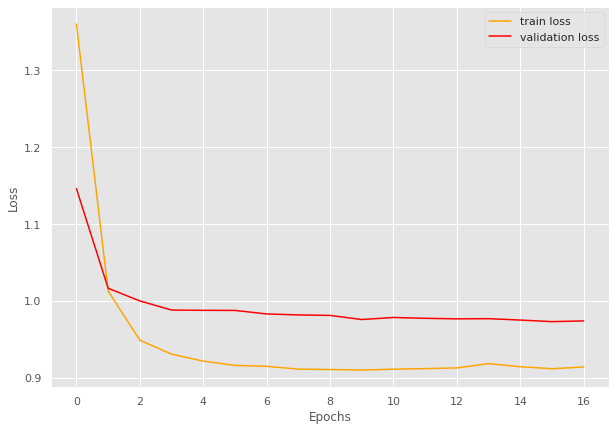

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 6/6 [00:01<00:00,  3.01batch/s, loss=1.63]


train loss 1.6313465634981792, validation loss 1.4356043736139934, validation accuracy 0.7580645161290323
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.98batch/s, loss=1.22]


train loss 1.2196196715037029, validation loss 1.2085366646448772, validation accuracy 0.9032258064516129
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 6/6 [00:01<00:00,  3.00batch/s, loss=1.11]


train loss 1.1129466891288757, validation loss 1.1500906944274902, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.98batch/s, loss=1.08]


train loss 1.0767635703086853, validation loss 1.1238682270050049, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.70batch/s, loss=1.06]


train loss 1.0611578226089478, validation loss 1.1120869716008503, validation accuracy 0.946236559139785
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.84batch/s, loss=1.05]


train loss 1.0496961673100789, validation loss 1.1093214750289917, validation accuracy 0.946236559139785
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.98batch/s, loss=1.05]


train loss 1.0479671756426494, validation loss 1.1072194576263428, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.96batch/s, loss=1.05]


train loss 1.0470418135325115, validation loss 1.1056007544199626, validation accuracy 0.946236559139785
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.98batch/s, loss=1.04]


train loss 1.044944941997528, validation loss 1.1041172742843628, validation accuracy 0.946236559139785
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.04]


train loss 1.0445679624875386, validation loss 1.1021246115366619, validation accuracy 0.946236559139785
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.98batch/s, loss=1.04]


train loss 1.0443221131960552, validation loss 1.1010823249816895, validation accuracy 0.946236559139785
Coarse label 1 Epoch 12
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.76batch/s, loss=1.04]


train loss 1.0447793006896973, validation loss 1.0985891421635945, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 13
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  3.00batch/s, loss=1.04]


train loss 1.0439972281455994, validation loss 1.0962932507197063, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 14
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.98batch/s, loss=1.04]


train loss 1.0440977017084758, validation loss 1.0962226390838623, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 15
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.04]


INFO: Early stopping counter 1 of 5
train loss 1.0444390376408894, validation loss 1.0964023272196453, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 16
-------------------------------


100%|██████████| 6/6 [00:01<00:00,  3.00batch/s, loss=1.04]


INFO: Early stopping counter 2 of 5
train loss 1.0439562996228535, validation loss 1.0975825786590576, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 17
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.04]


INFO: Early stopping counter 3 of 5
train loss 1.0440433820088704, validation loss 1.0980512301127117, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 18
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.96batch/s, loss=1.04]


INFO: Early stopping counter 4 of 5
train loss 1.043855329354604, validation loss 1.0983864863713582, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 19
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.84batch/s, loss=1.04]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9162238199437324 and loss 1.133343915939331


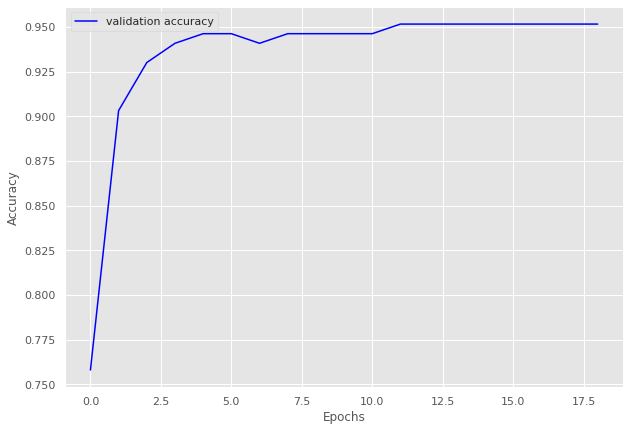

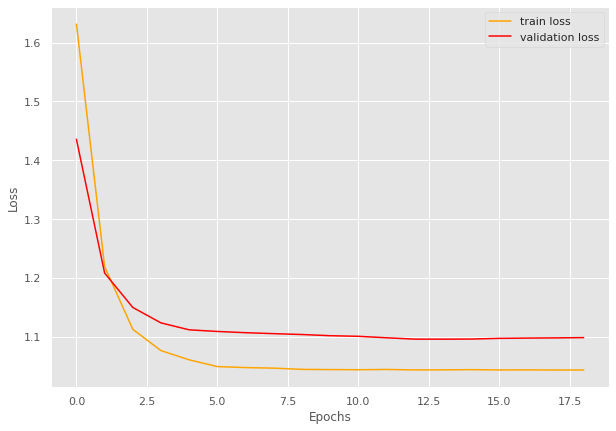

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=1.9] 


train loss 1.9006498754024506, validation loss 1.7246689626148768, validation accuracy 0.764367816091954
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=1.63]


train loss 1.6310852553163255, validation loss 1.6667023726872034, validation accuracy 0.8206896551724138
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=1.56]


train loss 1.5593699685164861, validation loss 1.5733261789594377, validation accuracy 0.903448275862069
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=1.51]


INFO: Early stopping counter 1 of 5
train loss 1.509004614182881, validation loss 1.576103721346174, validation accuracy 0.8954022988505748
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.5]


train loss 1.500995350735528, validation loss 1.564027292387826, validation accuracy 0.9057471264367816
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.94batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4919909025941576, validation loss 1.564190651689257, validation accuracy 0.903448275862069
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=1.49]


train loss 1.4891705853598458, validation loss 1.5537944691521781, validation accuracy 0.9080459770114943
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=1.48]


train loss 1.481556705066136, validation loss 1.5472587602479118, validation accuracy 0.9206896551724137
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=1.48]


train loss 1.4822451174259186, validation loss 1.5369913152285986, validation accuracy 0.9287356321839081
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4751139070306505, validation loss 1.5419049944196428, validation accuracy 0.9206896551724137
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=1.47]


INFO: Early stopping counter 4 of 5
train loss 1.4749810567923956, validation loss 1.5460630570139204, validation accuracy 0.9206896551724137
Coarse label 2 Epoch 12
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.94batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9013886093781445 and loss 1.5627517306241867


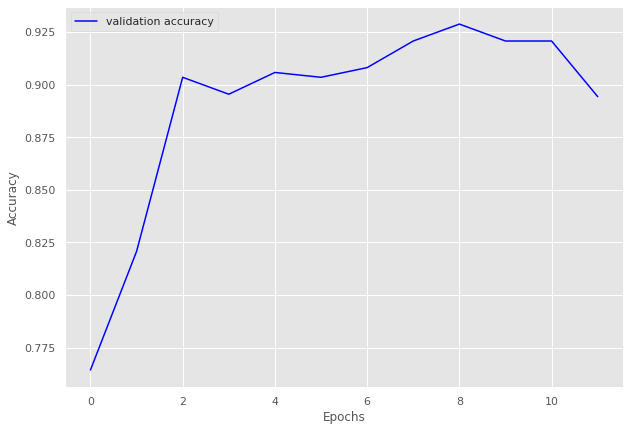

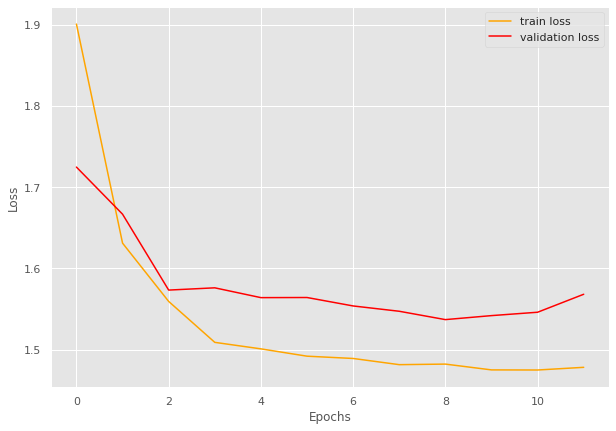

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 13/13 [00:04<00:00,  2.97batch/s, loss=1.55]


train loss 1.5541444374964788, validation loss 1.3691540445600237, validation accuracy 0.7378640776699029
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.98batch/s, loss=1.19]


train loss 1.18948639356173, validation loss 1.237961905343192, validation accuracy 0.8203883495145631
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.97batch/s, loss=1.1]


train loss 1.1024495363235474, validation loss 1.2081890787397112, validation accuracy 0.8422330097087378
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.90batch/s, loss=1.07]


train loss 1.071319974385775, validation loss 1.173930048942566, validation accuracy 0.8762135922330098
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.95batch/s, loss=1.06]


train loss 1.0625641621076143, validation loss 1.1722897802080428, validation accuracy 0.8737864077669902
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.98batch/s, loss=1.06]


train loss 1.0557127182300274, validation loss 1.1636696883610316, validation accuracy 0.8932038834951457
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0552632350188036, validation loss 1.1638119901929582, validation accuracy 0.8932038834951457
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.96batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.05434722166795, validation loss 1.1691185917173113, validation accuracy 0.883495145631068
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.86batch/s, loss=1.05]


train loss 1.051404962172875, validation loss 1.1586149420057024, validation accuracy 0.8907766990291263
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.91batch/s, loss=1.05]


train loss 1.0468985850994403, validation loss 1.1531444958278112, validation accuracy 0.9029126213592233
Coarse label 4 Epoch 11
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.95batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0450040652201726, validation loss 1.1577575887952531, validation accuracy 0.8883495145631068
Coarse label 4 Epoch 12
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.97batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0455851646570058, validation loss 1.157849907875061, validation accuracy 0.8810679611650486
Coarse label 4 Epoch 13
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.97batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9052018192154633 and loss 1.1413876305926929


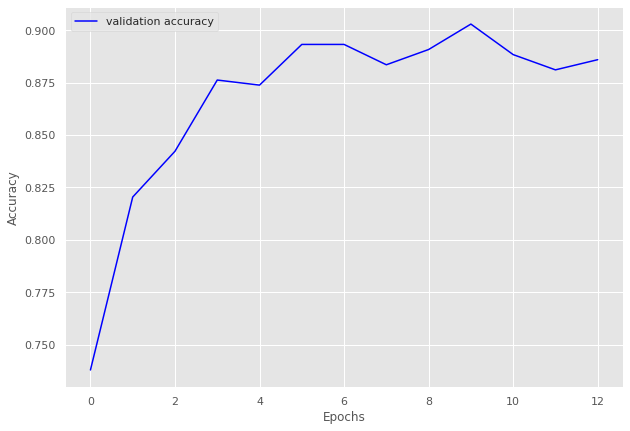

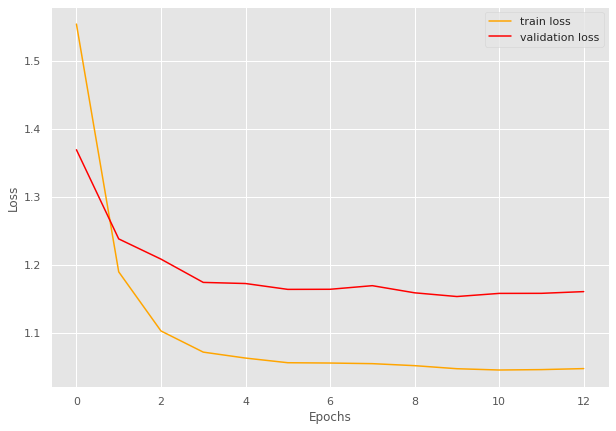

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 5/5 [00:01<00:00,  2.71batch/s, loss=0.552]


train loss 0.5519960165023804, validation loss 0.45772938927014667, validation accuracy 0.89937106918239
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.88batch/s, loss=0.361]


train loss 0.3613806188106537, validation loss 0.3748626510302226, validation accuracy 0.9433962264150944
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.89batch/s, loss=0.329]


train loss 0.32869758605957033, validation loss 0.3556222120920817, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.86batch/s, loss=0.317]


train loss 0.3166091203689575, validation loss 0.35490814844767254, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.92batch/s, loss=0.315]


train loss 0.31493828892707826, validation loss 0.35426510373751324, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.92batch/s, loss=0.314]


train loss 0.3138007879257202, validation loss 0.3491980930169423, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.94batch/s, loss=0.314]


train loss 0.31360021233558655, validation loss 0.34357460339864093, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.94batch/s, loss=0.313]


train loss 0.31347724199295046, validation loss 0.3403240342934926, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.95batch/s, loss=0.314]


train loss 0.3136665165424347, validation loss 0.3390294313430786, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 10
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.95batch/s, loss=0.314]


train loss 0.31357712149620054, validation loss 0.33768292268117267, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 11
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.91batch/s, loss=0.313]


train loss 0.31335081458091735, validation loss 0.33707202474276227, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 12
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.89batch/s, loss=0.313]


INFO: Early stopping counter 1 of 5
train loss 0.3133425712585449, validation loss 0.3370860715707143, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 13
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.93batch/s, loss=0.313]


INFO: Early stopping counter 2 of 5
train loss 0.3133560657501221, validation loss 0.3373206953207652, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 14
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.94batch/s, loss=0.314]


INFO: Early stopping counter 3 of 5
train loss 0.3135052561759949, validation loss 0.33725176254908246, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 15
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.75batch/s, loss=0.313]


INFO: Early stopping counter 4 of 5
train loss 0.31333231925964355, validation loss 0.3375698725382487, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 16
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.94batch/s, loss=0.313]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9705449189985272 and loss 0.34229691985041594


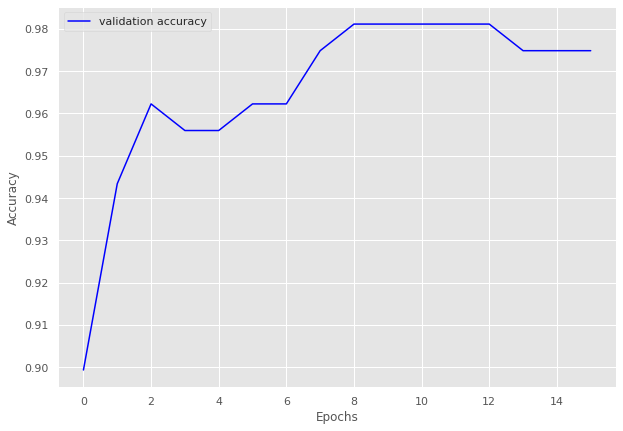

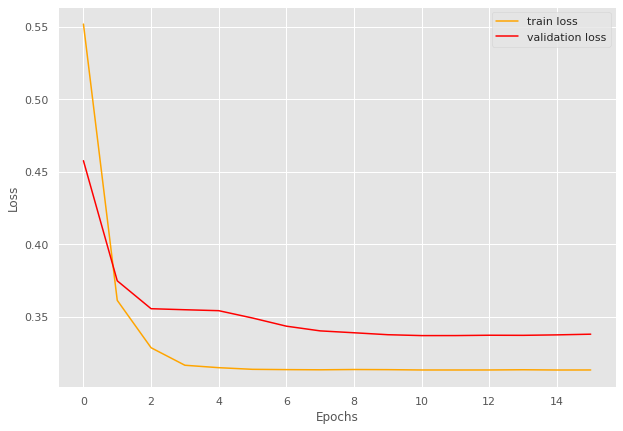

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 15/15 [00:04<00:00,  3.02batch/s, loss=1.61]


train loss 1.6100189288457234, validation loss 1.3818932175636292, validation accuracy 0.7801724137931034
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.00batch/s, loss=1.32]


train loss 1.3225430806477865, validation loss 1.2652308493852615, validation accuracy 0.9073275862068966
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.93batch/s, loss=1.23]


train loss 1.2321540037790935, validation loss 1.2635514289140701, validation accuracy 0.9051724137931034
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  3.00batch/s, loss=1.2] 


train loss 1.203179669380188, validation loss 1.2560629546642303, validation accuracy 0.9030172413793104
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.00batch/s, loss=1.19]


INFO: Early stopping counter 1 of 5
train loss 1.1922568877538045, validation loss 1.2577443420886993, validation accuracy 0.9051724137931034
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.91batch/s, loss=1.18]


INFO: Early stopping counter 2 of 5
train loss 1.1822431166966756, validation loss 1.2596458047628403, validation accuracy 0.9030172413793104
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.94batch/s, loss=1.19]


train loss 1.1856079578399659, validation loss 1.2497071474790573, validation accuracy 0.9137931034482759
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.03batch/s, loss=1.18]


train loss 1.181456979115804, validation loss 1.2439076155424118, validation accuracy 0.9202586206896551
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.01batch/s, loss=1.18]


INFO: Early stopping counter 3 of 5
train loss 1.1807419061660767, validation loss 1.2519050240516663, validation accuracy 0.9073275862068966
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.96batch/s, loss=1.18]


train loss 1.1792345841725667, validation loss 1.2405527383089066, validation accuracy 0.9202586206896551
Coarse label 6 Epoch 11
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.01batch/s, loss=1.18]


INFO: Early stopping counter 4 of 5
train loss 1.1779071887334187, validation loss 1.2468233555555344, validation accuracy 0.9116379310344828
Coarse label 6 Epoch 12
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.95batch/s, loss=1.18]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.909800957420005 and loss 1.2554661788940429


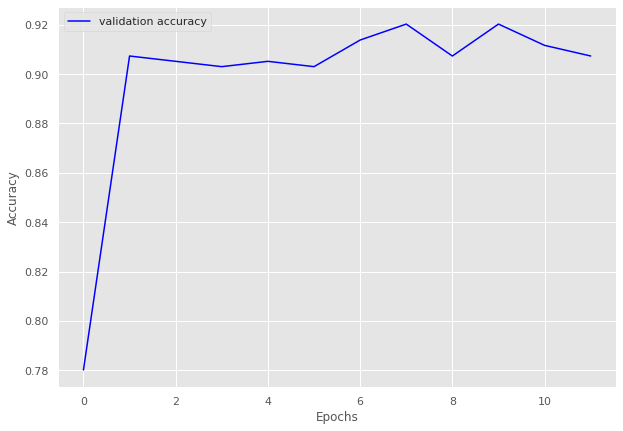

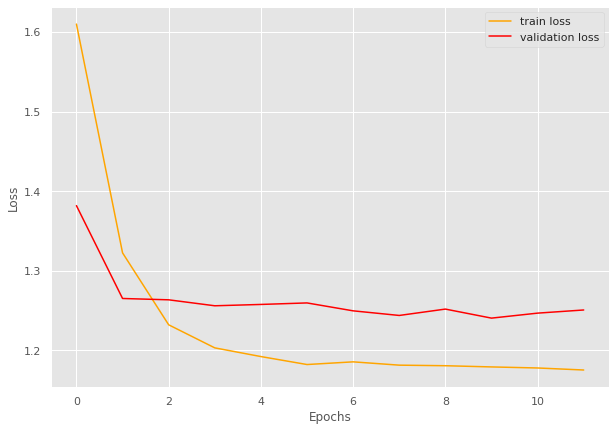

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 12/12 [00:03<00:00,  3.05batch/s, loss=1.07]


train loss 1.0711912910143535, validation loss 0.864856610695521, validation accuracy 0.8980716253443526
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.05batch/s, loss=0.788]


train loss 0.7877918034791946, validation loss 0.8017351528008779, validation accuracy 0.9449035812672176
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.09batch/s, loss=0.756]


train loss 0.7564281125863394, validation loss 0.7884403864542643, validation accuracy 0.953168044077135
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  3.00batch/s, loss=0.754]


train loss 0.7536857078472773, validation loss 0.7839411298433939, validation accuracy 0.9559228650137741
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.03batch/s, loss=0.751]


train loss 0.7513839503129324, validation loss 0.7751585145791372, validation accuracy 0.9724517906336089
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.00batch/s, loss=0.749]


INFO: Early stopping counter 1 of 5
train loss 0.7489802489678065, validation loss 0.7816031177838644, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.07batch/s, loss=0.749]


INFO: Early stopping counter 2 of 5
train loss 0.7492630630731583, validation loss 0.7889828681945801, validation accuracy 0.9559228650137741
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.04batch/s, loss=0.746]


INFO: Early stopping counter 3 of 5
train loss 0.7461933741966883, validation loss 0.7839178144931793, validation accuracy 0.9586776859504132
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 12/12 [00:05<00:00,  2.17batch/s, loss=0.745]


INFO: Early stopping counter 4 of 5
train loss 0.7453910708427429, validation loss 0.7838965455691019, validation accuracy 0.9559228650137741
Coarse label 7 Epoch 10
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.99batch/s, loss=0.747]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9646074646074646 and loss 0.7812850317176507


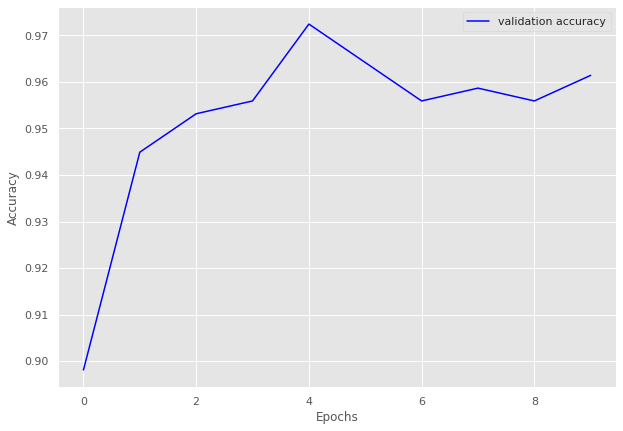

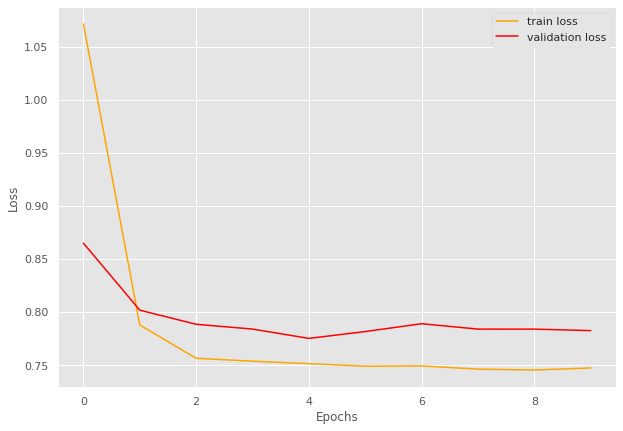

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 17/17 [00:05<00:00,  3.09batch/s, loss=1.69]


train loss 1.685820551479564, validation loss 1.4547834694385529, validation accuracy 0.7377690802348337
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.09batch/s, loss=1.37]


train loss 1.3687671002219706, validation loss 1.3067335933446884, validation accuracy 0.87279843444227
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.09batch/s, loss=1.26]


train loss 1.260821721133064, validation loss 1.2966815531253815, validation accuracy 0.8747553816046967
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.09batch/s, loss=1.24]


train loss 1.2390378222746008, validation loss 1.2961834818124771, validation accuracy 0.8767123287671232
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.09batch/s, loss=1.24]


train loss 1.2375691147411572, validation loss 1.277459293603897, validation accuracy 0.8923679060665362
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.08batch/s, loss=1.22]


train loss 1.224990494111005, validation loss 1.2691539376974106, validation accuracy 0.9080234833659491
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.09batch/s, loss=1.21]


train loss 1.213992665795719, validation loss 1.264208436012268, validation accuracy 0.9080234833659491
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.09batch/s, loss=1.22]


train loss 1.2196091413497925, validation loss 1.2638568729162216, validation accuracy 0.9060665362035225
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.09batch/s, loss=1.22]


INFO: Early stopping counter 1 of 5
train loss 1.2216120958328247, validation loss 1.285845085978508, validation accuracy 0.8825831702544031
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=1.21]


INFO: Early stopping counter 2 of 5
train loss 1.2127307092442232, validation loss 1.2723978608846664, validation accuracy 0.898238747553816
Coarse label 8 Epoch 11
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.01batch/s, loss=1.23]


INFO: Early stopping counter 3 of 5
train loss 1.2258302464204676, validation loss 1.274896502494812, validation accuracy 0.9001956947162426
Coarse label 8 Epoch 12
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  2.99batch/s, loss=1.22]


INFO: Early stopping counter 4 of 5
train loss 1.2233521868200863, validation loss 1.27286097407341, validation accuracy 0.9021526418786693
Coarse label 8 Epoch 13
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=1.21]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9027714154832799 and loss 1.266406679675527


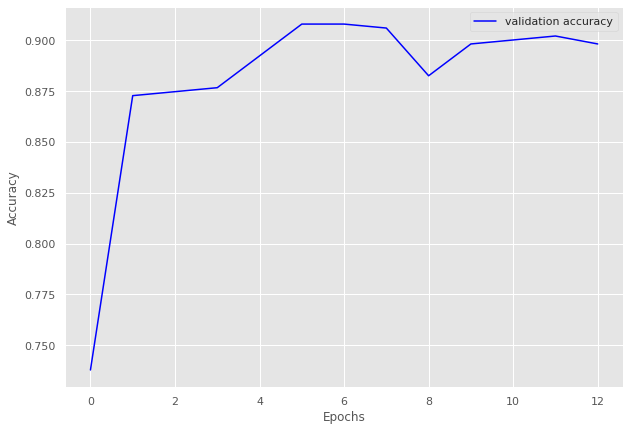

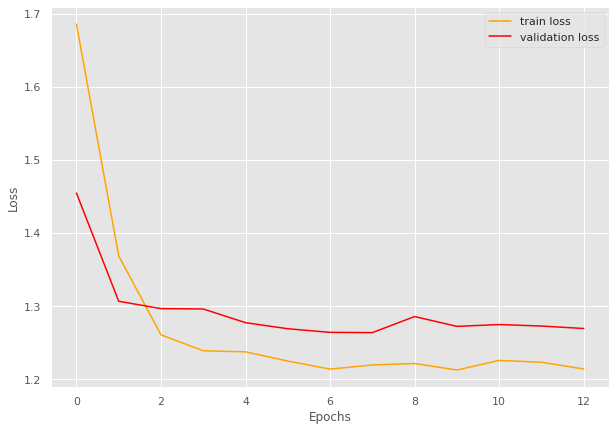

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 21/21 [00:07<00:00,  2.98batch/s, loss=1.93]


train loss 1.9294742118744623, validation loss 1.7388074723157017, validation accuracy 0.7916666666666666
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.96batch/s, loss=1.61]


train loss 1.6100694508779616, validation loss 1.587956883690574, validation accuracy 0.8873456790123457
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  3.00batch/s, loss=1.53]


train loss 1.5334868714922951, validation loss 1.5785084637728604, validation accuracy 0.9012345679012346
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.97batch/s, loss=1.51]


train loss 1.5065717980975197, validation loss 1.5776112079620361, validation accuracy 0.8966049382716049
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  3.00batch/s, loss=1.5]


train loss 1.5022933539890109, validation loss 1.5734264633872292, validation accuracy 0.9027777777777778
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 21/21 [00:06<00:00,  3.00batch/s, loss=1.49]


train loss 1.492184287025815, validation loss 1.5678860490972346, validation accuracy 0.9089506172839507
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.99batch/s, loss=1.49]


train loss 1.4860734542210896, validation loss 1.5615412972190164, validation accuracy 0.9166666666666666
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 21/21 [00:06<00:00,  3.00batch/s, loss=1.48]


INFO: Early stopping counter 1 of 5
train loss 1.4789615755989438, validation loss 1.5682817047292537, validation accuracy 0.9089506172839507
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.99batch/s, loss=1.48]


INFO: Early stopping counter 2 of 5
train loss 1.481488409496489, validation loss 1.5734844966368242, validation accuracy 0.9012345679012346
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 21/21 [00:06<00:00,  3.01batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4801554055440993, validation loss 1.566227826205167, validation accuracy 0.9058641975308642
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.97batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.478164031392052, validation loss 1.565927191214128, validation accuracy 0.9089506172839507
Coarse label 9 Epoch 12
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.99batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9152496382054993 and loss 1.5485274922641026


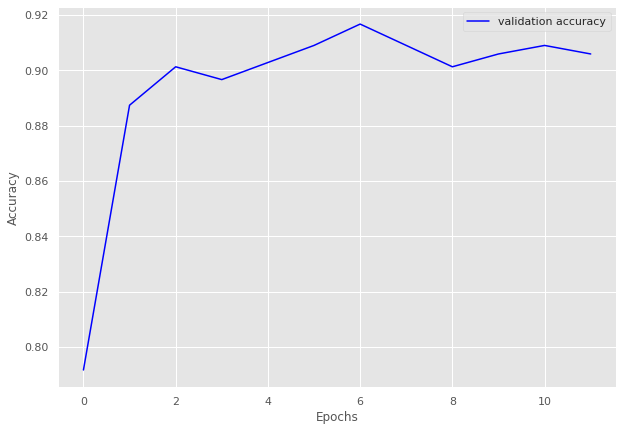

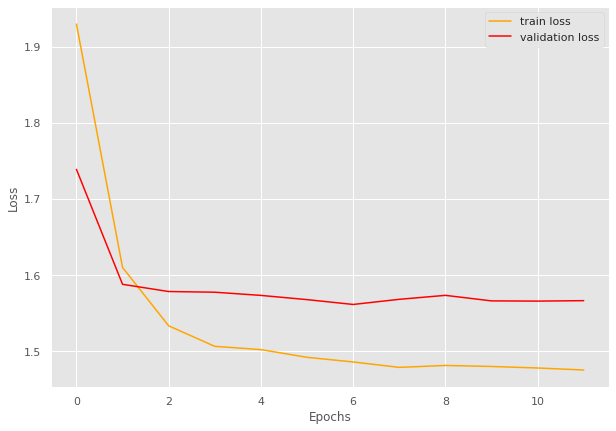

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 10/10 [00:03<00:00,  3.07batch/s, loss=1.12]


train loss 1.1170183897018433, validation loss 0.8601147294044494, validation accuracy 0.9111842105263158
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.816]


train loss 0.8155565142631531, validation loss 0.7982099652290344, validation accuracy 0.9572368421052632
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=0.764]


train loss 0.7641777515411377, validation loss 0.7837252140045166, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.754]


train loss 0.7536134839057922, validation loss 0.7820673823356629, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.88batch/s, loss=0.751]


INFO: Early stopping counter 1 of 5
train loss 0.7510547578334809, validation loss 0.7820768713951111, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.07batch/s, loss=0.746]


train loss 0.745668911933899, validation loss 0.7817017436027527, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.745]


train loss 0.7452133536338806, validation loss 0.7803102493286133, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.746]


train loss 0.7455894529819489, validation loss 0.7753175497055054, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.06batch/s, loss=0.746]


INFO: Early stopping counter 2 of 5
train loss 0.7461269617080688, validation loss 0.7754357576370239, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.744]


INFO: Early stopping counter 3 of 5
train loss 0.7443952858448029, validation loss 0.775576901435852, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.746]


train loss 0.7457351446151733, validation loss 0.7738794326782227, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 12
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.07batch/s, loss=0.745]


train loss 0.7447373807430268, validation loss 0.7730111956596375, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 13
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.746]


INFO: Early stopping counter 4 of 5
train loss 0.7456373155117035, validation loss 0.773613965511322, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 14
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.70batch/s, loss=0.746]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9528102819873393 and loss 0.790457917422783


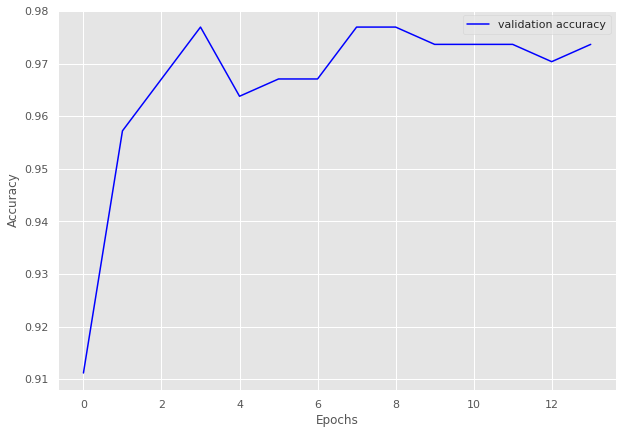

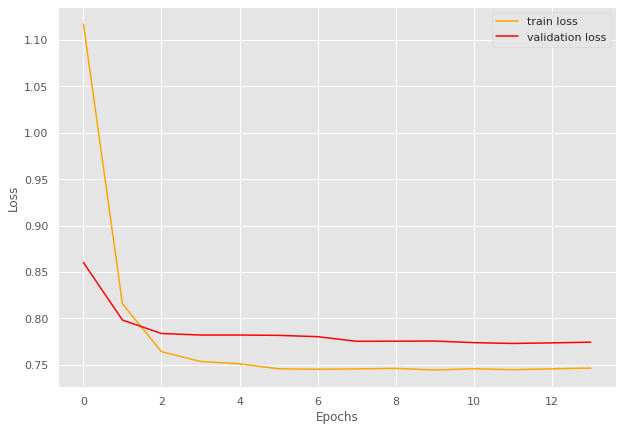

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=1.63]


train loss 1.6289365768432618, validation loss 1.4842751741409301, validation accuracy 0.6586206896551724
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.22batch/s, loss=1.29]


train loss 1.2939696788787842, validation loss 1.2448891878128052, validation accuracy 0.8413793103448276
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=1.14]


train loss 1.1373051762580872, validation loss 1.1758435726165772, validation accuracy 0.8793103448275862
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.20batch/s, loss=1.08]


train loss 1.083189105987549, validation loss 1.1588047742843628, validation accuracy 0.8896551724137931
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.08batch/s, loss=1.07]


train loss 1.0734361052513122, validation loss 1.1571018695831299, validation accuracy 0.8793103448275862
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.23batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0670692682266236, validation loss 1.1751921415328979, validation accuracy 0.8724137931034482
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.23batch/s, loss=1.08]


INFO: Early stopping counter 2 of 5
train loss 1.07602356672287, validation loss 1.188777542114258, validation accuracy 0.8517241379310345
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.22batch/s, loss=1.08]


INFO: Early stopping counter 3 of 5
train loss 1.0795658946037292, validation loss 1.161938977241516, validation accuracy 0.8758620689655172
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.13batch/s, loss=1.07]


train loss 1.0723438501358031, validation loss 1.1468958377838134, validation accuracy 0.903448275862069
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.07batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.0742613554000855, validation loss 1.1498584032058716, validation accuracy 0.8931034482758621
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.20batch/s, loss=1.06]


train loss 1.0602150559425354, validation loss 1.1422956466674805, validation accuracy 0.9172413793103448
Coarse label 12 Epoch 12
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.07batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.8813967489464178 and loss 1.1635178510959332


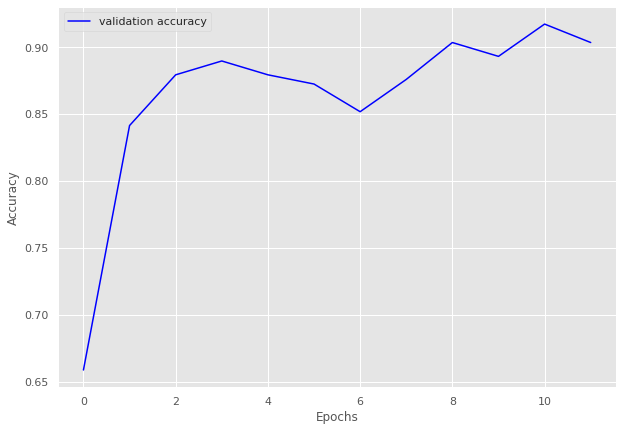

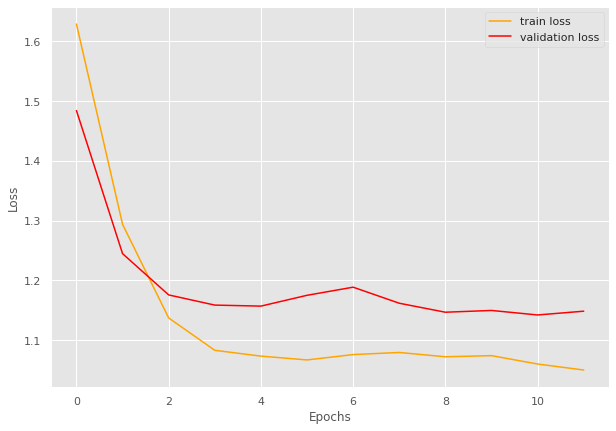

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 9/9 [00:02<00:00,  3.22batch/s, loss=0.85] 


train loss 0.8501995801925659, validation loss 0.6626890063285827, validation accuracy 0.8996138996138996
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.26batch/s, loss=0.63] 


train loss 0.6303648617532518, validation loss 0.6118585944175721, validation accuracy 0.9305019305019305
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.24batch/s, loss=0.586]


train loss 0.5858906838628981, validation loss 0.6065569043159484, validation accuracy 0.9305019305019305
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.21batch/s, loss=0.579]


INFO: Early stopping counter 1 of 5
train loss 0.5790016584926181, validation loss 0.6066571354866028, validation accuracy 0.9305019305019305
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.24batch/s, loss=0.572]


INFO: Early stopping counter 2 of 5
train loss 0.5719375212987264, validation loss 0.619019603729248, validation accuracy 0.9111969111969112
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.21batch/s, loss=0.566]


INFO: Early stopping counter 3 of 5
train loss 0.5660025676091512, validation loss 0.6223000764846802, validation accuracy 0.915057915057915
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.22batch/s, loss=0.565]


INFO: Early stopping counter 4 of 5
train loss 0.5651336908340454, validation loss 0.6120936393737793, validation accuracy 0.9266409266409267
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.23batch/s, loss=0.567]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9287652645861602 and loss 0.6245869193758283


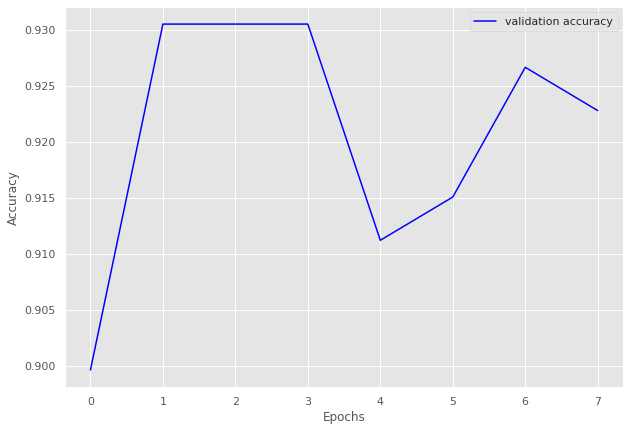

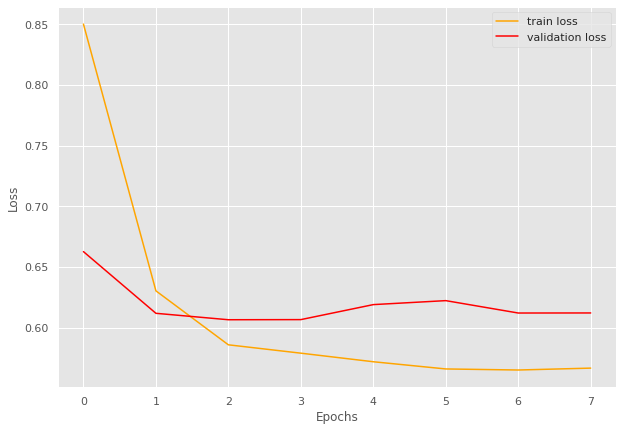

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.43]


train loss 1.4268666380330135, validation loss 1.168501627445221, validation accuracy 0.8888888888888888
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.11]


train loss 1.1124428573407625, validation loss 1.1119819045066834, validation accuracy 0.9410774410774411
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.92batch/s, loss=1.07]


train loss 1.074089294985721, validation loss 1.1051012396812439, validation accuracy 0.9427609427609428
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.07]


train loss 1.0670099885840165, validation loss 1.1008939504623414, validation accuracy 0.9377104377104377
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0605762318560952, validation loss 1.1046394109725952, validation accuracy 0.9410774410774411
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0567884194223505, validation loss 1.105386209487915, validation accuracy 0.9326599326599326
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=1.05]


train loss 1.053580353134557, validation loss 1.095960795879364, validation accuracy 0.9494949494949495
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.05]


train loss 1.053902086458708, validation loss 1.0904240608215332, validation accuracy 0.9528619528619529
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.05]


train loss 1.0515410398182117, validation loss 1.0881355047225951, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.94batch/s, loss=1.05]


train loss 1.0514619036724693, validation loss 1.0876534700393676, validation accuracy 0.9511784511784511
Coarse label 14 Epoch 11
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.01batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.050984031275699, validation loss 1.0881691217422484, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 12
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.94batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0540090171914351, validation loss 1.0930572032928467, validation accuracy 0.9545454545454546
Coarse label 14 Epoch 13
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9408808749630505 and loss 1.1037011993756085


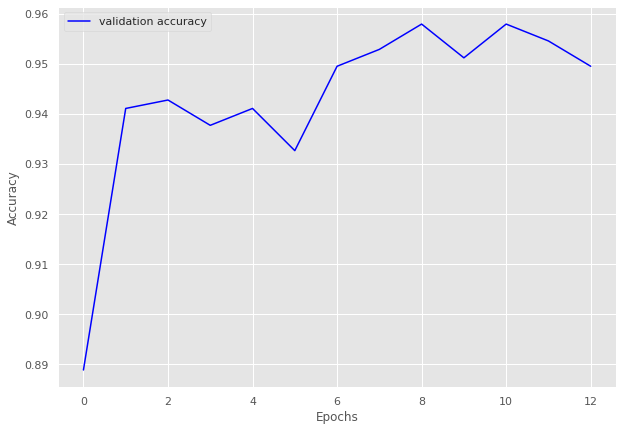

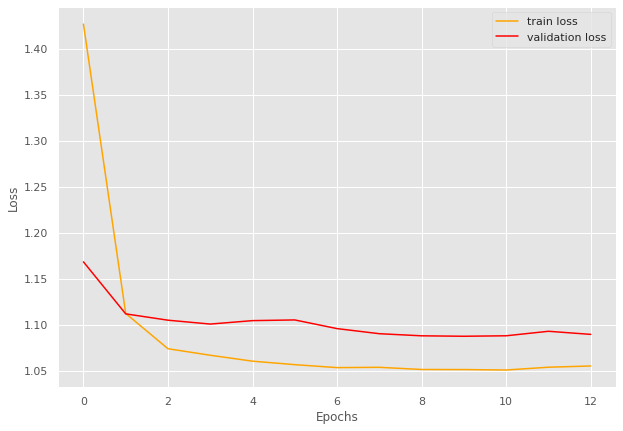

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=1.16]


train loss 1.1595743298530579, validation loss 0.9623849511146545, validation accuracy 0.7959183673469388
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.16batch/s, loss=0.847]


train loss 0.8468457400798798, validation loss 0.8300229668617248, validation accuracy 0.9251700680272109
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.768]


train loss 0.768487685918808, validation loss 0.812870442867279, validation accuracy 0.9455782312925171
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.12batch/s, loss=0.749]


train loss 0.7485258996486663, validation loss 0.8098498463630677, validation accuracy 0.935374149659864
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.748]


train loss 0.7484530568122864, validation loss 0.8077122092247009, validation accuracy 0.9387755102040817
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=0.75]


train loss 0.7496662616729737, validation loss 0.8041220903396606, validation accuracy 0.935374149659864
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.747]


INFO: Early stopping counter 1 of 5
train loss 0.7471842169761658, validation loss 0.8114765048027038, validation accuracy 0.935374149659864
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=0.765]


INFO: Early stopping counter 2 of 5
train loss 0.7647574245929718, validation loss 0.8227410912513733, validation accuracy 0.9285714285714286
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.764]


INFO: Early stopping counter 3 of 5
train loss 0.7637210309505462, validation loss 0.825251579284668, validation accuracy 0.9115646258503401
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.763]


INFO: Early stopping counter 4 of 5
train loss 0.763468211889267, validation loss 0.8114529609680176, validation accuracy 0.9251700680272109
Coarse label 15 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.759]


train loss 0.75875044465065, validation loss 0.8035835504531861, validation accuracy 0.9387755102040817
Coarse label 15 Epoch 12
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.16batch/s, loss=0.753]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9315778974665869 and loss 0.8145091329948811


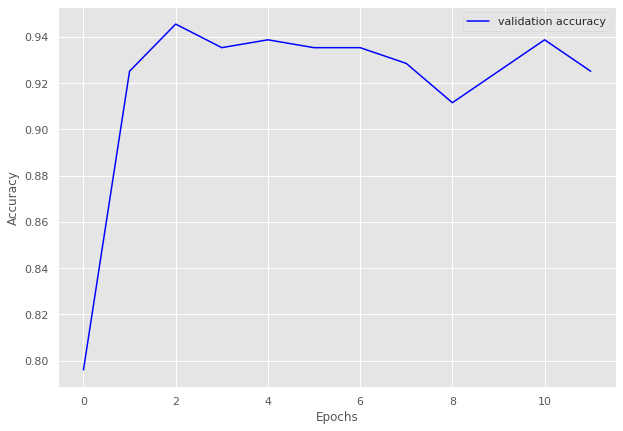

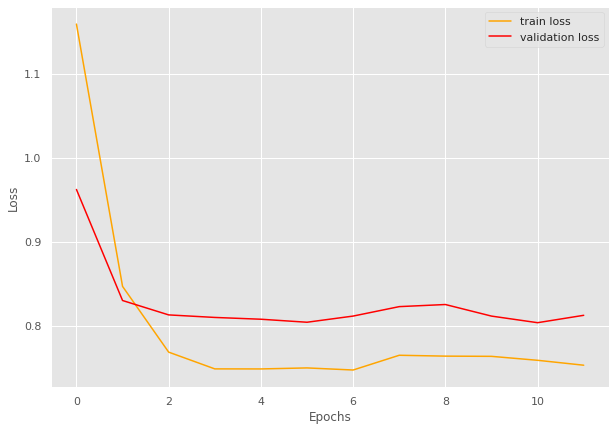

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 9/9 [00:03<00:00,  2.90batch/s, loss=0.903]


train loss 0.902537915441725, validation loss 0.7776320099830627, validation accuracy 0.8120567375886525
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.98batch/s, loss=0.618]


train loss 0.6176761190096537, validation loss 0.6460996985435485, validation accuracy 0.9184397163120568
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.85batch/s, loss=0.567]


train loss 0.5673722161187066, validation loss 0.6159289002418518, validation accuracy 0.9397163120567376
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.99batch/s, loss=0.561]


train loss 0.5607560939259, validation loss 0.6137627720832824, validation accuracy 0.9397163120567376
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.92batch/s, loss=0.558]


train loss 0.5580455660820007, validation loss 0.6106451869010925, validation accuracy 0.9432624113475178
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.99batch/s, loss=0.554]


train loss 0.5542249282201132, validation loss 0.6074873924255371, validation accuracy 0.950354609929078
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.87batch/s, loss=0.554]


train loss 0.5535159044795566, validation loss 0.6062182188034058, validation accuracy 0.9432624113475178
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.01batch/s, loss=0.553]


INFO: Early stopping counter 1 of 5
train loss 0.553461750348409, validation loss 0.6063245296478271, validation accuracy 0.9468085106382979
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.87batch/s, loss=0.552]


INFO: Early stopping counter 2 of 5
train loss 0.5524478091133965, validation loss 0.6075080633163452, validation accuracy 0.9432624113475178
Coarse label 16 Epoch 10
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  3.00batch/s, loss=0.552]


INFO: Early stopping counter 3 of 5
train loss 0.5521646605597602, validation loss 0.6089683890342712, validation accuracy 0.9432624113475178
Coarse label 16 Epoch 11
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.32batch/s, loss=0.552]


train loss 0.5521147979630364, validation loss 0.6043545961380005, validation accuracy 0.950354609929078
Coarse label 16 Epoch 12
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.98batch/s, loss=0.552]


INFO: Early stopping counter 4 of 5
train loss 0.5517290168338351, validation loss 0.604856264591217, validation accuracy 0.9468085106382979
Coarse label 16 Epoch 13
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.97batch/s, loss=0.552]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9459571814591561 and loss 0.6066390628877439


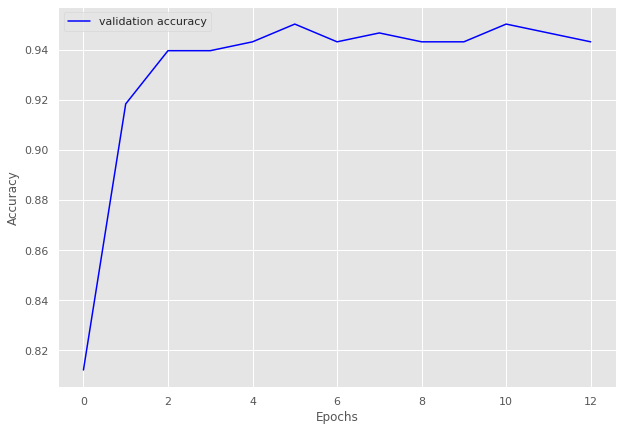

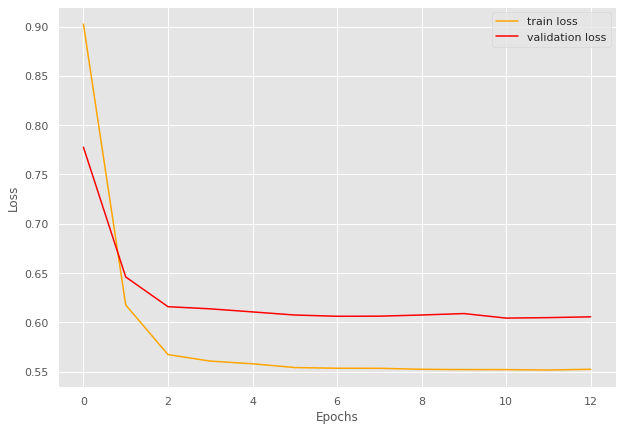

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=1.15]


train loss 1.1479839384555817, validation loss 0.9776929259300232, validation accuracy 0.7993527508090615
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.87batch/s, loss=0.857]


train loss 0.8568052470684051, validation loss 0.881044340133667, validation accuracy 0.883495145631068
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.784]


train loss 0.7836393117904663, validation loss 0.8450317502021789, validation accuracy 0.9061488673139159
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.98batch/s, loss=0.761]


INFO: Early stopping counter 1 of 5
train loss 0.7609981834888458, validation loss 0.8456007599830627, validation accuracy 0.8996763754045307
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.01batch/s, loss=0.753]


INFO: Early stopping counter 2 of 5
train loss 0.7534473419189454, validation loss 0.8503816962242127, validation accuracy 0.8964401294498382
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.92batch/s, loss=0.75]


INFO: Early stopping counter 3 of 5
train loss 0.7502344310283661, validation loss 0.853336238861084, validation accuracy 0.8867313915857605
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.7510753512382508, validation loss 0.8505859732627868, validation accuracy 0.889967637540453
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.58batch/s, loss=0.752]


train loss 0.75153489112854, validation loss 0.8447800874710083, validation accuracy 0.8964401294498382
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.03batch/s, loss=0.748]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.8977617602427921 and loss 0.846041216907731


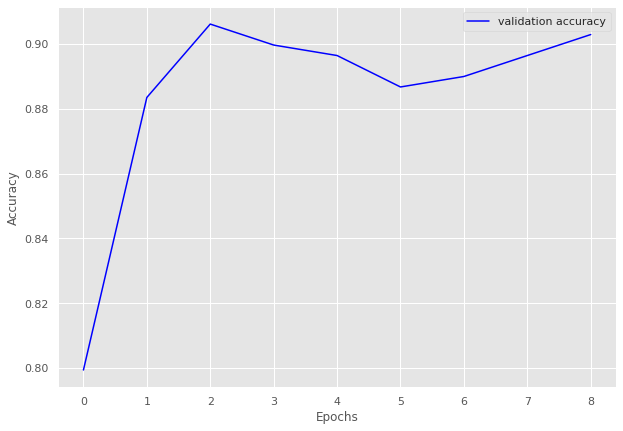

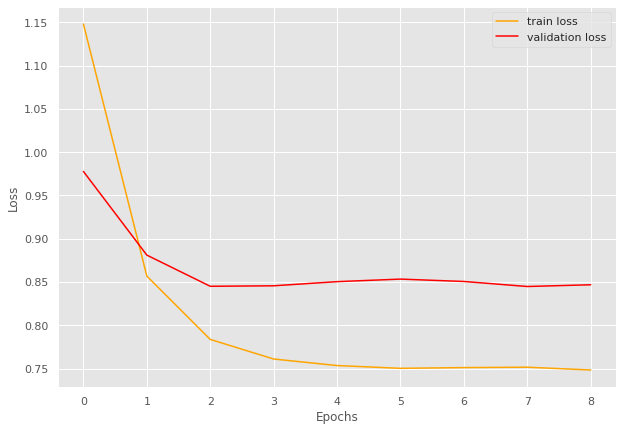

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 4/4 [00:01<00:00,  3.76batch/s, loss=1.32]


train loss 1.3161018788814545, validation loss 1.3052306175231934, validation accuracy 0.4895833333333333
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.70batch/s, loss=1.04]


train loss 1.0415118038654327, validation loss 1.188325583934784, validation accuracy 0.59375
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.73batch/s, loss=0.869]


train loss 0.8686887919902802, validation loss 1.0762118697166443, validation accuracy 0.6770833333333334
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.76batch/s, loss=0.803]


train loss 0.8029603362083435, validation loss 0.9857468903064728, validation accuracy 0.75
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.72batch/s, loss=0.829]


train loss 0.8286516964435577, validation loss 0.9365951120853424, validation accuracy 0.8020833333333334
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.74batch/s, loss=0.764]


train loss 0.7641777247190475, validation loss 0.9071412682533264, validation accuracy 0.84375
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.74batch/s, loss=0.774]


train loss 0.7740249037742615, validation loss 0.9016344547271729, validation accuracy 0.8541666666666666
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.78batch/s, loss=0.784]


INFO: Early stopping counter 1 of 5
train loss 0.7836275994777679, validation loss 0.9116280972957611, validation accuracy 0.84375
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.77batch/s, loss=0.758]


INFO: Early stopping counter 2 of 5
train loss 0.7581024765968323, validation loss 0.9039159417152405, validation accuracy 0.84375
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.75batch/s, loss=0.802]


train loss 0.8021008968353271, validation loss 0.8962039649486542, validation accuracy 0.8645833333333334
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.77batch/s, loss=0.755]


train loss 0.7550566792488098, validation loss 0.8955637216567993, validation accuracy 0.84375
Coarse label 19 Epoch 12
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.70batch/s, loss=0.78] 


train loss 0.7798196077346802, validation loss 0.8944688141345978, validation accuracy 0.84375
Coarse label 19 Epoch 13
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.77batch/s, loss=0.816]


INFO: Early stopping counter 3 of 5
train loss 0.8159512877464294, validation loss 0.9264625608921051, validation accuracy 0.78125
Coarse label 19 Epoch 14
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.30batch/s, loss=0.764]


INFO: Early stopping counter 4 of 5
train loss 0.7643925547599792, validation loss 0.9377879202365875, validation accuracy 0.7916666666666666
Coarse label 19 Epoch 15
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.77batch/s, loss=0.837]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.8381294964028777 and loss 0.9090472680551035


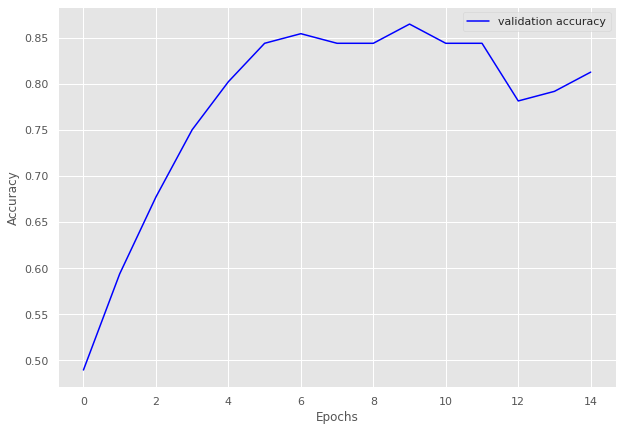

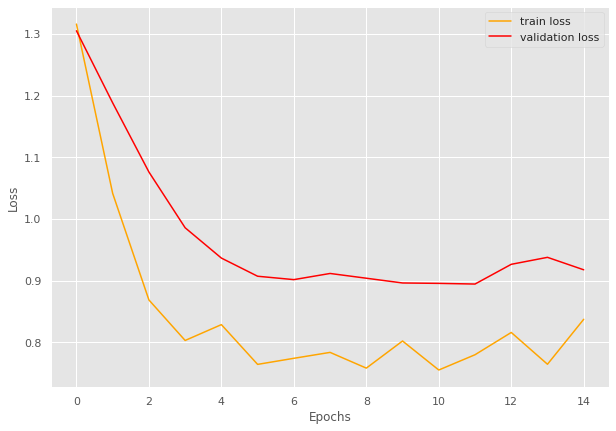

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Calculating for volume 25
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.00batch/s, loss=1.23]


train loss 1.2275047706706184, validation loss 0.9987327541623797, validation accuracy 0.9044289044289044
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=0.986]


train loss 0.9863475561141968, validation loss 0.9735196488244193, validation accuracy 0.9277389277389277
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.04batch/s, loss=0.947]


train loss 0.9474812426737377, validation loss 0.9689955285617283, validation accuracy 0.9393939393939394
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.04batch/s, loss=0.94] 


INFO: Early stopping counter 1 of 5
train loss 0.9400012386696679, validation loss 0.9700086031641278, validation accuracy 0.9393939393939394
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.02batch/s, loss=0.94] 


train loss 0.9397119901009968, validation loss 0.9633627619062152, validation accuracy 0.9440559440559441
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=0.948]


INFO: Early stopping counter 2 of 5
train loss 0.947767293878964, validation loss 0.975587512765612, validation accuracy 0.9254079254079254
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=0.944]


INFO: Early stopping counter 3 of 5
train loss 0.943571429167475, validation loss 0.971208223274776, validation accuracy 0.9324009324009324
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.00batch/s, loss=0.948]


INFO: Early stopping counter 4 of 5
train loss 0.9479646767888751, validation loss 0.9664787650108337, validation accuracy 0.9370629370629371
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=0.944]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9361505243676743 and loss 0.9696693233415192


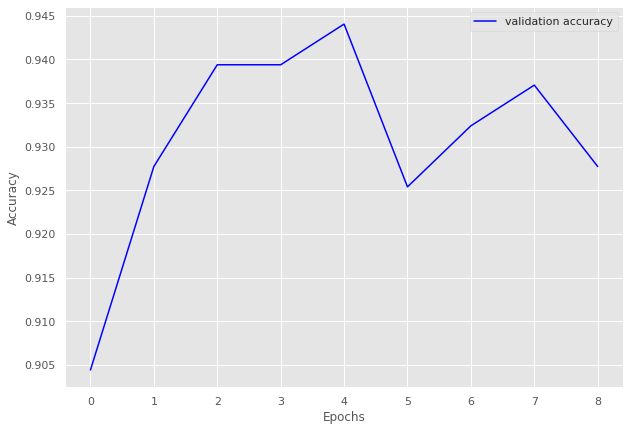

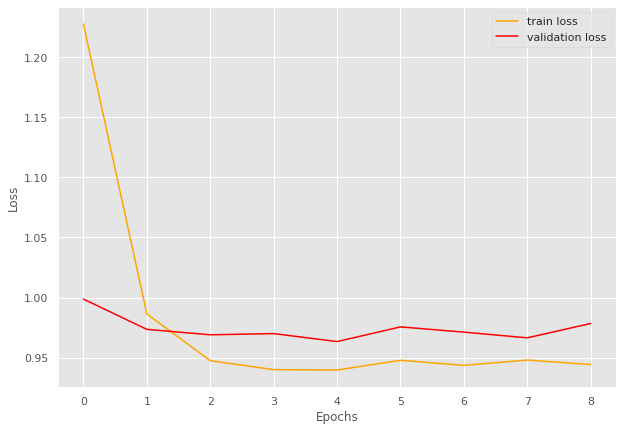

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 12/12 [00:04<00:00,  2.98batch/s, loss=1.46]


train loss 1.4589201907316844, validation loss 1.2280638217926025, validation accuracy 0.8494623655913979
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.91batch/s, loss=1.13]


train loss 1.1316034297148387, validation loss 1.125829776128133, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.99batch/s, loss=1.07]


train loss 1.0711338222026825, validation loss 1.1167861620585124, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.99batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0581866800785065, validation loss 1.1205379962921143, validation accuracy 0.9193548387096774
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.96batch/s, loss=1.05]


train loss 1.0496989885965984, validation loss 1.1054634253184001, validation accuracy 0.946236559139785
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.95batch/s, loss=1.05]


train loss 1.0502635737260182, validation loss 1.0989350477854412, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.02batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.0474812686443329, validation loss 1.1104814211527507, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.90batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0468066533406575, validation loss 1.1098028818766277, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.99batch/s, loss=1.05]


train loss 1.052751789490382, validation loss 1.0934340159098308, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.89batch/s, loss=1.05]


train loss 1.0468166172504425, validation loss 1.0809136629104614, validation accuracy 0.967741935483871
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.95batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0467312335968018, validation loss 1.0825297832489014, validation accuracy 0.9623655913978495
Coarse label 1 Epoch 12
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.87batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9408640226628895 and loss 1.1069501744376289


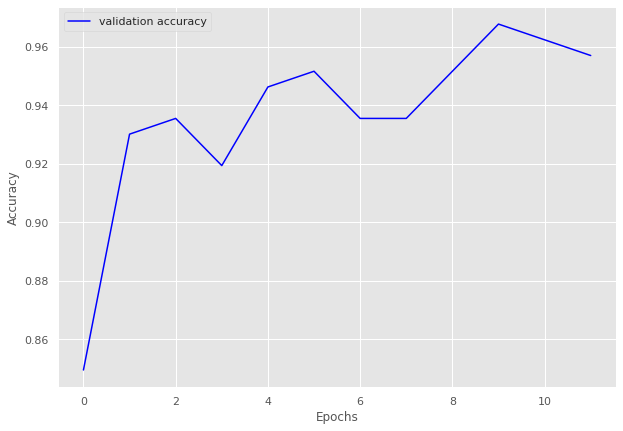

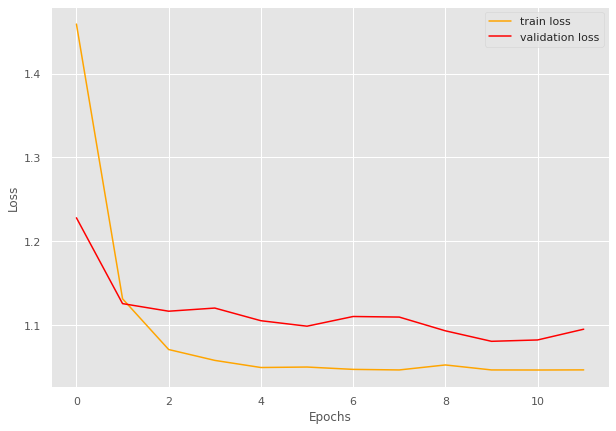

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 55/55 [00:18<00:00,  2.93batch/s, loss=1.79]


train loss 1.785006943616, validation loss 1.5734950474330358, validation accuracy 0.9057471264367816
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.93batch/s, loss=1.55]


train loss 1.5515552694147283, validation loss 1.5545547604560852, validation accuracy 0.9114942528735632
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.91batch/s, loss=1.51]


train loss 1.5113427313891323, validation loss 1.5376654522759574, validation accuracy 0.9264367816091954
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.93batch/s, loss=1.51]


train loss 1.5062170852314343, validation loss 1.5299787606511797, validation accuracy 0.9310344827586207
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.94batch/s, loss=1.5] 


train loss 1.495193169333718, validation loss 1.5270885229110718, validation accuracy 0.9344827586206896
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.91batch/s, loss=1.49]


train loss 1.4891666650772095, validation loss 1.5265282477651323, validation accuracy 0.9402298850574713
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.89batch/s, loss=1.48]


INFO: Early stopping counter 1 of 5
train loss 1.484247992255471, validation loss 1.5331718581063407, validation accuracy 0.9287356321839081
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.92batch/s, loss=1.49]


train loss 1.4857808936725962, validation loss 1.5236132400376456, validation accuracy 0.9390804597701149
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.92batch/s, loss=1.49]


train loss 1.4904163230549206, validation loss 1.5195420384407043, validation accuracy 0.9402298850574713
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.93batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.485025481744246, validation loss 1.5238124813352312, validation accuracy 0.9379310344827586
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.92batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4814493569460783, validation loss 1.5244927150862557, validation accuracy 0.9356321839080459
Coarse label 2 Epoch 12
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.93batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4772595925764604, validation loss 1.5268394095557076, validation accuracy 0.9344827586206896
Coarse label 2 Epoch 13
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.92batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9265510948905109 and loss 1.535662420166349


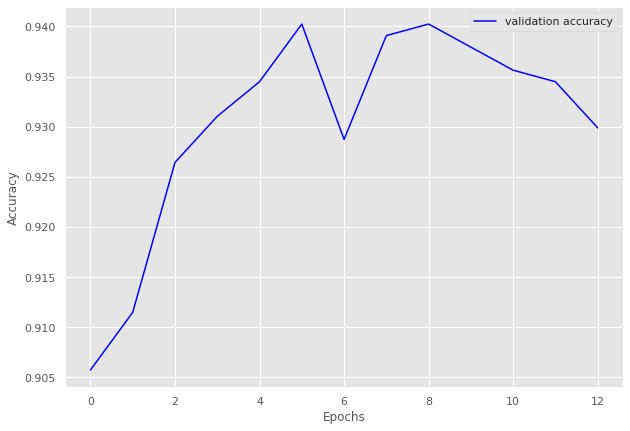

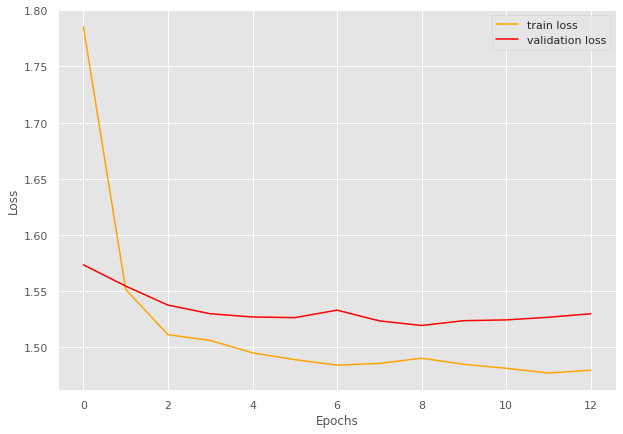

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 26/26 [00:08<00:00,  2.94batch/s, loss=1.41]


train loss 1.410006399338062, validation loss 1.2614397832325526, validation accuracy 0.8203883495145631
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.97batch/s, loss=1.14]


train loss 1.1422377091187697, validation loss 1.1907140697751726, validation accuracy 0.8640776699029126
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.98batch/s, loss=1.1] 


train loss 1.0998389720916748, validation loss 1.1720227684293474, validation accuracy 0.8810679611650486
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.96batch/s, loss=1.09]


INFO: Early stopping counter 1 of 5
train loss 1.0868698633634126, validation loss 1.1744500739233834, validation accuracy 0.8762135922330098
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.99batch/s, loss=1.07]


train loss 1.0739174347657423, validation loss 1.1657038075583321, validation accuracy 0.8907766990291263
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.97batch/s, loss=1.07]


train loss 1.0656461990796602, validation loss 1.152461222239903, validation accuracy 0.9004854368932039
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.92batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0623390537041884, validation loss 1.15555659362248, validation accuracy 0.9029126213592233
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 26/26 [00:09<00:00,  2.77batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0614307797872102, validation loss 1.1559569665363856, validation accuracy 0.8980582524271845
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.97batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.05699334694789, validation loss 1.1651673487254552, validation accuracy 0.8907766990291263
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.97batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9360605572555967 and loss 1.1083041259220667


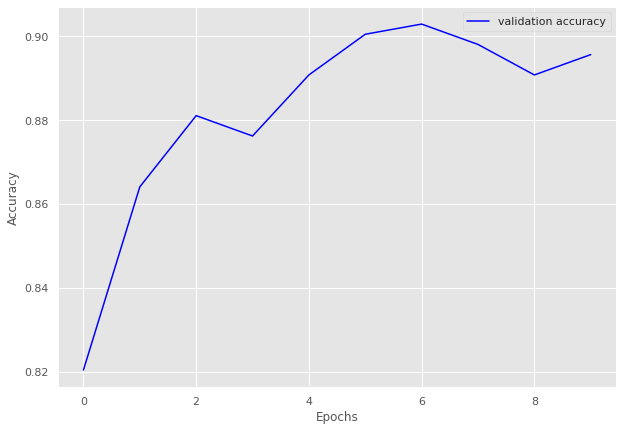

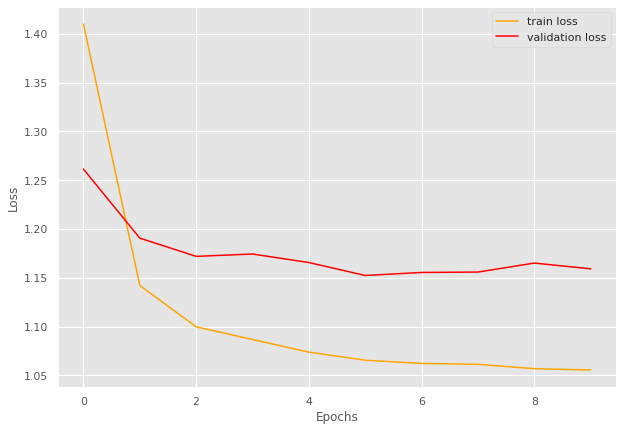

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=0.476]


train loss 0.4755119115114212, validation loss 0.35824379324913025, validation accuracy 0.949685534591195
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=0.333]


train loss 0.33258460760116576, validation loss 0.35107868909835815, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.95batch/s, loss=0.318]


train loss 0.31800401508808135, validation loss 0.33856114745140076, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.88batch/s, loss=0.315]


INFO: Early stopping counter 1 of 5
train loss 0.3145643472671509, validation loss 0.34167425831158954, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.90batch/s, loss=0.314]


INFO: Early stopping counter 2 of 5
train loss 0.31388701498508453, validation loss 0.3403160770734151, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.95batch/s, loss=0.314]


INFO: Early stopping counter 3 of 5
train loss 0.3135139971971512, validation loss 0.3404669960339864, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.83batch/s, loss=0.314]


train loss 0.3139947086572647, validation loss 0.33853458364804584, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.91batch/s, loss=0.314]


INFO: Early stopping counter 4 of 5
train loss 0.31364089250564575, validation loss 0.34084731340408325, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.96batch/s, loss=0.313]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9770546516478932 and loss 0.3366758062651283


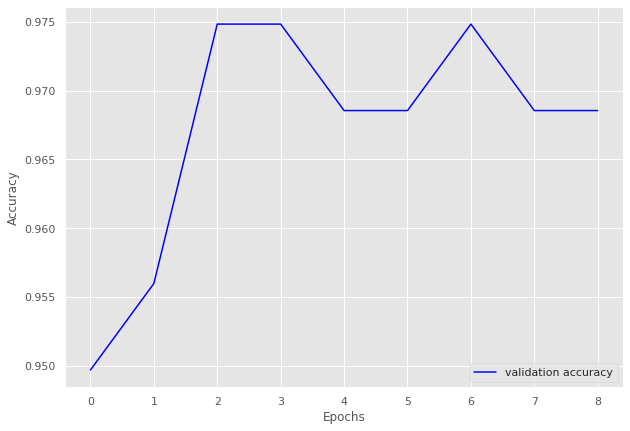

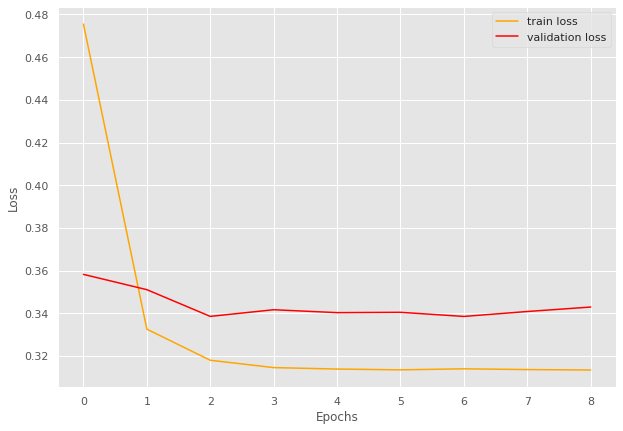

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 30/30 [00:09<00:00,  3.00batch/s, loss=1.47]


train loss 1.4658437490463256, validation loss 1.2774901390075684, validation accuracy 0.8836206896551724
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.03batch/s, loss=1.24]


train loss 1.2414050181706746, validation loss 1.2584776878356934, validation accuracy 0.9030172413793104
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.97batch/s, loss=1.21]


train loss 1.2124406854311625, validation loss 1.2495658695697784, validation accuracy 0.915948275862069
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.2] 


INFO: Early stopping counter 1 of 5
train loss 1.2035920023918152, validation loss 1.2594461888074875, validation accuracy 0.9008620689655172
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.02batch/s, loss=1.21]


train loss 1.2066566983858744, validation loss 1.2452452927827835, validation accuracy 0.915948275862069
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.97batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.2016655564308167, validation loss 1.2491191178560257, validation accuracy 0.9137931034482759
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  3.00batch/s, loss=1.19]


train loss 1.1942222952842712, validation loss 1.2412116527557373, validation accuracy 0.9245689655172413
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1919976433118185, validation loss 1.2415177375078201, validation accuracy 0.9267241379310345
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=1.2] 


INFO: Early stopping counter 4 of 5
train loss 1.1975160161654155, validation loss 1.2448470443487167, validation accuracy 0.915948275862069
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.02batch/s, loss=1.19]


train loss 1.1945438226064047, validation loss 1.2333155572414398, validation accuracy 0.9310344827586207
Coarse label 6 Epoch 11
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9347608850820842 and loss 1.2318661299618807


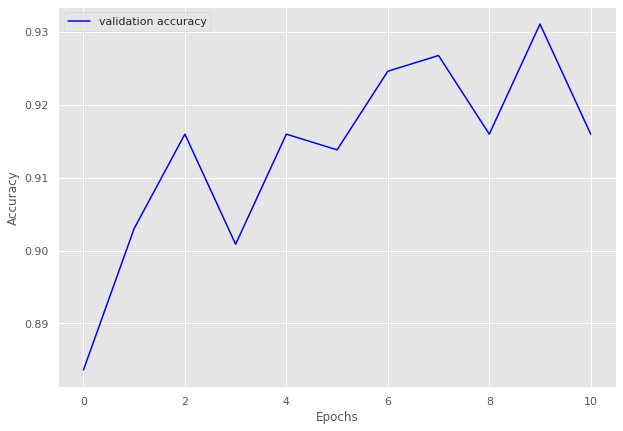

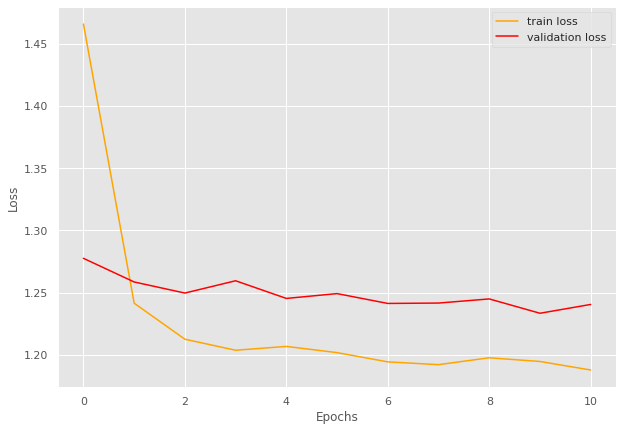

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 23/23 [00:07<00:00,  2.89batch/s, loss=0.943]


train loss 0.9431021161701368, validation loss 0.7660644948482513, validation accuracy 0.977961432506887
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.90batch/s, loss=0.765]


train loss 0.7649237435796986, validation loss 0.7613627513249716, validation accuracy 0.9862258953168044
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 23/23 [00:08<00:00,  2.86batch/s, loss=0.758]


train loss 0.7583614639613939, validation loss 0.7588640650113424, validation accuracy 0.9862258953168044
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.94batch/s, loss=0.758]


INFO: Early stopping counter 1 of 5
train loss 0.7580281573793163, validation loss 0.766048014163971, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.95batch/s, loss=0.754]


INFO: Early stopping counter 2 of 5
train loss 0.7538857900578043, validation loss 0.7613577445348104, validation accuracy 0.9834710743801653
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 23/23 [00:08<00:00,  2.71batch/s, loss=0.752]


INFO: Early stopping counter 3 of 5
train loss 0.7516151692556299, validation loss 0.7631342907746633, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.94batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.7508983145589414, validation loss 0.7641622126102448, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.96batch/s, loss=0.751]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9682713347921226 and loss 0.7765290744082872


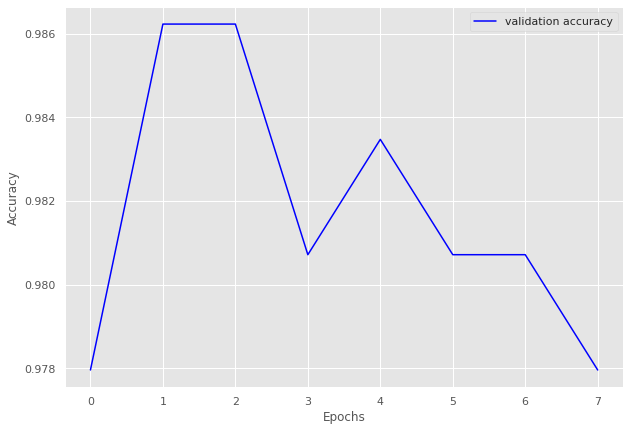

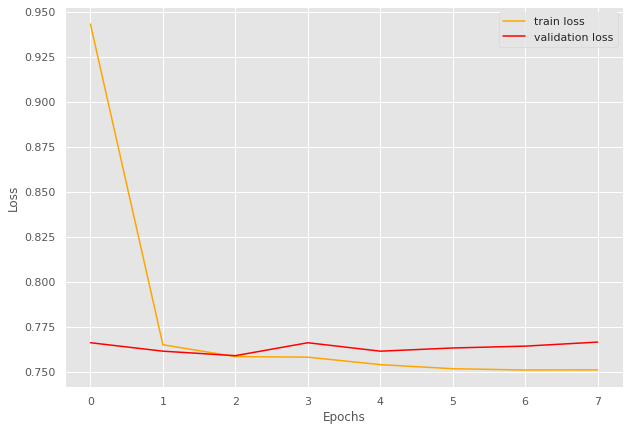

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 33/33 [00:11<00:00,  2.98batch/s, loss=1.52]


train loss 1.5176549282940952, validation loss 1.2850992679595947, validation accuracy 0.8786692759295499
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 33/33 [00:10<00:00,  3.00batch/s, loss=1.24]


train loss 1.2407079573833582, validation loss 1.257997527718544, validation accuracy 0.9099804305283757
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.99batch/s, loss=1.22]


INFO: Early stopping counter 1 of 5
train loss 1.2218418735446352, validation loss 1.2662262469530106, validation accuracy 0.9021526418786693
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.96batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.2038455334576694, validation loss 1.261789157986641, validation accuracy 0.9060665362035225
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.96batch/s, loss=1.2] 


train loss 1.20171924793359, validation loss 1.2494774460792542, validation accuracy 0.9217221135029354
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.97batch/s, loss=1.2] 


INFO: Early stopping counter 3 of 5
train loss 1.2026378602692576, validation loss 1.260408878326416, validation accuracy 0.9041095890410958
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 33/33 [00:13<00:00,  2.46batch/s, loss=1.2] 


INFO: Early stopping counter 4 of 5
train loss 1.1959824020212346, validation loss 1.2703790813684464, validation accuracy 0.8923679060665362
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.99batch/s, loss=1.19]


train loss 1.1886508464813232, validation loss 1.2456569075584412, validation accuracy 0.9197651663405088
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.99batch/s, loss=1.2] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9180838634298325 and loss 1.2478021688697751


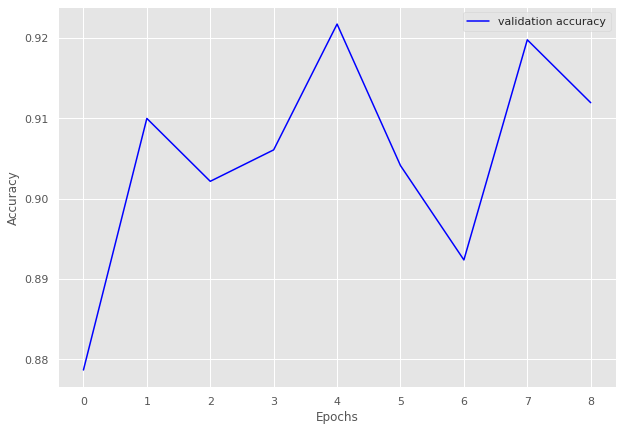

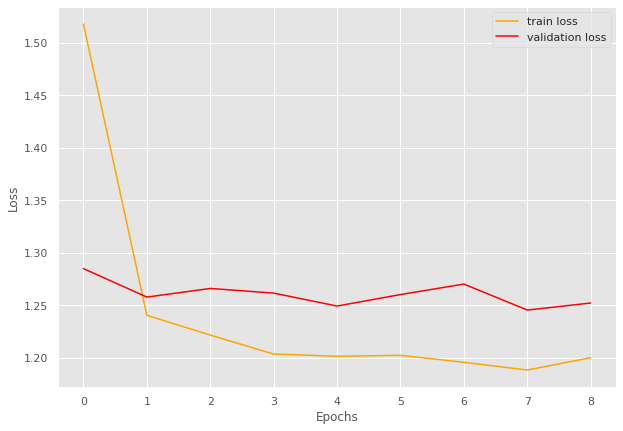

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 41/41 [00:14<00:00,  2.90batch/s, loss=1.78]


train loss 1.7782976394746361, validation loss 1.692508491602811, validation accuracy 0.8379629629629629
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=1.58]


train loss 1.584148075522446, validation loss 1.646506753834811, validation accuracy 0.875
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=1.54]


train loss 1.5400360851753048, validation loss 1.551709857853976, validation accuracy 0.9228395061728395
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.90batch/s, loss=1.52]


train loss 1.5166687500186082, validation loss 1.5493450273167004, validation accuracy 0.9212962962962963
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=1.5] 


train loss 1.5019736813335884, validation loss 1.5261225592006336, validation accuracy 0.9367283950617284
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4923740712607778, validation loss 1.543864445252852, validation accuracy 0.9320987654320988
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.486587850058951, validation loss 1.5306567603891545, validation accuracy 0.9367283950617284
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4837607639591868, validation loss 1.533612684770064, validation accuracy 0.9274691358024691
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=1.48]


train loss 1.4815223420538552, validation loss 1.5219097245823254, validation accuracy 0.933641975308642
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=1.48]


train loss 1.4796834166457014, validation loss 1.5212149078195745, validation accuracy 0.941358024691358
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4793814885907057, validation loss 1.525635144927285, validation accuracy 0.9429012345679012
Coarse label 9 Epoch 12
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.940453008096751 and loss 1.5233996685813456


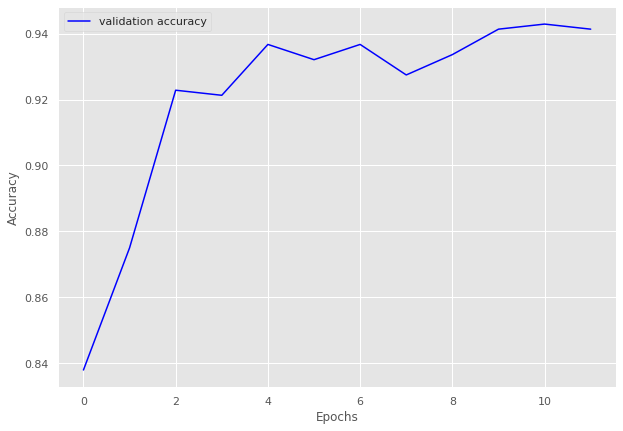

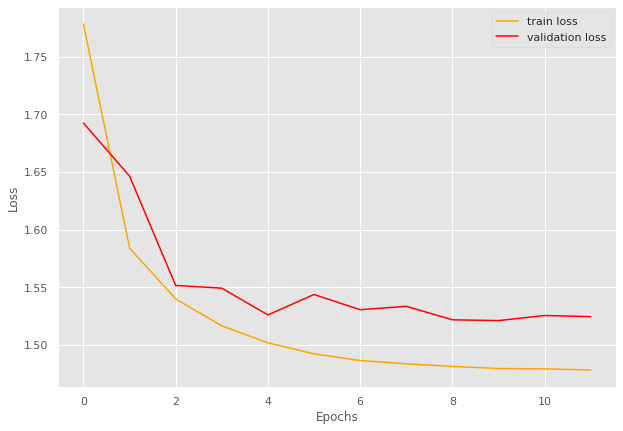

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 20/20 [00:06<00:00,  3.06batch/s, loss=0.98] 


train loss 0.979520606994629, validation loss 0.8064144015312195, validation accuracy 0.9375
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.774]


train loss 0.774440610408783, validation loss 0.7808271884918213, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.95batch/s, loss=0.755]


INFO: Early stopping counter 1 of 5
train loss 0.7545173346996308, validation loss 0.7810275673866272, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.05batch/s, loss=0.755]


train loss 0.7550039231777191, validation loss 0.778307032585144, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.05batch/s, loss=0.756]


INFO: Early stopping counter 2 of 5
train loss 0.7560019493103027, validation loss 0.7798813223838806, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.06batch/s, loss=0.755]


INFO: Early stopping counter 3 of 5
train loss 0.7546688139438629, validation loss 0.7919393658638001, validation accuracy 0.9473684210526315
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.07batch/s, loss=0.757]


INFO: Early stopping counter 4 of 5
train loss 0.7574049860239029, validation loss 0.7795777320861816, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.751]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9715155468580126 and loss 0.7733035998211967


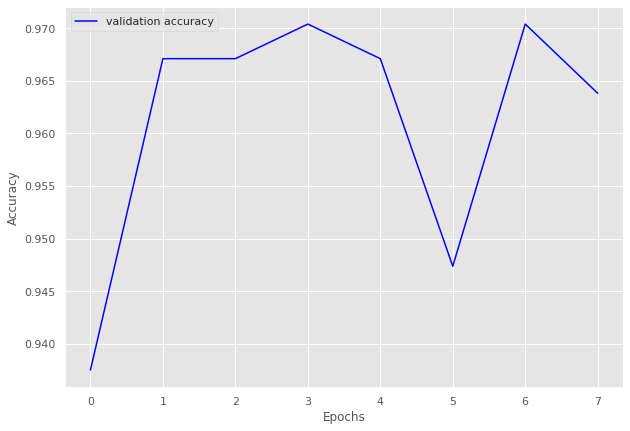

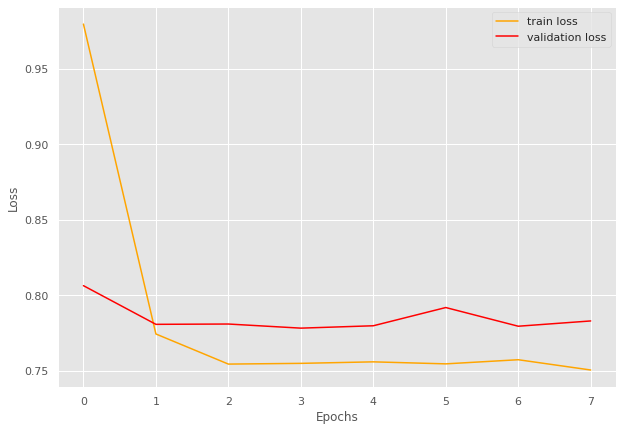

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 19/19 [00:06<00:00,  3.05batch/s, loss=1.49]


train loss 1.487578599076522, validation loss 1.2064983606338502, validation accuracy 0.8793103448275862
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=1.14]


train loss 1.1403000919442428, validation loss 1.1523890495300293, validation accuracy 0.903448275862069
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.06batch/s, loss=1.09]


train loss 1.093513382108588, validation loss 1.1370800495147706, validation accuracy 0.906896551724138
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=1.09]


train loss 1.0862987041473389, validation loss 1.1335577487945556, validation accuracy 0.9172413793103448
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.06batch/s, loss=1.08]


train loss 1.0758726534090544, validation loss 1.1231806993484497, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0683403642554032, validation loss 1.1320050239562989, validation accuracy 0.9103448275862069
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.06batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.071943948143407, validation loss 1.1513238191604613, validation accuracy 0.8931034482758621
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.06batch/s, loss=1.08]


INFO: Early stopping counter 3 of 5
train loss 1.0811432850988287, validation loss 1.1539018869400024, validation accuracy 0.8862068965517241
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.07]


train loss 1.0666022865395797, validation loss 1.122378134727478, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0619508592705977, validation loss 1.1342409610748292, validation accuracy 0.906896551724138
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.04batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9101251422070534 and loss 1.1331492075021716


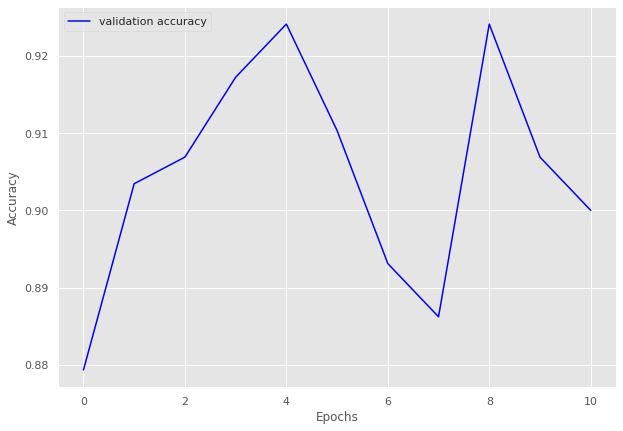

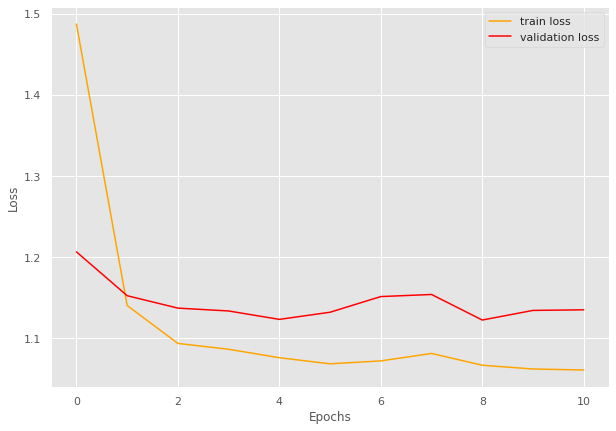

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 17/17 [00:10<00:00,  1.59batch/s, loss=0.771]


train loss 0.7712549847715041, validation loss 0.6541918873786926, validation accuracy 0.9343629343629344
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 17/17 [00:11<00:00,  1.51batch/s, loss=0.608]


train loss 0.6083799460354973, validation loss 0.6117302417755127, validation accuracy 0.9382239382239382
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 17/17 [00:09<00:00,  1.88batch/s, loss=0.59] 


train loss 0.5898792989113751, validation loss 0.592090618610382, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 17/17 [00:11<00:00,  1.50batch/s, loss=0.578]


INFO: Early stopping counter 1 of 5
train loss 0.5779819523586947, validation loss 0.6052513957023621, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 17/17 [00:12<00:00,  1.40batch/s, loss=0.582]


train loss 0.5817496215595919, validation loss 0.5864172339439392, validation accuracy 0.9652509652509652
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 17/17 [00:12<00:00,  1.40batch/s, loss=0.584]


INFO: Early stopping counter 2 of 5
train loss 0.5837166765156914, validation loss 0.5971988439559937, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 17/17 [00:13<00:00,  1.22batch/s, loss=0.576]


INFO: Early stopping counter 3 of 5
train loss 0.575700416284449, validation loss 0.6054221510887146, validation accuracy 0.9613899613899614
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 17/17 [00:12<00:00,  1.39batch/s, loss=0.573]


INFO: Early stopping counter 4 of 5
train loss 0.5726436727187213, validation loss 0.5872865796089173, validation accuracy 0.9613899613899614
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 17/17 [00:10<00:00,  1.58batch/s, loss=0.576]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9412971033068444 and loss 0.6076909958339128


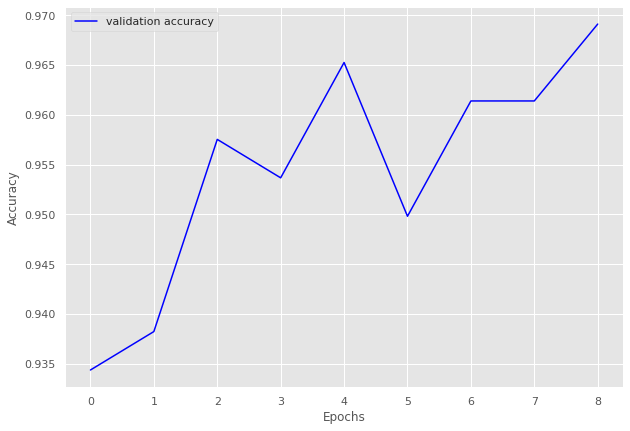

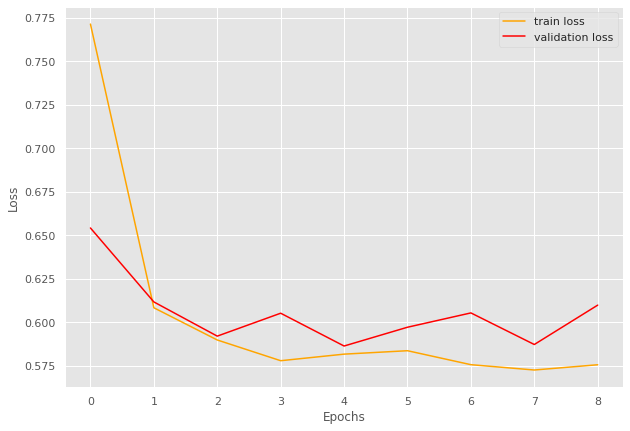

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 38/38 [00:32<00:00,  1.17batch/s, loss=1.27]


train loss 1.2690465544399463, validation loss 1.0915444374084473, validation accuracy 0.9545454545454546
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 38/38 [00:23<00:00,  1.64batch/s, loss=1.1] 


INFO: Early stopping counter 1 of 5
train loss 1.0951753227334273, validation loss 1.096011471748352, validation accuracy 0.9494949494949495
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.99batch/s, loss=1.08]


train loss 1.0773043193315204, validation loss 1.0884252190589905, validation accuracy 0.9562289562289562
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  3.00batch/s, loss=1.08]


INFO: Early stopping counter 2 of 5
train loss 1.0750215586863066, validation loss 1.0981775999069214, validation accuracy 0.9478114478114478
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.99batch/s, loss=1.07]


train loss 1.0676701445328562, validation loss 1.0883049726486207, validation accuracy 0.9562289562289562
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.95batch/s, loss=1.06]


train loss 1.0620591609101546, validation loss 1.0802161812782287, validation accuracy 0.9663299663299664
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.99batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0592348920671564, validation loss 1.0878220915794372, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.98batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0589826044283415, validation loss 1.0913690686225892, validation accuracy 0.9511784511784511
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.99batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9584496816709482 and loss 1.085746932881219


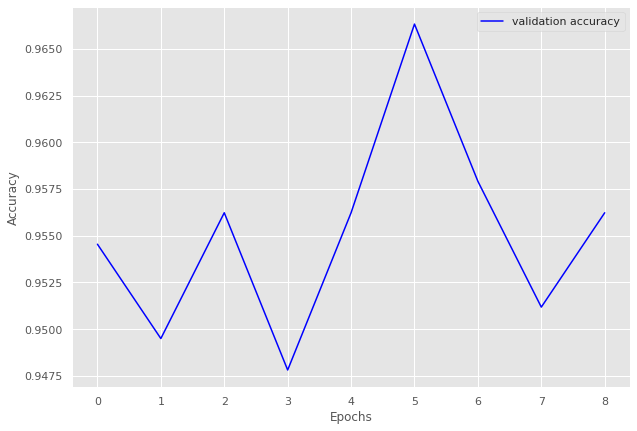

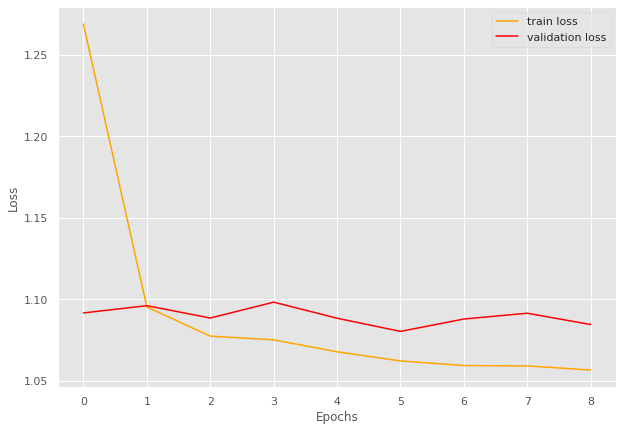

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 19/19 [00:06<00:00,  2.96batch/s, loss=1.02]


train loss 1.0228276127263118, validation loss 0.8313847541809082, validation accuracy 0.9217687074829932
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.01batch/s, loss=0.788]


train loss 0.7878689389479788, validation loss 0.8025223970413208, validation accuracy 0.9455782312925171
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=0.764]


train loss 0.7636055193449321, validation loss 0.7973150134086608, validation accuracy 0.9489795918367347
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.97batch/s, loss=0.758]


train loss 0.7575416878650063, validation loss 0.7963454365730286, validation accuracy 0.9455782312925171
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.97batch/s, loss=0.762]


INFO: Early stopping counter 1 of 5
train loss 0.76223308475394, validation loss 0.8053515911102295, validation accuracy 0.9387755102040817
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=0.756]


train loss 0.7556365822490893, validation loss 0.7928385138511658, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=0.754]


train loss 0.7535991762813768, validation loss 0.7892029285430908, validation accuracy 0.9591836734693877
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.03batch/s, loss=0.751]


INFO: Early stopping counter 2 of 5
train loss 0.7509212462525618, validation loss 0.794823145866394, validation accuracy 0.9421768707482994
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.97batch/s, loss=0.752]


train loss 0.7515115894769367, validation loss 0.7789490461349488, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.97batch/s, loss=0.754]


INFO: Early stopping counter 3 of 5
train loss 0.7535830673418547, validation loss 0.8072521924972534, validation accuracy 0.9251700680272109
Coarse label 15 Epoch 11
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.01batch/s, loss=0.755]


INFO: Early stopping counter 4 of 5
train loss 0.7548088839179591, validation loss 0.800261664390564, validation accuracy 0.9319727891156463
Coarse label 15 Epoch 12
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.97batch/s, loss=0.752]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.955234004069636 and loss 0.7881939019475664


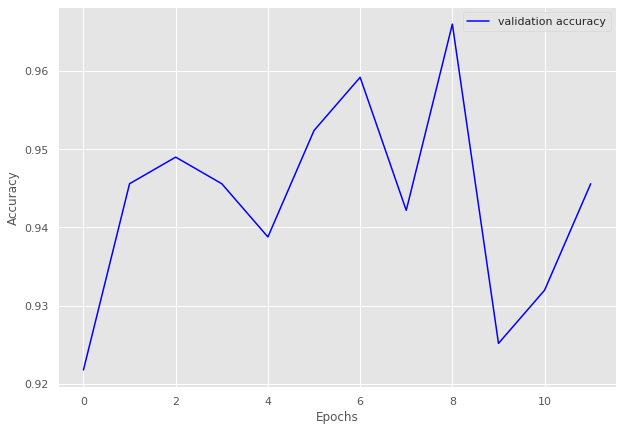

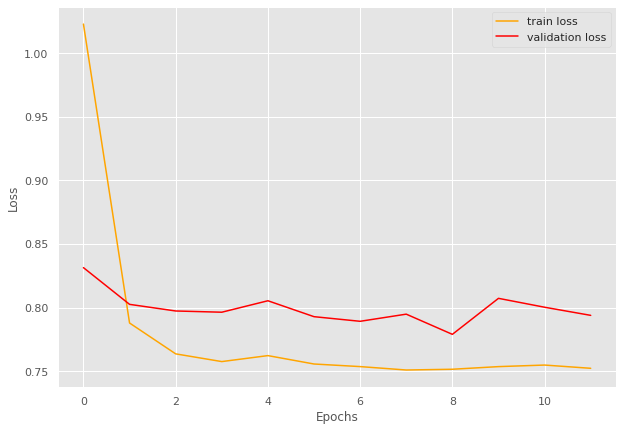

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 18/18 [00:06<00:00,  2.90batch/s, loss=0.762]


train loss 0.7623433801862929, validation loss 0.6232534527778626, validation accuracy 0.9361702127659575
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.92batch/s, loss=0.581]


train loss 0.5813247097863091, validation loss 0.6086780071258545, validation accuracy 0.9361702127659575
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.90batch/s, loss=0.565]


train loss 0.5653011136584811, validation loss 0.6042401790618896, validation accuracy 0.9432624113475178
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.98batch/s, loss=0.565]


INFO: Early stopping counter 1 of 5
train loss 0.5645664433638254, validation loss 0.6145093083381653, validation accuracy 0.9326241134751773
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.99batch/s, loss=0.56] 


INFO: Early stopping counter 2 of 5
train loss 0.5595959656768374, validation loss 0.6166324257850647, validation accuracy 0.9290780141843972
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.95batch/s, loss=0.558]


INFO: Early stopping counter 3 of 5
train loss 0.5576974352200826, validation loss 0.6130653619766235, validation accuracy 0.9361702127659575
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.92batch/s, loss=0.559]


train loss 0.5593925946288638, validation loss 0.5955735564231872, validation accuracy 0.9539007092198581
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.98batch/s, loss=0.559]


INFO: Early stopping counter 4 of 5
train loss 0.5594067341751523, validation loss 0.6053973793983459, validation accuracy 0.9468085106382979
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.99batch/s, loss=0.558]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9472320376914016 and loss 0.6039324954374513


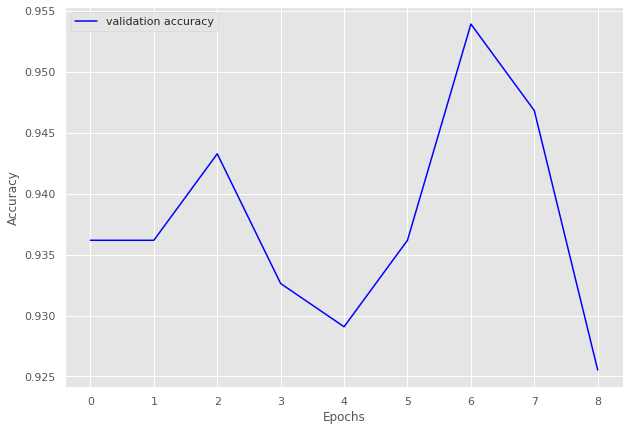

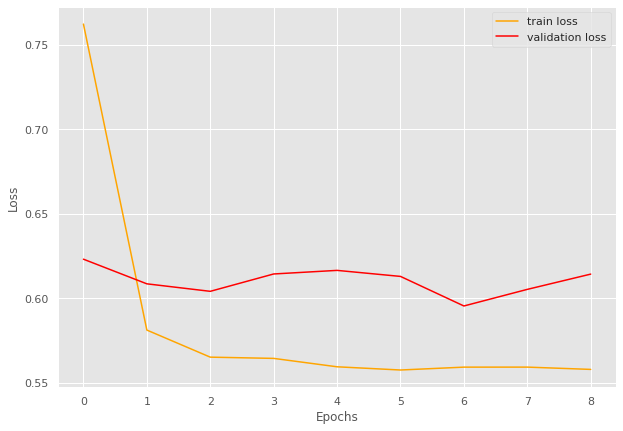

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 20/20 [00:08<00:00,  2.44batch/s, loss=1.02]


train loss 1.020336577296257, validation loss 0.8973320960998535, validation accuracy 0.8414239482200647
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.98batch/s, loss=0.807]


train loss 0.806996637582779, validation loss 0.8461101531982422, validation accuracy 0.8964401294498382
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.01batch/s, loss=0.774]


INFO: Early stopping counter 1 of 5
train loss 0.7741720765829087, validation loss 0.846757972240448, validation accuracy 0.8996763754045307
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.98batch/s, loss=0.765]


INFO: Early stopping counter 2 of 5
train loss 0.7650548756122589, validation loss 0.8501526713371277, validation accuracy 0.8964401294498382
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.76] 


train loss 0.7599522262811661, validation loss 0.8391586065292358, validation accuracy 0.9093851132686084
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.755]


train loss 0.7553861141204834, validation loss 0.8370418548583984, validation accuracy 0.8996763754045307
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.757]


train loss 0.7573340654373169, validation loss 0.8351960182189941, validation accuracy 0.9093851132686084
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.98batch/s, loss=0.755]


train loss 0.7547790348529816, validation loss 0.8335332989692688, validation accuracy 0.8996763754045307
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.98batch/s, loss=0.754]


train loss 0.7536927282810211, validation loss 0.8308894395828247, validation accuracy 0.9093851132686084
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.97batch/s, loss=0.754]


INFO: Early stopping counter 3 of 5
train loss 0.7536620408296585, validation loss 0.8351329565048218, validation accuracy 0.9029126213592233
Coarse label 17 Epoch 11
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.04batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.7513319551944733, validation loss 0.8342525005340576, validation accuracy 0.9093851132686084
Coarse label 17 Epoch 12
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.93batch/s, loss=0.754]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.921969045571797 and loss 0.820623958764011


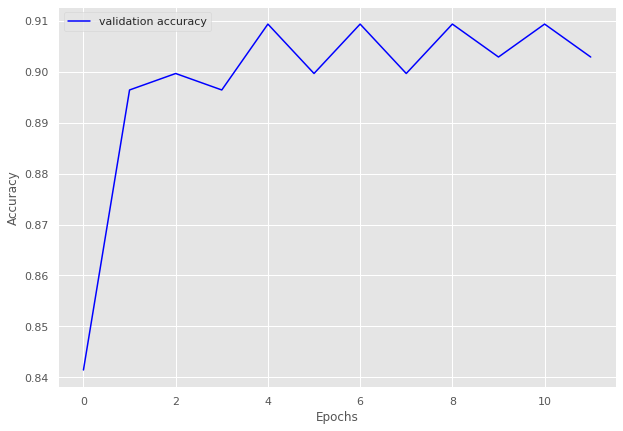

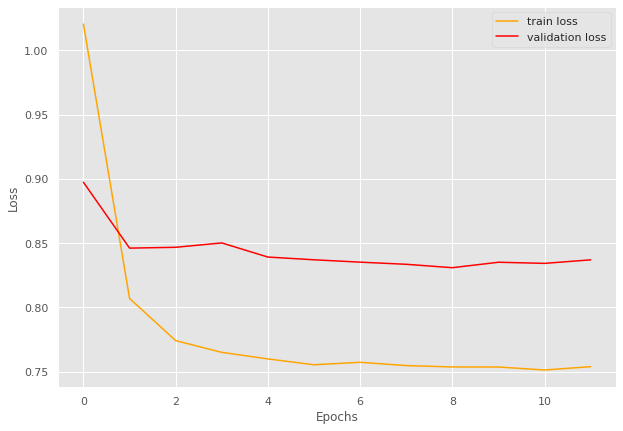

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 7/7 [00:02<00:00,  3.22batch/s, loss=1.22]


train loss 1.221603274345398, validation loss 1.0710179209709167, validation accuracy 0.7083333333333334
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.33batch/s, loss=0.901]


train loss 0.9009601899555751, validation loss 0.9112518131732941, validation accuracy 0.84375
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.30batch/s, loss=0.8]  


train loss 0.799703061580658, validation loss 0.8625508844852448, validation accuracy 0.875
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.32batch/s, loss=0.767]


train loss 0.7673000863620213, validation loss 0.8541789352893829, validation accuracy 0.8854166666666666
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.31batch/s, loss=0.761]


INFO: Early stopping counter 1 of 5
train loss 0.7608106476919991, validation loss 0.8598175942897797, validation accuracy 0.90625
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.36batch/s, loss=0.782]


train loss 0.7821291003908429, validation loss 0.8513995409011841, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.31batch/s, loss=0.78] 


INFO: Early stopping counter 2 of 5
train loss 0.77951580286026, validation loss 0.8722190856933594, validation accuracy 0.8854166666666666
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.34batch/s, loss=0.756]


INFO: Early stopping counter 3 of 5
train loss 0.7562865359442574, validation loss 0.8637582063674927, validation accuracy 0.875
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  2.96batch/s, loss=0.759]


train loss 0.7587505238396781, validation loss 0.846809983253479, validation accuracy 0.8958333333333334
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.15batch/s, loss=0.753]


train loss 0.753174432686397, validation loss 0.8416286408901215, validation accuracy 0.8958333333333334
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.35batch/s, loss=0.746]


train loss 0.7461892196110317, validation loss 0.8401350975036621, validation accuracy 0.8854166666666666
Coarse label 19 Epoch 12
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.33batch/s, loss=0.755]


train loss 0.7549404927662441, validation loss 0.8372351825237274, validation accuracy 0.8958333333333334
Coarse label 19 Epoch 13
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.33batch/s, loss=0.787]


INFO: Early stopping counter 4 of 5
train loss 0.7867139663015094, validation loss 0.8677065372467041, validation accuracy 0.8541666666666666
Coarse label 19 Epoch 14
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.33batch/s, loss=0.82] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.8940217391304348 and loss 0.8498732343963955


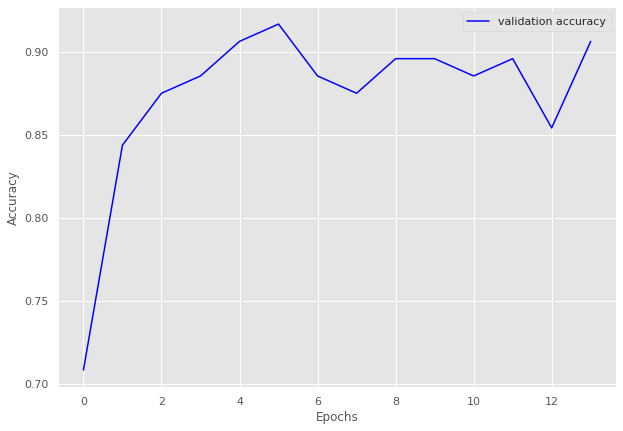

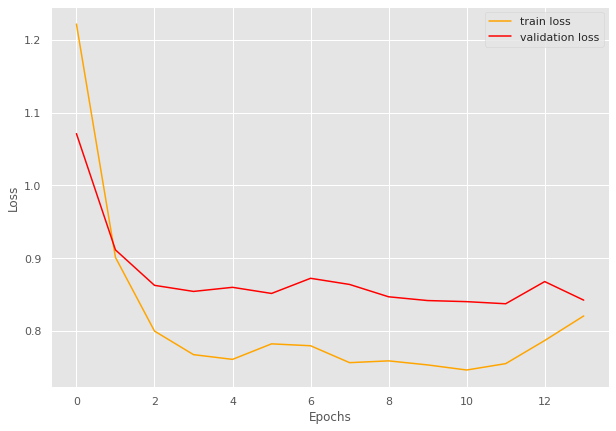

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Calculating for volume 35
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=1.13]


train loss 1.1282064594873569, validation loss 0.957261221749442, validation accuracy 0.9440559440559441
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=0.96] 


train loss 0.9604931212053066, validation loss 0.9566535609109061, validation accuracy 0.951048951048951
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.97batch/s, loss=0.951]


train loss 0.9507531073035264, validation loss 0.9445081523486546, validation accuracy 0.9603729603729604
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.96batch/s, loss=0.94] 


train loss 0.940418822009389, validation loss 0.9437291962759835, validation accuracy 0.9627039627039627
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.96batch/s, loss=0.935]


train loss 0.9354851885539729, validation loss 0.9427444509097508, validation accuracy 0.9627039627039627
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.97batch/s, loss=0.93] 


train loss 0.9304358508528733, validation loss 0.9383419411523002, validation accuracy 0.965034965034965
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.927]


INFO: Early stopping counter 1 of 5
train loss 0.9273887320262629, validation loss 0.9432083538600377, validation accuracy 0.958041958041958
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.93batch/s, loss=0.927]


train loss 0.9270758905061861, validation loss 0.9379638178007943, validation accuracy 0.965034965034965
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=0.924]


train loss 0.924312760190266, validation loss 0.9366383978298732, validation accuracy 0.9673659673659674
Coarse label 0 Epoch 10
-------------------------------


100%|██████████| 41/41 [00:15<00:00,  2.60batch/s, loss=0.924]


INFO: Early stopping counter 2 of 5
train loss 0.9239735908624602, validation loss 0.9416534645216805, validation accuracy 0.9627039627039627
Coarse label 0 Epoch 11
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=0.928]


INFO: Early stopping counter 3 of 5
train loss 0.9279205944479966, validation loss 0.9389898436410087, validation accuracy 0.9627039627039627
Coarse label 0 Epoch 12
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.922]


INFO: Early stopping counter 4 of 5
train loss 0.9217783561566981, validation loss 0.939298118863787, validation accuracy 0.965034965034965
Coarse label 0 Epoch 13
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.926]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9395017793594306 and loss 0.9647132463075898


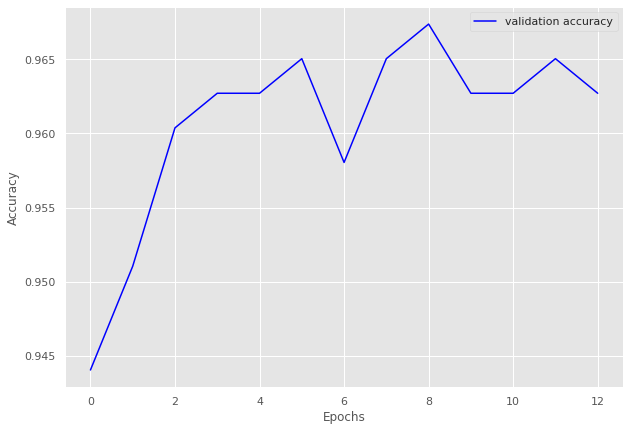

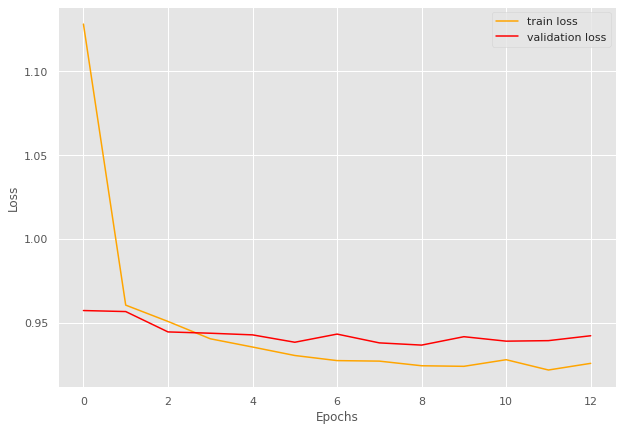

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 18/18 [00:06<00:00,  2.92batch/s, loss=1.37]


train loss 1.3692781262927585, validation loss 1.1804293394088745, validation accuracy 0.8763440860215054
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.93batch/s, loss=1.11]


train loss 1.1076582471529643, validation loss 1.1082547903060913, validation accuracy 0.946236559139785
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.96batch/s, loss=1.08]


train loss 1.0764048828019037, validation loss 1.0933362642923992, validation accuracy 0.956989247311828
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.01batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0591497553719416, validation loss 1.1091010570526123, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0638351572884455, validation loss 1.1051099300384521, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.97batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0547319783104792, validation loss 1.0962949593861897, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.90batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0512469675805833, validation loss 1.097182830174764, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.93batch/s, loss=1.05]


train loss 1.0487784412172105, validation loss 1.0932984352111816, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.98batch/s, loss=1.05]


train loss 1.0501804881625705, validation loss 1.0829774538675945, validation accuracy 0.956989247311828
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.98batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9480997139354311 and loss 1.096582788687486


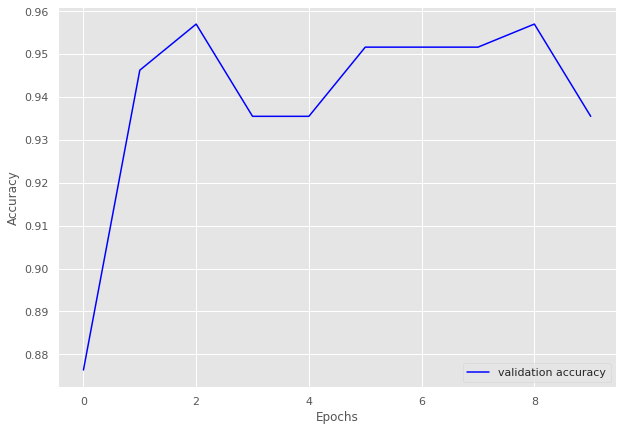

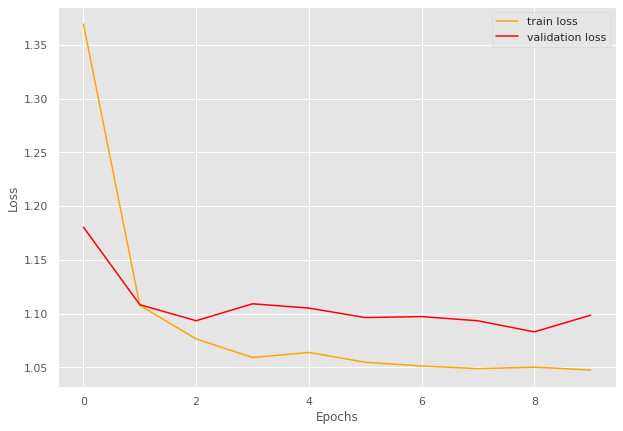

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 83/83 [00:28<00:00,  2.92batch/s, loss=1.72]


train loss 1.719386419617986, validation loss 1.5613244601658411, validation accuracy 0.9080459770114943
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.94batch/s, loss=1.55]


train loss 1.5451010609247597, validation loss 1.5399205684661865, validation accuracy 0.9264367816091954
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.94batch/s, loss=1.53]


train loss 1.5272319690290703, validation loss 1.5170418279511588, validation accuracy 0.9482758620689655
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.93batch/s, loss=1.51]


INFO: Early stopping counter 1 of 5
train loss 1.5097372574978565, validation loss 1.5319381185940333, validation accuracy 0.9333333333333333
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.94batch/s, loss=1.51]


INFO: Early stopping counter 2 of 5
train loss 1.505744534802724, validation loss 1.5329415202140808, validation accuracy 0.9402298850574713
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.95batch/s, loss=1.51]


INFO: Early stopping counter 3 of 5
train loss 1.5108384726995445, validation loss 1.5256393126079015, validation accuracy 0.9356321839080459
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.94batch/s, loss=1.5]


INFO: Early stopping counter 4 of 5
train loss 1.4983768405684506, validation loss 1.5210204465048653, validation accuracy 0.9436781609195403
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.96batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9426315789473684 and loss 1.5191607002439447


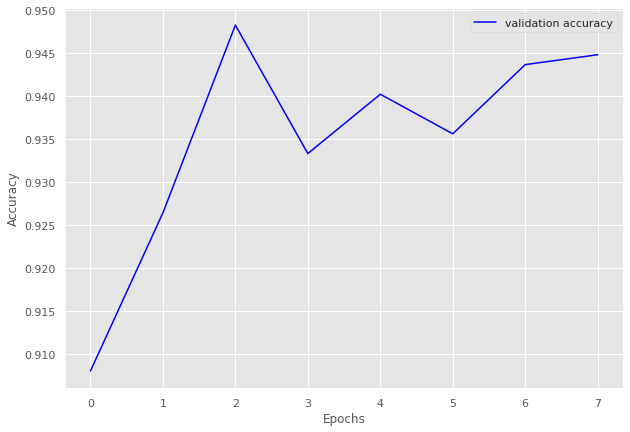

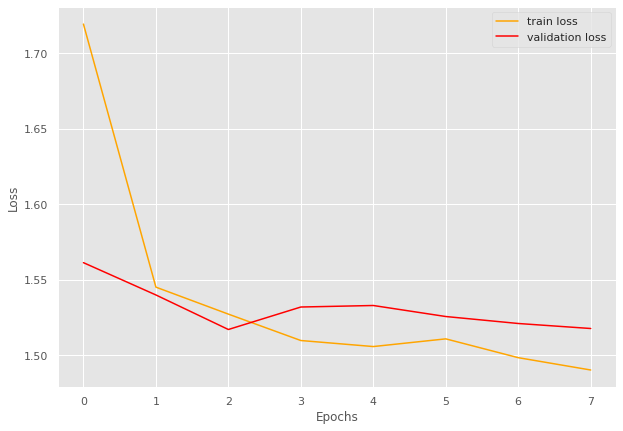

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 39/39 [00:13<00:00,  2.95batch/s, loss=1.33]


train loss 1.333276134270888, validation loss 1.1529182365962438, validation accuracy 0.8980582524271845
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.93batch/s, loss=1.12]


train loss 1.1208920937318068, validation loss 1.127947211265564, validation accuracy 0.9223300970873787
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.94batch/s, loss=1.09]


train loss 1.0907243153987787, validation loss 1.1074032953807287, validation accuracy 0.9393203883495146
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.98batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.080722600985796, validation loss 1.1184962477002824, validation accuracy 0.9247572815533981
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.07]


train loss 1.07478540065961, validation loss 1.1046764510018485, validation accuracy 0.941747572815534
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.96batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0713041990231245, validation loss 1.1092083965029036, validation accuracy 0.9344660194174758
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.07]


train loss 1.0670124414639595, validation loss 1.101018956729344, validation accuracy 0.941747572815534
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.94batch/s, loss=1.06]


train loss 1.0647967839852357, validation loss 1.097679717200143, validation accuracy 0.9441747572815534
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0629243269944801, validation loss 1.0985769033432007, validation accuracy 0.9490291262135923
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.98batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.055778885499025, validation loss 1.1085978235517229, validation accuracy 0.9393203883495146
Coarse label 4 Epoch 11
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9552044609665428 and loss 1.0870331119088565


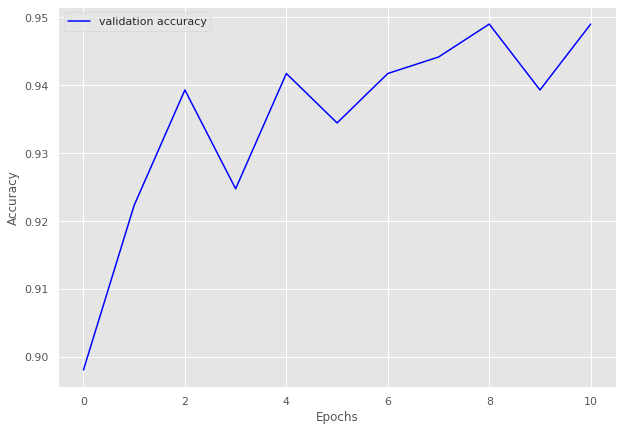

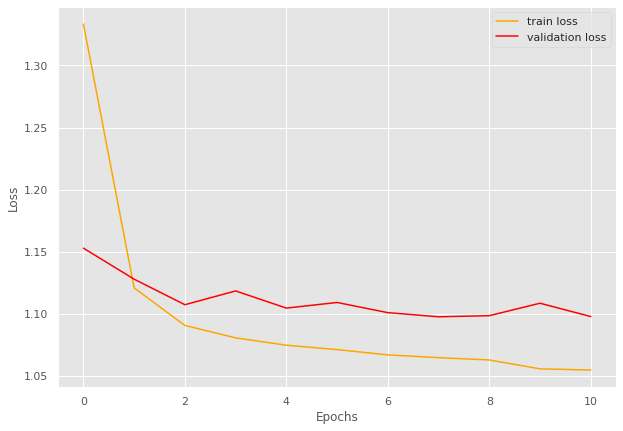

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 15/15 [00:07<00:00,  2.02batch/s, loss=0.443]


train loss 0.4429752628008525, validation loss 0.3321634928385417, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.93batch/s, loss=0.325]


INFO: Early stopping counter 1 of 5
train loss 0.3254173696041107, validation loss 0.3324945867061615, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.91batch/s, loss=0.321]


train loss 0.3208176076412201, validation loss 0.32974644502003986, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.96batch/s, loss=0.318]


train loss 0.31826685468355814, validation loss 0.32816707094510394, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.85batch/s, loss=0.316]


INFO: Early stopping counter 2 of 5
train loss 0.31649067799250286, validation loss 0.332681804895401, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.86batch/s, loss=0.318]


INFO: Early stopping counter 3 of 5
train loss 0.3182073990503947, validation loss 0.3330325086911519, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.67batch/s, loss=0.315]


INFO: Early stopping counter 4 of 5
train loss 0.31536683241526287, validation loss 0.3306635916233063, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.94batch/s, loss=0.315]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.980269489894129 and loss 0.3336581994186748


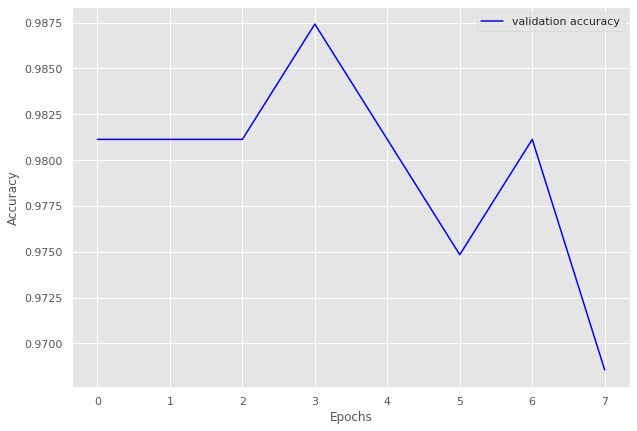

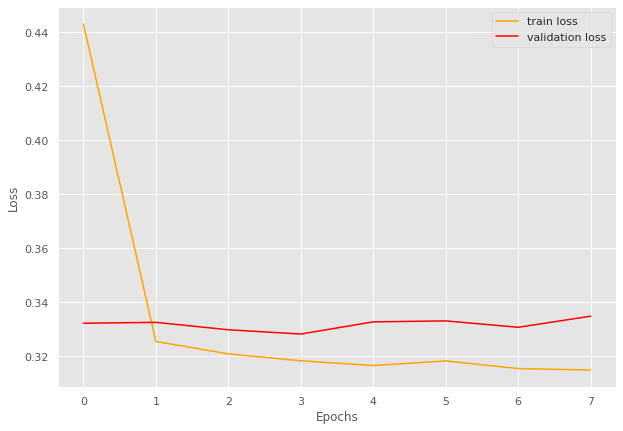

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 44/44 [00:14<00:00,  2.97batch/s, loss=1.42]


train loss 1.4176523062315853, validation loss 1.24355348944664, validation accuracy 0.9202586206896551
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.97batch/s, loss=1.24]


train loss 1.2396106286482378, validation loss 1.2374670952558517, validation accuracy 0.9181034482758621
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.98batch/s, loss=1.21]


train loss 1.2122035189108415, validation loss 1.234955608844757, validation accuracy 0.9267241379310345
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.97batch/s, loss=1.21]


train loss 1.2072410366751931, validation loss 1.2243385910987854, validation accuracy 0.9375
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.95batch/s, loss=1.2] 


train loss 1.2002727633172816, validation loss 1.2160229831933975, validation accuracy 0.9461206896551724
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.94batch/s, loss=1.19]


INFO: Early stopping counter 1 of 5
train loss 1.1921596201983364, validation loss 1.2211217731237411, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.95batch/s, loss=1.19]


INFO: Early stopping counter 2 of 5
train loss 1.190379424528642, validation loss 1.2304121255874634, validation accuracy 0.9245689655172413
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.94batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1928274577314204, validation loss 1.2233056724071503, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 44/44 [00:15<00:00,  2.93batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1925951106981798, validation loss 1.2165317386388779, validation accuracy 0.9418103448275862
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 44/44 [00:15<00:00,  2.92batch/s, loss=1.19]


train loss 1.1928162195465781, validation loss 1.2110666781663895, validation accuracy 0.9482758620689655
Coarse label 6 Epoch 11
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.94batch/s, loss=1.2] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9295241231681212 and loss 1.2358770797127172


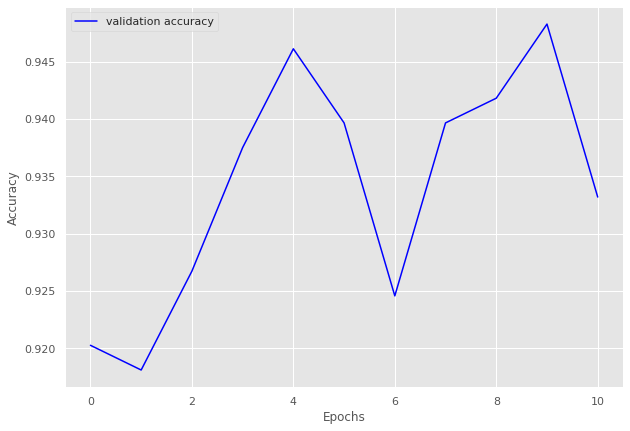

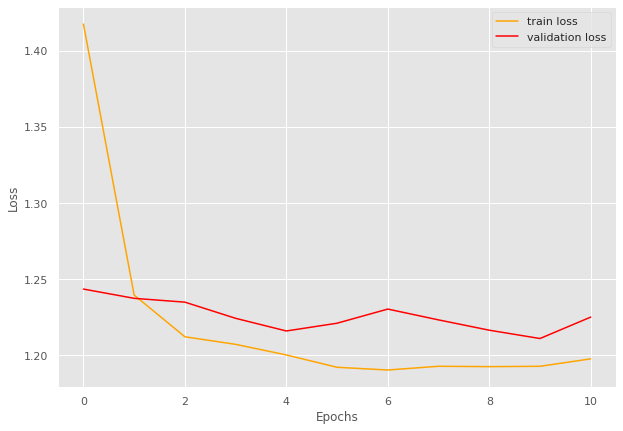

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 35/35 [00:17<00:00,  2.02batch/s, loss=0.891]


train loss 0.8909345814159938, validation loss 0.7905061145623525, validation accuracy 0.9559228650137741
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 35/35 [00:20<00:00,  1.75batch/s, loss=0.768]


train loss 0.7679959229060582, validation loss 0.7757012844085693, validation accuracy 0.9724517906336089
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 35/35 [00:25<00:00,  1.39batch/s, loss=0.761]


train loss 0.7614536302430289, validation loss 0.7694264352321625, validation accuracy 0.977961432506887
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 35/35 [00:26<00:00,  1.34batch/s, loss=0.757]


INFO: Early stopping counter 1 of 5
train loss 0.7574307220322746, validation loss 0.772576779127121, validation accuracy 0.9724517906336089
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 35/35 [00:25<00:00,  1.35batch/s, loss=0.755]


INFO: Early stopping counter 2 of 5
train loss 0.7554349933351789, validation loss 0.7724218865235647, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 35/35 [00:20<00:00,  1.68batch/s, loss=0.754]


train loss 0.7536344085420881, validation loss 0.763709157705307, validation accuracy 0.9834710743801653
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 35/35 [00:28<00:00,  1.24batch/s, loss=0.757]


INFO: Early stopping counter 3 of 5
train loss 0.7566714354923794, validation loss 0.7689267992973328, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 35/35 [00:26<00:00,  1.35batch/s, loss=0.756]


INFO: Early stopping counter 4 of 5
train loss 0.7557196668216161, validation loss 0.7719301482041677, validation accuracy 0.9724517906336089
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.98batch/s, loss=0.752]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9697033452556281 and loss 0.7740696438153585


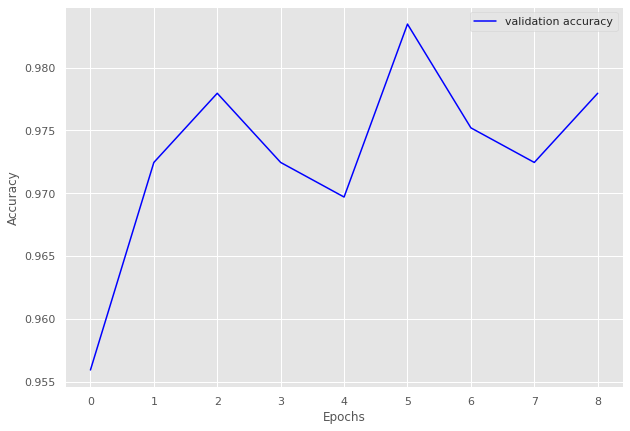

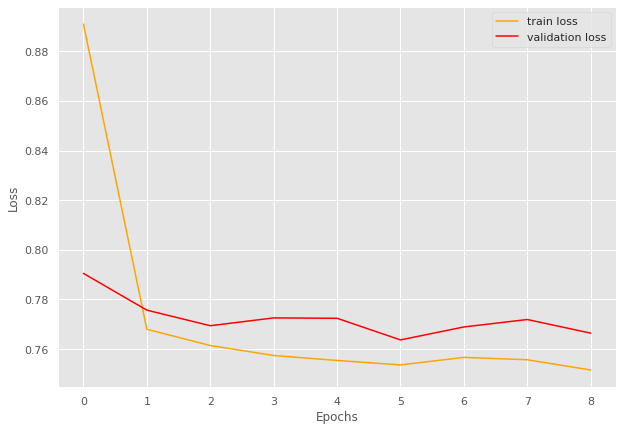

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 49/49 [00:16<00:00,  2.93batch/s, loss=1.44]


train loss 1.4407954313317124, validation loss 1.2638987004756927, validation accuracy 0.9099804305283757
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=1.24]


train loss 1.2393524768401165, validation loss 1.2453561425209045, validation accuracy 0.923679060665362
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.90batch/s, loss=1.21]


INFO: Early stopping counter 1 of 5
train loss 1.2139874283148318, validation loss 1.2471110224723816, validation accuracy 0.9217221135029354
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.93batch/s, loss=1.21]


INFO: Early stopping counter 2 of 5
train loss 1.20548186983381, validation loss 1.2562166303396225, validation accuracy 0.9060665362035225
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 49/49 [00:17<00:00,  2.88batch/s, loss=1.21]


train loss 1.205167539265691, validation loss 1.2416058033704758, validation accuracy 0.9275929549902152
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.90batch/s, loss=1.21]


INFO: Early stopping counter 3 of 5
train loss 1.2050521252106647, validation loss 1.2511079013347626, validation accuracy 0.9158512720156555
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=1.2] 


train loss 1.1955870730536324, validation loss 1.2274609953165054, validation accuracy 0.9393346379647749
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.92batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1893105750181237, validation loss 1.234844520688057, validation accuracy 0.9315068493150684
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=1.2] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9300584094653287 and loss 1.2358131272452217


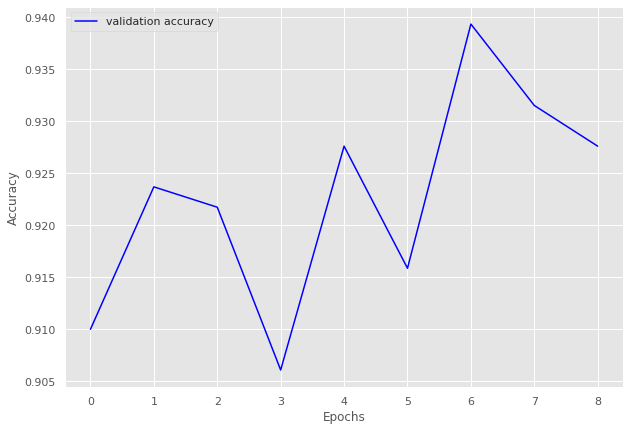

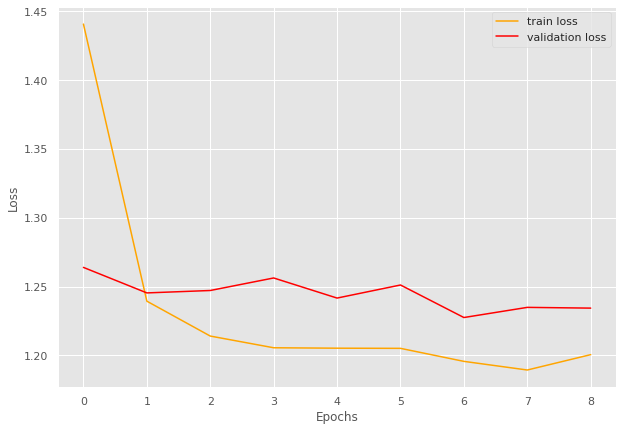

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 61/61 [00:21<00:00,  2.90batch/s, loss=1.76]


train loss 1.755214108795416, validation loss 1.6674690680070356, validation accuracy 0.8549382716049383
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.88batch/s, loss=1.57]


train loss 1.5726979658251903, validation loss 1.5326141769235784, validation accuracy 0.9367283950617284
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 61/61 [00:20<00:00,  2.92batch/s, loss=1.52]


train loss 1.5183698994214418, validation loss 1.5231605984947898, validation accuracy 0.9351851851851852
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 61/61 [00:20<00:00,  2.91batch/s, loss=1.5] 


train loss 1.5028397509309113, validation loss 1.5139867175709119, validation accuracy 0.9444444444444444
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.85batch/s, loss=1.5] 


train loss 1.4982499763613841, validation loss 1.508391878821633, validation accuracy 0.9506172839506173
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.90batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4888951719784347, validation loss 1.5318945754658093, validation accuracy 0.9351851851851852
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.90batch/s, loss=1.49]


train loss 1.4888696006087005, validation loss 1.5039262121373957, validation accuracy 0.9552469135802469
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.88batch/s, loss=1.48]


INFO: Early stopping counter 2 of 5
train loss 1.4832435455478605, validation loss 1.5082935311577537, validation accuracy 0.9537037037037037
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.90batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4788780740050018, validation loss 1.5204546885056929, validation accuracy 0.9475308641975309
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.88batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4787340535492193, validation loss 1.516867377541282, validation accuracy 0.9429012345679012
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.90batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9427625354777672 and loss 1.5215645490732408


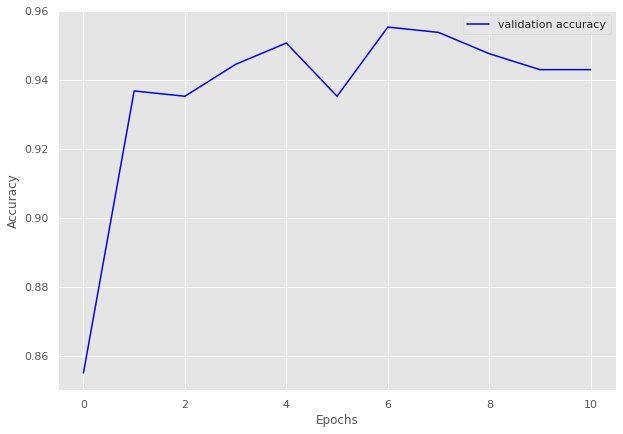

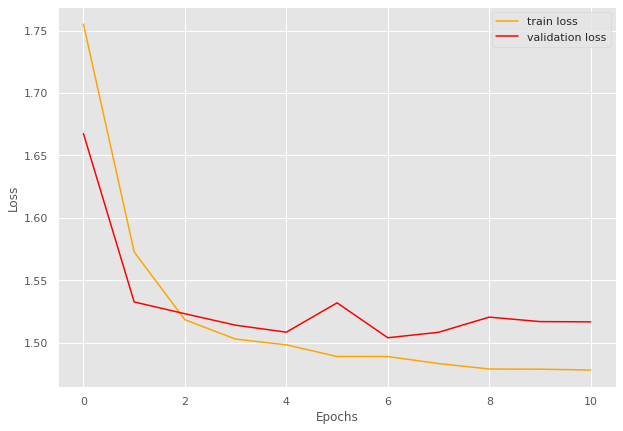

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 29/29 [00:09<00:00,  2.98batch/s, loss=0.91] 


train loss 0.9102379515253264, validation loss 0.7962350249290466, validation accuracy 0.944078947368421
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.95batch/s, loss=0.769]


train loss 0.7687601590978688, validation loss 0.7837329030036926, validation accuracy 0.9572368421052632
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.96batch/s, loss=0.763]


train loss 0.7632415993460293, validation loss 0.781779158115387, validation accuracy 0.9605263157894737
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.93batch/s, loss=0.755]


train loss 0.7546193558594276, validation loss 0.7758051872253418, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.96batch/s, loss=0.754]


INFO: Early stopping counter 1 of 5
train loss 0.7535271952892172, validation loss 0.7800208568572998, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.93batch/s, loss=0.753]


train loss 0.7534883125074978, validation loss 0.7741558313369751, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.94batch/s, loss=0.753]


INFO: Early stopping counter 2 of 5
train loss 0.7526615200371578, validation loss 0.7776708960533142, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.93batch/s, loss=0.749]


train loss 0.7489541686814407, validation loss 0.7730810523033143, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.94batch/s, loss=0.75] 


INFO: Early stopping counter 3 of 5
train loss 0.7498077400799456, validation loss 0.7784639596939087, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 10
-------------------------------


100%|██████████| 29/29 [00:10<00:00,  2.89batch/s, loss=0.756]


INFO: Early stopping counter 4 of 5
train loss 0.7564815611674868, validation loss 0.774532699584961, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 11
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.96batch/s, loss=0.753]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9719016557952835 and loss 0.7726029838834491


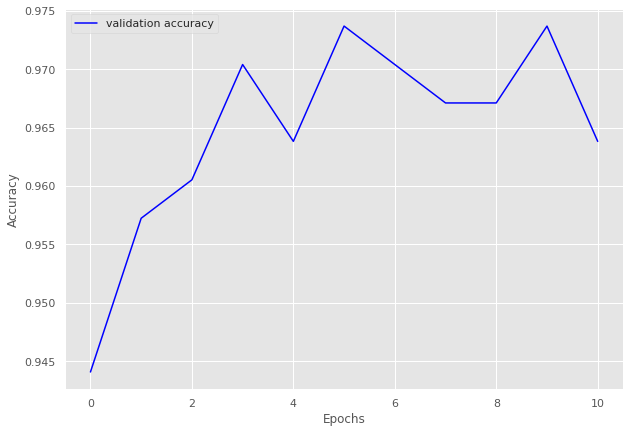

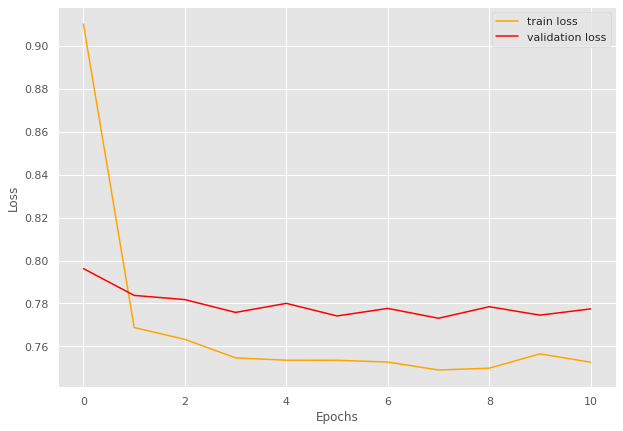

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.39]


train loss 1.3907263151236944, validation loss 1.1523293018341065, validation accuracy 0.9
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.13]


train loss 1.134336680173874, validation loss 1.1255608797073364, validation accuracy 0.9172413793103448
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.02batch/s, loss=1.11]


train loss 1.1055415528161185, validation loss 1.1169689178466797, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.09]


train loss 1.089929176228387, validation loss 1.103558850288391, validation accuracy 0.9379310344827586
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.01batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.0805314183235168, validation loss 1.1101061344146728, validation accuracy 0.9310344827586207
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.00batch/s, loss=1.08]


INFO: Early stopping counter 2 of 5
train loss 1.0772911650793893, validation loss 1.105898642539978, validation accuracy 0.9310344827586207
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0702048199517387, validation loss 1.1192250013351441, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.07]


train loss 1.0713302833693368, validation loss 1.0958959341049195, validation accuracy 0.9517241379310345
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.00batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.0655821987560816, validation loss 1.0975283145904542, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.07]


train loss 1.066116682120732, validation loss 1.0952802896499634, validation accuracy 0.9482758620689655
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.07]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9273156651797428 and loss 1.1166974425315856


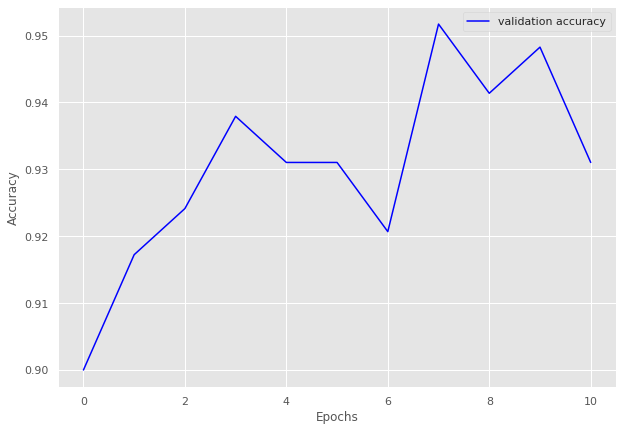

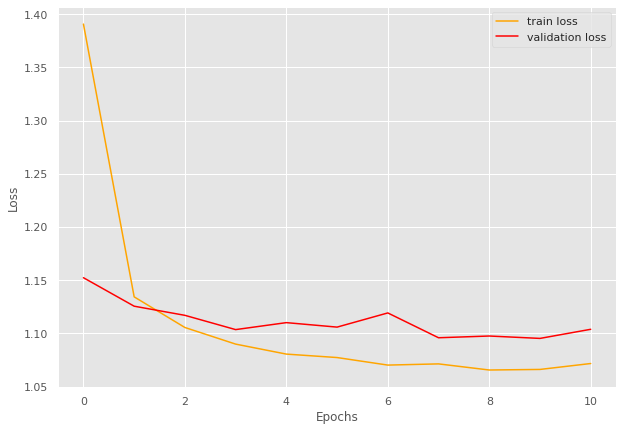

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 25/25 [00:08<00:00,  3.03batch/s, loss=0.709]


train loss 0.7090262055397034, validation loss 0.6038577914237976, validation accuracy 0.9266409266409267
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.03batch/s, loss=0.599]


train loss 0.599407639503479, validation loss 0.6029428005218506, validation accuracy 0.9613899613899614
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.02batch/s, loss=0.587]


train loss 0.5868231058120728, validation loss 0.5909877896308899, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.00batch/s, loss=0.578]


train loss 0.5782070684432984, validation loss 0.5873741984367371, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.01batch/s, loss=0.571]


INFO: Early stopping counter 1 of 5
train loss 0.5707467699050903, validation loss 0.596644651889801, validation accuracy 0.9382239382239382
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.95batch/s, loss=0.569]


train loss 0.5686921596527099, validation loss 0.5799111247062683, validation accuracy 0.9652509652509652
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.96batch/s, loss=0.565]


train loss 0.5654193687438965, validation loss 0.5723031759262085, validation accuracy 0.9806949806949807
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.00batch/s, loss=0.566]


INFO: Early stopping counter 2 of 5
train loss 0.5658090782165527, validation loss 0.5794237375259399, validation accuracy 0.9691119691119691
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.01batch/s, loss=0.565]


INFO: Early stopping counter 3 of 5
train loss 0.5654375863075256, validation loss 0.6341533303260803, validation accuracy 0.9691119691119691
Coarse label 13 Epoch 10
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.97batch/s, loss=0.562]


INFO: Early stopping counter 4 of 5
train loss 0.5624487566947937, validation loss 0.5729680299758911, validation accuracy 0.972972972972973
Coarse label 13 Epoch 11
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.96batch/s, loss=0.56] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9512123004139562 and loss 0.5977444018957749


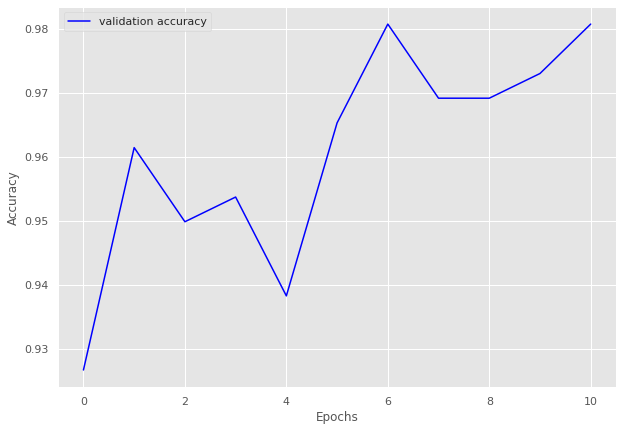

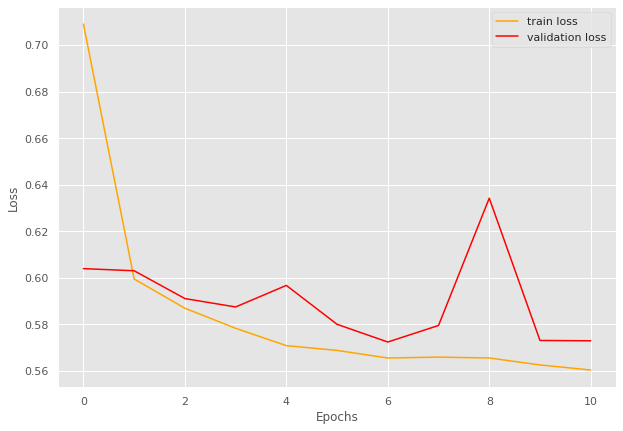

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 56/56 [00:19<00:00,  2.81batch/s, loss=1.22]


train loss 1.2171077174799783, validation loss 1.0881854176521302, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.92batch/s, loss=1.09]


train loss 1.0851838141679764, validation loss 1.0791573405265809, validation accuracy 0.9713804713804713
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.94batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0745256372860499, validation loss 1.0810946583747865, validation accuracy 0.9663299663299664
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.94batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0687248132058553, validation loss 1.0857970237731933, validation accuracy 0.9612794612794613
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.95batch/s, loss=1.07]


train loss 1.0685345019612993, validation loss 1.0699657917022705, validation accuracy 0.9781144781144782
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.92batch/s, loss=1.06]


train loss 1.0584763863256998, validation loss 1.0690780997276306, validation accuracy 0.9781144781144782
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.92batch/s, loss=1.06]


train loss 1.0562636575528555, validation loss 1.0594794034957886, validation accuracy 0.9831649831649831
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.93batch/s, loss=1.06]


train loss 1.0552133598497935, validation loss 1.059128999710083, validation accuracy 0.9814814814814815
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.94batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0534150621720724, validation loss 1.0660729169845582, validation accuracy 0.9747474747474747
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.93batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0546116403170995, validation loss 1.0647293090820313, validation accuracy 0.9764309764309764
Coarse label 14 Epoch 11
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.964566421852854 and loss 1.0791080349781474


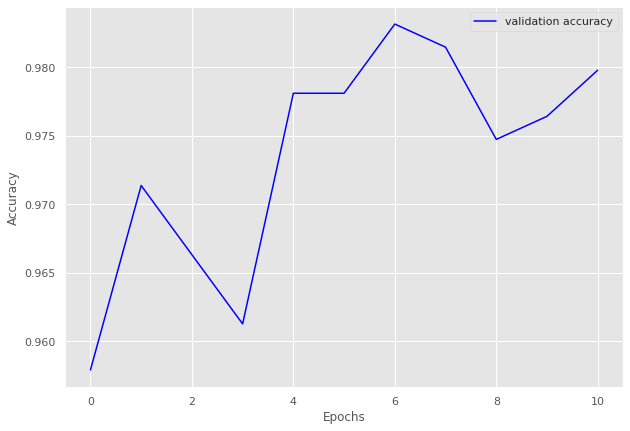

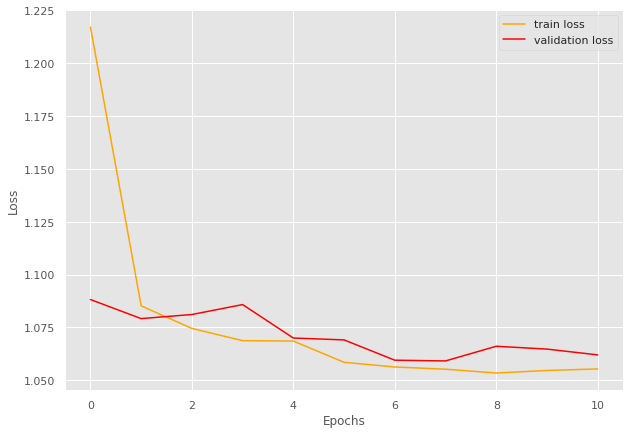

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 28/28 [00:11<00:00,  2.52batch/s, loss=0.971]


train loss 0.9712049982377461, validation loss 0.8034024477005005, validation accuracy 0.9421768707482994
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=0.774]


train loss 0.7739970449890409, validation loss 0.7945634841918945, validation accuracy 0.9455782312925171
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=0.758]


INFO: Early stopping counter 1 of 5
train loss 0.7575086546795708, validation loss 0.7970462799072265, validation accuracy 0.9455782312925171
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=0.753]


INFO: Early stopping counter 2 of 5
train loss 0.7532153981072562, validation loss 0.8107122778892517, validation accuracy 0.9319727891156463
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=0.759]


train loss 0.7588730539594378, validation loss 0.7876534342765809, validation accuracy 0.95578231292517
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=0.752]


INFO: Early stopping counter 3 of 5
train loss 0.7521089379276548, validation loss 0.7914750933647156, validation accuracy 0.9455782312925171
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=0.748]


train loss 0.7479497343301773, validation loss 0.7776807546615601, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=0.752]


INFO: Early stopping counter 4 of 5
train loss 0.7516590825148991, validation loss 0.7860888123512269, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=0.749]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9593114241001565 and loss 0.7827597151199976


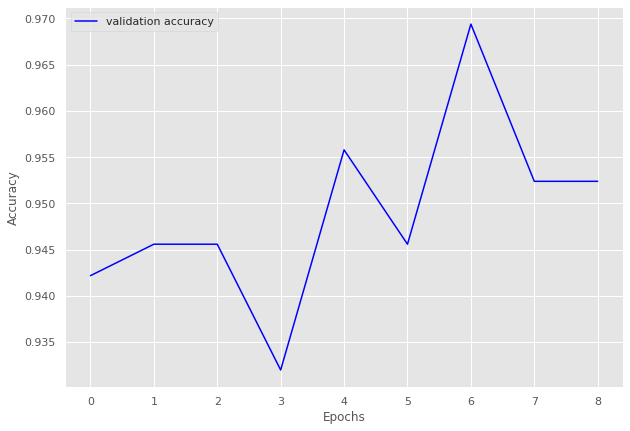

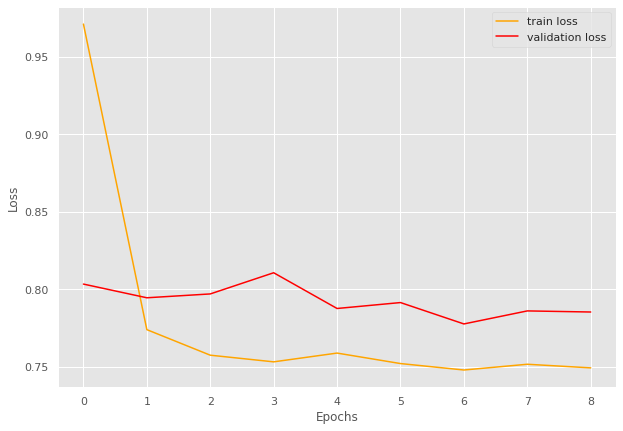

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 27/27 [00:09<00:00,  2.93batch/s, loss=0.724]


train loss 0.7235152809708206, validation loss 0.5950642228126526, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.97batch/s, loss=0.582]


INFO: Early stopping counter 1 of 5
train loss 0.5816734565628899, validation loss 0.6256053805351257, validation accuracy 0.950354609929078
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.97batch/s, loss=0.574]


train loss 0.5735930270618863, validation loss 0.5919067025184631, validation accuracy 0.9787234042553191
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 27/27 [00:08<00:00,  3.01batch/s, loss=0.564]


INFO: Early stopping counter 2 of 5
train loss 0.5638804744791102, validation loss 0.6072452664375305, validation accuracy 0.9609929078014184
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.98batch/s, loss=0.564]


INFO: Early stopping counter 3 of 5
train loss 0.5636620764379148, validation loss 0.6172991633415222, validation accuracy 0.9468085106382979
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.97batch/s, loss=0.559]


INFO: Early stopping counter 4 of 5
train loss 0.5591420707879243, validation loss 0.6053653836250306, validation accuracy 0.950354609929078
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.95batch/s, loss=0.557]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9681978798586572 and loss 0.5821618324723737


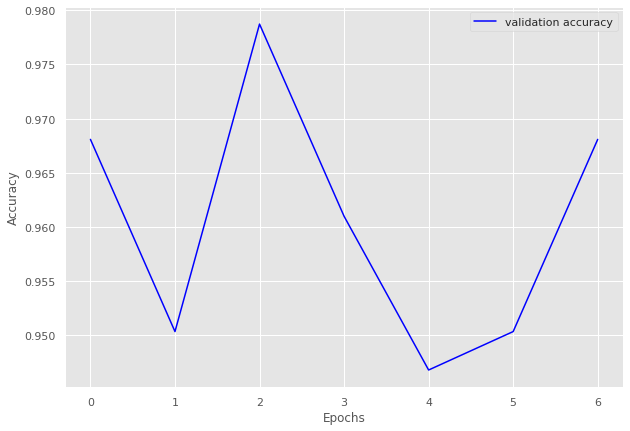

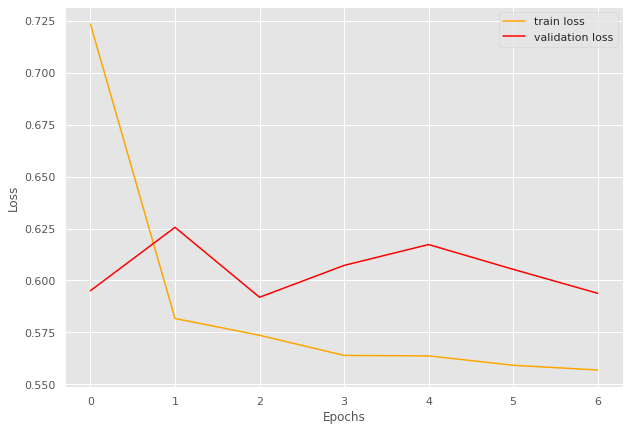

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.98] 


train loss 0.979567927122116, validation loss 0.8649388790130615, validation accuracy 0.8802588996763754
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.97batch/s, loss=0.806]


train loss 0.8063620169957478, validation loss 0.8310513496398926, validation accuracy 0.9158576051779935
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.82batch/s, loss=0.774]


train loss 0.7742019553979238, validation loss 0.8230401873588562, validation accuracy 0.919093851132686
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.777]


train loss 0.7771899660428365, validation loss 0.8169317126274109, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.00batch/s, loss=0.78] 


train loss 0.7800713817278544, validation loss 0.8152300953865051, validation accuracy 0.9352750809061489
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=0.768]


INFO: Early stopping counter 1 of 5
train loss 0.7677189866701762, validation loss 0.8214554190635681, validation accuracy 0.9223300970873787
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.791]


INFO: Early stopping counter 2 of 5
train loss 0.7910101274649303, validation loss 0.8254217863082886, validation accuracy 0.919093851132686
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.764]


INFO: Early stopping counter 3 of 5
train loss 0.76407484014829, validation loss 0.8263237953186036, validation accuracy 0.9158576051779935
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  3.00batch/s, loss=0.777]


INFO: Early stopping counter 4 of 5
train loss 0.7766550421714783, validation loss 0.8224527716636658, validation accuracy 0.9223300970873787
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  3.00batch/s, loss=0.764]


train loss 0.7635952373345692, validation loss 0.8091317296028138, validation accuracy 0.9385113268608414
Coarse label 17 Epoch 11
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.00batch/s, loss=0.757]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9412202380952381 and loss 0.8030178906425597


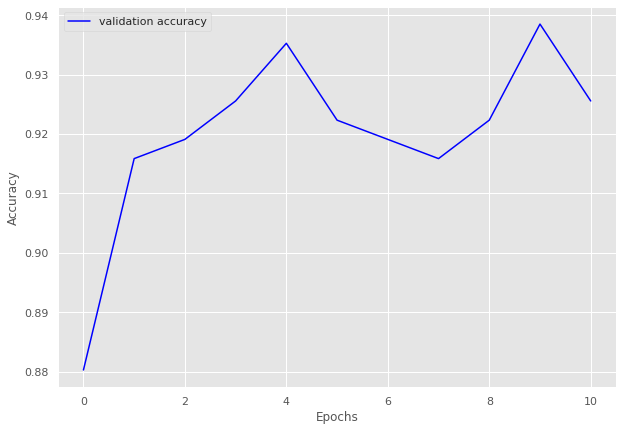

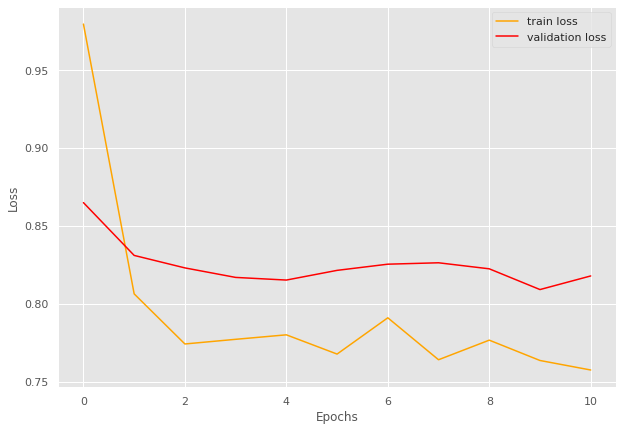

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 10/10 [00:03<00:00,  3.06batch/s, loss=1.14]


train loss 1.1425970077514649, validation loss 0.9728381335735321, validation accuracy 0.78125
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.16batch/s, loss=0.863]


train loss 0.8632172882556916, validation loss 0.8571751117706299, validation accuracy 0.875
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.792]


train loss 0.7924168825149536, validation loss 0.8374280631542206, validation accuracy 0.9375
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=0.77]


train loss 0.7698155641555786, validation loss 0.8321648836135864, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.20batch/s, loss=0.752]


train loss 0.7520585358142853, validation loss 0.8032475411891937, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.75]


INFO: Early stopping counter 1 of 5
train loss 0.7499561131000518, validation loss 0.8080754280090332, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.755]


INFO: Early stopping counter 2 of 5
train loss 0.7545439004898071, validation loss 0.8087407052516937, validation accuracy 0.9375
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.749]


INFO: Early stopping counter 3 of 5
train loss 0.7485517024993896, validation loss 0.8146423101425171, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.76]


INFO: Early stopping counter 4 of 5
train loss 0.7598546504974365, validation loss 0.8045142590999603, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.75]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9333855799373041 and loss 0.8149941951036453


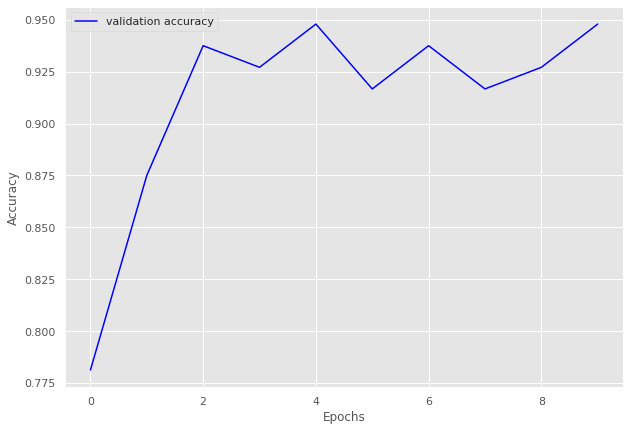

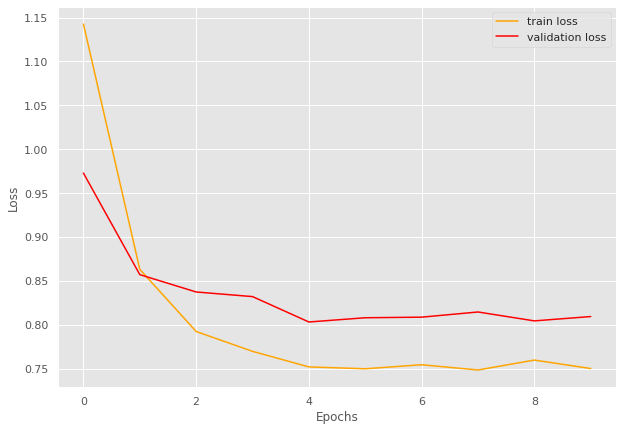

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Calculating for volume 55
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=1.07]


train loss 1.0709254136856865, validation loss 0.9474741050175258, validation accuracy 0.9603729603729604
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.94batch/s, loss=0.957]


train loss 0.9565791066955117, validation loss 0.9400462337902614, validation accuracy 0.9627039627039627
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.949]


train loss 0.9489579472471686, validation loss 0.9322446925299508, validation accuracy 0.9696969696969697
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.942]


INFO: Early stopping counter 1 of 5
train loss 0.9423290052834679, validation loss 0.9322682874543327, validation accuracy 0.9696969696969697
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.86batch/s, loss=0.936]


INFO: Early stopping counter 2 of 5
train loss 0.9364622918998494, validation loss 0.9325198616300311, validation accuracy 0.972027972027972
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.90batch/s, loss=0.933]


INFO: Early stopping counter 3 of 5
train loss 0.9330490476944867, validation loss 0.9411367859159198, validation accuracy 0.9603729603729604
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.931]


INFO: Early stopping counter 4 of 5
train loss 0.9309685274082071, validation loss 0.9341064180646624, validation accuracy 0.9696969696969697
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.934]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9524788081171334 and loss 0.9526900209364344


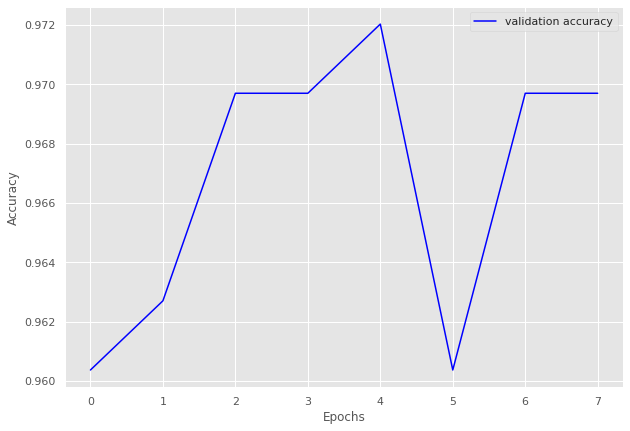

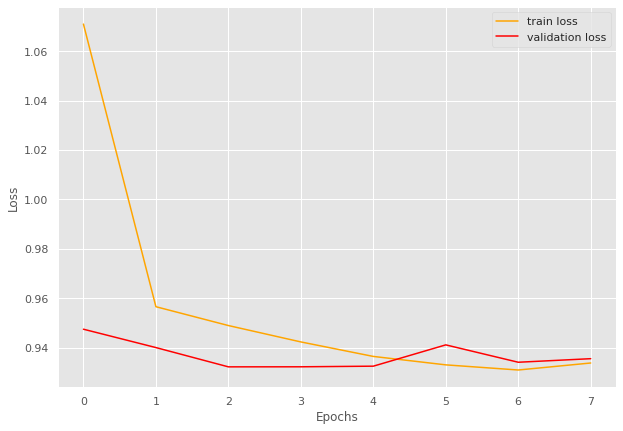

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=1.28]


train loss 1.281969916820526, validation loss 1.1283026536305745, validation accuracy 0.9193548387096774
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.96batch/s, loss=1.1] 


train loss 1.096085544427236, validation loss 1.094358762105306, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.97batch/s, loss=1.07]


train loss 1.0738430420557659, validation loss 1.0788740714391072, validation accuracy 0.9731182795698925
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.95batch/s, loss=1.06]


train loss 1.0613996187845867, validation loss 1.0733834902445476, validation accuracy 0.9731182795698925
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.06]


train loss 1.0577231089274088, validation loss 1.0721558332443237, validation accuracy 0.9731182795698925
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.96batch/s, loss=1.06]


train loss 1.060561430454254, validation loss 1.0684937636057537, validation accuracy 0.978494623655914
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0555204113324483, validation loss 1.07339608669281, validation accuracy 0.9731182795698925
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0591835419336955, validation loss 1.0759385029474895, validation accuracy 0.967741935483871
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.051716677347819, validation loss 1.0843931039174397, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.05]


train loss 1.0511868635813395, validation loss 1.0677822430928547, validation accuracy 0.9838709677419355
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0486232161521911, validation loss 1.07106347878774, validation accuracy 0.978494623655914
Coarse label 1 Epoch 12
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9681603773584906 and loss 1.0779054783008717


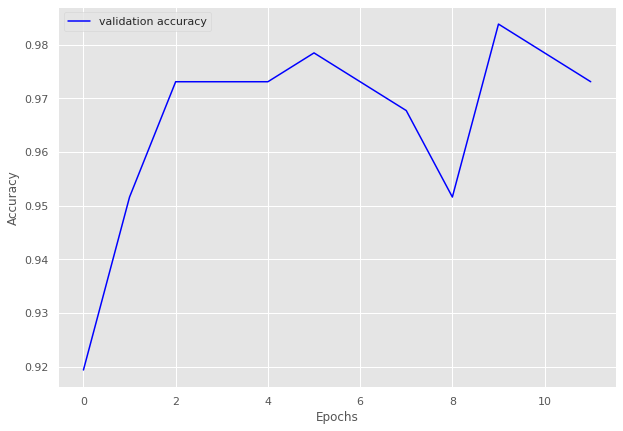

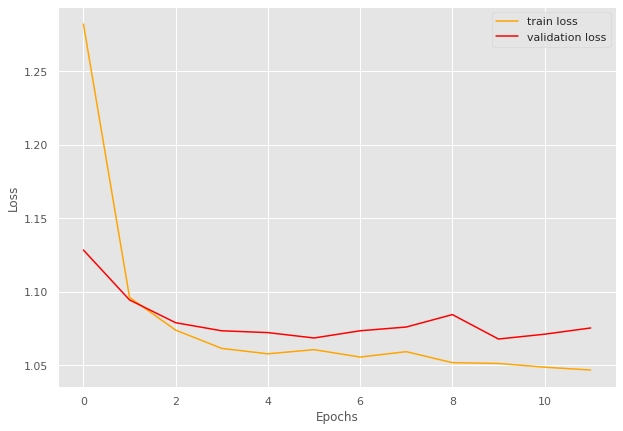

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 137/137 [00:47<00:00,  2.89batch/s, loss=1.66]


train loss 1.6569573974957432, validation loss 1.5515847206115723, validation accuracy 0.9126436781609195
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.90batch/s, loss=1.53]


train loss 1.5313735452011554, validation loss 1.5198997259140015, validation accuracy 0.9459770114942528
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.90batch/s, loss=1.52]


train loss 1.5170883549390919, validation loss 1.5177249227251326, validation accuracy 0.9471264367816092
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.51]


INFO: Early stopping counter 1 of 5
train loss 1.5107325097940263, validation loss 1.524760706084115, validation accuracy 0.9413793103448276
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 137/137 [00:53<00:00,  2.58batch/s, loss=1.5]


INFO: Early stopping counter 2 of 5
train loss 1.5015401735793066, validation loss 1.5183172907148088, validation accuracy 0.9459770114942528
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.4940396477706241, validation loss 1.521737618105752, validation accuracy 0.9425287356321839
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 137/137 [00:46<00:00,  2.92batch/s, loss=1.5] 


INFO: Early stopping counter 4 of 5
train loss 1.495842972811121, validation loss 1.5218746066093445, validation accuracy 0.9425287356321839
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.89batch/s, loss=1.5] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9426073736221969 and loss 1.5189933824923731


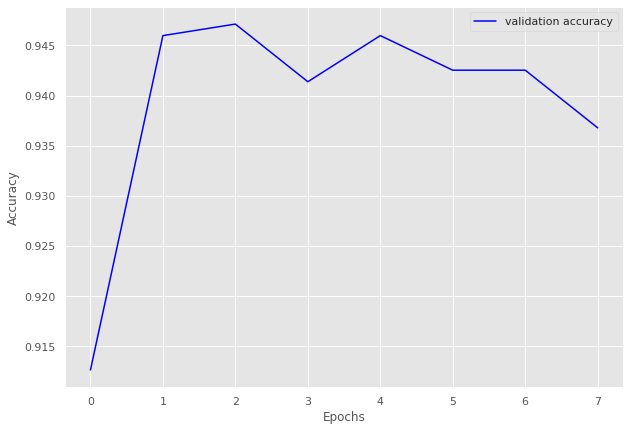

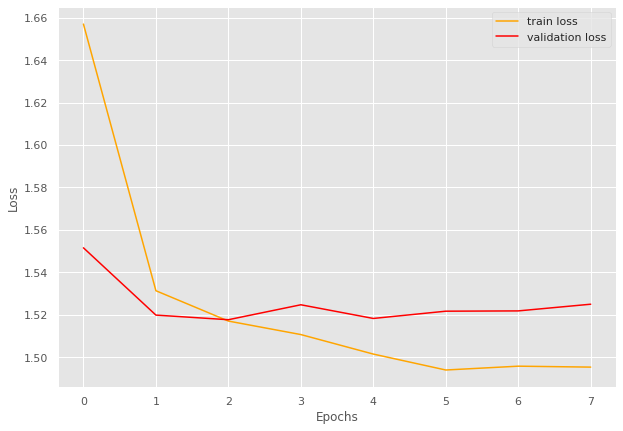

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 65/65 [00:22<00:00,  2.93batch/s, loss=1.25]


train loss 1.2512112379074096, validation loss 1.1282826662063599, validation accuracy 0.9320388349514563
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=1.11]


train loss 1.1068204219524678, validation loss 1.112596035003662, validation accuracy 0.9368932038834952
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=1.09]


train loss 1.0887618101560153, validation loss 1.0972406012671334, validation accuracy 0.9538834951456311
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.0815894255271326, validation loss 1.1015943118504115, validation accuracy 0.9344660194174758
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.97batch/s, loss=1.07]


train loss 1.0736140141120323, validation loss 1.0730396168572562, validation accuracy 0.970873786407767
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0704062626912043, validation loss 1.0917205129350935, validation accuracy 0.9538834951456311
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0644240122575026, validation loss 1.0796825885772705, validation accuracy 0.9635922330097088
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0648603696089525, validation loss 1.0747668061937605, validation accuracy 0.9660194174757282
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9600214649852428 and loss 1.0829983747611611


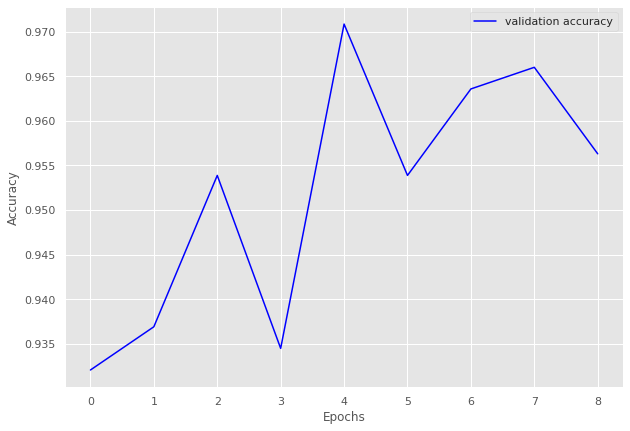

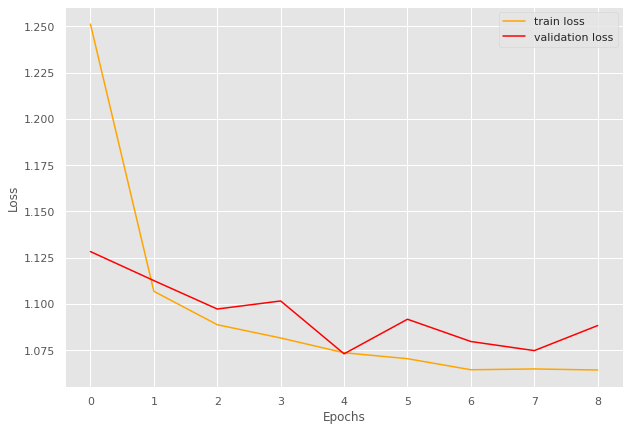

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 25/25 [00:09<00:00,  2.77batch/s, loss=0.386]


train loss 0.386227365732193, validation loss 0.34749263525009155, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.91batch/s, loss=0.323]


train loss 0.3233421134948731, validation loss 0.33643828829129535, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.94batch/s, loss=0.323]


train loss 0.32292256236076355, validation loss 0.334062139193217, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.91batch/s, loss=0.323]


train loss 0.32342345714569093, validation loss 0.3309653401374817, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.91batch/s, loss=0.319]


train loss 0.3192993724346161, validation loss 0.33033222953478497, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.92batch/s, loss=0.316]


INFO: Early stopping counter 1 of 5
train loss 0.3164546358585358, validation loss 0.35588066776593524, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.88batch/s, loss=0.316]


INFO: Early stopping counter 2 of 5
train loss 0.3163183581829071, validation loss 0.331129123767217, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.85batch/s, loss=0.321]


INFO: Early stopping counter 3 of 5
train loss 0.3213160693645477, validation loss 0.34133775035540265, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.91batch/s, loss=0.319]


INFO: Early stopping counter 4 of 5
train loss 0.3194038772583008, validation loss 0.33160853385925293, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 10
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.92batch/s, loss=0.32] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9833217512161223 and loss 0.32926745129668195


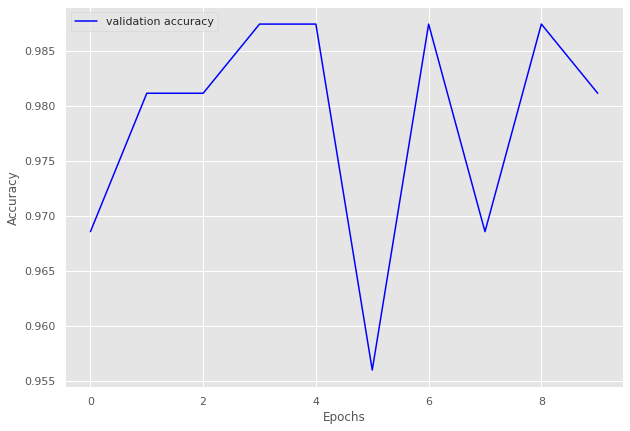

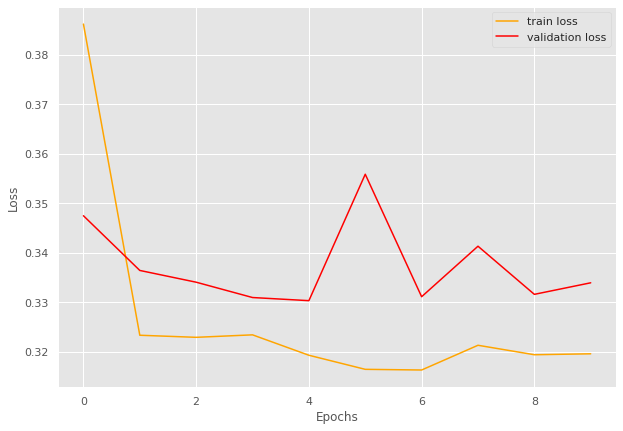

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 73/73 [00:24<00:00,  2.95batch/s, loss=1.34]


train loss 1.3392461799595454, validation loss 1.2266899347305298, validation accuracy 0.9439655172413793
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 73/73 [00:25<00:00,  2.91batch/s, loss=1.23]


INFO: Early stopping counter 1 of 5
train loss 1.2290144456575995, validation loss 1.240630865097046, validation accuracy 0.9267241379310345
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.94batch/s, loss=1.22]


train loss 1.218070585433751, validation loss 1.2172846794128418, validation accuracy 0.9461206896551724
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.93batch/s, loss=1.21]


train loss 1.2070978422687477, validation loss 1.2116226255893707, validation accuracy 0.9612068965517241
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.94batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.1980301958240875, validation loss 1.221585065126419, validation accuracy 0.9418103448275862
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 73/73 [00:27<00:00,  2.70batch/s, loss=1.2] 


train loss 1.198500102513457, validation loss 1.20994533598423, validation accuracy 0.9547413793103449
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 73/73 [00:45<00:00,  1.62batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.191204802630699, validation loss 1.2232059389352798, validation accuracy 0.9439655172413793
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 73/73 [00:52<00:00,  1.38batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1920868076690256, validation loss 1.22505584359169, validation accuracy 0.9439655172413793
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 73/73 [00:52<00:00,  1.40batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9536266349583828 and loss 1.2111770167495266


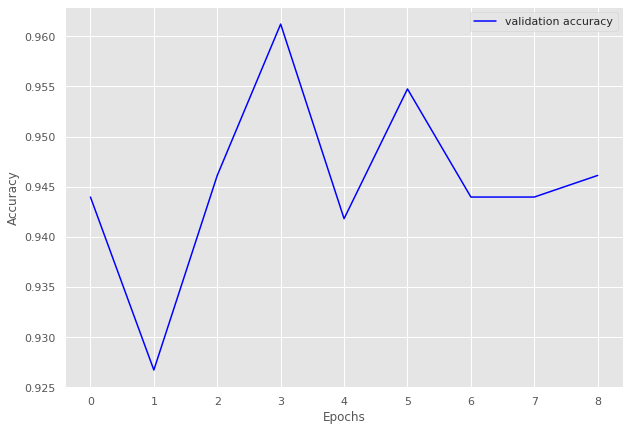

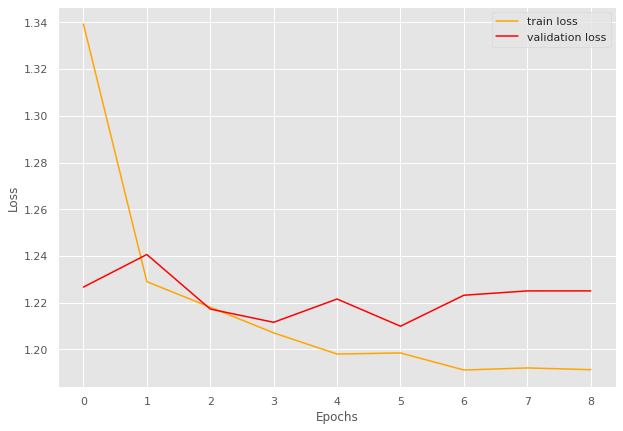

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 58/58 [00:25<00:00,  2.25batch/s, loss=0.843]


train loss 0.8432880413943323, validation loss 0.7859031856060028, validation accuracy 0.9559228650137741
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.97batch/s, loss=0.77] 


train loss 0.7695801699983662, validation loss 0.7699103454748789, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.95batch/s, loss=0.762]


INFO: Early stopping counter 1 of 5
train loss 0.7615788003494, validation loss 0.772071768840154, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.95batch/s, loss=0.763]


train loss 0.7629370586625461, validation loss 0.7696243822574615, validation accuracy 0.9724517906336089
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.93batch/s, loss=0.762]


train loss 0.7620141321215136, validation loss 0.7644122044245402, validation accuracy 0.977961432506887
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.96batch/s, loss=0.763]


INFO: Early stopping counter 2 of 5
train loss 0.7632065271509105, validation loss 0.7685144941012064, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.94batch/s, loss=0.755]


train loss 0.7545756964847959, validation loss 0.7620931963125864, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.95batch/s, loss=0.752]


INFO: Early stopping counter 3 of 5
train loss 0.7523154760229176, validation loss 0.7631671528021494, validation accuracy 0.977961432506887
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.94batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.7508843335612067, validation loss 0.7625405887762705, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 10
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.94batch/s, loss=0.754]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9787363304981774 and loss 0.7653782734504113


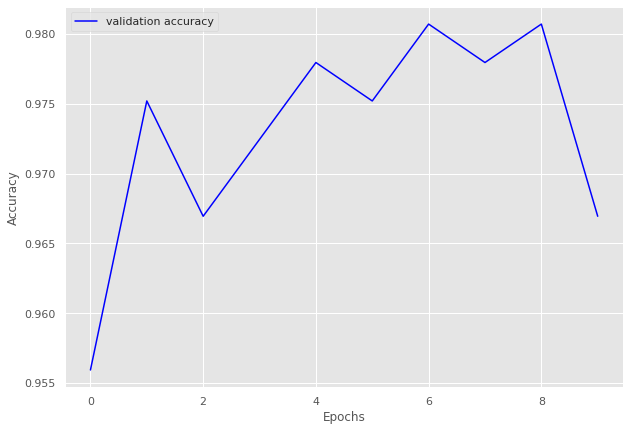

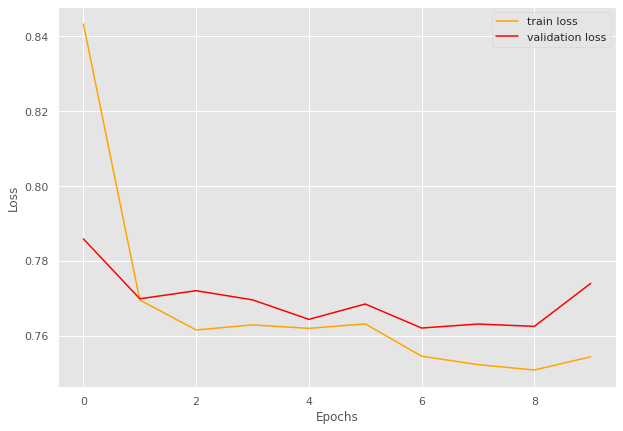

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 81/81 [00:29<00:00,  2.73batch/s, loss=1.37]


train loss 1.3724014273396246, validation loss 1.2670973986387253, validation accuracy 0.898238747553816
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.24]


train loss 1.2350217663211587, validation loss 1.253290057182312, validation accuracy 0.9119373776908023
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.94batch/s, loss=1.22]


train loss 1.2181681276839456, validation loss 1.2452564537525177, validation accuracy 0.9197651663405088
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.21]


train loss 1.2116229857927487, validation loss 1.2375503778457642, validation accuracy 0.9256360078277887
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.92batch/s, loss=1.2] 


INFO: Early stopping counter 1 of 5
train loss 1.2032697318512717, validation loss 1.2430855929851532, validation accuracy 0.923679060665362
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.92batch/s, loss=1.21]


train loss 1.2073888307736245, validation loss 1.2338144779205322, validation accuracy 0.9315068493150684
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.92batch/s, loss=1.2] 


train loss 1.195233632017065, validation loss 1.2282643765211105, validation accuracy 0.9373776908023483
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.92batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.1962488992714588, validation loss 1.238145887851715, validation accuracy 0.9256360078277887
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.91batch/s, loss=1.2] 


train loss 1.1952766165321256, validation loss 1.2269750237464905, validation accuracy 0.9393346379647749
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.92batch/s, loss=1.19]


train loss 1.1851635994734588, validation loss 1.2206359654664993, validation accuracy 0.9452054794520548
Coarse label 8 Epoch 11
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.95batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1880780517319103, validation loss 1.2243731915950775, validation accuracy 0.9432485322896281
Coarse label 8 Epoch 12
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.94batch/s, loss=1.18]


INFO: Early stopping counter 4 of 5
train loss 1.1818310037071322, validation loss 1.220991998910904, validation accuracy 0.9471624266144814
Coarse label 8 Epoch 13
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.94batch/s, loss=1.18]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9377162629757786 and loss 1.2267384153522858


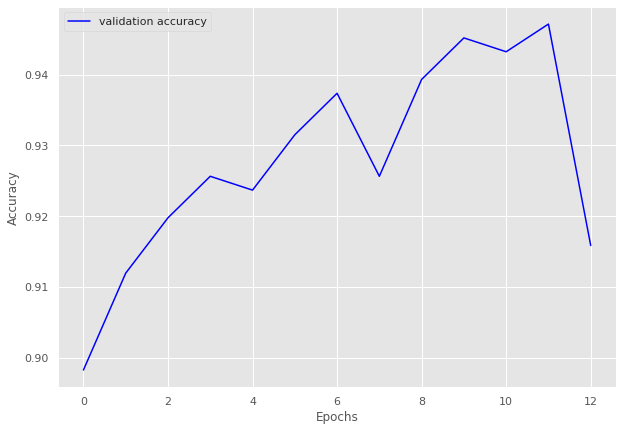

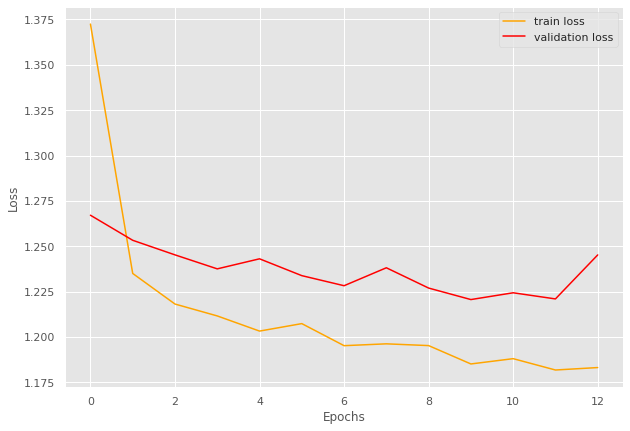

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 102/102 [00:35<00:00,  2.90batch/s, loss=1.66]


train loss 1.657297853161307, validation loss 1.5585507479580967, validation accuracy 0.9259259259259259
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.53]


train loss 1.5268087632515852, validation loss 1.5412354902787642, validation accuracy 0.9367283950617284
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.51]


train loss 1.5095906970547694, validation loss 1.5275139591910623, validation accuracy 0.9444444444444444
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.90batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4942895583077973, validation loss 1.5314220081676135, validation accuracy 0.9537037037037037
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 102/102 [00:34<00:00,  2.92batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4886055541973489, validation loss 1.541669943115928, validation accuracy 0.9444444444444444
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 102/102 [00:34<00:00,  2.92batch/s, loss=1.49]


train loss 1.4881433505637973, validation loss 1.5231879190965132, validation accuracy 0.9459876543209876
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.88batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.487833399398654, validation loss 1.5292970050464978, validation accuracy 0.9459876543209876
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.85batch/s, loss=1.48]


train loss 1.4848327706841862, validation loss 1.5230938521298496, validation accuracy 0.9552469135802469
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4796685751746683, validation loss 1.5247181979092685, validation accuracy 0.9506172839506173
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.87batch/s, loss=1.48]


train loss 1.4772941119530623, validation loss 1.5133771137757734, validation accuracy 0.9614197530864198
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.89batch/s, loss=1.48]


train loss 1.4756750546249688, validation loss 1.510849031535062, validation accuracy 0.9567901234567902
Coarse label 9 Epoch 12
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.89batch/s, loss=1.47]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9586748633879781 and loss 1.5037782218145288


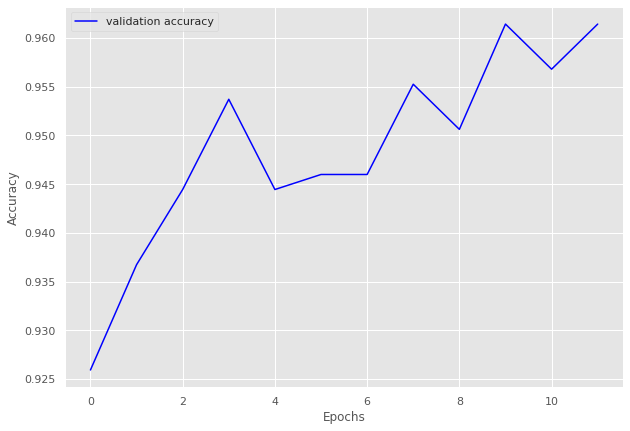

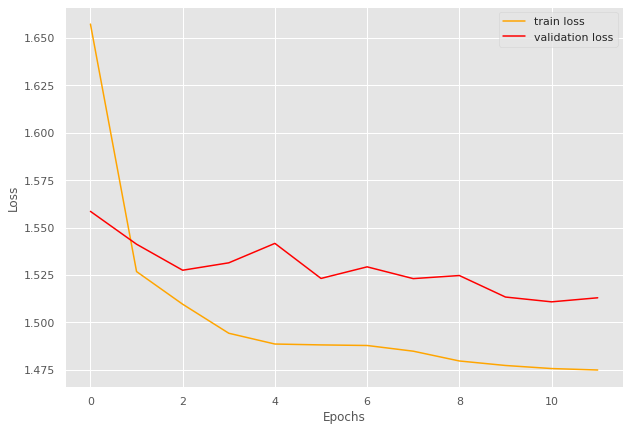

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 48/48 [00:16<00:00,  2.89batch/s, loss=0.862]


train loss 0.8615281780560812, validation loss 0.7829137921333313, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.95batch/s, loss=0.765]


train loss 0.7647135692338148, validation loss 0.7792419195175171, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.94batch/s, loss=0.761]


INFO: Early stopping counter 1 of 5
train loss 0.7606287014981111, validation loss 0.7802863478660583, validation accuracy 0.9605263157894737
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.94batch/s, loss=0.754]


INFO: Early stopping counter 2 of 5
train loss 0.7544221182664236, validation loss 0.7802818059921265, validation accuracy 0.9605263157894737
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.91batch/s, loss=0.753]


train loss 0.7533564666906992, validation loss 0.7763455748558045, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.92batch/s, loss=0.755]


INFO: Early stopping counter 3 of 5
train loss 0.7545699998736382, validation loss 0.7782512664794922, validation accuracy 0.9605263157894737
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.91batch/s, loss=0.754]


train loss 0.7539238172272841, validation loss 0.7711384415626525, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.94batch/s, loss=0.75] 


train loss 0.7497769085069498, validation loss 0.769089424610138, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.92batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.751204272111257, validation loss 0.779855215549469, validation accuracy 0.9605263157894737
Coarse label 11 Epoch 10
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.93batch/s, loss=0.75] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9789855072463768 and loss 0.7639339186928489


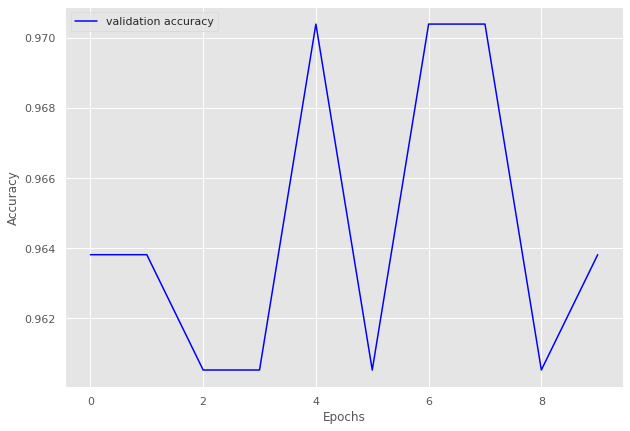

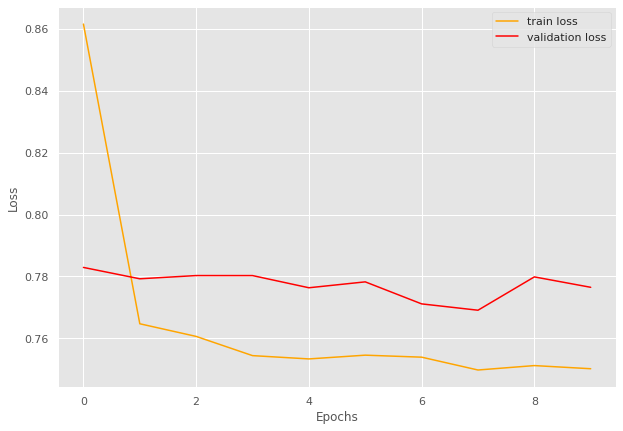

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 46/46 [00:15<00:00,  2.96batch/s, loss=1.31]


train loss 1.3142420001651929, validation loss 1.146105456352234, validation accuracy 0.906896551724138
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.95batch/s, loss=1.12]


train loss 1.1230541260346123, validation loss 1.115474486351013, validation accuracy 0.9310344827586207
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 46/46 [00:16<00:00,  2.84batch/s, loss=1.1]


INFO: Early stopping counter 1 of 5
train loss 1.1010607662408247, validation loss 1.1167695760726928, validation accuracy 0.9275862068965517
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 46/46 [00:17<00:00,  2.62batch/s, loss=1.09]


train loss 1.0940249458603237, validation loss 1.1130295515060424, validation accuracy 0.9379310344827586
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.95batch/s, loss=1.09]


train loss 1.088577187579611, validation loss 1.1085788249969482, validation accuracy 0.9310344827586207
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.95batch/s, loss=1.08]


train loss 1.0843239193377288, validation loss 1.1060118675231934, validation accuracy 0.9379310344827586
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.96batch/s, loss=1.08]


train loss 1.0804528853167659, validation loss 1.1047377586364746, validation accuracy 0.9344827586206896
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.96batch/s, loss=1.08]


INFO: Early stopping counter 2 of 5
train loss 1.0763833911522576, validation loss 1.1141733169555663, validation accuracy 0.9310344827586207
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.97batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0747140931046528, validation loss 1.1049005031585692, validation accuracy 0.9448275862068966
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.95batch/s, loss=1.07]


train loss 1.0709915083387624, validation loss 1.0997087240219117, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.93batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.069203830283621, validation loss 1.1008524417877197, validation accuracy 0.9448275862068966
Coarse label 12 Epoch 12
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.98batch/s, loss=1.07]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9488636363636364 and loss 1.0967048434984117


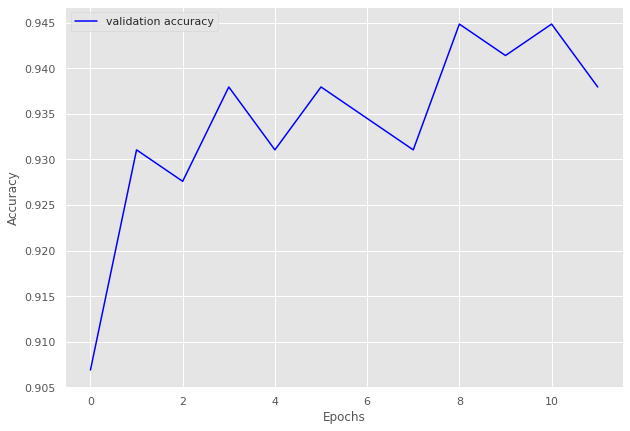

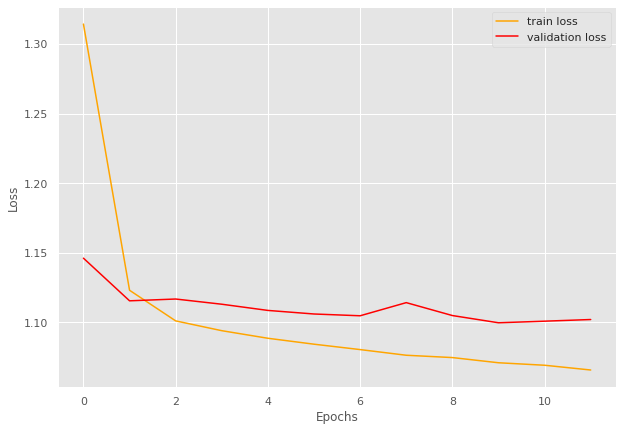

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=0.68] 


train loss 0.679654425237237, validation loss 0.62556312084198, validation accuracy 0.8996138996138996
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.595]


train loss 0.5949812211641451, validation loss 0.617000424861908, validation accuracy 0.915057915057915
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.96batch/s, loss=0.579]


train loss 0.5791815853700405, validation loss 0.6167423605918885, validation accuracy 0.9111969111969112
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.572]


train loss 0.5720700098247062, validation loss 0.6027046918869019, validation accuracy 0.9382239382239382
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.97batch/s, loss=0.568]


train loss 0.5681328555432762, validation loss 0.5982526779174805, validation accuracy 0.9382239382239382
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.96batch/s, loss=0.57] 


INFO: Early stopping counter 1 of 5
train loss 0.5697344832304048, validation loss 0.6020825266838074, validation accuracy 0.9382239382239382
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.97batch/s, loss=0.569]


train loss 0.569198909329205, validation loss 0.5976442098617554, validation accuracy 0.9459459459459459
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.96batch/s, loss=0.564]


INFO: Early stopping counter 2 of 5
train loss 0.5636768588205663, validation loss 0.5982315063476562, validation accuracy 0.9343629343629344
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:18<00:00,  2.26batch/s, loss=0.561]


INFO: Early stopping counter 3 of 5
train loss 0.5608466500189246, validation loss 0.6017172574996948, validation accuracy 0.9382239382239382
Coarse label 13 Epoch 10
-------------------------------


100%|██████████| 41/41 [00:24<00:00,  1.70batch/s, loss=0.564]


INFO: Early stopping counter 4 of 5
train loss 0.5638060918668422, validation loss 0.6447185516357422, validation accuracy 0.9459459459459459
Coarse label 13 Epoch 11
-------------------------------


100%|██████████| 41/41 [00:29<00:00,  1.40batch/s, loss=0.562]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9594190516873131 and loss 0.5918449566170976


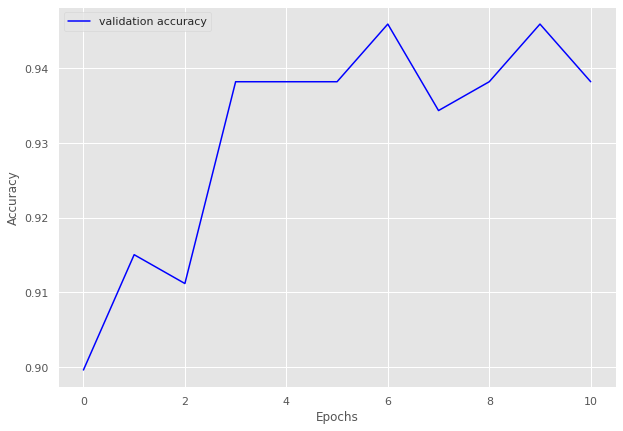

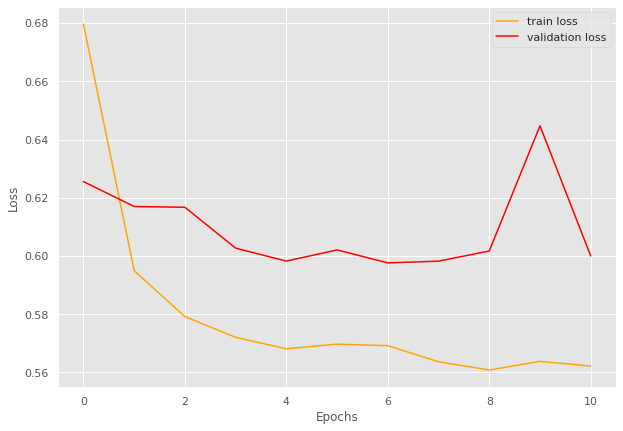

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 94/94 [01:13<00:00,  1.28batch/s, loss=1.18]


train loss 1.1813616486305887, validation loss 1.0972596764564515, validation accuracy 0.9461279461279462
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 94/94 [00:56<00:00,  1.66batch/s, loss=1.08]


train loss 1.0839637454519881, validation loss 1.0871209144592284, validation accuracy 0.9595959595959596
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.08]


train loss 1.0753480284772021, validation loss 1.0855435371398925, validation accuracy 0.9595959595959596
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.07]


train loss 1.0714074043517416, validation loss 1.0826991677284241, validation accuracy 0.9612794612794613
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0666190956501251, validation loss 1.0850906014442443, validation accuracy 0.9595959595959596
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.07]


train loss 1.066060980583759, validation loss 1.0758188605308532, validation accuracy 0.968013468013468
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0632212326881734, validation loss 1.078138244152069, validation accuracy 0.968013468013468
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.91batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.062390607722262, validation loss 1.078580391407013, validation accuracy 0.9646464646464646
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.06]


train loss 1.0588125814782812, validation loss 1.070576024055481, validation accuracy 0.9814814814814815
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0567159589300765, validation loss 1.0770798444747924, validation accuracy 0.968013468013468
Coarse label 14 Epoch 11
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9763720930232558 and loss 1.0679202008815039


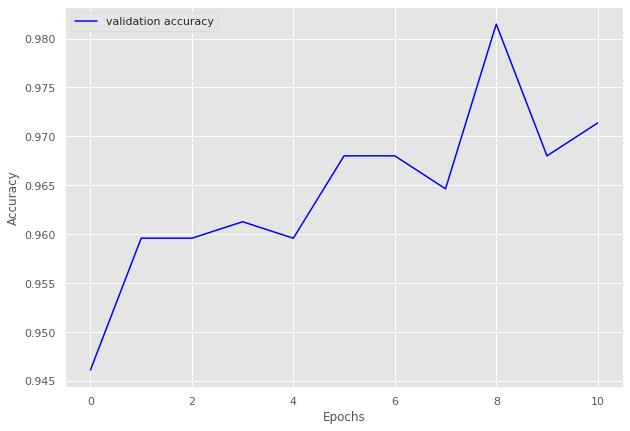

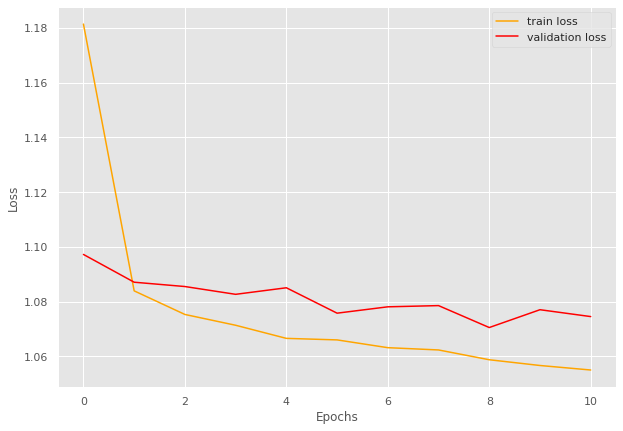

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 47/47 [00:15<00:00,  2.99batch/s, loss=0.91] 


train loss 0.9099456782036639, validation loss 0.7942475557327271, validation accuracy 0.95578231292517
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.96batch/s, loss=0.778]


train loss 0.7779211769712732, validation loss 0.7900020480155945, validation accuracy 0.9489795918367347
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.90batch/s, loss=0.771]


train loss 0.7713029371931198, validation loss 0.7825317144393921, validation accuracy 0.9591836734693877
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.94batch/s, loss=0.769]


train loss 0.7688101948575771, validation loss 0.7624585866928101, validation accuracy 0.9795918367346939
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.97batch/s, loss=0.76] 


INFO: Early stopping counter 1 of 5
train loss 0.7595943504191459, validation loss 0.7639950513839722, validation accuracy 0.9829931972789115
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.96batch/s, loss=0.769]


INFO: Early stopping counter 2 of 5
train loss 0.7694337507511707, validation loss 0.7730965852737427, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.93batch/s, loss=0.752]


INFO: Early stopping counter 3 of 5
train loss 0.7524218609992493, validation loss 0.7877379298210144, validation accuracy 0.95578231292517
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.96batch/s, loss=0.75] 


INFO: Early stopping counter 4 of 5
train loss 0.7501202162275923, validation loss 0.7637012720108032, validation accuracy 0.9795918367346939
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.98batch/s, loss=0.749]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9732479276563677 and loss 0.771235907361621


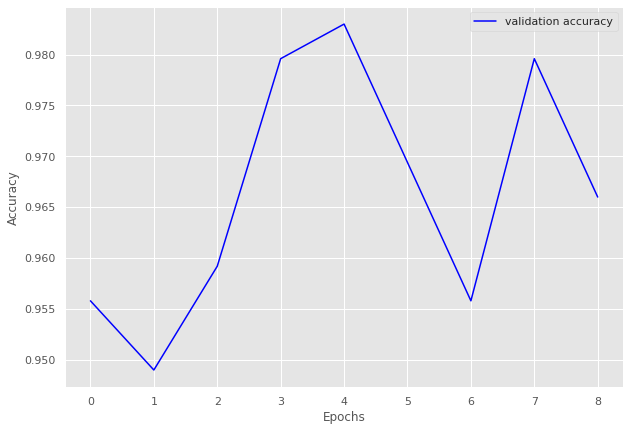

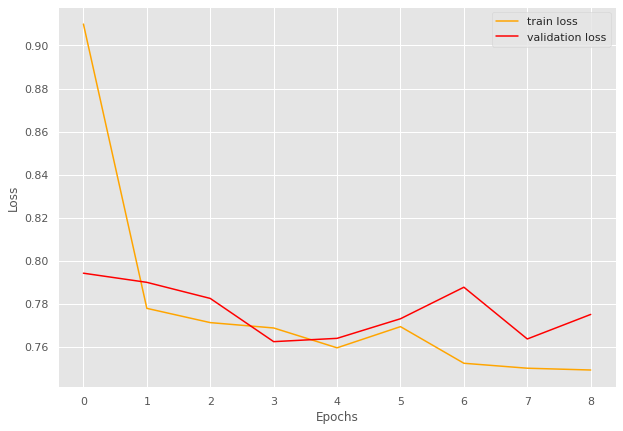

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 45/45 [00:15<00:00,  2.96batch/s, loss=0.672]


train loss 0.671841115421719, validation loss 0.5837942004203797, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.95batch/s, loss=0.586]


train loss 0.5855984754032559, validation loss 0.5791434049606323, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.98batch/s, loss=0.57] 


INFO: Early stopping counter 1 of 5
train loss 0.570383424229092, validation loss 0.584431266784668, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.97batch/s, loss=0.569]


train loss 0.5685816817813449, validation loss 0.5743059873580932, validation accuracy 0.975177304964539
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.94batch/s, loss=0.562]


train loss 0.5619002090560066, validation loss 0.5655574798583984, validation accuracy 0.9822695035460993
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.99batch/s, loss=0.565]


INFO: Early stopping counter 2 of 5
train loss 0.5646568099657695, validation loss 0.5715461730957031, validation accuracy 0.9787234042553191
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 45/45 [00:17<00:00,  2.63batch/s, loss=0.565]


INFO: Early stopping counter 3 of 5
train loss 0.5650809990035163, validation loss 0.5844812035560608, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.97batch/s, loss=0.563]


INFO: Early stopping counter 4 of 5
train loss 0.5629845672183567, validation loss 0.5760937094688415, validation accuracy 0.9822695035460993
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.97batch/s, loss=0.559]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9729199372056515 and loss 0.5781968787312508


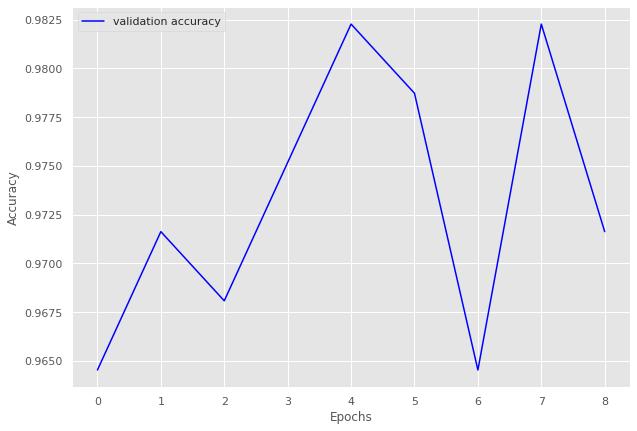

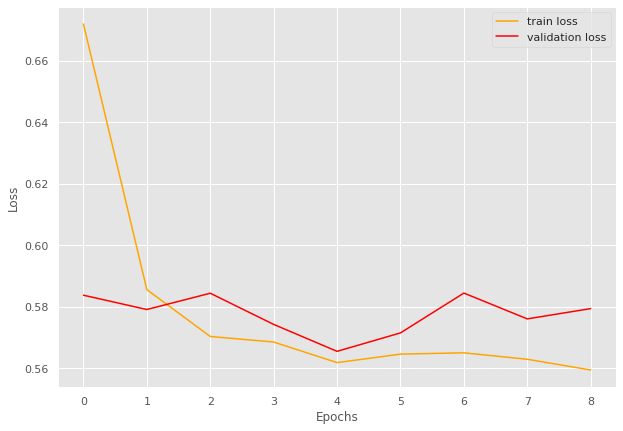

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=0.917]


train loss 0.9167471017156329, validation loss 0.840603232383728, validation accuracy 0.9061488673139159
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=0.796]


train loss 0.7961888057844979, validation loss 0.8298141360282898, validation accuracy 0.912621359223301
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.98batch/s, loss=0.78] 


train loss 0.7798365172074766, validation loss 0.8166780352592469, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.96batch/s, loss=0.774]


INFO: Early stopping counter 1 of 5
train loss 0.7743497843645057, validation loss 0.8173848628997803, validation accuracy 0.9288025889967637
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=0.769]


train loss 0.7691821042372256, validation loss 0.7944738388061523, validation accuracy 0.9449838187702265
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.97batch/s, loss=0.762]


train loss 0.7622183026099691, validation loss 0.791210949420929, validation accuracy 0.9514563106796117
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=0.757]


INFO: Early stopping counter 2 of 5
train loss 0.7574393007220054, validation loss 0.8012609004974365, validation accuracy 0.9385113268608414
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.98batch/s, loss=0.76] 


INFO: Early stopping counter 3 of 5
train loss 0.759882889231857, validation loss 0.8111781001091003, validation accuracy 0.9352750809061489
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=0.761]


INFO: Early stopping counter 4 of 5
train loss 0.7614994438327088, validation loss 0.7929381370544434, validation accuracy 0.9449838187702265
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.92batch/s, loss=0.756]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9416189111747851 and loss 0.8004764196547595


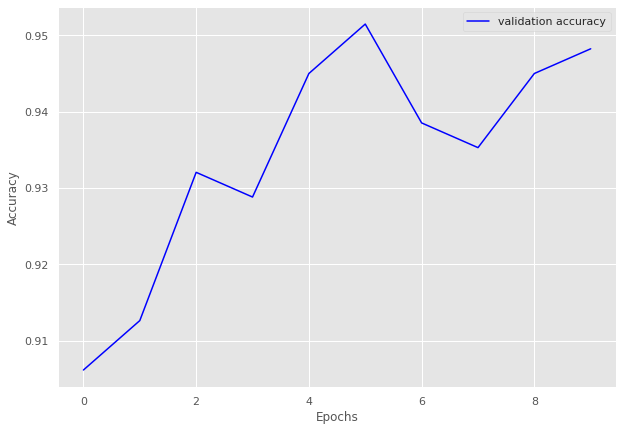

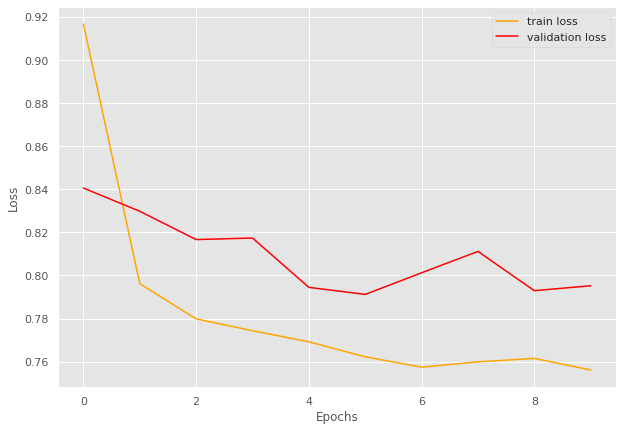

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 16/16 [00:07<00:00,  2.17batch/s, loss=1.03]


train loss 1.0322381295263767, validation loss 0.871107816696167, validation accuracy 0.8645833333333334
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.07batch/s, loss=0.784]


train loss 0.784045971930027, validation loss 0.7973963618278503, validation accuracy 0.9375
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  2.98batch/s, loss=0.758]


train loss 0.7576728090643883, validation loss 0.7921189367771149, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  2.82batch/s, loss=0.755]


INFO: Early stopping counter 1 of 5
train loss 0.7545663602650166, validation loss 0.8000445663928986, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.08batch/s, loss=0.756]


INFO: Early stopping counter 2 of 5
train loss 0.7562813088297844, validation loss 0.8090498745441437, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  2.99batch/s, loss=0.756]


INFO: Early stopping counter 3 of 5
train loss 0.7562515623867512, validation loss 0.8071554005146027, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.05batch/s, loss=0.757]


INFO: Early stopping counter 4 of 5
train loss 0.7572781555354595, validation loss 0.7958147525787354, validation accuracy 0.9375
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.02batch/s, loss=0.754]


train loss 0.7539920806884766, validation loss 0.7905066907405853, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.08batch/s, loss=0.765]


train loss 0.764863695949316, validation loss 0.7897481322288513, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.01batch/s, loss=0.755]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9638009049773756 and loss 0.781754229749952


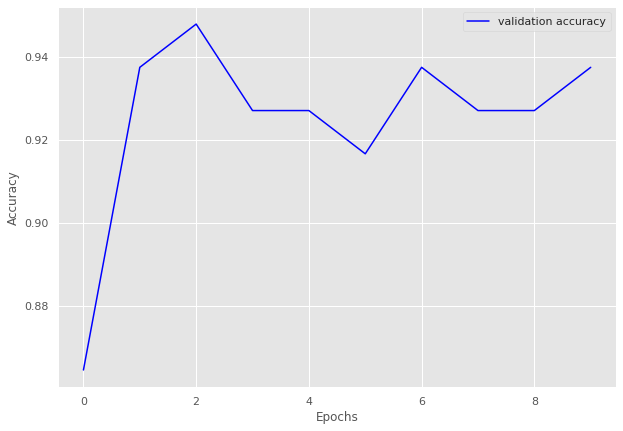

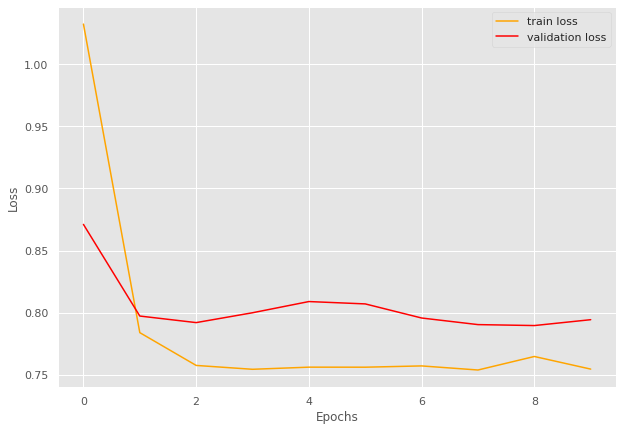

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Calculating for volume 85
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=1.05]


train loss 1.0453245355448593, validation loss 0.955259655203138, validation accuracy 0.9533799533799534
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.957]


train loss 0.9566315374243151, validation loss 0.945346508707319, validation accuracy 0.965034965034965
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.94] 


INFO: Early stopping counter 1 of 5
train loss 0.9395370461525173, validation loss 0.9527820604188102, validation accuracy 0.9533799533799534
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.942]


train loss 0.941839094555706, validation loss 0.942461507661002, validation accuracy 0.965034965034965
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.935]


INFO: Early stopping counter 2 of 5
train loss 0.9352850399979757, validation loss 0.9425508039338248, validation accuracy 0.9603729603729604
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.93batch/s, loss=0.934]


INFO: Early stopping counter 3 of 5
train loss 0.9339229338759676, validation loss 0.9460138082504272, validation accuracy 0.9627039627039627
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.934]


INFO: Early stopping counter 4 of 5
train loss 0.9344635649558601, validation loss 0.945823780127934, validation accuracy 0.9603729603729604
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.91batch/s, loss=0.946]


train loss 0.9455716735726103, validation loss 0.9367466483797345, validation accuracy 0.972027972027972
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 109/109 [00:42<00:00,  2.59batch/s, loss=0.936]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.962278675904542 and loss 0.9415626923243204


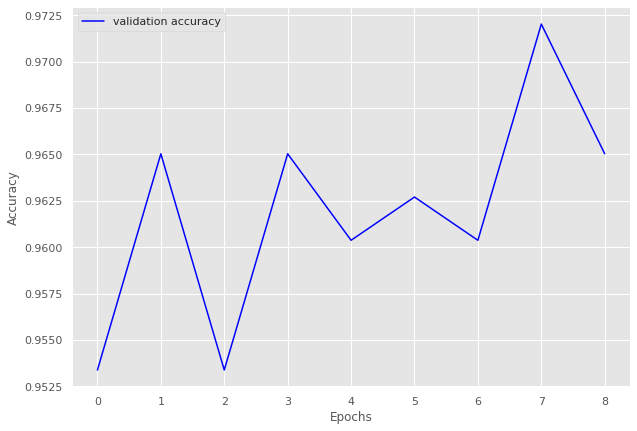

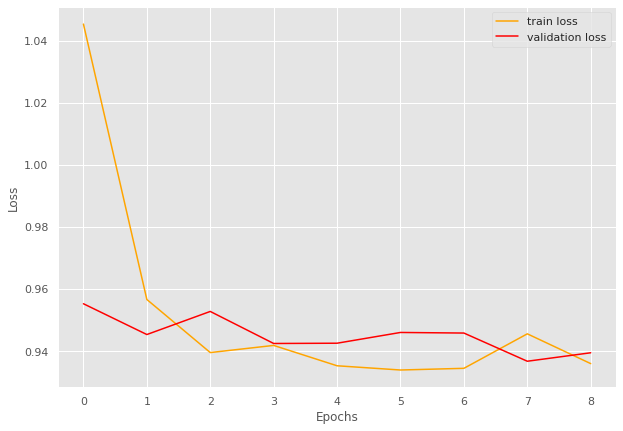

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 47/47 [00:16<00:00,  2.94batch/s, loss=1.22]


train loss 1.2178988710362861, validation loss 1.1053645610809326, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.91batch/s, loss=1.08]


train loss 1.0838010539399816, validation loss 1.0777831474939983, validation accuracy 0.967741935483871
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.93batch/s, loss=1.07]


train loss 1.0673768672537296, validation loss 1.072845458984375, validation accuracy 0.967741935483871
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.83batch/s, loss=1.07]


train loss 1.0673821581170915, validation loss 1.0538385311762493, validation accuracy 0.989247311827957
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.92batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.06046018194645, validation loss 1.08199675877889, validation accuracy 0.9623655913978495
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.89batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0597658334894384, validation loss 1.0800970395406086, validation accuracy 0.9623655913978495
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.90batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0560692142932973, validation loss 1.0675106445948284, validation accuracy 0.978494623655914
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.92batch/s, loss=1.05]


train loss 1.0539021162276572, validation loss 1.0517148574193318, validation accuracy 0.9946236559139785
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.91batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.055260607536803, validation loss 1.0647622346878052, validation accuracy 0.978494623655914
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.90batch/s, loss=1.05]


train loss 1.0517462517352814, validation loss 1.0478657484054565, validation accuracy 0.9946236559139785
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.92batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9700704225352113 and loss 1.0742799308564928


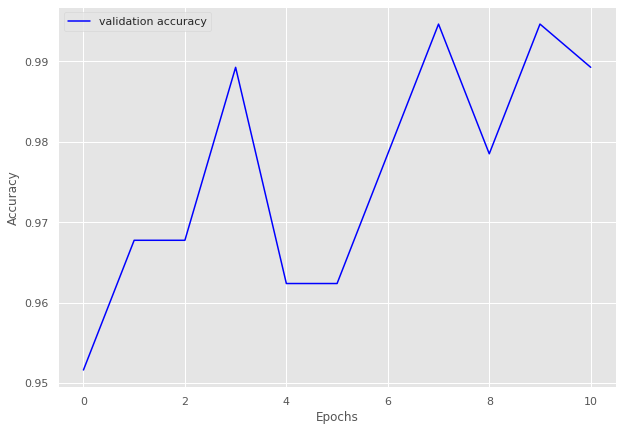

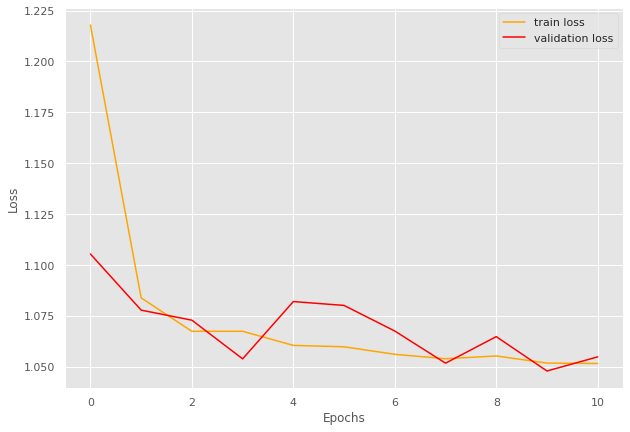

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 220/220 [01:16<00:00,  2.88batch/s, loss=1.62]


train loss 1.619049567526037, validation loss 1.5225061433655875, validation accuracy 0.9448275862068966
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 220/220 [01:35<00:00,  2.31batch/s, loss=1.53]


INFO: Early stopping counter 1 of 5
train loss 1.5279547528787092, validation loss 1.527374735900334, validation accuracy 0.9344827586206896
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 220/220 [02:44<00:00,  1.34batch/s, loss=1.51]


train loss 1.513945308598605, validation loss 1.5129049590655737, validation accuracy 0.9494252873563218
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 220/220 [01:17<00:00,  2.84batch/s, loss=1.5]


train loss 1.5018823347308419, validation loss 1.5033267736434937, validation accuracy 0.9586206896551724
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.90batch/s, loss=1.5]


train loss 1.496329766511917, validation loss 1.4961665613310677, validation accuracy 0.9689655172413794
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.90batch/s, loss=1.5] 


INFO: Early stopping counter 2 of 5
train loss 1.495020324533636, validation loss 1.509360909461975, validation accuracy 0.9540229885057471
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.92batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.4945777129043232, validation loss 1.5090853146144323, validation accuracy 0.9563218390804598
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 220/220 [01:21<00:00,  2.70batch/s, loss=1.49]


INFO: Early stopping counter 4 of 5
train loss 1.4945655167102814, validation loss 1.5064117738178797, validation accuracy 0.9551724137931035
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 220/220 [01:16<00:00,  2.88batch/s, loss=1.5]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.947588302316749 and loss 1.5129591283344088


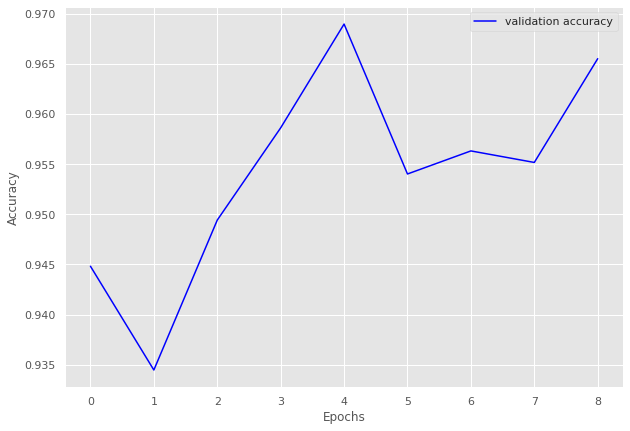

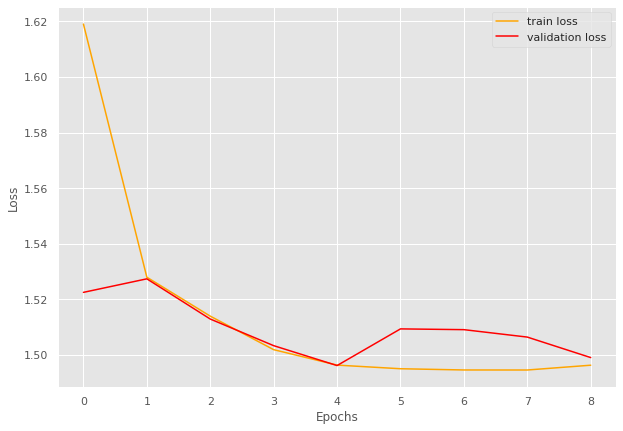

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 104/104 [00:35<00:00,  2.95batch/s, loss=1.21]


train loss 1.2144132485756507, validation loss 1.117183770452227, validation accuracy 0.9223300970873787
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 104/104 [00:40<00:00,  2.55batch/s, loss=1.1]


train loss 1.1006869604954352, validation loss 1.0929460695811681, validation accuracy 0.9587378640776699
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.94batch/s, loss=1.08]


train loss 1.0847758031808412, validation loss 1.0772135428019933, validation accuracy 0.9684466019417476
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 104/104 [00:36<00:00,  2.87batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.074165057677489, validation loss 1.0790917362485613, validation accuracy 0.9684466019417476
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.96batch/s, loss=1.07]


train loss 1.069272014957208, validation loss 1.0741602352687292, validation accuracy 0.9684466019417476
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0648534779365246, validation loss 1.0794118813105993, validation accuracy 0.9684466019417476
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.91batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0658759967638896, validation loss 1.0763704776763916, validation accuracy 0.970873786407767
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.96batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.066032464687641, validation loss 1.0809632710048132, validation accuracy 0.9587378640776699
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9710610932475884 and loss 1.0722392082214356


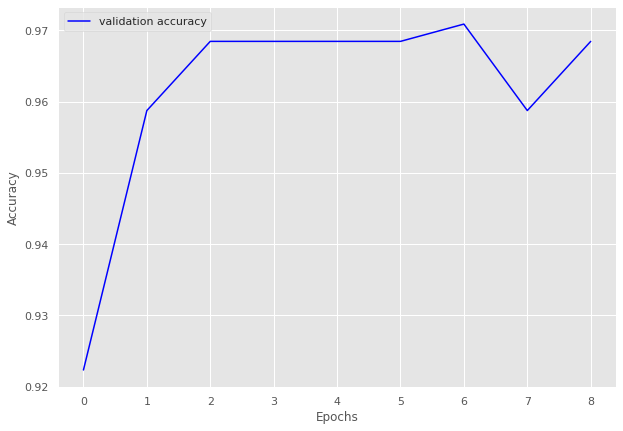

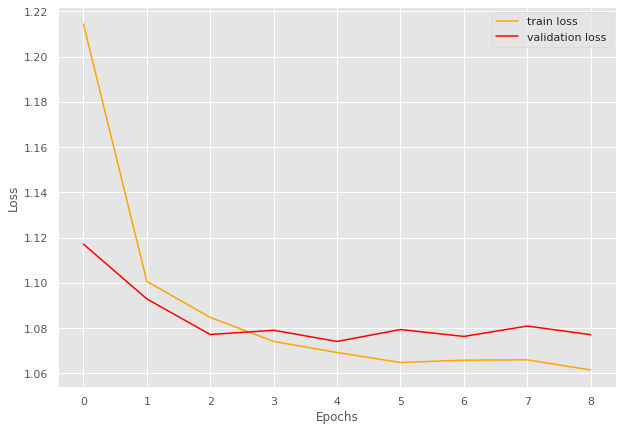

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 40/40 [00:13<00:00,  2.95batch/s, loss=0.377]


train loss 0.3773546785116196, validation loss 0.3216727872689565, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.94batch/s, loss=0.33] 


INFO: Early stopping counter 1 of 5
train loss 0.32966662719845774, validation loss 0.32516804337501526, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 40/40 [00:16<00:00,  2.40batch/s, loss=0.322]


train loss 0.3220144651830196, validation loss 0.31412653128306073, validation accuracy 1.0
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 40/40 [00:15<00:00,  2.53batch/s, loss=0.32] 


INFO: Early stopping counter 2 of 5
train loss 0.32010321915149687, validation loss 0.32719961802164715, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.90batch/s, loss=0.32] 


INFO: Early stopping counter 3 of 5
train loss 0.31979173570871355, validation loss 0.3239772915840149, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.91batch/s, loss=0.321]


INFO: Early stopping counter 4 of 5
train loss 0.32109282836318015, validation loss 0.3152313232421875, validation accuracy 1.0
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 40/40 [00:14<00:00,  2.76batch/s, loss=0.32] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9833679833679834 and loss 0.3329828716814518


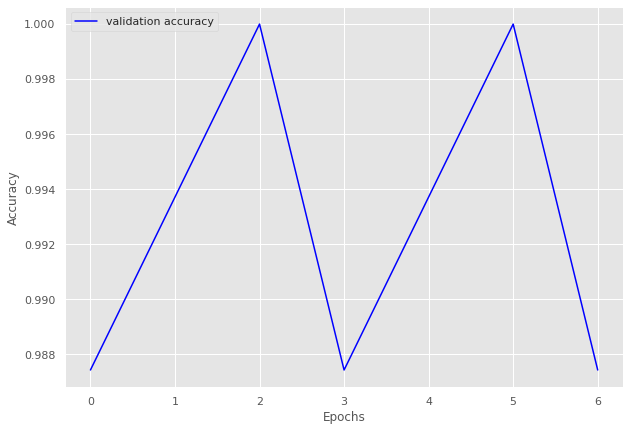

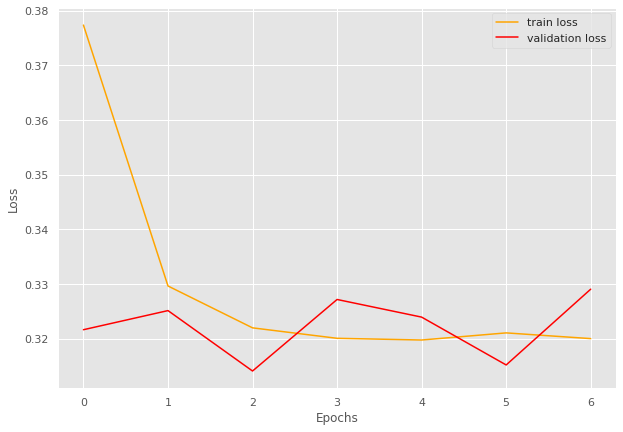

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 117/117 [00:40<00:00,  2.92batch/s, loss=1.3] 


train loss 1.3042205246085794, validation loss 1.2338668555021286, validation accuracy 0.9375
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.23]


train loss 1.2257898760657024, validation loss 1.2193195074796677, validation accuracy 0.9439655172413793
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.93batch/s, loss=1.21]


train loss 1.2057894009810228, validation loss 1.208824947476387, validation accuracy 0.959051724137931
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.95batch/s, loss=1.2]


INFO: Early stopping counter 1 of 5
train loss 1.1991650446867332, validation loss 1.2130318880081177, validation accuracy 0.9568965517241379
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 117/117 [00:40<00:00,  2.92batch/s, loss=1.2]


INFO: Early stopping counter 2 of 5
train loss 1.1993708977332482, validation loss 1.22263965010643, validation accuracy 0.9418103448275862
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 117/117 [00:41<00:00,  2.80batch/s, loss=1.2]


train loss 1.1972031358979707, validation loss 1.201629027724266, validation accuracy 0.9676724137931034
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.93batch/s, loss=1.2]


INFO: Early stopping counter 3 of 5
train loss 1.2004265489741268, validation loss 1.2074373066425323, validation accuracy 0.9504310344827587
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.2]


INFO: Early stopping counter 4 of 5
train loss 1.2011321171736107, validation loss 1.2096835523843765, validation accuracy 0.9568965517241379
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 117/117 [00:40<00:00,  2.90batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9565836298932384 and loss 1.208462725986134


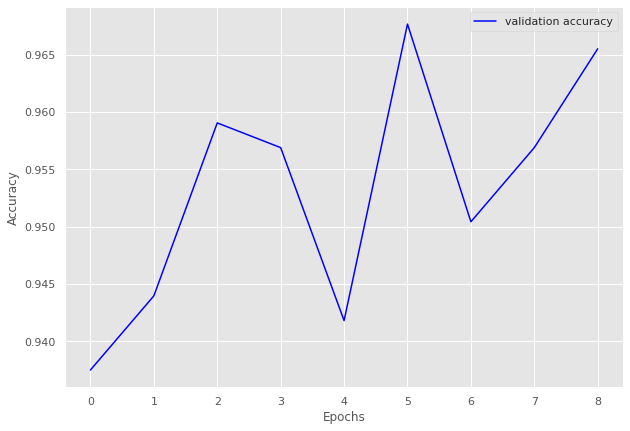

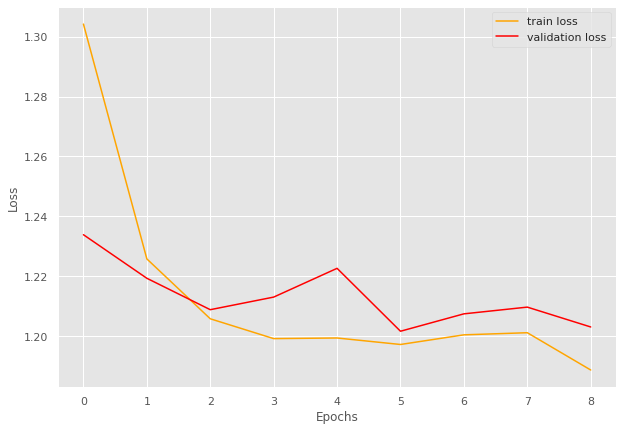

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 92/92 [00:31<00:00,  2.93batch/s, loss=0.825]


train loss 0.824912010975506, validation loss 0.7674727936585745, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.89batch/s, loss=0.769]


train loss 0.7694074673497159, validation loss 0.7615749339262644, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.94batch/s, loss=0.763]


train loss 0.7633960033240526, validation loss 0.7552155454953512, validation accuracy 0.9862258953168044
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.93batch/s, loss=0.762]


INFO: Early stopping counter 1 of 5
train loss 0.7618468526912772, validation loss 0.7656718293825785, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.93batch/s, loss=0.755]


INFO: Early stopping counter 2 of 5
train loss 0.7552873446889545, validation loss 0.7570500572522482, validation accuracy 0.9834710743801653
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.94batch/s, loss=0.755]


INFO: Early stopping counter 3 of 5
train loss 0.7553497015134149, validation loss 0.764483908812205, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.91batch/s, loss=0.755]


train loss 0.755017863019653, validation loss 0.753476103146871, validation accuracy 0.9917355371900827
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.92batch/s, loss=0.755]


train loss 0.7549953331118044, validation loss 0.7503272791703542, validation accuracy 0.9944903581267218
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.92batch/s, loss=0.756]


INFO: Early stopping counter 4 of 5
train loss 0.7557485155437303, validation loss 0.7585877478122711, validation accuracy 0.9862258953168044
Coarse label 7 Epoch 10
-------------------------------


100%|██████████| 92/92 [00:32<00:00,  2.85batch/s, loss=0.754]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9817850637522769 and loss 0.7620141870445676


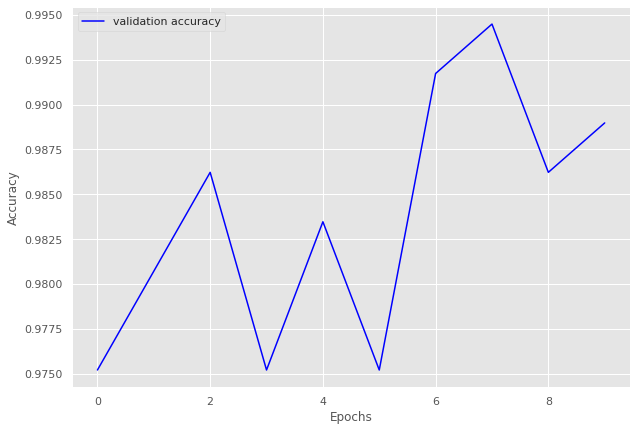

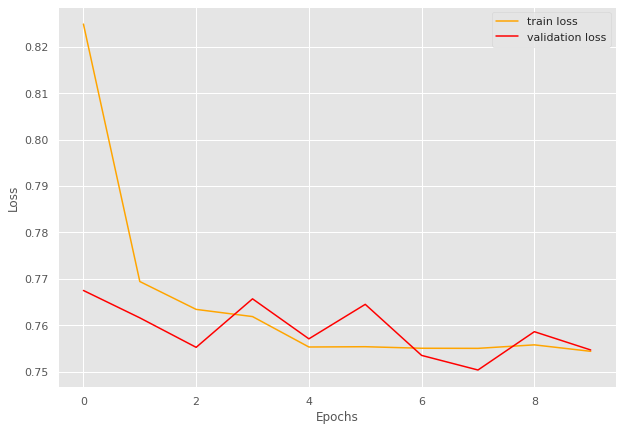

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 129/129 [00:44<00:00,  2.90batch/s, loss=1.33]


train loss 1.3288357119227565, validation loss 1.2592561393976212, validation accuracy 0.9080234833659491
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.89batch/s, loss=1.23]


train loss 1.2329751705938532, validation loss 1.2444698363542557, validation accuracy 0.9178082191780822
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.90batch/s, loss=1.22]


train loss 1.2194308532300846, validation loss 1.2320816367864609, validation accuracy 0.9373776908023483
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.90batch/s, loss=1.21]


train loss 1.207369328469269, validation loss 1.2203767746686935, validation accuracy 0.9471624266144814
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.90batch/s, loss=1.2]


INFO: Early stopping counter 1 of 5
train loss 1.2034289679786032, validation loss 1.2346419990062714, validation accuracy 0.9295499021526419
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 129/129 [01:09<00:00,  1.84batch/s, loss=1.2]


INFO: Early stopping counter 2 of 5
train loss 1.1984553715979407, validation loss 1.22537299990654, validation accuracy 0.9393346379647749
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 129/129 [01:36<00:00,  1.34batch/s, loss=1.2] 


train loss 1.1953738419584525, validation loss 1.2135179191827774, validation accuracy 0.9569471624266145
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 129/129 [01:11<00:00,  1.80batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1928132569143015, validation loss 1.2267968505620956, validation accuracy 0.9354207436399217
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.90batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.189260438431141, validation loss 1.2237617820501328, validation accuracy 0.9393346379647749
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.91batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9578742709008425 and loss 1.2075041341781616


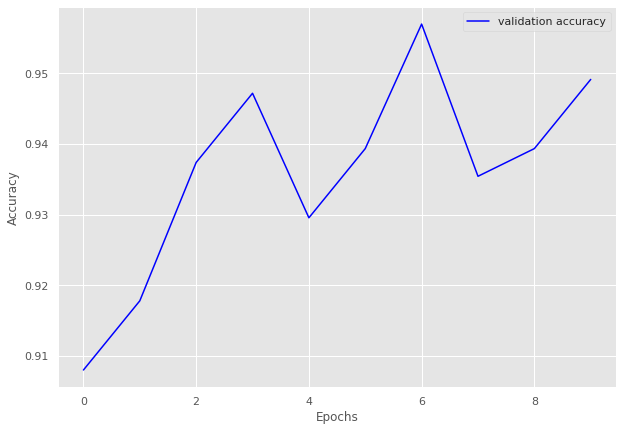

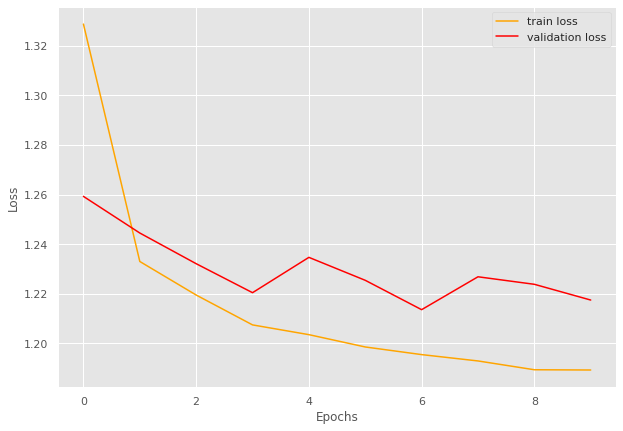

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 163/163 [00:58<00:00,  2.81batch/s, loss=1.63]


train loss 1.6296553363097956, validation loss 1.5424472201954236, validation accuracy 0.9243827160493827
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.91batch/s, loss=1.52]


train loss 1.5219650224673968, validation loss 1.532636588270014, validation accuracy 0.9429012345679012
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 163/163 [00:55<00:00,  2.91batch/s, loss=1.5]


train loss 1.5016615580927375, validation loss 1.5301297903060913, validation accuracy 0.9459876543209876
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.91batch/s, loss=1.49]


train loss 1.4898959866330668, validation loss 1.51909047907049, validation accuracy 0.9552469135802469
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.88batch/s, loss=1.49]


train loss 1.487517574082123, validation loss 1.5161439830606633, validation accuracy 0.9629629629629629
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.91batch/s, loss=1.49]


train loss 1.485498503673296, validation loss 1.509161721576344, validation accuracy 0.9645061728395061
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.89batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4875325549599583, validation loss 1.5223949389024214, validation accuracy 0.9475308641975309
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.88batch/s, loss=1.48]


INFO: Early stopping counter 2 of 5
train loss 1.483461478736503, validation loss 1.5153652754696934, validation accuracy 0.9614197530864198
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.90batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.48018885828966, validation loss 1.510965184731917, validation accuracy 0.9537037037037037
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.90batch/s, loss=1.48]


train loss 1.4788441475183687, validation loss 1.4977992989800193, validation accuracy 0.9598765432098766
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.89batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.478108463843176, validation loss 1.5061024752530185, validation accuracy 0.9629629629629629
Coarse label 9 Epoch 12
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.89batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9637014314928425 and loss 1.501200802864567


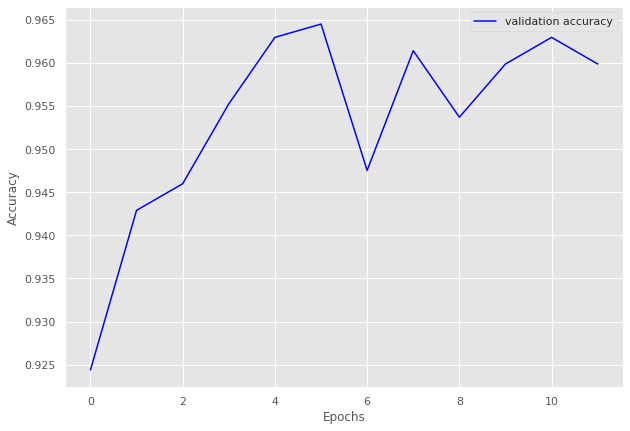

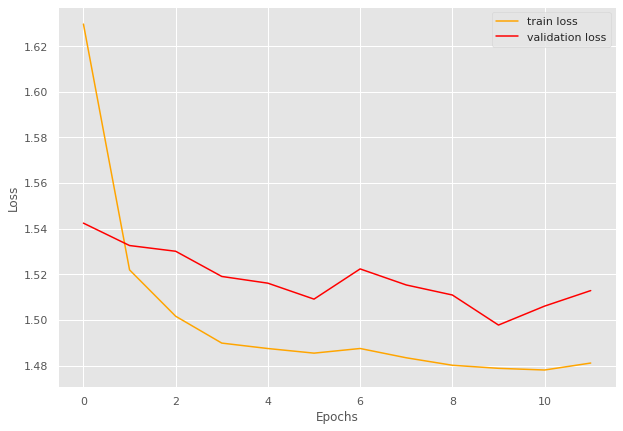

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 77/77 [00:26<00:00,  2.91batch/s, loss=0.827]


train loss 0.8269288888225308, validation loss 0.761522114276886, validation accuracy 0.9868421052631579
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.92batch/s, loss=0.761]


train loss 0.7611673389162336, validation loss 0.7553735852241517, validation accuracy 0.9901315789473685
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.92batch/s, loss=0.758]


INFO: Early stopping counter 1 of 5
train loss 0.7579953028010084, validation loss 0.7564039468765259, validation accuracy 0.9868421052631579
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.92batch/s, loss=0.754]


INFO: Early stopping counter 2 of 5
train loss 0.7541554361194759, validation loss 0.7555071353912354, validation accuracy 0.9901315789473685
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.90batch/s, loss=0.756]


INFO: Early stopping counter 3 of 5
train loss 0.7558036485275665, validation loss 0.766965115070343, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 77/77 [00:41<00:00,  1.85batch/s, loss=0.753]


INFO: Early stopping counter 4 of 5
train loss 0.7531088257764841, validation loss 0.7559424042701721, validation accuracy 0.9868421052631579
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 77/77 [00:54<00:00,  1.41batch/s, loss=0.753]


train loss 0.752994310546231, validation loss 0.7536163687705993, validation accuracy 0.9901315789473685
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 77/77 [00:51<00:00,  1.50batch/s, loss=0.753]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9771986970684039 and loss 0.7625214656194051


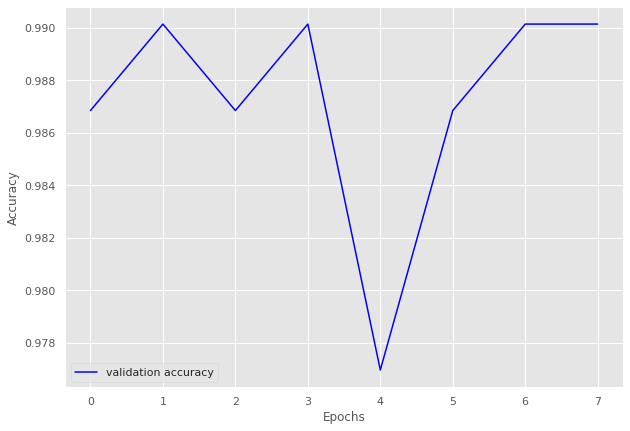

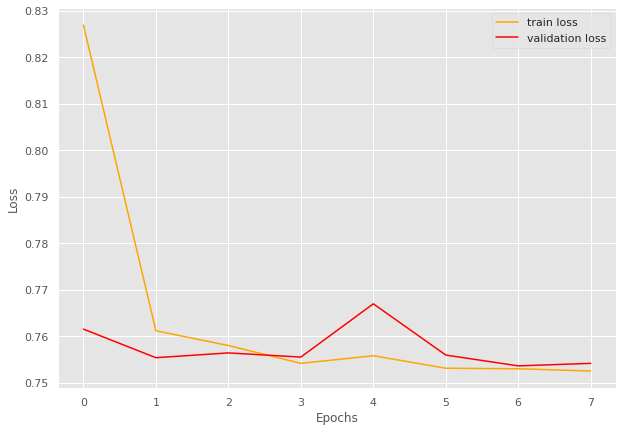

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 74/74 [00:53<00:00,  1.40batch/s, loss=1.24]


train loss 1.2431822805791288, validation loss 1.089310312271118, validation accuracy 0.9551724137931035
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 74/74 [00:24<00:00,  2.99batch/s, loss=1.12]


train loss 1.1189333715954342, validation loss 1.0884108781814574, validation accuracy 0.9517241379310345
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.91batch/s, loss=1.1] 


train loss 1.1014371047148834, validation loss 1.0844314575195313, validation accuracy 0.9551724137931035
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 74/74 [00:27<00:00,  2.73batch/s, loss=1.09]


train loss 1.0870481455648267, validation loss 1.078604245185852, validation accuracy 0.9689655172413794
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 74/74 [00:24<00:00,  2.99batch/s, loss=1.09]


INFO: Early stopping counter 1 of 5
train loss 1.0867678539173022, validation loss 1.093317413330078, validation accuracy 0.9517241379310345
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.85batch/s, loss=1.09]


train loss 1.0895007961505168, validation loss 1.0742741346359252, validation accuracy 0.9724137931034482
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 74/74 [00:24<00:00,  2.98batch/s, loss=1.09]


INFO: Early stopping counter 2 of 5
train loss 1.0875868587880522, validation loss 1.0884195804595946, validation accuracy 0.9551724137931035
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 74/74 [00:24<00:00,  2.97batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0730034612320565, validation loss 1.08593647480011, validation accuracy 0.9551724137931035
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.96batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.074224288399155, validation loss 1.074526071548462, validation accuracy 0.9724137931034482
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.95batch/s, loss=1.07]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9545970488081725 and loss 1.0896469950675964


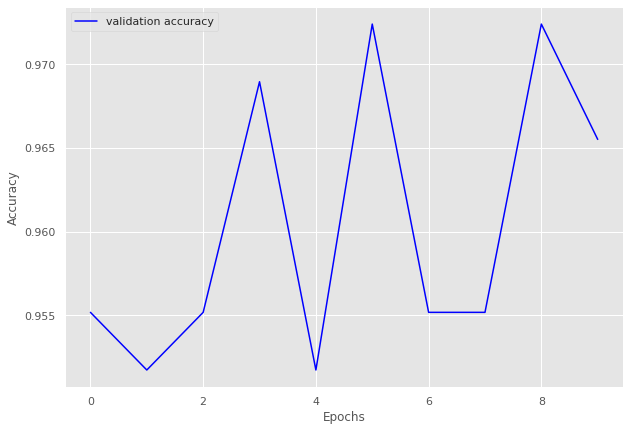

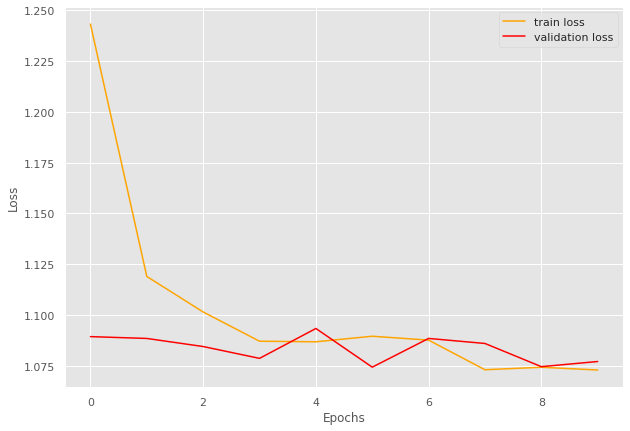

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 65/65 [00:22<00:00,  2.88batch/s, loss=0.658]


train loss 0.6582957405310411, validation loss 0.5800491094589233, validation accuracy 0.9691119691119691
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.89batch/s, loss=0.599]


train loss 0.5990293988814721, validation loss 0.5741149187088013, validation accuracy 0.9768339768339769
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.88batch/s, loss=0.582]


train loss 0.5824158806067247, validation loss 0.5738799810409546, validation accuracy 0.972972972972973
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.93batch/s, loss=0.573]


INFO: Early stopping counter 1 of 5
train loss 0.5733977565398582, validation loss 0.574024772644043, validation accuracy 0.9768339768339769
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.90batch/s, loss=0.573]


train loss 0.5726803156045767, validation loss 0.572422730922699, validation accuracy 0.972972972972973
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.89batch/s, loss=0.57] 


INFO: Early stopping counter 2 of 5
train loss 0.569861636712001, validation loss 0.5790590882301331, validation accuracy 0.9652509652509652
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=0.568]


train loss 0.5682888361123892, validation loss 0.5702478170394898, validation accuracy 0.9768339768339769
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.93batch/s, loss=0.57] 


INFO: Early stopping counter 3 of 5
train loss 0.5699273109436035, validation loss 0.5735119104385376, validation accuracy 0.972972972972973
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=0.565]


INFO: Early stopping counter 4 of 5
train loss 0.565261617073646, validation loss 0.5706884503364563, validation accuracy 0.9768339768339769
Coarse label 13 Epoch 10
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=0.565]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9743918053777209 and loss 0.5825914648862985


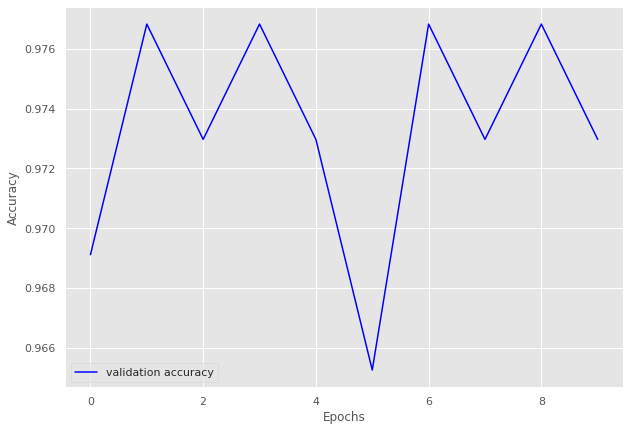

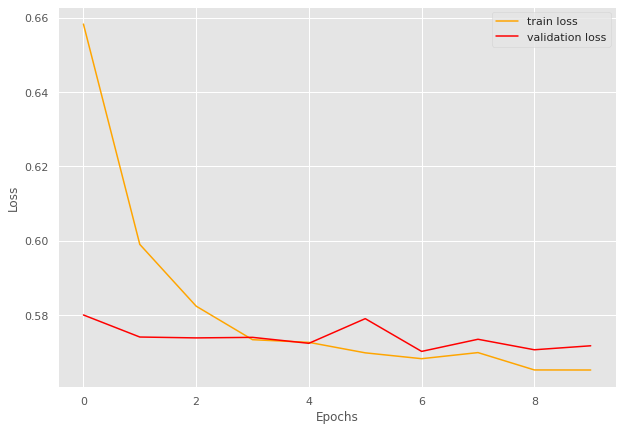

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 150/150 [00:51<00:00,  2.93batch/s, loss=1.14]


train loss 1.1402745413780213, validation loss 1.080906057357788, validation accuracy 0.9646464646464646
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.94batch/s, loss=1.08]


train loss 1.0834225455919901, validation loss 1.0762035965919494, validation accuracy 0.9696969696969697
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.93batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.073883941968282, validation loss 1.0772950172424316, validation accuracy 0.968013468013468
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.94batch/s, loss=1.07]


train loss 1.071496741771698, validation loss 1.0713217377662658, validation accuracy 0.9747474747474747
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 150/150 [00:50<00:00,  2.94batch/s, loss=1.07]


train loss 1.0660244647661845, validation loss 1.0611775994300843, validation accuracy 0.9831649831649831
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0606064279874166, validation loss 1.076614463329315, validation accuracy 0.9629629629629629
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 150/150 [00:50<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0583431045214335, validation loss 1.0681391835212708, validation accuracy 0.9747474747474747
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.92batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0556313077608743, validation loss 1.0627211928367615, validation accuracy 0.9814814814814815
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 150/150 [00:50<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9682097044060234 and loss 1.0742271974168975


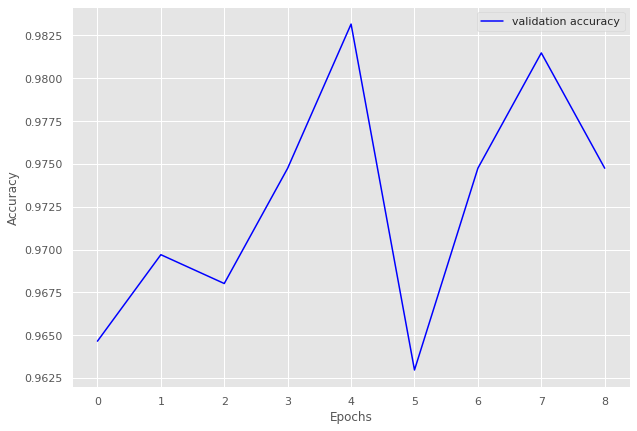

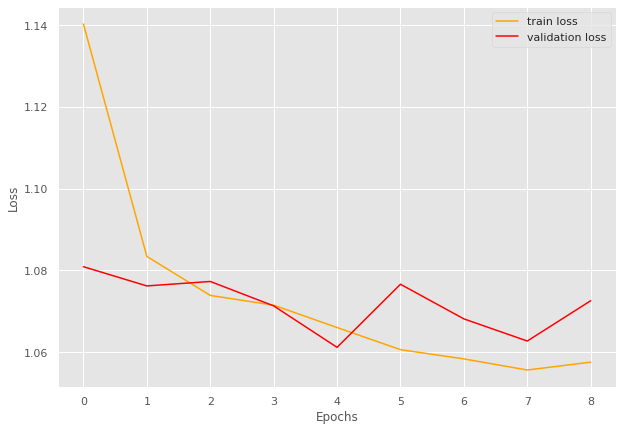

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 74/74 [00:25<00:00,  2.91batch/s, loss=0.868]


train loss 0.8678072964822924, validation loss 0.7725796580314637, validation accuracy 0.9761904761904762
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.86batch/s, loss=0.777]


train loss 0.7774090114477519, validation loss 0.7672999858856201, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.91batch/s, loss=0.766]


train loss 0.7657248804698119, validation loss 0.7552490234375, validation accuracy 0.9863945578231292
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=0.758]


INFO: Early stopping counter 1 of 5
train loss 0.7577960877805143, validation loss 0.7622827172279358, validation accuracy 0.9829931972789115
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.95batch/s, loss=0.757]


INFO: Early stopping counter 2 of 5
train loss 0.7572101620403496, validation loss 0.7623024225234986, validation accuracy 0.9829931972789115
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=0.758]


train loss 0.7579170199664863, validation loss 0.7537392973899841, validation accuracy 0.9897959183673469
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 74/74 [00:27<00:00,  2.65batch/s, loss=0.757]


INFO: Early stopping counter 3 of 5
train loss 0.7573075640845943, validation loss 0.7565534234046936, validation accuracy 0.9863945578231292
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.92batch/s, loss=0.753]


train loss 0.7530157694945464, validation loss 0.7449172258377075, validation accuracy 1.0
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 74/74 [00:28<00:00,  2.64batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.7506575809942709, validation loss 0.7531692981719971, validation accuracy 0.9931972789115646
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.90batch/s, loss=0.752]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9785553047404063 and loss 0.7642210934843335


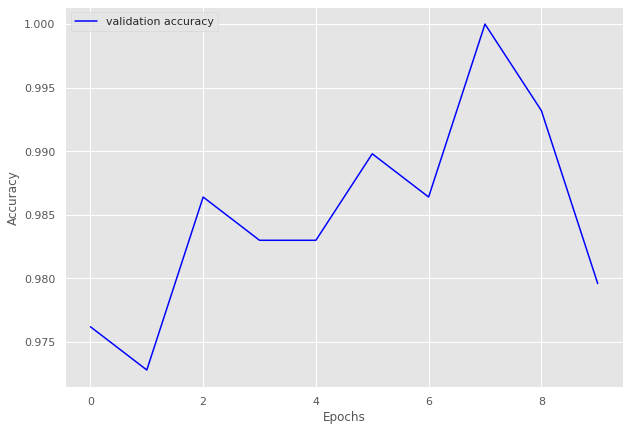

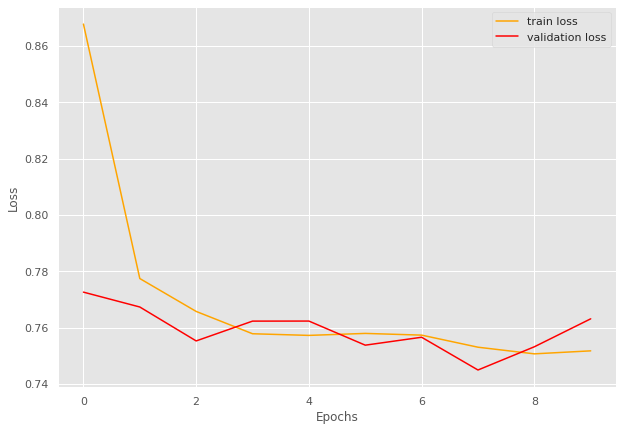

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 71/71 [00:24<00:00,  2.95batch/s, loss=0.642]


train loss 0.6416400578660024, validation loss 0.5873886942863464, validation accuracy 0.9574468085106383
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.94batch/s, loss=0.578]


train loss 0.5776600946842785, validation loss 0.5862739205360412, validation accuracy 0.9609929078014184
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.94batch/s, loss=0.569]


train loss 0.5690261335440085, validation loss 0.5775354266166687, validation accuracy 0.975177304964539
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.96batch/s, loss=0.563]


INFO: Early stopping counter 1 of 5
train loss 0.5632128916995626, validation loss 0.5790610671043396, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.95batch/s, loss=0.564]


train loss 0.5635398047071107, validation loss 0.5730734229087829, validation accuracy 0.975177304964539
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.94batch/s, loss=0.56] 


INFO: Early stopping counter 2 of 5
train loss 0.5602166879344994, validation loss 0.5772287011146545, validation accuracy 0.975177304964539
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.96batch/s, loss=0.563]


INFO: Early stopping counter 3 of 5
train loss 0.5632132761914965, validation loss 0.5874472737312317, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.94batch/s, loss=0.562]


train loss 0.5616845916694319, validation loss 0.5653985261917114, validation accuracy 0.9893617021276596
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.94batch/s, loss=0.561]


INFO: Early stopping counter 4 of 5
train loss 0.5608052460240646, validation loss 0.5691999554634094, validation accuracy 0.9858156028368794
Coarse label 16 Epoch 10
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.95batch/s, loss=0.557]


train loss 0.5574506294559425, validation loss 0.5644452214241028, validation accuracy 0.9858156028368794
Coarse label 16 Epoch 11
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.95batch/s, loss=0.555]


train loss 0.5552758280660065, validation loss 0.5578299283981323, validation accuracy 0.9929078014184397
Coarse label 16 Epoch 12
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.93batch/s, loss=0.558]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9811764705882353 and loss 0.5713719555309841


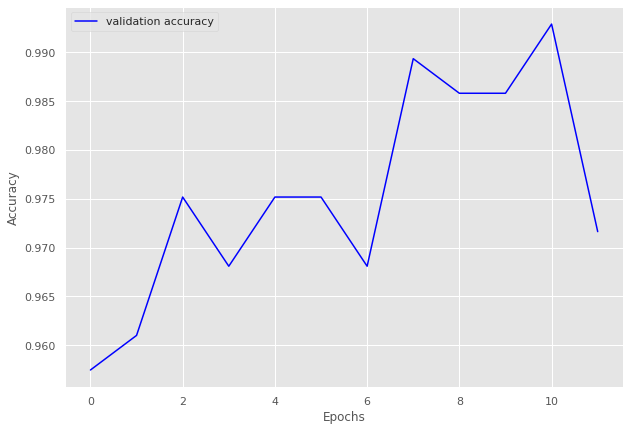

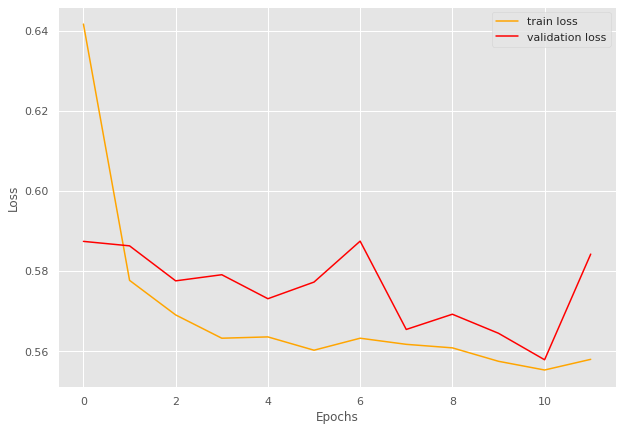

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 78/78 [00:26<00:00,  2.95batch/s, loss=0.879]


train loss 0.8789834976196289, validation loss 0.8005640268325805, validation accuracy 0.9449838187702265
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.96batch/s, loss=0.791]


train loss 0.7906498083701501, validation loss 0.7921788573265076, validation accuracy 0.9546925566343042
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.92batch/s, loss=0.778]


train loss 0.7775109486702161, validation loss 0.79173583984375, validation accuracy 0.9449838187702265
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.90batch/s, loss=0.77] 


train loss 0.7698257680122669, validation loss 0.7769841194152832, validation accuracy 0.9676375404530745
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.94batch/s, loss=0.765]


train loss 0.7649801526314173, validation loss 0.7756641030311584, validation accuracy 0.9676375404530745
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.96batch/s, loss=0.765]


train loss 0.7649549643198649, validation loss 0.771858525276184, validation accuracy 0.970873786407767
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.91batch/s, loss=0.762]


train loss 0.7621315969870641, validation loss 0.7663726925849914, validation accuracy 0.9773462783171522
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.95batch/s, loss=0.76] 


INFO: Early stopping counter 1 of 5
train loss 0.7601132797889221, validation loss 0.7691163420677185, validation accuracy 0.970873786407767
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.91batch/s, loss=0.76] 


INFO: Early stopping counter 2 of 5
train loss 0.7603644805076795, validation loss 0.7790097117424011, validation accuracy 0.9644012944983819
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.93batch/s, loss=0.765]


INFO: Early stopping counter 3 of 5
train loss 0.7648188739250867, validation loss 0.7756988286972046, validation accuracy 0.970873786407767
Coarse label 17 Epoch 11
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.94batch/s, loss=0.759]


INFO: Early stopping counter 4 of 5
train loss 0.7588155697553586, validation loss 0.7744564056396485, validation accuracy 0.9676375404530745
Coarse label 17 Epoch 12
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.93batch/s, loss=0.761]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9656652360515021 and loss 0.7802394072214762


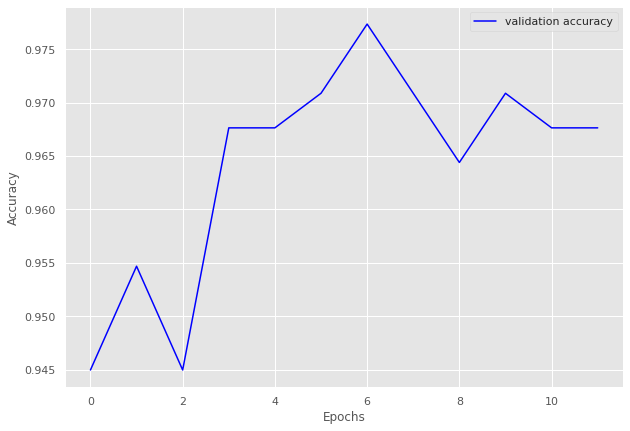

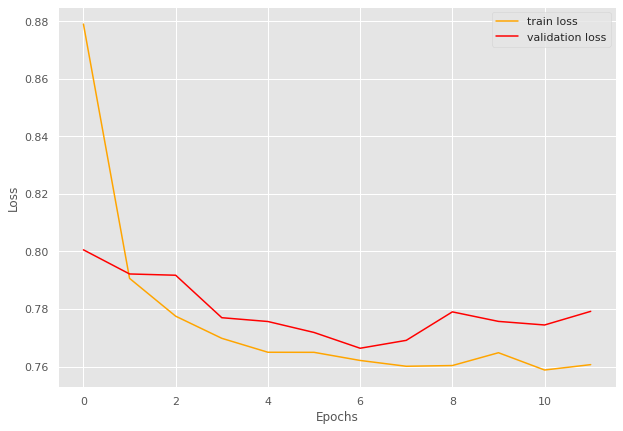

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 25/25 [00:08<00:00,  2.94batch/s, loss=0.965]


train loss 0.9654251360893249, validation loss 0.817187637090683, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:09<00:00,  2.76batch/s, loss=0.777]


train loss 0.7768840980529785, validation loss 0.7882291674613953, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.95batch/s, loss=0.756]


train loss 0.7560309362411499, validation loss 0.7716359496116638, validation accuracy 0.96875
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.95batch/s, loss=0.756]


train loss 0.75628169298172, validation loss 0.7687010765075684, validation accuracy 0.96875
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.93batch/s, loss=0.753]


train loss 0.7527837705612183, validation loss 0.7608532607555389, validation accuracy 0.9895833333333334
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.01batch/s, loss=0.75] 


INFO: Early stopping counter 1 of 5
train loss 0.7497393465042115, validation loss 0.7648540139198303, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.01batch/s, loss=0.747]


INFO: Early stopping counter 2 of 5
train loss 0.7474105906486511, validation loss 0.7737879753112793, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.97batch/s, loss=0.749]


INFO: Early stopping counter 3 of 5
train loss 0.7489074563980103, validation loss 0.7633268535137177, validation accuracy 0.9895833333333334
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.96batch/s, loss=0.748]


train loss 0.7483710265159607, validation loss 0.7541234195232391, validation accuracy 1.0
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.99batch/s, loss=0.748]


train loss 0.7479558253288269, validation loss 0.7529354691505432, validation accuracy 0.9895833333333334
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.99batch/s, loss=0.749]


train loss 0.7494069457054138, validation loss 0.7509606778621674, validation accuracy 0.9895833333333334
Coarse label 19 Epoch 12
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.95batch/s, loss=0.749]


train loss 0.7493822002410888, validation loss 0.7468119263648987, validation accuracy 1.0
Coarse label 19 Epoch 13
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.97batch/s, loss=0.749]


train loss 0.7488987898826599, validation loss 0.7455925047397614, validation accuracy 1.0
Coarse label 19 Epoch 14
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.00batch/s, loss=0.747]


INFO: Early stopping counter 4 of 5
train loss 0.7471176981925964, validation loss 0.7709124982357025, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 15
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.93batch/s, loss=0.752]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.972972972972973 and loss 0.7698107123374939


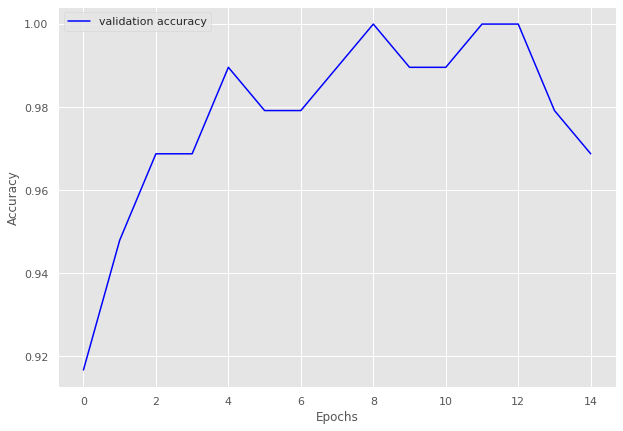

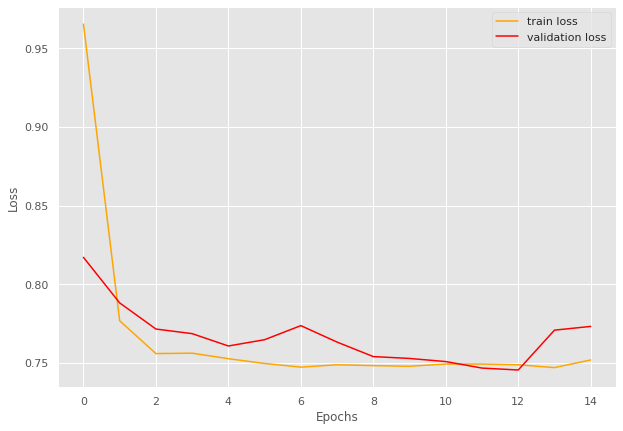

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Starting run 3
defaultdict(<class 'list'>, {10: [0], 15: [1, 38, 54, 62], 12: [2, 7, 12, 45, 49, 91], 17: [3, 25, 66, 83], 5: [4, 77], 8: [5, 60, 70, 73, 75, 78, 82], 1: [6, 53, 56, 58, 79, 80], 11: [8, 31, 51, 61], 0: [9, 17, 26, 55, 69], 7: [10, 23, 39, 67], 9: [11, 18, 34, 46, 57, 63, 68, 76, 92, 93], 2: [13, 19, 20, 36, 41, 42, 47, 48, 71, 88], 6: [14, 15, 22, 32, 35, 43, 52], 4: [16, 21, 24, 30, 64, 72], 13: [27, 29, 81], 14: [28, 33, 37, 44, 89, 90], 16: [40, 59, 87], 18: [50], 19: [65, 74, 84, 85], 3: [86]})
Calculating for volume 15
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.00batch/s, loss=1.37]


train loss 1.3682777626173837, validation loss 1.1149740389415197, validation accuracy 0.8414918414918415
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.03batch/s, loss=1.01]


train loss 1.0114814553942, validation loss 1.0110805034637451, validation accuracy 0.8951048951048951
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.02batch/s, loss=0.943]


train loss 0.9425354046480996, validation loss 0.988722699029105, validation accuracy 0.9114219114219114
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.99batch/s, loss=0.931]


train loss 0.9306959594999041, validation loss 0.9797734107289996, validation accuracy 0.9300699300699301
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.02batch/s, loss=0.925]


INFO: Early stopping counter 1 of 5
train loss 0.9248682345662799, validation loss 0.9857573764664787, validation accuracy 0.9230769230769231
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.94batch/s, loss=0.919]


INFO: Early stopping counter 2 of 5
train loss 0.9192508842263903, validation loss 0.9861698065485273, validation accuracy 0.9207459207459208
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.00batch/s, loss=0.917]


INFO: Early stopping counter 3 of 5
train loss 0.9172792860439846, validation loss 0.9856786131858826, validation accuracy 0.9207459207459208
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.02batch/s, loss=0.914]


INFO: Early stopping counter 4 of 5
train loss 0.9141139217785427, validation loss 0.981337879385267, validation accuracy 0.9254079254079254
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.90batch/s, loss=0.914]


train loss 0.9136612926210675, validation loss 0.9764813099588666, validation accuracy 0.9324009324009324
Coarse label 0 Epoch 10
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.01batch/s, loss=0.913]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9258402503742006 and loss 0.980933824311132


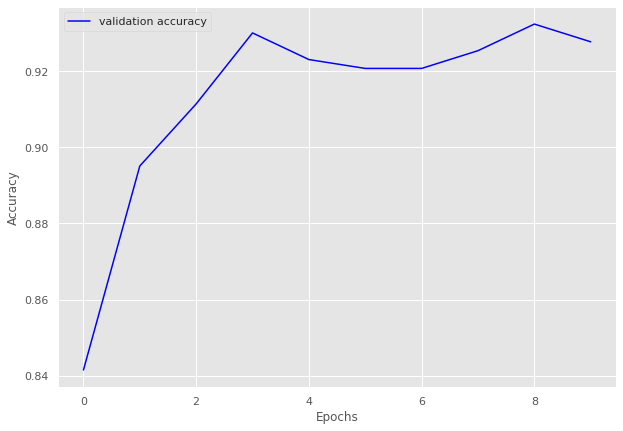

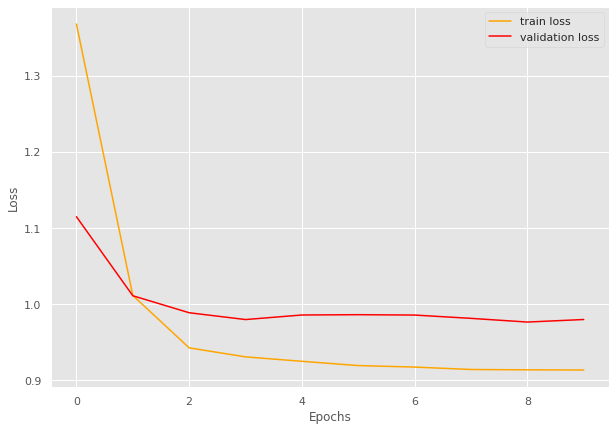

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 6/6 [00:01<00:00,  3.02batch/s, loss=1.63]


train loss 1.6309853593508403, validation loss 1.428004781405131, validation accuracy 0.8010752688172043
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.97batch/s, loss=1.23]


train loss 1.2332491676012676, validation loss 1.2281653086344402, validation accuracy 0.8494623655913979
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.95batch/s, loss=1.1] 


train loss 1.096207062403361, validation loss 1.1697728236516316, validation accuracy 0.8924731182795699
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.98batch/s, loss=1.06]


train loss 1.057641903559367, validation loss 1.150522510210673, validation accuracy 0.9032258064516129
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 6/6 [00:01<00:00,  3.00batch/s, loss=1.05]


train loss 1.048064132531484, validation loss 1.1435765027999878, validation accuracy 0.8978494623655914
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.81batch/s, loss=1.05]


train loss 1.0476390719413757, validation loss 1.13838525613149, validation accuracy 0.9032258064516129
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.98batch/s, loss=1.05]


train loss 1.0451194842656453, validation loss 1.1307107210159302, validation accuracy 0.9193548387096774
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 6/6 [00:01<00:00,  3.01batch/s, loss=1.05]


train loss 1.047801951567332, validation loss 1.1295119126637776, validation accuracy 0.9247311827956989
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.81batch/s, loss=1.05]


INFO: Early stopping counter 1 of 5
train loss 1.0469282269477844, validation loss 1.1305894056955974, validation accuracy 0.9193548387096774
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.93batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.0468722979227703, validation loss 1.1300172011057537, validation accuracy 0.9193548387096774
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 6/6 [00:01<00:00,  3.00batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.046823501586914, validation loss 1.1301579872767131, validation accuracy 0.9139784946236559
Coarse label 1 Epoch 12
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.95batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0473128358523052, validation loss 1.1305968364079793, validation accuracy 0.9139784946236559
Coarse label 1 Epoch 13
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.94batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9115348546420756 and loss 1.13312255859375


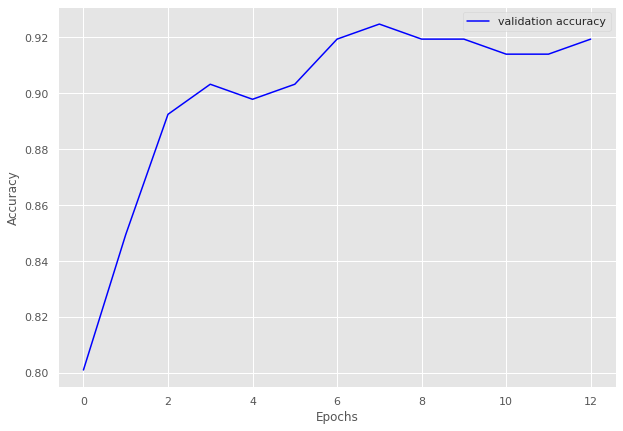

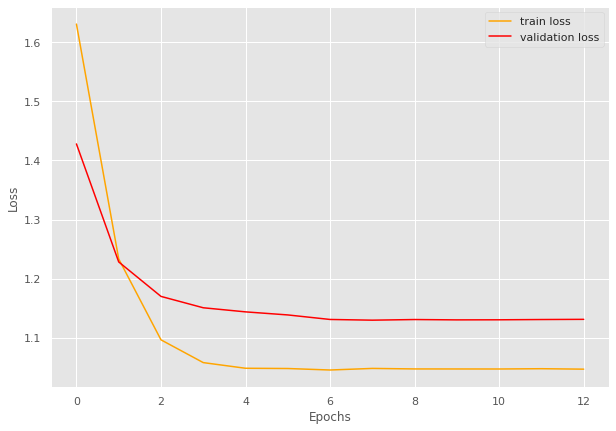

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=1.93]


train loss 1.9330296686717443, validation loss 1.7039377008165633, validation accuracy 0.7931034482758621
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=1.6] 


train loss 1.6046038142272405, validation loss 1.5911714690072196, validation accuracy 0.8885057471264368
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.53]


train loss 1.5343764977795737, validation loss 1.5703202060290746, validation accuracy 0.9057471264367816
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=1.51]


train loss 1.510527206318719, validation loss 1.5538222193717957, validation accuracy 0.9172413793103448
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.49]


train loss 1.4905880774770464, validation loss 1.5433615786688668, validation accuracy 0.9275862068965517
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4882670726094926, validation loss 1.5439303602491106, validation accuracy 0.9252873563218391
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=1.48]


INFO: Early stopping counter 2 of 5
train loss 1.482289697442736, validation loss 1.5457292369433813, validation accuracy 0.9241379310344827
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=1.48]


train loss 1.4845672632966722, validation loss 1.5389766352517265, validation accuracy 0.9287356321839081
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4819511430604118, validation loss 1.547138273715973, validation accuracy 0.9229885057471264
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:10<00:00,  2.59batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4804767072200775, validation loss 1.5439306923321314, validation accuracy 0.9218390804597701
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.900650701012947 and loss 1.5623142028571197


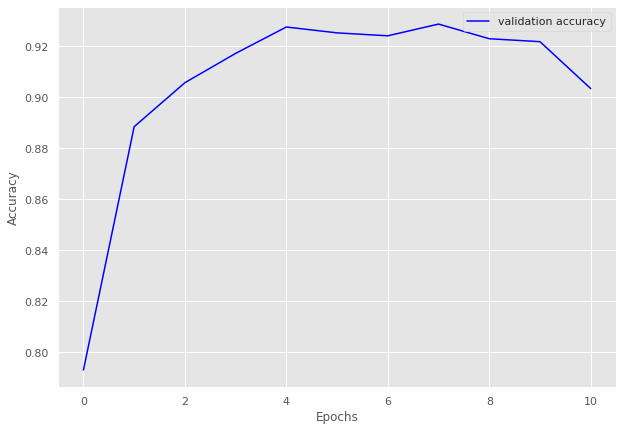

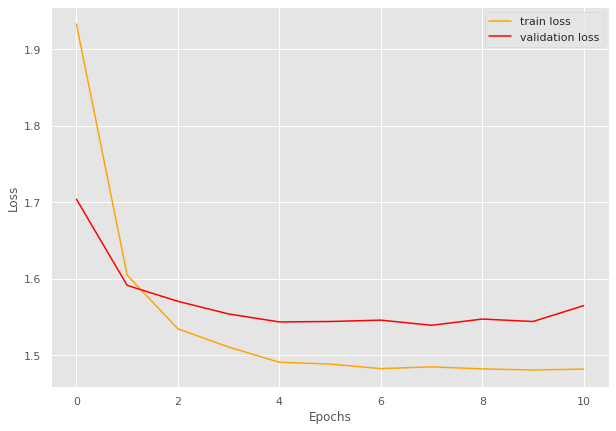

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 13/13 [00:04<00:00,  2.83batch/s, loss=1.56]


train loss 1.5568762559157152, validation loss 1.3501980475017004, validation accuracy 0.7475728155339806
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.87batch/s, loss=1.2]


train loss 1.1967593064674964, validation loss 1.2324275800159998, validation accuracy 0.8300970873786407
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.96batch/s, loss=1.11]


train loss 1.1133933709217951, validation loss 1.182584592274257, validation accuracy 0.8640776699029126
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.94batch/s, loss=1.09]


train loss 1.0921436915030847, validation loss 1.1600793940680367, validation accuracy 0.8907766990291263
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.87batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.0784395382954524, validation loss 1.1700749737875802, validation accuracy 0.8859223300970874
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.98batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.072213420501122, validation loss 1.1651637724467687, validation accuracy 0.8786407766990292
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.97batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0668823994123018, validation loss 1.162761160305568, validation accuracy 0.8859223300970874
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.80batch/s, loss=1.06]


train loss 1.0615975123185377, validation loss 1.156365990638733, validation accuracy 0.8932038834951457
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.86batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0608975978998036, validation loss 1.15998375415802, validation accuracy 0.8883495145631068
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.92batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9074758385446277 and loss 1.1379845088178462


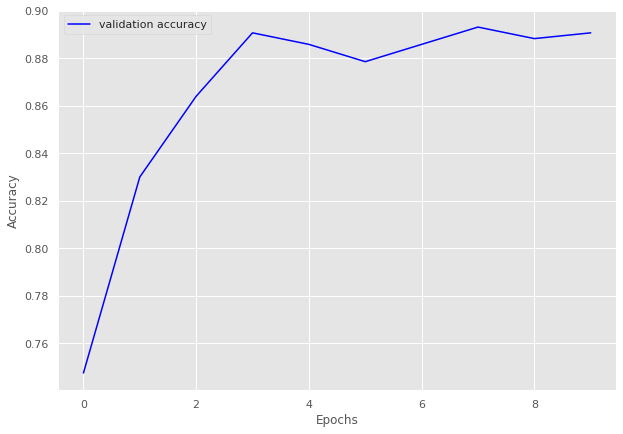

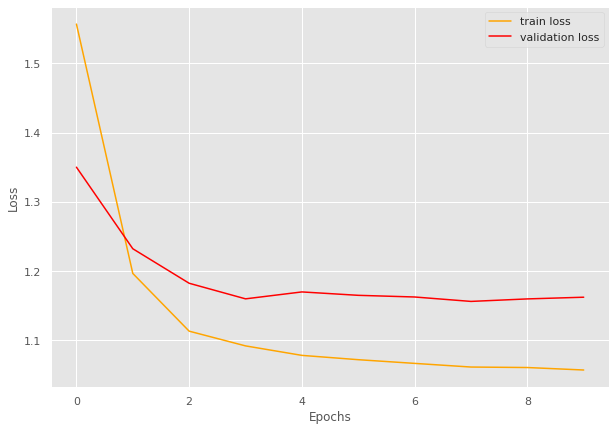

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 5/5 [00:01<00:00,  2.87batch/s, loss=0.564]


train loss 0.5637983441352844, validation loss 0.46962815523147583, validation accuracy 0.89937106918239
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.85batch/s, loss=0.359]


train loss 0.35929120779037477, validation loss 0.3867437144120534, validation accuracy 0.9245283018867925
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.82batch/s, loss=0.332]


train loss 0.33182395100593565, validation loss 0.37666577100753784, validation accuracy 0.9308176100628931
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.90batch/s, loss=0.321]


train loss 0.32081063389778136, validation loss 0.3710227111975352, validation accuracy 0.9371069182389937
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.77batch/s, loss=0.316]


train loss 0.3160978615283966, validation loss 0.3660525580247243, validation accuracy 0.9433962264150944
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.87batch/s, loss=0.314]


train loss 0.3140335738658905, validation loss 0.36010844508806866, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.89batch/s, loss=0.314]


train loss 0.313610827922821, validation loss 0.35796744624773663, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.79batch/s, loss=0.314]


train loss 0.31361163854599, validation loss 0.3573078413804372, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.84batch/s, loss=0.314]


train loss 0.3135781228542328, validation loss 0.3571176032225291, validation accuracy 0.949685534591195
Coarse label 5 Epoch 10
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.80batch/s, loss=0.313]


INFO: Early stopping counter 1 of 5
train loss 0.31341363191604615, validation loss 0.35745202501614887, validation accuracy 0.949685534591195
Coarse label 5 Epoch 11
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.92batch/s, loss=0.314]


INFO: Early stopping counter 2 of 5
train loss 0.3135335981845856, validation loss 0.35802488525708515, validation accuracy 0.949685534591195
Coarse label 5 Epoch 12
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.90batch/s, loss=0.313]


INFO: Early stopping counter 3 of 5
train loss 0.31339825987815856, validation loss 0.35910601417223614, validation accuracy 0.949685534591195
Coarse label 5 Epoch 13
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.91batch/s, loss=0.313]


INFO: Early stopping counter 4 of 5
train loss 0.3133609235286713, validation loss 0.3603590826193492, validation accuracy 0.9433962264150944
Coarse label 5 Epoch 14
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.82batch/s, loss=0.313]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9712812960235641 and loss 0.3417359853899756


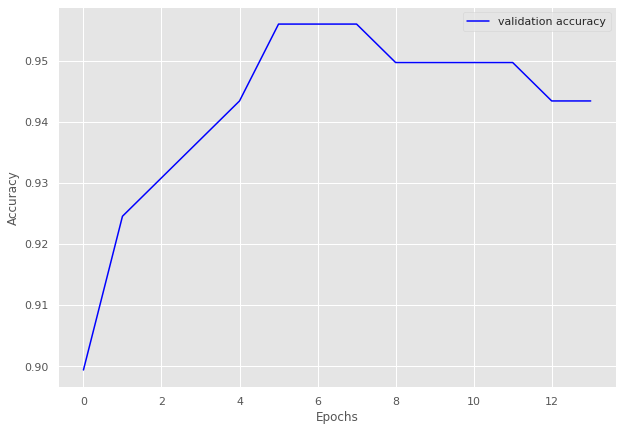

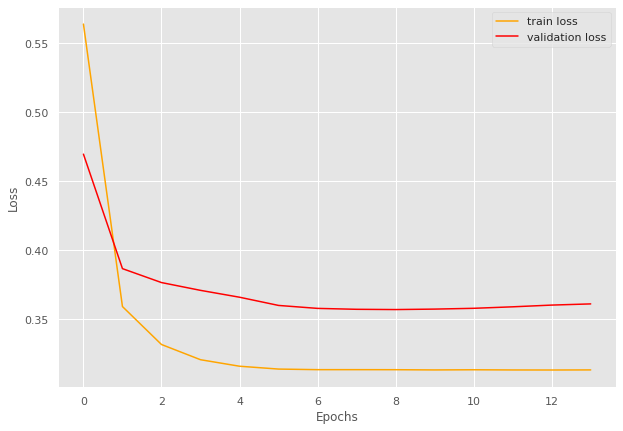

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 15/15 [00:05<00:00,  2.89batch/s, loss=1.61]


train loss 1.612111234664917, validation loss 1.3777064234018326, validation accuracy 0.8081896551724138
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.92batch/s, loss=1.3] 


train loss 1.2982994079589845, validation loss 1.2849406599998474, validation accuracy 0.8857758620689655
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.96batch/s, loss=1.23]


train loss 1.2258438269297283, validation loss 1.260411560535431, validation accuracy 0.9051724137931034
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.92batch/s, loss=1.2] 


INFO: Early stopping counter 1 of 5
train loss 1.1970199902852376, validation loss 1.2633086740970612, validation accuracy 0.9094827586206896
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.94batch/s, loss=1.2]


INFO: Early stopping counter 2 of 5
train loss 1.2007225036621094, validation loss 1.2671984285116196, validation accuracy 0.8900862068965517
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.97batch/s, loss=1.19]


train loss 1.1859169960021974, validation loss 1.2462847232818604, validation accuracy 0.915948275862069
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.95batch/s, loss=1.18]


train loss 1.1790888865788778, validation loss 1.2462686747312546, validation accuracy 0.9181034482758621
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.94batch/s, loss=1.18]


INFO: Early stopping counter 3 of 5
train loss 1.1818102439244589, validation loss 1.2487163096666336, validation accuracy 0.915948275862069
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.87batch/s, loss=1.18]


INFO: Early stopping counter 4 of 5
train loss 1.1766385237375896, validation loss 1.254690557718277, validation accuracy 0.9116379310344828
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.96batch/s, loss=1.17]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9195011337868481 and loss 1.2469370050430297


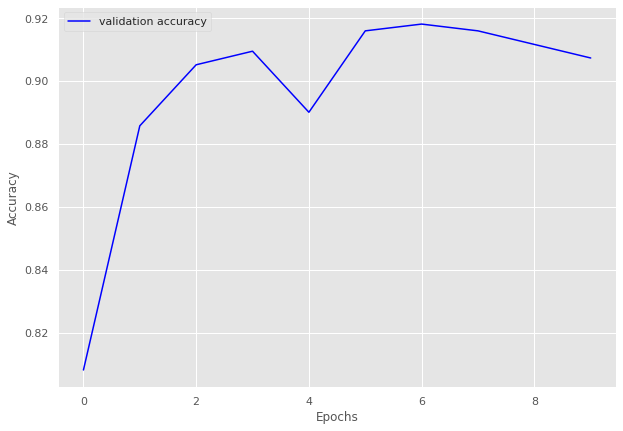

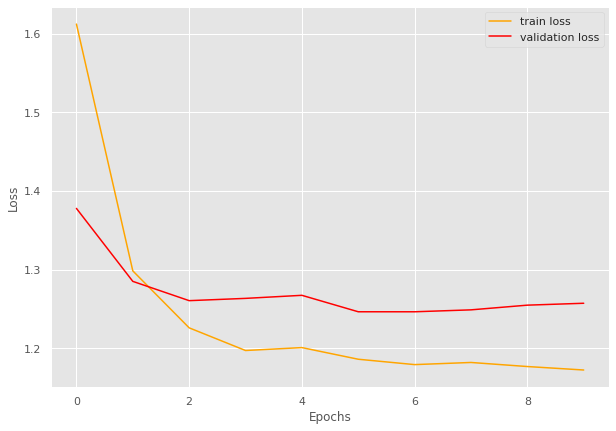

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 12/12 [00:03<00:00,  3.00batch/s, loss=1.06]


train loss 1.0575918356577556, validation loss 0.8299522399902344, validation accuracy 0.9421487603305785
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.03batch/s, loss=0.782]


train loss 0.7818716665108999, validation loss 0.7896872659524282, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.97batch/s, loss=0.762]


train loss 0.762227326631546, validation loss 0.7811192770799001, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.98batch/s, loss=0.75] 


train loss 0.7496909648180008, validation loss 0.7802277505397797, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.86batch/s, loss=0.751]


INFO: Early stopping counter 1 of 5
train loss 0.7507997850577036, validation loss 0.7819243669509888, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.01batch/s, loss=0.747]


INFO: Early stopping counter 2 of 5
train loss 0.7469140986601511, validation loss 0.7885743180910746, validation accuracy 0.9559228650137741
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.84batch/s, loss=0.746]


train loss 0.7459900577863058, validation loss 0.7795645594596863, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.02batch/s, loss=0.745]


INFO: Early stopping counter 3 of 5
train loss 0.745483527580897, validation loss 0.7805835505326589, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.62batch/s, loss=0.745]


INFO: Early stopping counter 4 of 5
train loss 0.7451594670613607, validation loss 0.7816381255785624, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 10
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.65batch/s, loss=0.746]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9576898326898327 and loss 0.7867416173827891


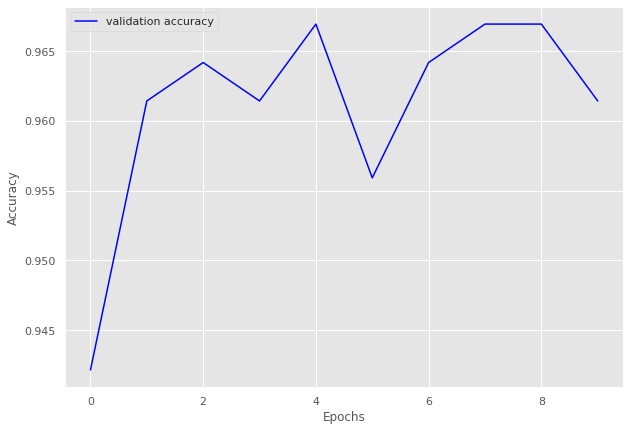

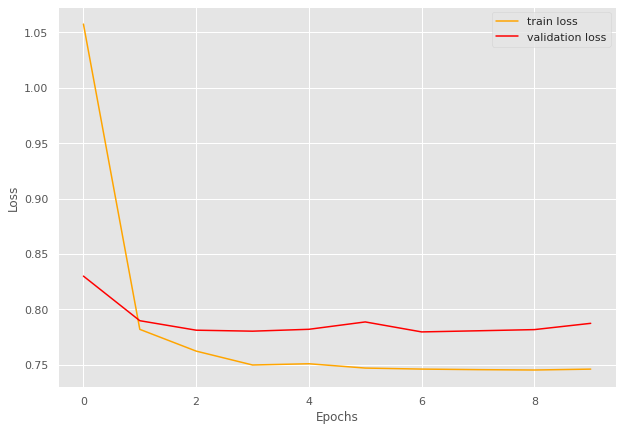

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 17/17 [00:13<00:00,  1.31batch/s, loss=1.7] 


train loss 1.69704367833979, validation loss 1.3845022320747375, validation accuracy 0.8062622309197651
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 17/17 [00:11<00:00,  1.44batch/s, loss=1.33]


train loss 1.3277953652774586, validation loss 1.2799776792526245, validation accuracy 0.898238747553816
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 17/17 [00:12<00:00,  1.34batch/s, loss=1.25]


train loss 1.2495607979157393, validation loss 1.2427472174167633, validation accuracy 0.9315068493150684
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 17/17 [00:09<00:00,  1.86batch/s, loss=1.24]


INFO: Early stopping counter 1 of 5
train loss 1.237257950446185, validation loss 1.2514639645814896, validation accuracy 0.9158512720156555
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 17/17 [00:15<00:00,  1.13batch/s, loss=1.23]


train loss 1.2252683569403255, validation loss 1.239630550146103, validation accuracy 0.9275929549902152
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  2.89batch/s, loss=1.22]


train loss 1.2232673869413488, validation loss 1.2394408583641052, validation accuracy 0.9295499021526419
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 17/17 [00:06<00:00,  2.69batch/s, loss=1.21]


INFO: Early stopping counter 2 of 5
train loss 1.2112407894695507, validation loss 1.2447178810834885, validation accuracy 0.923679060665362
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.00batch/s, loss=1.22]


INFO: Early stopping counter 3 of 5
train loss 1.2212195957408232, validation loss 1.243208110332489, validation accuracy 0.923679060665362
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 17/17 [00:06<00:00,  2.57batch/s, loss=1.21]


INFO: Early stopping counter 4 of 5
train loss 1.2138590321821325, validation loss 1.2453049570322037, validation accuracy 0.923679060665362
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.08batch/s, loss=1.23]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.8960146587265231 and loss 1.2721764867323158


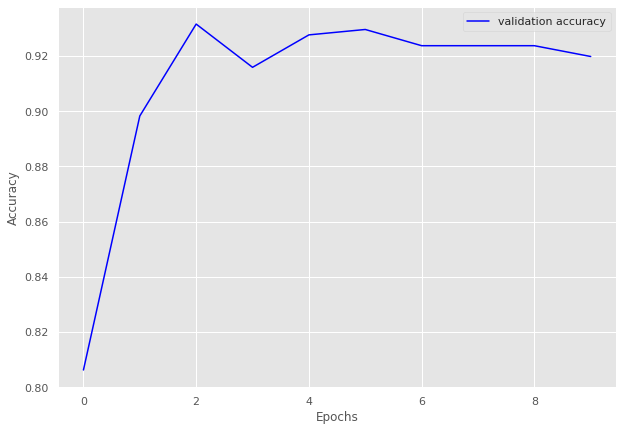

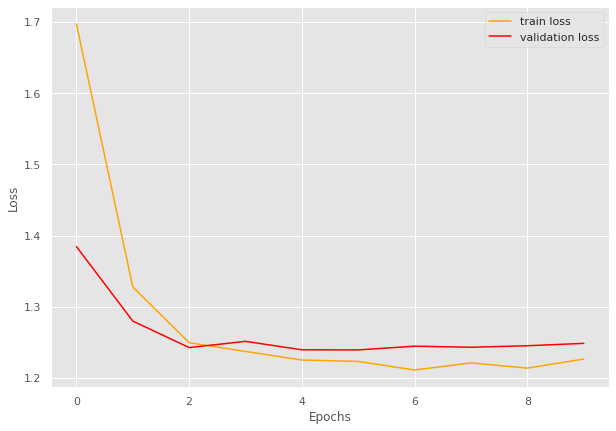

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 21/21 [00:07<00:00,  2.89batch/s, loss=1.92]


train loss 1.916800550052098, validation loss 1.7700223272497004, validation accuracy 0.7592592592592593
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.71batch/s, loss=1.61]


train loss 1.6057247036979312, validation loss 1.6559180671518499, validation accuracy 0.8641975308641975
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.72batch/s, loss=1.54]


train loss 1.5362236613319034, validation loss 1.5634691931984641, validation accuracy 0.9259259259259259
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.93batch/s, loss=1.5] 


train loss 1.5000155085609073, validation loss 1.5622977018356323, validation accuracy 0.9151234567901234
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 21/21 [00:06<00:00,  3.00batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4902101414544242, validation loss 1.5669175603172996, validation accuracy 0.9120370370370371
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.98batch/s, loss=1.49]


train loss 1.486761206672305, validation loss 1.5584859522906216, validation accuracy 0.9182098765432098
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.94batch/s, loss=1.48]


INFO: Early stopping counter 2 of 5
train loss 1.482429651986985, validation loss 1.5697466026652942, validation accuracy 0.9012345679012346
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 21/21 [00:09<00:00,  2.32batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4787283624921526, validation loss 1.5615964152596213, validation accuracy 0.9074074074074074
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 21/21 [00:16<00:00,  1.24batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4787359691801525, validation loss 1.5699141025543213, validation accuracy 0.9027777777777778
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 21/21 [00:13<00:00,  1.51batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9157923299565847 and loss 1.5480261407146565


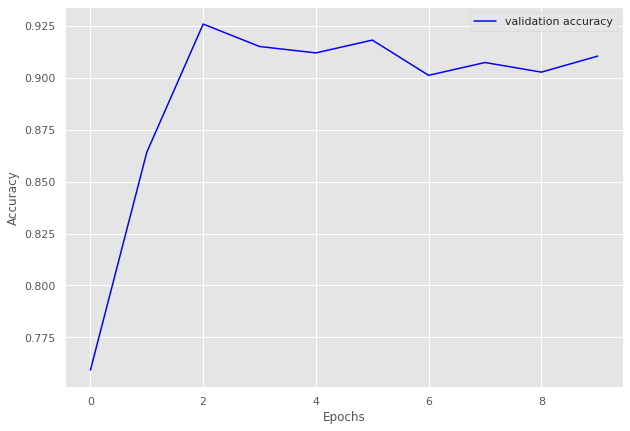

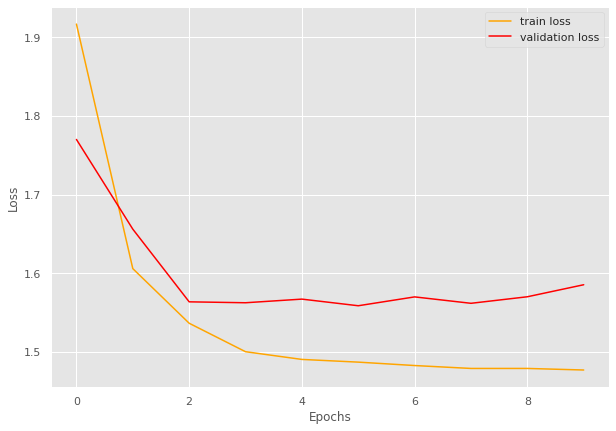

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 10/10 [00:03<00:00,  2.99batch/s, loss=1.12]


train loss 1.118440753221512, validation loss 0.8776203036308289, validation accuracy 0.9046052631578947
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:04<00:00,  2.35batch/s, loss=0.814]


train loss 0.8137328088283539, validation loss 0.7917862415313721, validation accuracy 0.9572368421052632
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:07<00:00,  1.26batch/s, loss=0.766]


train loss 0.7661807239055634, validation loss 0.7828326463699341, validation accuracy 0.9605263157894737
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.751]


train loss 0.75078045129776, validation loss 0.7722736835479737, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.747]


train loss 0.7467535614967347, validation loss 0.7655849099159241, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.96batch/s, loss=0.747]


train loss 0.7470370709896088, validation loss 0.7649744033813477, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.745]


train loss 0.7445663213729858, validation loss 0.7643663287162781, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:04<00:00,  2.33batch/s, loss=0.745]


train loss 0.7446451723575592, validation loss 0.7641331315040588, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:08<00:00,  1.24batch/s, loss=0.744]


INFO: Early stopping counter 1 of 5
train loss 0.7444456577301025, validation loss 0.7661000609397888, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:05<00:00,  1.74batch/s, loss=0.744]


INFO: Early stopping counter 2 of 5
train loss 0.7441525459289551, validation loss 0.7672158241271972, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:06<00:00,  1.53batch/s, loss=0.744]


INFO: Early stopping counter 3 of 5
train loss 0.7440308690071106, validation loss 0.766734492778778, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 12
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.744]


INFO: Early stopping counter 4 of 5
train loss 0.743917042016983, validation loss 0.7656538844108581, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 13
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.00batch/s, loss=0.744]


train loss 0.7439334750175476, validation loss 0.7635288238525391, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 14
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.744]


train loss 0.7438696503639222, validation loss 0.7625838637351989, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 15
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.744]


train loss 0.7438105285167694, validation loss 0.7619293332099915, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 16
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.744]


train loss 0.7437851011753083, validation loss 0.7613801240921021, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 17
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=0.744]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9608670631114521 and loss 0.7823897731013414


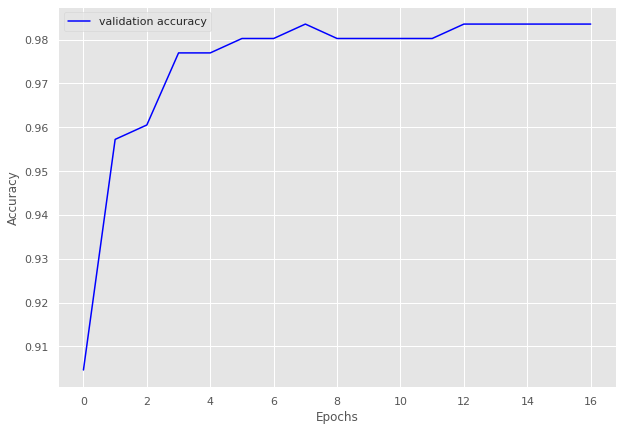

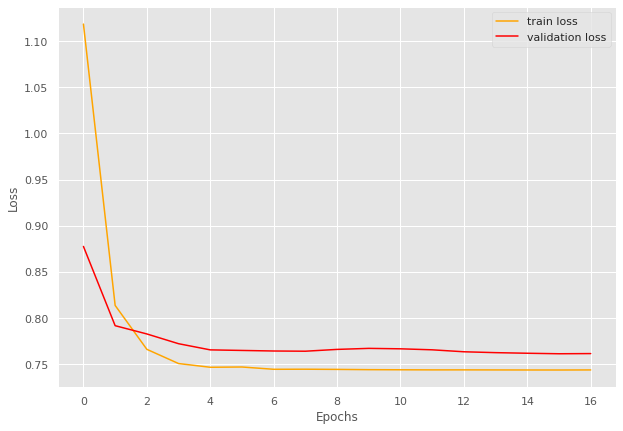

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 10/10 [00:03<00:00,  3.23batch/s, loss=1.62]


train loss 1.6207497477531434, validation loss 1.445064330101013, validation accuracy 0.6862068965517242
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.95batch/s, loss=1.28]


train loss 1.2796637892723084, validation loss 1.2513782978057861, validation accuracy 0.8206896551724138
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.87batch/s, loss=1.14]


train loss 1.1401823520660401, validation loss 1.2001900672912598, validation accuracy 0.8448275862068966
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.94batch/s, loss=1.1]


train loss 1.1022406458854674, validation loss 1.1813135385513305, validation accuracy 0.8689655172413793
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.73batch/s, loss=1.08]


train loss 1.0828957200050353, validation loss 1.173028826713562, validation accuracy 0.8724137931034482
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.83batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0741910696029664, validation loss 1.18205828666687, validation accuracy 0.8586206896551725
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0594688534736634, validation loss 1.1808744430541993, validation accuracy 0.8689655172413793
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=1.08]


INFO: Early stopping counter 3 of 5
train loss 1.0804261803627013, validation loss 1.1793946504592896, validation accuracy 0.8620689655172413
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.0704208254814147, validation loss 1.19586181640625, validation accuracy 0.8448275862068966
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.82batch/s, loss=1.07]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.8671483042343969 and loss 1.1807616780965755


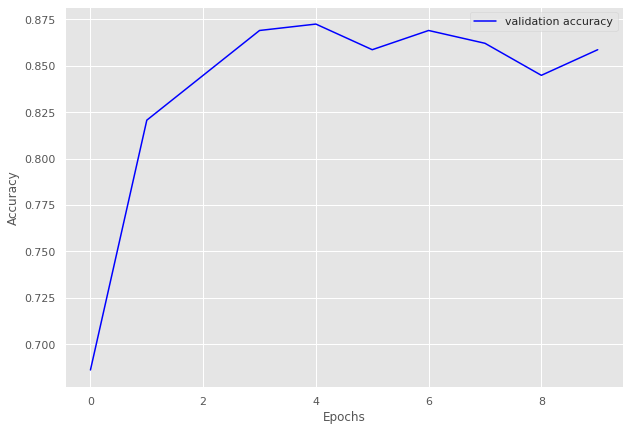

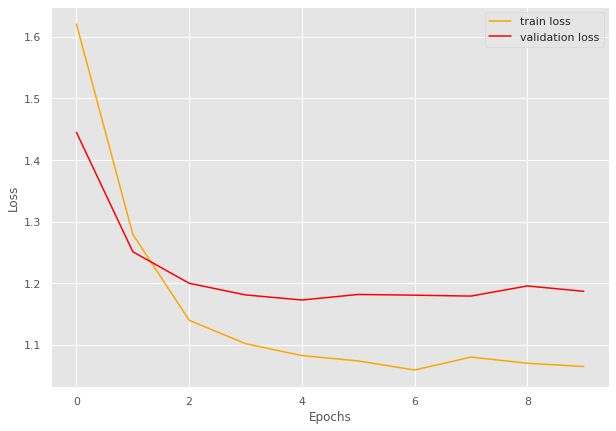

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 9/9 [00:03<00:00,  2.95batch/s, loss=0.838]


train loss 0.8376138607660929, validation loss 0.6570958375930787, validation accuracy 0.8957528957528957
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.99batch/s, loss=0.639]


train loss 0.6391859518157111, validation loss 0.5965406656265259, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.89batch/s, loss=0.597]


train loss 0.5974934101104736, validation loss 0.5917866587638855, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.88batch/s, loss=0.615]


INFO: Early stopping counter 1 of 5
train loss 0.6152946684095595, validation loss 0.5999322175979614, validation accuracy 0.9420849420849421
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.78batch/s, loss=0.57] 


INFO: Early stopping counter 2 of 5
train loss 0.5695374740494622, validation loss 0.5993857383728027, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.92batch/s, loss=0.569]


INFO: Early stopping counter 3 of 5
train loss 0.5691973500781589, validation loss 0.5933519124984741, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.09batch/s, loss=0.585]


INFO: Early stopping counter 4 of 5
train loss 0.5848671264118619, validation loss 0.5949561476707459, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.98batch/s, loss=0.559]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9197195838986884 and loss 0.6317085487501962


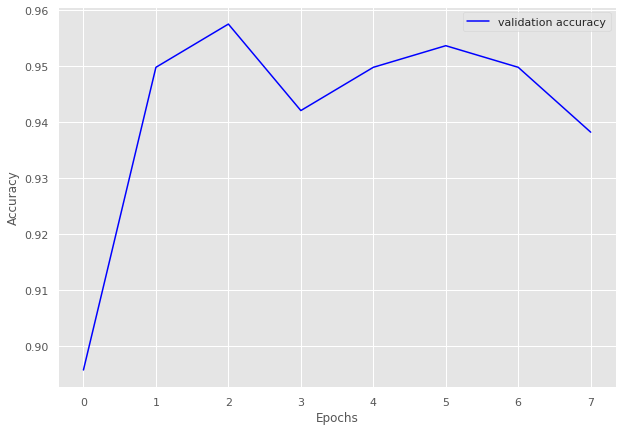

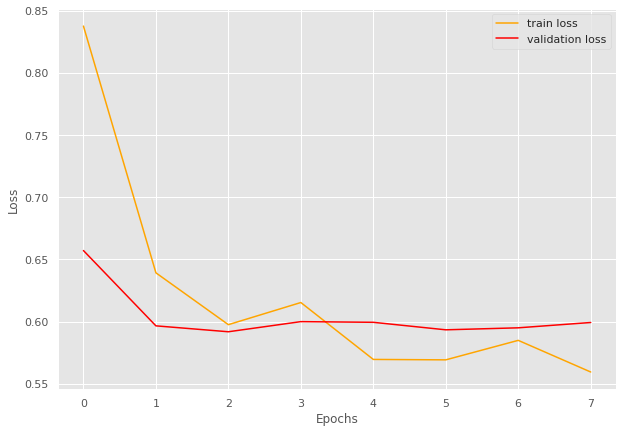

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 19/19 [00:06<00:00,  2.72batch/s, loss=1.41]


train loss 1.4096770537526984, validation loss 1.1705812573432923, validation accuracy 0.8872053872053872
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:07<00:00,  2.63batch/s, loss=1.1]


train loss 1.1010363039217497, validation loss 1.1315653204917908, validation accuracy 0.9090909090909091
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.87batch/s, loss=1.07]


train loss 1.0694295544373362, validation loss 1.1174811124801636, validation accuracy 0.9259259259259259
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.76batch/s, loss=1.06]


train loss 1.0644749402999878, validation loss 1.1133681535720825, validation accuracy 0.9292929292929293
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:07<00:00,  2.68batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0570328423851414, validation loss 1.1162357926368713, validation accuracy 0.9292929292929293
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:07<00:00,  2.50batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.054985567143089, validation loss 1.115025246143341, validation accuracy 0.930976430976431
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:07<00:00,  2.61batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0524389806546663, validation loss 1.1159355640411377, validation accuracy 0.9259259259259259
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:07<00:00,  2.70batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.049038799185502, validation loss 1.114056122303009, validation accuracy 0.9276094276094277
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:07<00:00,  2.68batch/s, loss=1.05]


train loss 1.0506692999287655, validation loss 1.1086291670799255, validation accuracy 0.9377104377104377
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 19/19 [00:07<00:00,  2.64batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9487634249679772 and loss 1.0960545344922528


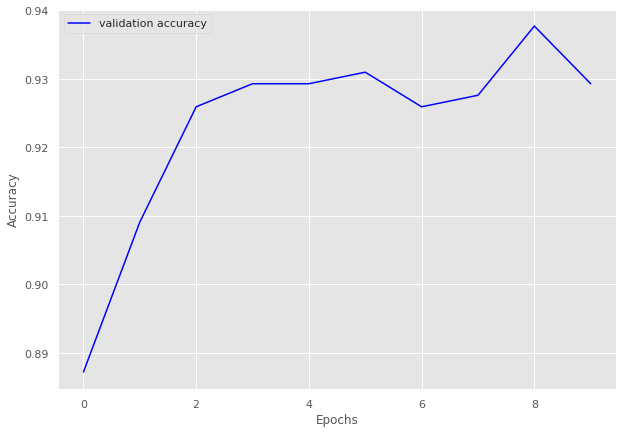

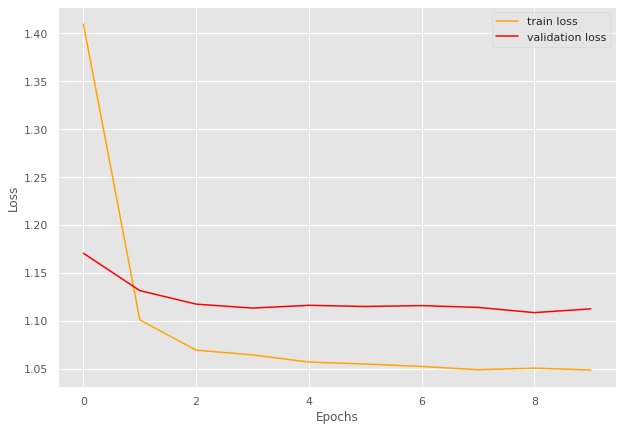

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 10/10 [00:03<00:00,  2.79batch/s, loss=1.15]


train loss 1.1498079657554627, validation loss 0.9591610789299011, validation accuracy 0.7891156462585034
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.79batch/s, loss=0.848]


train loss 0.8477211773395539, validation loss 0.8257108926773071, validation accuracy 0.9251700680272109
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.87batch/s, loss=0.775]


train loss 0.7746719121932983, validation loss 0.804091477394104, validation accuracy 0.95578231292517
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.88batch/s, loss=0.757]


INFO: Early stopping counter 1 of 5
train loss 0.7573216617107391, validation loss 0.8082913160324097, validation accuracy 0.9421768707482994
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.78batch/s, loss=0.755]


train loss 0.7553059935569764, validation loss 0.8036789536476135, validation accuracy 0.9455782312925171
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.84batch/s, loss=0.749]


INFO: Early stopping counter 2 of 5
train loss 0.7489101827144623, validation loss 0.8209817051887512, validation accuracy 0.9183673469387755
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.61batch/s, loss=0.756]


train loss 0.7558517098426819, validation loss 0.8003949880599975, validation accuracy 0.9455782312925171
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:05<00:00,  1.72batch/s, loss=0.752]


INFO: Early stopping counter 3 of 5
train loss 0.751596474647522, validation loss 0.8011271119117737, validation accuracy 0.9489795918367347
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.81batch/s, loss=0.76]


INFO: Early stopping counter 4 of 5
train loss 0.7602696299552918, validation loss 0.8055766940116882, validation accuracy 0.9421768707482994
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.84batch/s, loss=0.759]


train loss 0.7589566648006439, validation loss 0.7874851703643799, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.94batch/s, loss=0.757]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9283861958906843 and loss 0.8168754894522172


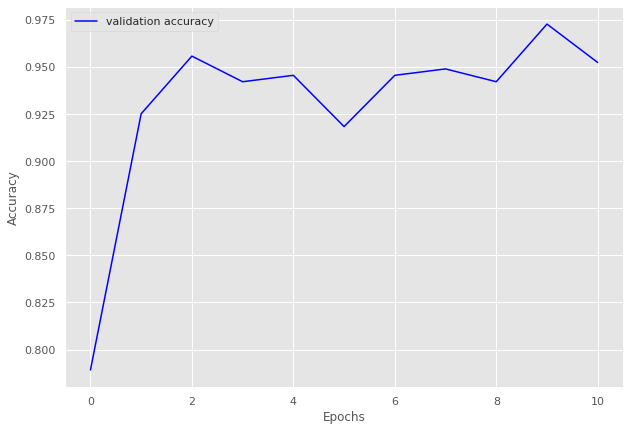

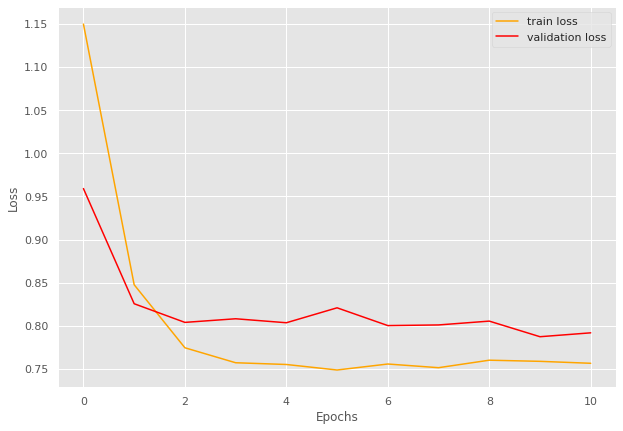

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 9/9 [00:03<00:00,  2.73batch/s, loss=0.878]


train loss 0.8780172136094835, validation loss 0.723017418384552, validation accuracy 0.875886524822695
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.82batch/s, loss=0.609]


train loss 0.608533137374454, validation loss 0.6141400218009949, validation accuracy 0.950354609929078
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.66batch/s, loss=0.569]


train loss 0.5690444509188334, validation loss 0.6043432474136352, validation accuracy 0.9539007092198581
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.42batch/s, loss=0.56] 


train loss 0.5601040985849168, validation loss 0.6017807841300964, validation accuracy 0.950354609929078
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.82batch/s, loss=0.558]


train loss 0.5576248897446526, validation loss 0.5876145482063293, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.78batch/s, loss=0.556]


train loss 0.5556225776672363, validation loss 0.5842380404472352, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.67batch/s, loss=0.555]


INFO: Early stopping counter 1 of 5
train loss 0.5546792480680678, validation loss 0.5868536829948425, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.66batch/s, loss=0.553]


INFO: Early stopping counter 2 of 5
train loss 0.5526574850082397, validation loss 0.5884358644485473, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.66batch/s, loss=0.552]


train loss 0.5523368252648247, validation loss 0.5839258790016174, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 10
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.74batch/s, loss=0.552]


INFO: Early stopping counter 3 of 5
train loss 0.5524311396810744, validation loss 0.5867949962615967, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 11
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.80batch/s, loss=0.552]


train loss 0.5521362026532491, validation loss 0.5805012106895446, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 12
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.55batch/s, loss=0.552]


train loss 0.5518245100975037, validation loss 0.5797718167304993, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 13
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.77batch/s, loss=0.552]


train loss 0.5520541866620382, validation loss 0.5784738063812256, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 14
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.59batch/s, loss=0.552]


train loss 0.5517808927430047, validation loss 0.5775646924972534, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 15
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.70batch/s, loss=0.552]


train loss 0.5516139070192972, validation loss 0.5771411299705506, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 16
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.66batch/s, loss=0.552]


train loss 0.5516762137413025, validation loss 0.5770337820053101, validation accuracy 0.9787234042553191
Coarse label 16 Epoch 17
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.68batch/s, loss=0.552]


INFO: Early stopping counter 4 of 5
train loss 0.5515997740957472, validation loss 0.577349328994751, validation accuracy 0.975177304964539
Coarse label 16 Epoch 18
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.72batch/s, loss=0.552]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.952192891290792 and loss 0.5976489798018807


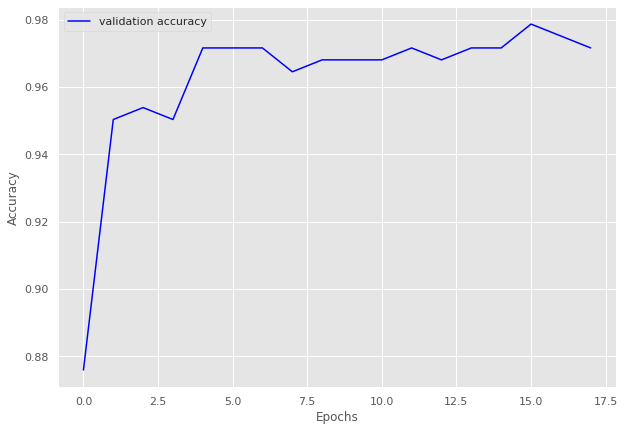

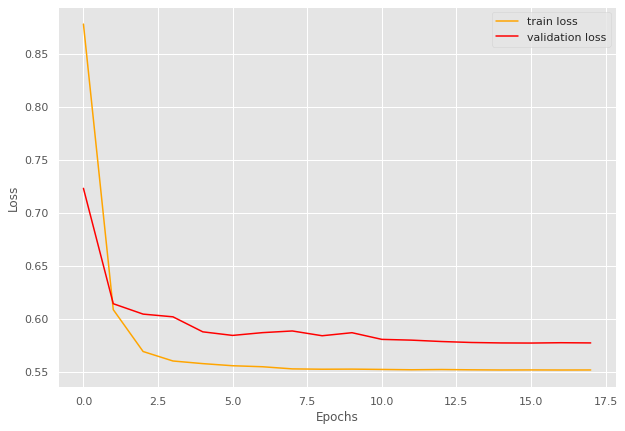

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 10/10 [00:03<00:00,  2.69batch/s, loss=1.16]


train loss 1.1582533121109009, validation loss 0.9764313101768494, validation accuracy 0.8155339805825242
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.80batch/s, loss=0.859]


train loss 0.858622819185257, validation loss 0.8620901226997375, validation accuracy 0.9093851132686084
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.77batch/s, loss=0.786]


train loss 0.7860178351402283, validation loss 0.8277143478393555, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.67batch/s, loss=0.759]


train loss 0.7594183504581451, validation loss 0.8189742207527161, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.73batch/s, loss=0.754]


train loss 0.7535081028938293, validation loss 0.8178680181503296, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.71batch/s, loss=0.749]


train loss 0.749370914697647, validation loss 0.8161008954048157, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.77batch/s, loss=0.748]


train loss 0.748054027557373, validation loss 0.8140659689903259, validation accuracy 0.9352750809061489
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.73batch/s, loss=0.747]


train loss 0.7472721457481384, validation loss 0.8136466979980469, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.82batch/s, loss=0.746]


train loss 0.7460013508796692, validation loss 0.8120496392250061, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.75batch/s, loss=0.748]


train loss 0.7475507080554962, validation loss 0.811364221572876, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.75batch/s, loss=0.746]


train loss 0.7463139414787292, validation loss 0.8101469039916992, validation accuracy 0.9288025889967637
Coarse label 17 Epoch 12
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.62batch/s, loss=0.746]


INFO: Early stopping counter 1 of 5
train loss 0.7457219898700714, validation loss 0.8109470129013061, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 13
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.76batch/s, loss=0.748]


INFO: Early stopping counter 2 of 5
train loss 0.7476772606372833, validation loss 0.8170924186706543, validation accuracy 0.9223300970873787
Coarse label 17 Epoch 14
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.67batch/s, loss=0.746]


INFO: Early stopping counter 3 of 5
train loss 0.746408349275589, validation loss 0.8197339057922364, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 15
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.72batch/s, loss=0.747]


INFO: Early stopping counter 4 of 5
train loss 0.7467197775840759, validation loss 0.8120880246162414, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 16
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.65batch/s, loss=0.747]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9015553869499241 and loss 0.8428874726755073


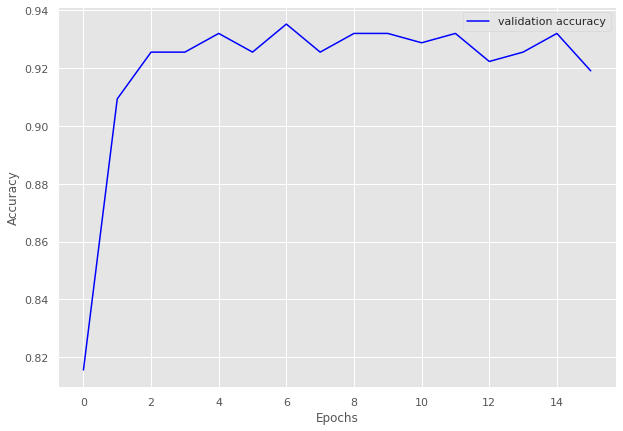

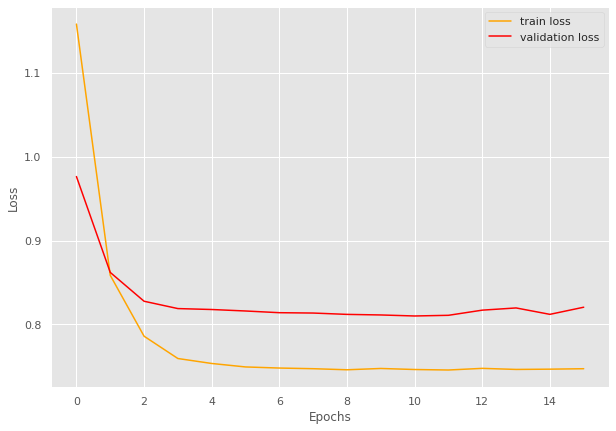

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 4/4 [00:01<00:00,  3.32batch/s, loss=1.3] 


train loss 1.2964670062065125, validation loss 1.2764814496040344, validation accuracy 0.4895833333333333
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.47batch/s, loss=1.02]


train loss 1.0247695595026016, validation loss 1.1825582385063171, validation accuracy 0.7083333333333334
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.53batch/s, loss=0.946]


train loss 0.9463143646717072, validation loss 1.0550601780414581, validation accuracy 0.8020833333333334
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.46batch/s, loss=0.83] 


train loss 0.8297331929206848, validation loss 0.9958116710186005, validation accuracy 0.8333333333333334
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.45batch/s, loss=0.79] 


train loss 0.7901228070259094, validation loss 0.9423530697822571, validation accuracy 0.8645833333333334
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.48batch/s, loss=0.808]


train loss 0.8075777143239975, validation loss 0.9077829420566559, validation accuracy 0.8645833333333334
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.50batch/s, loss=0.855]


INFO: Early stopping counter 1 of 5
train loss 0.8552287667989731, validation loss 0.9091691076755524, validation accuracy 0.8333333333333334
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.37batch/s, loss=0.805]


train loss 0.8052627295255661, validation loss 0.8925232291221619, validation accuracy 0.8541666666666666
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.31batch/s, loss=0.81] 


train loss 0.8100490421056747, validation loss 0.8770413398742676, validation accuracy 0.8854166666666666
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.20batch/s, loss=0.761]


train loss 0.7607624679803848, validation loss 0.8675010204315186, validation accuracy 0.8958333333333334
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.33batch/s, loss=0.759]


train loss 0.7585839927196503, validation loss 0.8613756895065308, validation accuracy 0.8854166666666666
Coarse label 19 Epoch 12
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.37batch/s, loss=0.767]


train loss 0.7665523588657379, validation loss 0.8572268187999725, validation accuracy 0.8854166666666666
Coarse label 19 Epoch 13
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.11batch/s, loss=0.847]


INFO: Early stopping counter 2 of 5
train loss 0.8474655449390411, validation loss 0.8578304350376129, validation accuracy 0.8854166666666666
Coarse label 19 Epoch 14
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.18batch/s, loss=0.824]


INFO: Early stopping counter 3 of 5
train loss 0.824216365814209, validation loss 0.8594808578491211, validation accuracy 0.8854166666666666
Coarse label 19 Epoch 15
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.48batch/s, loss=0.852]


INFO: Early stopping counter 4 of 5
train loss 0.8519265502691269, validation loss 0.8636999428272247, validation accuracy 0.875
Coarse label 19 Epoch 16
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.46batch/s, loss=0.758]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.7985611510791367 and loss 0.9425062956633391


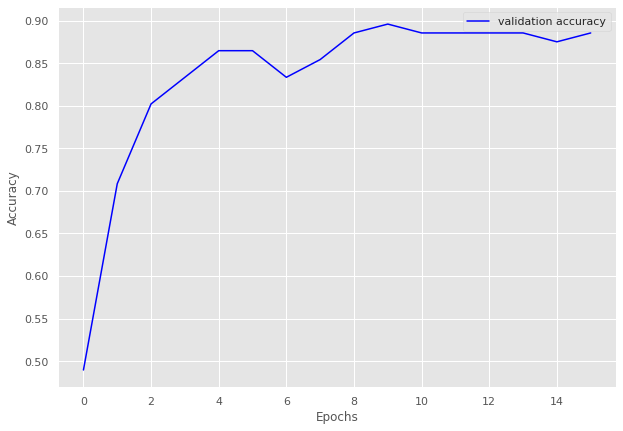

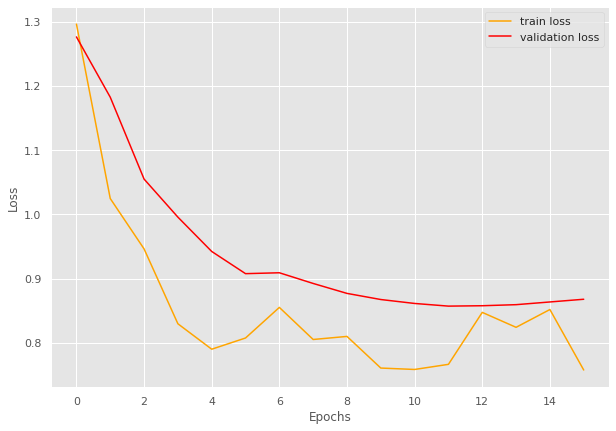

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Calculating for volume 25
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.03batch/s, loss=1.22]


train loss 1.2173371059553963, validation loss 0.988512030669621, validation accuracy 0.9254079254079254
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.04batch/s, loss=0.993]


train loss 0.9929158538579941, validation loss 0.9694830434662955, validation accuracy 0.9324009324009324
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=0.95] 


train loss 0.9502072909048626, validation loss 0.9579573358808245, validation accuracy 0.9487179487179487
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=0.935]


train loss 0.9345743656158447, validation loss 0.95280179807118, validation accuracy 0.958041958041958
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=0.951]


INFO: Early stopping counter 1 of 5
train loss 0.9514322685343879, validation loss 0.9569826977593558, validation accuracy 0.951048951048951
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.84batch/s, loss=0.934]


INFO: Early stopping counter 2 of 5
train loss 0.9337532839604786, validation loss 0.9584998147828239, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.02batch/s, loss=0.931]


INFO: Early stopping counter 3 of 5
train loss 0.9305307950292315, validation loss 0.9570173621177673, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.03batch/s, loss=0.945]


INFO: Early stopping counter 4 of 5
train loss 0.9449613903250013, validation loss 0.9658343877111163, validation accuracy 0.9393939393939394
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=0.949]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9415484268969772 and loss 0.9641381472933526


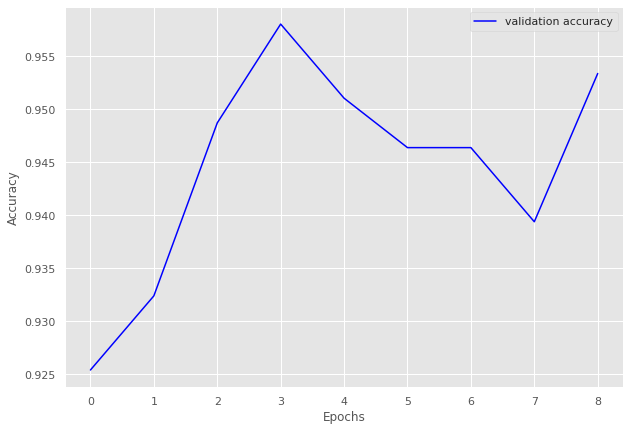

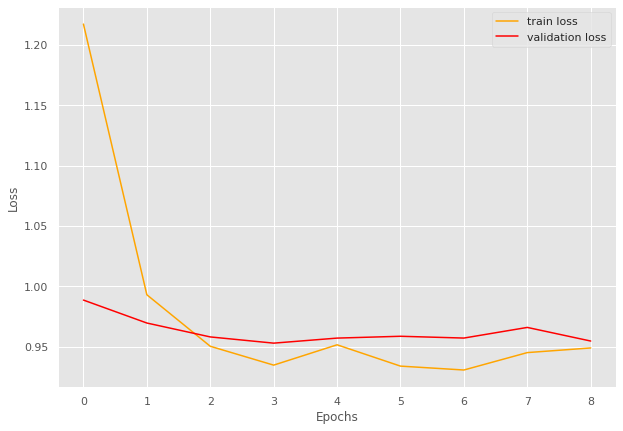

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 12/12 [00:04<00:00,  2.90batch/s, loss=1.49]


train loss 1.4890281856060028, validation loss 1.2301876942316692, validation accuracy 0.8602150537634409
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  3.00batch/s, loss=1.13]


train loss 1.1314496397972107, validation loss 1.1271719932556152, validation accuracy 0.9086021505376344
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 12/12 [00:05<00:00,  2.13batch/s, loss=1.07]


train loss 1.066119760274887, validation loss 1.1142914295196533, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 12/12 [00:07<00:00,  1.55batch/s, loss=1.05]


train loss 1.0512379010518391, validation loss 1.1091053485870361, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 12/12 [00:08<00:00,  1.49batch/s, loss=1.05]


INFO: Early stopping counter 1 of 5
train loss 1.0510242879390717, validation loss 1.1122889916102092, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 12/12 [00:07<00:00,  1.66batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.0471697946389515, validation loss 1.1267729997634888, validation accuracy 0.9139784946236559
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 12/12 [00:07<00:00,  1.68batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0492239197095234, validation loss 1.132738709449768, validation accuracy 0.9086021505376344
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 12/12 [00:07<00:00,  1.58batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0481701691945393, validation loss 1.1266300678253174, validation accuracy 0.9193548387096774
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 12/12 [00:09<00:00,  1.21batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9252832861189801 and loss 1.1210187779532539


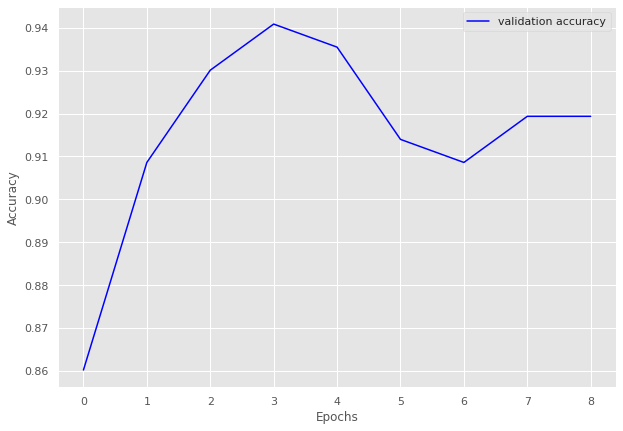

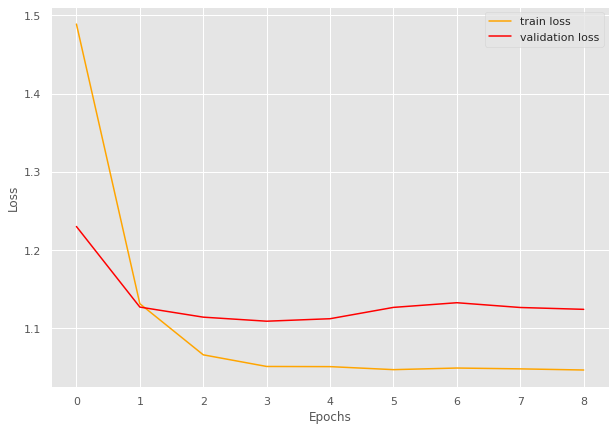

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 55/55 [00:40<00:00,  1.37batch/s, loss=1.79]


train loss 1.7876347411762585, validation loss 1.5947938050542558, validation accuracy 0.8770114942528736
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 55/55 [00:45<00:00,  1.21batch/s, loss=1.55]


train loss 1.5462938503785566, validation loss 1.546387961932591, validation accuracy 0.9229885057471264
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 55/55 [00:26<00:00,  2.05batch/s, loss=1.51]


train loss 1.5141027168794112, validation loss 1.5431769405092512, validation accuracy 0.9195402298850575
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.92batch/s, loss=1.5]


train loss 1.4993170629848134, validation loss 1.534513703414372, validation accuracy 0.9310344827586207
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 55/55 [00:19<00:00,  2.87batch/s, loss=1.5] 


INFO: Early stopping counter 1 of 5
train loss 1.4993210662495007, validation loss 1.5489225728171212, validation accuracy 0.9114942528735632
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 55/55 [00:21<00:00,  2.58batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4912335699254817, validation loss 1.5417398299489702, validation accuracy 0.9264367816091954
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.91batch/s, loss=1.48]


train loss 1.4847868074070323, validation loss 1.5264141474451338, validation accuracy 0.9390804597701149
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.91batch/s, loss=1.48]


train loss 1.478380474177274, validation loss 1.5154694489070348, validation accuracy 0.9471264367816092
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 55/55 [00:19<00:00,  2.81batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4791467709974808, validation loss 1.5220273903438024, validation accuracy 0.9390804597701149
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.90batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4768581412055275, validation loss 1.5251193302018302, validation accuracy 0.9356321839080459
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9263229927007299 and loss 1.5348108555506734


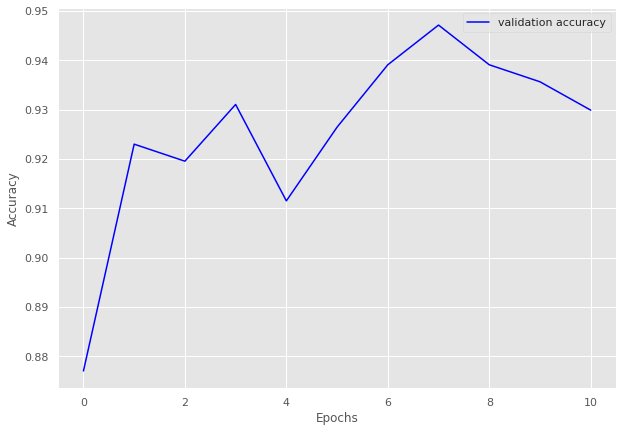

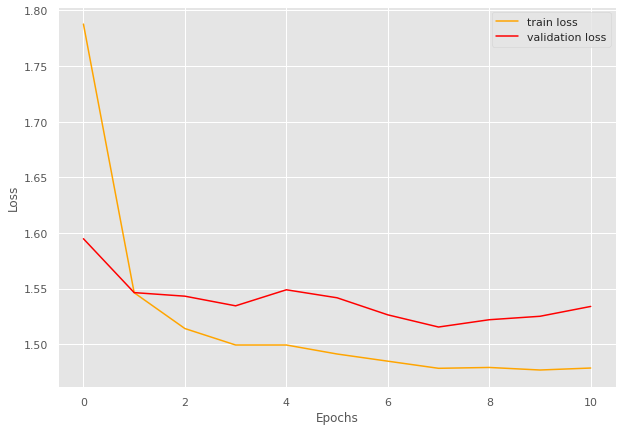

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 26/26 [00:08<00:00,  2.97batch/s, loss=1.41]


train loss 1.4126810293931227, validation loss 1.2028150728770666, validation accuracy 0.8689320388349514
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.94batch/s, loss=1.14]


train loss 1.1371935651852534, validation loss 1.1479648011071342, validation accuracy 0.8956310679611651
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.92batch/s, loss=1.1]


train loss 1.0981682309737573, validation loss 1.1327368531908308, validation accuracy 0.9174757281553398
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.93batch/s, loss=1.08]


train loss 1.078820994267097, validation loss 1.1147182839257377, validation accuracy 0.9368932038834952
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.92batch/s, loss=1.07]


train loss 1.0718094614835887, validation loss 1.1020703315734863, validation accuracy 0.9466019417475728
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.95batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0697435369858375, validation loss 1.1167736223765783, validation accuracy 0.9247572815533981
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0610005580461943, validation loss 1.1122734887259347, validation accuracy 0.9320388349514563
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.90batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0611334351392894, validation loss 1.1083392245428902, validation accuracy 0.9368932038834952
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.97batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0631117132993846, validation loss 1.1070900985172816, validation accuracy 0.9247572815533981
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.98batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9307456917378 and loss 1.1131959326413212


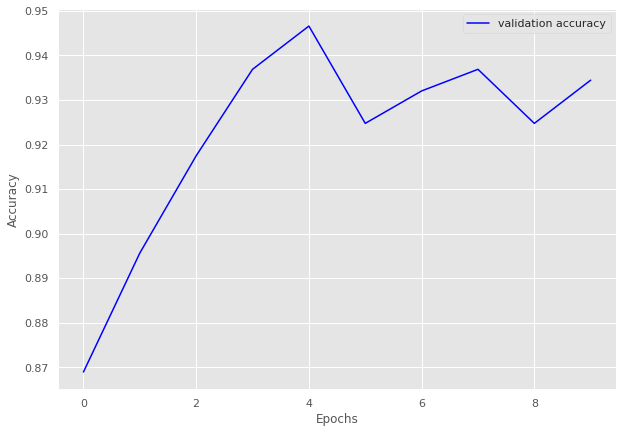

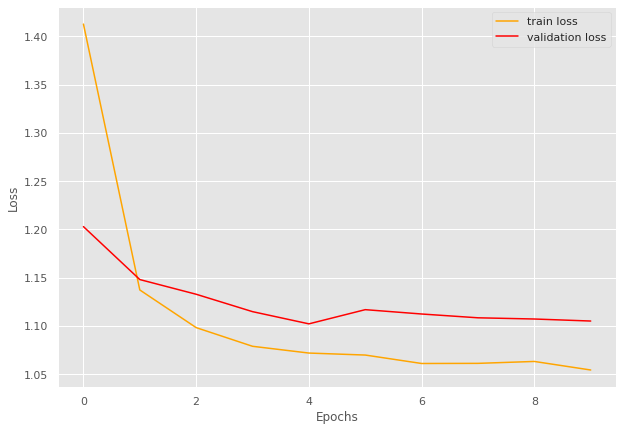

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 10/10 [00:03<00:00,  2.82batch/s, loss=0.461]


train loss 0.46136620044708254, validation loss 0.3509848515192668, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=0.336]


train loss 0.3362576276063919, validation loss 0.3367227117220561, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.87batch/s, loss=0.321]


INFO: Early stopping counter 1 of 5
train loss 0.32093545794487, validation loss 0.33888628085454303, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.96batch/s, loss=0.321]


train loss 0.3207945615053177, validation loss 0.3353431820869446, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.95batch/s, loss=0.317]


train loss 0.31747716665267944, validation loss 0.3287523686885834, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.95batch/s, loss=0.318]


INFO: Early stopping counter 2 of 5
train loss 0.31848261654376986, validation loss 0.3298342128594716, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.94batch/s, loss=0.317]


INFO: Early stopping counter 3 of 5
train loss 0.31695649921894076, validation loss 0.34433846672375995, validation accuracy 0.949685534591195
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.78batch/s, loss=0.32]


INFO: Early stopping counter 4 of 5
train loss 0.32041550874710084, validation loss 0.33695019284884137, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.96batch/s, loss=0.318]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9770546516478932 and loss 0.33477198371761724


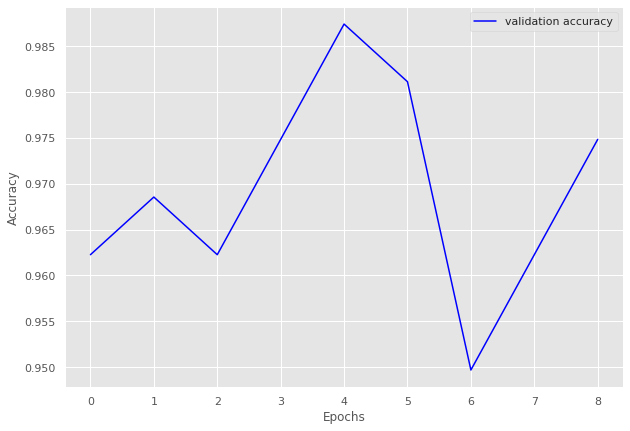

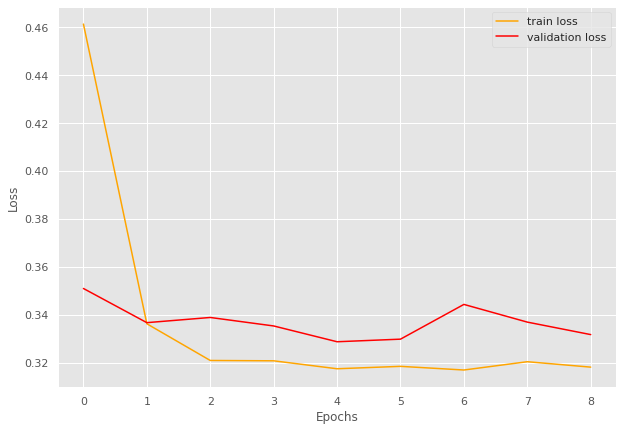

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 30/30 [00:09<00:00,  3.03batch/s, loss=1.47]


train loss 1.4652619004249572, validation loss 1.277121588587761, validation accuracy 0.8771551724137931
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.97batch/s, loss=1.24]


train loss 1.2403148412704468, validation loss 1.2494304925203323, validation accuracy 0.9073275862068966
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.00batch/s, loss=1.21]


train loss 1.2101254224777223, validation loss 1.2466276288032532, validation accuracy 0.9137931034482759
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.00batch/s, loss=1.21]


INFO: Early stopping counter 1 of 5
train loss 1.2084449410438538, validation loss 1.253762573003769, validation accuracy 0.9030172413793104
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.02batch/s, loss=1.2] 


train loss 1.203577176729838, validation loss 1.2409635186195374, validation accuracy 0.9137931034482759
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.02batch/s, loss=1.2]


train loss 1.2003643274307252, validation loss 1.2354884594678879, validation accuracy 0.9267241379310345
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.19]


INFO: Early stopping counter 2 of 5
train loss 1.193835147221883, validation loss 1.237127810716629, validation accuracy 0.9267241379310345
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=1.19]


train loss 1.187895671526591, validation loss 1.2206591218709946, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1938846508661907, validation loss 1.2396656572818756, validation accuracy 0.915948275862069
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=1.22]


INFO: Early stopping counter 4 of 5
train loss 1.2153698126475017, validation loss 1.239132136106491, validation accuracy 0.9181034482758621
Coarse label 6 Epoch 11
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.97batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.934475374732334 and loss 1.2319605632261796


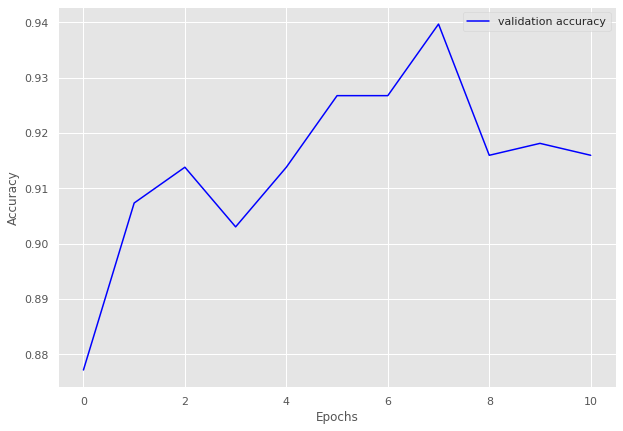

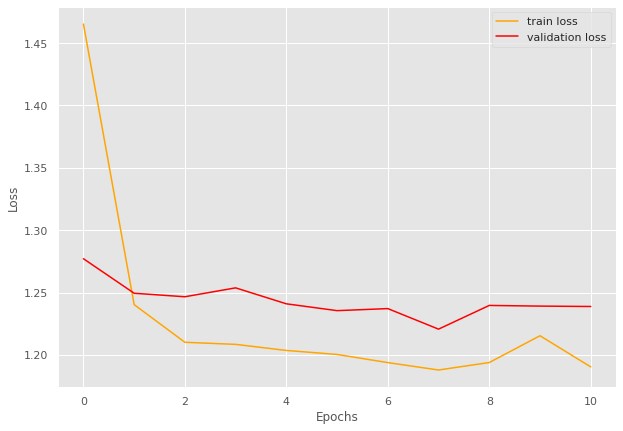

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 23/23 [00:07<00:00,  2.93batch/s, loss=0.938]


train loss 0.9375939965248108, validation loss 0.7837746739387512, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.92batch/s, loss=0.769]


train loss 0.7687837429668593, validation loss 0.772792379061381, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.93batch/s, loss=0.762]


INFO: Early stopping counter 1 of 5
train loss 0.7618490172469098, validation loss 0.7821895976861318, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.95batch/s, loss=0.758]


INFO: Early stopping counter 2 of 5
train loss 0.7581485432127247, validation loss 0.7833977937698364, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.90batch/s, loss=0.755]


INFO: Early stopping counter 3 of 5
train loss 0.7547036824019059, validation loss 0.7780067225297292, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.90batch/s, loss=0.753]


INFO: Early stopping counter 4 of 5
train loss 0.7534508834714475, validation loss 0.7857949634393057, validation accuracy 0.9559228650137741
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 23/23 [00:08<00:00,  2.73batch/s, loss=0.757]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9682713347921226 and loss 0.7748687267303467


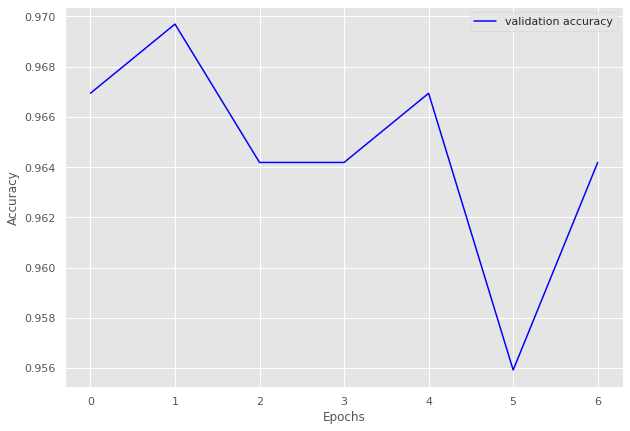

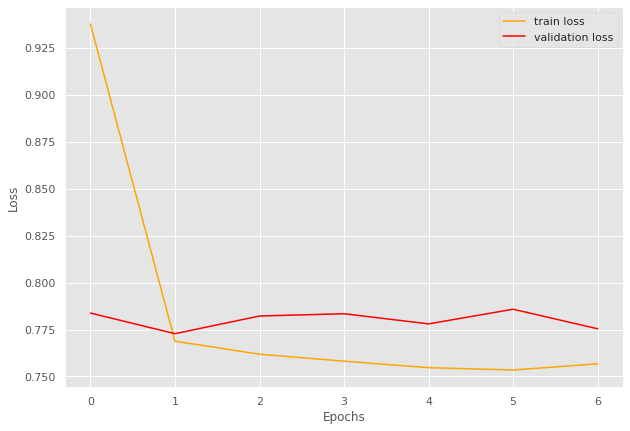

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 33/33 [00:10<00:00,  3.00batch/s, loss=1.5] 


train loss 1.5008289344383008, validation loss 1.2735788524150848, validation accuracy 0.9080234833659491
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.97batch/s, loss=1.25]


train loss 1.2452215859384248, validation loss 1.258159652352333, validation accuracy 0.9119373776908023
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.96batch/s, loss=1.22]


train loss 1.2177992047685566, validation loss 1.2477032393217087, validation accuracy 0.9178082191780822
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 33/33 [00:10<00:00,  3.01batch/s, loss=1.2] 


train loss 1.2044449249903362, validation loss 1.2450980693101883, validation accuracy 0.923679060665362
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 33/33 [00:10<00:00,  3.01batch/s, loss=1.19]


INFO: Early stopping counter 1 of 5
train loss 1.19387639652599, validation loss 1.2525207847356796, validation accuracy 0.9197651663405088
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.96batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.1951440753358784, validation loss 1.2515523731708527, validation accuracy 0.9217221135029354
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.96batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1868959773670544, validation loss 1.2686450481414795, validation accuracy 0.8962818003913894
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.99batch/s, loss=1.2] 


INFO: Early stopping counter 4 of 5
train loss 1.2036430510607632, validation loss 1.249448910355568, validation accuracy 0.9217221135029354
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  3.00batch/s, loss=1.2] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.904712449694924 and loss 1.260240608995611


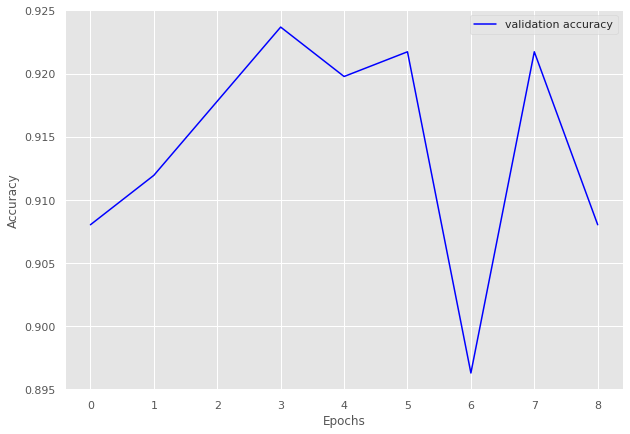

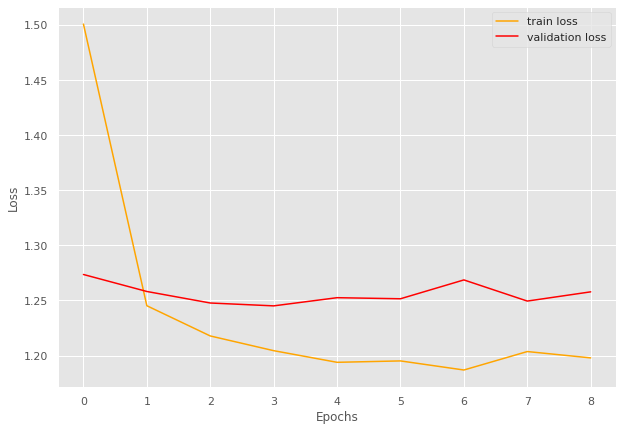

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=1.78]


train loss 1.7774427518612002, validation loss 1.65580783107064, validation accuracy 0.8780864197530864
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=1.57]


train loss 1.5672642690379446, validation loss 1.6437614505941218, validation accuracy 0.8888888888888888
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=1.53]


train loss 1.5296824589008238, validation loss 1.565876689824191, validation accuracy 0.9151234567901234
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=1.5]


train loss 1.5032194242244814, validation loss 1.5581474304199219, validation accuracy 0.9212962962962963
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.89batch/s, loss=1.5] 


train loss 1.4973773520167282, validation loss 1.544103654948148, validation accuracy 0.933641975308642
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=1.49]


train loss 1.4914926726643631, validation loss 1.5384603413668545, validation accuracy 0.9259259259259259
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4855527296298887, validation loss 1.5754969336769797, validation accuracy 0.9197530864197531
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.485562801361084, validation loss 1.561664646322077, validation accuracy 0.9212962962962963
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4801917250563459, validation loss 1.5429801182313398, validation accuracy 0.9305555555555556
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.89batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4758040207188303, validation loss 1.551905328577215, validation accuracy 0.9320987654320988
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9318438044480886 and loss 1.5313865125568864


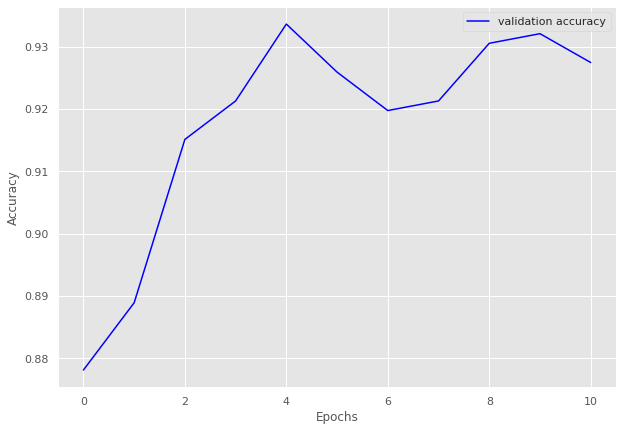

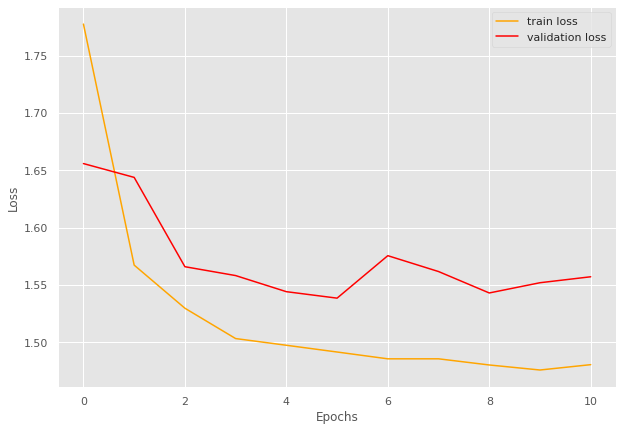

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 20/20 [00:06<00:00,  3.06batch/s, loss=0.987]


train loss 0.9865014672279357, validation loss 0.8057232618331909, validation accuracy 0.9375
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.784]


train loss 0.7840219646692276, validation loss 0.7809856772422791, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.98batch/s, loss=0.767]


train loss 0.7669236987829209, validation loss 0.7756556272506714, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.04batch/s, loss=0.758]


train loss 0.757797372341156, validation loss 0.7707331776618958, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.761]


INFO: Early stopping counter 1 of 5
train loss 0.7605837970972061, validation loss 0.7747647047042847, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.99batch/s, loss=0.758]


INFO: Early stopping counter 2 of 5
train loss 0.7577964752912522, validation loss 0.7826056122779846, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.758]


INFO: Early stopping counter 3 of 5
train loss 0.7579244047403335, validation loss 0.7917985320091248, validation accuracy 0.9572368421052632
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.04batch/s, loss=0.759]


INFO: Early stopping counter 4 of 5
train loss 0.7594549745321274, validation loss 0.7762948870658875, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.06batch/s, loss=0.751]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9708632311372037 and loss 0.7727744753162066


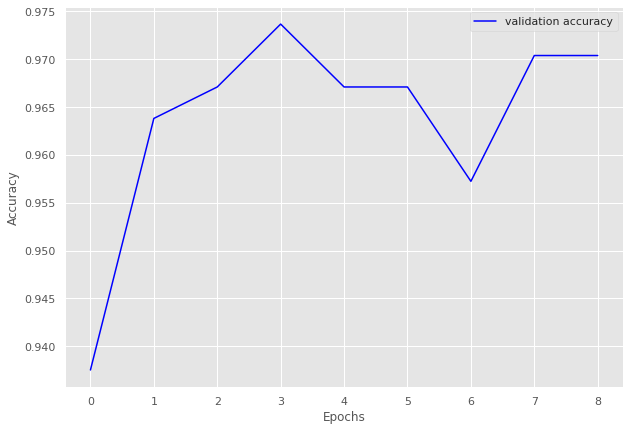

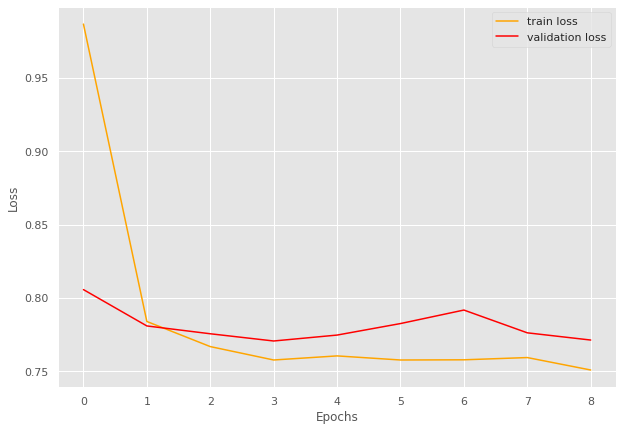

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 19/19 [00:06<00:00,  3.08batch/s, loss=1.5] 


train loss 1.5023940425170095, validation loss 1.2596362113952637, validation accuracy 0.8448275862068966
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.04batch/s, loss=1.14]


train loss 1.144698745325992, validation loss 1.14748158454895, validation accuracy 0.903448275862069
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.04batch/s, loss=1.1] 


train loss 1.1032174700184871, validation loss 1.1380376100540162, validation accuracy 0.906896551724138
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=1.1] 


INFO: Early stopping counter 1 of 5
train loss 1.0959477863813702, validation loss 1.15179386138916, validation accuracy 0.8896551724137931
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.09]


train loss 1.0924809857418663, validation loss 1.1372452974319458, validation accuracy 0.9103448275862069
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.07batch/s, loss=1.07]


train loss 1.0740483811027126, validation loss 1.1286263465881348, validation accuracy 0.9172413793103448
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.06batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0731710697475232, validation loss 1.1310871362686157, validation accuracy 0.9103448275862069
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.08batch/s, loss=1.07]


train loss 1.066722173439829, validation loss 1.1229679584503174, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.08batch/s, loss=1.07]


train loss 1.0708090631585372, validation loss 1.117531418800354, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.06batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.069186336115787, validation loss 1.1257359504699707, validation accuracy 0.9103448275862069
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.066977902462608, validation loss 1.1249303579330445, validation accuracy 0.9172413793103448
Coarse label 12 Epoch 12
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9121729237770193 and loss 1.1315864963807922


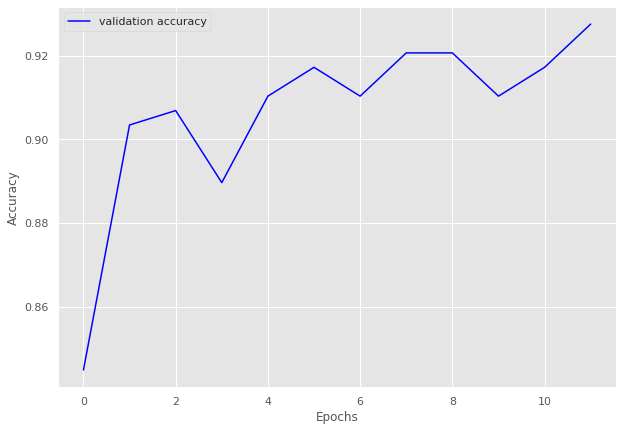

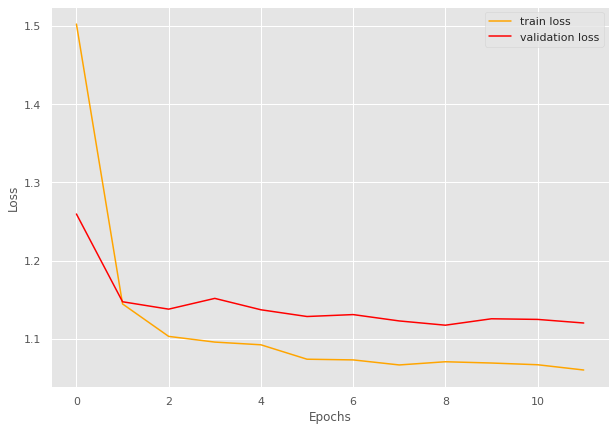

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 17/17 [00:05<00:00,  3.02batch/s, loss=0.751]


train loss 0.7512175300542046, validation loss 0.6795397520065307, validation accuracy 0.9034749034749034
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.03batch/s, loss=0.603]


train loss 0.6029020407620598, validation loss 0.6411825895309449, validation accuracy 0.8918918918918919
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 17/17 [00:07<00:00,  2.14batch/s, loss=0.579]


train loss 0.5786686890265521, validation loss 0.6062750935554504, validation accuracy 0.9305019305019305
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=0.573]


INFO: Early stopping counter 1 of 5
train loss 0.5729224681854248, validation loss 0.6204047679901123, validation accuracy 0.9073359073359073
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.00batch/s, loss=0.566]


INFO: Early stopping counter 2 of 5
train loss 0.5661609523436603, validation loss 0.6120392322540283, validation accuracy 0.9227799227799228
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=0.565]


INFO: Early stopping counter 3 of 5
train loss 0.5654954173985649, validation loss 0.6162828087806702, validation accuracy 0.915057915057915
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.06batch/s, loss=0.567]


INFO: Early stopping counter 4 of 5
train loss 0.5665969007155475, validation loss 0.6160407900810242, validation accuracy 0.918918918918919
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  2.99batch/s, loss=0.564]


train loss 0.5641127333921545, validation loss 0.6055928230285644, validation accuracy 0.9305019305019305
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=0.574]


train loss 0.5737403736394995, validation loss 0.5931536793708801, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 10
-------------------------------


100%|██████████| 17/17 [00:09<00:00,  1.83batch/s, loss=0.56] 


train loss 0.5601774769670823, validation loss 0.5926708221435547, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 11
-------------------------------


100%|██████████| 17/17 [00:11<00:00,  1.52batch/s, loss=0.562]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9305306331709818 and loss 0.6196707408936297


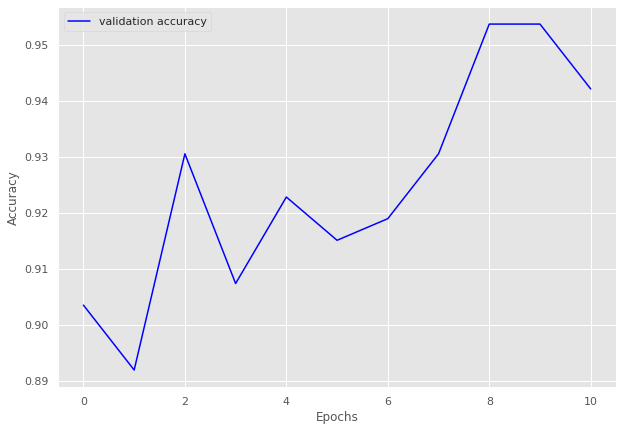

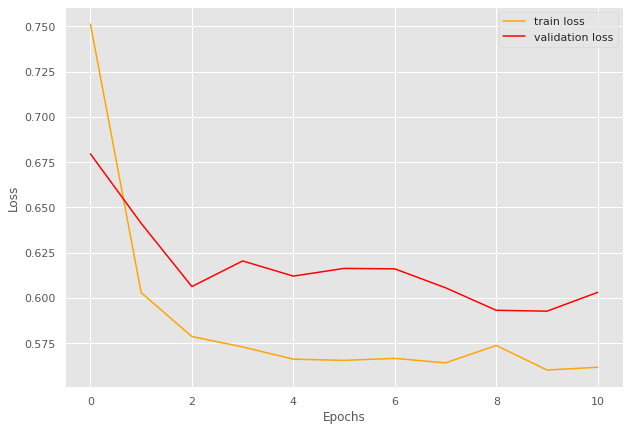

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 38/38 [00:27<00:00,  1.37batch/s, loss=1.29]


train loss 1.2898834630062705, validation loss 1.1175281047821044, validation accuracy 0.9326599326599326
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 38/38 [00:30<00:00,  1.24batch/s, loss=1.09]


train loss 1.0944388571538424, validation loss 1.0922934651374816, validation accuracy 0.9511784511784511
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 38/38 [00:27<00:00,  1.37batch/s, loss=1.07]


train loss 1.0732102143137079, validation loss 1.0852598190307616, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 38/38 [00:33<00:00,  1.13batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0733614281604165, validation loss 1.0871444582939147, validation accuracy 0.9562289562289562
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 38/38 [00:28<00:00,  1.32batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0684399542055631, validation loss 1.0895882964134216, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0623995724477266, validation loss 1.0856990814208984, validation accuracy 0.9595959595959596
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0585324983847768, validation loss 1.0860725879669189, validation accuracy 0.9562289562289562
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9601250977326036 and loss 1.0846946580069405


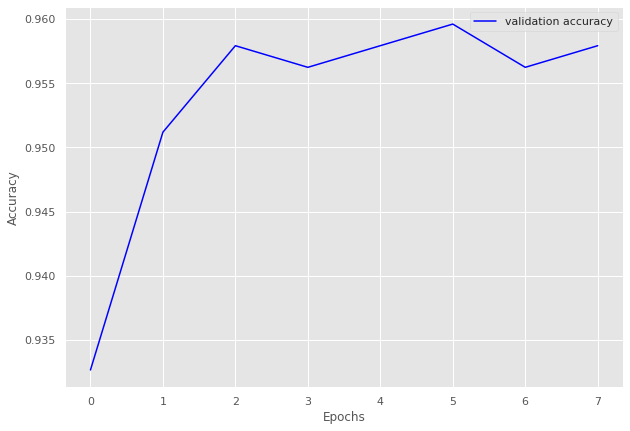

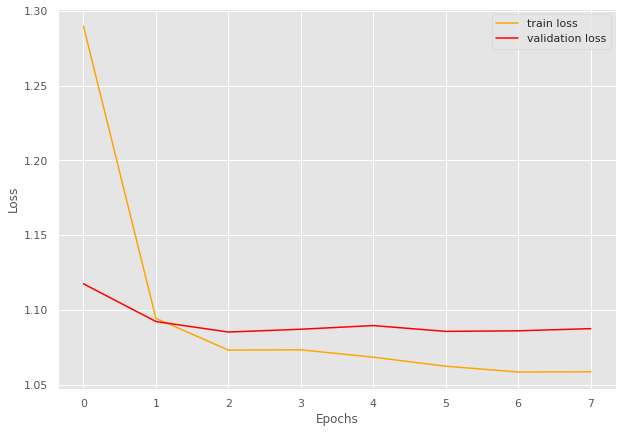

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=1.02]


train loss 1.0188002743219073, validation loss 0.8175767540931702, validation accuracy 0.9217687074829932
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.01batch/s, loss=0.79] 


train loss 0.7904610006432784, validation loss 0.780898141860962, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=0.762]


train loss 0.7616193796458998, validation loss 0.7756651639938354, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=0.758]


INFO: Early stopping counter 1 of 5
train loss 0.7583720558568051, validation loss 0.783751106262207, validation accuracy 0.9591836734693877
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.97batch/s, loss=0.752]


INFO: Early stopping counter 2 of 5
train loss 0.7522619711725336, validation loss 0.7784748196601867, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=0.753]


train loss 0.7534755186030739, validation loss 0.77444828748703, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=0.749]


INFO: Early stopping counter 3 of 5
train loss 0.7494901763765436, validation loss 0.778678035736084, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=0.748]


INFO: Early stopping counter 4 of 5
train loss 0.7477519669030842, validation loss 0.7786000967025757, validation accuracy 0.9591836734693877
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=0.745]


train loss 0.7454067343159726, validation loss 0.7698629140853882, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.96batch/s, loss=0.746]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9581731856206195 and loss 0.7831798212868827


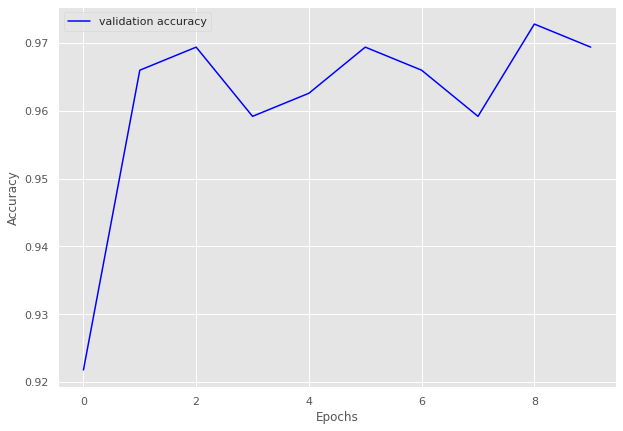

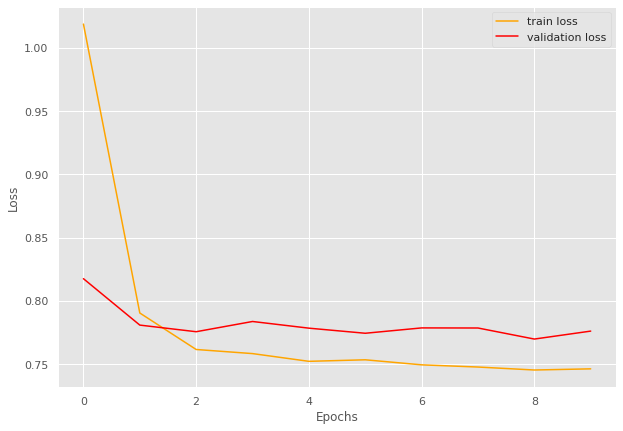

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 18/18 [00:06<00:00,  2.93batch/s, loss=0.757]


train loss 0.756777114338345, validation loss 0.6364849805831909, validation accuracy 0.9290780141843972
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.91batch/s, loss=0.581]


train loss 0.5806160867214203, validation loss 0.5946634411811829, validation accuracy 0.9539007092198581
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.91batch/s, loss=0.566]


INFO: Early stopping counter 1 of 5
train loss 0.5662664241260953, validation loss 0.5959532856941223, validation accuracy 0.950354609929078
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.90batch/s, loss=0.561]


train loss 0.5605677366256714, validation loss 0.5867553353309631, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.95batch/s, loss=0.557]


train loss 0.5572082334094577, validation loss 0.586112630367279, validation accuracy 0.9609929078014184
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.97batch/s, loss=0.556]


INFO: Early stopping counter 2 of 5
train loss 0.555612239572737, validation loss 0.6003646492958069, validation accuracy 0.950354609929078
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.01batch/s, loss=0.554]


INFO: Early stopping counter 3 of 5
train loss 0.5541310211022695, validation loss 0.5924928545951843, validation accuracy 0.9609929078014184
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.99batch/s, loss=0.554]


INFO: Early stopping counter 4 of 5
train loss 0.5542662839094797, validation loss 0.5948804497718811, validation accuracy 0.9609929078014184
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.97batch/s, loss=0.554]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.958303886925795 and loss 0.5925373319369643


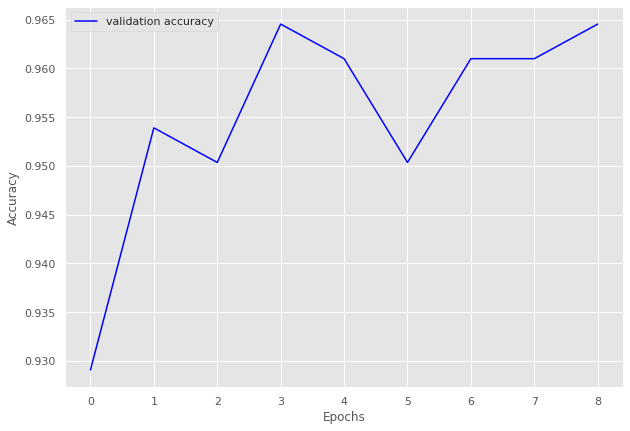

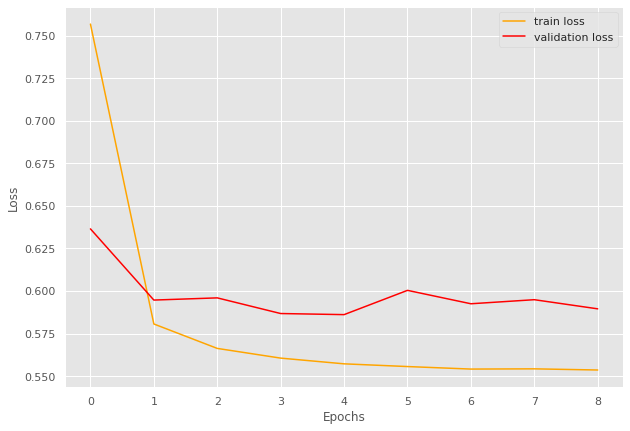

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 20/20 [00:06<00:00,  3.04batch/s, loss=1.04]


train loss 1.0404883593320846, validation loss 0.8895544648170471, validation accuracy 0.86084142394822
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.00batch/s, loss=0.81] 


train loss 0.8098952233791351, validation loss 0.8367616653442382, validation accuracy 0.9158576051779935
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.768]


train loss 0.7682605296373367, validation loss 0.8227652072906494, validation accuracy 0.912621359223301
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.764]


INFO: Early stopping counter 1 of 5
train loss 0.7643880486488343, validation loss 0.8300889372825623, validation accuracy 0.9093851132686084
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.04batch/s, loss=0.76] 


INFO: Early stopping counter 2 of 5
train loss 0.7596853047609329, validation loss 0.8331592798233032, validation accuracy 0.9029126213592233
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.755]


INFO: Early stopping counter 3 of 5
train loss 0.7549171775579453, validation loss 0.8250407457351685, validation accuracy 0.9093851132686084
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.88batch/s, loss=0.759]


INFO: Early stopping counter 4 of 5
train loss 0.7585859298706055, validation loss 0.8366055130958557, validation accuracy 0.9093851132686084
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.00batch/s, loss=0.757]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9206792777300086 and loss 0.8231439761919518


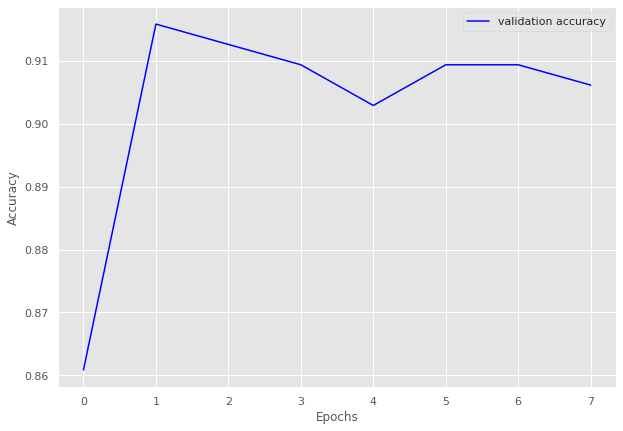

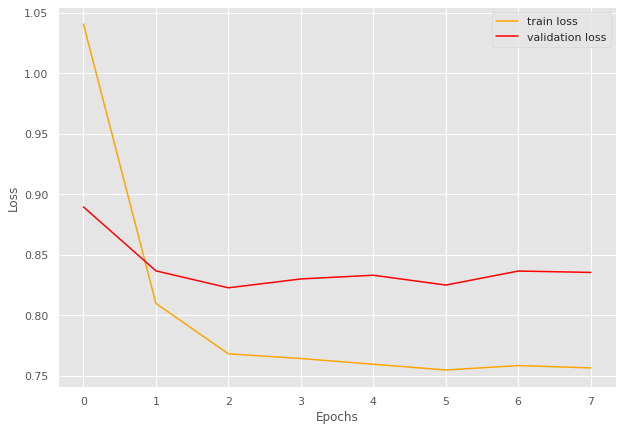

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 7/7 [00:02<00:00,  3.29batch/s, loss=1.24]


train loss 1.241902572768075, validation loss 1.0727452039718628, validation accuracy 0.7708333333333334
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.32batch/s, loss=0.913]


train loss 0.9126728687967572, validation loss 0.9357361793518066, validation accuracy 0.84375
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.11batch/s, loss=0.815]


train loss 0.8151515807424273, validation loss 0.8836255669593811, validation accuracy 0.8645833333333334
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.28batch/s, loss=0.768]


train loss 0.768465885094234, validation loss 0.8171401917934418, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.31batch/s, loss=0.76] 


train loss 0.7596918344497681, validation loss 0.7993780076503754, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.25batch/s, loss=0.76] 


train loss 0.7599339059420994, validation loss 0.7961448729038239, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.31batch/s, loss=0.754]


INFO: Early stopping counter 1 of 5
train loss 0.7537948574338641, validation loss 0.8070232272148132, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.34batch/s, loss=0.763]


INFO: Early stopping counter 2 of 5
train loss 0.7627035975456238, validation loss 0.8076004981994629, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.34batch/s, loss=0.749]


INFO: Early stopping counter 3 of 5
train loss 0.7493310996464321, validation loss 0.8028806447982788, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.35batch/s, loss=0.746]


INFO: Early stopping counter 4 of 5
train loss 0.7461768133299691, validation loss 0.8004241287708282, validation accuracy 0.9375
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.33batch/s, loss=0.749]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.920516304347826 and loss 0.8228633740673894


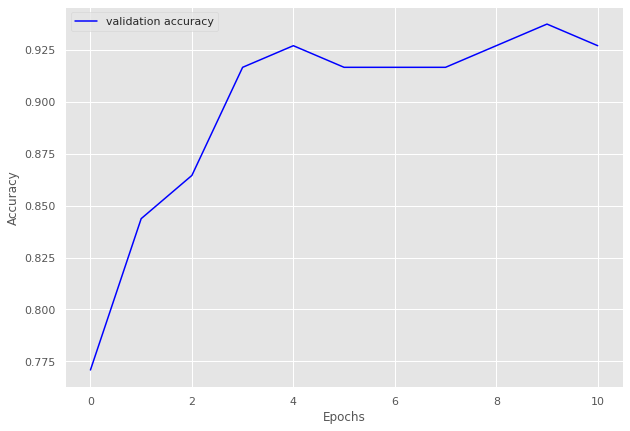

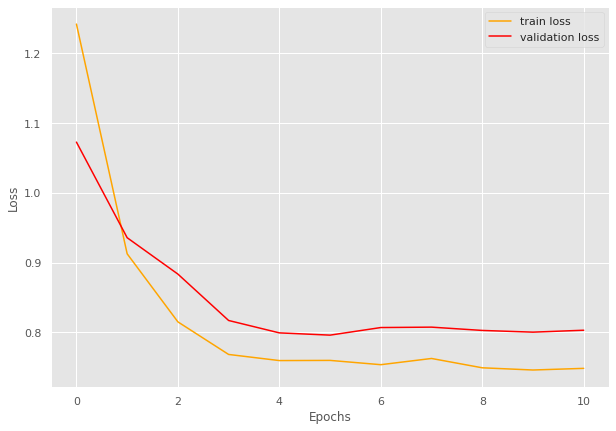

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16
Evaluating fine model 17
Evaluating fine model 19
overall accuracy  is 0.7693892101719084
{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.93261955745

Calculating for volume 35
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=1.13]


train loss 1.1300903587806514, validation loss 0.9849582314491272, validation accuracy 0.9230769230769231
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=0.972]


train loss 0.971733734375093, validation loss 0.9811356237956456, validation accuracy 0.9230769230769231
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.953]


train loss 0.9529230565559573, validation loss 0.9617332305227008, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.945]


INFO: Early stopping counter 1 of 5
train loss 0.9447829577980972, validation loss 0.9657110060964312, validation accuracy 0.9440559440559441
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.97batch/s, loss=0.936]


train loss 0.9363480253917414, validation loss 0.9588143229484558, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.97batch/s, loss=0.93] 


INFO: Early stopping counter 2 of 5
train loss 0.9303096212991854, validation loss 0.9645283392497471, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.89batch/s, loss=0.933]


INFO: Early stopping counter 3 of 5
train loss 0.9326028300494682, validation loss 0.9707755276135036, validation accuracy 0.9324009324009324
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.90batch/s, loss=0.931]


INFO: Early stopping counter 4 of 5
train loss 0.9309953785524135, validation loss 0.9611421738352094, validation accuracy 0.9440559440559441
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.90batch/s, loss=0.929]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9523131672597864 and loss 0.9518784155899828


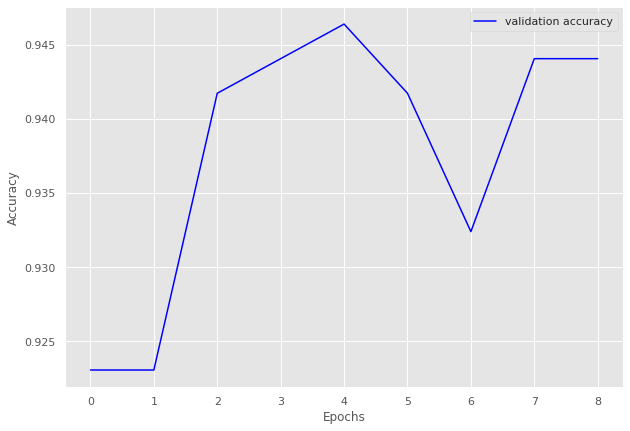

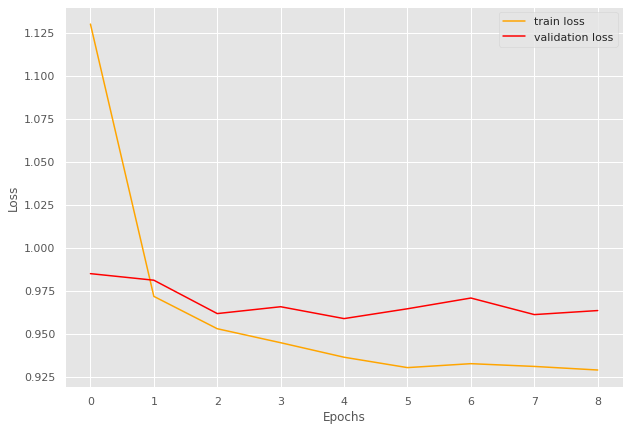

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 18/18 [00:06<00:00,  2.98batch/s, loss=1.37]


train loss 1.3728740943802729, validation loss 1.1466728846232097, validation accuracy 0.9139784946236559
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.95batch/s, loss=1.11]


train loss 1.1082073582543268, validation loss 1.103597640991211, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.97batch/s, loss=1.07]


train loss 1.0686209599177043, validation loss 1.091874599456787, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.93batch/s, loss=1.06]


train loss 1.0558908250596788, validation loss 1.0814368327458699, validation accuracy 0.967741935483871
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.99batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0559498535262213, validation loss 1.0898555914560955, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.97batch/s, loss=1.05]


train loss 1.0538888706101313, validation loss 1.0766812960306804, validation accuracy 0.967741935483871
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.00batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.0487268699540033, validation loss 1.0908761819203694, validation accuracy 0.946236559139785
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  3.00batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.051234245300293, validation loss 1.078844467798869, validation accuracy 0.967741935483871
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.93batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0459212793244257, validation loss 1.0823423465092976, validation accuracy 0.9623655913978495
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.97batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9558643236616264 and loss 1.0884689459433923


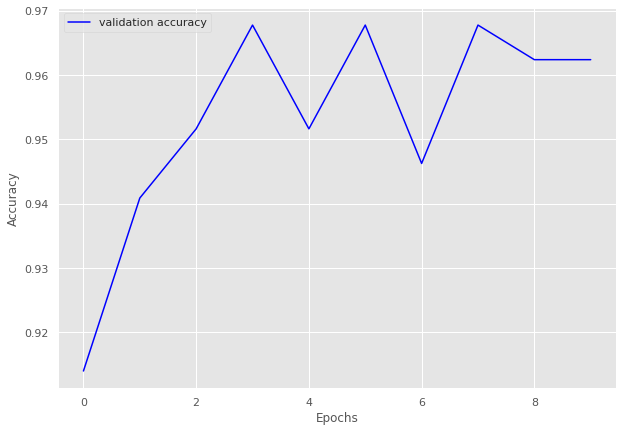

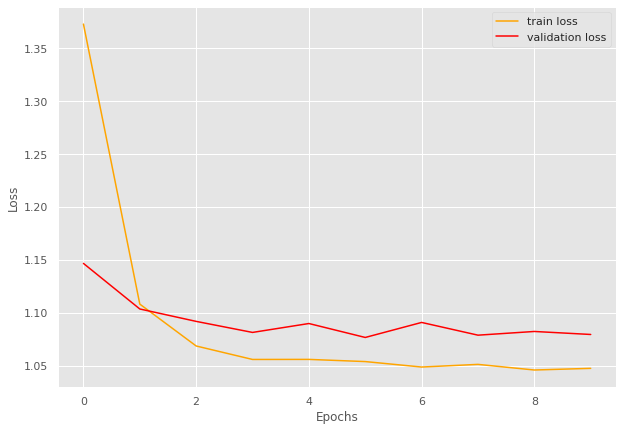

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

100%|██████████| 83/83 [00:28<00:00,  2.95batch/s, loss=1.72]


train loss 1.7178355110697, validation loss 1.5720195855413164, validation accuracy 0.896551724137931
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 83/83 [00:30<00:00,  2.72batch/s, loss=1.54]


train loss 1.5388480123267116, validation loss 1.5420134663581848, validation accuracy 0.9229885057471264
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 83/83 [00:53<00:00,  1.54batch/s, loss=1.51]


INFO: Early stopping counter 1 of 5
train loss 1.5145678520202637, validation loss 1.5442507352147783, validation accuracy 0.9229885057471264
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 83/83 [00:58<00:00,  1.42batch/s, loss=1.5] 


INFO: Early stopping counter 2 of 5
train loss 1.5044418329215912, validation loss 1.5435803362301417, validation accuracy 0.9137931034482759
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 83/83 [01:04<00:00,  1.29batch/s, loss=1.5] 


train loss 1.4978944781314896, validation loss 1.5200521690504891, validation accuracy 0.9448275862068966
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 83/83 [00:34<00:00,  2.39batch/s, loss=1.5] 


INFO: Early stopping counter 3 of 5
train loss 1.4974906688713165, validation loss 1.5288111056600298, validation accuracy 0.9344827586206896
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.95batch/s, loss=1.49]


INFO: Early stopping counter 4 of 5
train loss 1.4908428910266922, validation loss 1.5274728110858373, validation accuracy 0.9367816091954023
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.93batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9356140350877193 and loss 1.5261077095010427


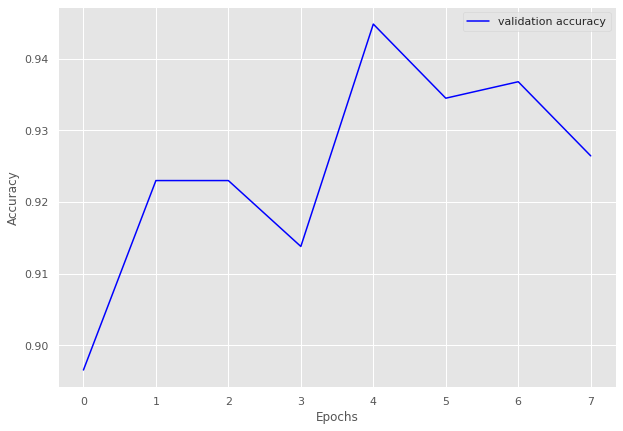

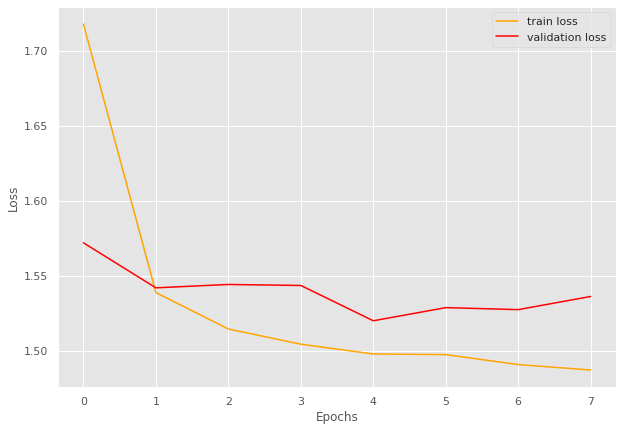

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.89batch/s, loss=1.31]


train loss 1.3123250832924476, validation loss 1.1352966342653548, validation accuracy 0.9101941747572816
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.86batch/s, loss=1.11]


train loss 1.1142279276481042, validation loss 1.1036345618111747, validation accuracy 0.9514563106796117
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.96batch/s, loss=1.1] 


train loss 1.0964899552174103, validation loss 1.0972013643809728, validation accuracy 0.941747572815534
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.96batch/s, loss=1.08]


train loss 1.0807994909775562, validation loss 1.0909536395754134, validation accuracy 0.9514563106796117
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.91batch/s, loss=1.07]


train loss 1.0680617460837731, validation loss 1.0864760875701904, validation accuracy 0.9538834951456311
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.94batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0681739281385372, validation loss 1.0887259926114763, validation accuracy 0.9538834951456311
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0633048888964531, validation loss 1.0962442670549666, validation accuracy 0.9441747572815534
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.98batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0640563170115154, validation loss 1.0897247791290283, validation accuracy 0.9490291262135923
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.98batch/s, loss=1.06]


train loss 1.0605655022156544, validation loss 1.085518547466823, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.94batch/s, loss=1.06]


train loss 1.0599779318540523, validation loss 1.0812779664993286, validation accuracy 0.9611650485436893
Coarse label 4 Epoch 11
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.96batch/s, loss=1.06]


train loss 1.0574315572396302, validation loss 1.078671966280256, validation accuracy 0.9587378640776699
Coarse label 4 Epoch 12
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.92batch/s, loss=1.05]


train loss 1.0522940433942354, validation loss 1.073709283556257, validation accuracy 0.9684466019417476
Coarse label 4 Epoch 13
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.96batch/s, loss=1.05]


train loss 1.0525772693829658, validation loss 1.0734561000551497, validation accuracy 0.970873786407767
Coarse label 4 Epoch 14
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.85batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0527384861921654, validation loss 1.0787701436451502, validation accuracy 0.9684466019417476
Coarse label 4 Epoch 15
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9539033457249071 and loss 1.0915813936906702


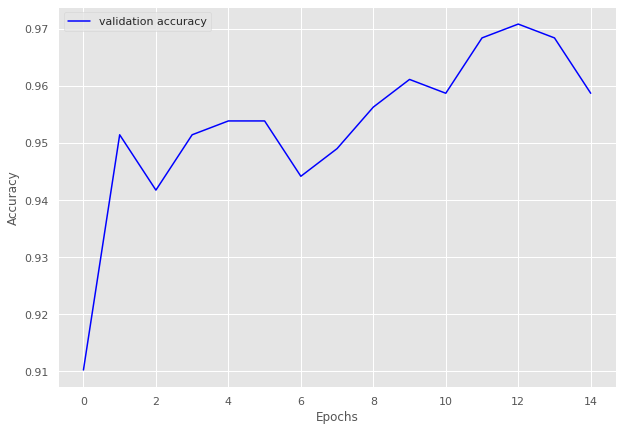

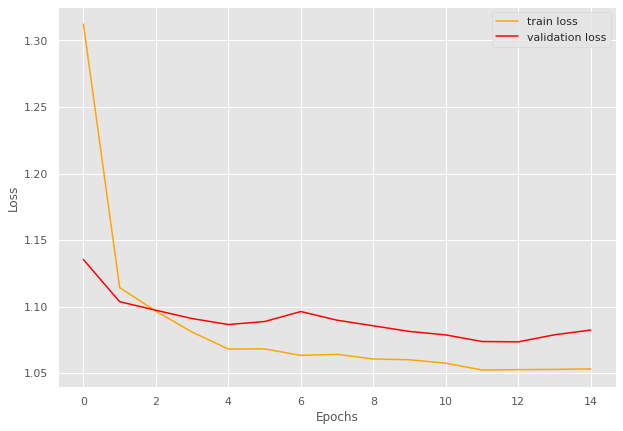

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.95batch/s, loss=0.429]


train loss 0.428878919283549, validation loss 0.34453268845876056, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.93batch/s, loss=0.332]


train loss 0.3319383124510447, validation loss 0.3366636832555135, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.91batch/s, loss=0.321]


INFO: Early stopping counter 1 of 5
train loss 0.32066694299379983, validation loss 0.34040523568789166, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.89batch/s, loss=0.32] 


INFO: Early stopping counter 2 of 5
train loss 0.3195895532766978, validation loss 0.3400861422220866, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.95batch/s, loss=0.32] 


INFO: Early stopping counter 3 of 5
train loss 0.3199836750825246, validation loss 0.34210947155952454, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.84batch/s, loss=0.317]


train loss 0.31723893284797666, validation loss 0.33429182569185895, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.92batch/s, loss=0.317]


INFO: Early stopping counter 4 of 5
train loss 0.31741149226824444, validation loss 0.3410504261652629, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.85batch/s, loss=0.316]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9788257940327237 and loss 0.3342634385282343


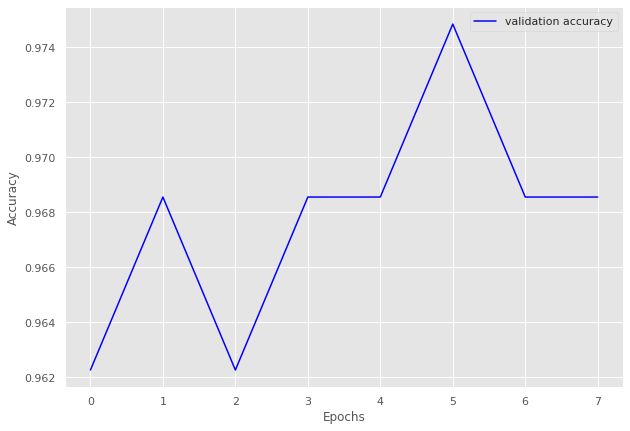

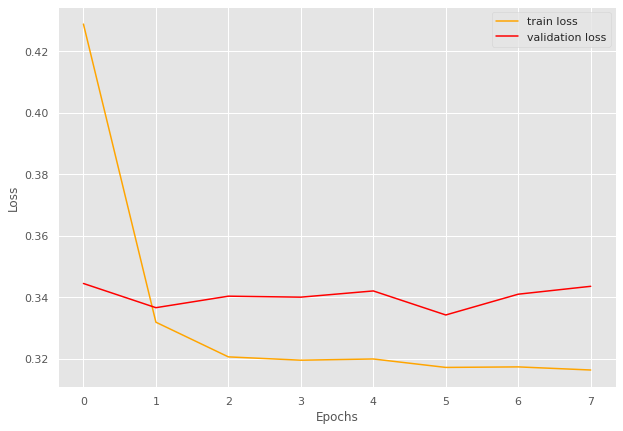

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 44/44 [00:17<00:00,  2.49batch/s, loss=1.4] 


train loss 1.4039528993043033, validation loss 1.2498361468315125, validation accuracy 0.915948275862069
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.96batch/s, loss=1.23]


train loss 1.2283118990334598, validation loss 1.2261455953121185, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.94batch/s, loss=1.21]


train loss 1.2103840952569789, validation loss 1.223754420876503, validation accuracy 0.9461206896551724
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.97batch/s, loss=1.21]


INFO: Early stopping counter 1 of 5
train loss 1.208178612318906, validation loss 1.238385632634163, validation accuracy 0.9245689655172413
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 44/44 [00:15<00:00,  2.93batch/s, loss=1.2] 


train loss 1.2014886926520953, validation loss 1.2165547907352448, validation accuracy 0.9504310344827587
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.94batch/s, loss=1.2] 


train loss 1.195719521154057, validation loss 1.2134746611118317, validation accuracy 0.9525862068965517
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.97batch/s, loss=1.19]


train loss 1.1912009092894467, validation loss 1.2115134298801422, validation accuracy 0.9547413793103449
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.94batch/s, loss=1.19]


train loss 1.1882588023489171, validation loss 1.207528606057167, validation accuracy 0.9612068965517241
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.96batch/s, loss=1.19]


INFO: Early stopping counter 2 of 5
train loss 1.1914238631725311, validation loss 1.2100224941968918, validation accuracy 0.959051724137931
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.97batch/s, loss=1.18]


train loss 1.1836060150103136, validation loss 1.2072829753160477, validation accuracy 0.9612068965517241
Coarse label 6 Epoch 11
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.95batch/s, loss=1.18]


INFO: Early stopping counter 3 of 5
train loss 1.1837907189672643, validation loss 1.2090584337711334, validation accuracy 0.959051724137931
Coarse label 6 Epoch 12
-------------------------------


100%|██████████| 44/44 [00:15<00:00,  2.93batch/s, loss=1.18]


INFO: Early stopping counter 4 of 5
train loss 1.1835896968841553, validation loss 1.2211221009492874, validation accuracy 0.9439655172413793
Coarse label 6 Epoch 13
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.94batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9222789395685822 and loss 1.2430086273896066


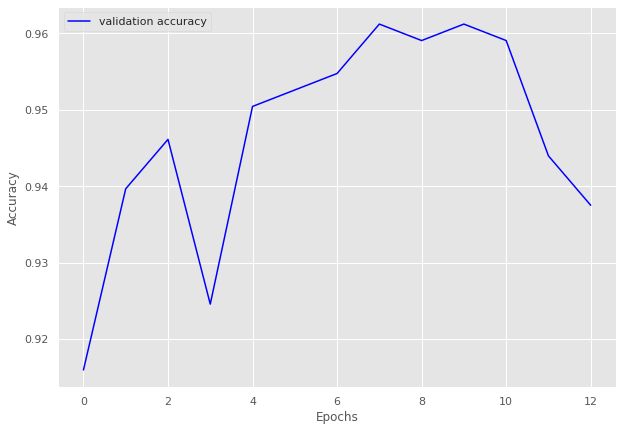

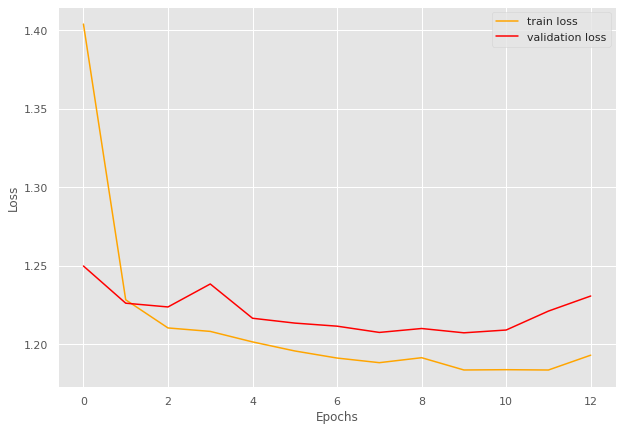

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.98batch/s, loss=0.886]


train loss 0.8861115642956325, validation loss 0.7911078532536825, validation accuracy 0.9504132231404959
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.94batch/s, loss=0.773]


INFO: Early stopping counter 1 of 5
train loss 0.7734920348439898, validation loss 0.79572261373202, validation accuracy 0.9504132231404959
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.97batch/s, loss=0.761]


train loss 0.7614974958556039, validation loss 0.787883480389913, validation accuracy 0.9559228650137741
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.98batch/s, loss=0.758]


INFO: Early stopping counter 2 of 5
train loss 0.758255227974483, validation loss 0.7904374698797861, validation accuracy 0.9559228650137741
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.96batch/s, loss=0.761]


INFO: Early stopping counter 3 of 5
train loss 0.7606887476784843, validation loss 0.7949180603027344, validation accuracy 0.9476584022038568
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.96batch/s, loss=0.761]


INFO: Early stopping counter 4 of 5
train loss 0.7610175711768014, validation loss 0.7938988904158274, validation accuracy 0.9476584022038568
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.95batch/s, loss=0.755]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9709657058699769 and loss 0.7743869574864706


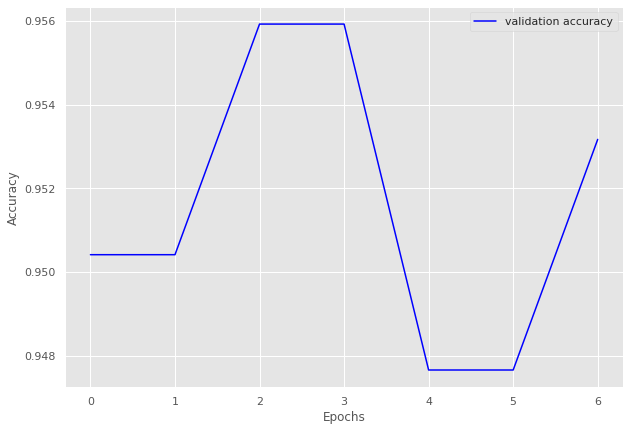

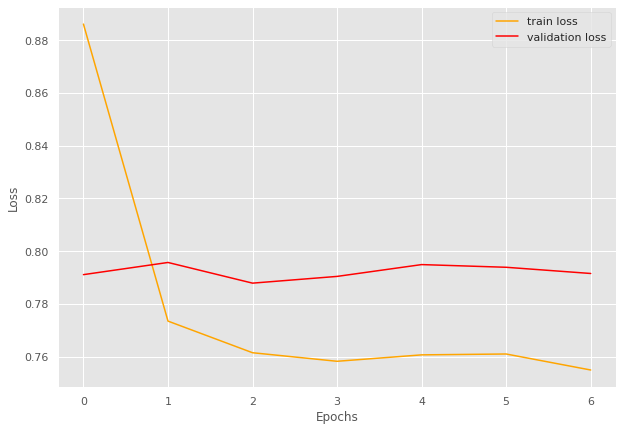

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.98batch/s, loss=1.43]


train loss 1.4346304742657408, validation loss 1.2669947147369385, validation accuracy 0.8962818003913894
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=1.24]


train loss 1.239987358754995, validation loss 1.255188837647438, validation accuracy 0.913894324853229
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.98batch/s, loss=1.22]


train loss 1.2177641026827755, validation loss 1.2360247075557709, validation accuracy 0.9315068493150684
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 49/49 [00:17<00:00,  2.87batch/s, loss=1.2] 


INFO: Early stopping counter 1 of 5
train loss 1.1984305114162213, validation loss 1.2415279746055603, validation accuracy 0.9178082191780822
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 49/49 [00:17<00:00,  2.88batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.1973899797517427, validation loss 1.238861620426178, validation accuracy 0.9256360078277887
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.97batch/s, loss=1.2] 


train loss 1.1971937636939847, validation loss 1.22697351872921, validation accuracy 0.9432485322896281
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.98batch/s, loss=1.2] 


INFO: Early stopping counter 3 of 5
train loss 1.1998399228465801, validation loss 1.2300776690244675, validation accuracy 0.9334637964774951
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.96batch/s, loss=1.2] 


train loss 1.198569463223827, validation loss 1.2237965762615204, validation accuracy 0.9471624266144814
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=1.19]


train loss 1.1907121794564384, validation loss 1.2210084795951843, validation accuracy 0.9452054794520548
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=1.18]


INFO: Early stopping counter 4 of 5
train loss 1.180388988280783, validation loss 1.226758912205696, validation accuracy 0.9412915851272016
Coarse label 8 Epoch 11
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.96batch/s, loss=1.18]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.93440167740003 and loss 1.2305007139841715


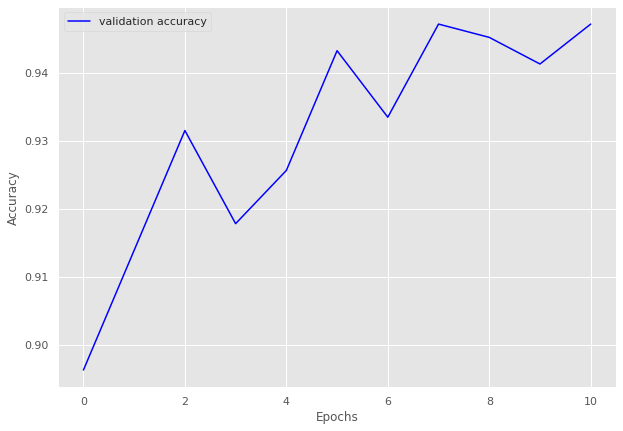

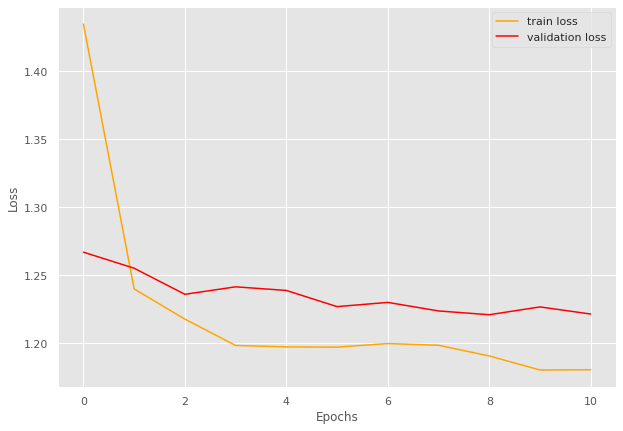

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.90batch/s, loss=1.72]


train loss 1.723759406902751, validation loss 1.635750044475902, validation accuracy 0.8935185185185185
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 61/61 [00:20<00:00,  2.91batch/s, loss=1.55]


train loss 1.5528300043012275, validation loss 1.545214208689603, validation accuracy 0.933641975308642
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.88batch/s, loss=1.52]


train loss 1.5169913866480842, validation loss 1.5184715336019343, validation accuracy 0.9444444444444444
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.89batch/s, loss=1.51]


train loss 1.5062127758244999, validation loss 1.5156227133490823, validation accuracy 0.941358024691358
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.88batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4948282808553977, validation loss 1.5306541594592007, validation accuracy 0.9444444444444444
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 61/61 [00:20<00:00,  2.91batch/s, loss=1.49]


train loss 1.4928158892959844, validation loss 1.5036782784895464, validation accuracy 0.9552469135802469
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.90batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4903582705826055, validation loss 1.5194281881505793, validation accuracy 0.9398148148148148
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.88batch/s, loss=1.48]


train loss 1.4835000917559764, validation loss 1.498171708800576, validation accuracy 0.9629629629629629
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.88batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4785601017905063, validation loss 1.5005047971552068, validation accuracy 0.9598765432098766
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.83batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4776944312892977, validation loss 1.5058209570971401, validation accuracy 0.9645061728395061
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 61/61 [00:20<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9464285714285714 and loss 1.5168501703362716


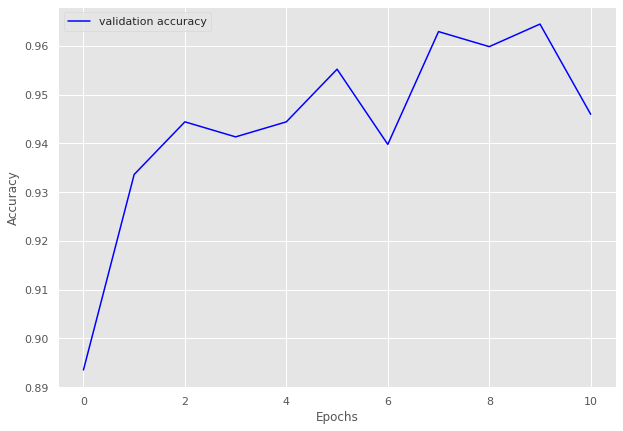

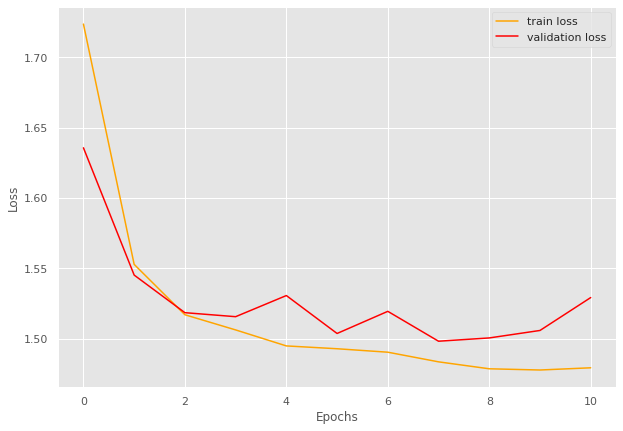

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.91batch/s, loss=0.919]


train loss 0.9193498985520725, validation loss 0.8015892267227173, validation accuracy 0.9407894736842105
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.91batch/s, loss=0.77] 


train loss 0.7702175481566067, validation loss 0.77386873960495, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.94batch/s, loss=0.759]


INFO: Early stopping counter 1 of 5
train loss 0.7592312611382583, validation loss 0.7792089462280274, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.92batch/s, loss=0.756]


train loss 0.7560060414774664, validation loss 0.770888376235962, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 29/29 [00:12<00:00,  2.38batch/s, loss=0.752]


INFO: Early stopping counter 2 of 5
train loss 0.7521197240928124, validation loss 0.7732533574104309, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 29/29 [00:19<00:00,  1.47batch/s, loss=0.752]


INFO: Early stopping counter 3 of 5
train loss 0.7517230695691602, validation loss 0.775673770904541, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 29/29 [00:16<00:00,  1.80batch/s, loss=0.76] 


train loss 0.759982875708876, validation loss 0.7669610977172852, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 29/29 [00:21<00:00,  1.36batch/s, loss=0.756]


INFO: Early stopping counter 4 of 5
train loss 0.756394507556126, validation loss 0.7673964858055115, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 29/29 [00:20<00:00,  1.42batch/s, loss=0.751]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9769192172604114 and loss 0.7670457864564563


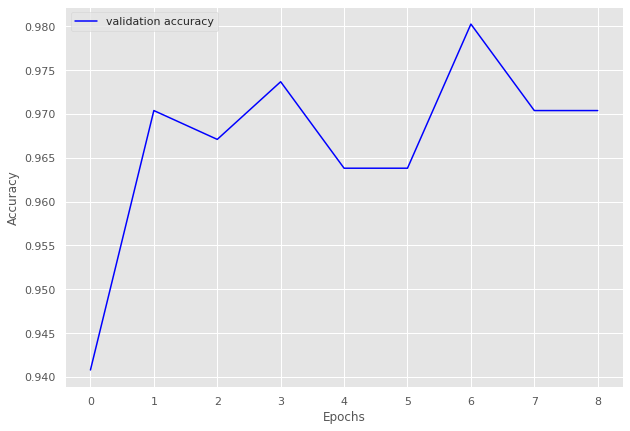

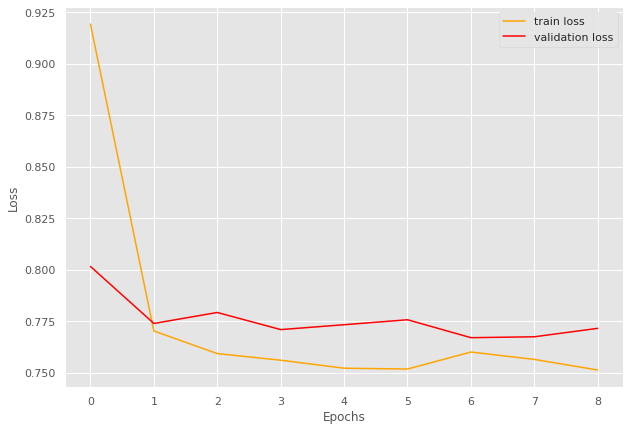

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 28/28 [00:19<00:00,  1.43batch/s, loss=1.4] 


train loss 1.3985179024083274, validation loss 1.1715133666992188, validation accuracy 0.8724137931034482
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:20<00:00,  1.38batch/s, loss=1.13]


train loss 1.1334842230592455, validation loss 1.1427552223205566, validation accuracy 0.903448275862069
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:20<00:00,  1.34batch/s, loss=1.11]


train loss 1.1080756315163203, validation loss 1.1270561933517456, validation accuracy 0.9172413793103448
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:21<00:00,  1.28batch/s, loss=1.09]


INFO: Early stopping counter 1 of 5
train loss 1.0889475686209542, validation loss 1.1400634050369263, validation accuracy 0.9103448275862069
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.01batch/s, loss=1.09]


INFO: Early stopping counter 2 of 5
train loss 1.085974327155522, validation loss 1.1332860231399535, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.03batch/s, loss=1.08]


INFO: Early stopping counter 3 of 5
train loss 1.0838879644870758, validation loss 1.1320628643035888, validation accuracy 0.9172413793103448
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=1.07]


train loss 1.074906383241926, validation loss 1.1212009191513062, validation accuracy 0.9172413793103448
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.071139863559178, validation loss 1.1231940269470215, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.03batch/s, loss=1.07]


train loss 1.0711696914264135, validation loss 1.1186193943023681, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.01batch/s, loss=1.07]


train loss 1.0676857488495963, validation loss 1.1128399133682252, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=1.07]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9254788769351876 and loss 1.1171746095021566


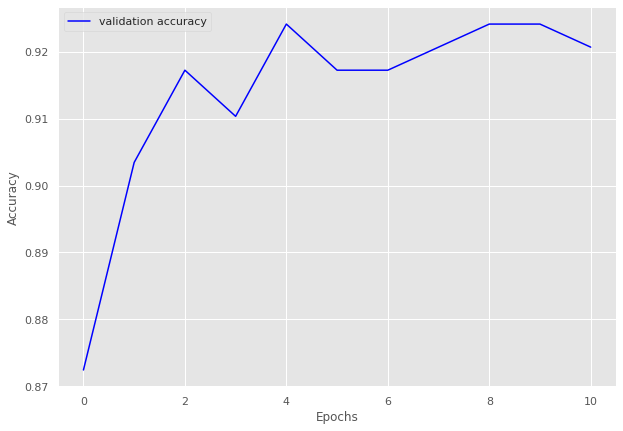

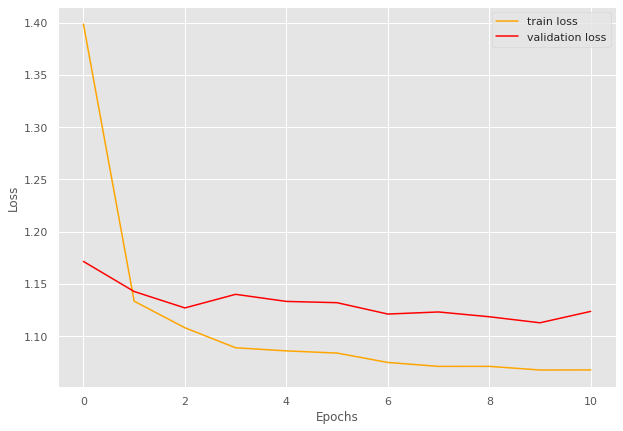

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.80batch/s, loss=0.707]


train loss 0.7066494989395141, validation loss 0.6330665826797486, validation accuracy 0.915057915057915
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.02batch/s, loss=0.598]


train loss 0.5977298927307129, validation loss 0.608000886440277, validation accuracy 0.9305019305019305
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.00batch/s, loss=0.585]


INFO: Early stopping counter 1 of 5
train loss 0.5848283052444458, validation loss 0.6102304577827453, validation accuracy 0.9305019305019305
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.93batch/s, loss=0.57] 


train loss 0.5700934100151062, validation loss 0.5940104365348816, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.02batch/s, loss=0.569]


INFO: Early stopping counter 2 of 5
train loss 0.5687849569320679, validation loss 0.5942478060722352, validation accuracy 0.9459459459459459
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.03batch/s, loss=0.57] 


INFO: Early stopping counter 3 of 5
train loss 0.5699783253669739, validation loss 0.5990074157714844, validation accuracy 0.9382239382239382
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.96batch/s, loss=0.566]


INFO: Early stopping counter 4 of 5
train loss 0.5663092851638794, validation loss 0.5966922044754028, validation accuracy 0.9420849420849421
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.98batch/s, loss=0.565]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9340626848018924 and loss 0.6162494139851264


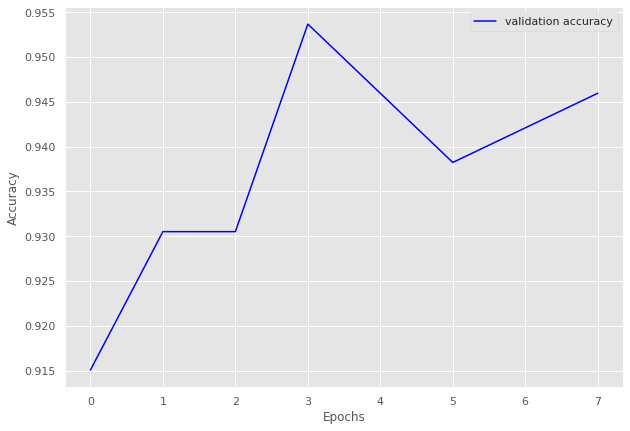

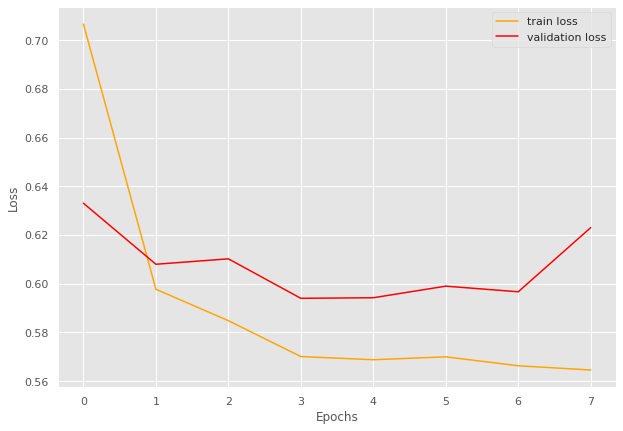

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.93batch/s, loss=1.22]


train loss 1.2175624434437071, validation loss 1.0954650521278382, validation accuracy 0.9511784511784511
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.91batch/s, loss=1.08]


train loss 1.0849933049508504, validation loss 1.0945230722427368, validation accuracy 0.9478114478114478
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.92batch/s, loss=1.07]


train loss 1.0744610684258598, validation loss 1.0944775819778443, validation accuracy 0.9511784511784511
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 56/56 [00:18<00:00,  2.95batch/s, loss=1.07]


train loss 1.0693039489643914, validation loss 1.0861881971359253, validation accuracy 0.9595959595959596
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.92batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.064007701618331, validation loss 1.0916885495185853, validation accuracy 0.9511784511784511
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.061225903885705, validation loss 1.0899455428123475, validation accuracy 0.9545454545454546
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0578870219843728, validation loss 1.0875136733055115, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.94batch/s, loss=1.06]


train loss 1.0581921424184526, validation loss 1.08104727268219, validation accuracy 0.9612794612794613
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.91batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0574470375265395, validation loss 1.085622251033783, validation accuracy 0.9562289562289562
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.94batch/s, loss=1.06]


train loss 1.0566179880074091, validation loss 1.0784600496292114, validation accuracy 0.968013468013468
Coarse label 14 Epoch 11
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.92batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9671434093544646 and loss 1.0766917760254906


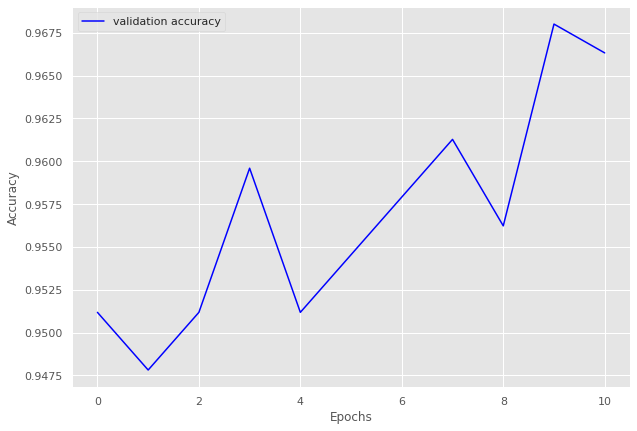

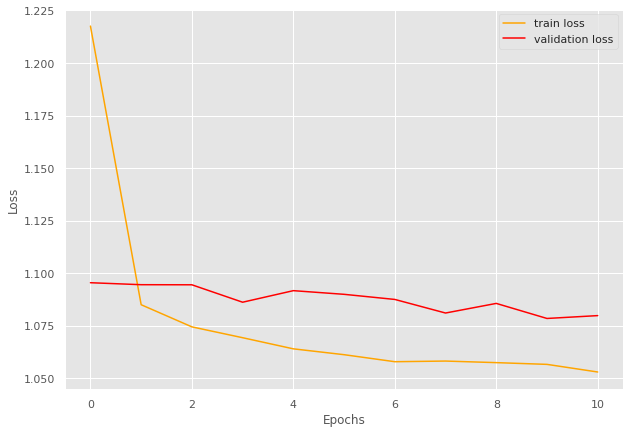

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=0.972]


train loss 0.9717610818999154, validation loss 0.7975534677505494, validation accuracy 0.9421768707482994
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=0.785]


train loss 0.7852442221982139, validation loss 0.7780661225318909, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=0.768]


train loss 0.7679242193698883, validation loss 0.7720009446144104, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=0.761]


train loss 0.7611607781478337, validation loss 0.7672340154647828, validation accuracy 0.9761904761904762
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.94batch/s, loss=0.755]


train loss 0.75497353715556, validation loss 0.7617283344268799, validation accuracy 0.9795918367346939
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=0.75] 


INFO: Early stopping counter 1 of 5
train loss 0.7501850639070783, validation loss 0.7634030461311341, validation accuracy 0.9795918367346939
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.92batch/s, loss=0.752]


train loss 0.7516556509903499, validation loss 0.758286988735199, validation accuracy 0.9829931972789115
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.94batch/s, loss=0.754]


INFO: Early stopping counter 2 of 5
train loss 0.7541912155491965, validation loss 0.7697798013687134, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=0.747]


INFO: Early stopping counter 3 of 5
train loss 0.7471907351698194, validation loss 0.7629441976547241, validation accuracy 0.9795918367346939
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=0.751]


train loss 0.750610106757709, validation loss 0.7580776333808898, validation accuracy 0.9863945578231292
Coarse label 15 Epoch 11
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.92batch/s, loss=0.749]


train loss 0.7488588328872409, validation loss 0.7567803025245666, validation accuracy 0.9863945578231292
Coarse label 15 Epoch 12
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.80batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.7508301883935928, validation loss 0.7594237089157104, validation accuracy 0.9829931972789115
Coarse label 15 Epoch 13
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.91batch/s, loss=0.752]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9637454355764214 and loss 0.7798013110955556


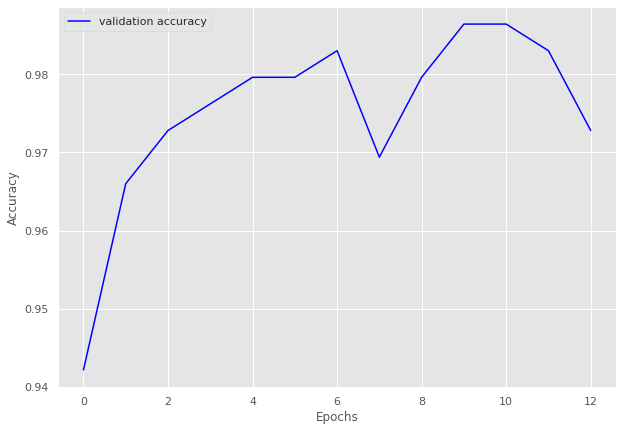

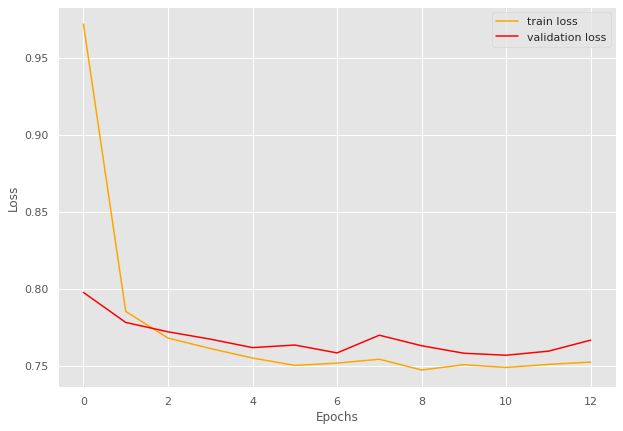

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.96batch/s, loss=0.719]


train loss 0.7194902543668393, validation loss 0.5813407659530639, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.99batch/s, loss=0.588]


INFO: Early stopping counter 1 of 5
train loss 0.5882899319684064, validation loss 0.5954982995986938, validation accuracy 0.9574468085106383
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.97batch/s, loss=0.571]


INFO: Early stopping counter 2 of 5
train loss 0.5710471294544361, validation loss 0.5847478151321411, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.99batch/s, loss=0.56] 


train loss 0.5601750965471621, validation loss 0.5698376417160034, validation accuracy 0.9858156028368794
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.96batch/s, loss=0.559]


INFO: Early stopping counter 3 of 5
train loss 0.5594960936793575, validation loss 0.5762056231498718, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.99batch/s, loss=0.557]


INFO: Early stopping counter 4 of 5
train loss 0.557435605261061, validation loss 0.5742898344993591, validation accuracy 0.9787234042553191
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.99batch/s, loss=0.556]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9573253601522153 and loss 0.5923353731632233


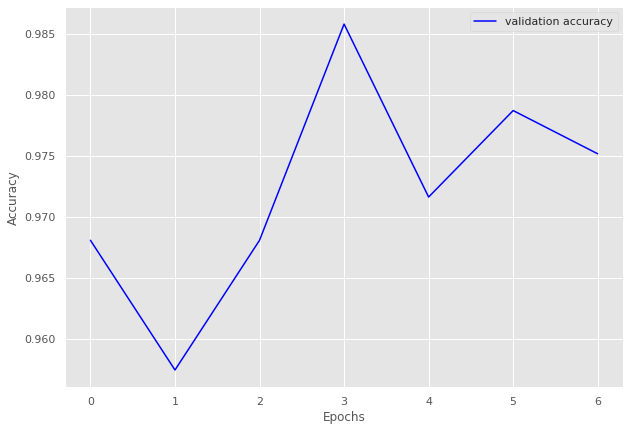

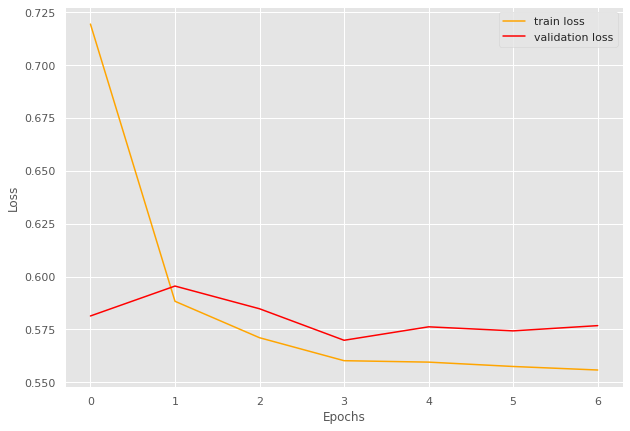

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 17 Epoch 1
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.03batch/s, loss=0.985]


train loss 0.9851970593134562, validation loss 0.8488624095916748, validation accuracy 0.8867313915857605
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.03batch/s, loss=0.808]


train loss 0.8082492510477702, validation loss 0.8251620650291442, validation accuracy 0.919093851132686
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.02batch/s, loss=0.783]


train loss 0.7833105405171712, validation loss 0.8209778904914856, validation accuracy 0.919093851132686
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.787]


train loss 0.7865877707799276, validation loss 0.8121649861335755, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=0.768]


train loss 0.7683368603388468, validation loss 0.8082788944244385, validation accuracy 0.9352750809061489
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  3.00batch/s, loss=0.771]


INFO: Early stopping counter 1 of 5
train loss 0.7712065835793813, validation loss 0.8105376124382019, validation accuracy 0.9385113268608414
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.769]


INFO: Early stopping counter 2 of 5
train loss 0.768835179011027, validation loss 0.8117464542388916, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.97batch/s, loss=0.781]


INFO: Early stopping counter 3 of 5
train loss 0.7808047354221344, validation loss 0.8188093304634094, validation accuracy 0.9223300970873787
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.768]


train loss 0.7682576139767965, validation loss 0.8070436120033264, validation accuracy 0.9385113268608414
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.02batch/s, loss=0.761]


train loss 0.7608112156391144, validation loss 0.805001950263977, validation accuracy 0.9385113268608414
Coarse label 17 Epoch 11
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.03batch/s, loss=0.762]


INFO: Early stopping counter 4 of 5
train loss 0.7619846979777019, validation loss 0.806110394001007, validation accuracy 0.9352750809061489
Coarse label 17 Epoch 12
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  3.00batch/s, loss=0.766]


train loss 0.7656803846359252, validation loss 0.7994585633277893, validation accuracy 0.9449838187702265
Coarse label 17 Epoch 13
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.76] 


train loss 0.760051566362381, validation loss 0.7963797807693481, validation accuracy 0.9449838187702265
Coarse label 17 Epoch 14
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=0.764]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9347718253968254 and loss 0.807773784985618


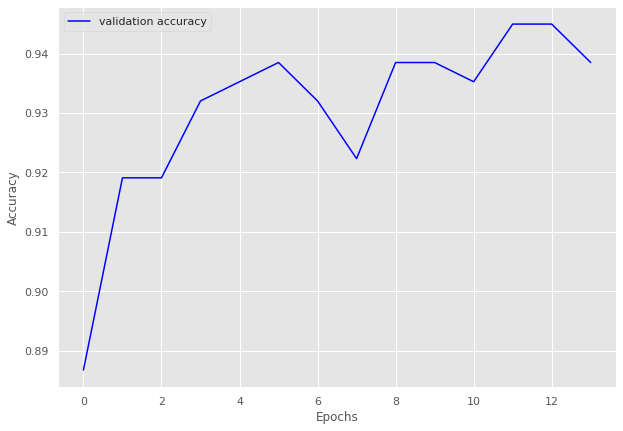

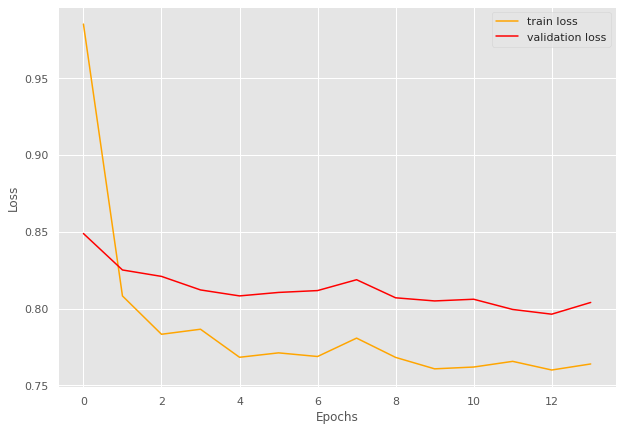

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 19 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.20batch/s, loss=1.14]


train loss 1.1418825030326842, validation loss 0.948904424905777, validation accuracy 0.8020833333333334
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.21batch/s, loss=0.831]


train loss 0.8309732615947724, validation loss 0.8270042240619659, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=0.777]


train loss 0.7773514151573181, validation loss 0.8045145571231842, validation accuracy 0.9375
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=0.763]


train loss 0.7626300275325775, validation loss 0.8001919388771057, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.20batch/s, loss=0.759]


train loss 0.758815324306488, validation loss 0.7908095121383667, validation accuracy 0.96875
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.22batch/s, loss=0.753]


train loss 0.7533632516860962, validation loss 0.7850926220417023, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.21batch/s, loss=0.753]


INFO: Early stopping counter 1 of 5
train loss 0.7527030229568481, validation loss 0.7964861989021301, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.12batch/s, loss=0.766]


train loss 0.7658952236175537, validation loss 0.7820982336997986, validation accuracy 0.96875
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.21batch/s, loss=0.756]


INFO: Early stopping counter 2 of 5
train loss 0.7563069343566895, validation loss 0.8008328676223755, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=0.751]


INFO: Early stopping counter 3 of 5
train loss 0.7505914688110351, validation loss 0.8016870319843292, validation accuracy 0.9375
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.11batch/s, loss=0.755]


INFO: Early stopping counter 4 of 5
train loss 0.7545779883861542, validation loss 0.7935154736042023, validation accuracy 0.9375
Coarse label 19 Epoch 12
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.16batch/s, loss=0.749]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9161442006269592 and loss 0.8303133070468902


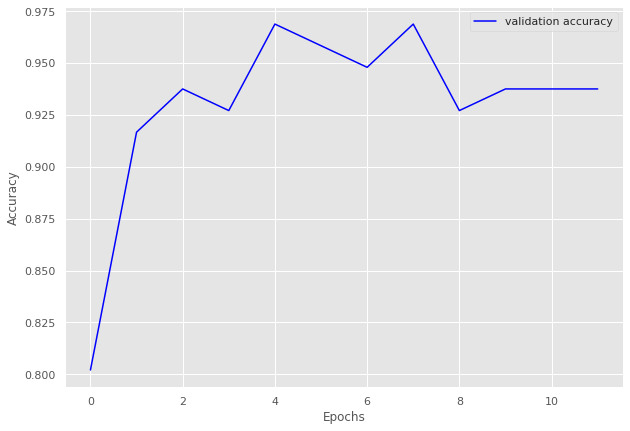

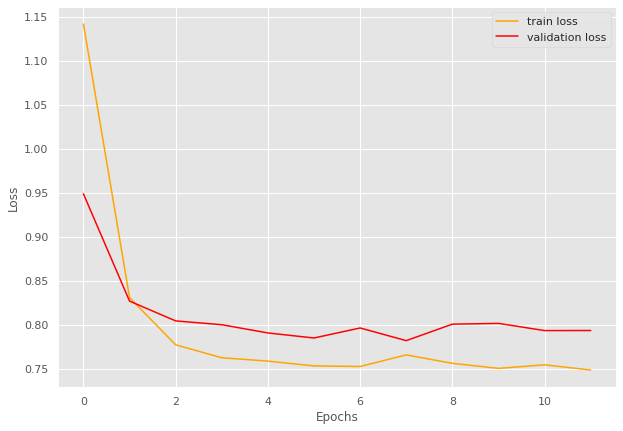

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Evaluating fine model 0
Evaluating fine model 1
Evaluating fine model 2
Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16
Evaluating fine model 17
Evaluating fine model 19
overall accuracy  is 0.802065601115059
{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.934230535279805

Calculating for volume 55
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=1.07]


train loss 1.0653111548984753, validation loss 0.9796586121831622, validation accuracy 0.9254079254079254
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.92batch/s, loss=0.952]


train loss 0.9517737758510253, validation loss 0.9724379352160862, validation accuracy 0.9324009324009324
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 68/68 [00:25<00:00,  2.67batch/s, loss=0.948]


INFO: Early stopping counter 1 of 5
train loss 0.9477311153622234, validation loss 0.9821391957146781, validation accuracy 0.916083916083916
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.939]


INFO: Early stopping counter 2 of 5
train loss 0.9391855755273033, validation loss 0.9782651747976031, validation accuracy 0.9230769230769231
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.92batch/s, loss=0.948]


INFO: Early stopping counter 3 of 5
train loss 0.9479298731859993, validation loss 0.9804864525794983, validation accuracy 0.9230769230769231
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.89batch/s, loss=0.939]


train loss 0.9387349644128014, validation loss 0.9702840277126857, validation accuracy 0.9300699300699301
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.92batch/s, loss=0.937]


train loss 0.9370475472772822, validation loss 0.9626921500478473, validation accuracy 0.9393939393939394
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.91batch/s, loss=0.932]


train loss 0.9316884787643657, validation loss 0.9613944547516959, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.929]


INFO: Early stopping counter 4 of 5
train loss 0.9287523478269577, validation loss 0.9624674575669425, validation accuracy 0.9393939393939394
Coarse label 0 Epoch 10
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.929]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9617261751862317 and loss 0.9426900627183132


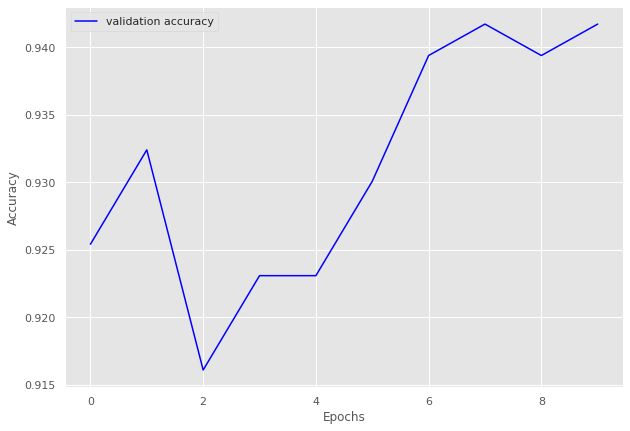

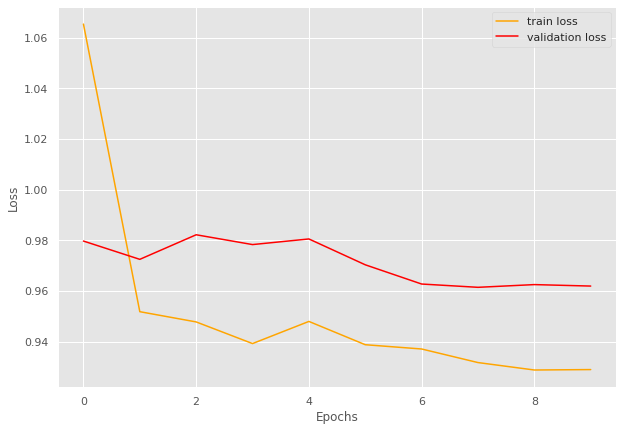

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 1 Epoch 1
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.96batch/s, loss=1.28]


train loss 1.282721205552419, validation loss 1.1390372514724731, validation accuracy 0.9086021505376344
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.94batch/s, loss=1.09]


train loss 1.09333735704422, validation loss 1.1075800657272339, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.95batch/s, loss=1.07]


train loss 1.0717668890953065, validation loss 1.0831864674886067, validation accuracy 0.967741935483871
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  3.00batch/s, loss=1.06]


train loss 1.0606274962425233, validation loss 1.081261396408081, validation accuracy 0.956989247311828
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.95batch/s, loss=1.06]


train loss 1.055975619951884, validation loss 1.071947415669759, validation accuracy 0.978494623655914
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.88batch/s, loss=1.05]


INFO: Early stopping counter 1 of 5
train loss 1.0522643804550171, validation loss 1.082058032353719, validation accuracy 0.956989247311828
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.95batch/s, loss=1.06]


train loss 1.0588853319485982, validation loss 1.0715755224227905, validation accuracy 0.967741935483871
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.97batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.0548712452252706, validation loss 1.0848186016082764, validation accuracy 0.956989247311828
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.052011211713155, validation loss 1.086639642715454, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.95batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0499116937319437, validation loss 1.0810632308324177, validation accuracy 0.9623655913978495
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.97batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9669811320754716 and loss 1.0763905313279893


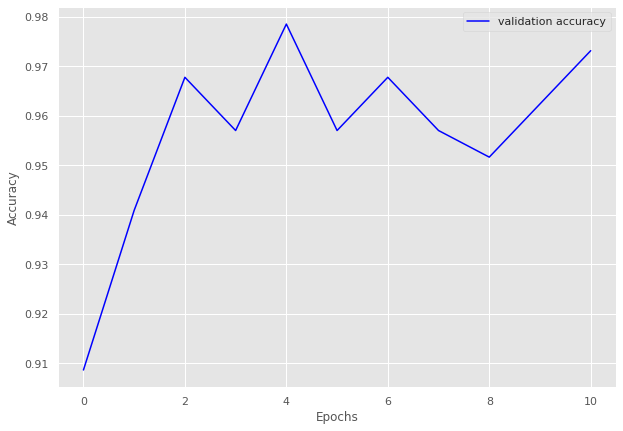

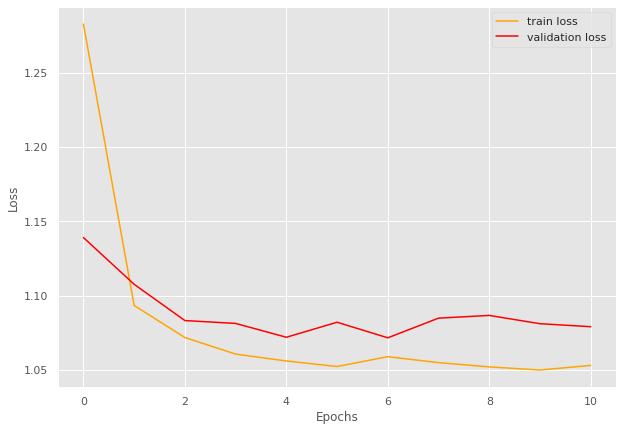

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 2 Epoch 1
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.88batch/s, loss=1.66]


train loss 1.6552079350408846, validation loss 1.5384728738239832, validation accuracy 0.9275862068965517
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.90batch/s, loss=1.53]


train loss 1.528496969355284, validation loss 1.5207574963569641, validation accuracy 0.9448275862068966
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 137/137 [00:46<00:00,  2.92batch/s, loss=1.51]


train loss 1.5135523724729998, validation loss 1.5205727645329066, validation accuracy 0.9425287356321839
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.90batch/s, loss=1.5] 


INFO: Early stopping counter 1 of 5
train loss 1.5047411152916232, validation loss 1.5227659940719604, validation accuracy 0.9379310344827586
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.90batch/s, loss=1.5]


INFO: Early stopping counter 2 of 5
train loss 1.498366095723897, validation loss 1.5222116112709045, validation accuracy 0.9425287356321839
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.49]


train loss 1.494451672491366, validation loss 1.517721916948046, validation accuracy 0.9448275862068966
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 137/137 [00:46<00:00,  2.92batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.4909698780435716, validation loss 1.5186469554901123, validation accuracy 0.9425287356321839
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 137/137 [00:46<00:00,  2.92batch/s, loss=1.49]


train loss 1.491929622462196, validation loss 1.5119885972567968, validation accuracy 0.9505747126436782
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.49]


INFO: Early stopping counter 4 of 5
train loss 1.4850284165709557, validation loss 1.5173782365662711, validation accuracy 0.9436781609195403
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.49]


train loss 1.487724368589638, validation loss 1.5106292026383537, validation accuracy 0.9505747126436782
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.89batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9531230203978208 and loss 1.508807950442837


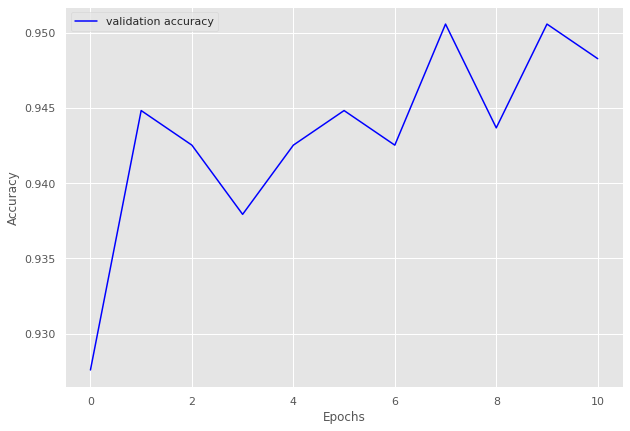

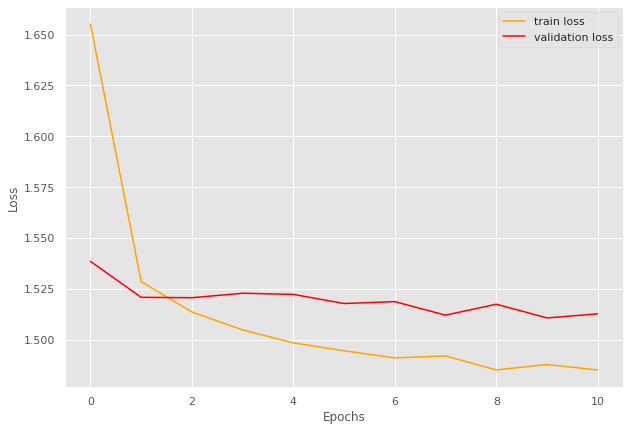

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.94batch/s, loss=1.25]


train loss 1.2521805121348455, validation loss 1.1165054185049874, validation accuracy 0.9320388349514563
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.97batch/s, loss=1.11]


train loss 1.1133653218929584, validation loss 1.0877845117024012, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=1.09]


train loss 1.085320181113023, validation loss 1.0822395086288452, validation accuracy 0.9587378640776699
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0737156281104454, validation loss 1.088766438620431, validation accuracy 0.9538834951456311
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.93batch/s, loss=1.08]


train loss 1.076108637222877, validation loss 1.0790372065135412, validation accuracy 0.9660194174757282
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.93batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0696815674121563, validation loss 1.0871227809361048, validation accuracy 0.9538834951456311
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.90batch/s, loss=1.07]


train loss 1.0662298954450167, validation loss 1.0708681174686976, validation accuracy 0.9733009708737864
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 65/65 [00:24<00:00,  2.61batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0640188437241775, validation loss 1.081223658152989, validation accuracy 0.9635922330097088
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.060326468027555, validation loss 1.0784451280321394, validation accuracy 0.9635922330097088
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9605580896163134 and loss 1.0845024121009696


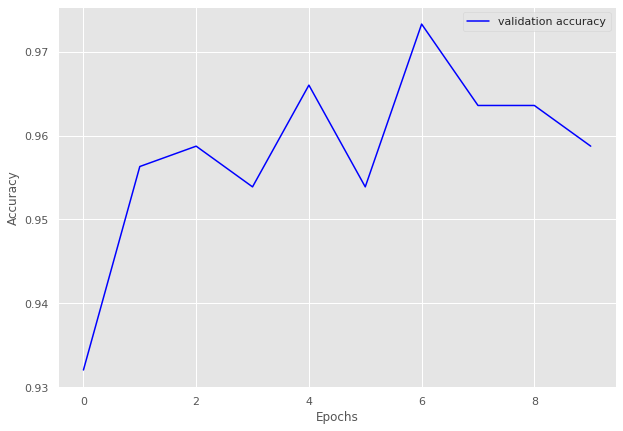

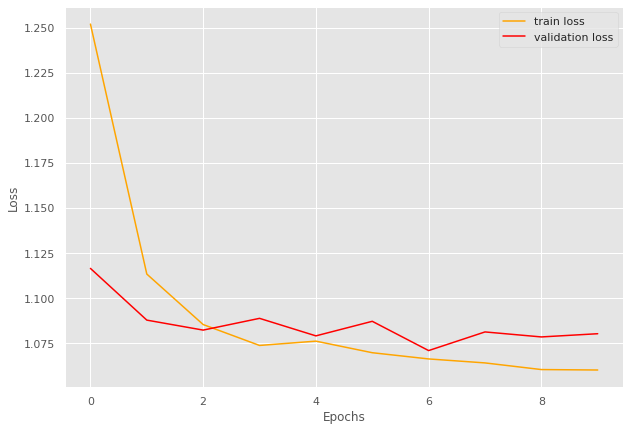

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9605580896163134
Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.89batch/s, loss=0.404]


train loss 0.4038965392112732, validation loss 0.3345145583152771, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.88batch/s, loss=0.331]


train loss 0.3308486843109131, validation loss 0.32789528369903564, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.88batch/s, loss=0.322]


train loss 0.3223175323009491, validation loss 0.325186550617218, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.94batch/s, loss=0.319]


INFO: Early stopping counter 1 of 5
train loss 0.3185951590538025, validation loss 0.32540108760197956, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.90batch/s, loss=0.32] 


INFO: Early stopping counter 2 of 5
train loss 0.3201518964767456, validation loss 0.3290666441122691, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.94batch/s, loss=0.322]


INFO: Early stopping counter 3 of 5
train loss 0.32163670778274533, validation loss 0.32843807339668274, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.91batch/s, loss=0.319]


train loss 0.31865268111228945, validation loss 0.3209575414657593, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 25/25 [00:09<00:00,  2.73batch/s, loss=0.317]


INFO: Early stopping counter 4 of 5
train loss 0.31728607177734375, validation loss 0.3281531830628713, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.92batch/s, loss=0.319]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9784572619874913 and loss 0.33497429412344226


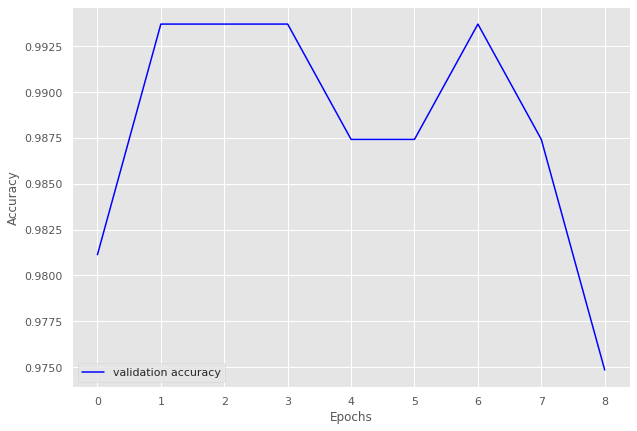

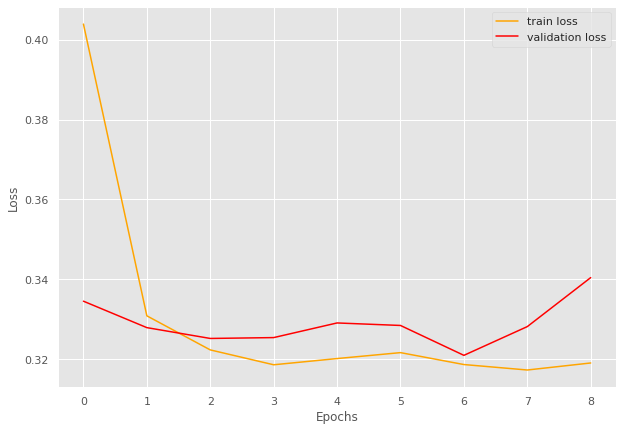

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.95batch/s, loss=1.36]


train loss 1.3620956744233224, validation loss 1.240255281329155, validation accuracy 0.9245689655172413
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.94batch/s, loss=1.23]


train loss 1.2329455238499054, validation loss 1.2280647605657578, validation accuracy 0.9310344827586207
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.94batch/s, loss=1.21]


train loss 1.2075424275986135, validation loss 1.2172436267137527, validation accuracy 0.9461206896551724
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.95batch/s, loss=1.2]


INFO: Early stopping counter 1 of 5
train loss 1.202213267757468, validation loss 1.221061110496521, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 73/73 [00:44<00:00,  1.65batch/s, loss=1.2]


train loss 1.1979710320903831, validation loss 1.2170662879943848, validation accuracy 0.9418103448275862
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 73/73 [00:55<00:00,  1.32batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.202645189141574, validation loss 1.2219848483800888, validation accuracy 0.9418103448275862
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 73/73 [00:53<00:00,  1.35batch/s, loss=1.2] 


train loss 1.1979739731305266, validation loss 1.2141742557287216, validation accuracy 0.9461206896551724
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 73/73 [00:51<00:00,  1.42batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1913692216350609, validation loss 1.2154651433229446, validation accuracy 0.9439655172413793
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.94batch/s, loss=1.19]


train loss 1.1879426306241179, validation loss 1.2066885381937027, validation accuracy 0.9525862068965517
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 73/73 [00:25<00:00,  2.90batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.18909226215049, validation loss 1.2163962721824646, validation accuracy 0.9461206896551724
Coarse label 6 Epoch 11
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.93batch/s, loss=1.2] 


train loss 1.1994329543962872, validation loss 1.2056511342525482, validation accuracy 0.9568965517241379
Coarse label 6 Epoch 12
-------------------------------


100%|██████████| 73/73 [00:25<00:00,  2.89batch/s, loss=1.19]


train loss 1.1896856500677866, validation loss 1.199251875281334, validation accuracy 0.9633620689655172
Coarse label 6 Epoch 13
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.95batch/s, loss=1.18]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9586206896551724 and loss 1.20623149655082


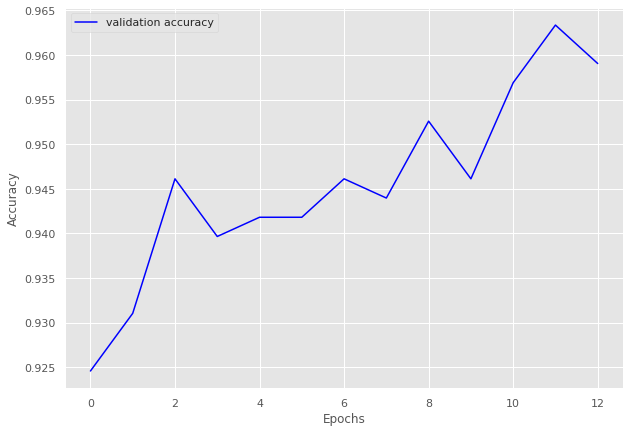

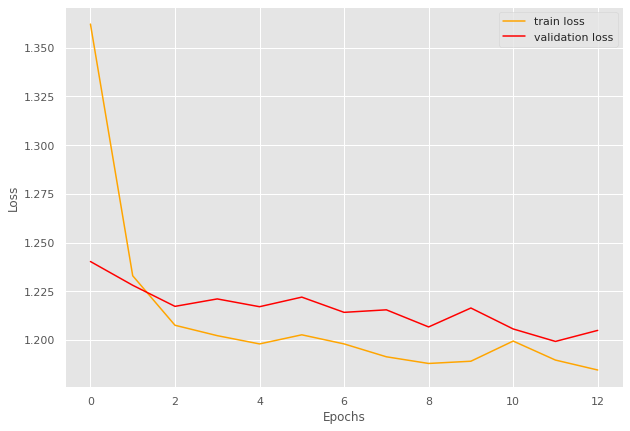

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.97batch/s, loss=0.852]


train loss 0.8519774572602634, validation loss 0.7653548320134481, validation accuracy 0.977961432506887
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.98batch/s, loss=0.774]


train loss 0.7739250125556156, validation loss 0.764503409465154, validation accuracy 0.977961432506887
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.95batch/s, loss=0.77] 


train loss 0.7696158803742508, validation loss 0.7626734773317972, validation accuracy 0.9834710743801653
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.95batch/s, loss=0.76] 


train loss 0.7604832433421036, validation loss 0.7623671690622965, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.94batch/s, loss=0.762]


INFO: Early stopping counter 1 of 5
train loss 0.7622774551654684, validation loss 0.7625632286071777, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.94batch/s, loss=0.766]


INFO: Early stopping counter 2 of 5
train loss 0.7660002585115104, validation loss 0.7671268085638682, validation accuracy 0.977961432506887
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.95batch/s, loss=0.758]


train loss 0.7580305399565861, validation loss 0.7593727012475332, validation accuracy 0.9834710743801653
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 58/58 [00:20<00:00,  2.89batch/s, loss=0.755]


train loss 0.7552224490149267, validation loss 0.7559663951396942, validation accuracy 0.9862258953168044
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.96batch/s, loss=0.761]


INFO: Early stopping counter 3 of 5
train loss 0.7605282592362371, validation loss 0.7652166187763214, validation accuracy 0.977961432506887
Coarse label 7 Epoch 10
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.94batch/s, loss=0.753]


INFO: Early stopping counter 4 of 5
train loss 0.752906013151695, validation loss 0.75737797220548, validation accuracy 0.9862258953168044
Coarse label 7 Epoch 11
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.95batch/s, loss=0.752]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9793438639125152 and loss 0.7640415865641373


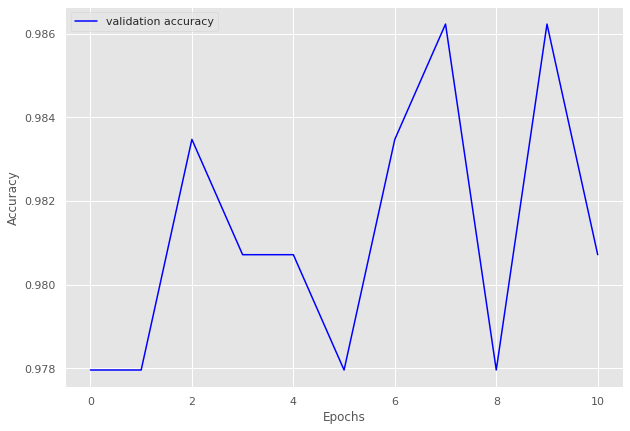

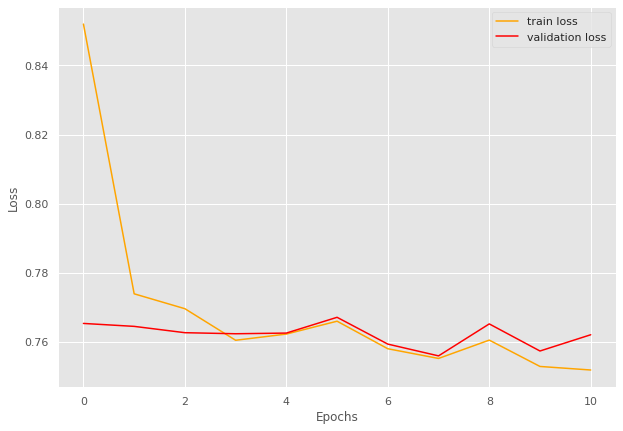

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.92batch/s, loss=1.39]


train loss 1.387322774639836, validation loss 1.2577724158763885, validation accuracy 0.9119373776908023
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.23]


train loss 1.2343305349349976, validation loss 1.2408101856708527, validation accuracy 0.9178082191780822
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.22]


train loss 1.2179502999341045, validation loss 1.2371920496225357, validation accuracy 0.9275929549902152
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.21]


train loss 1.2054002152548895, validation loss 1.2313793450593948, validation accuracy 0.9354207436399217
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.2] 


train loss 1.2046829653374942, validation loss 1.221738412976265, validation accuracy 0.9432485322896281
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 81/81 [00:28<00:00,  2.86batch/s, loss=1.19]


train loss 1.1948051982455783, validation loss 1.2141416519880295, validation accuracy 0.9530332681017613
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.91batch/s, loss=1.2] 


INFO: Early stopping counter 1 of 5
train loss 1.198143548435635, validation loss 1.218077912926674, validation accuracy 0.9432485322896281
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 81/81 [00:30<00:00,  2.67batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.195199065738254, validation loss 1.2193229645490646, validation accuracy 0.949119373776908
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.94batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1896343098746405, validation loss 1.2179166823625565, validation accuracy 0.9510763209393346
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.94batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1891584764292211, validation loss 1.218009889125824, validation accuracy 0.9530332681017613
Coarse label 8 Epoch 11
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.92batch/s, loss=1.18]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9424740484429066 and loss 1.2236439642840868


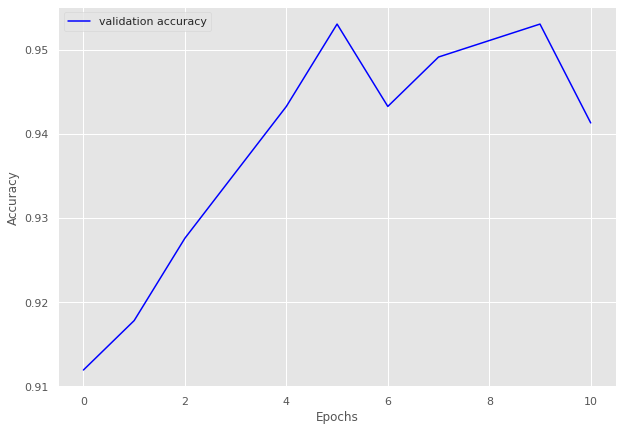

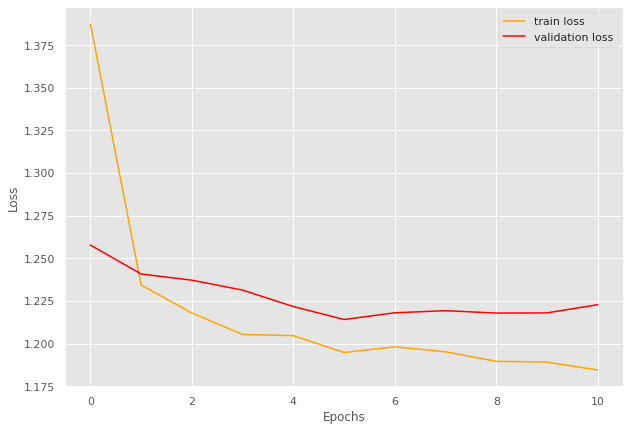

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9424740484429066
Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.89batch/s, loss=1.65]


train loss 1.6533443892703337, validation loss 1.5342994928359985, validation accuracy 0.9367283950617284
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 102/102 [00:34<00:00,  2.92batch/s, loss=1.53]


train loss 1.5298921126945346, validation loss 1.5323431275107644, validation accuracy 0.9475308641975309
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 102/102 [00:34<00:00,  2.93batch/s, loss=1.51]


train loss 1.5087158177413194, validation loss 1.5299364220012317, validation accuracy 0.9567901234567902
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.5]


train loss 1.4995645869011973, validation loss 1.503388220613653, validation accuracy 0.9614197530864198
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4930890389517242, validation loss 1.50985079461878, validation accuracy 0.9598765432098766
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 102/102 [00:34<00:00,  2.92batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4889484854305493, validation loss 1.5074618079445579, validation accuracy 0.9475308641975309
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4844466611450793, validation loss 1.5220352628014304, validation accuracy 0.9583333333333334
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.90batch/s, loss=1.48]


train loss 1.4836813117943557, validation loss 1.4867382591420955, validation accuracy 0.9737654320987654
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 102/102 [00:37<00:00,  2.72batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4793056121059494, validation loss 1.4984051964499734, validation accuracy 0.9598765432098766
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.88batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9631147540983607 and loss 1.4989949723948603


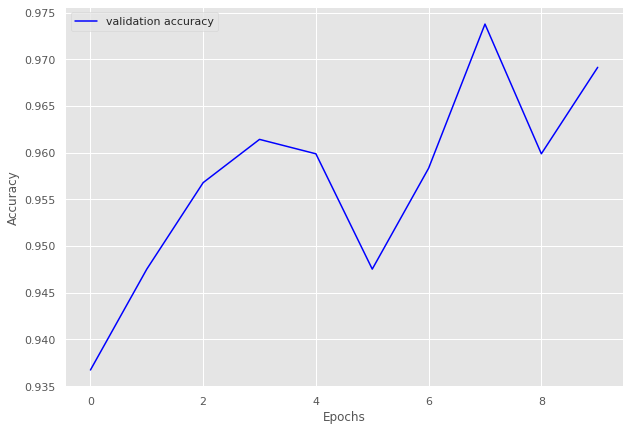

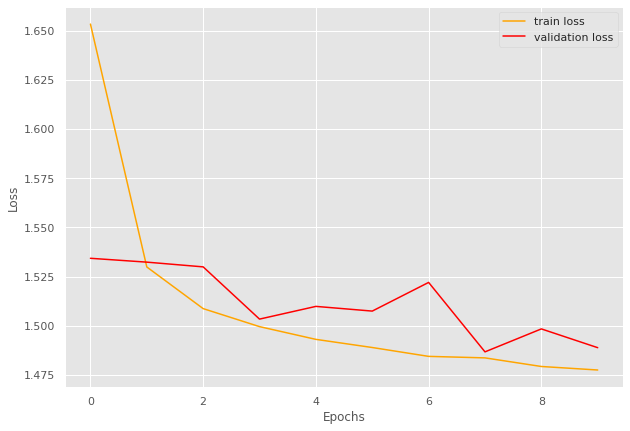

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.93batch/s, loss=0.864]


train loss 0.8641612430413564, validation loss 0.7678637623786926, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.88batch/s, loss=0.766]


train loss 0.7660788781940937, validation loss 0.7623228788375854, validation accuracy 0.9868421052631579
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.91batch/s, loss=0.757]


train loss 0.7567340520521005, validation loss 0.7550084233283997, validation accuracy 0.9901315789473685
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.92batch/s, loss=0.754]


INFO: Early stopping counter 1 of 5
train loss 0.7540252842009068, validation loss 0.7616153478622436, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.93batch/s, loss=0.753]


INFO: Early stopping counter 2 of 5
train loss 0.7526079192757607, validation loss 0.7554080724716187, validation accuracy 0.9901315789473685
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.93batch/s, loss=0.749]


INFO: Early stopping counter 3 of 5
train loss 0.7492906140784422, validation loss 0.7587206125259399, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.91batch/s, loss=0.748]


INFO: Early stopping counter 4 of 5
train loss 0.7483712695538998, validation loss 0.7606417179107666, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 48/48 [00:17<00:00,  2.69batch/s, loss=0.75] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9804347826086957 and loss 0.7625062018632889


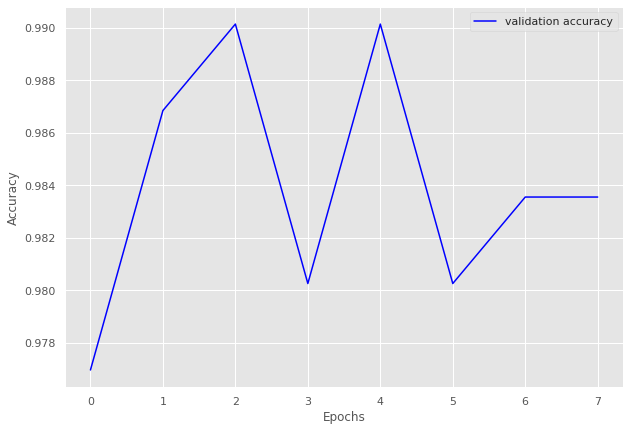

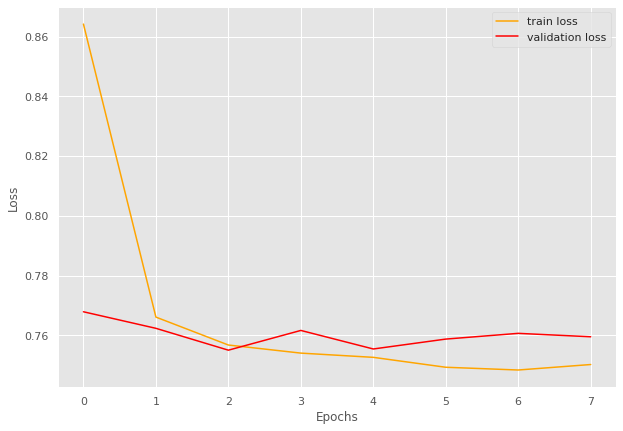

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 46/46 [00:28<00:00,  1.61batch/s, loss=1.29]


train loss 1.2910843595214512, validation loss 1.1204535961151123, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 46/46 [00:35<00:00,  1.28batch/s, loss=1.13]


train loss 1.1266547545142795, validation loss 1.1127408742904663, validation accuracy 0.9310344827586207
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 46/46 [00:32<00:00,  1.42batch/s, loss=1.11]


train loss 1.1076923479204592, validation loss 1.0973648309707642, validation accuracy 0.9448275862068966
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 46/46 [00:35<00:00,  1.31batch/s, loss=1.1] 


INFO: Early stopping counter 1 of 5
train loss 1.0959336446679158, validation loss 1.1002937078475952, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 46/46 [00:36<00:00,  1.28batch/s, loss=1.09]


train loss 1.0879221118014792, validation loss 1.096930980682373, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 46/46 [00:17<00:00,  2.67batch/s, loss=1.08]


INFO: Early stopping counter 2 of 5
train loss 1.0802453134370886, validation loss 1.098617672920227, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.93batch/s, loss=1.08]


train loss 1.0791546469149382, validation loss 1.09487464427948, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.98batch/s, loss=1.07]


train loss 1.0721844667973726, validation loss 1.083324408531189, validation accuracy 0.9586206896551724
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.92batch/s, loss=1.07]


train loss 1.0727265529010608, validation loss 1.0807817697525024, validation accuracy 0.9620689655172414
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.96batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0710581644721653, validation loss 1.113187026977539, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 46/46 [00:16<00:00,  2.84batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.070466583189757, validation loss 1.1026872158050538, validation accuracy 0.9448275862068966
Coarse label 12 Epoch 12
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.91batch/s, loss=1.07]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9261363636363636 and loss 1.1154059228442965


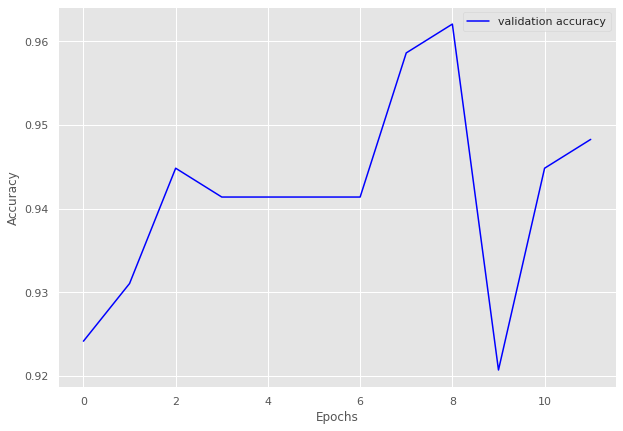

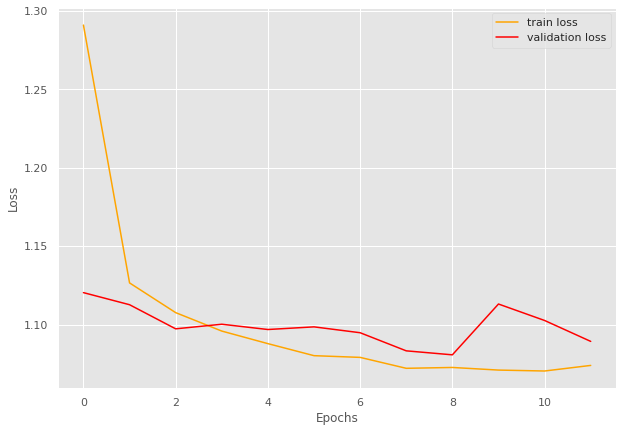

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.90batch/s, loss=0.686]


train loss 0.6858075217502874, validation loss 0.6008899092674256, validation accuracy 0.9382239382239382
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.598]


train loss 0.5984458327293396, validation loss 0.5959376215934753, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.93batch/s, loss=0.586]


train loss 0.5861886536202779, validation loss 0.5950491905212403, validation accuracy 0.9459459459459459
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.583]


train loss 0.5833889420439557, validation loss 0.5860629200935363, validation accuracy 0.9652509652509652
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=0.58] 


INFO: Early stopping counter 1 of 5
train loss 0.5800908338732835, validation loss 0.5949794173240661, validation accuracy 0.9420849420849421
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.576]


train loss 0.5764998822677426, validation loss 0.5846526145935058, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=0.571]


INFO: Early stopping counter 2 of 5
train loss 0.5713425671182027, validation loss 0.5854230403900147, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.568]


train loss 0.567753008226069, validation loss 0.5820099472999573, validation accuracy 0.9613899613899614
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:16<00:00,  2.47batch/s, loss=0.568]


INFO: Early stopping counter 3 of 5
train loss 0.5677555174362369, validation loss 0.5891356468200684, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 10
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.567]


train loss 0.5669000352301249, validation loss 0.5788076877593994, validation accuracy 0.9652509652509652
Coarse label 13 Epoch 11
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=0.564]


INFO: Early stopping counter 4 of 5
train loss 0.5644033623904716, validation loss 0.5818130731582641, validation accuracy 0.9652509652509652
Coarse label 13 Epoch 12
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.96batch/s, loss=0.563]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9572832123024348 and loss 0.5929653644561768


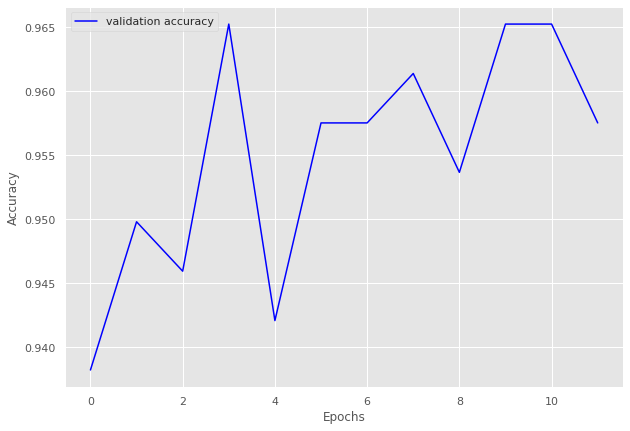

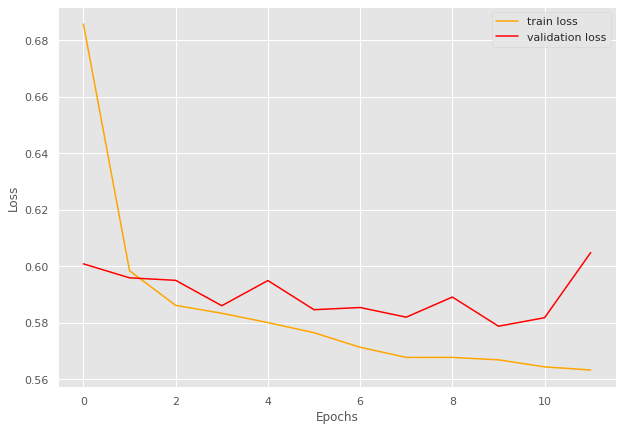

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.93batch/s, loss=1.17]


train loss 1.1703953045479796, validation loss 1.0891252875328064, validation accuracy 0.9545454545454546
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.94batch/s, loss=1.09]


train loss 1.0861352009976164, validation loss 1.0807652235031129, validation accuracy 0.9646464646464646
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.081599604576192, validation loss 1.0808077216148377, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.07]


train loss 1.073050521789713, validation loss 1.0778855681419373, validation accuracy 0.9629629629629629
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.07]


train loss 1.0682697194687865, validation loss 1.0768604040145875, validation accuracy 0.9663299663299664
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0693989066367453, validation loss 1.0772956371307374, validation accuracy 0.9629629629629629
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.91batch/s, loss=1.06]


train loss 1.0620780181377492, validation loss 1.0724536657333374, validation accuracy 0.9713804713804713
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0575410749049896, validation loss 1.0753065943717957, validation accuracy 0.9663299663299664
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0576880054270967, validation loss 1.0797048211097717, validation accuracy 0.9612794612794613
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.976 and loss 1.0677037210691542


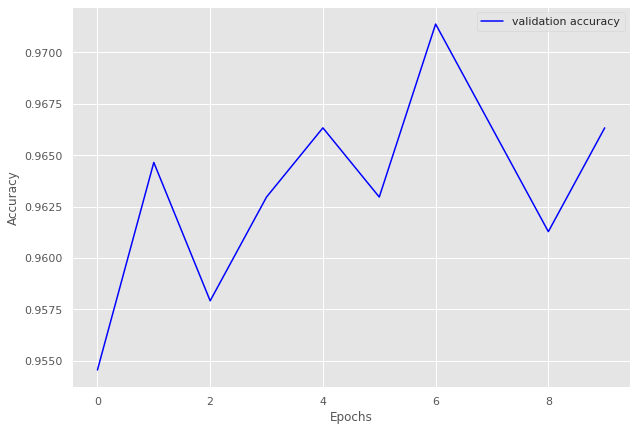

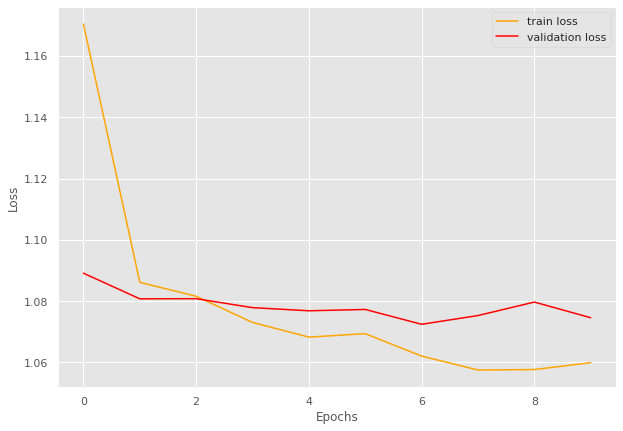

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.95batch/s, loss=0.897]


train loss 0.8966368817268534, validation loss 0.8084116220474243, validation accuracy 0.9319727891156463
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.97batch/s, loss=0.774]


train loss 0.7741957154679806, validation loss 0.7906829953193665, validation accuracy 0.9455782312925171
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  3.00batch/s, loss=0.769]


train loss 0.7690360888521722, validation loss 0.779487133026123, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  3.00batch/s, loss=0.761]


train loss 0.7610441826759501, validation loss 0.7778553128242492, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.99batch/s, loss=0.762]


train loss 0.7623057023007819, validation loss 0.766904103755951, validation accuracy 0.9829931972789115
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.96batch/s, loss=0.772]


INFO: Early stopping counter 1 of 5
train loss 0.7718886695009597, validation loss 0.7695979356765748, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.97batch/s, loss=0.76] 


INFO: Early stopping counter 2 of 5
train loss 0.7600679549765079, validation loss 0.7818698883056641, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.97batch/s, loss=0.761]


INFO: Early stopping counter 3 of 5
train loss 0.7613828372448048, validation loss 0.7776960849761962, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.98batch/s, loss=0.755]


INFO: Early stopping counter 4 of 5
train loss 0.7548327864484584, validation loss 0.7740651607513428, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.98batch/s, loss=0.753]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9706103993971364 and loss 0.7731673419475555


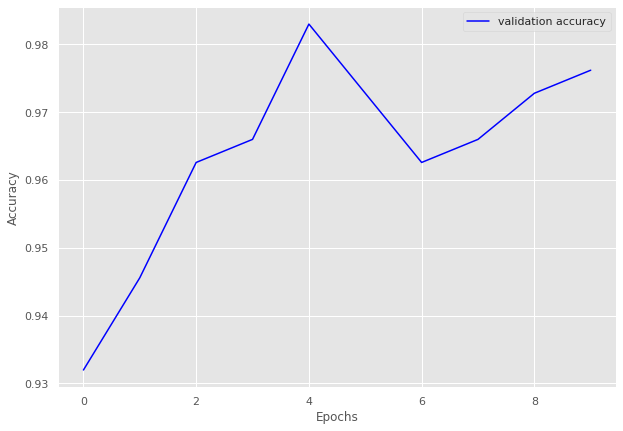

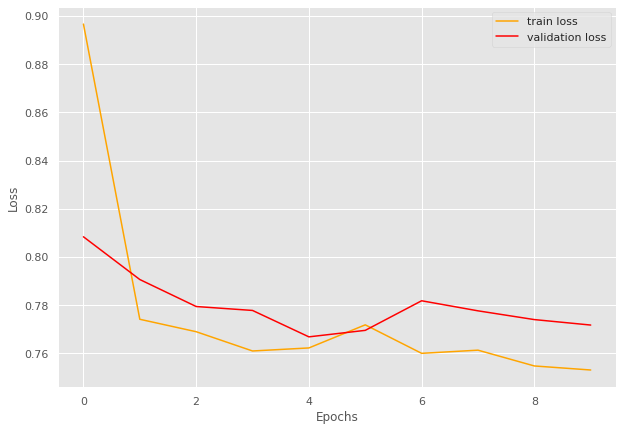

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.88batch/s, loss=0.675]


train loss 0.6746548904312981, validation loss 0.6052400231361389, validation accuracy 0.9468085106382979
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 45/45 [00:14<00:00,  3.01batch/s, loss=0.58] 


train loss 0.5796781182289124, validation loss 0.5767796158790588, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.97batch/s, loss=0.566]


train loss 0.566162829928928, validation loss 0.5734086275100708, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.97batch/s, loss=0.561]


INFO: Early stopping counter 1 of 5
train loss 0.5609539084964328, validation loss 0.5790378332138062, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.99batch/s, loss=0.57] 


train loss 0.570209370719062, validation loss 0.5686755895614624, validation accuracy 0.9822695035460993
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.96batch/s, loss=0.562]


INFO: Early stopping counter 2 of 5
train loss 0.5615821533732944, validation loss 0.5757544636726379, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.97batch/s, loss=0.562]


INFO: Early stopping counter 3 of 5
train loss 0.561753589577145, validation loss 0.5804267406463623, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.98batch/s, loss=0.555]


INFO: Early stopping counter 4 of 5
train loss 0.5549326406584846, validation loss 0.571272325515747, validation accuracy 0.9787234042553191
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.96batch/s, loss=0.554]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9823390894819466 and loss 0.5691035032272339


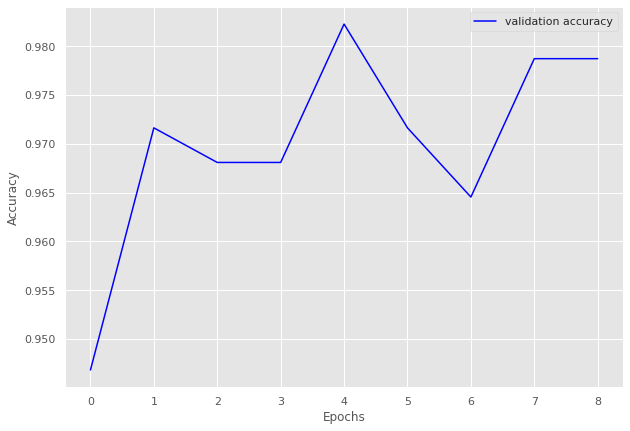

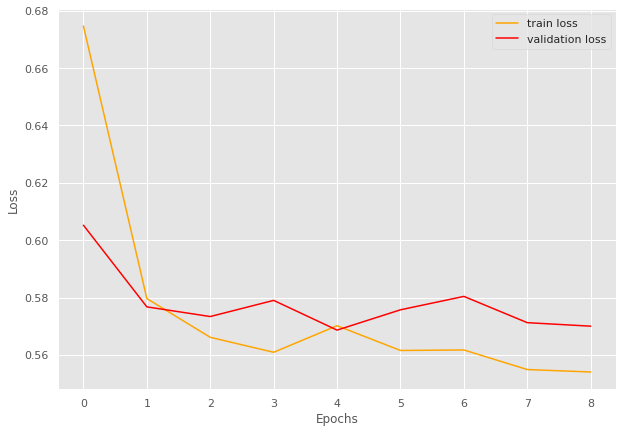

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 17 Epoch 1
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.96batch/s, loss=0.92] 


train loss 0.9198955127171108, validation loss 0.826852810382843, validation accuracy 0.9158576051779935
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.97batch/s, loss=0.792]


train loss 0.7919358915212203, validation loss 0.8030268669128418, validation accuracy 0.9449838187702265
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.93batch/s, loss=0.785]


INFO: Early stopping counter 1 of 5
train loss 0.7847656473821524, validation loss 0.8157869338989258, validation accuracy 0.9223300970873787
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=0.776]


train loss 0.7755331737654549, validation loss 0.7995499014854431, validation accuracy 0.9449838187702265
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.93batch/s, loss=0.768]


INFO: Early stopping counter 2 of 5
train loss 0.7676892973938767, validation loss 0.7997514843940735, validation accuracy 0.948220064724919
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=0.769]


train loss 0.7685953670618485, validation loss 0.7902421593666077, validation accuracy 0.9514563106796117
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=0.765]


train loss 0.7650916710191843, validation loss 0.7894113302230835, validation accuracy 0.9546925566343042
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.98batch/s, loss=0.762]


train loss 0.7617037150324607, validation loss 0.7879942536354065, validation accuracy 0.9611650485436893
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=0.757]


INFO: Early stopping counter 3 of 5
train loss 0.7572262688558928, validation loss 0.7882136464118957, validation accuracy 0.9579288025889967
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.97batch/s, loss=0.758]


INFO: Early stopping counter 4 of 5
train loss 0.7577537638800484, validation loss 0.7981088280677795, validation accuracy 0.941747572815534
Coarse label 17 Epoch 11
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=0.76] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9584527220630372 and loss 0.7852442454208027


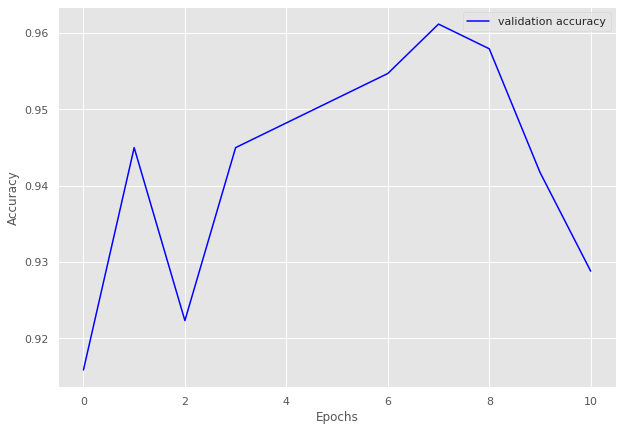

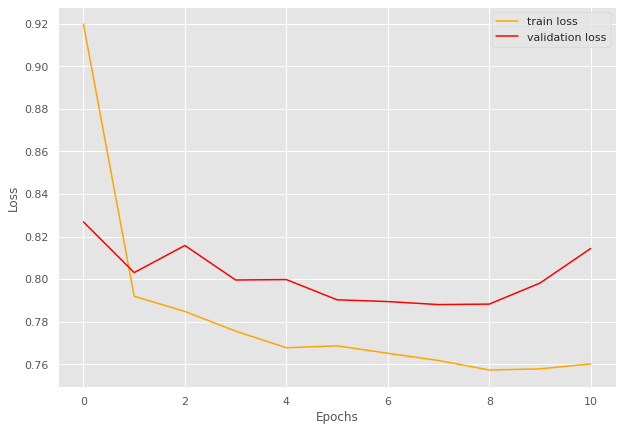

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 19 Epoch 1
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.00batch/s, loss=1.05]


train loss 1.050723385065794, validation loss 0.855429470539093, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.09batch/s, loss=0.811]


train loss 0.8105446770787239, validation loss 0.790794312953949, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.07batch/s, loss=0.76] 


train loss 0.7600464075803757, validation loss 0.7719802856445312, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.03batch/s, loss=0.751]


INFO: Early stopping counter 1 of 5
train loss 0.7506751678884029, validation loss 0.779922753572464, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.03batch/s, loss=0.748]


INFO: Early stopping counter 2 of 5
train loss 0.748346135020256, validation loss 0.7860274016857147, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  2.99batch/s, loss=0.749]


INFO: Early stopping counter 3 of 5
train loss 0.7492038980126381, validation loss 0.7837974429130554, validation accuracy 0.9375
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.07batch/s, loss=0.747]


INFO: Early stopping counter 4 of 5
train loss 0.7469307705760002, validation loss 0.7855596840381622, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.09batch/s, loss=0.747]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9524886877828054 and loss 0.789134966475623


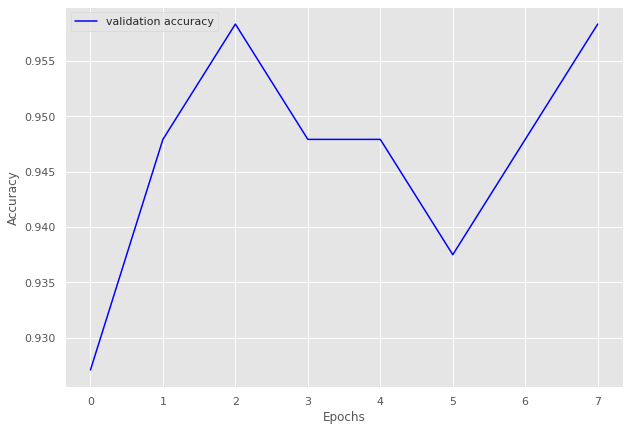

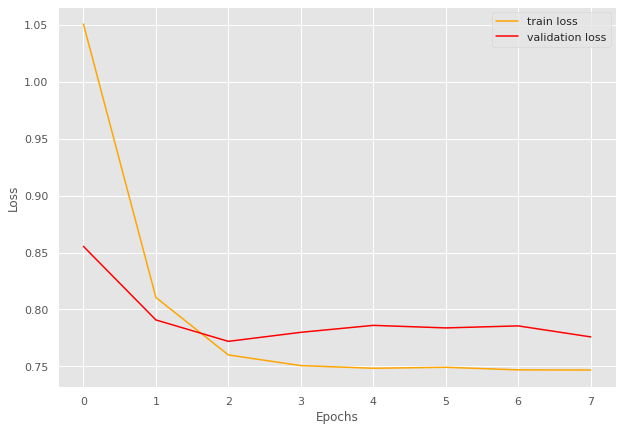

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Evaluating fine model 0
Evaluating fine model 1
Evaluating fine model 2
Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16
Evaluating fine model 17
Evaluating fine model 19
overall accuracy  is 0.8138476005081083
{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.93423053527980

Calculating for volume 85
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=1.04]


train loss 1.0393773962598327, validation loss 0.9594390903200422, validation accuracy 0.9440559440559441
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.93batch/s, loss=0.949]


train loss 0.9485136183030015, validation loss 0.9529519762311663, validation accuracy 0.951048951048951
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.945]


train loss 0.9450495423526939, validation loss 0.9435090592929295, validation accuracy 0.9603729603729604
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.91batch/s, loss=0.945]


train loss 0.9450965233899038, validation loss 0.940355828830174, validation accuracy 0.9627039627039627
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.939]


INFO: Early stopping counter 1 of 5
train loss 0.9394177001550656, validation loss 0.9615283182689122, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 109/109 [00:39<00:00,  2.73batch/s, loss=0.938]


INFO: Early stopping counter 2 of 5
train loss 0.9381034007859886, validation loss 0.9461644973073687, validation accuracy 0.9533799533799534
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.93batch/s, loss=0.933]


train loss 0.932848714907235, validation loss 0.9398596116474697, validation accuracy 0.9627039627039627
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.90batch/s, loss=0.932]


INFO: Early stopping counter 3 of 5
train loss 0.9316466527247648, validation loss 0.9420972721917289, validation accuracy 0.9627039627039627
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.93batch/s, loss=0.937]


INFO: Early stopping counter 4 of 5
train loss 0.9366391142573925, validation loss 0.9432810800416129, validation accuracy 0.9603729603729604
Coarse label 0 Epoch 10
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.92batch/s, loss=0.928]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9530408006158584 and loss 0.9506089460282099


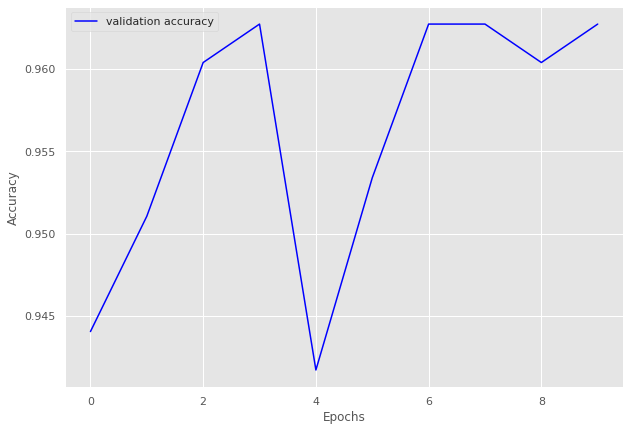

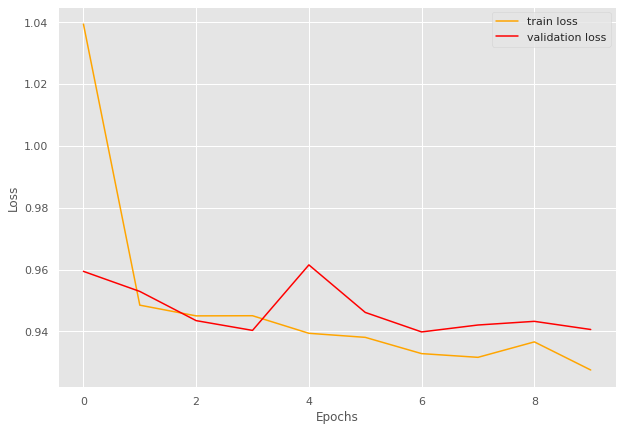

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9530408006158584
Coarse label 1 Epoch 1
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.90batch/s, loss=1.23]


train loss 1.227616639847451, validation loss 1.0789718230565388, validation accuracy 0.9731182795698925
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.91batch/s, loss=1.08]


train loss 1.0845323877131685, validation loss 1.0686225096384685, validation accuracy 0.9731182795698925
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.90batch/s, loss=1.07]


train loss 1.0667104873251407, validation loss 1.0572530031204224, validation accuracy 0.989247311827957
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.91batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.062726763968772, validation loss 1.0728319088617961, validation accuracy 0.978494623655914
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.86batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0554763535235792, validation loss 1.0752559502919514, validation accuracy 0.967741935483871
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.81batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0567211927251612, validation loss 1.0789535840352376, validation accuracy 0.967741935483871
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.92batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0583045305089747, validation loss 1.0653927723566692, validation accuracy 0.978494623655914
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.91batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9841549295774648 and loss 1.0611386034223769


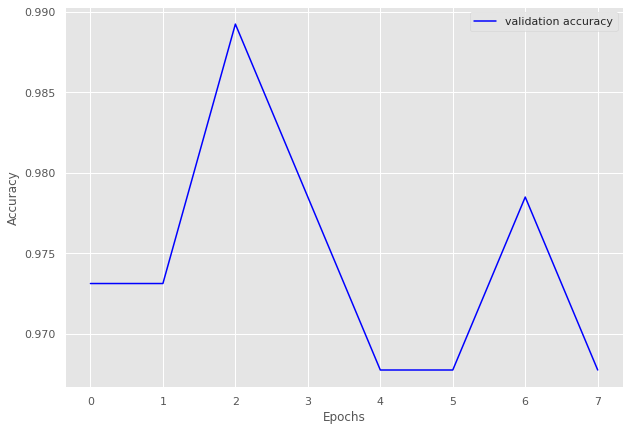

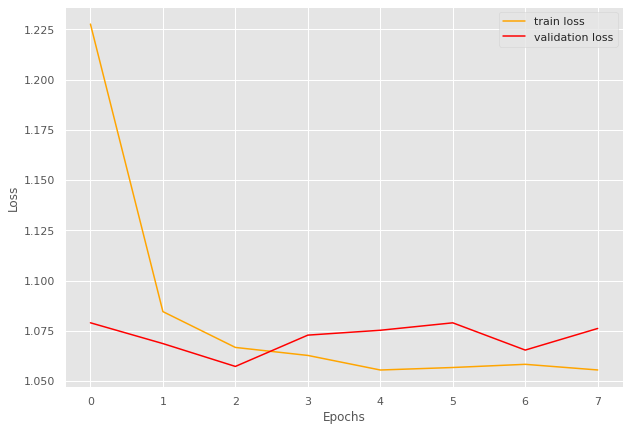

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 2 Epoch 1
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.92batch/s, loss=1.62]


train loss 1.6167288839817047, validation loss 1.5338701180049352, validation accuracy 0.9298850574712644
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 220/220 [01:16<00:00,  2.89batch/s, loss=1.53]


train loss 1.5310004261406984, validation loss 1.5202754735946655, validation accuracy 0.9425287356321839
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.92batch/s, loss=1.51]


INFO: Early stopping counter 1 of 5
train loss 1.5144356267018753, validation loss 1.5253400376864843, validation accuracy 0.9390804597701149
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.92batch/s, loss=1.51]


train loss 1.5100612087683245, validation loss 1.513953106743949, validation accuracy 0.9494252873563218
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 220/220 [01:18<00:00,  2.79batch/s, loss=1.5] 


INFO: Early stopping counter 2 of 5
train loss 1.5033919372341848, validation loss 1.5252716967037745, validation accuracy 0.9344827586206896
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 220/220 [02:38<00:00,  1.39batch/s, loss=1.5]


train loss 1.5013243122534319, validation loss 1.5128508976527624, validation accuracy 0.9471264367816092
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 220/220 [01:33<00:00,  2.35batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.4948677664453334, validation loss 1.5189992444855827, validation accuracy 0.9425287356321839
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.92batch/s, loss=1.5] 


INFO: Early stopping counter 4 of 5
train loss 1.4956277045336637, validation loss 1.5167290483202254, validation accuracy 0.9459770114942528
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 220/220 [01:19<00:00,  2.77batch/s, loss=1.49]


train loss 1.491793202270161, validation loss 1.50172758102417, validation accuracy 0.960919540229885
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.91batch/s, loss=1.49]


train loss 1.4903314834291286, validation loss 1.5013489723205566, validation accuracy 0.9586206896551724
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.92batch/s, loss=1.49]


train loss 1.4875319307500665, validation loss 1.4961721811975752, validation accuracy 0.9655172413793104
Coarse label 2 Epoch 12
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.91batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9529054310672237 and loss 1.5124311929657346


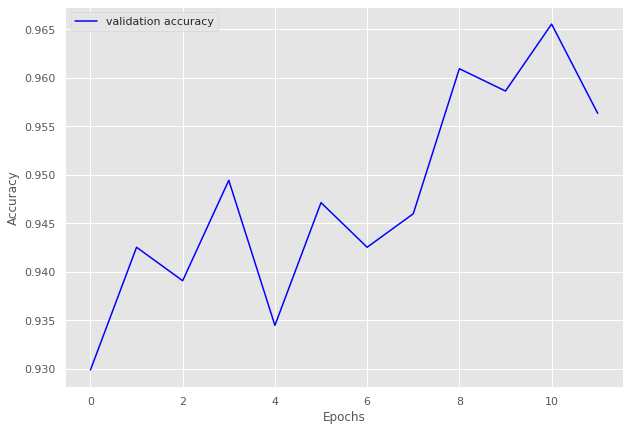

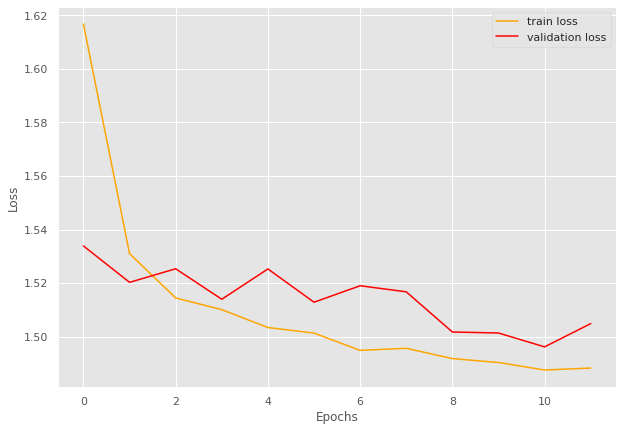

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.95batch/s, loss=1.2]


train loss 1.1977260571259718, validation loss 1.1096874816077096, validation accuracy 0.9320388349514563
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.95batch/s, loss=1.1]


train loss 1.0998946909721081, validation loss 1.1025408846991402, validation accuracy 0.941747572815534
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.95batch/s, loss=1.08]


train loss 1.0821479180684457, validation loss 1.087250028337751, validation accuracy 0.9587378640776699
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.91batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.0768363292400653, validation loss 1.0982487882886613, validation accuracy 0.9441747572815534
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.96batch/s, loss=1.07]


train loss 1.0744152412964747, validation loss 1.0755287919725691, validation accuracy 0.9684466019417476
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.94batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0708333655045583, validation loss 1.088712521961757, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.97batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.069937793108133, validation loss 1.0905741623469762, validation accuracy 0.9514563106796117
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.91batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.0666276938640153, validation loss 1.0872136524745397, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.97batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9630225080385852 and loss 1.0774565398693086


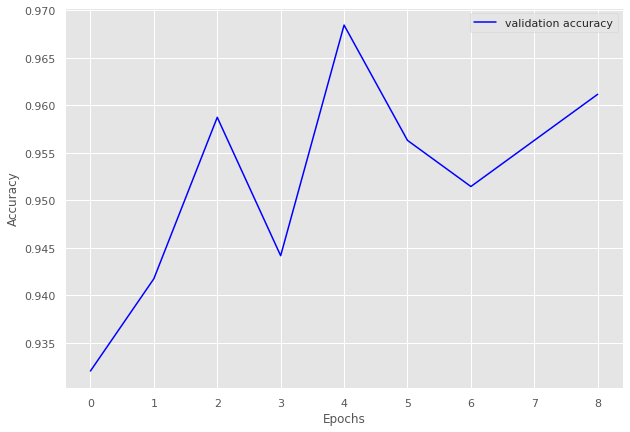

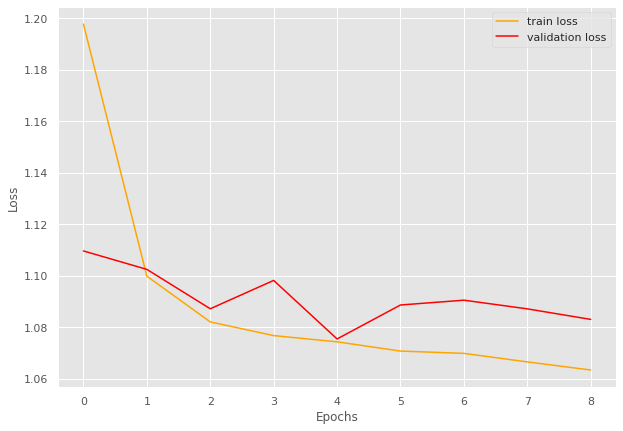

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9630225080385852
Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.95batch/s, loss=0.375]


train loss 0.3753692530095577, validation loss 0.3367448647816976, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.93batch/s, loss=0.332]


train loss 0.3317199558019638, validation loss 0.32394838333129883, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.95batch/s, loss=0.327]


INFO: Early stopping counter 1 of 5
train loss 0.3268926225602627, validation loss 0.3298436502615611, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.91batch/s, loss=0.322]


INFO: Early stopping counter 2 of 5
train loss 0.3217154569923878, validation loss 0.33802807331085205, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.91batch/s, loss=0.323]


train loss 0.32255656346678735, validation loss 0.3195074399312337, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.91batch/s, loss=0.321]


INFO: Early stopping counter 3 of 5
train loss 0.3206307962536812, validation loss 0.32229076822598773, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.94batch/s, loss=0.322]


INFO: Early stopping counter 4 of 5
train loss 0.32172406911849977, validation loss 0.3220694462458293, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.87batch/s, loss=0.316]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9875259875259875 and loss 0.3247543200850487


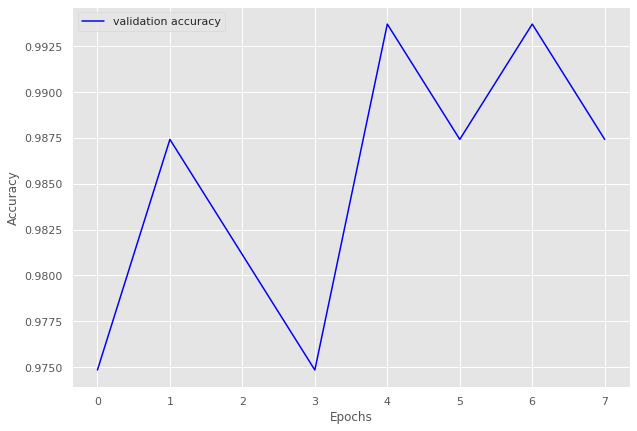

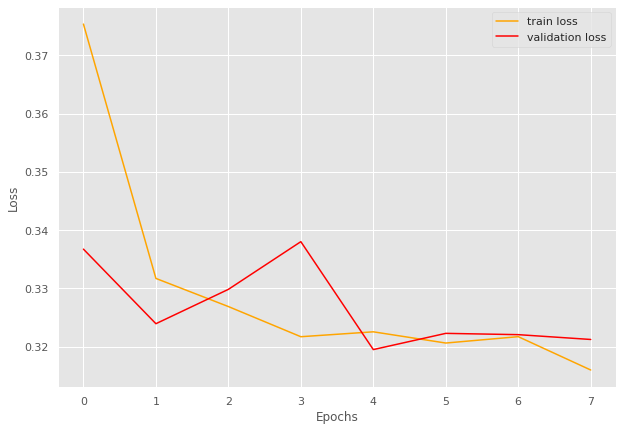

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.31]


train loss 1.3075029391508837, validation loss 1.2296891659498215, validation accuracy 0.9310344827586207
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.96batch/s, loss=1.22]


INFO: Early stopping counter 1 of 5
train loss 1.2212320871842213, validation loss 1.232158288359642, validation accuracy 0.9353448275862069
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.93batch/s, loss=1.21]


train loss 1.211003158846472, validation loss 1.2179015576839447, validation accuracy 0.9439655172413793
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.2]


train loss 1.202738841374715, validation loss 1.2138094156980515, validation accuracy 0.9482758620689655
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 117/117 [00:42<00:00,  2.76batch/s, loss=1.2]


train loss 1.1974058650497696, validation loss 1.2098996192216873, validation accuracy 0.9525862068965517
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 117/117 [00:40<00:00,  2.91batch/s, loss=1.19]


INFO: Early stopping counter 2 of 5
train loss 1.1938671800825331, validation loss 1.2256086766719818, validation accuracy 0.9375
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.2]


INFO: Early stopping counter 3 of 5
train loss 1.198588857283959, validation loss 1.2223365157842636, validation accuracy 0.9375
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.2] 


INFO: Early stopping counter 4 of 5
train loss 1.1951106878427358, validation loss 1.214756041765213, validation accuracy 0.9482758620689655
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.2]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9629893238434164 and loss 1.2030636343089016


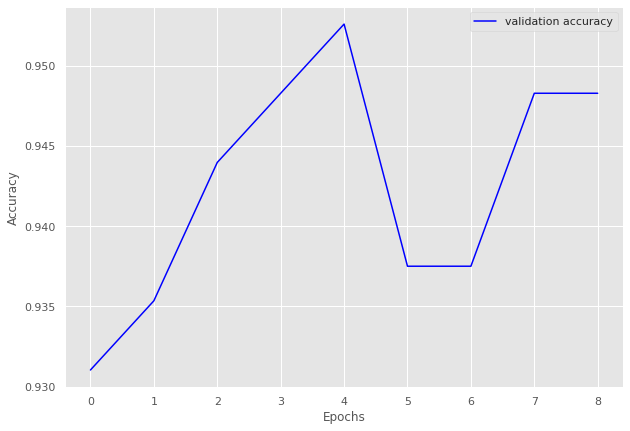

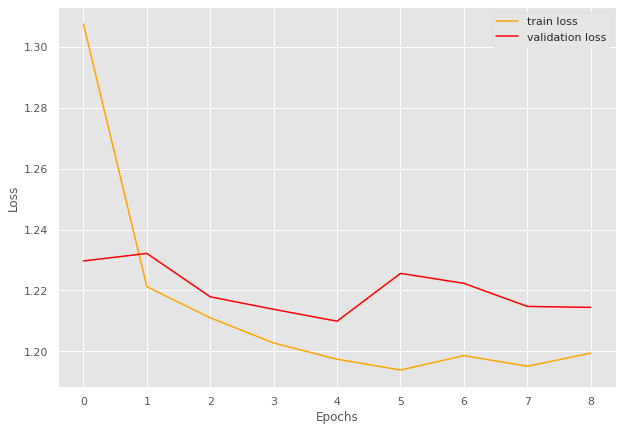

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9629893238434164
Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 92/92 [00:34<00:00,  2.67batch/s, loss=0.826]


train loss 0.826082815942557, validation loss 0.7702325085798899, validation accuracy 0.9724517906336089
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.93batch/s, loss=0.768]


INFO: Early stopping counter 1 of 5
train loss 0.7683272510766983, validation loss 0.7828097740809122, validation accuracy 0.9586776859504132
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.92batch/s, loss=0.769]


INFO: Early stopping counter 2 of 5
train loss 0.7693746906259785, validation loss 0.7784866889317831, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.92batch/s, loss=0.761]


train loss 0.7609565867030103, validation loss 0.7641504009564718, validation accuracy 0.977961432506887
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.90batch/s, loss=0.762]


train loss 0.761647386395413, validation loss 0.7596006393432617, validation accuracy 0.9834710743801653
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.92batch/s, loss=0.758]


INFO: Early stopping counter 3 of 5
train loss 0.7578693647747454, validation loss 0.7654959559440613, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 92/92 [00:32<00:00,  2.85batch/s, loss=0.757]


INFO: Early stopping counter 4 of 5
train loss 0.7566364277964053, validation loss 0.7623387177785238, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 92/92 [00:45<00:00,  2.02batch/s, loss=0.755]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9799635701275046 and loss 0.7679275241163042


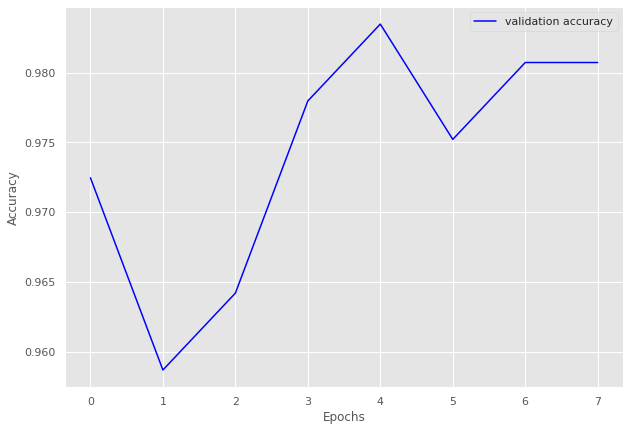

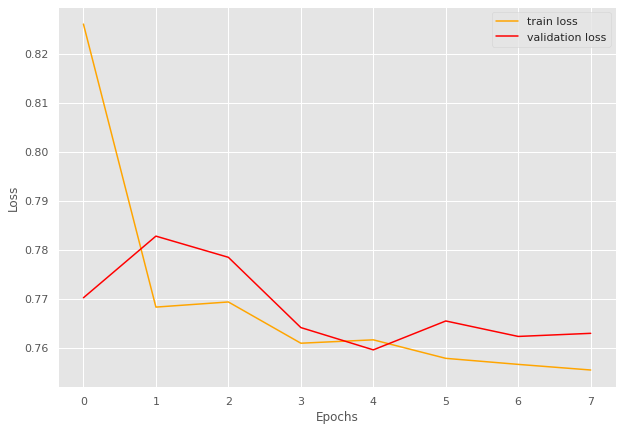

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 129/129 [01:30<00:00,  1.42batch/s, loss=1.33]


train loss 1.3281192474587018, validation loss 1.2262584418058395, validation accuracy 0.9412915851272016
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 129/129 [01:30<00:00,  1.42batch/s, loss=1.23]


train loss 1.2303600302038267, validation loss 1.2212797552347183, validation accuracy 0.9432485322896281
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.90batch/s, loss=1.22]


train loss 1.2168165620907332, validation loss 1.2198769450187683, validation accuracy 0.949119373776908
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.92batch/s, loss=1.21]


INFO: Early stopping counter 1 of 5
train loss 1.2054529005242873, validation loss 1.221957191824913, validation accuracy 0.9432485322896281
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.92batch/s, loss=1.2]


train loss 1.2025885267775187, validation loss 1.2090486884117126, validation accuracy 0.9569471624266145
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.90batch/s, loss=1.2]


INFO: Early stopping counter 2 of 5
train loss 1.1984347622523936, validation loss 1.2108508348464966, validation accuracy 0.9549902152641878
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.91batch/s, loss=1.19]


train loss 1.1949431369470995, validation loss 1.2067835927009583, validation accuracy 0.958904109589041
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.90batch/s, loss=1.19]


train loss 1.1925823993461078, validation loss 1.194814220070839, validation accuracy 0.9726027397260274
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.92batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1912962752719258, validation loss 1.198214814066887, validation accuracy 0.9667318982387475
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.90batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1908811617267223, validation loss 1.197141245007515, validation accuracy 0.9686888454011742
Coarse label 8 Epoch 11
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.92batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9643551523007129 and loss 1.1999406385421754


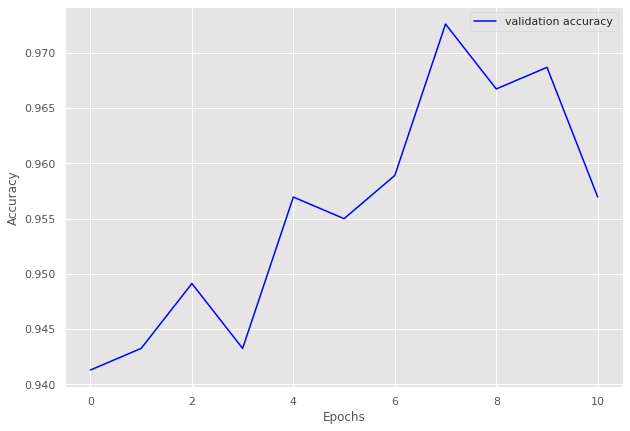

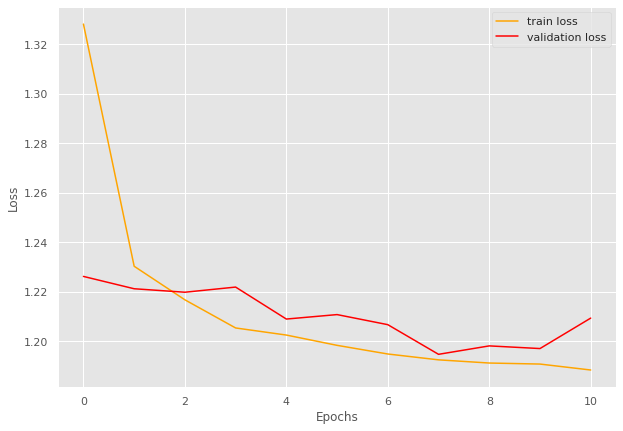

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9643551523007129
Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.90batch/s, loss=1.62]


train loss 1.623996551782807, validation loss 1.5322237014770508, validation accuracy 0.9367283950617284
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 163/163 [00:55<00:00,  2.91batch/s, loss=1.52]


train loss 1.5213383004709256, validation loss 1.5094041390852495, validation accuracy 0.9583333333333334
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.91batch/s, loss=1.51]


train loss 1.506546808166738, validation loss 1.5010848262093284, validation accuracy 0.9598765432098766
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 163/163 [00:59<00:00,  2.74batch/s, loss=1.5]


INFO: Early stopping counter 1 of 5
train loss 1.4982177750464598, validation loss 1.5212262652137063, validation accuracy 0.9521604938271605
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.88batch/s, loss=1.5]


INFO: Early stopping counter 2 of 5
train loss 1.497207096749288, validation loss 1.514081445607272, validation accuracy 0.9537037037037037
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.88batch/s, loss=1.49]


train loss 1.4907767882376362, validation loss 1.500096624547785, validation accuracy 0.9691358024691358
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.89batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.4874589084847574, validation loss 1.506204442544417, validation accuracy 0.9598765432098766
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 163/163 [00:55<00:00,  2.91batch/s, loss=1.49]


train loss 1.4862339503926003, validation loss 1.4919901436025447, validation accuracy 0.9722222222222222
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 163/163 [00:55<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4835030462112895, validation loss 1.5017957037145442, validation accuracy 0.9614197530864198
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.91batch/s, loss=1.48]


train loss 1.48164477450716, validation loss 1.4909737543626265, validation accuracy 0.970679012345679
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.89batch/s, loss=1.48]


train loss 1.4789957824660225, validation loss 1.4868202317844739, validation accuracy 0.9722222222222222
Coarse label 9 Epoch 12
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.89batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9642126789366053 and loss 1.498830872197305


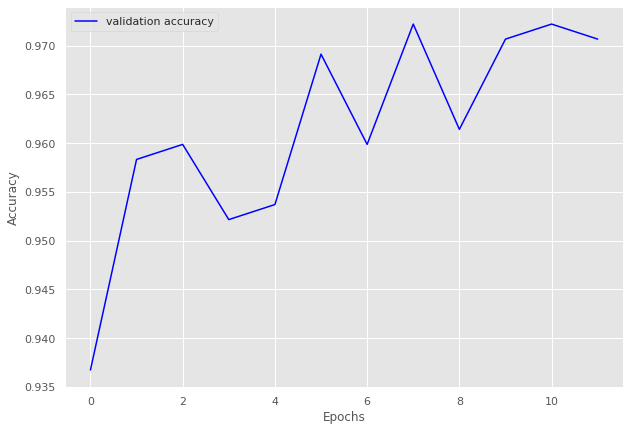

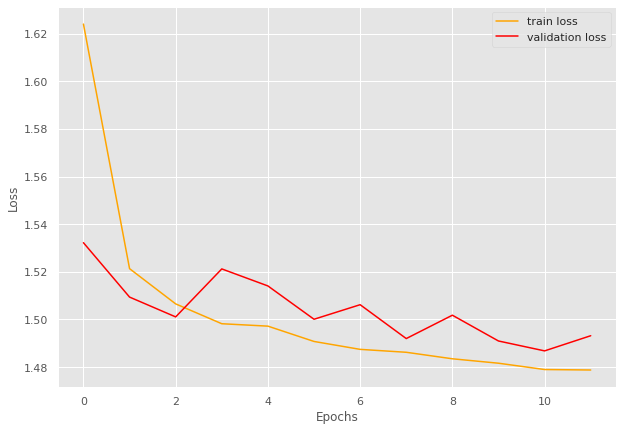

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.95batch/s, loss=0.831]


train loss 0.8312484985822207, validation loss 0.7668524980545044, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.86batch/s, loss=0.763]


train loss 0.7627072535551987, validation loss 0.7612450242042541, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.94batch/s, loss=0.758]


train loss 0.758144827632161, validation loss 0.7605986952781677, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.93batch/s, loss=0.756]


train loss 0.7561337491134544, validation loss 0.75339674949646, validation accuracy 0.993421052631579
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.93batch/s, loss=0.753]


INFO: Early stopping counter 1 of 5
train loss 0.7525077237711324, validation loss 0.7613336205482483, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.90batch/s, loss=0.752]


INFO: Early stopping counter 2 of 5
train loss 0.7524811780297911, validation loss 0.7565465569496155, validation accuracy 0.9868421052631579
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.93batch/s, loss=0.749]


INFO: Early stopping counter 3 of 5
train loss 0.7491354686873299, validation loss 0.7539443969726562, validation accuracy 0.9901315789473685
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.93batch/s, loss=0.748]


train loss 0.7475238783018929, validation loss 0.7523275971412658, validation accuracy 0.993421052631579
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.93batch/s, loss=0.75] 


INFO: Early stopping counter 4 of 5
train loss 0.7498256215801486, validation loss 0.7561556458473205, validation accuracy 0.993421052631579
Coarse label 11 Epoch 10
-------------------------------


100%|██████████| 77/77 [00:38<00:00,  1.98batch/s, loss=0.752]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9750271444082519 and loss 0.766126565138499


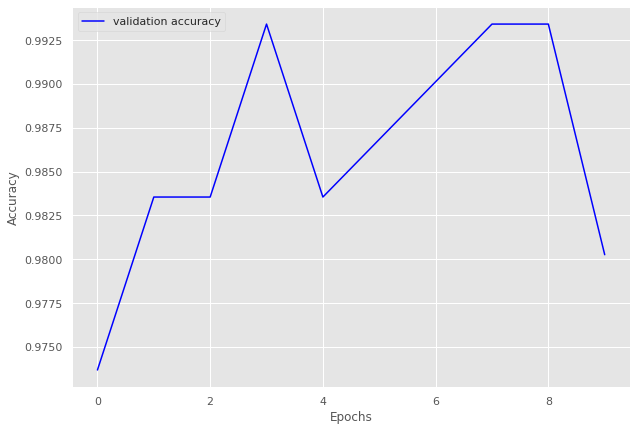

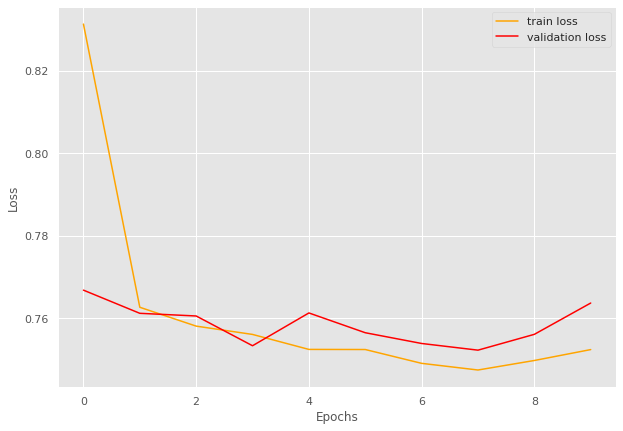

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9750271444082519
Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 74/74 [00:49<00:00,  1.49batch/s, loss=1.24]


train loss 1.238777747025361, validation loss 1.1211451530456542, validation accuracy 0.9172413793103448
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 74/74 [00:54<00:00,  1.36batch/s, loss=1.11]


train loss 1.1111656781789419, validation loss 1.1126119136810302, validation accuracy 0.9275862068965517
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 74/74 [00:58<00:00,  1.28batch/s, loss=1.1] 


train loss 1.0977174929670386, validation loss 1.1115439414978028, validation accuracy 0.9275862068965517
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 74/74 [00:26<00:00,  2.78batch/s, loss=1.09]


train loss 1.0943127645028603, validation loss 1.0996111631393433, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.92batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.0830960692586125, validation loss 1.1080384731292725, validation accuracy 0.9310344827586207
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 74/74 [00:24<00:00,  2.96batch/s, loss=1.09]


INFO: Early stopping counter 2 of 5
train loss 1.0864503947464195, validation loss 1.1013564586639404, validation accuracy 0.9379310344827586
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.96batch/s, loss=1.08]


INFO: Early stopping counter 3 of 5
train loss 1.0824203104586214, validation loss 1.1083451747894286, validation accuracy 0.9310344827586207
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.95batch/s, loss=1.08]


train loss 1.0797541399259825, validation loss 1.0934293746948243, validation accuracy 0.9448275862068966
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.96batch/s, loss=1.08]


INFO: Early stopping counter 4 of 5
train loss 1.081403066983094, validation loss 1.094760489463806, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 74/74 [00:27<00:00,  2.65batch/s, loss=1.08]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9466515323496028 and loss 1.0947422300066267


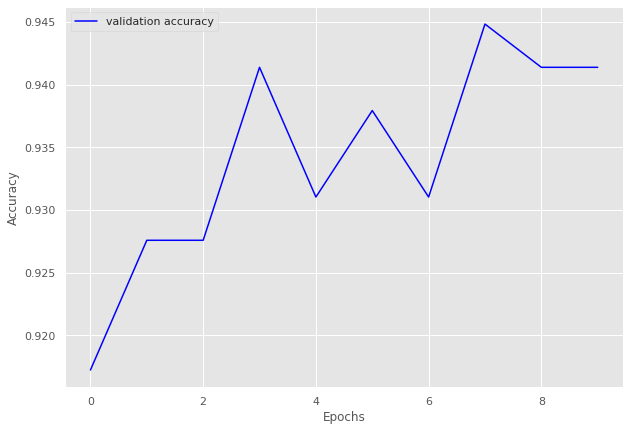

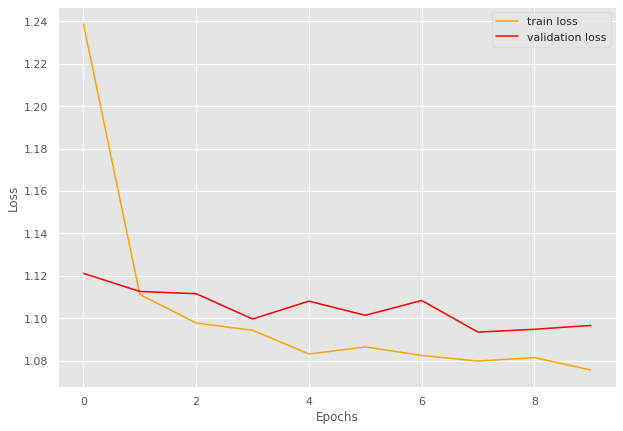

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.93batch/s, loss=0.657]


train loss 0.6565052821086004, validation loss 0.6037858843803405, validation accuracy 0.9382239382239382
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.91batch/s, loss=0.596]


train loss 0.5959724508799039, validation loss 0.5865196347236633, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=0.587]


train loss 0.5867641944151658, validation loss 0.5784266352653503, validation accuracy 0.9691119691119691
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.90batch/s, loss=0.583]


INFO: Early stopping counter 1 of 5
train loss 0.5830467169101422, validation loss 0.5802494525909424, validation accuracy 0.9652509652509652
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=0.58] 


INFO: Early stopping counter 2 of 5
train loss 0.5795143411709712, validation loss 0.5801052451133728, validation accuracy 0.9652509652509652
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.89batch/s, loss=0.572]


train loss 0.572118748151339, validation loss 0.5686425566673279, validation accuracy 0.9768339768339769
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=0.574]


INFO: Early stopping counter 3 of 5
train loss 0.5737110954064589, validation loss 0.5830732703208923, validation accuracy 0.9806949806949807
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=0.571]


INFO: Early stopping counter 4 of 5
train loss 0.571112386079935, validation loss 0.5846481561660767, validation accuracy 0.9691119691119691
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=0.57] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9513444302176697 and loss 0.5995351213675278


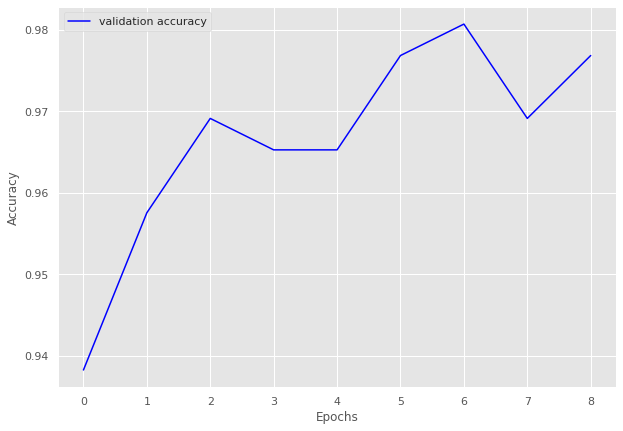

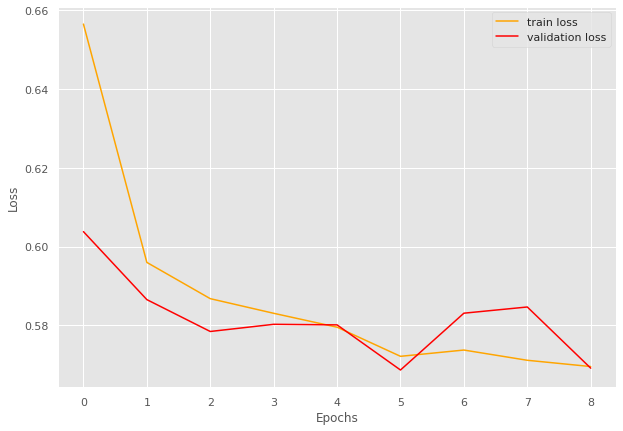

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.93batch/s, loss=1.15]


train loss 1.1463887238502501, validation loss 1.0721848607063293, validation accuracy 0.9696969696969697
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.93batch/s, loss=1.08]


train loss 1.082496507167816, validation loss 1.0702308416366577, validation accuracy 0.9730639730639731
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 150/150 [00:50<00:00,  2.94batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0740563694636027, validation loss 1.0717685580253602, validation accuracy 0.9696969696969697
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.94batch/s, loss=1.07]


train loss 1.0703298783302306, validation loss 1.0699106216430665, validation accuracy 0.9730639730639731
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.94batch/s, loss=1.07]


train loss 1.066956069469452, validation loss 1.0634198546409608, validation accuracy 0.9797979797979798
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 150/150 [00:50<00:00,  2.95batch/s, loss=1.06]


train loss 1.0606693108876546, validation loss 1.0620843410491942, validation accuracy 0.9797979797979798
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 150/150 [00:50<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.059855929215749, validation loss 1.0633418560028076, validation accuracy 0.9814814814814815
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 150/150 [00:52<00:00,  2.88batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0650713968276977, validation loss 1.0637272000312805, validation accuracy 0.9781144781144782
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.92batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.058145984808604, validation loss 1.0631893396377563, validation accuracy 0.9797979797979798
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9815950920245399 and loss 1.0618361152451614


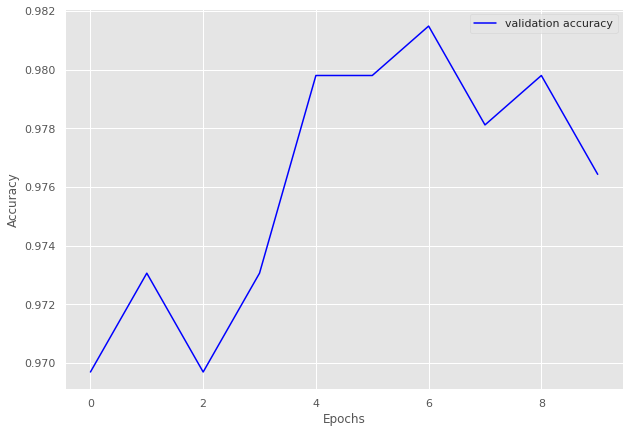

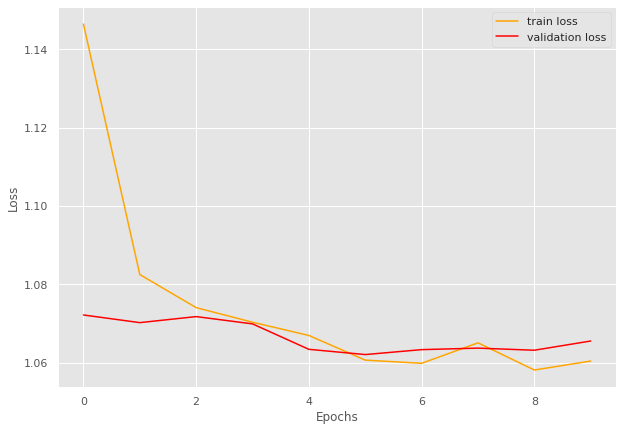

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9815950920245399
Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.95batch/s, loss=0.861]


train loss 0.8605351778301032, validation loss 0.7811813712120056, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.92batch/s, loss=0.775]


train loss 0.7749427935561618, validation loss 0.7707289814949035, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.91batch/s, loss=0.76] 


INFO: Early stopping counter 1 of 5
train loss 0.7599816080686208, validation loss 0.777669632434845, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=0.759]


train loss 0.7590970171464456, validation loss 0.7674731254577637, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=0.756]


train loss 0.7561029163566796, validation loss 0.7628811955451965, validation accuracy 0.9829931972789115
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.95batch/s, loss=0.755]


INFO: Early stopping counter 2 of 5
train loss 0.7548468878140321, validation loss 0.764171814918518, validation accuracy 0.9761904761904762
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=0.756]


train loss 0.7555966683336206, validation loss 0.7623790860176086, validation accuracy 0.9795918367346939
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.94batch/s, loss=0.755]


INFO: Early stopping counter 3 of 5
train loss 0.754738520126085, validation loss 0.7715291261672974, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=0.752]


train loss 0.7521450608163267, validation loss 0.7603675246238708, validation accuracy 0.9829931972789115
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.95batch/s, loss=0.753]


INFO: Early stopping counter 4 of 5
train loss 0.7532051173416344, validation loss 0.7701675891876221, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 11
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=0.751]


train loss 0.7507270147671571, validation loss 0.758694851398468, validation accuracy 0.9829931972789115
Coarse label 15 Epoch 12
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=0.749]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9808126410835214 and loss 0.7624555315290179


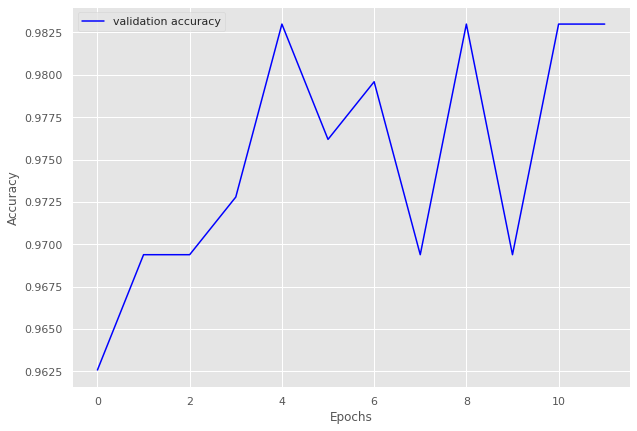

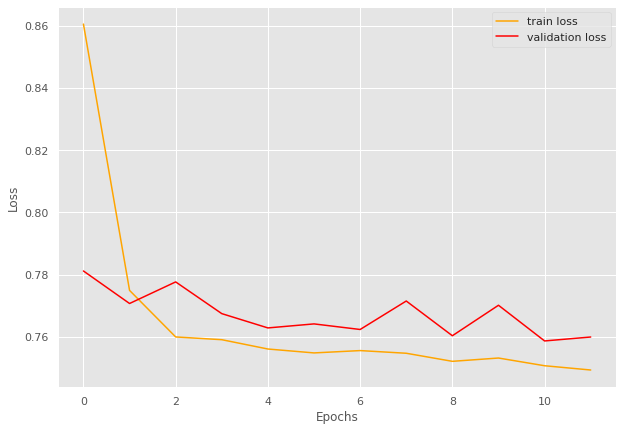

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 71/71 [00:27<00:00,  2.62batch/s, loss=0.641]


train loss 0.6408531447531471, validation loss 0.5904977917671204, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 71/71 [00:26<00:00,  2.69batch/s, loss=0.572]


INFO: Early stopping counter 1 of 5
train loss 0.5715804670898008, validation loss 0.5939648032188416, validation accuracy 0.9609929078014184
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 71/71 [00:23<00:00,  2.96batch/s, loss=0.568]


train loss 0.5679658055305481, validation loss 0.5846489667892456, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.88batch/s, loss=0.57] 


train loss 0.56986828757004, validation loss 0.5627384901046752, validation accuracy 0.9893617021276596
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.96batch/s, loss=0.563]


train loss 0.563029792946829, validation loss 0.559053373336792, validation accuracy 0.9893617021276596
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.93batch/s, loss=0.559]


INFO: Early stopping counter 2 of 5
train loss 0.5589026741578546, validation loss 0.5625677466392517, validation accuracy 0.9858156028368794
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 71/71 [00:23<00:00,  2.96batch/s, loss=0.558]


train loss 0.5581934007120805, validation loss 0.5588383316993714, validation accuracy 0.9929078014184397
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 71/71 [00:31<00:00,  2.25batch/s, loss=0.555]


train loss 0.5554964718684344, validation loss 0.5579892158508301, validation accuracy 0.9893617021276596
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 71/71 [00:43<00:00,  1.64batch/s, loss=0.56] 


INFO: Early stopping counter 3 of 5
train loss 0.5599928070122088, validation loss 0.5627132892608643, validation accuracy 0.9893617021276596
Coarse label 16 Epoch 10
-------------------------------


100%|██████████| 71/71 [00:53<00:00,  1.33batch/s, loss=0.559]


INFO: Early stopping counter 4 of 5
train loss 0.5590952853081932, validation loss 0.5795171976089477, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 11
-------------------------------


100%|██████████| 71/71 [00:56<00:00,  1.27batch/s, loss=0.558]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9847058823529412 and loss 0.5671060383319855


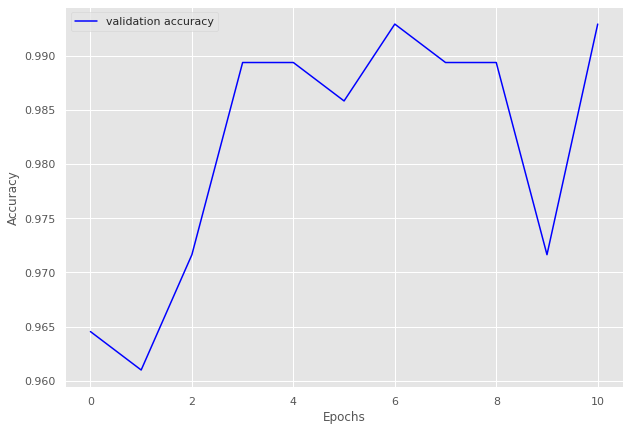

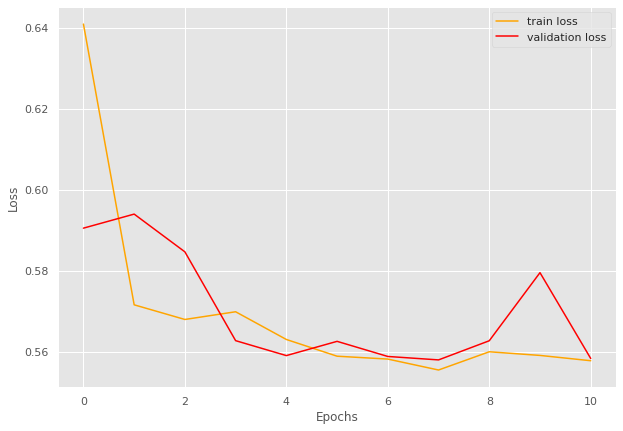

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 17 Epoch 1
-------------------------------


100%|██████████| 78/78 [00:39<00:00,  1.97batch/s, loss=0.894]


train loss 0.8944807388843634, validation loss 0.8036682486534119, validation accuracy 0.9449838187702265
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.90batch/s, loss=0.792]


train loss 0.7919805699434036, validation loss 0.7749882817268372, validation accuracy 0.9741100323624595
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 78/78 [00:27<00:00,  2.88batch/s, loss=0.776]


INFO: Early stopping counter 1 of 5
train loss 0.7756761067952865, validation loss 0.7761711597442627, validation accuracy 0.9644012944983819
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.92batch/s, loss=0.772]


INFO: Early stopping counter 2 of 5
train loss 0.7723240600182459, validation loss 0.7803505420684814, validation accuracy 0.9644012944983819
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.94batch/s, loss=0.771]


INFO: Early stopping counter 3 of 5
train loss 0.7706204492312211, validation loss 0.7783226251602173, validation accuracy 0.9644012944983819
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 78/78 [00:27<00:00,  2.88batch/s, loss=0.765]


INFO: Early stopping counter 4 of 5
train loss 0.7654229249709692, validation loss 0.7767112016677856, validation accuracy 0.9676375404530745
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.94batch/s, loss=0.763]


train loss 0.7630786437254685, validation loss 0.7695245504379272, validation accuracy 0.9773462783171522
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.91batch/s, loss=0.762]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9742489270386266 and loss 0.7705914378166199


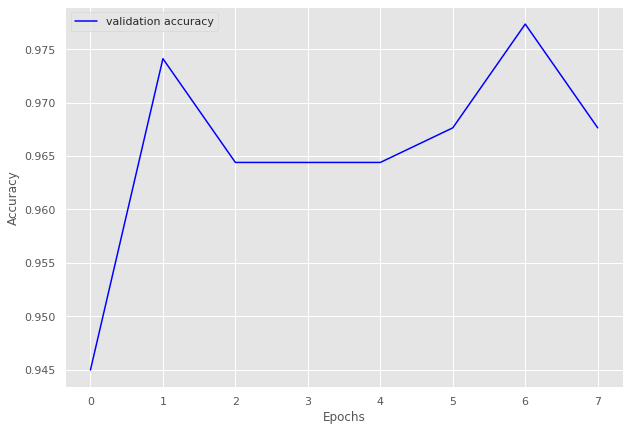

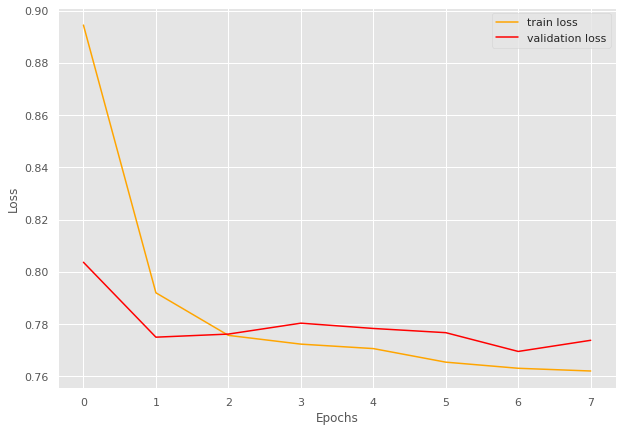

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 19 Epoch 1
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.00batch/s, loss=0.982]


train loss 0.981748309135437, validation loss 0.7922191619873047, validation accuracy 0.9375
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.96batch/s, loss=0.778]


train loss 0.7780107498168946, validation loss 0.7672856748104095, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.96batch/s, loss=0.759]


INFO: Early stopping counter 1 of 5
train loss 0.7592593216896057, validation loss 0.776946485042572, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.93batch/s, loss=0.753]


INFO: Early stopping counter 2 of 5
train loss 0.7528867149353027, validation loss 0.7692237794399261, validation accuracy 0.96875
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.02batch/s, loss=0.757]


train loss 0.7574762415885925, validation loss 0.7580618858337402, validation accuracy 0.9895833333333334
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.99batch/s, loss=0.754]


train loss 0.753745231628418, validation loss 0.757117748260498, validation accuracy 0.9895833333333334
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.95batch/s, loss=0.754]


INFO: Early stopping counter 3 of 5
train loss 0.7537722492218017, validation loss 0.7572848200798035, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.01batch/s, loss=0.758]


INFO: Early stopping counter 4 of 5
train loss 0.7579980778694153, validation loss 0.7685102224349976, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.00batch/s, loss=0.755]


train loss 0.7545702219009399, validation loss 0.7523658573627472, validation accuracy 0.9895833333333334
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.00batch/s, loss=0.757]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9662162162162162 and loss 0.7763351440429688


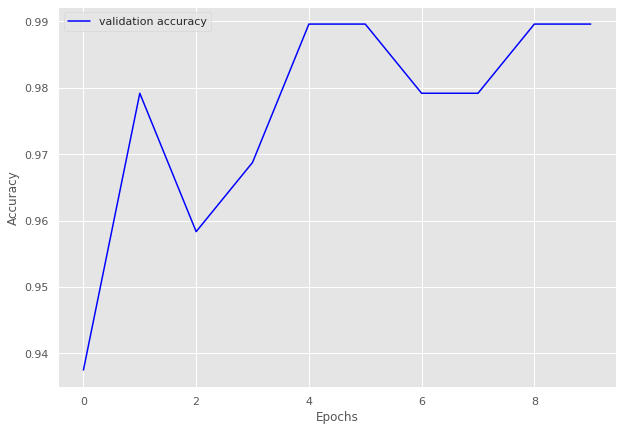

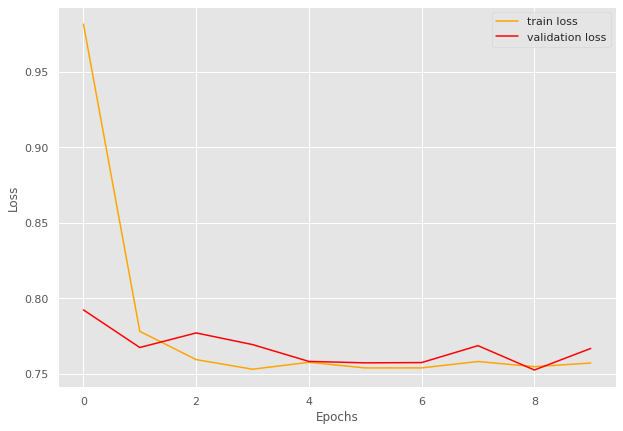

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Evaluating fine model 0
Evaluating fine model 1
Evaluating fine model 2
Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16
Evaluating fine model 17
Evaluating fine model 19
overall accuracy  is 0.8261342295146783
{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.93423053527980

Starting run 4
defaultdict(<class 'list'>, {10: [0], 15: [1, 38, 54, 62], 12: [2, 7, 12, 45, 49, 91], 17: [3, 25, 66, 83], 5: [4, 77], 8: [5, 60, 70, 73, 75, 78, 82], 1: [6, 53, 56, 58, 79, 80], 11: [8, 31, 51, 61], 0: [9, 17, 26, 55, 69], 7: [10, 23, 39, 67], 9: [11, 18, 34, 46, 57, 63, 68, 76, 92, 93], 2: [13, 19, 20, 36, 41, 42, 47, 48, 71, 88], 6: [14, 15, 22, 32, 35, 43, 52], 4: [16, 21, 24, 30, 64, 72], 13: [27, 29, 81], 14: [28, 33, 37, 44, 89, 90], 16: [40, 59, 87], 18: [50], 19: [65, 74, 84, 85], 3: [86]})
Calculating for volume 15
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.92batch/s, loss=1.36]


train loss 1.3626690081187658, validation loss 1.1105521065848214, validation accuracy 0.8648018648018648
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.03batch/s, loss=0.999]


train loss 0.9990962999207633, validation loss 1.008552610874176, validation accuracy 0.9044289044289044
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.03batch/s, loss=0.949]


train loss 0.9488774750913892, validation loss 0.9954702513558524, validation accuracy 0.9114219114219114
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.02batch/s, loss=0.927]


train loss 0.927371974502291, validation loss 0.9947085210255214, validation accuracy 0.9137529137529138
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.03batch/s, loss=0.919]


train loss 0.9189960956573486, validation loss 0.9877645799091884, validation accuracy 0.9184149184149184
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.04batch/s, loss=0.916]


INFO: Early stopping counter 1 of 5
train loss 0.9162285498210362, validation loss 0.99699319260461, validation accuracy 0.9067599067599068
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.03batch/s, loss=0.918]


INFO: Early stopping counter 2 of 5
train loss 0.9177705901009696, validation loss 0.989162972995213, validation accuracy 0.9184149184149184
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.03batch/s, loss=0.913]


INFO: Early stopping counter 3 of 5
train loss 0.9132305213383266, validation loss 0.99028251852308, validation accuracy 0.916083916083916
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.01batch/s, loss=0.913]


train loss 0.9131014517375401, validation loss 0.980045463357653, validation accuracy 0.9277389277389277
Coarse label 0 Epoch 10
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.02batch/s, loss=0.913]


INFO: Early stopping counter 4 of 5
train loss 0.9129482933453151, validation loss 0.9819510579109192, validation accuracy 0.9254079254079254
Coarse label 0 Epoch 11
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.03batch/s, loss=0.912]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9267927609198531 and loss 0.9804235012634941


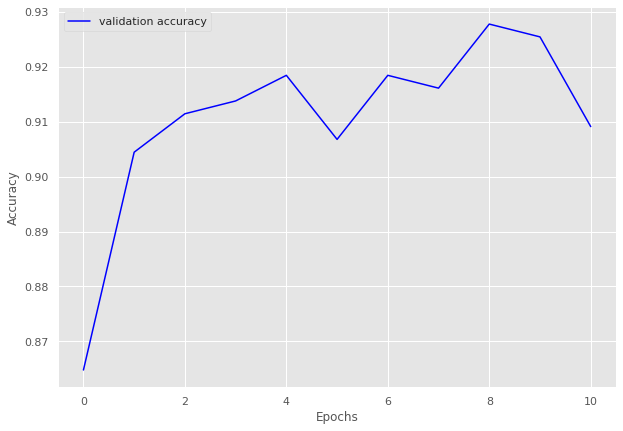

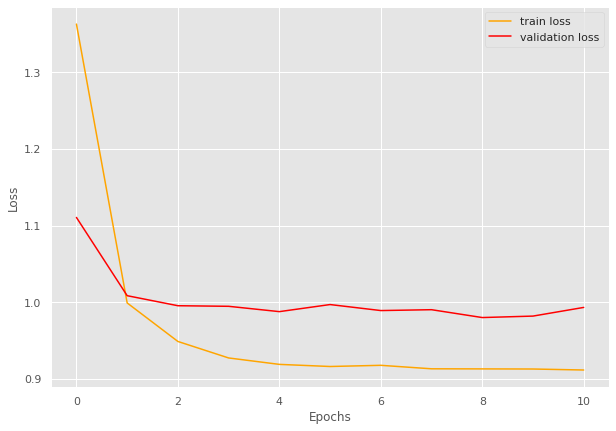

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 1 Epoch 1
-------------------------------


100%|██████████| 6/6 [00:01<00:00,  3.01batch/s, loss=1.63]


train loss 1.631493349870046, validation loss 1.435247778892517, validation accuracy 0.7849462365591398
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.98batch/s, loss=1.24]


train loss 1.2415197889010112, validation loss 1.2027821938196819, validation accuracy 0.8817204301075269
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.11]


train loss 1.107279618581136, validation loss 1.1509538888931274, validation accuracy 0.9032258064516129
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.96batch/s, loss=1.06]


train loss 1.0566715598106384, validation loss 1.1298660039901733, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 6/6 [00:01<00:00,  3.01batch/s, loss=1.05]


train loss 1.0485678911209106, validation loss 1.1227503617604573, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 6/6 [00:01<00:00,  3.01batch/s, loss=1.05]


train loss 1.04729425907135, validation loss 1.1216050386428833, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.72batch/s, loss=1.05]


train loss 1.0457720756530762, validation loss 1.1133458216985066, validation accuracy 0.946236559139785
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.04]


train loss 1.044692059357961, validation loss 1.1114118099212646, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.04]


train loss 1.044279436270396, validation loss 1.1097962458928425, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.82batch/s, loss=1.04]


train loss 1.044545849164327, validation loss 1.1095997889836628, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  3.00batch/s, loss=1.04]


train loss 1.0440869331359863, validation loss 1.1086317698160808, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 12
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.04]


train loss 1.0440582831700642, validation loss 1.1083396275838215, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 13
-------------------------------


100%|██████████| 6/6 [00:03<00:00,  1.82batch/s, loss=1.04]


train loss 1.0439364512761433, validation loss 1.1081373691558838, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 14
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.45batch/s, loss=1.04]


INFO: Early stopping counter 1 of 5
train loss 1.043899933497111, validation loss 1.1088233788808186, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 15
-------------------------------


100%|██████████| 6/6 [00:01<00:00,  3.00batch/s, loss=1.04]


INFO: Early stopping counter 2 of 5
train loss 1.0446842908859253, validation loss 1.1102547645568848, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 16
-------------------------------


100%|██████████| 6/6 [00:03<00:00,  1.79batch/s, loss=1.04]


INFO: Early stopping counter 3 of 5
train loss 1.0440954566001892, validation loss 1.1119485298792522, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 17
-------------------------------


100%|██████████| 6/6 [00:06<00:00,  1.05s/batch, loss=1.04]


INFO: Early stopping counter 4 of 5
train loss 1.0441709756851196, validation loss 1.113311727841695, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 18
-------------------------------


100%|██████████| 6/6 [00:03<00:00,  1.60batch/s, loss=1.04]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9249765551734918 and loss 1.1214001774787903


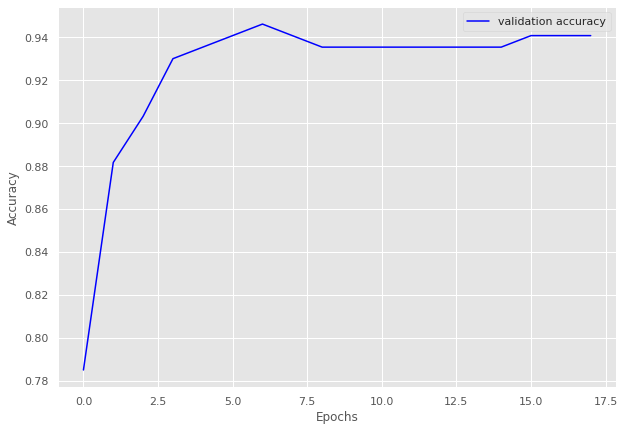

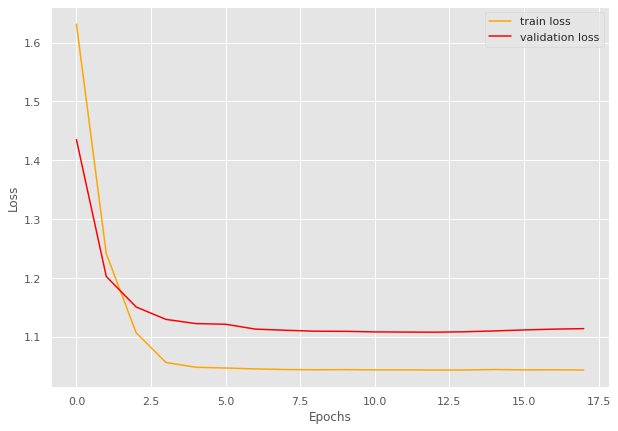

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 2 Epoch 1
-------------------------------


100%|██████████| 28/28 [00:18<00:00,  1.55batch/s, loss=1.95]


train loss 1.949354989188058, validation loss 1.7620924711227417, validation accuracy 0.7264367816091954
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:19<00:00,  1.42batch/s, loss=1.65]


train loss 1.6481085334505354, validation loss 1.6401327678135462, validation accuracy 0.8540229885057471
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:23<00:00,  1.21batch/s, loss=1.55]


train loss 1.5487750342914037, validation loss 1.5907297815595354, validation accuracy 0.8862068965517241
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:19<00:00,  1.45batch/s, loss=1.52]


train loss 1.5224295173372542, validation loss 1.5731499620846339, validation accuracy 0.8977011494252873
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:20<00:00,  1.34batch/s, loss=1.51]


train loss 1.5050154285771506, validation loss 1.5660610028675623, validation accuracy 0.9080459770114943
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:24<00:00,  1.17batch/s, loss=1.5] 


INFO: Early stopping counter 1 of 5
train loss 1.5007163669381822, validation loss 1.5661657452583313, validation accuracy 0.9011494252873563
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:16<00:00,  1.65batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4871653148106165, validation loss 1.5735074962888445, validation accuracy 0.8977011494252873
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:10<00:00,  2.78batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4844122188431876, validation loss 1.5679584997040885, validation accuracy 0.8954022988505748
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.48]


train loss 1.4835259488650732, validation loss 1.5598689232553755, validation accuracy 0.9045977011494253
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.92batch/s, loss=1.48]


train loss 1.4782567279679435, validation loss 1.5510050058364868, validation accuracy 0.9172413793103448
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4752353600093298, validation loss 1.5744873540742057, validation accuracy 0.8862068965517241
Coarse label 2 Epoch 12
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9117193264909104 and loss 1.5534985372436916


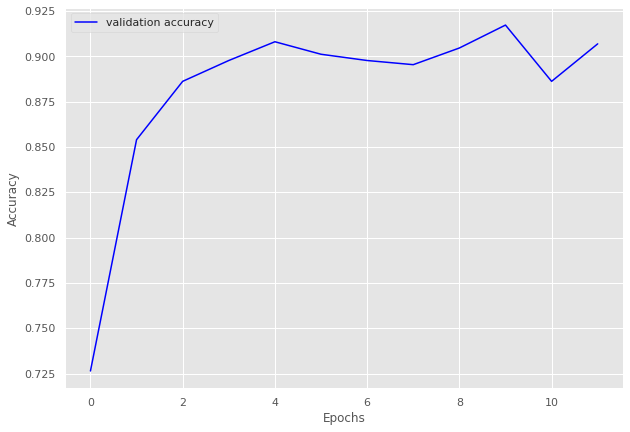

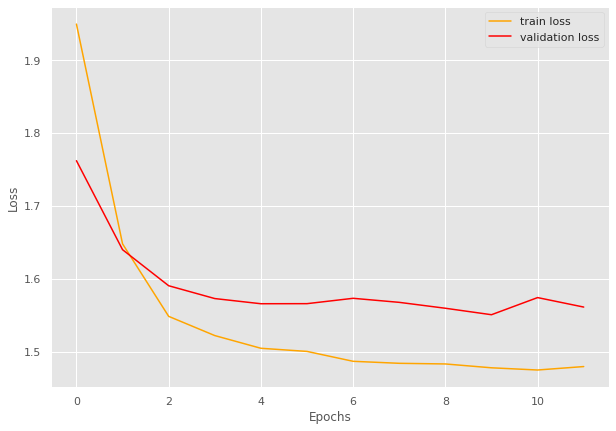

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.92batch/s, loss=1.52]


train loss 1.5151387544778676, validation loss 1.3939672027315413, validation accuracy 0.7160194174757282
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.84batch/s, loss=1.22]


train loss 1.2150697341332068, validation loss 1.2460917575018746, validation accuracy 0.8179611650485437
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.96batch/s, loss=1.12]


train loss 1.122255829664377, validation loss 1.1585676670074463, validation accuracy 0.8907766990291263
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.96batch/s, loss=1.08]


train loss 1.07705492239732, validation loss 1.1428619452885218, validation accuracy 0.9053398058252428
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.64batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0629040736418505, validation loss 1.148784841809954, validation accuracy 0.9004854368932039
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.97batch/s, loss=1.06]


train loss 1.0626875804020808, validation loss 1.1378138065338135, validation accuracy 0.9053398058252428
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 13/13 [00:06<00:00,  2.13batch/s, loss=1.05]


train loss 1.053140374330374, validation loss 1.1321496622903007, validation accuracy 0.9174757281553398
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 13/13 [00:06<00:00,  2.03batch/s, loss=1.05]


train loss 1.0511065904910748, validation loss 1.1321487256458826, validation accuracy 0.912621359223301
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 13/13 [00:06<00:00,  2.06batch/s, loss=1.05]


train loss 1.0540963411331177, validation loss 1.1304531608309065, validation accuracy 0.9150485436893204
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.92batch/s, loss=1.05]


train loss 1.0494602551827064, validation loss 1.1286735023771013, validation accuracy 0.9150485436893204
Coarse label 4 Epoch 11
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.96batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.0490291026922374, validation loss 1.1327591623578752, validation accuracy 0.9101941747572816
Coarse label 4 Epoch 12
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.90batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0545183420181274, validation loss 1.1415689161845617, validation accuracy 0.9029126213592233
Coarse label 4 Epoch 13
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.94batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.05257065479572, validation loss 1.1458949531827654, validation accuracy 0.9004854368932039
Coarse label 4 Epoch 14
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.95batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.8995167708925526 and loss 1.1468597943132575


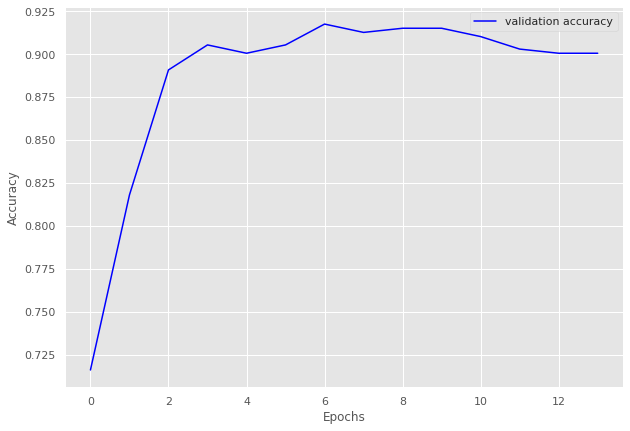

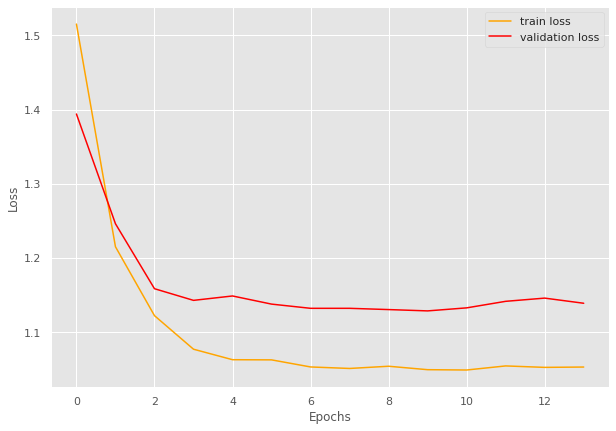

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.92batch/s, loss=0.553]


train loss 0.5531575858592988, validation loss 0.4359648823738098, validation accuracy 0.9433962264150944
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 5/5 [00:02<00:00,  2.24batch/s, loss=0.371]


train loss 0.3706652045249939, validation loss 0.35579447944959003, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.92batch/s, loss=0.327]


train loss 0.32683010697364806, validation loss 0.3411383132139842, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.91batch/s, loss=0.321]


train loss 0.32143024206161497, validation loss 0.3362040122350057, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.72batch/s, loss=0.317]


train loss 0.31715253591537473, validation loss 0.3342864215373993, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.90batch/s, loss=0.317]


INFO: Early stopping counter 1 of 5
train loss 0.3174567222595215, validation loss 0.33481260140736896, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.94batch/s, loss=0.317]


INFO: Early stopping counter 2 of 5
train loss 0.31667845845222475, validation loss 0.33474619189898175, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.89batch/s, loss=0.315]


INFO: Early stopping counter 3 of 5
train loss 0.314890992641449, validation loss 0.34244734048843384, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.77batch/s, loss=0.314]


INFO: Early stopping counter 4 of 5
train loss 0.3144560635089874, validation loss 0.33743995428085327, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 10
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.88batch/s, loss=0.313]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9734904270986745 and loss 0.34131416193274566


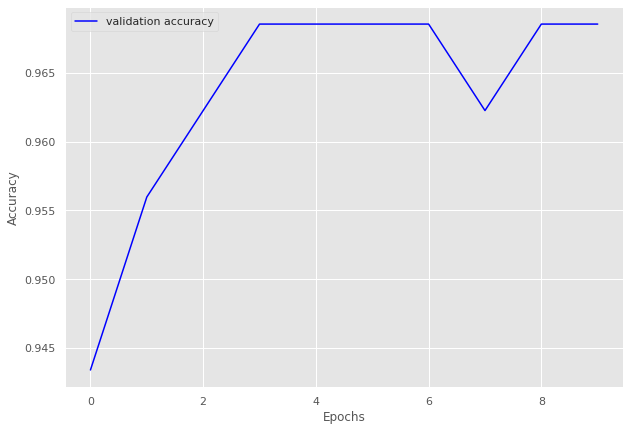

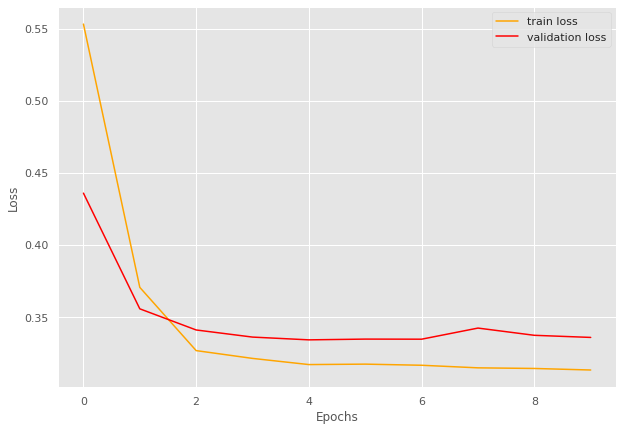

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.96batch/s, loss=1.64]


train loss 1.6378791650136313, validation loss 1.4018220901489258, validation accuracy 0.7801724137931034
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.01batch/s, loss=1.31]


train loss 1.306106170018514, validation loss 1.2778752595186234, validation accuracy 0.8900862068965517
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.93batch/s, loss=1.22]


train loss 1.2196562846501668, validation loss 1.2689040303230286, validation accuracy 0.9116379310344828
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.98batch/s, loss=1.2] 


train loss 1.204663880666097, validation loss 1.2642928212881088, validation accuracy 0.9137931034482759
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.02batch/s, loss=1.19]


INFO: Early stopping counter 1 of 5
train loss 1.1867509841918946, validation loss 1.2693423628807068, validation accuracy 0.9094827586206896
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.96batch/s, loss=1.19]


train loss 1.1886986414591472, validation loss 1.2543612718582153, validation accuracy 0.9224137931034483
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.93batch/s, loss=1.18]


INFO: Early stopping counter 2 of 5
train loss 1.1837450027465821, validation loss 1.2577667534351349, validation accuracy 0.9181034482758621
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.98batch/s, loss=1.18]


INFO: Early stopping counter 3 of 5
train loss 1.1765865564346314, validation loss 1.255573347210884, validation accuracy 0.9181034482758621
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.01batch/s, loss=1.19]


train loss 1.1865541696548463, validation loss 1.25417959690094, validation accuracy 0.9202586206896551
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.94batch/s, loss=1.18]


INFO: Early stopping counter 4 of 5
train loss 1.1821150064468384, validation loss 1.2541903406381607, validation accuracy 0.9224137931034483
Coarse label 6 Epoch 11
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.99batch/s, loss=1.18]


train loss 1.1810619274775187, validation loss 1.2469412237405777, validation accuracy 0.9331896551724138
Coarse label 6 Epoch 12
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.95batch/s, loss=1.18]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9075333837238599 and loss 1.2586137857437134


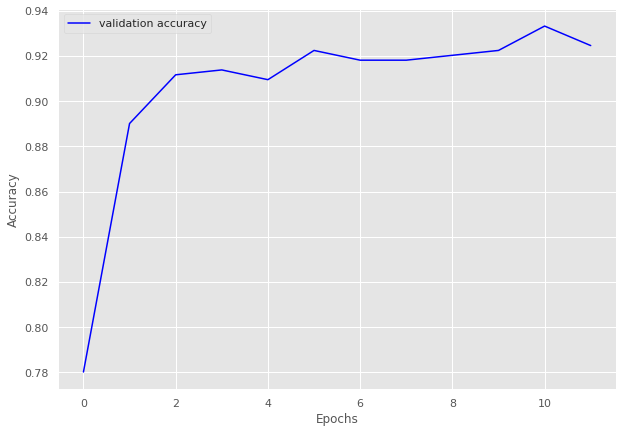

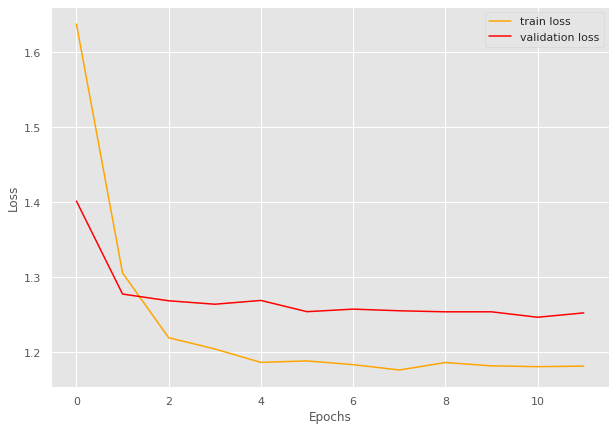

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.08batch/s, loss=1.06]


train loss 1.0569875886042912, validation loss 0.8374055425326029, validation accuracy 0.9173553719008265
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.06batch/s, loss=0.78]


train loss 0.7800944000482559, validation loss 0.7834587097167969, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.06batch/s, loss=0.755]


train loss 0.7553521394729614, validation loss 0.7820086280504862, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.04batch/s, loss=0.754]


INFO: Early stopping counter 1 of 5
train loss 0.754251961906751, validation loss 0.7848065793514252, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.01batch/s, loss=0.752]


INFO: Early stopping counter 2 of 5
train loss 0.7520023286342621, validation loss 0.7887771228949229, validation accuracy 0.9559228650137741
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.07batch/s, loss=0.752]


INFO: Early stopping counter 3 of 5
train loss 0.7519245892763138, validation loss 0.787271241346995, validation accuracy 0.9586776859504132
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.08batch/s, loss=0.749]


INFO: Early stopping counter 4 of 5
train loss 0.7485178709030151, validation loss 0.7886231342951456, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.05batch/s, loss=0.747]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.961068211068211 and loss 0.7837910098688943


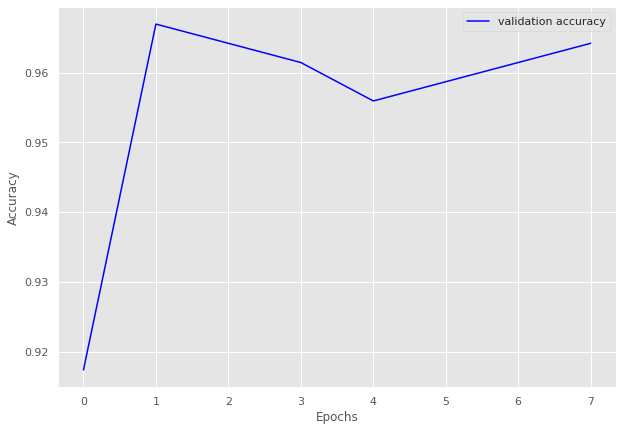

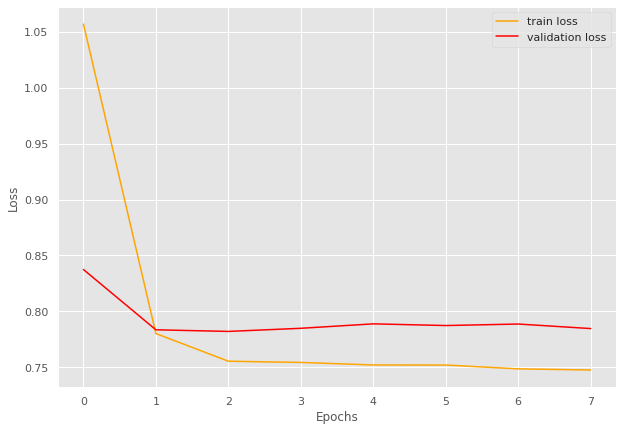

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.10batch/s, loss=1.7] 


train loss 1.7036978777717142, validation loss 1.4490477293729782, validation accuracy 0.7514677103718199
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  2.99batch/s, loss=1.35]


train loss 1.347982126123765, validation loss 1.3093513995409012, validation accuracy 0.8649706457925636
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  2.98batch/s, loss=1.26]


train loss 1.2623884888256298, validation loss 1.2980504781007767, validation accuracy 0.8767123287671232
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=1.24]


train loss 1.2373586612589218, validation loss 1.294097051024437, validation accuracy 0.87279843444227
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.06batch/s, loss=1.23]


train loss 1.2316656323040234, validation loss 1.2850300073623657, validation accuracy 0.8884540117416829
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.08batch/s, loss=1.22]


INFO: Early stopping counter 1 of 5
train loss 1.219432599404279, validation loss 1.2992334067821503, validation accuracy 0.8708414872798435
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.02batch/s, loss=1.22]


INFO: Early stopping counter 2 of 5
train loss 1.2201099535998177, validation loss 1.2886393815279007, validation accuracy 0.8825831702544031
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=1.22]


INFO: Early stopping counter 3 of 5
train loss 1.216387755730573, validation loss 1.2863554060459137, validation accuracy 0.8845401174168297
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.10batch/s, loss=1.21]


INFO: Early stopping counter 4 of 5
train loss 1.2110580346163582, validation loss 1.2875647991895676, validation accuracy 0.8767123287671232
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.09batch/s, loss=1.22]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.8952130096197893 and loss 1.2749674990229363


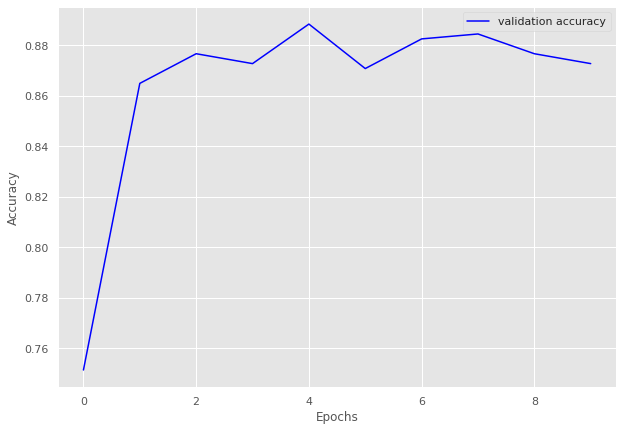

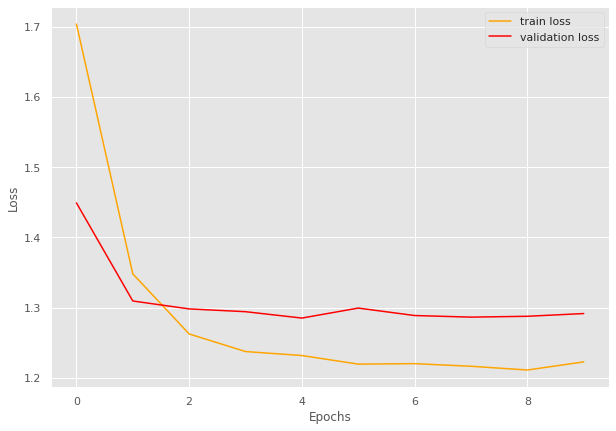

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.95batch/s, loss=1.91]


train loss 1.908064671925136, validation loss 1.7401948191902854, validation accuracy 0.7700617283950617
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.99batch/s, loss=1.63]


train loss 1.6338733321144467, validation loss 1.654910835352811, validation accuracy 0.8549382716049383
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.92batch/s, loss=1.54]


train loss 1.5432481992812384, validation loss 1.5909721417860552, validation accuracy 0.8981481481481481
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.96batch/s, loss=1.51]


train loss 1.5143212307067144, validation loss 1.5633214712142944, validation accuracy 0.9182098765432098
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.94batch/s, loss=1.5]


train loss 1.4980809007372176, validation loss 1.559566161849282, validation accuracy 0.9259259259259259
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.94batch/s, loss=1.5] 


INFO: Early stopping counter 1 of 5
train loss 1.496067756698245, validation loss 1.576548847285184, validation accuracy 0.9166666666666666
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.96batch/s, loss=1.48]


INFO: Early stopping counter 2 of 5
train loss 1.4840180760338193, validation loss 1.5712366862730547, validation accuracy 0.9182098765432098
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.98batch/s, loss=1.48]


train loss 1.4779298135212489, validation loss 1.5539670098911633, validation accuracy 0.9243827160493827
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  3.00batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4797649667376565, validation loss 1.5550965395840732, validation accuracy 0.9228395061728395
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.99batch/s, loss=1.47]


INFO: Early stopping counter 4 of 5
train loss 1.4740137940361386, validation loss 1.5614932342009111, validation accuracy 0.9197530864197531
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 21/21 [00:06<00:00,  3.01batch/s, loss=1.48]


train loss 1.4752403497695923, validation loss 1.553821086883545, validation accuracy 0.9212962962962963
Coarse label 9 Epoch 12
-------------------------------


100%|██████████| 21/21 [00:06<00:00,  3.02batch/s, loss=1.48]


train loss 1.480418318793887, validation loss 1.5424066456881436, validation accuracy 0.9151234567901234
Coarse label 9 Epoch 13
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.98batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9143451519536903 and loss 1.550778847209291


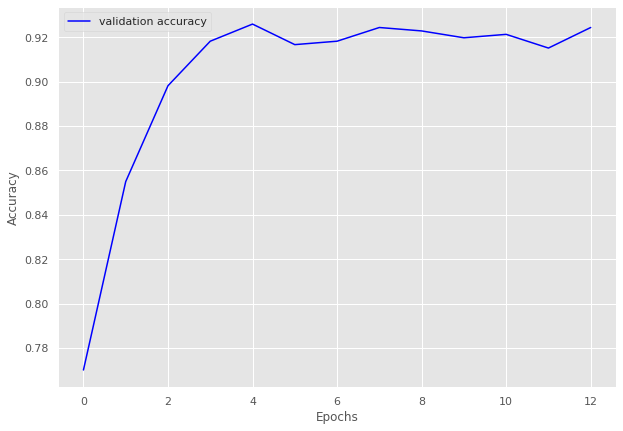

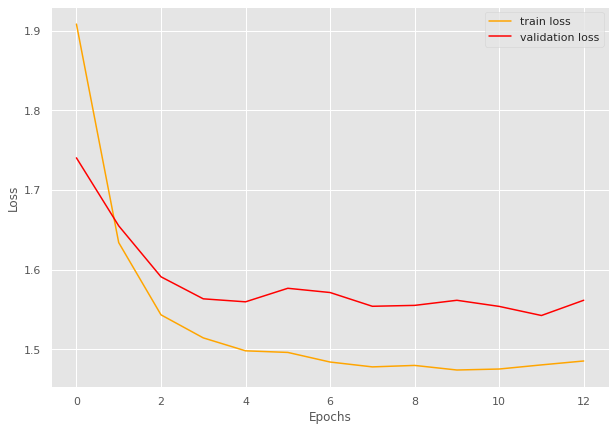

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.06batch/s, loss=1.09]


train loss 1.087593638896942, validation loss 0.8731548428535462, validation accuracy 0.9078947368421053
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.97batch/s, loss=0.81]


train loss 0.8098914384841919, validation loss 0.811643373966217, validation accuracy 0.930921052631579
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.759]


train loss 0.759190458059311, validation loss 0.8063866257667541, validation accuracy 0.9375
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.00batch/s, loss=0.753]


train loss 0.7528045535087585, validation loss 0.7982521176338195, validation accuracy 0.9473684210526315
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.01batch/s, loss=0.749]


train loss 0.7487015545368194, validation loss 0.7905344128608703, validation accuracy 0.9506578947368421
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.06batch/s, loss=0.747]


train loss 0.7470244348049164, validation loss 0.7900311470031738, validation accuracy 0.9539473684210527
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.06batch/s, loss=0.745]


INFO: Early stopping counter 1 of 5
train loss 0.7445757329463959, validation loss 0.7910007357597351, validation accuracy 0.9506578947368421
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=0.746]


INFO: Early stopping counter 2 of 5
train loss 0.7455080330371857, validation loss 0.7905582785606384, validation accuracy 0.9572368421052632
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.745]


train loss 0.7448369562625885, validation loss 0.7884735584259033, validation accuracy 0.9572368421052632
Coarse label 11 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.98batch/s, loss=0.744]


train loss 0.7442838609218597, validation loss 0.7851511001586914, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.06batch/s, loss=0.744]


train loss 0.7444190800189971, validation loss 0.7843251824378967, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 12
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=0.744]


train loss 0.7439641058444977, validation loss 0.7814406752586365, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 13
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.06batch/s, loss=0.745]


INFO: Early stopping counter 3 of 5
train loss 0.7449979484081268, validation loss 0.7852236866950989, validation accuracy 0.9605263157894737
Coarse label 11 Epoch 14
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.744]


INFO: Early stopping counter 4 of 5
train loss 0.7441142678260804, validation loss 0.7846293330192566, validation accuracy 0.9605263157894737
Coarse label 11 Epoch 15
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.744]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.959140610013428 and loss 0.7840908867556874


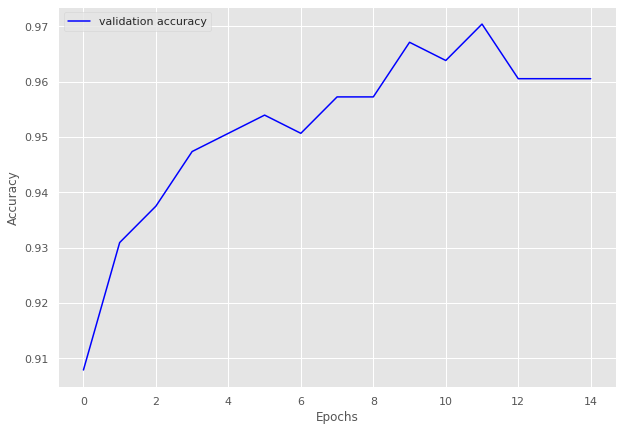

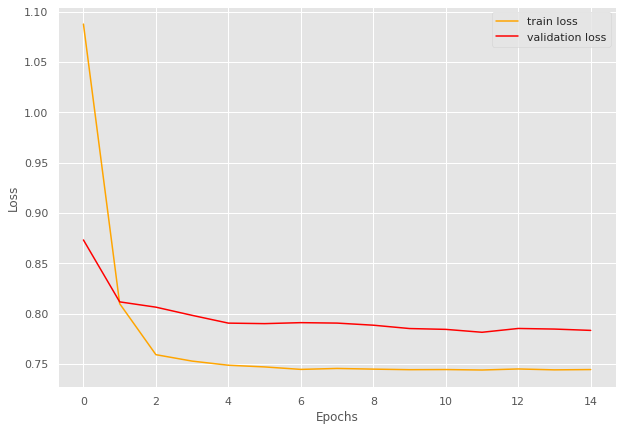

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=1.65]


train loss 1.6517878293991088, validation loss 1.4825738191604614, validation accuracy 0.6137931034482759
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.21batch/s, loss=1.28]


train loss 1.2782732725143433, validation loss 1.2808661699295043, validation accuracy 0.8172413793103448
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.21batch/s, loss=1.12]


train loss 1.123442780971527, validation loss 1.1900649070739746, validation accuracy 0.8793103448275862
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=1.09]


train loss 1.0868645310401917, validation loss 1.1756269931793213, validation accuracy 0.8758620689655172
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.22batch/s, loss=1.07]


train loss 1.0731987833976746, validation loss 1.160447645187378, validation accuracy 0.8862068965517241
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=1.07]


train loss 1.0674445271492004, validation loss 1.1516786813735962, validation accuracy 0.8896551724137931
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=1.05]


INFO: Early stopping counter 1 of 5
train loss 1.0526725888252257, validation loss 1.159439253807068, validation accuracy 0.8793103448275862
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.21batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.0541759252548217, validation loss 1.1662217617034911, validation accuracy 0.8758620689655172
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.14batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.062555766105652, validation loss 1.2021116256713866, validation accuracy 0.8448275862068966
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.21batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.0668634533882142, validation loss 1.1788032531738282, validation accuracy 0.8620689655172413
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.22batch/s, loss=1.07]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.8444712020870961 and loss 1.2027809023857117


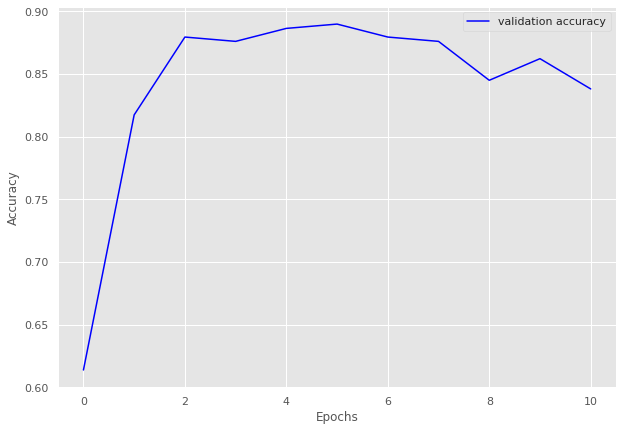

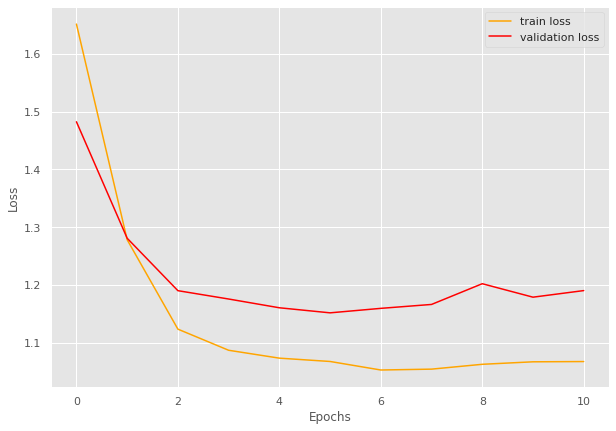

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.25batch/s, loss=0.864]


train loss 0.8636743028958639, validation loss 0.6731887698173523, validation accuracy 0.8764478764478765
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.26batch/s, loss=0.63] 


train loss 0.6303417483965555, validation loss 0.6301064491271973, validation accuracy 0.9073359073359073
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.25batch/s, loss=0.598]


train loss 0.5980391502380371, validation loss 0.6212119579315185, validation accuracy 0.9266409266409267
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.10batch/s, loss=0.583]


INFO: Early stopping counter 1 of 5
train loss 0.5826793909072876, validation loss 0.6229262113571167, validation accuracy 0.918918918918919
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.27batch/s, loss=0.591]


INFO: Early stopping counter 2 of 5
train loss 0.5907075007756551, validation loss 0.6328545570373535, validation accuracy 0.9034749034749034
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.17batch/s, loss=0.566]


INFO: Early stopping counter 3 of 5
train loss 0.5656423833635118, validation loss 0.6337112545967102, validation accuracy 0.8957528957528957
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.21batch/s, loss=0.569]


INFO: Early stopping counter 4 of 5
train loss 0.5694296956062317, validation loss 0.6366311192512513, validation accuracy 0.8996138996138996
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.23batch/s, loss=0.593]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.8986883763003166 and loss 0.6520358307021005


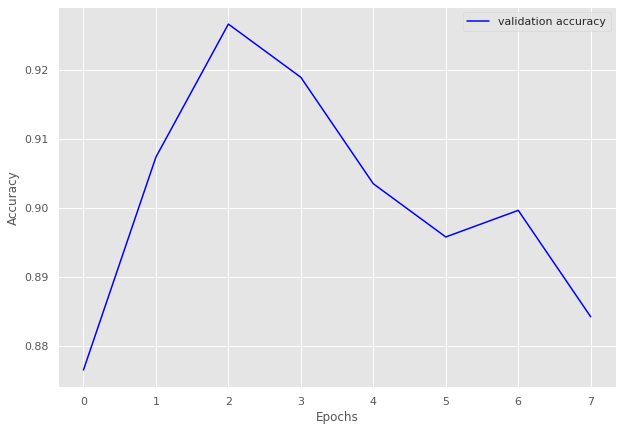

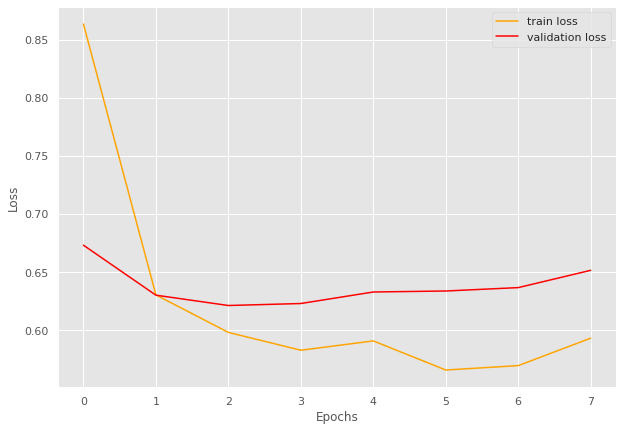

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=1.42]


train loss 1.4158332849803723, validation loss 1.151709258556366, validation accuracy 0.9158249158249159
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.97batch/s, loss=1.11]


train loss 1.1083577369388782, validation loss 1.1133899450302125, validation accuracy 0.9326599326599326
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.96batch/s, loss=1.07]


train loss 1.0702694466239528, validation loss 1.0990438222885133, validation accuracy 0.9511784511784511
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.92batch/s, loss=1.06]


train loss 1.0587636922535144, validation loss 1.097061812877655, validation accuracy 0.9494949494949495
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0605808559216952, validation loss 1.0981662034988404, validation accuracy 0.9528619528619529
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.06]


train loss 1.0579005228845697, validation loss 1.0940861701965332, validation accuracy 0.9494949494949495
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.94batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.053770385290447, validation loss 1.1046820521354674, validation accuracy 0.9444444444444444
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0514429431212575, validation loss 1.0981960535049438, validation accuracy 0.9478114478114478
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0520889884547184, validation loss 1.1037423491477967, validation accuracy 0.9461279461279462
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.90batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9475810424672382 and loss 1.0980337250907466


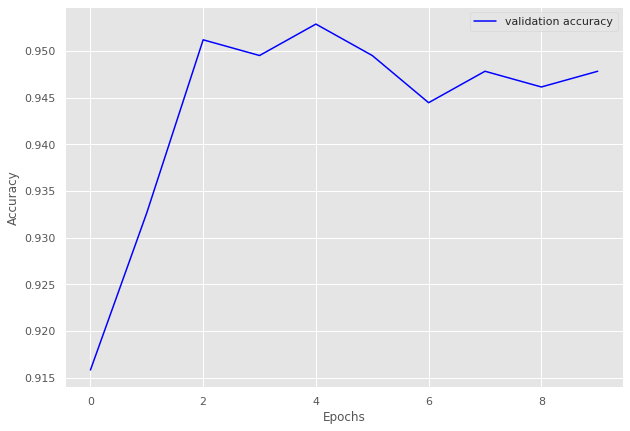

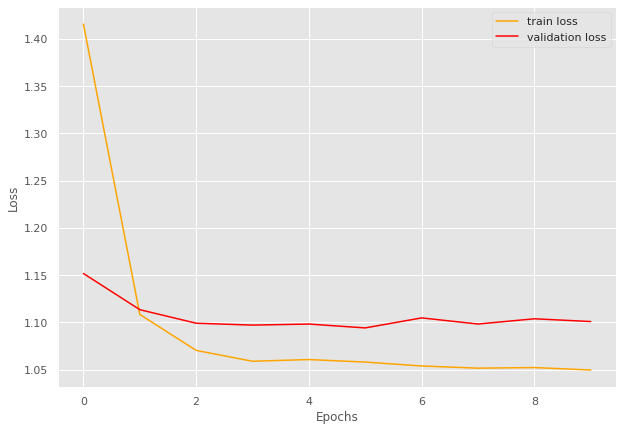

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.14batch/s, loss=1.15]


train loss 1.1516572415828705, validation loss 0.9492838144302368, validation accuracy 0.8061224489795918
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.83]


train loss 0.8301341474056244, validation loss 0.8387045741081238, validation accuracy 0.9115646258503401
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.14batch/s, loss=0.766]


train loss 0.7659124851226806, validation loss 0.8254269123077392, validation accuracy 0.9183673469387755
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.20batch/s, loss=0.76]


train loss 0.7597073972225189, validation loss 0.8251339793205261, validation accuracy 0.9183673469387755
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.756]


train loss 0.7564952611923218, validation loss 0.8130562663078308, validation accuracy 0.9251700680272109
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.11batch/s, loss=0.751]


INFO: Early stopping counter 1 of 5
train loss 0.7509004175662994, validation loss 0.8150292754173278, validation accuracy 0.9183673469387755
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.749]


INFO: Early stopping counter 2 of 5
train loss 0.7493144452571869, validation loss 0.8138893485069275, validation accuracy 0.9251700680272109
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.70batch/s, loss=0.753]


INFO: Early stopping counter 3 of 5
train loss 0.7532642185688019, validation loss 0.813855516910553, validation accuracy 0.9285714285714286
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.755]


train loss 0.7552821516990662, validation loss 0.8103833675384522, validation accuracy 0.9285714285714286
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=0.751]


train loss 0.7507300734519958, validation loss 0.8081959962844849, validation accuracy 0.9319727891156463
Coarse label 15 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.16batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.751229441165924, validation loss 0.8103931784629822, validation accuracy 0.9217687074829932
Coarse label 15 Epoch 12
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.766]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9208059046479155 and loss 0.8213112844696527


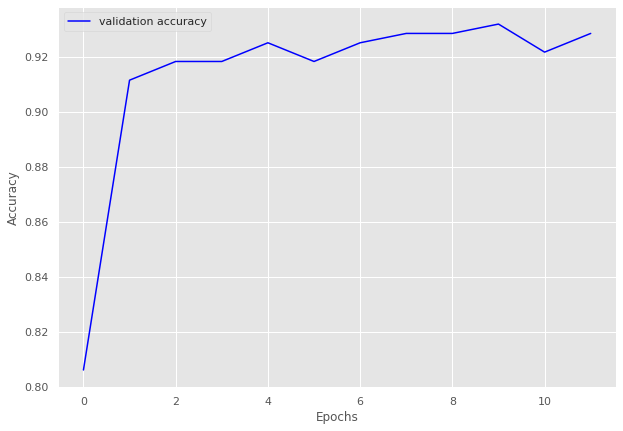

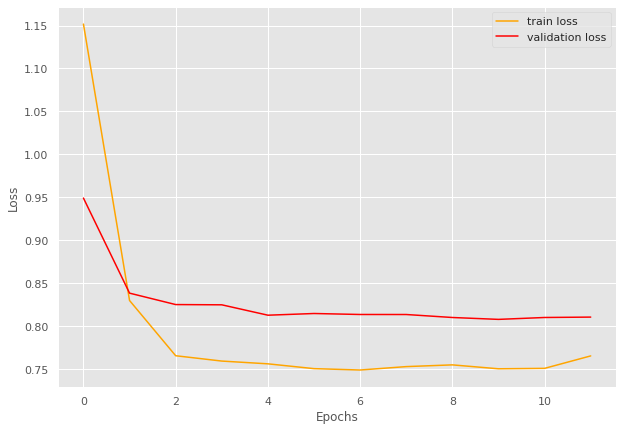

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.98batch/s, loss=0.864]


train loss 0.863900813791487, validation loss 0.7383961081504822, validation accuracy 0.8794326241134752
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.00batch/s, loss=0.606]


train loss 0.6055135726928711, validation loss 0.6480071067810058, validation accuracy 0.9113475177304965
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.97batch/s, loss=0.576]


train loss 0.5757965445518494, validation loss 0.646835446357727, validation accuracy 0.8971631205673759
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.97batch/s, loss=0.566]


train loss 0.5658045609792074, validation loss 0.6196789383888245, validation accuracy 0.9290780141843972
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.01batch/s, loss=0.558]


train loss 0.5575532846980624, validation loss 0.6135133862495422, validation accuracy 0.925531914893617
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  3.00batch/s, loss=0.556]


train loss 0.5555298262172275, validation loss 0.611604630947113, validation accuracy 0.9290780141843972
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.01batch/s, loss=0.553]


INFO: Early stopping counter 1 of 5
train loss 0.5529533094829984, validation loss 0.6145508527755738, validation accuracy 0.925531914893617
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.86batch/s, loss=0.552]


INFO: Early stopping counter 2 of 5
train loss 0.5520857705010308, validation loss 0.6153691411018372, validation accuracy 0.9219858156028369
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.00batch/s, loss=0.552]


INFO: Early stopping counter 3 of 5
train loss 0.5519211424721612, validation loss 0.6151488423347473, validation accuracy 0.9290780141843972
Coarse label 16 Epoch 10
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.72batch/s, loss=0.552]


INFO: Early stopping counter 4 of 5
train loss 0.5518985721800063, validation loss 0.6154742240905762, validation accuracy 0.925531914893617
Coarse label 16 Epoch 11
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.98batch/s, loss=0.552]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9467886094367075 and loss 0.6067861781308526


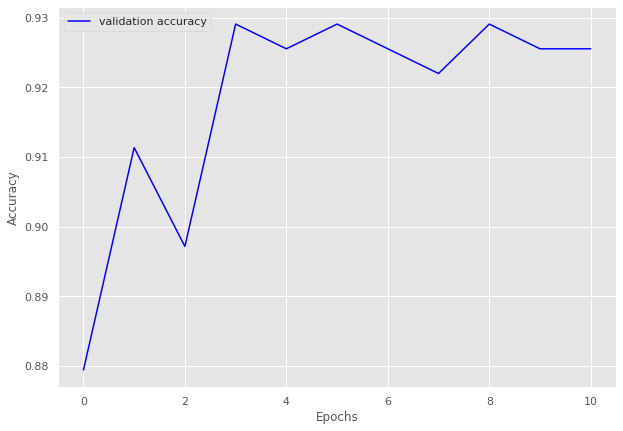

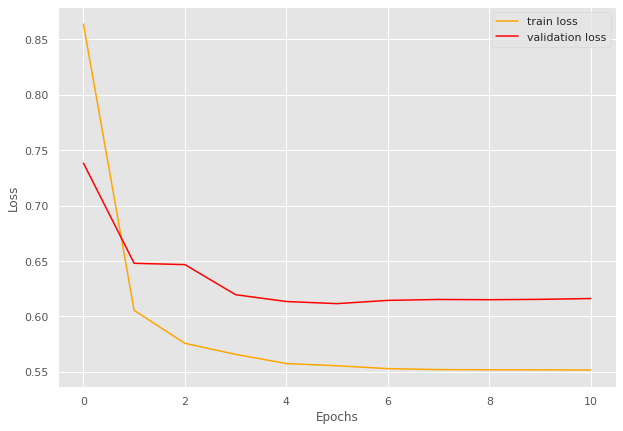

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 17 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.91batch/s, loss=1.14]


train loss 1.1442886531352996, validation loss 1.038434910774231, validation accuracy 0.7378640776699029
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.866]


train loss 0.8663816690444947, validation loss 0.9181763768196106, validation accuracy 0.8349514563106796
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=0.79]


train loss 0.7896417558193207, validation loss 0.8924573659896851, validation accuracy 0.8543689320388349
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.00batch/s, loss=0.765]


train loss 0.7651434719562531, validation loss 0.8799009203910828, validation accuracy 0.8576051779935275
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.00batch/s, loss=0.759]


train loss 0.7591755807399749, validation loss 0.8676202297210693, validation accuracy 0.8802588996763754
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.755]


train loss 0.7551236867904663, validation loss 0.8656731724739075, validation accuracy 0.8770226537216829
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.03batch/s, loss=0.753]


train loss 0.7528190732002258, validation loss 0.8615047693252563, validation accuracy 0.883495145631068
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.00batch/s, loss=0.752]


train loss 0.7522415280342102, validation loss 0.8585104942321777, validation accuracy 0.8770226537216829
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.753]


train loss 0.7526231229305267, validation loss 0.8529698371887207, validation accuracy 0.8964401294498382
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.752]


train loss 0.7516943454742432, validation loss 0.8459318518638611, validation accuracy 0.9093851132686084
Coarse label 17 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.75]


train loss 0.7499996840953826, validation loss 0.8439482927322388, validation accuracy 0.9093851132686084
Coarse label 17 Epoch 12
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=0.749]


INFO: Early stopping counter 1 of 5
train loss 0.748710960149765, validation loss 0.8442774415016174, validation accuracy 0.8996763754045307
Coarse label 17 Epoch 13
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=0.75]


INFO: Early stopping counter 2 of 5
train loss 0.7500327706336976, validation loss 0.8492474913597107, validation accuracy 0.8932038834951457
Coarse label 17 Epoch 14
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.03batch/s, loss=0.754]


INFO: Early stopping counter 3 of 5
train loss 0.7539225995540619, validation loss 0.8678125500679016, validation accuracy 0.8802588996763754
Coarse label 17 Epoch 15
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.89batch/s, loss=0.749]


INFO: Early stopping counter 4 of 5
train loss 0.7491066157817841, validation loss 0.8625010967254638, validation accuracy 0.8802588996763754
Coarse label 17 Epoch 16
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.03batch/s, loss=0.753]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9028831562974203 and loss 0.8393477775964392


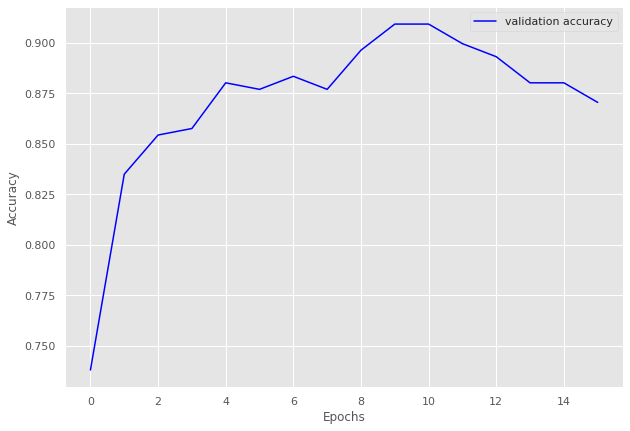

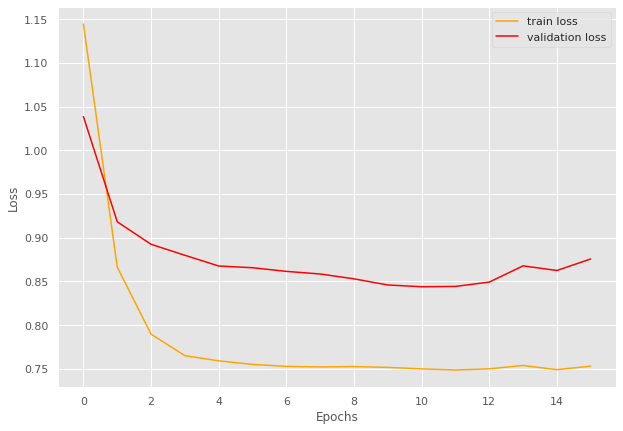

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 19 Epoch 1
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.67batch/s, loss=1.29]


train loss 1.293805867433548, validation loss 1.2301443815231323, validation accuracy 0.4895833333333333
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.67batch/s, loss=1.07] 


train loss 1.0706236958503723, validation loss 1.0593775510787964, validation accuracy 0.7291666666666666
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.65batch/s, loss=0.922]


train loss 0.9218169003725052, validation loss 0.9508964121341705, validation accuracy 0.8541666666666666
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.72batch/s, loss=0.859]


train loss 0.8587433248758316, validation loss 0.9176425337791443, validation accuracy 0.84375
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.74batch/s, loss=0.813]


train loss 0.8128100633621216, validation loss 0.8905982375144958, validation accuracy 0.875
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.69batch/s, loss=0.822]


train loss 0.8217441588640213, validation loss 0.8826671540737152, validation accuracy 0.8958333333333334
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.78batch/s, loss=0.81] 


train loss 0.8095489591360092, validation loss 0.8723517060279846, validation accuracy 0.875
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.76batch/s, loss=0.838]


train loss 0.8381518572568893, validation loss 0.8546019196510315, validation accuracy 0.8958333333333334
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.64batch/s, loss=0.792]


INFO: Early stopping counter 1 of 5
train loss 0.7920083850622177, validation loss 0.8548330068588257, validation accuracy 0.875
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.79batch/s, loss=0.774]


INFO: Early stopping counter 2 of 5
train loss 0.7735854983329773, validation loss 0.8575589060783386, validation accuracy 0.8541666666666666
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.75batch/s, loss=0.795]


train loss 0.7946704924106598, validation loss 0.8505686521530151, validation accuracy 0.8645833333333334
Coarse label 19 Epoch 12
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.76batch/s, loss=0.791]


train loss 0.7910340428352356, validation loss 0.8442234694957733, validation accuracy 0.8645833333333334
Coarse label 19 Epoch 13
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.75batch/s, loss=0.875]


INFO: Early stopping counter 3 of 5
train loss 0.8749396204948425, validation loss 0.845926821231842, validation accuracy 0.8854166666666666
Coarse label 19 Epoch 14
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.76batch/s, loss=0.788]


INFO: Early stopping counter 4 of 5
train loss 0.7877794951200485, validation loss 0.8557983338832855, validation accuracy 0.8854166666666666
Coarse label 19 Epoch 15
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.77batch/s, loss=0.888]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.8459232613908872 and loss 0.9283189641104804


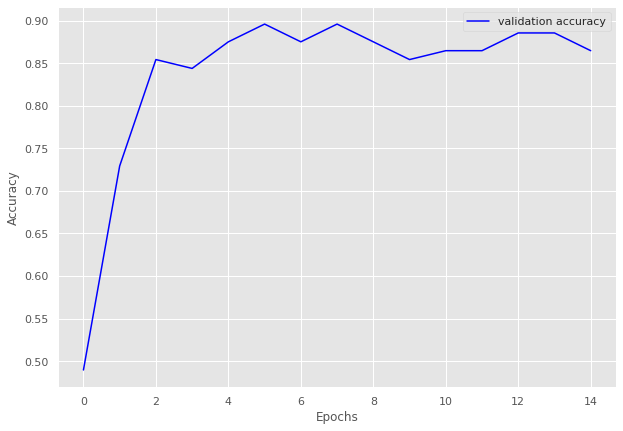

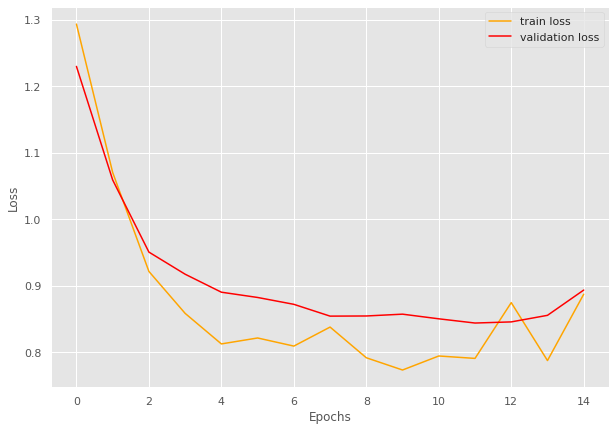

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Evaluating fine model 0
Evaluating fine model 1
Evaluating fine model 2
Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16
Evaluating fine model 17
Evaluating fine model 19
overall accuracy  is 0.7219707825114459
{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.93423053527980

Calculating for volume 25
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.02batch/s, loss=1.23]


train loss 1.2297516167163849, validation loss 1.0030395303453719, validation accuracy 0.9067599067599068
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.01batch/s, loss=0.994]


train loss 0.9941225669213704, validation loss 0.9882567780358451, validation accuracy 0.9137529137529138
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=0.955]


train loss 0.9550154336861202, validation loss 0.979505581515176, validation accuracy 0.9254079254079254
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=0.961]


train loss 0.9606274919850486, validation loss 0.9770541957446507, validation accuracy 0.9324009324009324
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=0.955]


train loss 0.9553624136107308, validation loss 0.9688718063490731, validation accuracy 0.9393939393939394
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.02batch/s, loss=0.956]


INFO: Early stopping counter 1 of 5
train loss 0.9564062293086734, validation loss 0.9760526503835406, validation accuracy 0.9300699300699301
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.03batch/s, loss=0.96] 


INFO: Early stopping counter 2 of 5
train loss 0.9596998308386121, validation loss 0.9738311171531677, validation accuracy 0.9324009324009324
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=0.937]


INFO: Early stopping counter 3 of 5
train loss 0.9374015948602131, validation loss 0.982916568006788, validation accuracy 0.9254079254079254
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.83batch/s, loss=0.945]


INFO: Early stopping counter 4 of 5
train loss 0.9450018916811261, validation loss 0.9716043557439532, validation accuracy 0.9347319347319347
Coarse label 0 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=0.93] 


train loss 0.9304833135434559, validation loss 0.9612096718379429, validation accuracy 0.9487179487179487
Coarse label 0 Epoch 11
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=0.929]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9400061690314621 and loss 0.9643670659439236


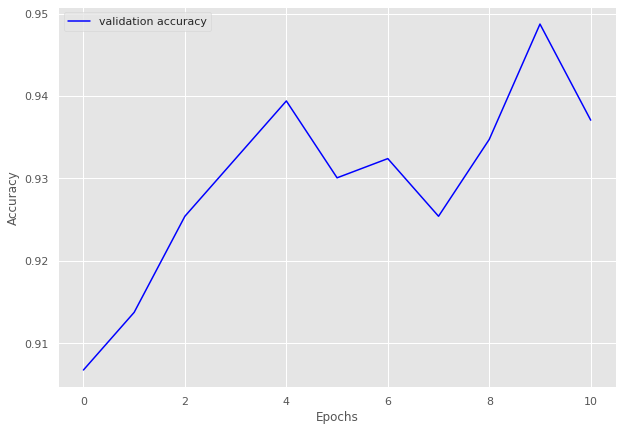

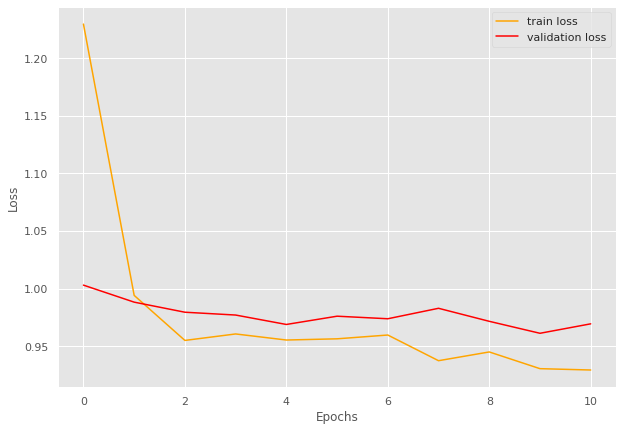

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 1 Epoch 1
-------------------------------


100%|██████████| 12/12 [00:05<00:00,  2.12batch/s, loss=1.46]


train loss 1.460586041212082, validation loss 1.2235655387242634, validation accuracy 0.8494623655913979
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.00batch/s, loss=1.13]


train loss 1.1300899982452393, validation loss 1.145879864692688, validation accuracy 0.9086021505376344
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.90batch/s, loss=1.07]


train loss 1.073830356200536, validation loss 1.1233691374460857, validation accuracy 0.9247311827956989
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.99batch/s, loss=1.06]


train loss 1.0581132769584656, validation loss 1.1231192747751872, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.97batch/s, loss=1.05]


INFO: Early stopping counter 1 of 5
train loss 1.0537091394265492, validation loss 1.1309293111165364, validation accuracy 0.9086021505376344
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.98batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.0525378982226055, validation loss 1.1289697885513306, validation accuracy 0.9193548387096774
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.93batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.048501471678416, validation loss 1.1272087494532268, validation accuracy 0.9139784946236559
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.98batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0494619409243267, validation loss 1.1320384740829468, validation accuracy 0.9032258064516129
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.98batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9447592067988668 and loss 1.101082600487603


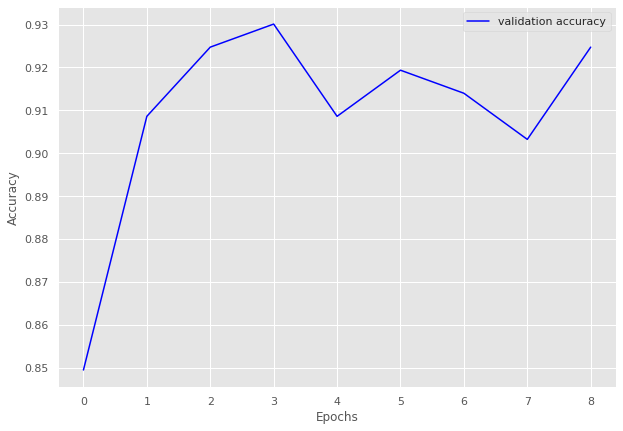

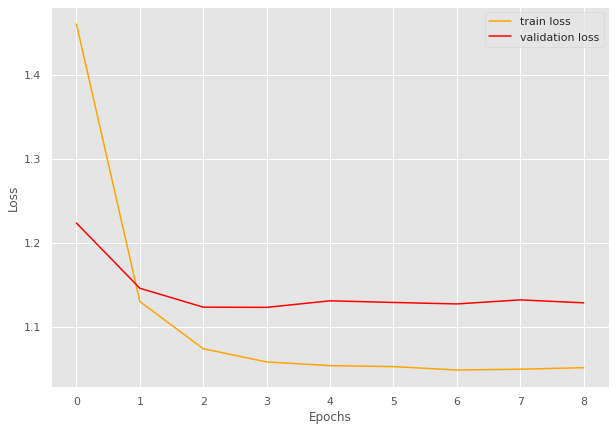

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 2 Epoch 1
-------------------------------


100%|██████████| 55/55 [00:29<00:00,  1.88batch/s, loss=1.79]


train loss 1.7938284462148493, validation loss 1.624129899910518, validation accuracy 0.8701149425287357
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 55/55 [00:40<00:00,  1.37batch/s, loss=1.56]


train loss 1.558249258995056, validation loss 1.5718443564006261, validation accuracy 0.8919540229885058
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 55/55 [00:42<00:00,  1.28batch/s, loss=1.53]


train loss 1.5305033965544268, validation loss 1.5455248951911926, validation accuracy 0.9195402298850575
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 55/55 [00:44<00:00,  1.23batch/s, loss=1.51]


INFO: Early stopping counter 1 of 5
train loss 1.5058026920665395, validation loss 1.5462926200457983, validation accuracy 0.9172413793103448
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 55/55 [00:30<00:00,  1.79batch/s, loss=1.5] 


INFO: Early stopping counter 2 of 5
train loss 1.4973808830434625, validation loss 1.5466969183513097, validation accuracy 0.9172413793103448
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 55/55 [00:19<00:00,  2.88batch/s, loss=1.5] 


INFO: Early stopping counter 3 of 5
train loss 1.495020504431291, validation loss 1.5509907603263855, validation accuracy 0.9149425287356322
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.90batch/s, loss=1.49]


train loss 1.4915715802799572, validation loss 1.533886969089508, validation accuracy 0.9310344827586207
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4837177710099654, validation loss 1.5357611434800285, validation accuracy 0.9264367816091954
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.91batch/s, loss=1.48]


train loss 1.484162495353005, validation loss 1.5278290169579642, validation accuracy 0.9379310344827586
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 55/55 [00:19<00:00,  2.86batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.938184306569343 and loss 1.5242313285475795


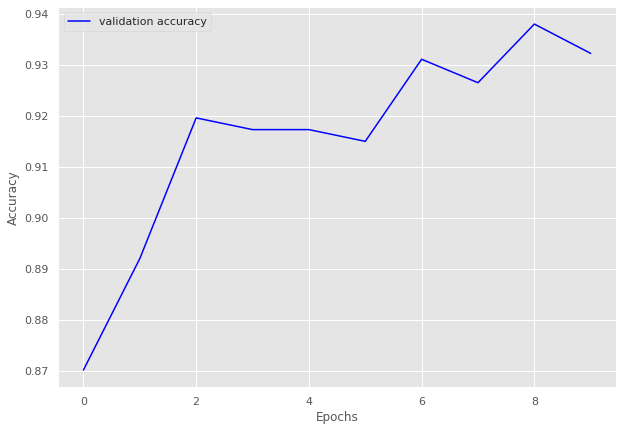

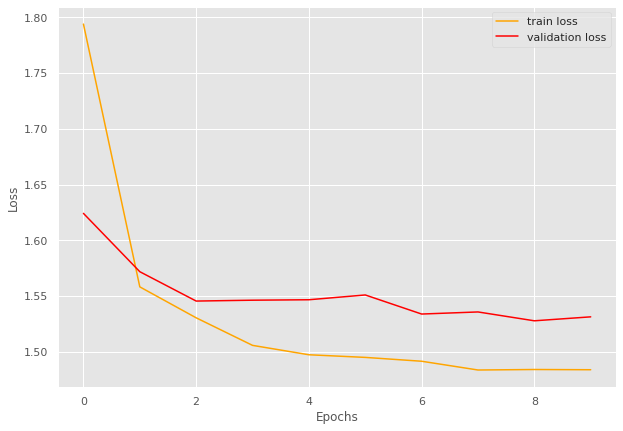

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.98batch/s, loss=1.42]


train loss 1.4162748914498549, validation loss 1.180451580456325, validation accuracy 0.8980582524271845
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.98batch/s, loss=1.13]


train loss 1.1287040160252497, validation loss 1.1209005458014352, validation accuracy 0.941747572815534
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.95batch/s, loss=1.08]


train loss 1.0832540576274579, validation loss 1.113343630518232, validation accuracy 0.9441747572815534
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.97batch/s, loss=1.07]


train loss 1.0689855080384474, validation loss 1.102993437222072, validation accuracy 0.9514563106796117
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.97batch/s, loss=1.06]


train loss 1.062946351674887, validation loss 1.0977202313286918, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0611556630868177, validation loss 1.1048213413783483, validation accuracy 0.941747572815534
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.96batch/s, loss=1.06]


train loss 1.058484815634214, validation loss 1.0902210814612252, validation accuracy 0.9611650485436893
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0571258847530072, validation loss 1.0989593608038766, validation accuracy 0.9490291262135923
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.98batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.054132498227633, validation loss 1.0985068764005388, validation accuracy 0.9514563106796117
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.99batch/s, loss=1.05]


train loss 1.0537954843961275, validation loss 1.0889486755643571, validation accuracy 0.9611650485436893
Coarse label 4 Epoch 11
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.95batch/s, loss=1.06]


train loss 1.0590805457188532, validation loss 1.0842480489185877, validation accuracy 0.9660194174757282
Coarse label 4 Epoch 12
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.97batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0624512800803552, validation loss 1.0992222002574377, validation accuracy 0.9514563106796117
Coarse label 4 Epoch 13
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.91batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9315509743920116 and loss 1.11151528845028


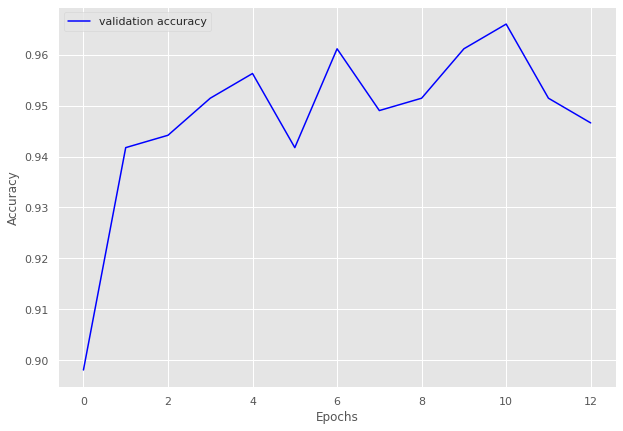

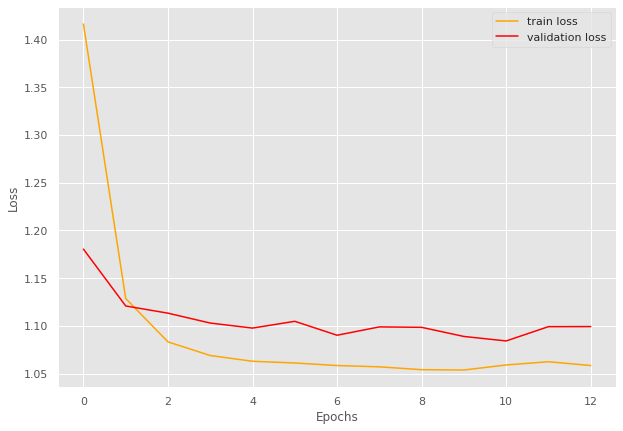

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=0.456]


train loss 0.45571058988571167, validation loss 0.4218672017256419, validation accuracy 0.8742138364779874
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.82batch/s, loss=0.335]


train loss 0.334634006023407, validation loss 0.35871193806330365, validation accuracy 0.9433962264150944
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.96batch/s, loss=0.321]


train loss 0.32116825580596925, validation loss 0.34748924771944684, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.83batch/s, loss=0.316]


train loss 0.31613742411136625, validation loss 0.3471064766248067, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:05<00:00,  1.93batch/s, loss=0.32]


train loss 0.3203714370727539, validation loss 0.3369632164637248, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=0.315]


INFO: Early stopping counter 1 of 5
train loss 0.31497682332992555, validation loss 0.34154707193374634, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.92batch/s, loss=0.316]


INFO: Early stopping counter 2 of 5
train loss 0.31550550162792207, validation loss 0.342267781496048, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.81batch/s, loss=0.315]


INFO: Early stopping counter 3 of 5
train loss 0.3146279752254486, validation loss 0.3472348749637604, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=0.314]


INFO: Early stopping counter 4 of 5
train loss 0.31416856944561006, validation loss 0.3452896575133006, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=0.314]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9720483938256154 and loss 0.3395129748080906


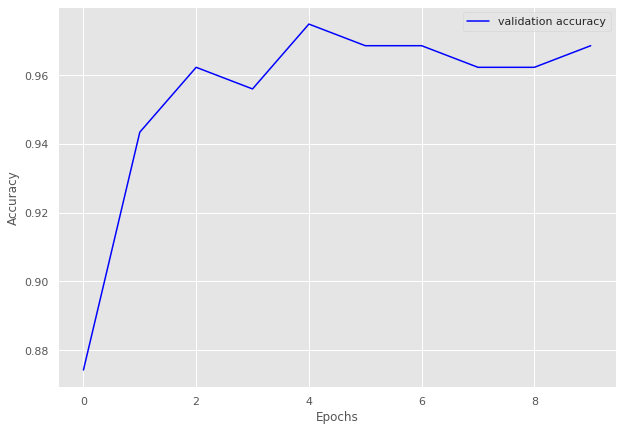

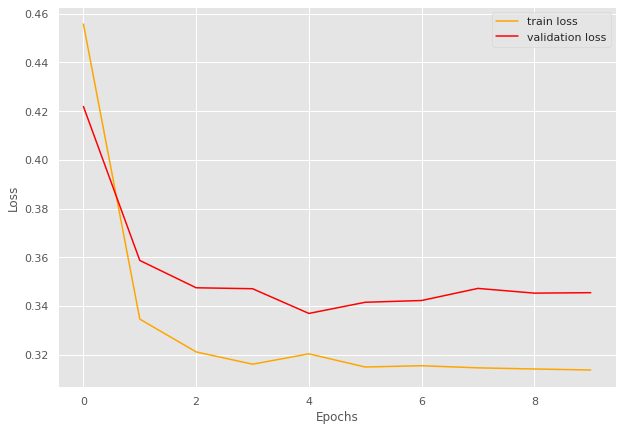

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.96batch/s, loss=1.47]


train loss 1.4735580921173095, validation loss 1.2491018325090408, validation accuracy 0.9181034482758621
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.00batch/s, loss=1.25]


train loss 1.2466315388679505, validation loss 1.2356811165809631, validation accuracy 0.9288793103448276
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.95batch/s, loss=1.22]


train loss 1.2212588389714558, validation loss 1.2276200950145721, validation accuracy 0.9353448275862069
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=1.21]


INFO: Early stopping counter 1 of 5
train loss 1.2105910142262777, validation loss 1.2296683937311172, validation accuracy 0.9331896551724138
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.2] 


train loss 1.1988789399464925, validation loss 1.220858171582222, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=1.19]


train loss 1.1934690634409586, validation loss 1.2197261601686478, validation accuracy 0.9375
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.19]


train loss 1.1919580737749735, validation loss 1.2137481421232224, validation accuracy 0.9482758620689655
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.03batch/s, loss=1.18]


train loss 1.1823038379351298, validation loss 1.212417796254158, validation accuracy 0.9504310344827587
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=1.18]


INFO: Early stopping counter 2 of 5
train loss 1.1837948520978292, validation loss 1.227958783507347, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.02batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1858827074368794, validation loss 1.2310604900121689, validation accuracy 0.9353448275862069
Coarse label 6 Epoch 11
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.03batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1907531340916953, validation loss 1.2160671055316925, validation accuracy 0.9418103448275862
Coarse label 6 Epoch 12
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.04batch/s, loss=1.18]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9383297644539614 and loss 1.22670255465941


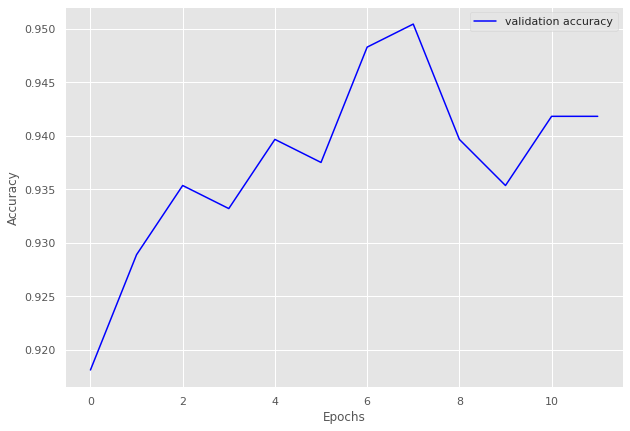

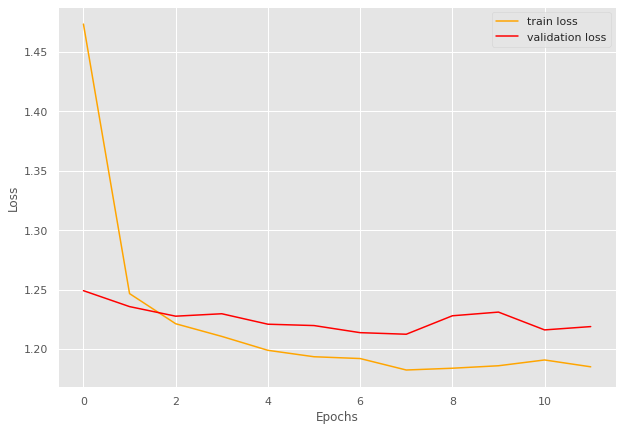

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.90batch/s, loss=0.946]


train loss 0.9456163541130398, validation loss 0.8048480749130249, validation accuracy 0.9449035812672176
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.92batch/s, loss=0.769]


train loss 0.7686226678931195, validation loss 0.781499058008194, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.96batch/s, loss=0.761]


train loss 0.7614913090415623, validation loss 0.7741462488969167, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.90batch/s, loss=0.756]


INFO: Early stopping counter 1 of 5
train loss 0.7562019954557004, validation loss 0.7804708580176035, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.91batch/s, loss=0.759]


INFO: Early stopping counter 2 of 5
train loss 0.7592415783716284, validation loss 0.7774497270584106, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 23/23 [00:08<00:00,  2.71batch/s, loss=0.76] 


INFO: Early stopping counter 3 of 5
train loss 0.759816138640694, validation loss 0.7839362521966299, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.90batch/s, loss=0.755]


INFO: Early stopping counter 4 of 5
train loss 0.7545570212861766, validation loss 0.7865961591402689, validation accuracy 0.9559228650137741
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.94batch/s, loss=0.751]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9609773887673231 and loss 0.7826840385448101


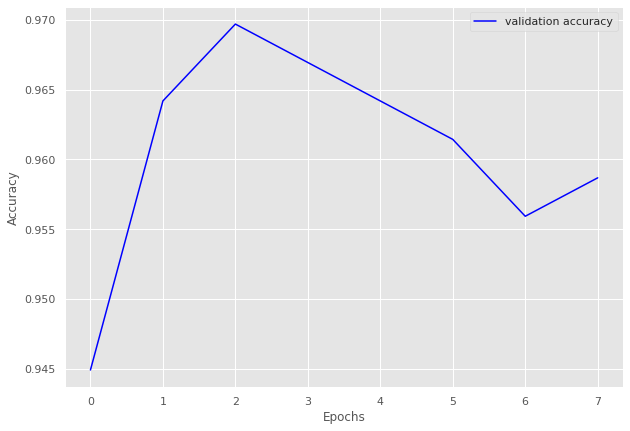

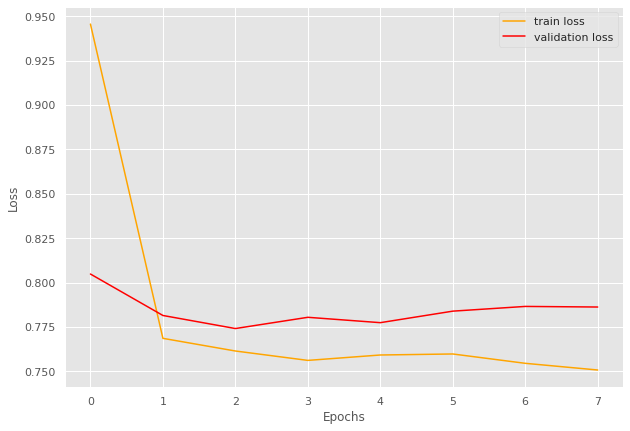

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.91batch/s, loss=1.53]


train loss 1.526470054279674, validation loss 1.3142600059509277, validation accuracy 0.8493150684931506
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.98batch/s, loss=1.26]


train loss 1.2597280451745698, validation loss 1.2790724784135818, validation accuracy 0.8864970645792564
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  3.00batch/s, loss=1.23]


train loss 1.2277823505979595, validation loss 1.260090783238411, validation accuracy 0.9060665362035225
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.89batch/s, loss=1.2] 


INFO: Early stopping counter 1 of 5
train loss 1.2035841327725034, validation loss 1.2715757191181183, validation accuracy 0.8943248532289628
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.97batch/s, loss=1.21]


INFO: Early stopping counter 2 of 5
train loss 1.2133602554147893, validation loss 1.2675547897815704, validation accuracy 0.9001956947162426
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.94batch/s, loss=1.21]


INFO: Early stopping counter 3 of 5
train loss 1.2079060583403616, validation loss 1.2722022533416748, validation accuracy 0.8943248532289628
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.98batch/s, loss=1.2] 


train loss 1.204826163523125, validation loss 1.2597439736127853, validation accuracy 0.9080234833659491
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.98batch/s, loss=1.2] 


train loss 1.2007492419445154, validation loss 1.2487593740224838, validation accuracy 0.9197651663405088
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  3.00batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1912531924970222, validation loss 1.256108209490776, validation accuracy 0.9080234833659491
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.97batch/s, loss=1.21]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9187329611839543 and loss 1.2464409071551867


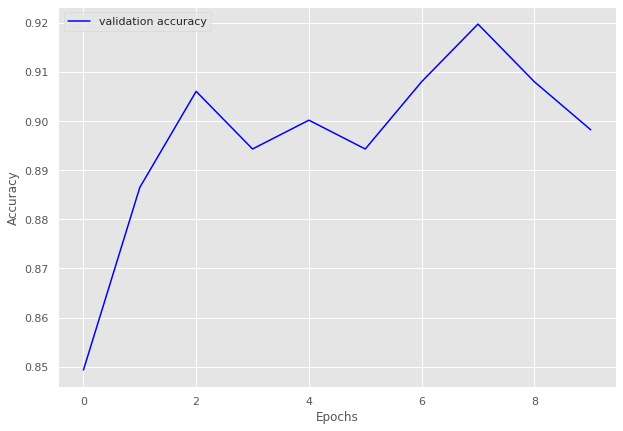

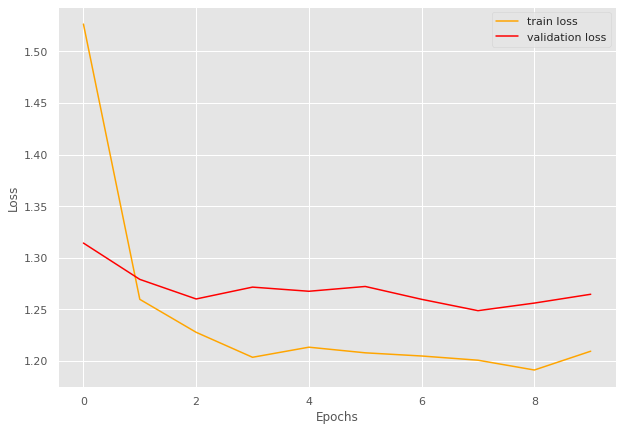

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=1.78]


train loss 1.7801959950749466, validation loss 1.655779936096885, validation accuracy 0.8796296296296297
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=1.56]


train loss 1.5634749226453828, validation loss 1.5824601325121792, validation accuracy 0.9151234567901234
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=1.52]


train loss 1.5224870268891497, validation loss 1.5619396729902788, validation accuracy 0.9228395061728395
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=1.5] 


train loss 1.5047043968991536, validation loss 1.558298652822321, validation accuracy 0.9228395061728395
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.89batch/s, loss=1.5] 


train loss 1.4988281901289777, validation loss 1.555781364440918, validation accuracy 0.9104938271604939
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=1.49]


train loss 1.491487238465286, validation loss 1.5472745136781172, validation accuracy 0.9243827160493827
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=1.48]


INFO: Early stopping counter 1 of 5
train loss 1.4844686577959758, validation loss 1.554588502103632, validation accuracy 0.9305555555555556
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.90batch/s, loss=1.48]


INFO: Early stopping counter 2 of 5
train loss 1.4794811301115083, validation loss 1.5519545078277588, validation accuracy 0.9290123456790124
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4796808173016804, validation loss 1.5566398338838057, validation accuracy 0.9305555555555556
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=1.47]


INFO: Early stopping counter 4 of 5
train loss 1.4748736503647595, validation loss 1.5583554723046043, validation accuracy 0.9182098765432098
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9306139182125653 and loss 1.5314811803157033


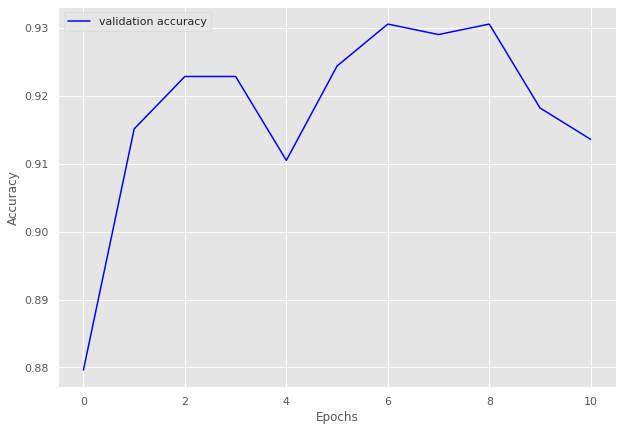

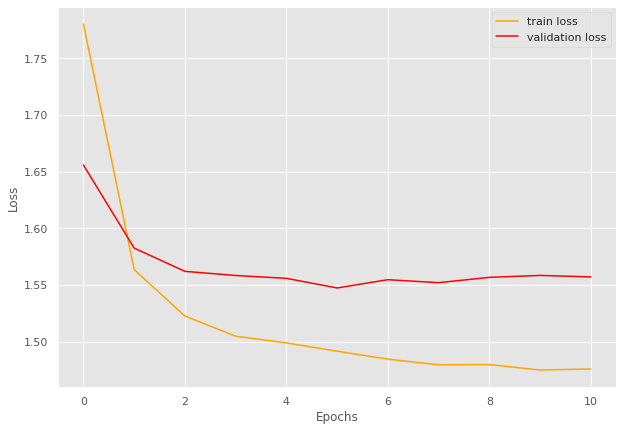

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.05batch/s, loss=0.966]


train loss 0.9655921399593353, validation loss 0.7938084721565246, validation accuracy 0.9473684210526315
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.05batch/s, loss=0.784]


train loss 0.7835093259811401, validation loss 0.7754587888717651, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.763]


train loss 0.7625021606683731, validation loss 0.7685779094696045, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.07batch/s, loss=0.754]


INFO: Early stopping counter 1 of 5
train loss 0.7537767738103867, validation loss 0.770769989490509, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.05batch/s, loss=0.751]


train loss 0.7514277309179306, validation loss 0.7680939435958862, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.05batch/s, loss=0.75] 


INFO: Early stopping counter 2 of 5
train loss 0.7495028138160705, validation loss 0.77682865858078, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.05batch/s, loss=0.756]


INFO: Early stopping counter 3 of 5
train loss 0.7563419848680496, validation loss 0.7735039949417114, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.04batch/s, loss=0.75] 


INFO: Early stopping counter 4 of 5
train loss 0.7503499537706375, validation loss 0.7725565791130066, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.752]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9715155468580126 and loss 0.7724764777554406


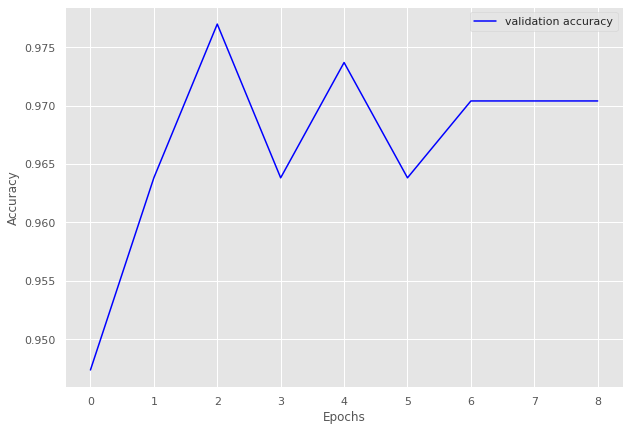

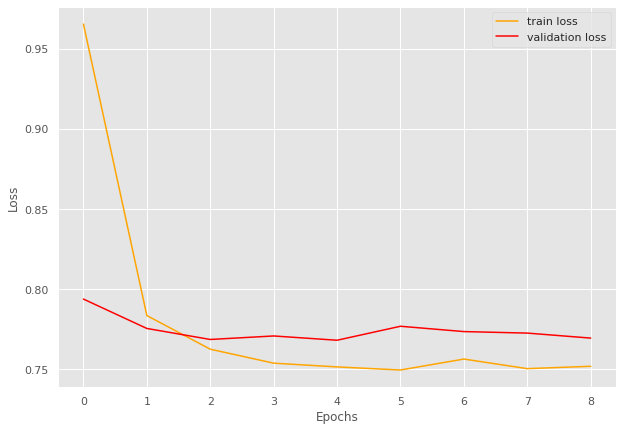

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.05batch/s, loss=1.48]


train loss 1.4805245838667218, validation loss 1.223893165588379, validation accuracy 0.8620689655172413
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.06batch/s, loss=1.13]


train loss 1.1341200063103123, validation loss 1.1506097555160522, validation accuracy 0.8931034482758621
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=1.1] 


train loss 1.09505537936562, validation loss 1.1400444746017455, validation accuracy 0.906896551724138
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.04batch/s, loss=1.08]


train loss 1.082811110898068, validation loss 1.1334319829940795, validation accuracy 0.9103448275862069
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=1.08]


train loss 1.075687565301594, validation loss 1.127343726158142, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.06batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0738613103565418, validation loss 1.146197009086609, validation accuracy 0.8896551724137931
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.97batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.065641252618087, validation loss 1.1344835042953492, validation accuracy 0.9103448275862069
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.06]


train loss 1.0643183306643837, validation loss 1.12216374874115, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=1.06]


train loss 1.0613603152726825, validation loss 1.1204906940460204, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.05batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.059851420553107, validation loss 1.122271513938904, validation accuracy 0.9310344827586207
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0586347768181248, validation loss 1.1298473596572876, validation accuracy 0.906896551724138
Coarse label 12 Epoch 12
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.01batch/s, loss=1.07]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.889419795221843 and loss 1.1522637830264326


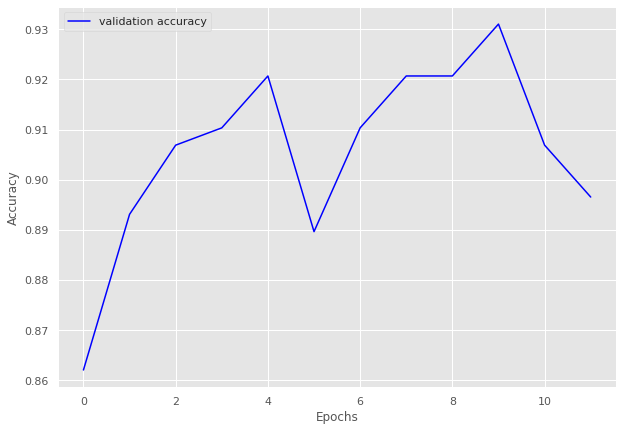

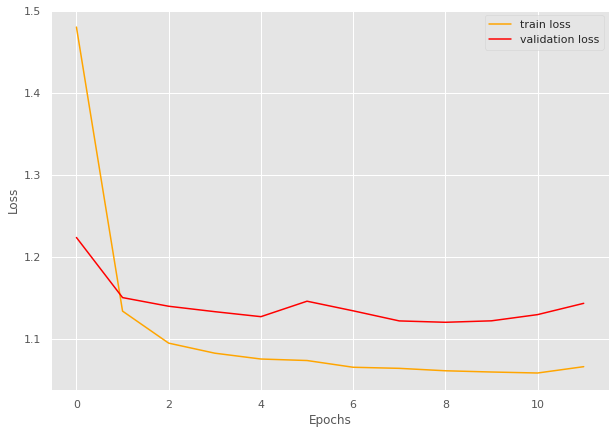

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  2.99batch/s, loss=0.76] 


train loss 0.7597052174455979, validation loss 0.6030167579650879, validation accuracy 0.9305019305019305
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.00batch/s, loss=0.604]


train loss 0.6039105162901037, validation loss 0.6024388432502746, validation accuracy 0.9420849420849421
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=0.579]


train loss 0.5785570319961099, validation loss 0.6013579726219177, validation accuracy 0.9343629343629344
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.06batch/s, loss=0.564]


train loss 0.5640412639169132, validation loss 0.5947276830673218, validation accuracy 0.9420849420849421
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.06batch/s, loss=0.567]


INFO: Early stopping counter 1 of 5
train loss 0.5667789683622473, validation loss 0.5991829633712769, validation accuracy 0.9343629343629344
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.03batch/s, loss=0.57] 


INFO: Early stopping counter 2 of 5
train loss 0.5703282075769761, validation loss 0.5971844315528869, validation accuracy 0.9459459459459459
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.03batch/s, loss=0.562]


train loss 0.5621214088271645, validation loss 0.590721046924591, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.04batch/s, loss=0.558]


train loss 0.5582685225150165, validation loss 0.5889246582984924, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.04batch/s, loss=0.56] 


INFO: Early stopping counter 3 of 5
train loss 0.5600794027833378, validation loss 0.593990170955658, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 10
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  2.99batch/s, loss=0.569]


INFO: Early stopping counter 4 of 5
train loss 0.5688196175238666, validation loss 0.5992566347122192, validation accuracy 0.9343629343629344
Coarse label 13 Epoch 11
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  2.96batch/s, loss=0.567]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9366829018200461 and loss 0.6120471983659462


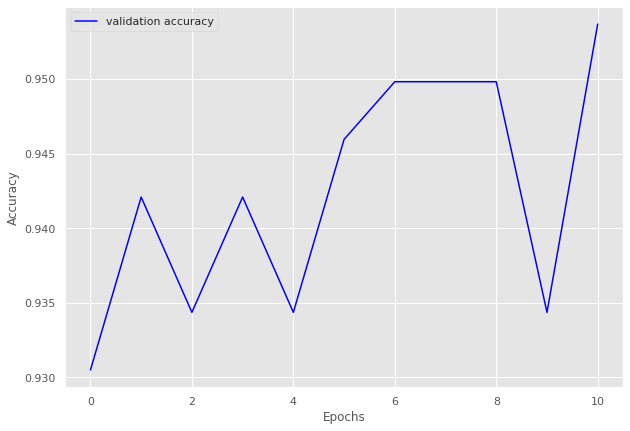

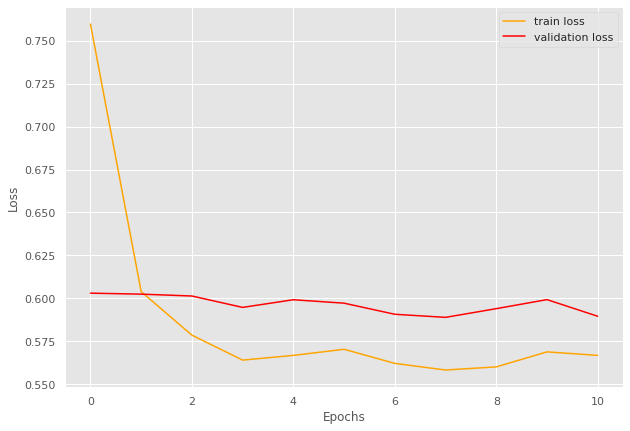

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.98batch/s, loss=1.26]


train loss 1.2644721395091008, validation loss 1.114101803302765, validation accuracy 0.9326599326599326
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.95batch/s, loss=1.09]


train loss 1.087181292082134, validation loss 1.1102399468421935, validation accuracy 0.9343434343434344
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 38/38 [00:13<00:00,  2.92batch/s, loss=1.07]


train loss 1.071138438425566, validation loss 1.0908776879310609, validation accuracy 0.9528619528619529
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.95batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0657279240457636, validation loss 1.0982695460319518, validation accuracy 0.9427609427609428
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.98batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.063150666261974, validation loss 1.099192500114441, validation accuracy 0.9478114478114478
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0624825891695524, validation loss 1.1006555914878846, validation accuracy 0.9461279461279462
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.056984427728151, validation loss 1.099361252784729, validation accuracy 0.9444444444444444
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.99batch/s, loss=1.06]


train loss 1.0550099830878408, validation loss 1.0897354483604431, validation accuracy 0.9545454545454546
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.98batch/s, loss=1.06]


train loss 1.0574914311107837, validation loss 1.082508134841919, validation accuracy 0.9629629629629629
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.94batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9547637663353066 and loss 1.088666957616806


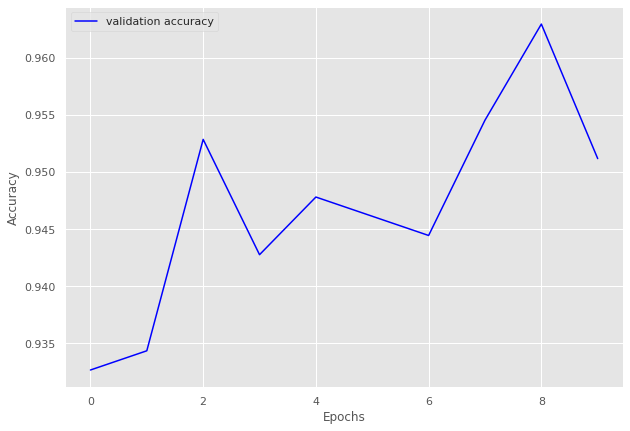

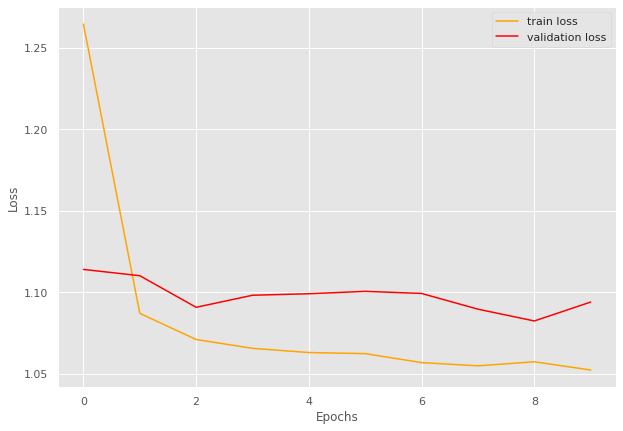

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.01batch/s, loss=1.03]


train loss 1.0262322363100553, validation loss 0.8309604167938233, validation accuracy 0.9149659863945578
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:09<00:00,  2.05batch/s, loss=0.794]


train loss 0.7941927313804626, validation loss 0.8032267451286316, validation accuracy 0.9455782312925171
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.03batch/s, loss=0.766]


train loss 0.7656834690194381, validation loss 0.78289235830307, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.78batch/s, loss=0.762]


INFO: Early stopping counter 1 of 5
train loss 0.7623166975222135, validation loss 0.7910477042198181, validation accuracy 0.9591836734693877
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=0.752]


INFO: Early stopping counter 2 of 5
train loss 0.7523553936105025, validation loss 0.7912063717842102, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.96batch/s, loss=0.754]


INFO: Early stopping counter 3 of 5
train loss 0.7540876300711381, validation loss 0.7897272944450379, validation accuracy 0.95578231292517
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=0.748]


INFO: Early stopping counter 4 of 5
train loss 0.7483751491496438, validation loss 0.7894481778144836, validation accuracy 0.9489795918367347
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=0.752]


train loss 0.751696200747239, validation loss 0.775068461894989, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=0.757]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9520687316301153 and loss 0.7912919197763716


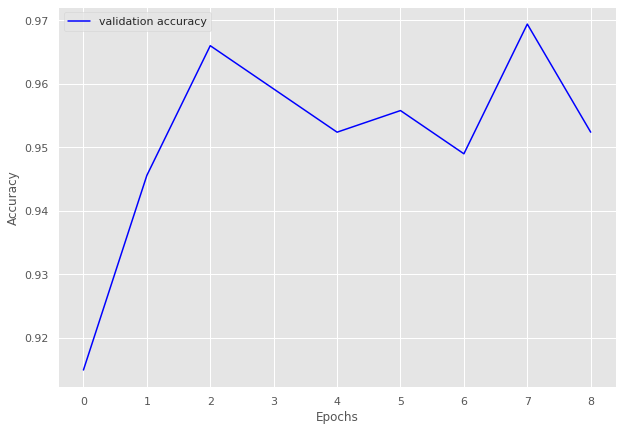

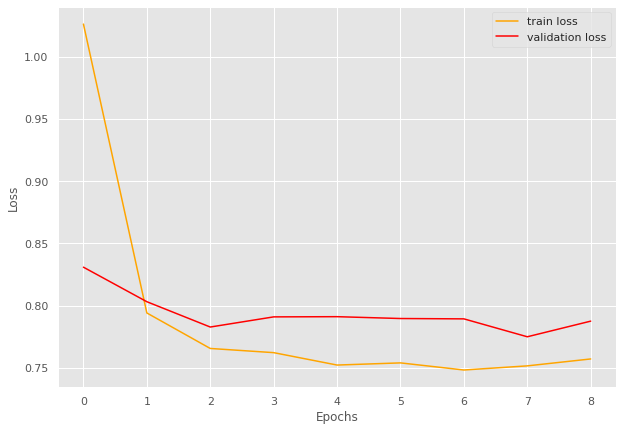

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.98batch/s, loss=0.771]


train loss 0.7710626125335693, validation loss 0.634070360660553, validation accuracy 0.9361702127659575
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.97batch/s, loss=0.587]


train loss 0.5867959029144711, validation loss 0.5954558372497558, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.98batch/s, loss=0.564]


INFO: Early stopping counter 1 of 5
train loss 0.5640899737675985, validation loss 0.6058361768722534, validation accuracy 0.950354609929078
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.99batch/s, loss=0.561]


INFO: Early stopping counter 2 of 5
train loss 0.5605631868044535, validation loss 0.6052663683891296, validation accuracy 0.9539007092198581
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.00batch/s, loss=0.558]


INFO: Early stopping counter 3 of 5
train loss 0.5575394365522597, validation loss 0.6042818188667297, validation accuracy 0.950354609929078
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.96batch/s, loss=0.556]


INFO: Early stopping counter 4 of 5
train loss 0.5558174981011285, validation loss 0.6096586465835572, validation accuracy 0.9468085106382979
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.71batch/s, loss=0.559]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9519434628975265 and loss 0.6019374941711995


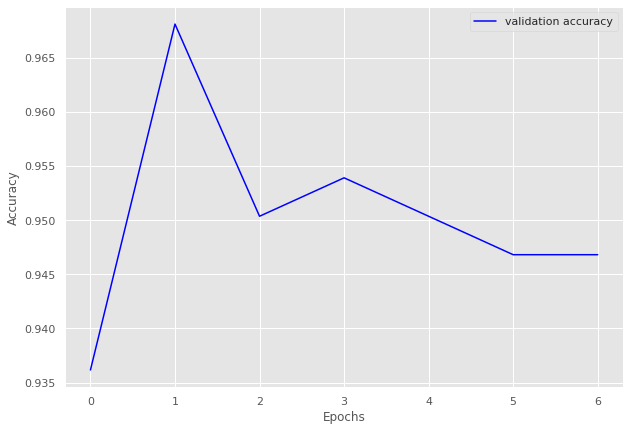

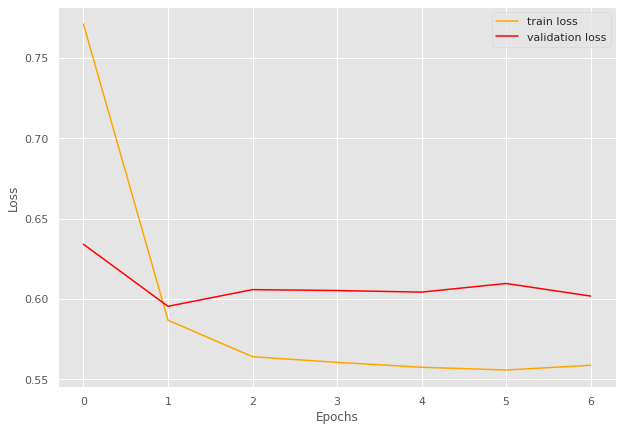

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 17 Epoch 1
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.97batch/s, loss=1.03]


train loss 1.032730057835579, validation loss 0.8800747513771057, validation accuracy 0.8673139158576052
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.809]


train loss 0.8090929627418518, validation loss 0.8449994921684265, validation accuracy 0.9061488673139159
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.04batch/s, loss=0.773]


train loss 0.7726548582315445, validation loss 0.8229630470275879, validation accuracy 0.919093851132686
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.769]


INFO: Early stopping counter 1 of 5
train loss 0.7689526617527008, validation loss 0.8275503635406494, validation accuracy 0.919093851132686
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.763]


train loss 0.7625866502523422, validation loss 0.8160787224769592, validation accuracy 0.9288025889967637
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.00batch/s, loss=0.753]


train loss 0.752670606970787, validation loss 0.8010456085205078, validation accuracy 0.9449838187702265
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.97batch/s, loss=0.753]


INFO: Early stopping counter 2 of 5
train loss 0.7525380581617356, validation loss 0.8114215970039368, validation accuracy 0.9385113268608414
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.755]


INFO: Early stopping counter 3 of 5
train loss 0.7551814168691635, validation loss 0.807954740524292, validation accuracy 0.9352750809061489
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.01batch/s, loss=0.755]


INFO: Early stopping counter 4 of 5
train loss 0.7551796406507492, validation loss 0.8193262934684753, validation accuracy 0.9158576051779935
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.00batch/s, loss=0.755]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9254084264832331 and loss 0.8156432558412421


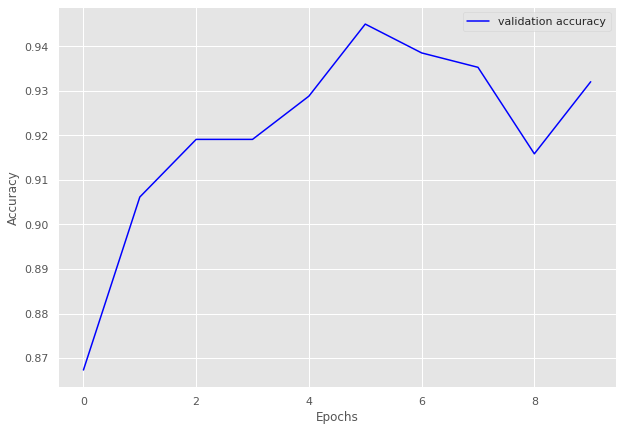

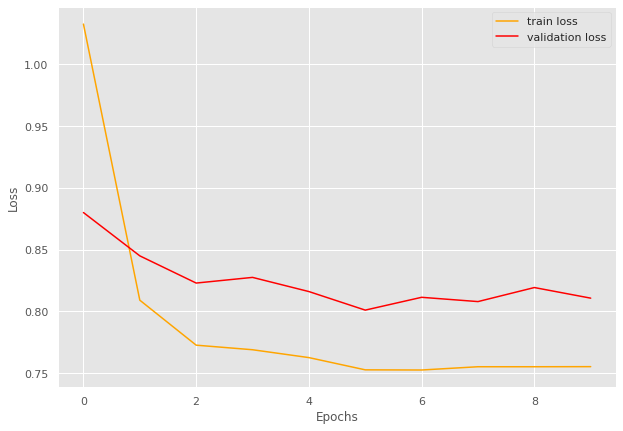

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 19 Epoch 1
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.30batch/s, loss=1.25]


train loss 1.2503937653132848, validation loss 0.9986931085586548, validation accuracy 0.8020833333333334
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.33batch/s, loss=0.882]


train loss 0.8815345934459141, validation loss 0.8420560956001282, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.34batch/s, loss=0.778]


train loss 0.7784485050610134, validation loss 0.812900185585022, validation accuracy 0.9375
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.32batch/s, loss=0.776]


train loss 0.7758785826819283, validation loss 0.7985028624534607, validation accuracy 0.9375
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.29batch/s, loss=0.764]


INFO: Early stopping counter 1 of 5
train loss 0.7637632489204407, validation loss 0.8046030402183533, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.35batch/s, loss=0.77] 


INFO: Early stopping counter 2 of 5
train loss 0.7699025358472552, validation loss 0.8022337257862091, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.33batch/s, loss=0.753]


INFO: Early stopping counter 3 of 5
train loss 0.7533052904265267, validation loss 0.8233048319816589, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.34batch/s, loss=0.761]


INFO: Early stopping counter 4 of 5
train loss 0.7611989549228123, validation loss 0.8184779584407806, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.35batch/s, loss=0.774]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9150815217391305 and loss 0.8299102835033251


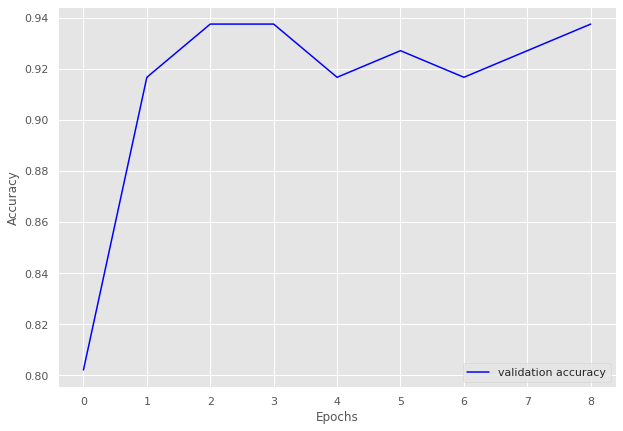

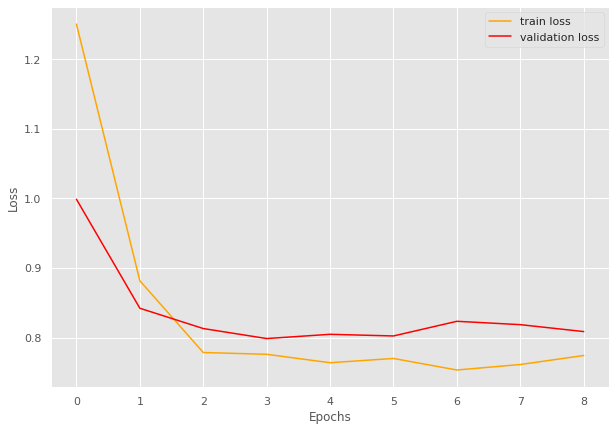

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Evaluating fine model 0
Evaluating fine model 1
Evaluating fine model 2
Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16
Evaluating fine model 17
Evaluating fine model 19
overall accuracy  is 0.7681315852016161
{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.93423053527980

Calculating for volume 35
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 41/41 [00:31<00:00,  1.31batch/s, loss=1.14]


train loss 1.1406459212303162, validation loss 1.0039696182523454, validation accuracy 0.9044289044289044
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:16<00:00,  2.47batch/s, loss=0.965]


train loss 0.9648173218820153, validation loss 0.9826529622077942, validation accuracy 0.9184149184149184
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=0.947]


train loss 0.9474301061979155, validation loss 0.968315201146262, validation accuracy 0.9393939393939394
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=0.942]


INFO: Early stopping counter 1 of 5
train loss 0.9424500697996558, validation loss 0.9817637290273394, validation accuracy 0.9277389277389277
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.935]


train loss 0.9348327808263825, validation loss 0.9652355653899056, validation accuracy 0.9393939393939394
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.97batch/s, loss=0.935]


INFO: Early stopping counter 2 of 5
train loss 0.9349970483198399, validation loss 0.9691386989184788, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.89batch/s, loss=0.93] 


INFO: Early stopping counter 3 of 5
train loss 0.9303402842544928, validation loss 0.9731037361281258, validation accuracy 0.9300699300699301
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.93] 


INFO: Early stopping counter 4 of 5
train loss 0.9296697014715614, validation loss 0.9759530850819179, validation accuracy 0.9277389277389277
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.84batch/s, loss=0.932]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9427046263345196 and loss 0.9613241729411212


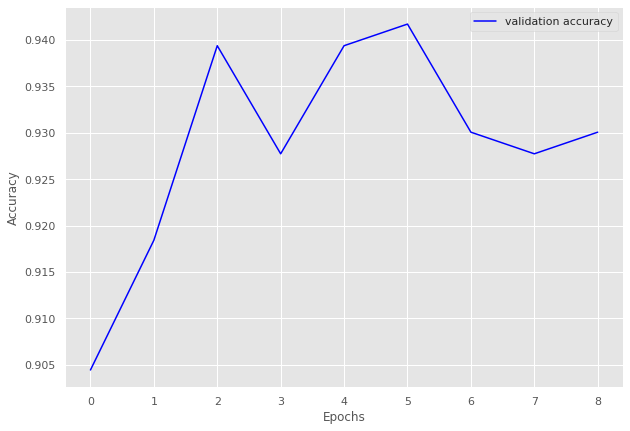

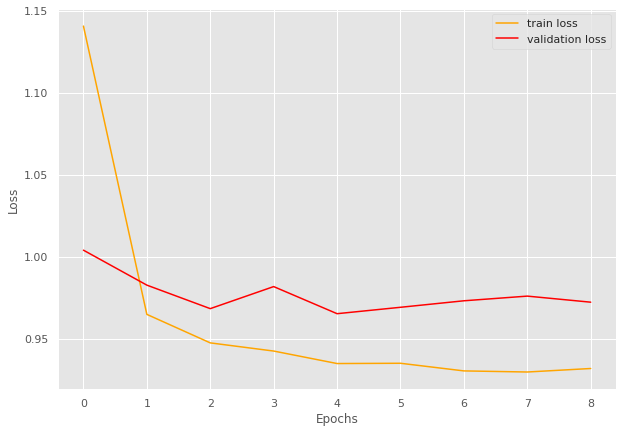

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 1 Epoch 1
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.92batch/s, loss=1.38]


train loss 1.380230016178555, validation loss 1.1527410348256428, validation accuracy 0.8978494623655914
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.97batch/s, loss=1.11]


train loss 1.113515900241004, validation loss 1.1008416016896565, validation accuracy 0.956989247311828
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.99batch/s, loss=1.07]


train loss 1.0740591221385531, validation loss 1.0974316596984863, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.82batch/s, loss=1.06]


train loss 1.0616351697180006, validation loss 1.0877286593119304, validation accuracy 0.9623655913978495
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.98batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.061079250441657, validation loss 1.0930893818537395, validation accuracy 0.956989247311828
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.96batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.0533185601234436, validation loss 1.092305024464925, validation accuracy 0.956989247311828
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.96batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0549733704990811, validation loss 1.0997284650802612, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.97batch/s, loss=1.05]


train loss 1.049938956896464, validation loss 1.0870387156804402, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.00batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0498968495262995, validation loss 1.0933020114898682, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.01batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9632202697180221 and loss 1.0819421456410334


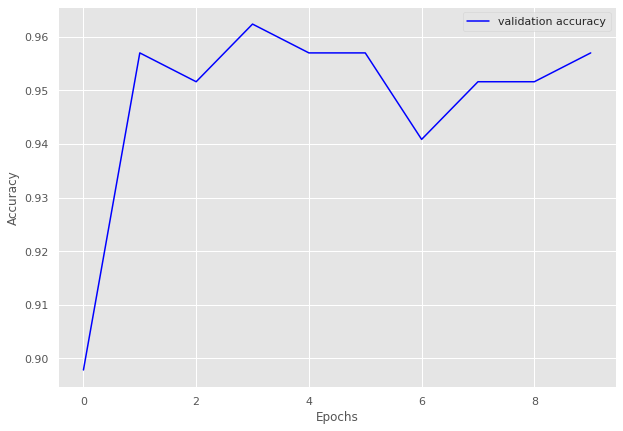

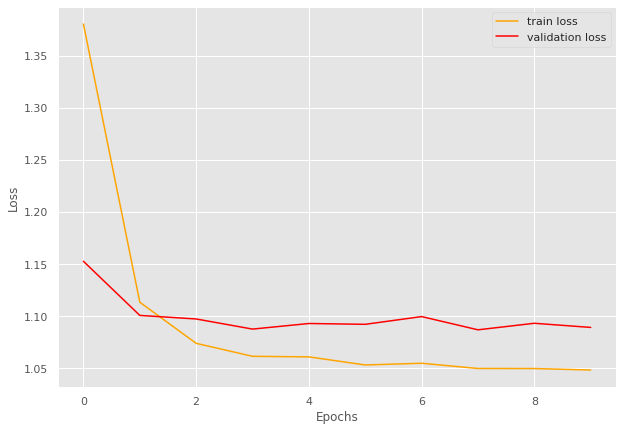

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 2 Epoch 1
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.92batch/s, loss=1.73]


train loss 1.7268428644502019, validation loss 1.5638316529137748, validation accuracy 0.903448275862069
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.95batch/s, loss=1.55]


train loss 1.5455505302153438, validation loss 1.539473899773189, validation accuracy 0.9241379310344827
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.92batch/s, loss=1.52]


train loss 1.5235108869621552, validation loss 1.5324280602591378, validation accuracy 0.9321839080459771
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.92batch/s, loss=1.51]


train loss 1.5115411195410304, validation loss 1.5217350125312805, validation accuracy 0.9402298850574713
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.92batch/s, loss=1.5] 


train loss 1.49851667450135, validation loss 1.5133099811417716, validation accuracy 0.9517241379310345
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.93batch/s, loss=1.5] 


INFO: Early stopping counter 1 of 5
train loss 1.4969662040112965, validation loss 1.5194692015647888, validation accuracy 0.9436781609195403
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.94batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4929756428821976, validation loss 1.5280234813690186, validation accuracy 0.9379310344827586
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.93batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.4920118960989528, validation loss 1.5150789618492126, validation accuracy 0.9471264367816092
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.94batch/s, loss=1.49]


INFO: Early stopping counter 4 of 5
train loss 1.4876017742846386, validation loss 1.5196139131273543, validation accuracy 0.9425287356321839
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.95batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9407894736842105 and loss 1.5214126569598747


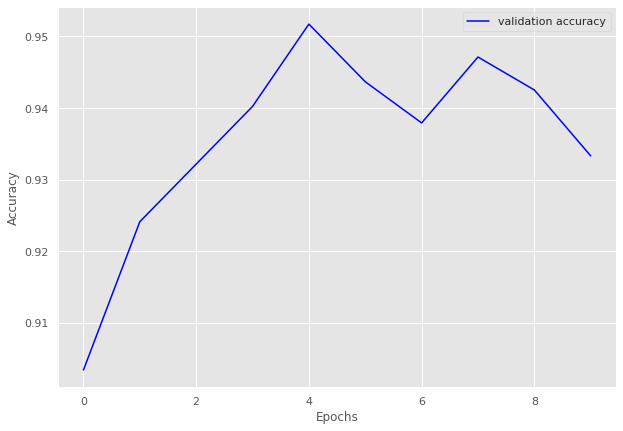

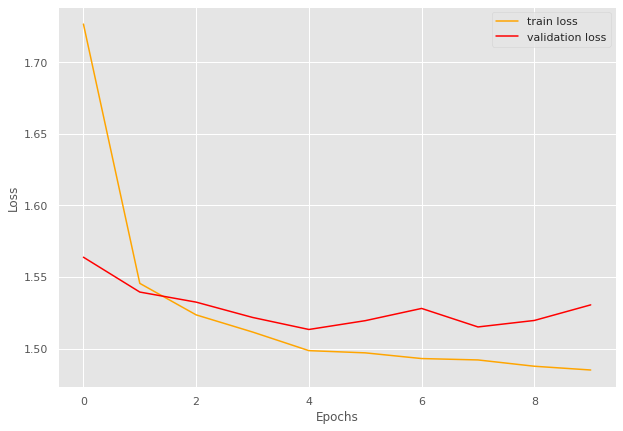

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9407894736842105
Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.96batch/s, loss=1.31]


train loss 1.3115457999400604, validation loss 1.1641809940338135, validation accuracy 0.8737864077669902
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.85batch/s, loss=1.11]


train loss 1.1148274861849272, validation loss 1.129119566508702, validation accuracy 0.9174757281553398
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.98batch/s, loss=1.09]


train loss 1.086433572646899, validation loss 1.1179334606443132, validation accuracy 0.9296116504854369
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.07631678153307, validation loss 1.1202113117490495, validation accuracy 0.9271844660194175
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.94batch/s, loss=1.07]


train loss 1.0712309281031291, validation loss 1.1083189930234636, validation accuracy 0.9441747572815534
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.92batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0673698217440875, validation loss 1.1199407577514648, validation accuracy 0.9296116504854369
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0637835600437262, validation loss 1.1116669007710047, validation accuracy 0.9368932038834952
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0595651926138463, validation loss 1.1126797710146223, validation accuracy 0.9320388349514563
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9403345724907063 and loss 1.1056314454359166


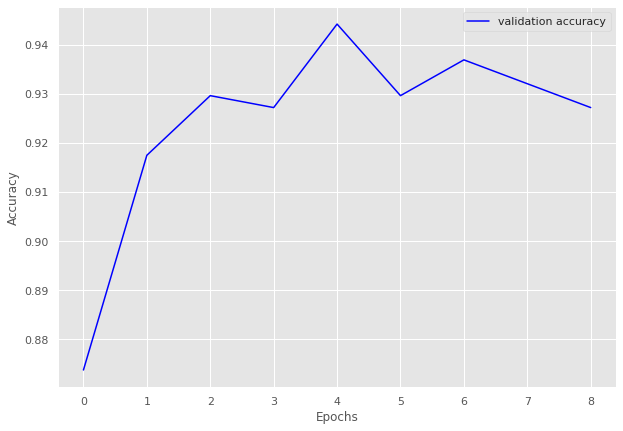

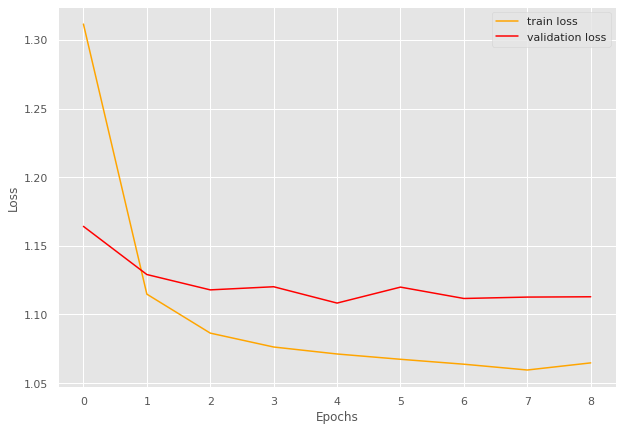

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.83batch/s, loss=0.446]


train loss 0.44557015697161356, validation loss 0.3360049029191335, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.87batch/s, loss=0.33] 


train loss 0.3299771547317505, validation loss 0.3213527301947276, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.92batch/s, loss=0.32] 


train loss 0.3199352661768595, validation loss 0.32134703795115155, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.86batch/s, loss=0.316]


INFO: Early stopping counter 1 of 5
train loss 0.31641138593355816, validation loss 0.32487929860750836, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.87batch/s, loss=0.319]


INFO: Early stopping counter 2 of 5
train loss 0.31920727491378786, validation loss 0.33058223128318787, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.95batch/s, loss=0.314]


INFO: Early stopping counter 3 of 5
train loss 0.3144497533639272, validation loss 0.3254586160182953, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.90batch/s, loss=0.314]


train loss 0.3137975414594015, validation loss 0.318893829981486, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.95batch/s, loss=0.314]


INFO: Early stopping counter 4 of 5
train loss 0.3140067140261332, validation loss 0.3189531664053599, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.92batch/s, loss=0.313]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9812319538017324 and loss 0.33133486726067285


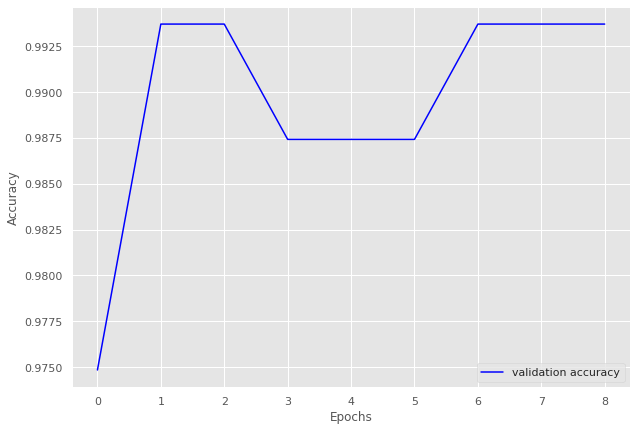

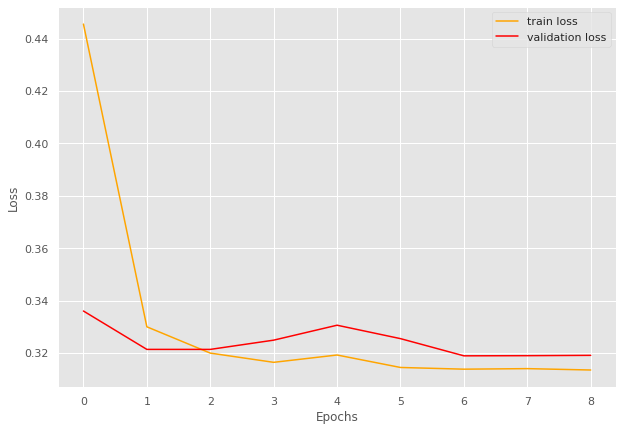

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 44/44 [00:15<00:00,  2.92batch/s, loss=1.42]


train loss 1.4158801707354458, validation loss 1.2565995156764984, validation accuracy 0.9008620689655172
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 44/44 [00:15<00:00,  2.92batch/s, loss=1.24]


train loss 1.2368033582513982, validation loss 1.2401532530784607, validation accuracy 0.9267241379310345
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.95batch/s, loss=1.22]


train loss 1.215319191867655, validation loss 1.220322772860527, validation accuracy 0.9418103448275862
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.94batch/s, loss=1.2]


INFO: Early stopping counter 1 of 5
train loss 1.2029504044489427, validation loss 1.2382606267929077, validation accuracy 0.915948275862069
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 44/44 [00:15<00:00,  2.92batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.1987025819041512, validation loss 1.2229927778244019, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.93batch/s, loss=1.2] 


INFO: Early stopping counter 3 of 5
train loss 1.1955646791241386, validation loss 1.2251893430948257, validation accuracy 0.9353448275862069
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.96batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.191812206398357, validation loss 1.2534363120794296, validation accuracy 0.9030172413793104
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 44/44 [00:15<00:00,  2.92batch/s, loss=1.2] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.939733245512926 and loss 1.2264871722773503


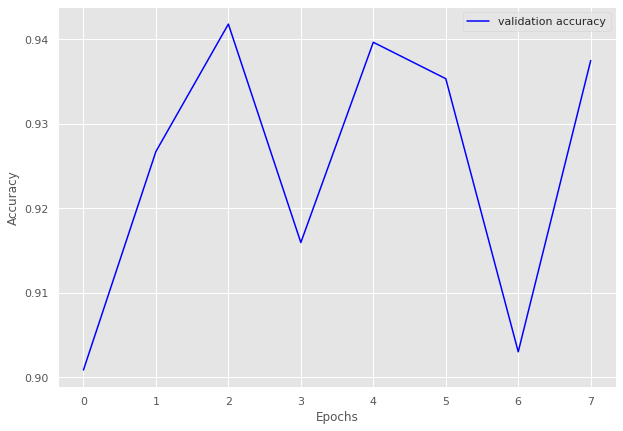

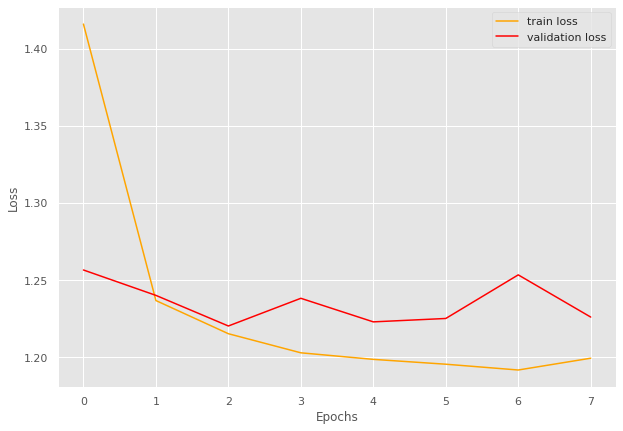

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.94batch/s, loss=0.891]


train loss 0.8914333547864641, validation loss 0.7778039773305258, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.94batch/s, loss=0.771]


train loss 0.7709747774260385, validation loss 0.7661068737506866, validation accuracy 0.977961432506887
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.94batch/s, loss=0.768]


train loss 0.7684188757623945, validation loss 0.763381173213323, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.93batch/s, loss=0.76] 


INFO: Early stopping counter 1 of 5
train loss 0.7602099640028818, validation loss 0.7709426283836365, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 35/35 [00:15<00:00,  2.30batch/s, loss=0.756]


INFO: Early stopping counter 2 of 5
train loss 0.7561473284448896, validation loss 0.7734410663445791, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.94batch/s, loss=0.754]


INFO: Early stopping counter 3 of 5
train loss 0.7537912470953805, validation loss 0.7746042410532633, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.95batch/s, loss=0.754]


INFO: Early stopping counter 4 of 5
train loss 0.7541835801942008, validation loss 0.7652368048826853, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.93batch/s, loss=0.759]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9766463286345466 and loss 0.767521300315857


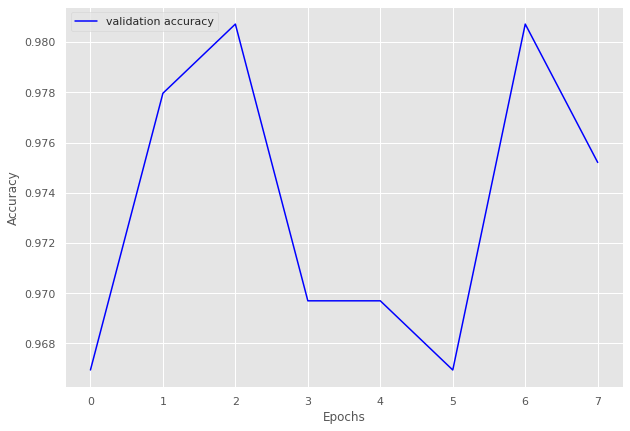

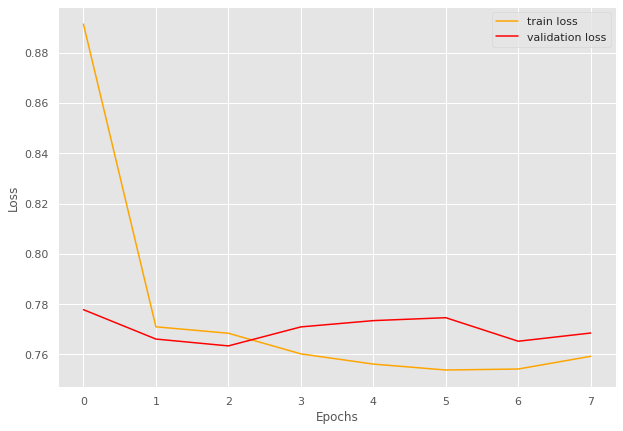

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=1.46]


train loss 1.4557146198895512, validation loss 1.2757351100444794, validation accuracy 0.9021526418786693
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.90batch/s, loss=1.24]


train loss 1.2439598501945028, validation loss 1.2481564730405807, validation accuracy 0.9197651663405088
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=1.22]


train loss 1.2187998148859764, validation loss 1.2298217862844467, validation accuracy 0.9412915851272016
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=1.21]


INFO: Early stopping counter 1 of 5
train loss 1.205958468573434, validation loss 1.241742193698883, validation accuracy 0.923679060665362
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.2023808104651315, validation loss 1.2447964698076248, validation accuracy 0.9217221135029354
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.93batch/s, loss=1.21]


INFO: Early stopping counter 3 of 5
train loss 1.2071586336408342, validation loss 1.2487605661153793, validation accuracy 0.9178082191780822
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=1.2] 


train loss 1.1967755507449716, validation loss 1.2288499474525452, validation accuracy 0.9412915851272016
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.96batch/s, loss=1.19]


train loss 1.1901775282256457, validation loss 1.2262990176677704, validation accuracy 0.9412915851272016
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.192287099604704, validation loss 1.236628606915474, validation accuracy 0.9275929549902152
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.97batch/s, loss=1.18]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9366481952972892 and loss 1.2300672996611821


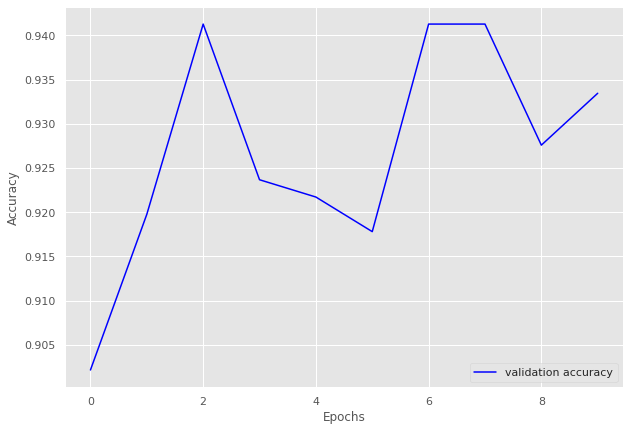

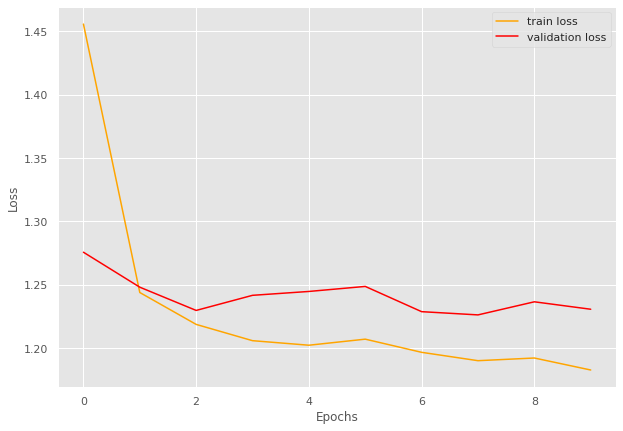

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.90batch/s, loss=1.73]


train loss 1.734527247851012, validation loss 1.583673899823969, validation accuracy 0.9104938271604939
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.88batch/s, loss=1.54]


train loss 1.5443460784974645, validation loss 1.54966769435189, validation accuracy 0.9228395061728395
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.89batch/s, loss=1.51]


train loss 1.5146619609144867, validation loss 1.53620492328297, validation accuracy 0.9459876543209876
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 61/61 [00:35<00:00,  1.74batch/s, loss=1.5] 


INFO: Early stopping counter 1 of 5
train loss 1.503784701472423, validation loss 1.54121242869984, validation accuracy 0.9367283950617284
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 61/61 [00:42<00:00,  1.44batch/s, loss=1.5] 


train loss 1.5003296684046261, validation loss 1.5280019044876099, validation accuracy 0.9506172839506173
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 61/61 [00:47<00:00,  1.30batch/s, loss=1.49]


train loss 1.491724473531129, validation loss 1.5231003544547341, validation accuracy 0.9506172839506173
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 61/61 [00:46<00:00,  1.31batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4876254718811786, validation loss 1.534234274517406, validation accuracy 0.9598765432098766
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 61/61 [00:30<00:00,  2.02batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.4902036307287998, validation loss 1.5375375097448176, validation accuracy 0.9490740740740741
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 61/61 [00:30<00:00,  2.03batch/s, loss=1.48]


train loss 1.4839130503232363, validation loss 1.5117370865561746, validation accuracy 0.9567901234567902
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.81batch/s, loss=1.48]


train loss 1.4822297975665233, validation loss 1.5065587867390027, validation accuracy 0.9552469135802469
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.80batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4834767638659867, validation loss 1.5144043618982488, validation accuracy 0.9552469135802469
Coarse label 9 Epoch 12
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.88batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9444181646168401 and loss 1.5175858252030565


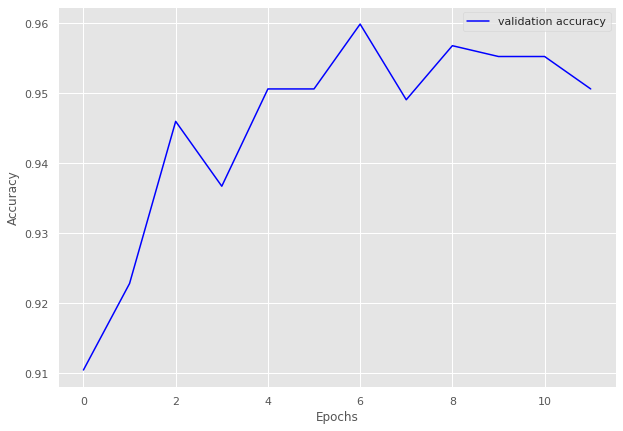

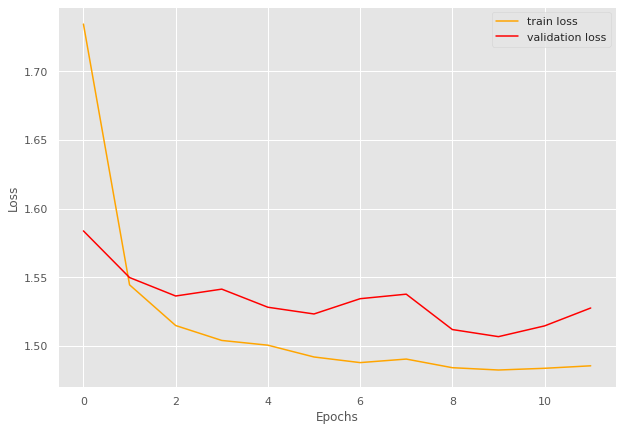

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.91batch/s, loss=0.906]


train loss 0.9055338234737002, validation loss 0.7888557434082031, validation accuracy 0.9506578947368421
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.91batch/s, loss=0.773]


train loss 0.7734686506205591, validation loss 0.7719741821289062, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 29/29 [00:10<00:00,  2.89batch/s, loss=0.761]


train loss 0.7610431889007832, validation loss 0.7674519300460816, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.94batch/s, loss=0.755]


INFO: Early stopping counter 1 of 5
train loss 0.7552405513566116, validation loss 0.7770548105239868, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.91batch/s, loss=0.753]


INFO: Early stopping counter 2 of 5
train loss 0.7529133023886845, validation loss 0.7780474424362183, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 29/29 [00:10<00:00,  2.90batch/s, loss=0.755]


INFO: Early stopping counter 3 of 5
train loss 0.7553921198022777, validation loss 0.7688544869422913, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.91batch/s, loss=0.753]


INFO: Early stopping counter 4 of 5
train loss 0.753261923789978, validation loss 0.7685125946998597, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.97batch/s, loss=0.755]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9708981435022579 and loss 0.7738672438121977


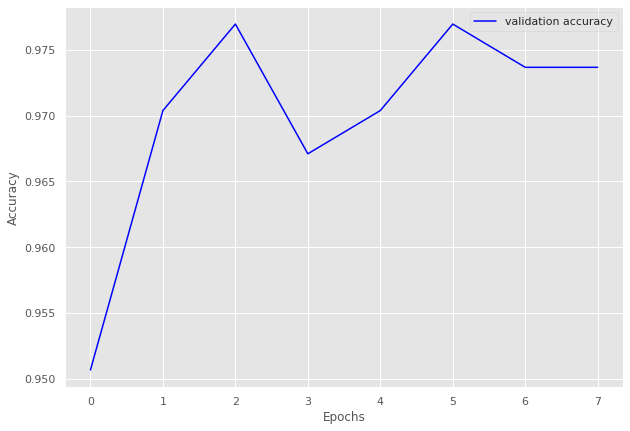

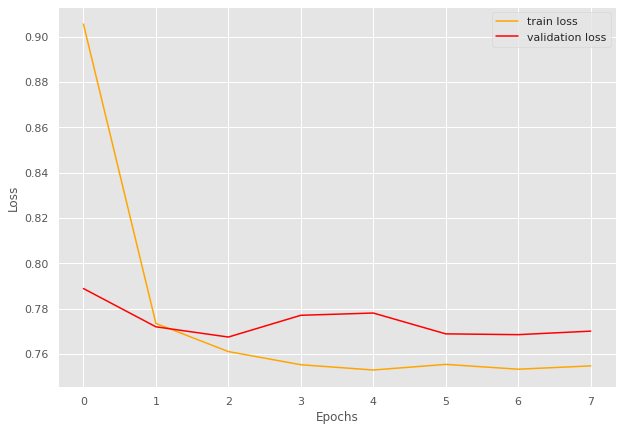

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=1.41]


train loss 1.4105040303298406, validation loss 1.1584298372268678, validation accuracy 0.896551724137931
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.02batch/s, loss=1.13]


train loss 1.1316951257841927, validation loss 1.121272349357605, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=1.1] 


INFO: Early stopping counter 1 of 5
train loss 1.0988764124257224, validation loss 1.1289190769195556, validation accuracy 0.9103448275862069
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.01batch/s, loss=1.08]


train loss 1.078363231250218, validation loss 1.1092294931411744, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=1.08]


INFO: Early stopping counter 2 of 5
train loss 1.0769038540976388, validation loss 1.1104113817214967, validation accuracy 0.9344827586206896
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.00batch/s, loss=1.08]


train loss 1.0758938193321228, validation loss 1.108751130104065, validation accuracy 0.9310344827586207
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=1.07]


train loss 1.0713608520371574, validation loss 1.0983625888824462, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0677211327212197, validation loss 1.1074292182922363, validation accuracy 0.9310344827586207
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.0661644424710954, validation loss 1.0989461660385131, validation accuracy 0.9482758620689655
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9244292836525846 and loss 1.1199775417645772


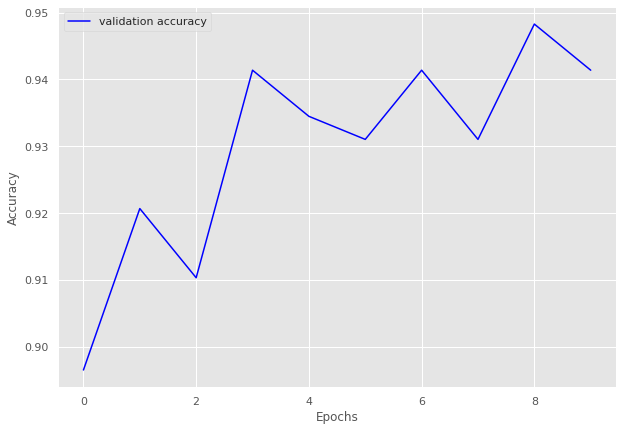

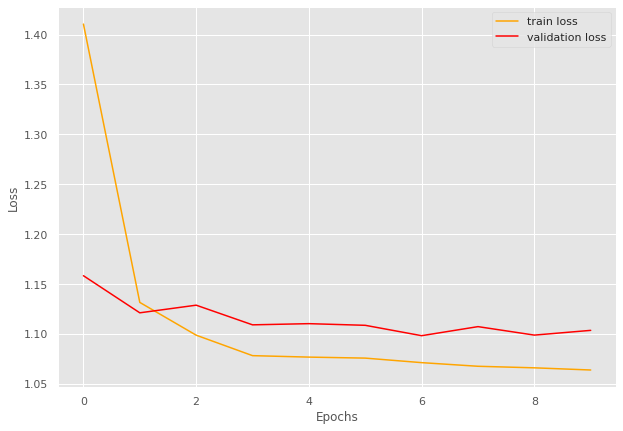

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.98batch/s, loss=0.718]


train loss 0.7183494925498962, validation loss 0.6110859513282776, validation accuracy 0.9227799227799228
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.96batch/s, loss=0.594]


train loss 0.5936893939971923, validation loss 0.5998358368873596, validation accuracy 0.9382239382239382
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.01batch/s, loss=0.582]


train loss 0.5820701551437378, validation loss 0.5973465204238891, validation accuracy 0.9420849420849421
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.97batch/s, loss=0.574]


train loss 0.574064486026764, validation loss 0.591805899143219, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.99batch/s, loss=0.568]


train loss 0.5678778862953187, validation loss 0.5856644749641419, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.99batch/s, loss=0.567]


INFO: Early stopping counter 1 of 5
train loss 0.5666808962821961, validation loss 0.5897929668426514, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.01batch/s, loss=0.567]


INFO: Early stopping counter 2 of 5
train loss 0.5673670244216918, validation loss 0.5910220503807068, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.97batch/s, loss=0.563]


INFO: Early stopping counter 3 of 5
train loss 0.5633103275299072, validation loss 0.58598712682724, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.01batch/s, loss=0.561]


INFO: Early stopping counter 4 of 5
train loss 0.5606441330909729, validation loss 0.590430212020874, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 10
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.99batch/s, loss=0.559]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9461856889414547 and loss 0.6035456477471117


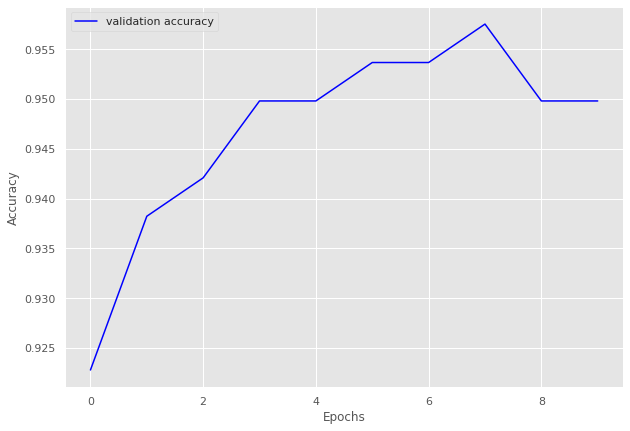

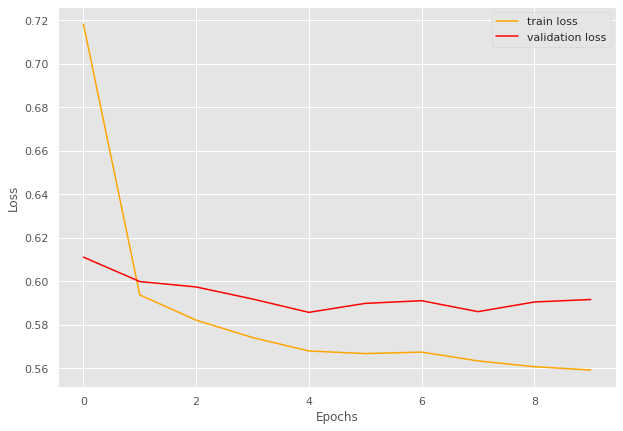

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.91batch/s, loss=1.21]


train loss 1.214990877679416, validation loss 1.1062210559844972, validation accuracy 0.9444444444444444
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.90batch/s, loss=1.09]


train loss 1.0912102035113744, validation loss 1.0933710098266602, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.93batch/s, loss=1.08]


train loss 1.075655690261296, validation loss 1.0863195776939392, validation accuracy 0.9595959595959596
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.88batch/s, loss=1.07]


train loss 1.066892806972776, validation loss 1.0768609642982483, validation accuracy 0.9663299663299664
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 56/56 [00:21<00:00,  2.58batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0626088700124197, validation loss 1.0825916647911071, validation accuracy 0.968013468013468
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.90batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.060778530580657, validation loss 1.0768642902374268, validation accuracy 0.9696969696969697
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.91batch/s, loss=1.06]


train loss 1.061841415507453, validation loss 1.07645343542099, validation accuracy 0.9713804713804713
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.92batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0624828998531615, validation loss 1.0769914746284486, validation accuracy 0.968013468013468
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0582155265978404, validation loss 1.0803910851478578, validation accuracy 0.968013468013468
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9595412962247133 and loss 1.0840245113998164


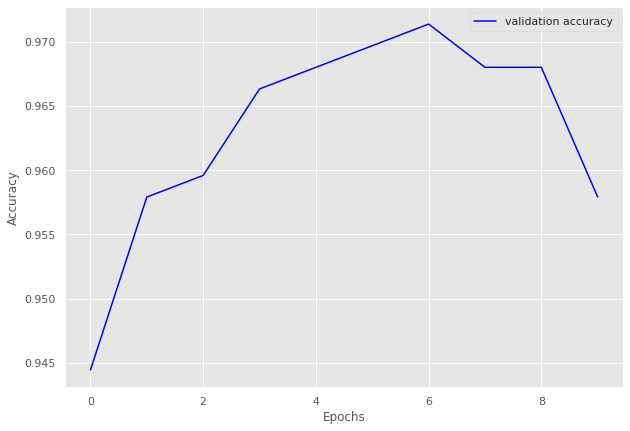

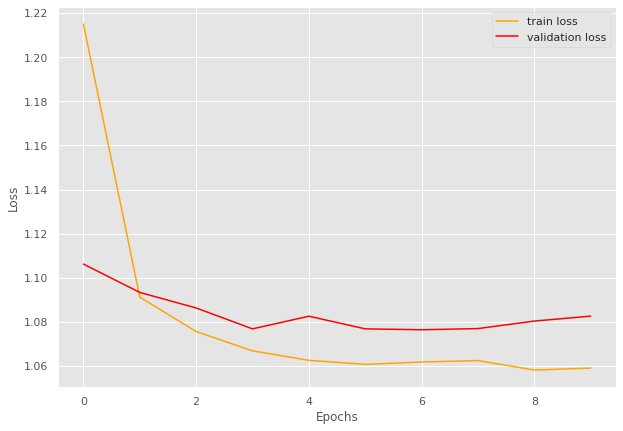

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9595412962247133
Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=0.959]


train loss 0.9593024807316917, validation loss 0.815293264389038, validation accuracy 0.9421768707482994
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=0.776]


train loss 0.7758027464151382, validation loss 0.7998903036117554, validation accuracy 0.9421768707482994
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=0.761]


train loss 0.7613536779369626, validation loss 0.7869690537452698, validation accuracy 0.95578231292517
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=0.755]


INFO: Early stopping counter 1 of 5
train loss 0.7546700324331012, validation loss 0.7929556608200073, validation accuracy 0.95578231292517
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=0.758]


train loss 0.7579238734075001, validation loss 0.7847978472709656, validation accuracy 0.9591836734693877
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.92batch/s, loss=0.751]


train loss 0.7506065496376583, validation loss 0.780122697353363, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=0.75] 


INFO: Early stopping counter 2 of 5
train loss 0.7498219098363604, validation loss 0.7904484033584595, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=0.749]


INFO: Early stopping counter 3 of 5
train loss 0.7487897532326835, validation loss 0.7807034850120544, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=0.75] 


INFO: Early stopping counter 4 of 5
train loss 0.7503616682120732, validation loss 0.7869158506393432, validation accuracy 0.95578231292517
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=0.748]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9668753260302556 and loss 0.7774937073389689


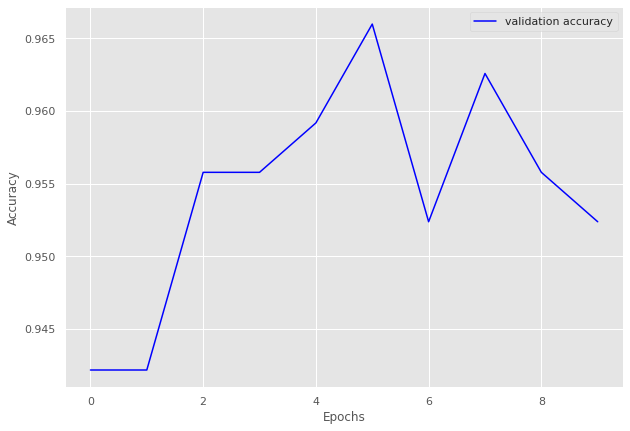

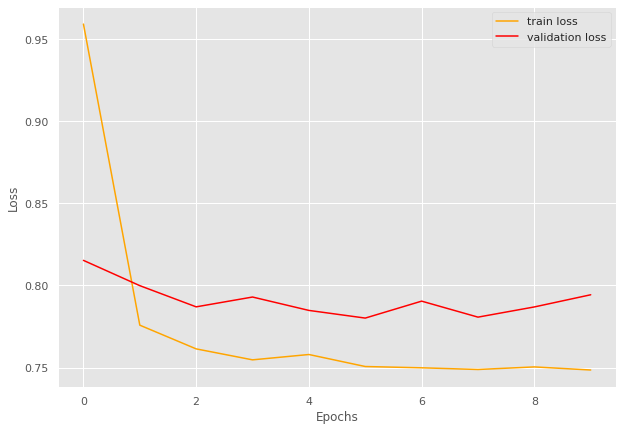

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.78batch/s, loss=0.717]


train loss 0.7167636685901217, validation loss 0.6109590768814087, validation accuracy 0.9397163120567376
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.95batch/s, loss=0.582]


train loss 0.5823454856872559, validation loss 0.6009273529052734, validation accuracy 0.950354609929078
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.99batch/s, loss=0.57] 


train loss 0.5696682687158938, validation loss 0.5850136160850525, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.98batch/s, loss=0.566]


INFO: Early stopping counter 1 of 5
train loss 0.5661645597881741, validation loss 0.5901993870735168, validation accuracy 0.9609929078014184
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.96batch/s, loss=0.567]


train loss 0.5673218325332359, validation loss 0.5803034424781799, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.96batch/s, loss=0.564]


INFO: Early stopping counter 2 of 5
train loss 0.5640384510711387, validation loss 0.5959497332572937, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.96batch/s, loss=0.559]


INFO: Early stopping counter 3 of 5
train loss 0.5590734305205168, validation loss 0.5986413598060608, validation accuracy 0.9609929078014184
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.99batch/s, loss=0.56] 


INFO: Early stopping counter 4 of 5
train loss 0.5603496653062326, validation loss 0.5828732967376709, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.98batch/s, loss=0.558]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9575971731448764 and loss 0.5927979493963307


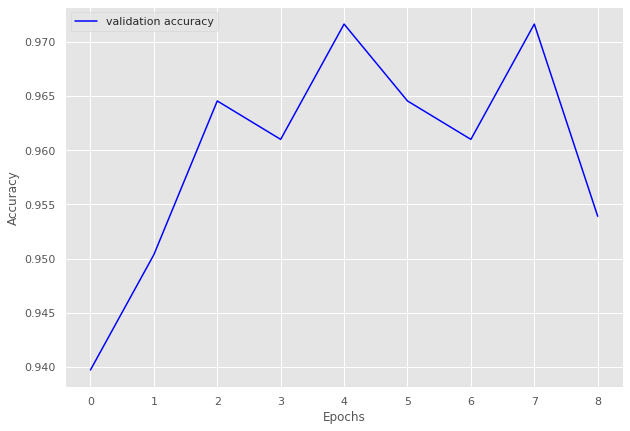

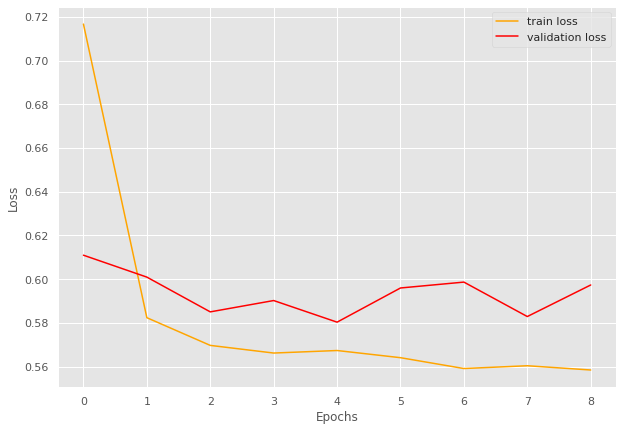

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 17 Epoch 1
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.02batch/s, loss=0.987]


train loss 0.9874286452929179, validation loss 0.8438886404037476, validation accuracy 0.9061488673139159
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.02batch/s, loss=0.805]


train loss 0.8049368361632029, validation loss 0.8408600568771363, validation accuracy 0.9061488673139159
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=0.778]


train loss 0.7784536182880402, validation loss 0.8270783662796021, validation accuracy 0.919093851132686
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=0.772]


train loss 0.772139048576355, validation loss 0.8170516490936279, validation accuracy 0.9288025889967637
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.764]


train loss 0.7642485121885936, validation loss 0.8116570472717285, validation accuracy 0.9288025889967637
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.00batch/s, loss=0.767]


INFO: Early stopping counter 1 of 5
train loss 0.7666602154572805, validation loss 0.8193906545639038, validation accuracy 0.9288025889967637
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  3.00batch/s, loss=0.785]


train loss 0.7851948062578837, validation loss 0.8085578322410584, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.96batch/s, loss=0.781]


INFO: Early stopping counter 2 of 5
train loss 0.7807076533635458, validation loss 0.8288012504577636, validation accuracy 0.919093851132686
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.02batch/s, loss=0.782]


INFO: Early stopping counter 3 of 5
train loss 0.7816819787025452, validation loss 0.811135756969452, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.777]


INFO: Early stopping counter 4 of 5
train loss 0.777352754275004, validation loss 0.813775110244751, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 11
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.771]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9503968253968254 and loss 0.7951590702647254


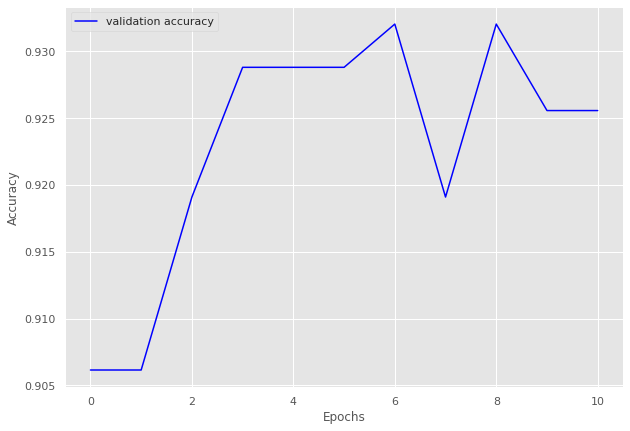

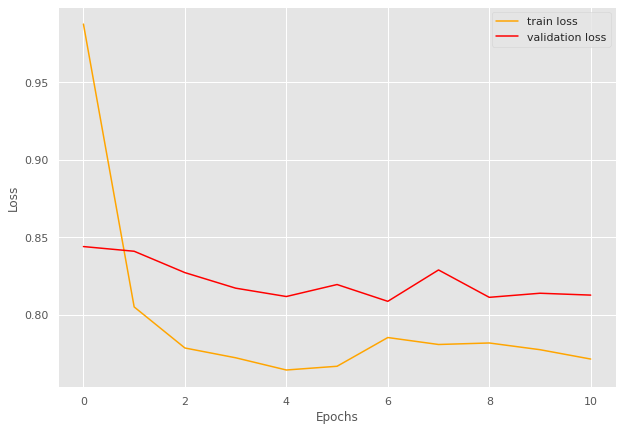

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 19 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.14batch/s, loss=1.13]


train loss 1.1298797070980071, validation loss 0.9618319869041443, validation accuracy 0.8020833333333334
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.82]


train loss 0.8200619399547577, validation loss 0.8160803914070129, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=0.77]


train loss 0.7701584279537201, validation loss 0.7953851222991943, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.20batch/s, loss=0.756]


train loss 0.7555076003074646, validation loss 0.7909409403800964, validation accuracy 0.9375
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.772]


train loss 0.7723437964916229, validation loss 0.7871461510658264, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.756]


INFO: Early stopping counter 1 of 5
train loss 0.7562417030334473, validation loss 0.8011423647403717, validation accuracy 0.9375
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.08batch/s, loss=0.757]


train loss 0.757354485988617, validation loss 0.785110354423523, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=0.75]


train loss 0.749766743183136, validation loss 0.7830338478088379, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.757]


INFO: Early stopping counter 2 of 5
train loss 0.7572111308574676, validation loss 0.7861327230930328, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.21batch/s, loss=0.748]


train loss 0.7475662350654602, validation loss 0.7823517918586731, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.22batch/s, loss=0.744]


train loss 0.744423222541809, validation loss 0.7790248990058899, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 12
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.06batch/s, loss=0.751]


train loss 0.7506092548370361, validation loss 0.7760347127914429, validation accuracy 0.96875
Coarse label 19 Epoch 13
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.21batch/s, loss=0.748]


INFO: Early stopping counter 3 of 5
train loss 0.7475514709949493, validation loss 0.8048189878463745, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 14
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.7505024433135986, validation loss 0.8011676073074341, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 15
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.11batch/s, loss=0.756]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9075235109717869 and loss 0.8375097036361694


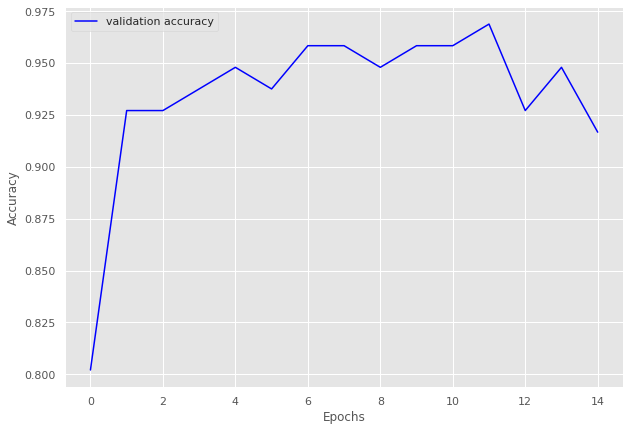

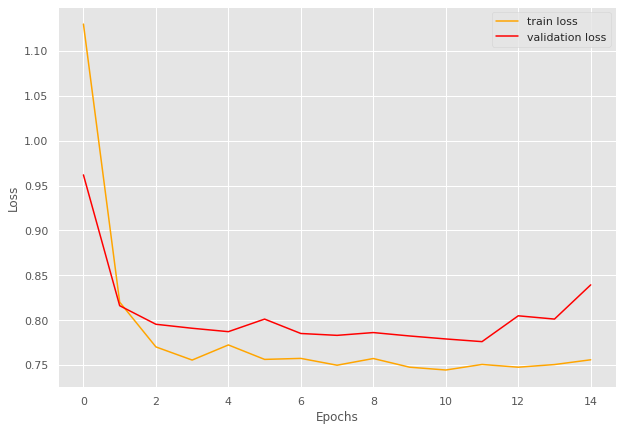

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Evaluating fine model 0
Evaluating fine model 1
Evaluating fine model 2
Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16
Evaluating fine model 17
Evaluating fine model 19
overall accuracy  is 0.7504255732385838
{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.93423053527980

Calculating for volume 55
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.90batch/s, loss=1.08]


train loss 1.075616485932294, validation loss 0.9726471730640956, validation accuracy 0.9324009324009324
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.89batch/s, loss=0.96] 


train loss 0.9601644251276465, validation loss 0.9543456435203552, validation accuracy 0.9487179487179487
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.948]


train loss 0.9484882302143994, validation loss 0.9543272597449166, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.92batch/s, loss=0.942]


INFO: Early stopping counter 1 of 5
train loss 0.942375140155063, validation loss 0.955184987613133, validation accuracy 0.9440559440559441
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.935]


train loss 0.9349197298288345, validation loss 0.949830174446106, validation accuracy 0.9557109557109557
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.936]


INFO: Early stopping counter 2 of 5
train loss 0.9358109419836718, validation loss 0.9580330763544355, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.935]


INFO: Early stopping counter 3 of 5
train loss 0.9352539321955513, validation loss 0.9573596545628139, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.92batch/s, loss=0.932]


INFO: Early stopping counter 4 of 5
train loss 0.931761185035986, validation loss 0.9597804205758231, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.91batch/s, loss=0.93] 


train loss 0.930047523449449, validation loss 0.9417537791388375, validation accuracy 0.965034965034965
Coarse label 0 Epoch 10
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.929]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9524788081171334 and loss 0.9512901833800019


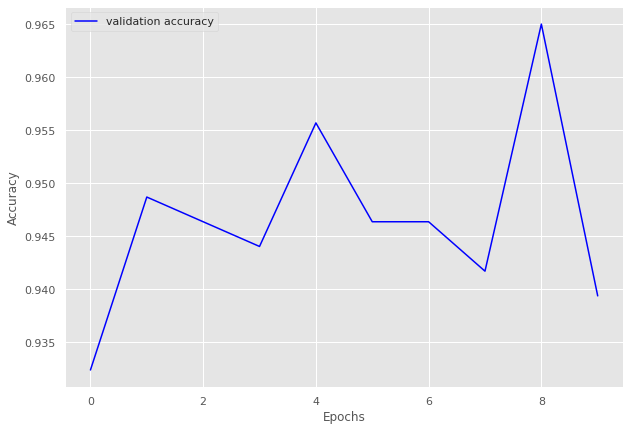

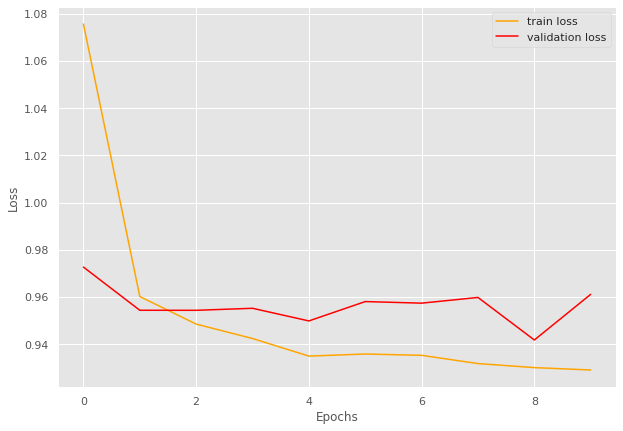

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 1 Epoch 1
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.28]


train loss 1.2808958570162454, validation loss 1.1101200977961223, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=1.1] 


train loss 1.0951492110888164, validation loss 1.095875342686971, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.95batch/s, loss=1.08]


train loss 1.07621511220932, validation loss 1.090539574623108, validation accuracy 0.956989247311828
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.06]


train loss 1.0637766043345134, validation loss 1.0742913881937664, validation accuracy 0.967741935483871
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0577486594518026, validation loss 1.0844715436299641, validation accuracy 0.956989247311828
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.94batch/s, loss=1.05]


train loss 1.0543315490086873, validation loss 1.072658658027649, validation accuracy 0.978494623655914
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.94batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.054845937093099, validation loss 1.0788342952728271, validation accuracy 0.967741935483871
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:13<00:00,  2.27batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.058148157596588, validation loss 1.0832510789235432, validation accuracy 0.9623655913978495
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.95batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.052025067806244, validation loss 1.0901590585708618, validation accuracy 0.946236559139785
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  3.00batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9693396226415094 and loss 1.0743413501315646


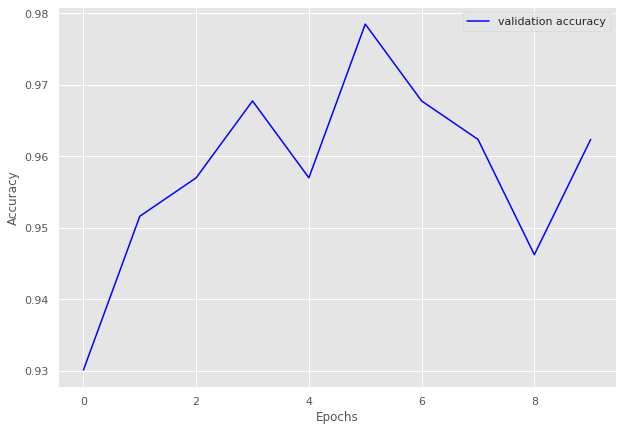

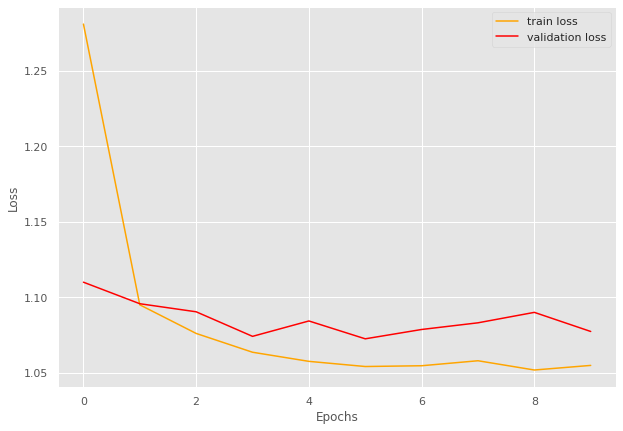

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 2 Epoch 1
-------------------------------


100%|██████████| 137/137 [00:49<00:00,  2.76batch/s, loss=1.67]


train loss 1.669904456521473, validation loss 1.5699380380766732, validation accuracy 0.9045977011494253
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.54]


train loss 1.5381999276850344, validation loss 1.534367561340332, validation accuracy 0.9287356321839081
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 137/137 [00:46<00:00,  2.92batch/s, loss=1.52]


INFO: Early stopping counter 1 of 5
train loss 1.515317405227327, validation loss 1.5350211773599898, validation accuracy 0.9298850574712644
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 137/137 [00:46<00:00,  2.92batch/s, loss=1.51]


INFO: Early stopping counter 2 of 5
train loss 1.507994954603432, validation loss 1.5384064657347543, validation accuracy 0.9275862068965517
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.89batch/s, loss=1.5]


train loss 1.5035366246300021, validation loss 1.5225864052772522, validation accuracy 0.9413793103448276
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 137/137 [00:46<00:00,  2.92batch/s, loss=1.49]


train loss 1.4947186369095407, validation loss 1.5215137771197729, validation accuracy 0.9413793103448276
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.49]


train loss 1.493252566261013, validation loss 1.5104747670037406, validation accuracy 0.9528735632183908
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 137/137 [00:46<00:00,  2.92batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.4949783782889372, validation loss 1.5243237444332667, validation accuracy 0.9390804597701149
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.49]


INFO: Early stopping counter 4 of 5
train loss 1.4900318793136709, validation loss 1.5172992859567915, validation accuracy 0.9505747126436782
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.89batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9495755732927911 and loss 1.5116525494283246


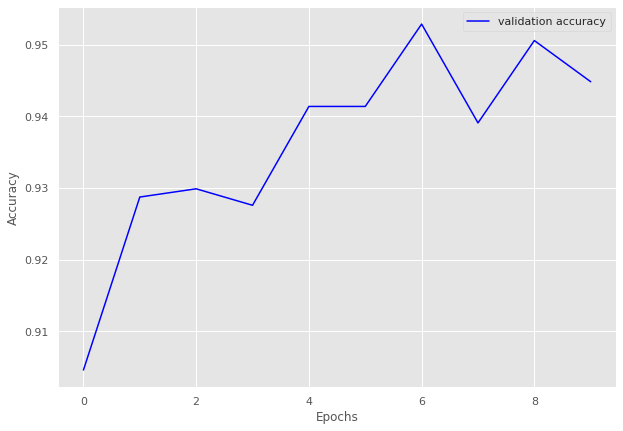

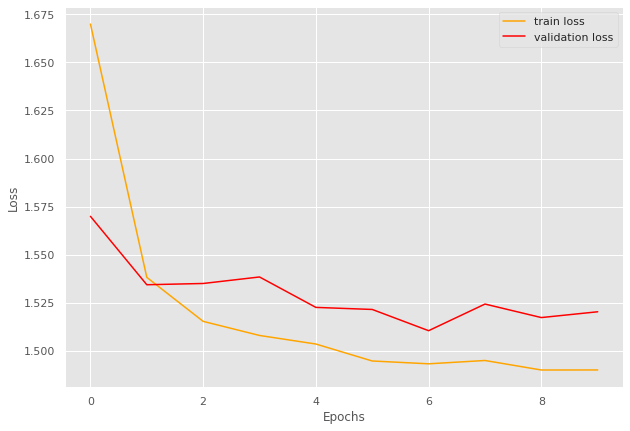

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9495755732927911
Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=1.26]


train loss 1.2589471688637366, validation loss 1.1137770925249373, validation accuracy 0.9344660194174758
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.91batch/s, loss=1.11]


train loss 1.1083612111898569, validation loss 1.0950902700424194, validation accuracy 0.9490291262135923
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.94batch/s, loss=1.09]


train loss 1.0884717812904945, validation loss 1.0861115115029472, validation accuracy 0.9538834951456311
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.93batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0746064552894006, validation loss 1.0900511401040214, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=1.06]


train loss 1.063318784420307, validation loss 1.0851512125560216, validation accuracy 0.9611650485436893
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0645240765351516, validation loss 1.0860975640160697, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.071063758776738, validation loss 1.0857741662434168, validation accuracy 0.9611650485436893
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.98batch/s, loss=1.06]


train loss 1.0615277712161724, validation loss 1.0740008183888026, validation accuracy 0.970873786407767
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0617214349599986, validation loss 1.0741621596472604, validation accuracy 0.970873786407767
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.97batch/s, loss=1.06]


train loss 1.0575090316625742, validation loss 1.0735400744846888, validation accuracy 0.970873786407767
Coarse label 4 Epoch 11
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=1.06]


train loss 1.0575965111072247, validation loss 1.0667131798607963, validation accuracy 0.9757281553398058
Coarse label 4 Epoch 12
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=1.06]


train loss 1.0568837294211755, validation loss 1.0653468540736608, validation accuracy 0.9781553398058253
Coarse label 4 Epoch 13
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.94batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9629729004561309 and loss 1.081735214944613


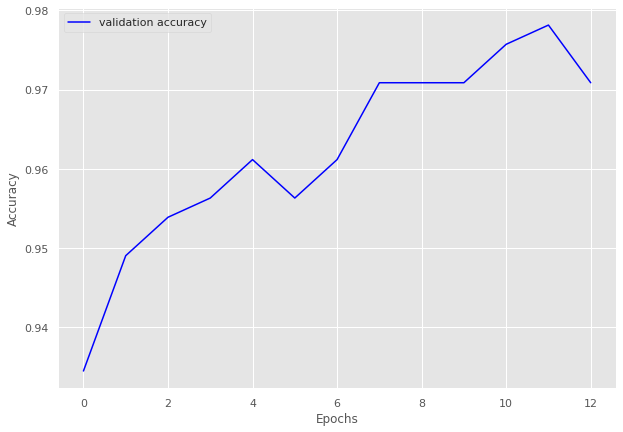

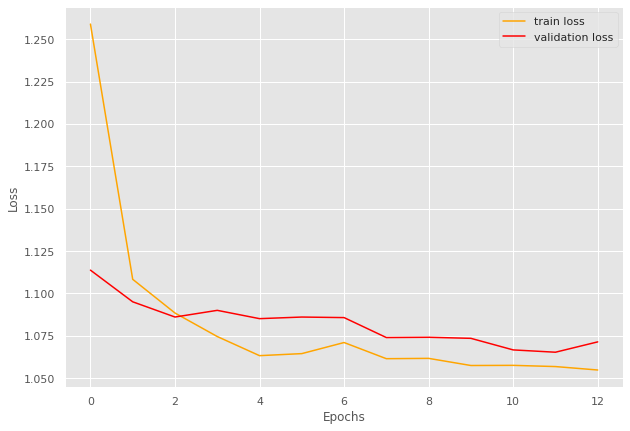

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.83batch/s, loss=0.396]


train loss 0.395559983253479, validation loss 0.34360090891520184, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.92batch/s, loss=0.326]


train loss 0.3257952332496643, validation loss 0.34238000710805255, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.89batch/s, loss=0.322]


INFO: Early stopping counter 1 of 5
train loss 0.322075297832489, validation loss 0.34302032987276715, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.91batch/s, loss=0.318]


train loss 0.31847346186637876, validation loss 0.3360762099424998, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.91batch/s, loss=0.319]


train loss 0.3185426306724548, validation loss 0.3356634279092153, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.91batch/s, loss=0.319]


INFO: Early stopping counter 2 of 5
train loss 0.3186244928836823, validation loss 0.3379181921482086, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.88batch/s, loss=0.317]


train loss 0.31671924352645875, validation loss 0.33553842703501385, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.94batch/s, loss=0.315]


INFO: Early stopping counter 3 of 5
train loss 0.3148858916759491, validation loss 0.3420879741509755, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.89batch/s, loss=0.316]


train loss 0.3163234877586365, validation loss 0.3320837914943695, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 10
-------------------------------


100%|██████████| 25/25 [00:09<00:00,  2.77batch/s, loss=0.316]


INFO: Early stopping counter 4 of 5
train loss 0.316127268075943, validation loss 0.3459719916184743, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 11
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.92batch/s, loss=0.317]


train loss 0.31748396158218384, validation loss 0.3279975752035777, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 12
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.94batch/s, loss=0.315]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9847116052814454 and loss 0.32752063611279364


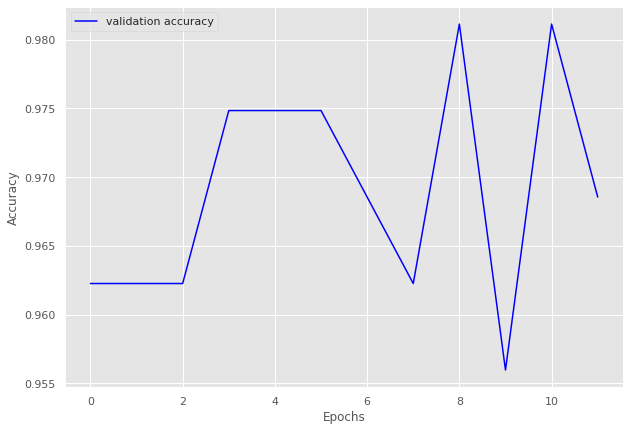

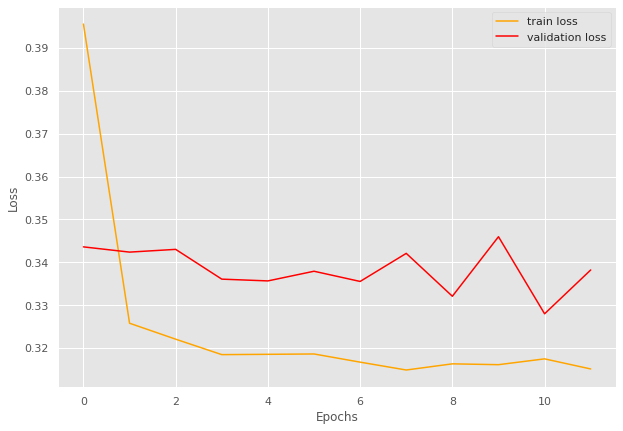

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 73/73 [00:31<00:00,  2.35batch/s, loss=1.35]


train loss 1.3522863877962714, validation loss 1.243149146437645, validation accuracy 0.9245689655172413
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 73/73 [00:47<00:00,  1.54batch/s, loss=1.24]


train loss 1.23539341639166, validation loss 1.2136252671480179, validation accuracy 0.9482758620689655
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 73/73 [00:58<00:00,  1.24batch/s, loss=1.21]


train loss 1.2129471171392154, validation loss 1.2123459577560425, validation accuracy 0.959051724137931
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 73/73 [00:58<00:00,  1.25batch/s, loss=1.21]


train loss 1.2058260800087288, validation loss 1.202565312385559, validation accuracy 0.9612068965517241
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 73/73 [00:32<00:00,  2.24batch/s, loss=1.2] 


INFO: Early stopping counter 1 of 5
train loss 1.1980987117715078, validation loss 1.2087516486644745, validation accuracy 0.9547413793103449
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.93batch/s, loss=1.19]


INFO: Early stopping counter 2 of 5
train loss 1.1944025477317914, validation loss 1.2051811665296555, validation accuracy 0.959051724137931
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 73/73 [00:25<00:00,  2.92batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.189988565771547, validation loss 1.2026222497224808, validation accuracy 0.9612068965517241
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.93batch/s, loss=1.19]


train loss 1.190451298674492, validation loss 1.2016491740942001, validation accuracy 0.9676724137931034
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.92batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1870074925357348, validation loss 1.2095773220062256, validation accuracy 0.959051724137931
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 73/73 [00:25<00:00,  2.92batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9576694411414982 and loss 1.2075350826436824


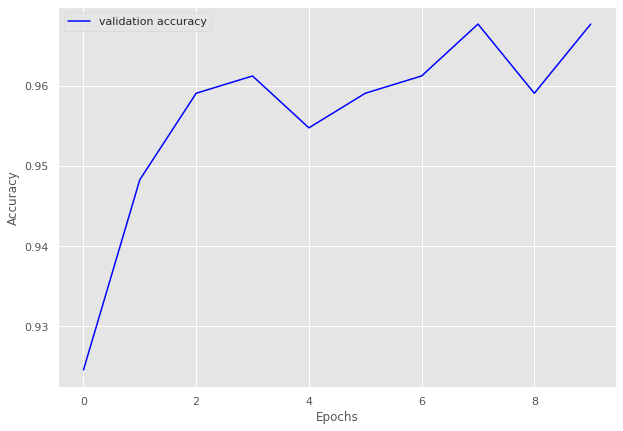

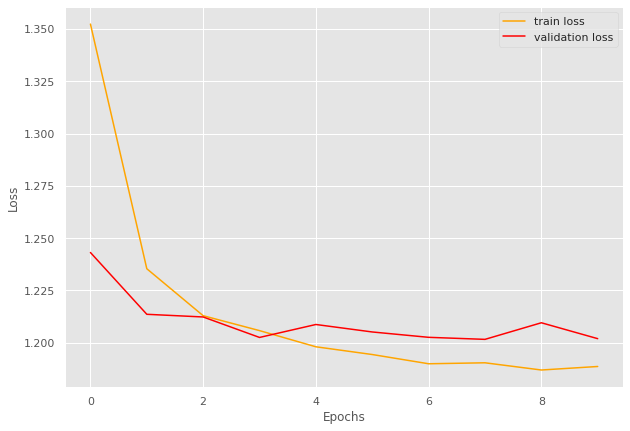

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.93batch/s, loss=0.846]


train loss 0.8461352072913071, validation loss 0.7747150758902231, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.95batch/s, loss=0.779]


INFO: Early stopping counter 1 of 5
train loss 0.7793762118651949, validation loss 0.7790027757485708, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.93batch/s, loss=0.769]


INFO: Early stopping counter 2 of 5
train loss 0.7687169375090763, validation loss 0.7755616009235382, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.94batch/s, loss=0.766]


train loss 0.7661243718245934, validation loss 0.7727406620979309, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.96batch/s, loss=0.765]


train loss 0.765207944245174, validation loss 0.771953672170639, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.95batch/s, loss=0.757]


INFO: Early stopping counter 3 of 5
train loss 0.7573335324895794, validation loss 0.7719650169213613, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.95batch/s, loss=0.756]


train loss 0.755573460768009, validation loss 0.7625909845034281, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.96batch/s, loss=0.753]


INFO: Early stopping counter 4 of 5
train loss 0.7531064358250849, validation loss 0.7638337314128876, validation accuracy 0.977961432506887
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.92batch/s, loss=0.753]


train loss 0.752538622453295, validation loss 0.7601140936215719, validation accuracy 0.9834710743801653
Coarse label 7 Epoch 10
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.97batch/s, loss=0.755]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.982685297691373 and loss 0.7611765082065876


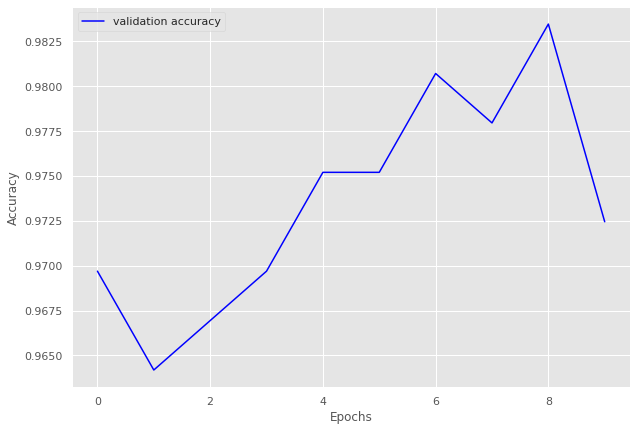

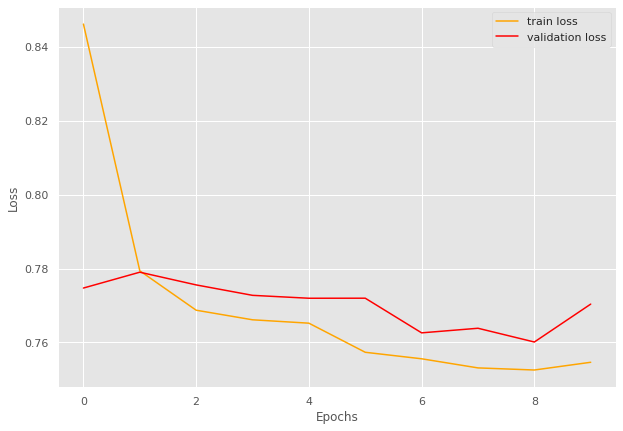

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.91batch/s, loss=1.39]


train loss 1.3855192749588578, validation loss 1.2522718757390976, validation accuracy 0.9158512720156555
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.24]


INFO: Early stopping counter 1 of 5
train loss 1.2425145322893874, validation loss 1.2557702511548996, validation accuracy 0.9060665362035225
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.23]


train loss 1.225917296645082, validation loss 1.24984772503376, validation accuracy 0.9119373776908023
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.21]


train loss 1.2133180565304227, validation loss 1.231939658522606, validation accuracy 0.9315068493150684
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.92batch/s, loss=1.21]


INFO: Early stopping counter 2 of 5
train loss 1.205149953747973, validation loss 1.2335354536771774, validation accuracy 0.9275929549902152
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.2]


train loss 1.203354071687769, validation loss 1.2283381521701813, validation accuracy 0.9393346379647749
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.92batch/s, loss=1.2]


train loss 1.1983369485831554, validation loss 1.2248563021421432, validation accuracy 0.9373776908023483
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.91batch/s, loss=1.19]


train loss 1.1944377024968464, validation loss 1.220878705382347, validation accuracy 0.9452054794520548
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 81/81 [00:28<00:00,  2.88batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.189183951895914, validation loss 1.2286086976528168, validation accuracy 0.9354207436399217
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.91batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1880800871201505, validation loss 1.2359688878059387, validation accuracy 0.9295499021526419
Coarse label 8 Epoch 11
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.92batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9463667820069204 and loss 1.2190674951631728


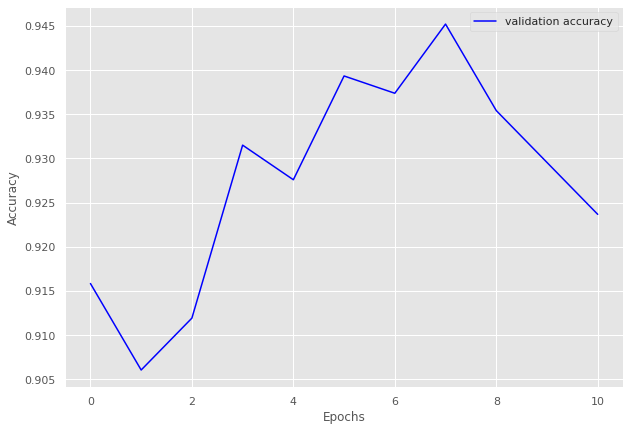

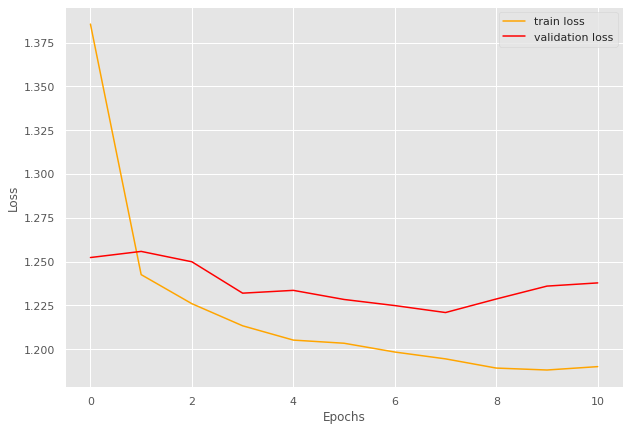

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 102/102 [00:34<00:00,  2.92batch/s, loss=1.66]


train loss 1.6645058323355282, validation loss 1.5745543133128772, validation accuracy 0.9074074074074074
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.90batch/s, loss=1.53]


train loss 1.5297903804218067, validation loss 1.5441462343389338, validation accuracy 0.9197530864197531
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.51]


train loss 1.5133146561828315, validation loss 1.5387440703131936, validation accuracy 0.9398148148148148
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.5]


INFO: Early stopping counter 1 of 5
train loss 1.502680524891498, validation loss 1.542270226912065, validation accuracy 0.9197530864197531
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.90batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4932858803692985, validation loss 1.5403191718188198, validation accuracy 0.9506172839506173
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.90batch/s, loss=1.49]


train loss 1.4908449918616051, validation loss 1.5262358297001233, validation accuracy 0.9382716049382716
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.89batch/s, loss=1.49]


train loss 1.4877811822236753, validation loss 1.5139160047877918, validation accuracy 0.9552469135802469
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 102/102 [00:38<00:00,  2.64batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.4879353245099385, validation loss 1.5421644991094416, validation accuracy 0.9398148148148148
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 102/102 [00:34<00:00,  2.92batch/s, loss=1.49]


INFO: Early stopping counter 4 of 5
train loss 1.4877280908472397, validation loss 1.5306976600126787, validation accuracy 0.9552469135802469
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.89batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9508196721311475 and loss 1.5116150716076726


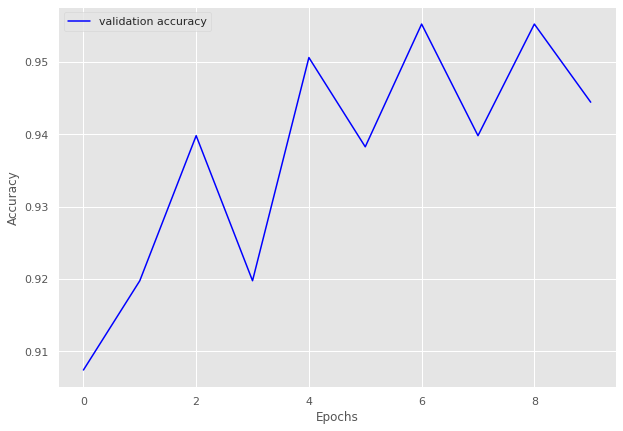

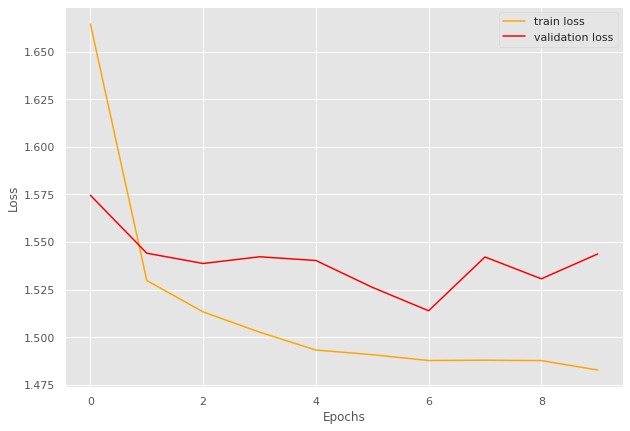

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.88batch/s, loss=0.866]


train loss 0.8661897939940294, validation loss 0.7733103632926941, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.90batch/s, loss=0.771]


train loss 0.7705118084947268, validation loss 0.7672861456871033, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.90batch/s, loss=0.756]


train loss 0.756203350921472, validation loss 0.7609501361846924, validation accuracy 0.9868421052631579
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.91batch/s, loss=0.752]


train loss 0.7522188350558281, validation loss 0.7606793403625488, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.90batch/s, loss=0.752]


INFO: Early stopping counter 1 of 5
train loss 0.7523988025883833, validation loss 0.7696314096450806, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.95batch/s, loss=0.75] 


INFO: Early stopping counter 2 of 5
train loss 0.7499326554437479, validation loss 0.7629371881484985, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.92batch/s, loss=0.754]


INFO: Early stopping counter 3 of 5
train loss 0.753779947757721, validation loss 0.770380687713623, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.91batch/s, loss=0.755]


INFO: Early stopping counter 4 of 5
train loss 0.7552050550778707, validation loss 0.7631734251976013, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.93batch/s, loss=0.751]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9826086956521739 and loss 0.761142382567579


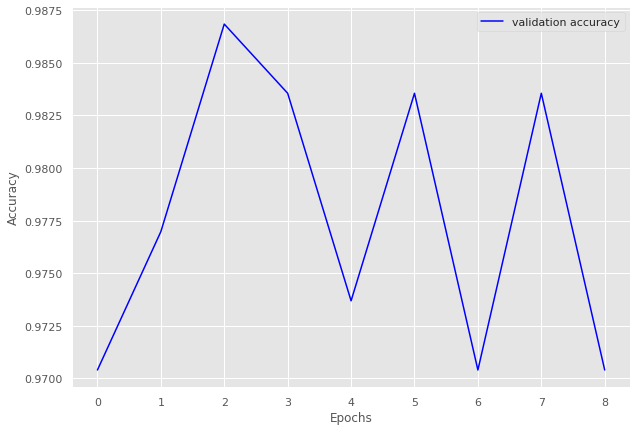

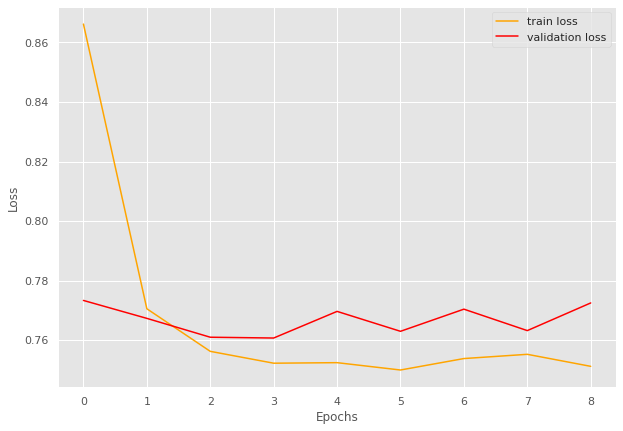

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9826086956521739
Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.97batch/s, loss=1.31]


train loss 1.3082349766855654, validation loss 1.14759202003479, validation accuracy 0.903448275862069
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.94batch/s, loss=1.12]


train loss 1.1180425053057463, validation loss 1.1325505018234252, validation accuracy 0.9137931034482759
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.94batch/s, loss=1.1] 


INFO: Early stopping counter 1 of 5
train loss 1.1042455512544382, validation loss 1.1377130031585694, validation accuracy 0.903448275862069
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.95batch/s, loss=1.1] 


train loss 1.098000951435255, validation loss 1.1267927646636964, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.93batch/s, loss=1.09]


train loss 1.091481626033783, validation loss 1.1256646871566773, validation accuracy 0.9172413793103448
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.97batch/s, loss=1.09]


train loss 1.0891223627588023, validation loss 1.1207046031951904, validation accuracy 0.9275862068965517
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.88batch/s, loss=1.09]


train loss 1.0865113890689353, validation loss 1.1085524797439574, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 46/46 [00:20<00:00,  2.20batch/s, loss=1.08]


INFO: Early stopping counter 2 of 5
train loss 1.0817611347074094, validation loss 1.1131736516952515, validation accuracy 0.9310344827586207
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 46/46 [00:26<00:00,  1.72batch/s, loss=1.08]


INFO: Early stopping counter 3 of 5
train loss 1.0802585042041282, validation loss 1.1108025074005128, validation accuracy 0.9344827586206896
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 46/46 [00:33<00:00,  1.39batch/s, loss=1.08]


INFO: Early stopping counter 4 of 5
train loss 1.0755497683649478, validation loss 1.1212531805038453, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 46/46 [00:33<00:00,  1.38batch/s, loss=1.07]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9412878787878788 and loss 1.1007515021732874


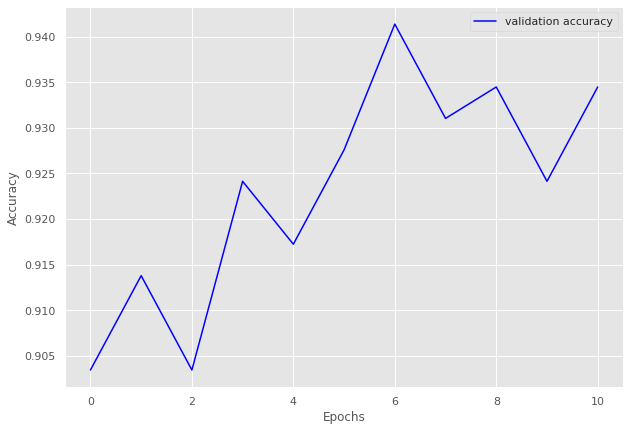

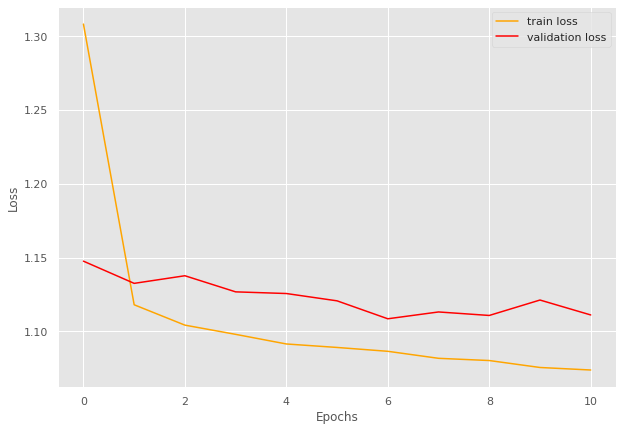

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 41/41 [00:29<00:00,  1.40batch/s, loss=0.68] 


train loss 0.6799509438072763, validation loss 0.6389109492301941, validation accuracy 0.9459459459459459
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:36<00:00,  1.11batch/s, loss=0.597]


train loss 0.5974115046059213, validation loss 0.5881587028503418, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:21<00:00,  1.90batch/s, loss=0.583]


train loss 0.5828246139898533, validation loss 0.5810176849365234, validation accuracy 0.9691119691119691
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:15<00:00,  2.71batch/s, loss=0.575]


INFO: Early stopping counter 1 of 5
train loss 0.5747204917233165, validation loss 0.5841870903968811, validation accuracy 0.9613899613899614
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.572]


INFO: Early stopping counter 2 of 5
train loss 0.5719129239640585, validation loss 0.5885562777519227, validation accuracy 0.9691119691119691
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.90batch/s, loss=0.567]


INFO: Early stopping counter 3 of 5
train loss 0.5667452506902741, validation loss 0.6435722351074219, validation accuracy 0.9691119691119691
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.568]


INFO: Early stopping counter 4 of 5
train loss 0.5675220038832688, validation loss 0.5856271386146545, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.569]


train loss 0.5690841529427505, validation loss 0.5728370308876037, validation accuracy 0.9768339768339769
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.96batch/s, loss=0.567]


train loss 0.5669441513898896, validation loss 0.5702334403991699, validation accuracy 0.9768339768339769
Coarse label 13 Epoch 10
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.89batch/s, loss=0.569]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9572832123024348 and loss 0.5947364890897596


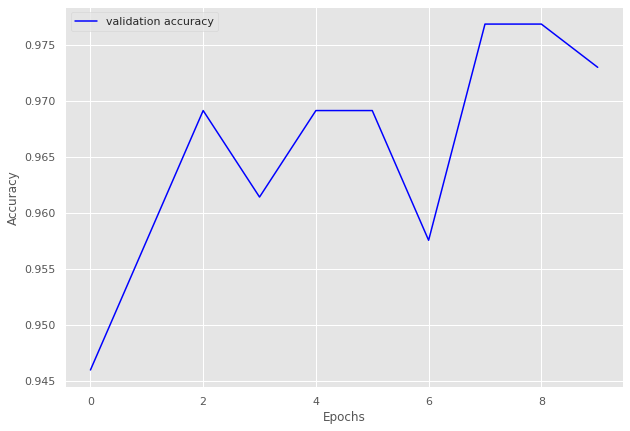

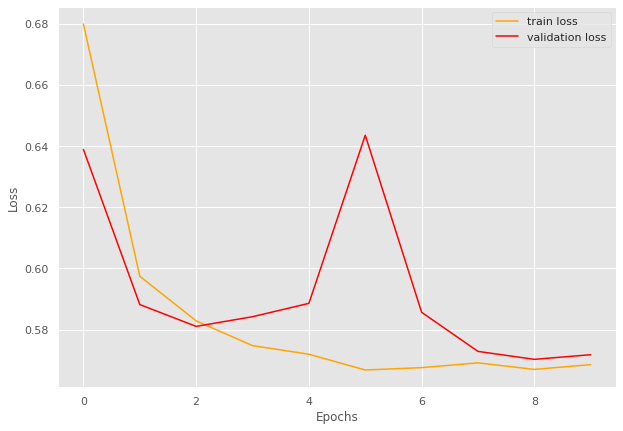

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.92batch/s, loss=1.17]


train loss 1.169292632569658, validation loss 1.0872541666030884, validation accuracy 0.9595959595959596
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.94batch/s, loss=1.08]


train loss 1.0827069929305544, validation loss 1.079763412475586, validation accuracy 0.9629629629629629
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.94batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0723759658793186, validation loss 1.0829358339309691, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.07]


train loss 1.069902368048404, validation loss 1.0693607449531555, validation accuracy 0.9730639730639731
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.94batch/s, loss=1.06]


train loss 1.0644144098809425, validation loss 1.0692432880401612, validation accuracy 0.9713804713804713
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0624163429787818, validation loss 1.076233434677124, validation accuracy 0.9696969696969697
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0624988459526223, validation loss 1.0759001135826112, validation accuracy 0.968013468013468
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0573663445229227, validation loss 1.0706090807914734, validation accuracy 0.9713804713804713
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.93batch/s, loss=1.06]


train loss 1.05564276588724, validation loss 1.0632718682289124, validation accuracy 0.9797979797979798
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.93batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9676279069767442 and loss 1.0759360250972567


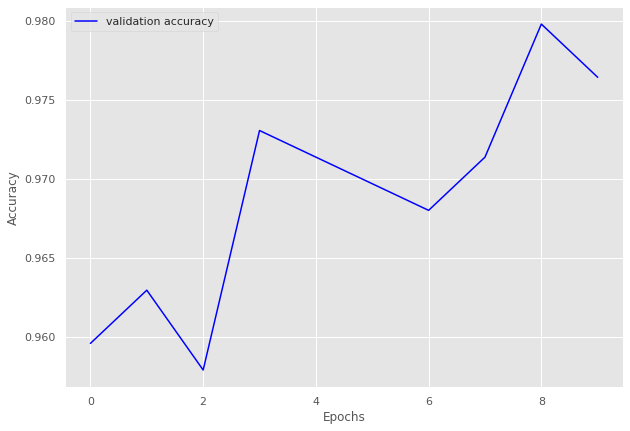

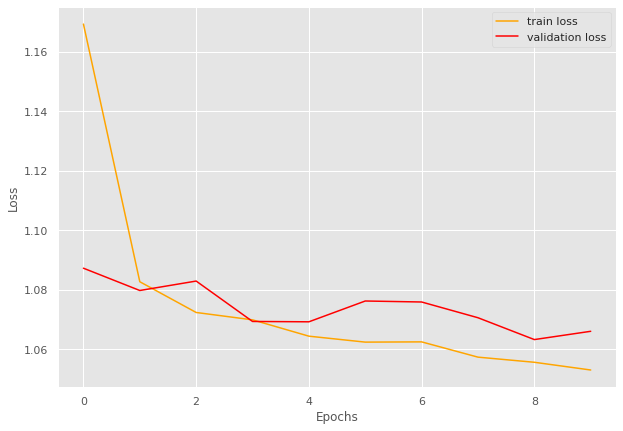

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.93batch/s, loss=0.897]


train loss 0.8972240825916858, validation loss 0.7956918716430664, validation accuracy 0.9421768707482994
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.96batch/s, loss=0.796]


train loss 0.7955768438095742, validation loss 0.7894946932792664, validation accuracy 0.95578231292517
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.99batch/s, loss=0.77] 


train loss 0.7697332488729599, validation loss 0.7840412378311157, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.97batch/s, loss=0.762]


train loss 0.7621812059524211, validation loss 0.7737704515457153, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.95batch/s, loss=0.761]


INFO: Early stopping counter 1 of 5
train loss 0.7607173805541181, validation loss 0.7787592887878418, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.97batch/s, loss=0.758]


INFO: Early stopping counter 2 of 5
train loss 0.7583858840008999, validation loss 0.7814956903457642, validation accuracy 0.9591836734693877
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.97batch/s, loss=0.76] 


train loss 0.7601340856957943, validation loss 0.7657402276992797, validation accuracy 0.9795918367346939
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.93batch/s, loss=0.755]


INFO: Early stopping counter 3 of 5
train loss 0.755110965130177, validation loss 0.7752249360084533, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.97batch/s, loss=0.752]


INFO: Early stopping counter 4 of 5
train loss 0.7521090368007092, validation loss 0.7721798658370972, validation accuracy 0.9761904761904762
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.96batch/s, loss=0.756]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9706103993971364 and loss 0.7731221389202845


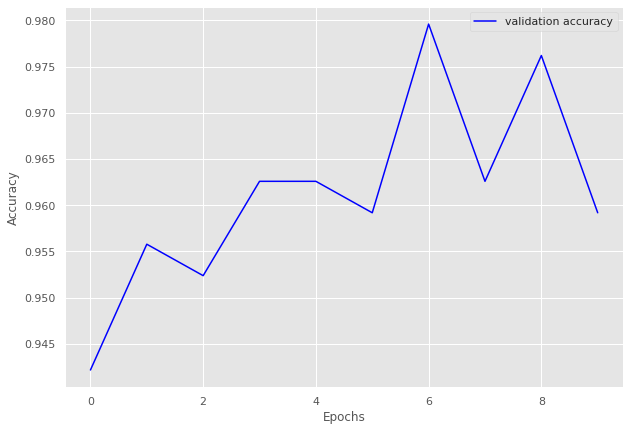

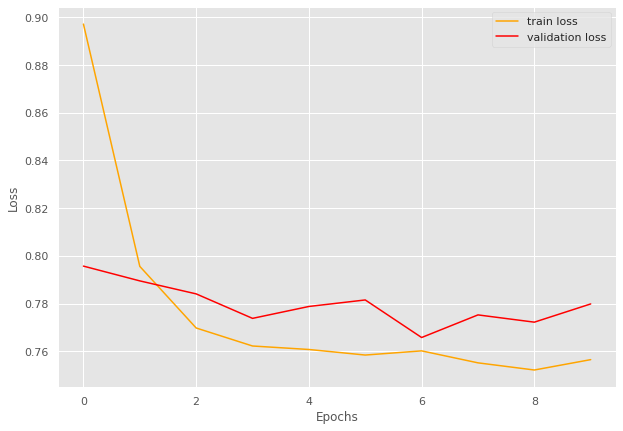

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 45/45 [00:14<00:00,  3.01batch/s, loss=0.672]


train loss 0.6716779934035407, validation loss 0.5881264925003051, validation accuracy 0.9609929078014184
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.97batch/s, loss=0.584]


train loss 0.584482995669047, validation loss 0.5800829768180847, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.99batch/s, loss=0.574]


INFO: Early stopping counter 1 of 5
train loss 0.5744080265363057, validation loss 0.5854775905609131, validation accuracy 0.9574468085106383
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.98batch/s, loss=0.578]


INFO: Early stopping counter 2 of 5
train loss 0.577724646197425, validation loss 0.586873197555542, validation accuracy 0.9539007092198581
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.97batch/s, loss=0.566]


train loss 0.5663338833385043, validation loss 0.5738372087478638, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 45/45 [00:14<00:00,  3.00batch/s, loss=0.561]


train loss 0.5606289413240221, validation loss 0.5728995442390442, validation accuracy 0.975177304964539
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.97batch/s, loss=0.562]


train loss 0.5620113439030118, validation loss 0.5693319916725159, validation accuracy 0.9822695035460993
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.88batch/s, loss=0.566]


train loss 0.5655140956242879, validation loss 0.5688414216041565, validation accuracy 0.9822695035460993
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.98batch/s, loss=0.562]


INFO: Early stopping counter 3 of 5
train loss 0.5623159024450514, validation loss 0.5787870764732361, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 10
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.98batch/s, loss=0.56] 


INFO: Early stopping counter 4 of 5
train loss 0.5597678052054511, validation loss 0.5757900476455688, validation accuracy 0.975177304964539
Coarse label 16 Epoch 11
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.94batch/s, loss=0.556]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9752747252747253 and loss 0.5754871800541878


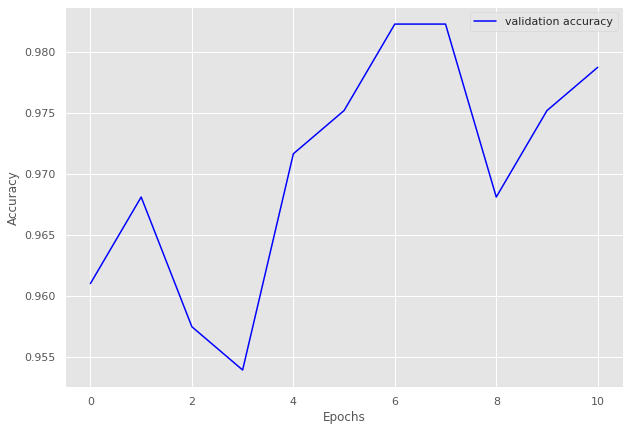

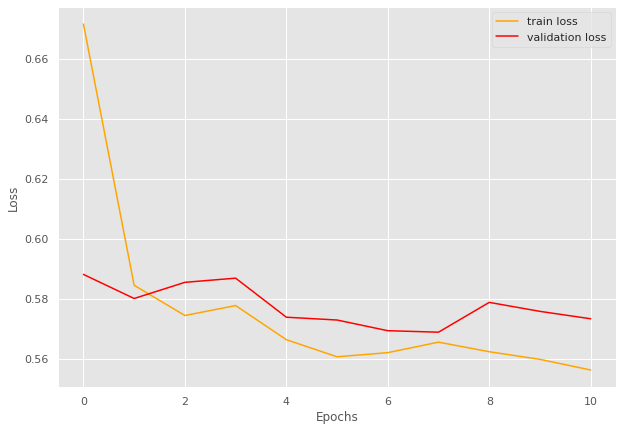

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 17 Epoch 1
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=0.928]


train loss 0.9275749800156574, validation loss 0.8040895104408264, validation accuracy 0.941747572815534
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=0.798]


train loss 0.7982574287725954, validation loss 0.8023633003234864, validation accuracy 0.9352750809061489
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=0.78] 


train loss 0.7801397248190276, validation loss 0.7990835547447205, validation accuracy 0.941747572815534
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.96batch/s, loss=0.77] 


train loss 0.7697963848405954, validation loss 0.7851724863052368, validation accuracy 0.9611650485436893
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.93batch/s, loss=0.769]


train loss 0.7687353564768421, validation loss 0.783899188041687, validation accuracy 0.9611650485436893
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=0.763]


INFO: Early stopping counter 1 of 5
train loss 0.7633733919688633, validation loss 0.7911542892456055, validation accuracy 0.9514563106796117
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=0.758]


train loss 0.7578286857021098, validation loss 0.7828443288803101, validation accuracy 0.9579288025889967
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.96batch/s, loss=0.76] 


INFO: Early stopping counter 2 of 5
train loss 0.7601497294951458, validation loss 0.7981820225715637, validation accuracy 0.9385113268608414
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=0.763]


train loss 0.7633058976153938, validation loss 0.7800943613052368, validation accuracy 0.9644012944983819
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=0.755]


INFO: Early stopping counter 3 of 5
train loss 0.7545035043541266, validation loss 0.7804072260856628, validation accuracy 0.9611650485436893
Coarse label 17 Epoch 11
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.98batch/s, loss=0.754]


train loss 0.754394671138452, validation loss 0.7747439503669739, validation accuracy 0.970873786407767
Coarse label 17 Epoch 12
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=0.753]


INFO: Early stopping counter 4 of 5
train loss 0.753306047040589, validation loss 0.7788082957267761, validation accuracy 0.9644012944983819
Coarse label 17 Epoch 13
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=0.754]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.961676217765043 and loss 0.7813305543227629


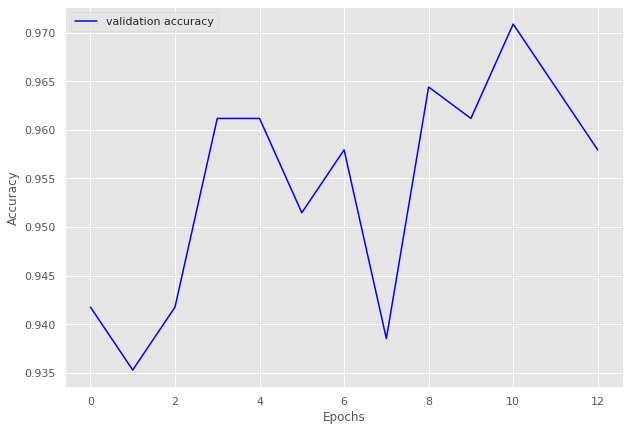

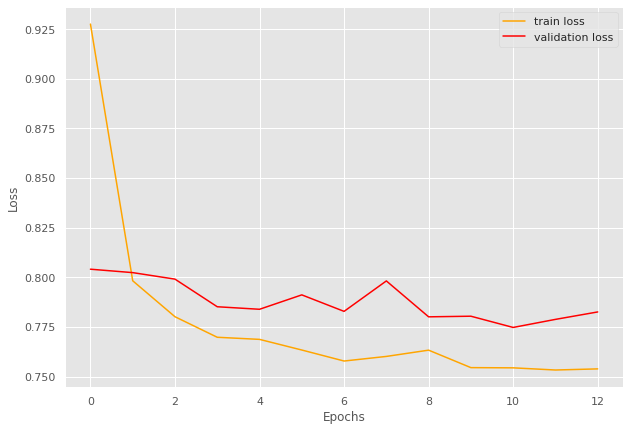

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 19 Epoch 1
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.05batch/s, loss=1.04]


train loss 1.042543463408947, validation loss 0.8573516309261322, validation accuracy 0.875
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.02batch/s, loss=0.799]


train loss 0.7990917675197124, validation loss 0.8003690838813782, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.09batch/s, loss=0.77] 


INFO: Early stopping counter 1 of 5
train loss 0.7695981934666634, validation loss 0.8052411079406738, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.04batch/s, loss=0.756]


INFO: Early stopping counter 2 of 5
train loss 0.7562369108200073, validation loss 0.8039921522140503, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.02batch/s, loss=0.757]


train loss 0.7566100805997849, validation loss 0.7926154136657715, validation accuracy 0.9375
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.07batch/s, loss=0.752]


train loss 0.7521505430340767, validation loss 0.791403740644455, validation accuracy 0.9375
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.00batch/s, loss=0.759]


INFO: Early stopping counter 3 of 5
train loss 0.7589690089225769, validation loss 0.799358606338501, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.04batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.7505085654556751, validation loss 0.7977187931537628, validation accuracy 0.9375
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  2.98batch/s, loss=0.756]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9434389140271493 and loss 0.8015689083508083


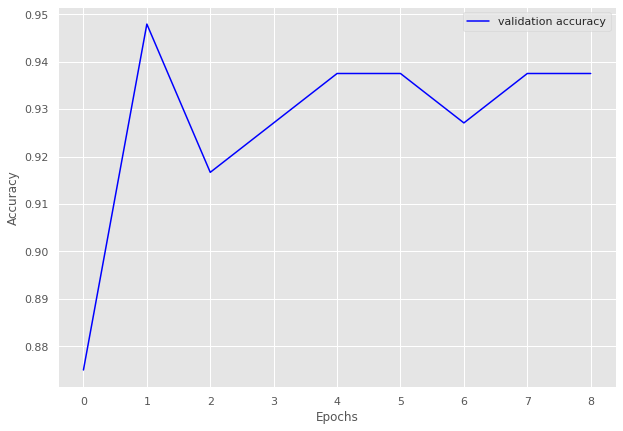

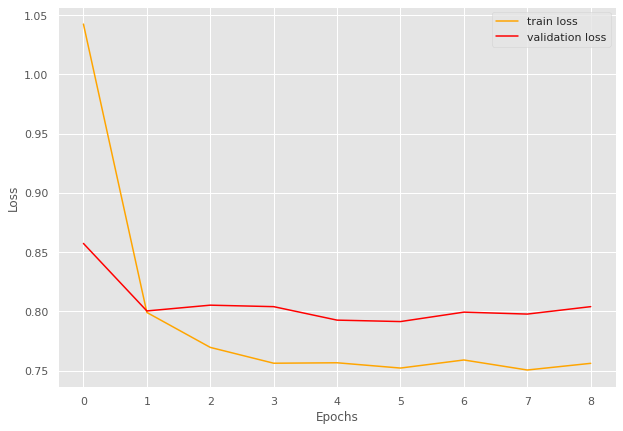

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Evaluating fine model 0
Evaluating fine model 1
Evaluating fine model 2
Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16
Evaluating fine model 17
Evaluating fine model 19
overall accuracy  is 0.8043123216259466
{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.93423053527980

Calculating for volume 85
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.93batch/s, loss=1.04]


train loss 1.0355764386850759, validation loss 0.96286541223526, validation accuracy 0.9393939393939394
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.91batch/s, loss=0.957]


train loss 0.9565729673849334, validation loss 0.9623692631721497, validation accuracy 0.9440559440559441
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.954]


train loss 0.9538992922240441, validation loss 0.9477570482662746, validation accuracy 0.9557109557109557
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.93batch/s, loss=0.942]


INFO: Early stopping counter 1 of 5
train loss 0.9415165918682693, validation loss 0.9526148183005196, validation accuracy 0.9487179487179487
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.93batch/s, loss=0.941]


INFO: Early stopping counter 2 of 5
train loss 0.9411191710638344, validation loss 0.9581238286835807, validation accuracy 0.9440559440559441
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.93batch/s, loss=0.943]


INFO: Early stopping counter 3 of 5
train loss 0.9425193918954342, validation loss 0.9499930143356323, validation accuracy 0.9533799533799534
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 109/109 [00:36<00:00,  2.95batch/s, loss=0.941]


INFO: Early stopping counter 4 of 5
train loss 0.94109999313267, validation loss 0.9637534533228193, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.93batch/s, loss=0.936]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9553502694380293 and loss 0.9486111686343238


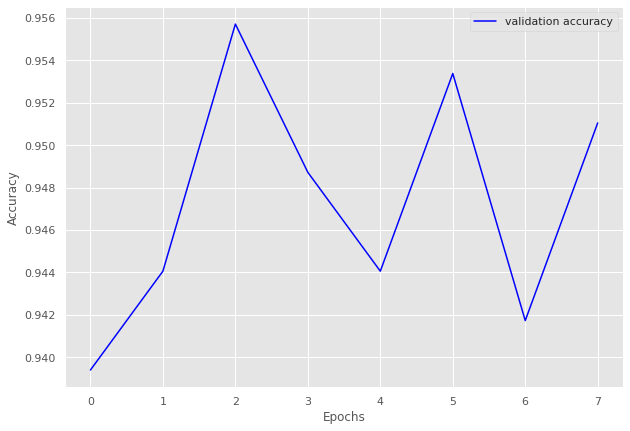

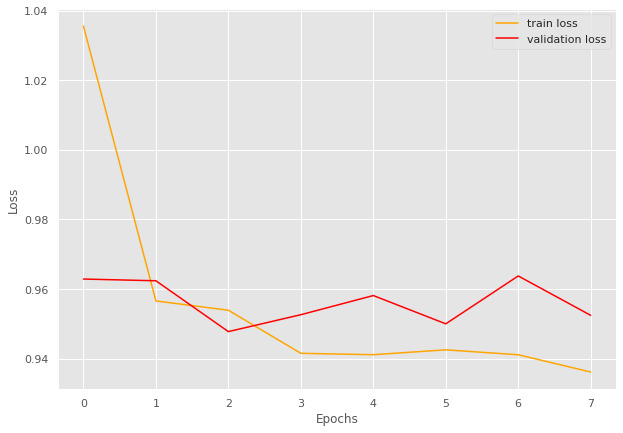

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9553502694380293
Coarse label 1 Epoch 1
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.93batch/s, loss=1.23]


train loss 1.229450748321858, validation loss 1.116397221883138, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.91batch/s, loss=1.09]


train loss 1.087195097131932, validation loss 1.1136961380640666, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.89batch/s, loss=1.07]


train loss 1.0711223089948614, validation loss 1.100919206937154, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.90batch/s, loss=1.06]


train loss 1.0598610766390537, validation loss 1.0832227071126301, validation accuracy 0.9623655913978495
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.92batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0570559171920126, validation loss 1.0909948746363323, validation accuracy 0.956989247311828
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.90batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0570952055302072, validation loss 1.0949361721674602, validation accuracy 0.946236559139785
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.87batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.05514136527447, validation loss 1.086819847424825, validation accuracy 0.956989247311828
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.90batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0564180790109838, validation loss 1.0900028944015503, validation accuracy 0.956989247311828
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.90batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.977112676056338 and loss 1.069150487581889


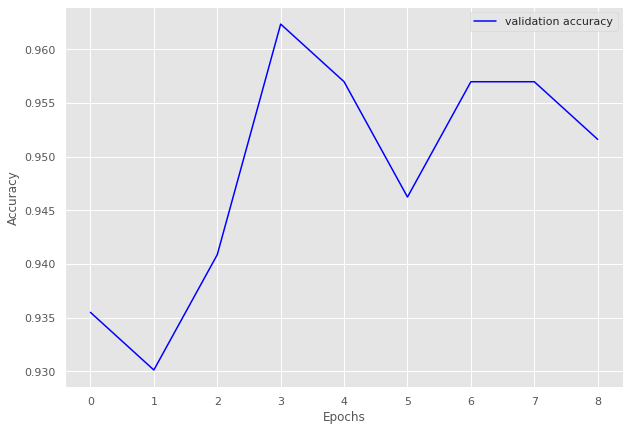

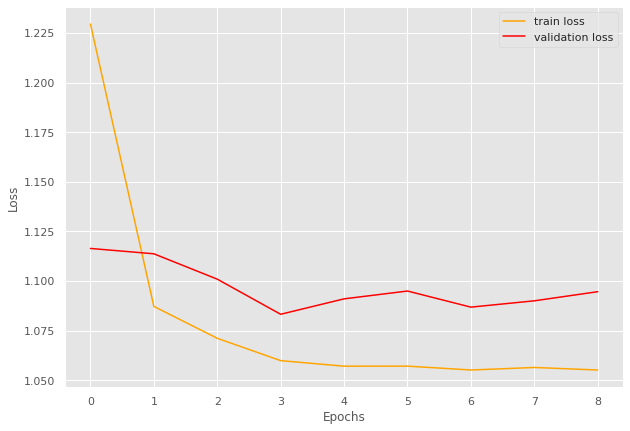

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 2 Epoch 1
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.92batch/s, loss=1.62]


train loss 1.6233715073628858, validation loss 1.513665693146842, validation accuracy 0.9494252873563218
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 220/220 [01:18<00:00,  2.79batch/s, loss=1.53]


train loss 1.5273210075768557, validation loss 1.5112047450883048, validation accuracy 0.9494252873563218
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.91batch/s, loss=1.52]


train loss 1.5164550792087208, validation loss 1.5043592963899886, validation accuracy 0.9586206896551724
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.91batch/s, loss=1.5]


train loss 1.5037407186898317, validation loss 1.5023493341037206, validation accuracy 0.9620689655172414
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.90batch/s, loss=1.5]


INFO: Early stopping counter 1 of 5
train loss 1.4967333148826252, validation loss 1.504248789378575, validation accuracy 0.957471264367816
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 220/220 [01:30<00:00,  2.43batch/s, loss=1.5] 


train loss 1.4956677491014654, validation loss 1.4989420856748308, validation accuracy 0.9632183908045977
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 220/220 [02:48<00:00,  1.30batch/s, loss=1.49]


train loss 1.494440149719065, validation loss 1.493748230593545, validation accuracy 0.9666666666666667
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 220/220 [01:16<00:00,  2.89batch/s, loss=1.49]


train loss 1.490728634595871, validation loss 1.4916414703641618, validation accuracy 0.9689655172413794
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.91batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4921399002725428, validation loss 1.5011761443955558, validation accuracy 0.9620689655172414
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.90batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.4924193425612016, validation loss 1.493940029825483, validation accuracy 0.9701149425287356
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.92batch/s, loss=1.49]


INFO: Early stopping counter 4 of 5
train loss 1.4861685265194287, validation loss 1.5030959844589233, validation accuracy 0.9597701149425287
Coarse label 2 Epoch 12
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.92batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9582225598176984 and loss 1.5072117674918402


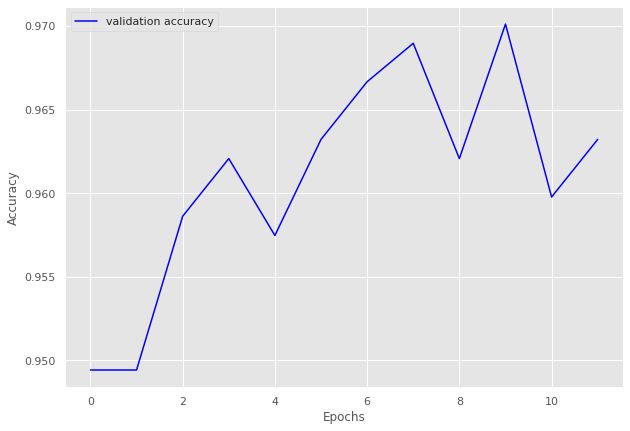

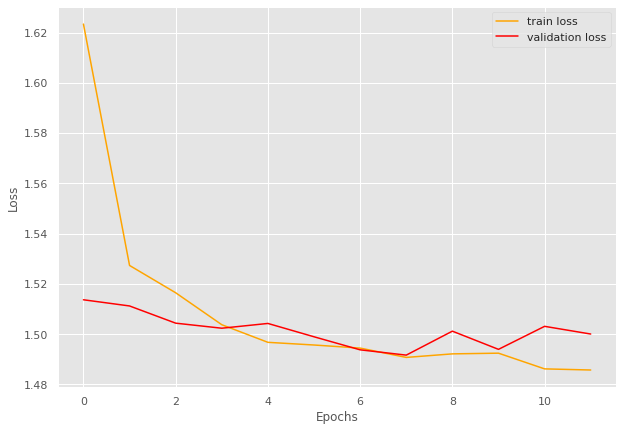

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.95batch/s, loss=1.2]


train loss 1.199775456235959, validation loss 1.1094300576618739, validation accuracy 0.9296116504854369
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.95batch/s, loss=1.1]


train loss 1.097436053248552, validation loss 1.0967530863625663, validation accuracy 0.9466019417475728
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.97batch/s, loss=1.09]


train loss 1.0855484375586877, validation loss 1.0861982277461462, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 104/104 [00:38<00:00,  2.68batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.0772985437741647, validation loss 1.0874632426670618, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.95batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0700600044085429, validation loss 1.0870053938456945, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.97batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0684000448538706, validation loss 1.089659639767238, validation accuracy 0.9514563106796117
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.91batch/s, loss=1.07]


train loss 1.0659464471615279, validation loss 1.0783815554210119, validation accuracy 0.9635922330097088
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0634819315030024, validation loss 1.0870508807046073, validation accuracy 0.9514563106796117
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.96batch/s, loss=1.06]


train loss 1.0615995629475667, validation loss 1.0708377020699638, validation accuracy 0.9733009708737864
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.952572347266881 and loss 1.0904441833496095


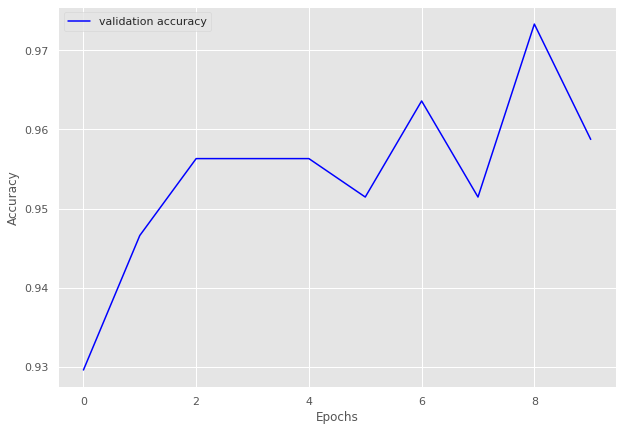

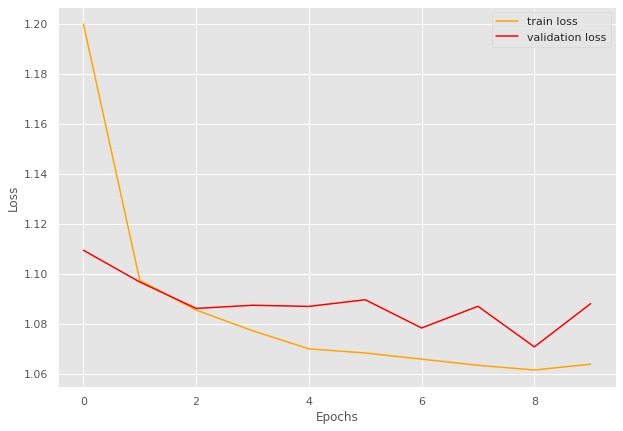

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.89batch/s, loss=0.374]


train loss 0.37419350147247316, validation loss 0.3339844346046448, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.91batch/s, loss=0.325]


train loss 0.3251421794295311, validation loss 0.3293520013491313, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.95batch/s, loss=0.326]


INFO: Early stopping counter 1 of 5
train loss 0.3257801257073879, validation loss 0.3324282268683116, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 40/40 [00:14<00:00,  2.83batch/s, loss=0.321]


train loss 0.3207155764102936, validation loss 0.3240657150745392, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.92batch/s, loss=0.32] 


train loss 0.31989718824625013, validation loss 0.3200056155522664, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.94batch/s, loss=0.318]


INFO: Early stopping counter 2 of 5
train loss 0.31832155510783194, validation loss 0.32001516222953796, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.91batch/s, loss=0.318]


INFO: Early stopping counter 3 of 5
train loss 0.3175956480205059, validation loss 0.32345335682233173, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.90batch/s, loss=0.321]


INFO: Early stopping counter 4 of 5
train loss 0.32102883979678154, validation loss 0.32477201024691266, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.89batch/s, loss=0.317]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9792099792099792 and loss 0.3318629041314125


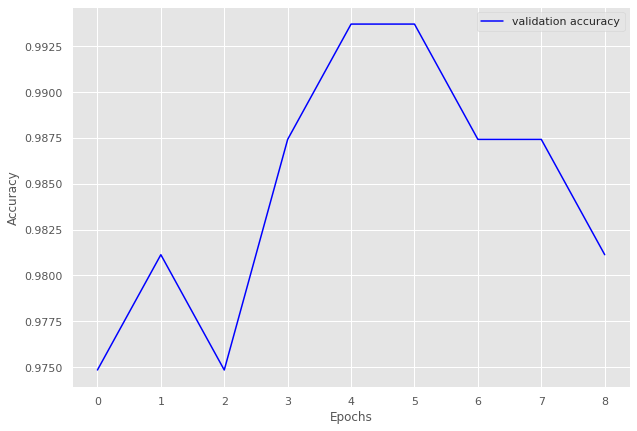

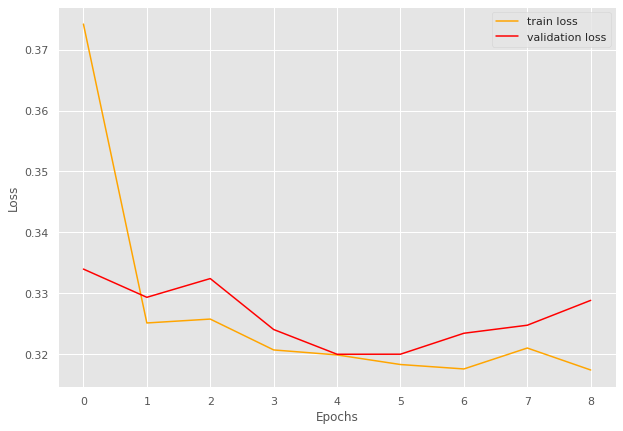

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.95batch/s, loss=1.3] 


train loss 1.3049071049078917, validation loss 1.2321260571479797, validation accuracy 0.9331896551724138
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.23]


train loss 1.2250719549309494, validation loss 1.2027569860219955, validation accuracy 0.9612068965517241
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.22]


train loss 1.2189724689874895, validation loss 1.1972730159759521, validation accuracy 0.9655172413793104
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.21]


INFO: Early stopping counter 1 of 5
train loss 1.2071328855987289, validation loss 1.1980903446674347, validation accuracy 0.9655172413793104
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 117/117 [00:40<00:00,  2.90batch/s, loss=1.2]


INFO: Early stopping counter 2 of 5
train loss 1.2043268211886413, validation loss 1.1973456144332886, validation accuracy 0.9655172413793104
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.95batch/s, loss=1.2]


train loss 1.1964990878716493, validation loss 1.1902809888124466, validation accuracy 0.9741379310344828
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.93batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1932779958105495, validation loss 1.20383919775486, validation accuracy 0.9525862068965517
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.191725242851127, validation loss 1.1973185241222382, validation accuracy 0.9655172413793104
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.93batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9715302491103203 and loss 1.1942988254807212


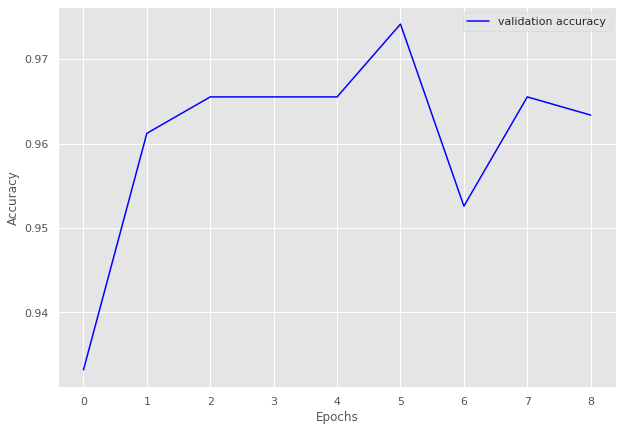

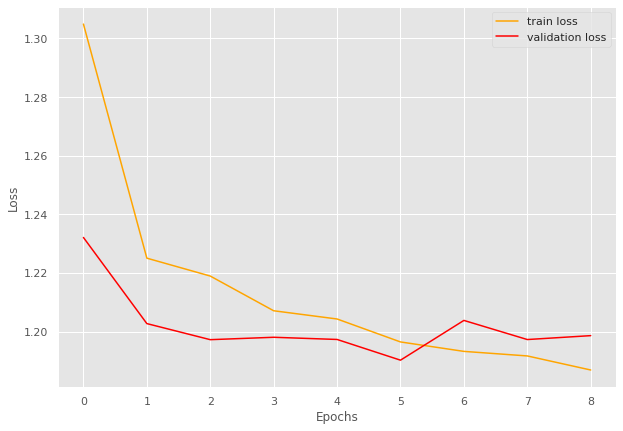

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.89batch/s, loss=0.827]


train loss 0.8272099469019019, validation loss 0.7816565036773682, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.92batch/s, loss=0.767]


train loss 0.7669184732696285, validation loss 0.773226817448934, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.90batch/s, loss=0.762]


train loss 0.7622374613647875, validation loss 0.7723348438739777, validation accuracy 0.9724517906336089
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.89batch/s, loss=0.762]


train loss 0.7621730060681052, validation loss 0.7716687222321829, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.90batch/s, loss=0.756]


train loss 0.7562710817741312, validation loss 0.7695866723855337, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.91batch/s, loss=0.759]


train loss 0.7594943072484888, validation loss 0.7675201694170634, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.93batch/s, loss=0.755]


INFO: Early stopping counter 1 of 5
train loss 0.7551074669412945, validation loss 0.7799101372559866, validation accuracy 0.9586776859504132
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 92/92 [00:43<00:00,  2.12batch/s, loss=0.754]


train loss 0.7537715713615003, validation loss 0.7638525466124216, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 92/92 [01:08<00:00,  1.34batch/s, loss=0.751]


INFO: Early stopping counter 2 of 5
train loss 0.7513368622116421, validation loss 0.7684363722801208, validation accuracy 0.977961432506887
Coarse label 7 Epoch 10
-------------------------------


100%|██████████| 92/92 [01:12<00:00,  1.27batch/s, loss=0.751]


train loss 0.7510871064403782, validation loss 0.7630233069260915, validation accuracy 0.977961432506887
Coarse label 7 Epoch 11
-------------------------------


100%|██████████| 92/92 [00:50<00:00,  1.84batch/s, loss=0.749]


INFO: Early stopping counter 3 of 5
train loss 0.7486681581839271, validation loss 0.7637879451115926, validation accuracy 0.977961432506887
Coarse label 7 Epoch 12
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.92batch/s, loss=0.754]


train loss 0.7538422268369923, validation loss 0.7569859325885773, validation accuracy 0.9862258953168044
Coarse label 7 Epoch 13
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.92batch/s, loss=0.75] 


INFO: Early stopping counter 4 of 5
train loss 0.7501736717379611, validation loss 0.7626197834809622, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 14
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.92batch/s, loss=0.749]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9790528233151184 and loss 0.7625030312273238


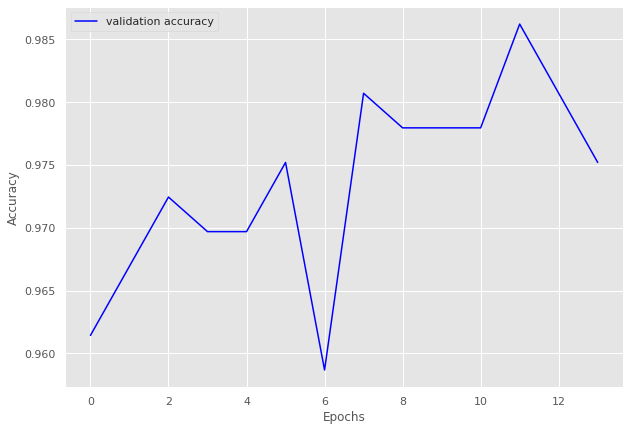

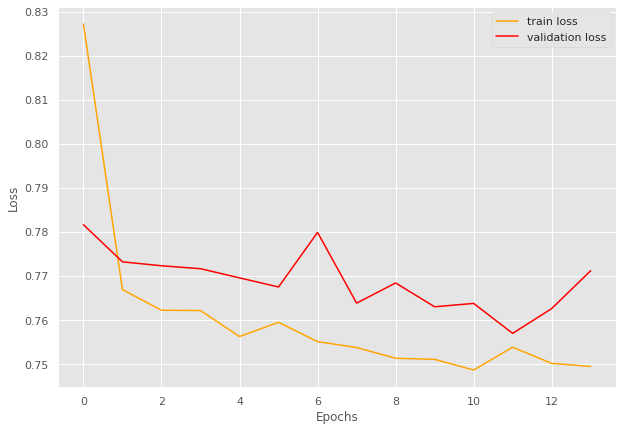

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9790528233151184
Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.92batch/s, loss=1.34]


train loss 1.3366545383320299, validation loss 1.254193753004074, validation accuracy 0.913894324853229
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.90batch/s, loss=1.23]


train loss 1.2271900546643162, validation loss 1.219687283039093, validation accuracy 0.9452054794520548
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.92batch/s, loss=1.22]


INFO: Early stopping counter 1 of 5
train loss 1.217036862706029, validation loss 1.2203405946493149, validation accuracy 0.9471624266144814
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.90batch/s, loss=1.21]


INFO: Early stopping counter 2 of 5
train loss 1.207517001055932, validation loss 1.2303350120782852, validation accuracy 0.9334637964774951
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.91batch/s, loss=1.2]


train loss 1.2015623528827992, validation loss 1.2125880271196365, validation accuracy 0.9530332681017613
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.91batch/s, loss=1.2]


INFO: Early stopping counter 3 of 5
train loss 1.1977539681649023, validation loss 1.2282945811748505, validation accuracy 0.9373776908023483
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.92batch/s, loss=1.2]


INFO: Early stopping counter 4 of 5
train loss 1.1956738723340885, validation loss 1.2229189574718475, validation accuracy 0.9432485322896281
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.90batch/s, loss=1.2] 


train loss 1.1953907253206237, validation loss 1.208102360367775, validation accuracy 0.9608610567514677
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.87batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9656513285806869 and loss 1.2005266237258911


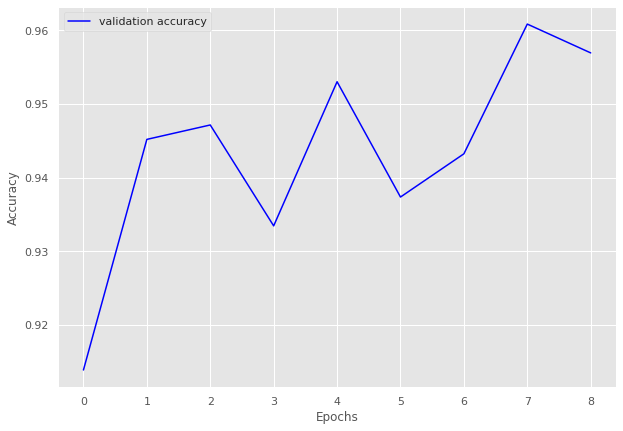

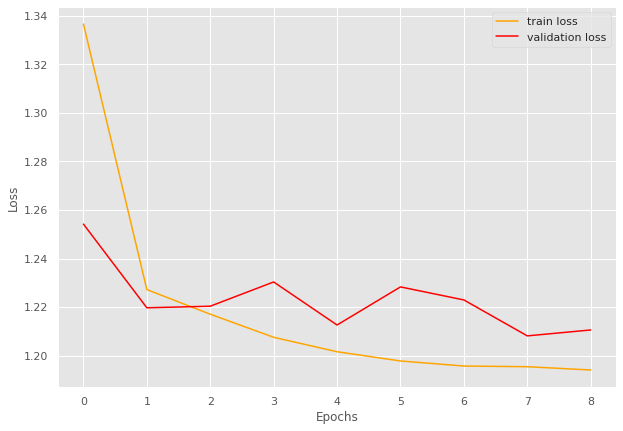

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.89batch/s, loss=1.63]


train loss 1.630569585993246, validation loss 1.5153475566343828, validation accuracy 0.9629629629629629
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.88batch/s, loss=1.52]


train loss 1.5197744435327916, validation loss 1.510035601529208, validation accuracy 0.9675925925925926
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 163/163 [00:57<00:00,  2.86batch/s, loss=1.51]


train loss 1.5053526982207972, validation loss 1.5080802332271228, validation accuracy 0.9675925925925926
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.90batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4942450867108772, validation loss 1.5258044329556553, validation accuracy 0.9598765432098766
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.88batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4894949519561111, validation loss 1.5151879462328823, validation accuracy 0.9614197530864198
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.90batch/s, loss=1.48]


train loss 1.4846763413376602, validation loss 1.4950113079764626, validation accuracy 0.9783950617283951
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.90batch/s, loss=1.48]


train loss 1.479646693709438, validation loss 1.4911366267637773, validation accuracy 0.9783950617283951
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 163/163 [00:59<00:00,  2.73batch/s, loss=1.48]


train loss 1.478815433437839, validation loss 1.4872309619730169, validation accuracy 0.9737654320987654
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.90batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4756190323390843, validation loss 1.505485025319186, validation accuracy 0.9722222222222222
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.89batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4799369281055006, validation loss 1.5065038312565198, validation accuracy 0.9783950617283951
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.90batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9734151329243353 and loss 1.4914054985969298


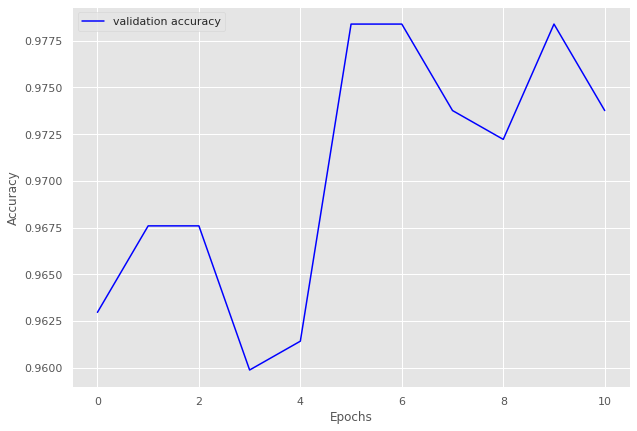

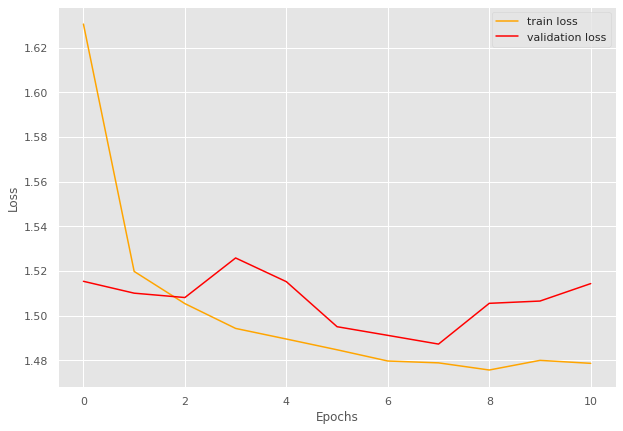

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.92batch/s, loss=0.829]


train loss 0.8293694962154735, validation loss 0.7632792234420777, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.92batch/s, loss=0.765]


train loss 0.765209229735585, validation loss 0.7582619309425354, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.89batch/s, loss=0.759]


train loss 0.7589790279215033, validation loss 0.7552431344985961, validation accuracy 0.9901315789473685
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.91batch/s, loss=0.755]


train loss 0.7549302577972412, validation loss 0.746716046333313, validation accuracy 1.0
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.92batch/s, loss=0.755]


INFO: Early stopping counter 1 of 5
train loss 0.7554652365771207, validation loss 0.7549759387969971, validation accuracy 0.9901315789473685
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.90batch/s, loss=0.755]


INFO: Early stopping counter 2 of 5
train loss 0.754752399085404, validation loss 0.7570425033569336, validation accuracy 0.9868421052631579
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.89batch/s, loss=0.757]


INFO: Early stopping counter 3 of 5
train loss 0.7570455716801928, validation loss 0.75406414270401, validation accuracy 0.9868421052631579
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.92batch/s, loss=0.752]


INFO: Early stopping counter 4 of 5
train loss 0.7522204827952694, validation loss 0.7618466734886169, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.93batch/s, loss=0.751]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9804560260586319 and loss 0.7629068613052368


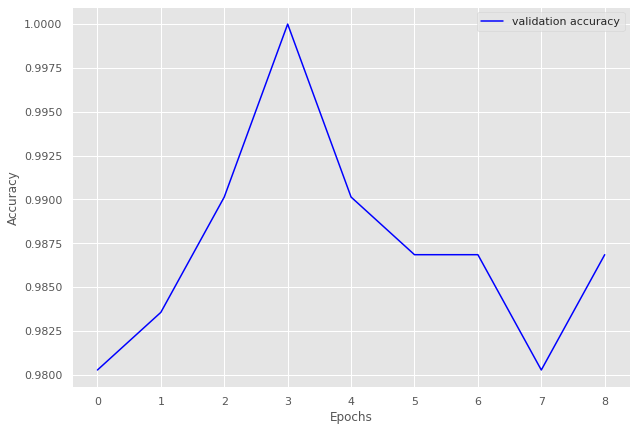

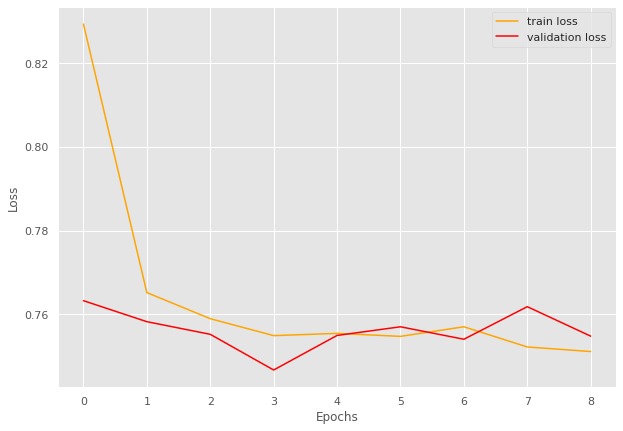

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.95batch/s, loss=1.24]


train loss 1.2407486197110769, validation loss 1.0962876319885253, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.95batch/s, loss=1.12]


train loss 1.118044986918166, validation loss 1.0811676263809205, validation accuracy 0.9551724137931035
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.96batch/s, loss=1.1] 


INFO: Early stopping counter 1 of 5
train loss 1.1001442171431877, validation loss 1.0815504312515258, validation accuracy 0.9620689655172414
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 74/74 [00:24<00:00,  2.98batch/s, loss=1.09]


train loss 1.0935340990891327, validation loss 1.0630061864852904, validation accuracy 0.9793103448275862
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.90batch/s, loss=1.09]


INFO: Early stopping counter 2 of 5
train loss 1.0878973055530239, validation loss 1.0712595939636231, validation accuracy 0.9758620689655172
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 74/74 [00:24<00:00,  2.96batch/s, loss=1.09]


INFO: Early stopping counter 3 of 5
train loss 1.0882974025365468, validation loss 1.0656126737594604, validation accuracy 0.9758620689655172
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 74/74 [00:24<00:00,  2.97batch/s, loss=1.08]


train loss 1.0787117932293866, validation loss 1.0617206811904907, validation accuracy 0.9793103448275862
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 74/74 [00:24<00:00,  2.99batch/s, loss=1.08]


train loss 1.0796424327669918, validation loss 1.056345558166504, validation accuracy 0.9862068965517241
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.95batch/s, loss=1.08]


train loss 1.075025574581043, validation loss 1.055516242980957, validation accuracy 0.9862068965517241
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=1.08]


INFO: Early stopping counter 4 of 5
train loss 1.0751428330266797, validation loss 1.0606786489486695, validation accuracy 0.9862068965517241
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.92batch/s, loss=1.08]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9500567536889898 and loss 1.0952609777450562


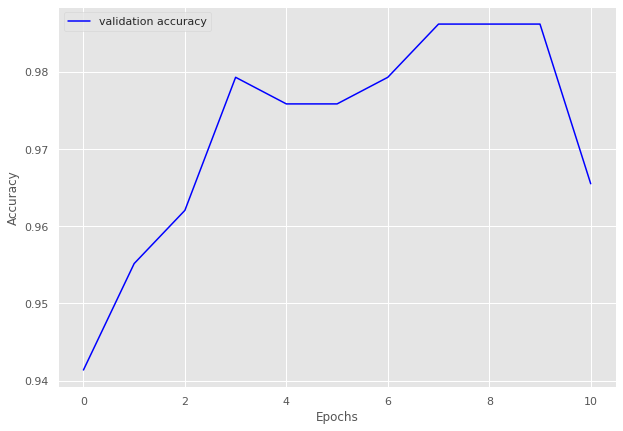

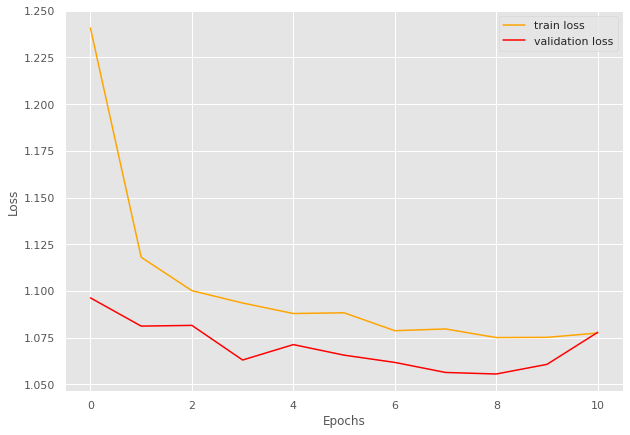

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=0.656]


train loss 0.6559743927075312, validation loss 0.5951609969139099, validation accuracy 0.9459459459459459
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.93batch/s, loss=0.588]


train loss 0.5884335747131935, validation loss 0.5814300417900086, validation accuracy 0.9652509652509652
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.94batch/s, loss=0.584]


INFO: Early stopping counter 1 of 5
train loss 0.5838813204031724, validation loss 0.5884963870048523, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.88batch/s, loss=0.573]


INFO: Early stopping counter 2 of 5
train loss 0.5728116704867436, validation loss 0.5869214415550232, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.91batch/s, loss=0.574]


INFO: Early stopping counter 3 of 5
train loss 0.574231377014747, validation loss 0.5928317904472351, validation accuracy 0.9459459459459459
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.93batch/s, loss=0.568]


INFO: Early stopping counter 4 of 5
train loss 0.5678782985760615, validation loss 0.5835656523704529, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.90batch/s, loss=0.564]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9654289372599232 and loss 0.5851146762187664


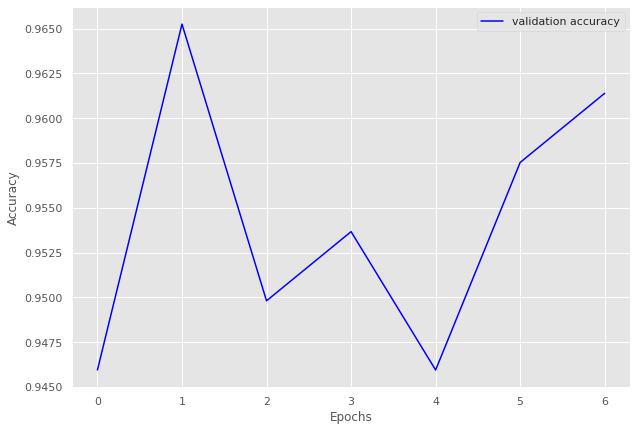

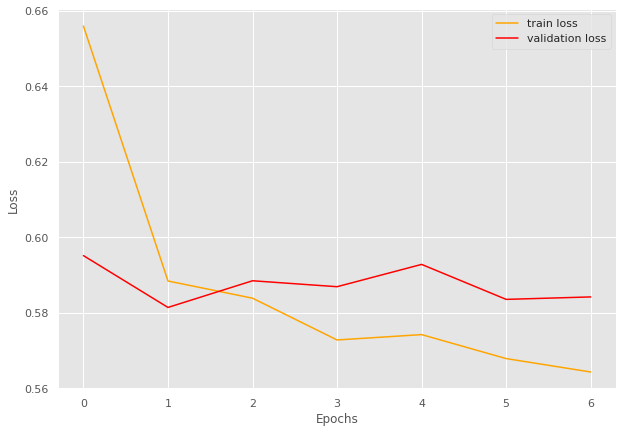

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.92batch/s, loss=1.15]


train loss 1.147708367506663, validation loss 1.0830857634544373, validation accuracy 0.9663299663299664
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 150/150 [01:33<00:00,  1.60batch/s, loss=1.08]


train loss 1.0804928962389628, validation loss 1.0810155034065247, validation accuracy 0.968013468013468
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 150/150 [01:53<00:00,  1.32batch/s, loss=1.08]


train loss 1.0756356739997863, validation loss 1.0694245457649232, validation accuracy 0.9764309764309764
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.93batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0710531759262085, validation loss 1.0825640678405761, validation accuracy 0.9696969696969697
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.93batch/s, loss=1.06]


train loss 1.0636357887585959, validation loss 1.0681986093521119, validation accuracy 0.9797979797979798
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.91batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0619921771685283, validation loss 1.0688252091407775, validation accuracy 0.9730639730639731
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.92batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0595307524998983, validation loss 1.0682663440704345, validation accuracy 0.9764309764309764
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 150/150 [00:50<00:00,  2.95batch/s, loss=1.06]


train loss 1.057659560839335, validation loss 1.0674779891967774, validation accuracy 0.9781144781144782
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.91batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0568961517016093, validation loss 1.0708787202835084, validation accuracy 0.9747474747474747
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.973786949247072 and loss 1.068038796556407


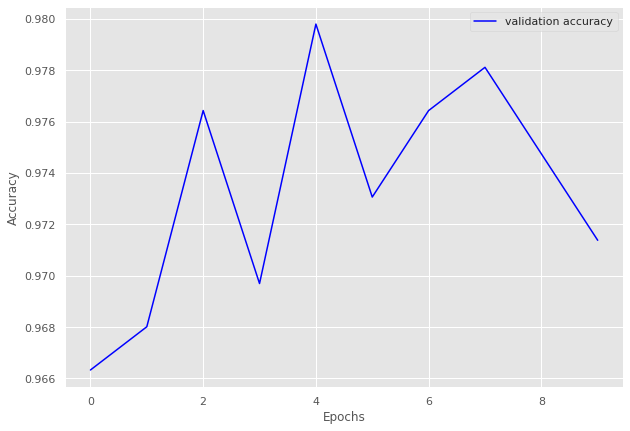

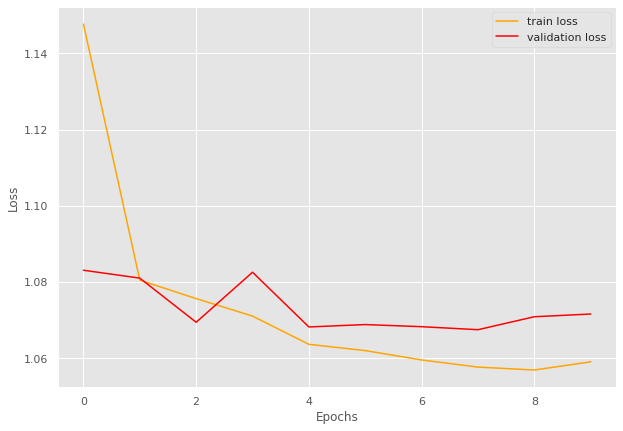

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.94batch/s, loss=0.856]


train loss 0.8562149767940109, validation loss 0.788348937034607, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.90batch/s, loss=0.771]


train loss 0.7708302865157256, validation loss 0.778483772277832, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.88batch/s, loss=0.762]


train loss 0.7624944271268072, validation loss 0.7740877389907836, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.94batch/s, loss=0.758]


INFO: Early stopping counter 1 of 5
train loss 0.7575823350532634, validation loss 0.7752723097801208, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.90batch/s, loss=0.757]


train loss 0.756967604965777, validation loss 0.7695054054260254, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.94batch/s, loss=0.755]


train loss 0.7548508748814866, validation loss 0.7660501718521118, validation accuracy 0.9761904761904762
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.90batch/s, loss=0.753]


INFO: Early stopping counter 2 of 5
train loss 0.7532787540474454, validation loss 0.7685037970542907, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=0.753]


INFO: Early stopping counter 3 of 5
train loss 0.7530649392991453, validation loss 0.7765691161155701, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=0.755]


INFO: Early stopping counter 4 of 5
train loss 0.7547469839856431, validation loss 0.7718045473098755, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=0.752]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9808126410835214 and loss 0.7620921049799237


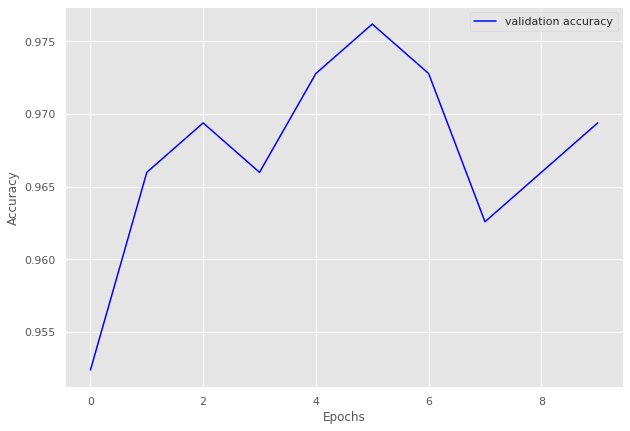

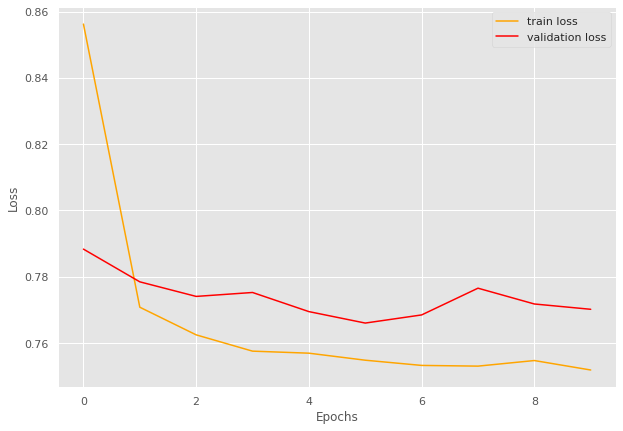

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.93batch/s, loss=0.641]


train loss 0.6411817955299163, validation loss 0.5883687138557434, validation accuracy 0.9574468085106383
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.94batch/s, loss=0.578]


train loss 0.5777548316498877, validation loss 0.585066282749176, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.93batch/s, loss=0.571]


train loss 0.5708425347234162, validation loss 0.5755840539932251, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.93batch/s, loss=0.566]


train loss 0.5662360552331092, validation loss 0.5670758008956909, validation accuracy 0.9822695035460993
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.93batch/s, loss=0.564]


INFO: Early stopping counter 1 of 5
train loss 0.5636325419788629, validation loss 0.575613009929657, validation accuracy 0.975177304964539
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.96batch/s, loss=0.564]


INFO: Early stopping counter 2 of 5
train loss 0.5641904876265728, validation loss 0.582650363445282, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.94batch/s, loss=0.561]


INFO: Early stopping counter 3 of 5
train loss 0.5609134343308462, validation loss 0.5679069519042969, validation accuracy 0.9858156028368794
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.93batch/s, loss=0.563]


INFO: Early stopping counter 4 of 5
train loss 0.5631045875414996, validation loss 0.5676375031471252, validation accuracy 0.9822695035460993
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.94batch/s, loss=0.56] 


train loss 0.5604112349765401, validation loss 0.5625132203102112, validation accuracy 0.9893617021276596
Coarse label 16 Epoch 10
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.95batch/s, loss=0.558]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9847058823529412 and loss 0.5657253435679844


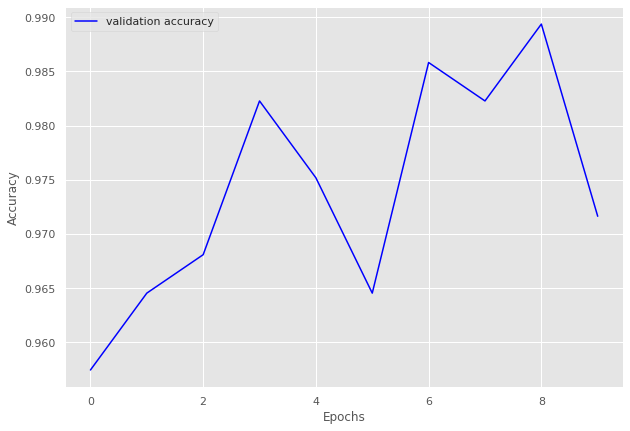

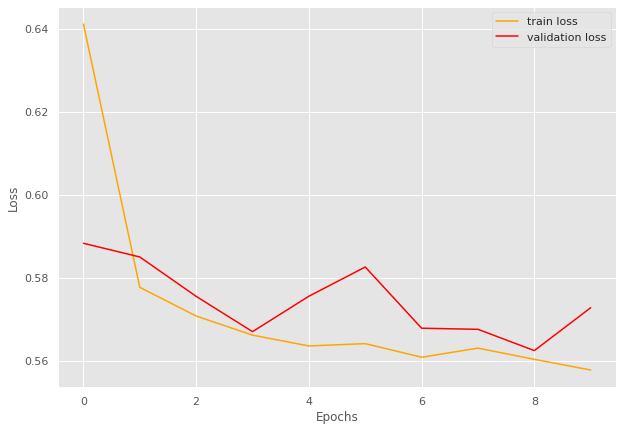

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 17 Epoch 1
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.93batch/s, loss=0.877]


train loss 0.877089221508075, validation loss 0.8234843850135803, validation accuracy 0.912621359223301
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.91batch/s, loss=0.795]


train loss 0.7952531713705796, validation loss 0.8117108702659607, validation accuracy 0.9288025889967637
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.94batch/s, loss=0.775]


train loss 0.7753284030999893, validation loss 0.7872048735618591, validation accuracy 0.9579288025889967
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.93batch/s, loss=0.773]


INFO: Early stopping counter 1 of 5
train loss 0.7726776897907257, validation loss 0.7896039128303528, validation accuracy 0.9579288025889967
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 78/78 [00:30<00:00,  2.59batch/s, loss=0.766]


INFO: Early stopping counter 2 of 5
train loss 0.7663853489435636, validation loss 0.7917843103408814, validation accuracy 0.9514563106796117
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.91batch/s, loss=0.766]


INFO: Early stopping counter 3 of 5
train loss 0.7656704508341275, validation loss 0.8004240751266479, validation accuracy 0.941747572815534
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.94batch/s, loss=0.767]


train loss 0.7668564716974894, validation loss 0.7770315885543824, validation accuracy 0.9644012944983819
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 78/78 [00:43<00:00,  1.81batch/s, loss=0.76] 


train loss 0.7599256053949014, validation loss 0.7707849621772767, validation accuracy 0.9773462783171522
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 78/78 [00:56<00:00,  1.39batch/s, loss=0.762]


INFO: Early stopping counter 4 of 5
train loss 0.7621866151308402, validation loss 0.7841789484024048, validation accuracy 0.9579288025889967
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 78/78 [00:56<00:00,  1.38batch/s, loss=0.759]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9688841201716738 and loss 0.7749550580978394


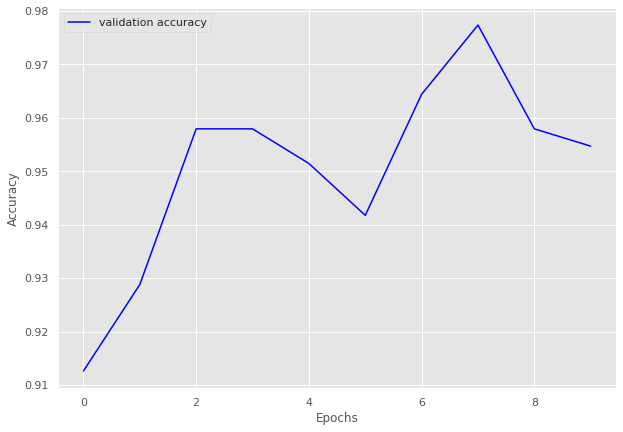

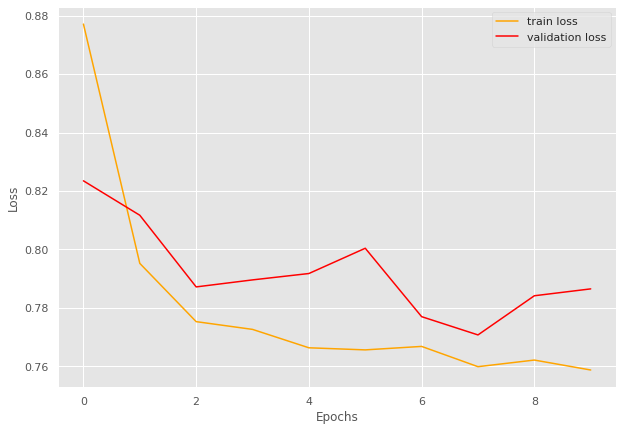

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 19 Epoch 1
-------------------------------


100%|██████████| 25/25 [00:23<00:00,  1.05batch/s, loss=0.99] 


train loss 0.990255126953125, validation loss 0.7881858348846436, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:16<00:00,  1.50batch/s, loss=0.787]


train loss 0.7871095991134643, validation loss 0.7765246331691742, validation accuracy 0.96875
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.98batch/s, loss=0.762]


INFO: Early stopping counter 1 of 5
train loss 0.7616831755638123, validation loss 0.7958448231220245, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.97batch/s, loss=0.754]


INFO: Early stopping counter 2 of 5
train loss 0.7544046568870545, validation loss 0.7953873872756958, validation accuracy 0.9375
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.94batch/s, loss=0.754]


train loss 0.7537556743621826, validation loss 0.769227534532547, validation accuracy 0.96875
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.94batch/s, loss=0.76] 


train loss 0.759724452495575, validation loss 0.7673898339271545, validation accuracy 0.96875
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.95batch/s, loss=0.749]


INFO: Early stopping counter 3 of 5
train loss 0.749057207107544, validation loss 0.7675110697746277, validation accuracy 0.96875
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.94batch/s, loss=0.75] 


INFO: Early stopping counter 4 of 5
train loss 0.749515769481659, validation loss 0.7694768011569977, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.00batch/s, loss=0.748]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9797297297297297 and loss 0.7635074257850647


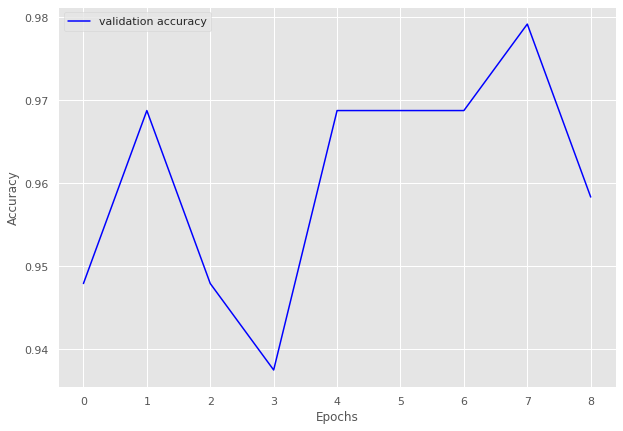

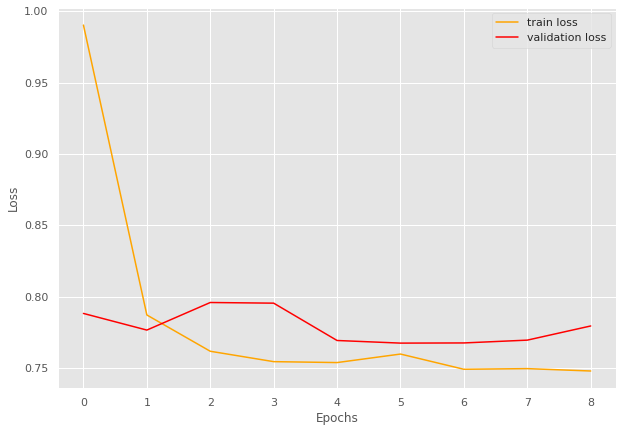

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Evaluating fine model 0
Evaluating fine model 1
Evaluating fine model 2
Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16
Evaluating fine model 17
Evaluating fine model 19
overall accuracy  is 0.8319659978254423
{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.93423053527980

Starting run 5
defaultdict(<class 'list'>, {10: [0], 15: [1, 38, 54, 62], 12: [2, 7, 12, 45, 49, 91], 17: [3, 25, 66, 83], 5: [4, 77], 8: [5, 60, 70, 73, 75, 78, 82], 1: [6, 53, 56, 58, 79, 80], 11: [8, 31, 51, 61], 0: [9, 17, 26, 55, 69], 7: [10, 23, 39, 67], 9: [11, 18, 34, 46, 57, 63, 68, 76, 92, 93], 2: [13, 19, 20, 36, 41, 42, 47, 48, 71, 88], 6: [14, 15, 22, 32, 35, 43, 52], 4: [16, 21, 24, 30, 64, 72], 13: [27, 29, 81], 14: [28, 33, 37, 44, 89, 90], 16: [40, 59, 87], 18: [50], 19: [65, 74, 84, 85], 3: [86]})
Calculating for volume 15
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.01batch/s, loss=1.34]


train loss 1.344900940145765, validation loss 1.1043784277779716, validation accuracy 0.8298368298368298
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.04batch/s, loss=1.01]


train loss 1.0063235333987646, validation loss 0.9951656460762024, validation accuracy 0.916083916083916
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.93batch/s, loss=0.945]


train loss 0.9450079245226723, validation loss 0.9824423789978027, validation accuracy 0.9230769230769231
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.00batch/s, loss=0.937]


train loss 0.9370037870747703, validation loss 0.9724161454609462, validation accuracy 0.9347319347319347
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.00batch/s, loss=0.926]


INFO: Early stopping counter 1 of 5
train loss 0.926319637468883, validation loss 0.9745979223932538, validation accuracy 0.9370629370629371
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.94batch/s, loss=0.922]


train loss 0.9221392486776624, validation loss 0.9707027162824359, validation accuracy 0.9370629370629371
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.94batch/s, loss=0.917]


INFO: Early stopping counter 2 of 5
train loss 0.9168668133871896, validation loss 0.9733806422778538, validation accuracy 0.9324009324009324
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.01batch/s, loss=0.921]


train loss 0.9206726082733699, validation loss 0.9649342128208706, validation accuracy 0.9393939393939394
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.04batch/s, loss=0.919]


INFO: Early stopping counter 3 of 5
train loss 0.9188139012881688, validation loss 0.9699738962309701, validation accuracy 0.9370629370629371
Coarse label 0 Epoch 10
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.00batch/s, loss=0.915]


INFO: Early stopping counter 4 of 5
train loss 0.9152041460786547, validation loss 0.972173409802573, validation accuracy 0.9347319347319347
Coarse label 0 Epoch 11
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.04batch/s, loss=0.918]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.926112396244387 and loss 0.9800914354946302


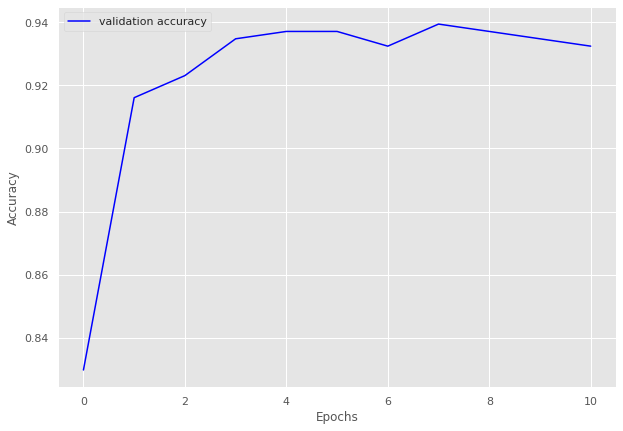

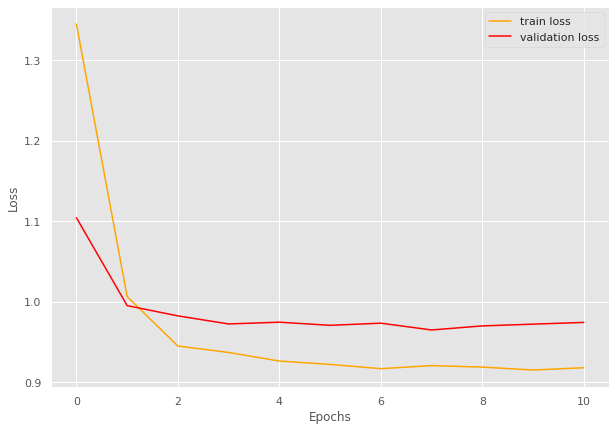

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 1 Epoch 1
-------------------------------


100%|██████████| 6/6 [00:01<00:00,  3.01batch/s, loss=1.62]


train loss 1.616593062877655, validation loss 1.5053649346033733, validation accuracy 0.5483870967741935
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.25]


train loss 1.2499594887097676, validation loss 1.280864675839742, validation accuracy 0.7903225806451613
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.12]


train loss 1.1171525915463765, validation loss 1.187956968943278, validation accuracy 0.8763440860215054
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.96batch/s, loss=1.07]


train loss 1.0743036071459453, validation loss 1.1574116945266724, validation accuracy 0.8978494623655914
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.96batch/s, loss=1.05]


train loss 1.0524414976437886, validation loss 1.143724004427592, validation accuracy 0.9139784946236559
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.05]


train loss 1.0488407611846924, validation loss 1.1296385129292805, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.05]


train loss 1.0459027489026387, validation loss 1.1269549926122029, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.90batch/s, loss=1.04]


INFO: Early stopping counter 1 of 5
train loss 1.044772446155548, validation loss 1.1279022296269734, validation accuracy 0.9247311827956989
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.96batch/s, loss=1.04]


INFO: Early stopping counter 2 of 5
train loss 1.0445691148440044, validation loss 1.1280103127161663, validation accuracy 0.9193548387096774
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.04]


INFO: Early stopping counter 3 of 5
train loss 1.0448803901672363, validation loss 1.1273894309997559, validation accuracy 0.9247311827956989
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.81batch/s, loss=1.04]


INFO: Early stopping counter 4 of 5
train loss 1.04424120982488, validation loss 1.1293753782908122, validation accuracy 0.9247311827956989
Coarse label 1 Epoch 12
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.95batch/s, loss=1.04]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9134104407627384 and loss 1.133678376674652


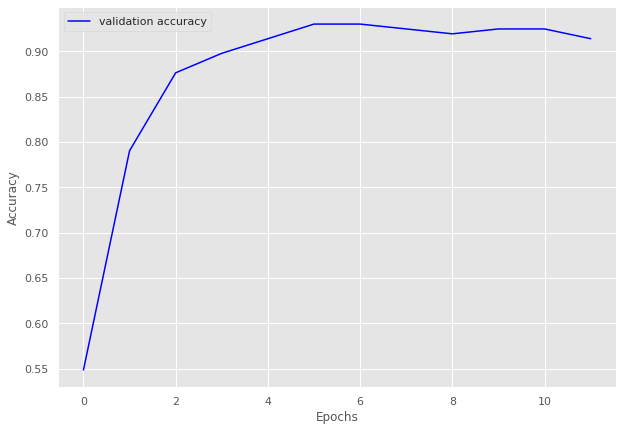

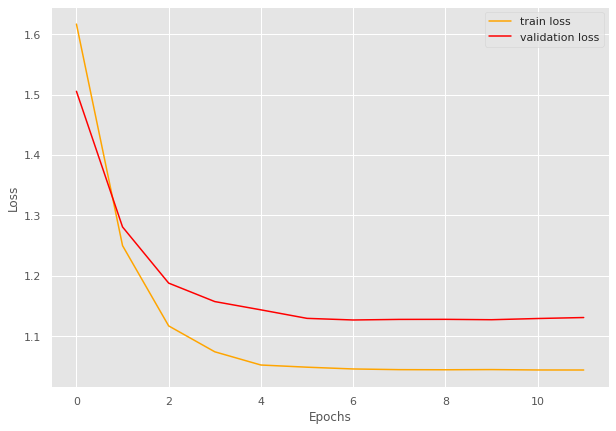

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 2 Epoch 1
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=1.91]


train loss 1.9133085991655077, validation loss 1.6907964093344552, validation accuracy 0.8057471264367816
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.62]


train loss 1.6224609400544847, validation loss 1.6301262974739075, validation accuracy 0.8597701149425288
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.53]


train loss 1.534938667501722, validation loss 1.5725209372384208, validation accuracy 0.903448275862069
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=1.51]


train loss 1.5070540649550301, validation loss 1.5688298004014152, validation accuracy 0.896551724137931
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.94batch/s, loss=1.5]


train loss 1.5008362063339777, validation loss 1.5630874463490076, validation accuracy 0.9045977011494253
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.5] 


train loss 1.4952736411775862, validation loss 1.5608953152384077, validation accuracy 0.9091954022988505
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.94batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.490017933504922, validation loss 1.5645753315516882, validation accuracy 0.903448275862069
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4853153101035528, validation loss 1.5668827635901315, validation accuracy 0.8988505747126436
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.91batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.485611719744546, validation loss 1.5649422066552299, validation accuracy 0.9011494252873563
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.48]


train loss 1.4816822367055076, validation loss 1.5551602584975106, validation accuracy 0.9183908045977012
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4776124783924647, validation loss 1.5576514601707458, validation accuracy 0.9080459770114943
Coarse label 2 Epoch 12
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9087676930301201 and loss 1.5542647981848328


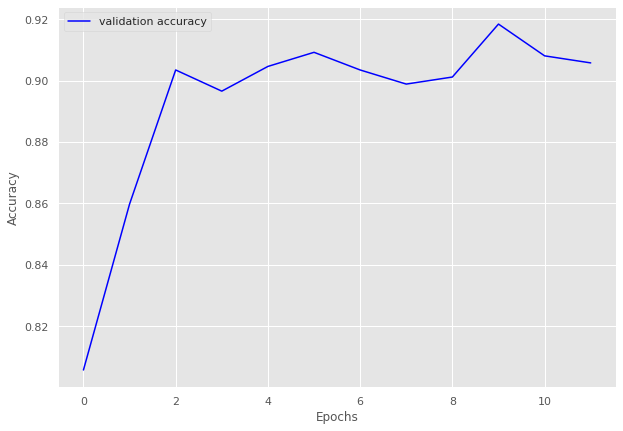

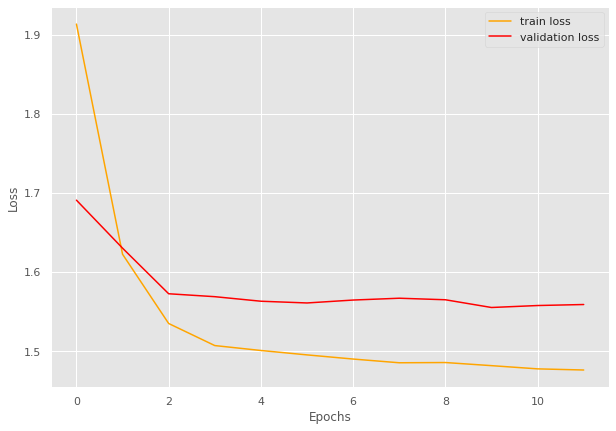

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.96batch/s, loss=1.5] 


train loss 1.5012587308883667, validation loss 1.3561357430049352, validation accuracy 0.7548543689320388
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.74batch/s, loss=1.19]


train loss 1.1883410215377808, validation loss 1.2093256711959839, validation accuracy 0.8519417475728155
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.95batch/s, loss=1.1] 


train loss 1.1005596105869, validation loss 1.1726058380944389, validation accuracy 0.8737864077669902
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.95batch/s, loss=1.07]


train loss 1.0736461602724516, validation loss 1.150819914681571, validation accuracy 0.8956310679611651
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 13/13 [00:06<00:00,  2.06batch/s, loss=1.06]


train loss 1.0635761664463923, validation loss 1.1449968133653914, validation accuracy 0.9077669902912622
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 13/13 [00:07<00:00,  1.66batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0576171324803278, validation loss 1.154505797794887, validation accuracy 0.8956310679611651
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 13/13 [00:09<00:00,  1.40batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0554786462050219, validation loss 1.1504185880933488, validation accuracy 0.8956310679611651
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 13/13 [00:06<00:00,  1.96batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0489030067737286, validation loss 1.1658277000699724, validation accuracy 0.8883495145631068
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 13/13 [00:08<00:00,  1.61batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.047321998156034, validation loss 1.1607064860207694, validation accuracy 0.8956310679611651
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 13/13 [00:09<00:00,  1.35batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9137293916998295 and loss 1.134217334877361


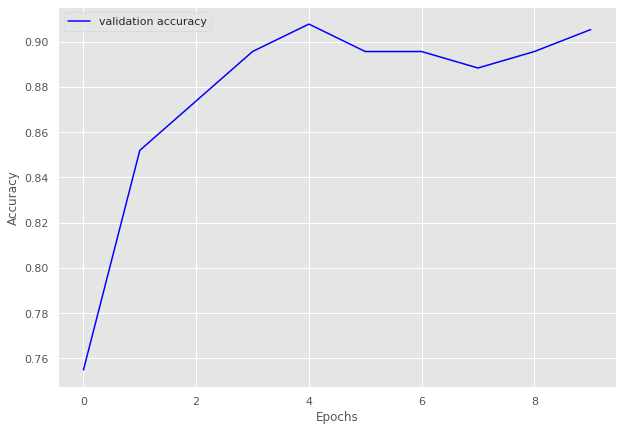

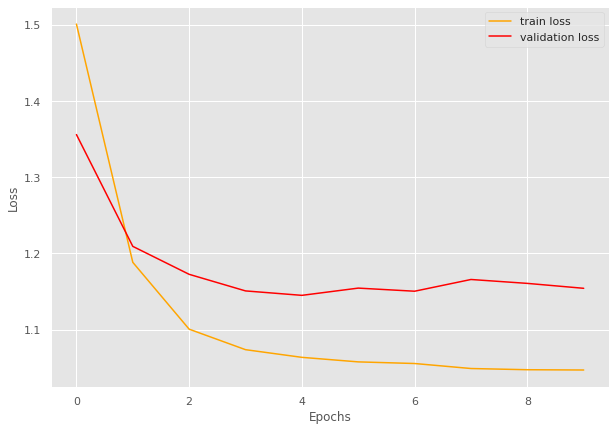

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 5/5 [00:05<00:00,  1.05s/batch, loss=0.531]


train loss 0.5312455594539642, validation loss 0.43067290385564166, validation accuracy 0.8930817610062893
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 5/5 [00:04<00:00,  1.23batch/s, loss=0.35] 


train loss 0.3495435893535614, validation loss 0.3638811508814494, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 5/5 [00:03<00:00,  1.50batch/s, loss=0.326]


train loss 0.3264113306999207, validation loss 0.35650286078453064, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 5/5 [00:03<00:00,  1.52batch/s, loss=0.317]


train loss 0.3172897517681122, validation loss 0.3532568116982778, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.83batch/s, loss=0.314]


train loss 0.3139218747615814, validation loss 0.3510662019252777, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 5/5 [00:05<00:00,  1.08s/batch, loss=0.314]


INFO: Early stopping counter 1 of 5
train loss 0.3139455854892731, validation loss 0.3516126374403636, validation accuracy 0.949685534591195
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 5/5 [00:05<00:00,  1.05s/batch, loss=0.314]


train loss 0.31433805227279665, validation loss 0.3479126791159312, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 5/5 [00:04<00:00,  1.18batch/s, loss=0.314]


train loss 0.3135328710079193, validation loss 0.3459336956342061, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 5/5 [00:03<00:00,  1.34batch/s, loss=0.313]


INFO: Early stopping counter 2 of 5
train loss 0.31339901089668276, validation loss 0.3481485644976298, validation accuracy 0.949685534591195
Coarse label 5 Epoch 10
-------------------------------


100%|██████████| 5/5 [00:04<00:00,  1.11batch/s, loss=0.314]


INFO: Early stopping counter 3 of 5
train loss 0.3135513663291931, validation loss 0.3491513133049011, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 11
-------------------------------


100%|██████████| 5/5 [00:03<00:00,  1.32batch/s, loss=0.314]


INFO: Early stopping counter 4 of 5
train loss 0.3135761499404907, validation loss 0.34922971328099567, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 12
-------------------------------


100%|██████████| 5/5 [00:05<00:00,  1.00s/batch, loss=0.314]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9624447717231223 and loss 0.34805610845255297


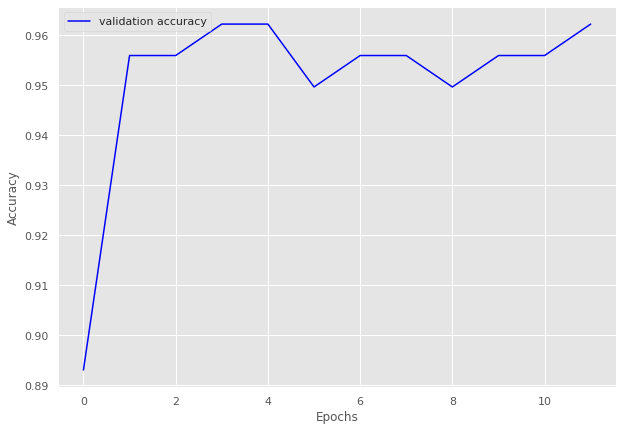

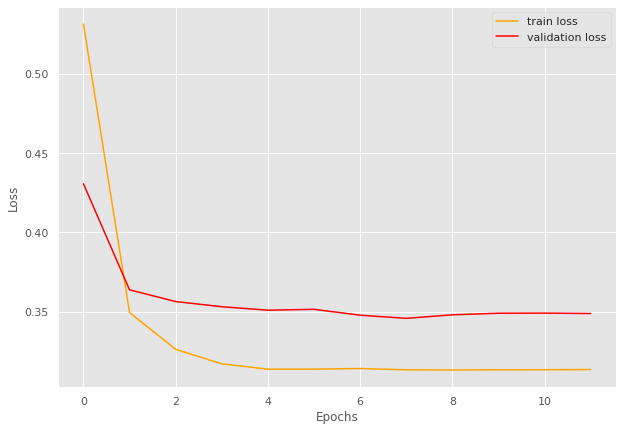

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  3.00batch/s, loss=1.61]


train loss 1.609442400932312, validation loss 1.3415271490812302, validation accuracy 0.8469827586206896
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.75batch/s, loss=1.28]


train loss 1.2760749022165934, validation loss 1.2451913952827454, validation accuracy 0.9224137931034483
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.99batch/s, loss=1.21]


INFO: Early stopping counter 1 of 5
train loss 1.2127164204915364, validation loss 1.2453454434871674, validation accuracy 0.915948275862069
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.90batch/s, loss=1.2]


INFO: Early stopping counter 2 of 5
train loss 1.1967111349105835, validation loss 1.257181629538536, validation accuracy 0.9051724137931034
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.98batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1894649585088095, validation loss 1.2554295659065247, validation accuracy 0.9094827586206896
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.97batch/s, loss=1.18]


INFO: Early stopping counter 4 of 5
train loss 1.184398357073466, validation loss 1.2561014741659164, validation accuracy 0.9073275862068966
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.93batch/s, loss=1.18]


train loss 1.1823346217473347, validation loss 1.2379439920186996, validation accuracy 0.9245689655172413
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.00batch/s, loss=1.18]


train loss 1.1799129247665405, validation loss 1.2309480607509613, validation accuracy 0.9331896551724138
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.96batch/s, loss=1.18]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9113126732174351 and loss 1.2540007286071777


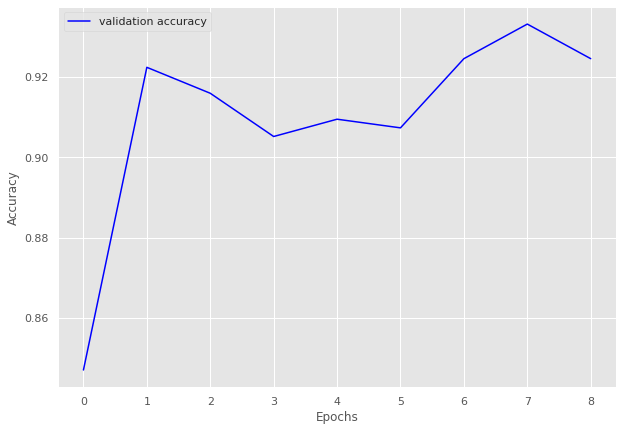

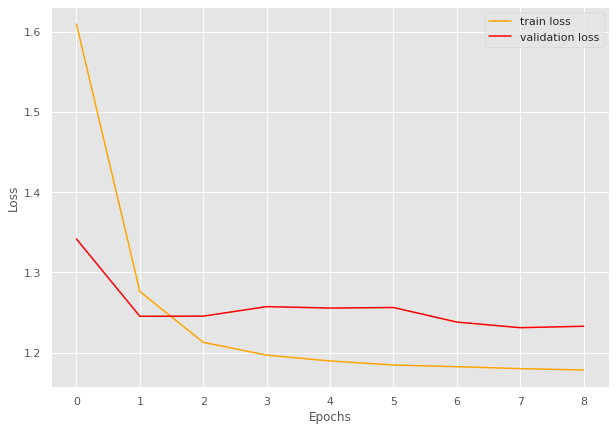

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.06batch/s, loss=1.08]


train loss 1.0763284961382549, validation loss 0.8382705251375834, validation accuracy 0.9256198347107438
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.96batch/s, loss=0.791]


train loss 0.7909039556980133, validation loss 0.8044789731502533, validation accuracy 0.9393939393939394
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.06batch/s, loss=0.759]


train loss 0.7594480812549591, validation loss 0.8025747636953989, validation accuracy 0.9393939393939394
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.03batch/s, loss=0.752]


INFO: Early stopping counter 1 of 5
train loss 0.7519369373718897, validation loss 0.8032428522904714, validation accuracy 0.9338842975206612
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.08batch/s, loss=0.749]


train loss 0.7494178315003713, validation loss 0.8002613385518392, validation accuracy 0.9393939393939394
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.97batch/s, loss=0.747]


INFO: Early stopping counter 2 of 5
train loss 0.7468330562114716, validation loss 0.8024417360623678, validation accuracy 0.9366391184573003
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.07batch/s, loss=0.747]


INFO: Early stopping counter 3 of 5
train loss 0.7467499524354935, validation loss 0.8029421170552572, validation accuracy 0.9338842975206612
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.95batch/s, loss=0.749]


INFO: Early stopping counter 4 of 5
train loss 0.749063844482104, validation loss 0.8115667700767517, validation accuracy 0.928374655647383
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.08batch/s, loss=0.748]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9533462033462033 and loss 0.793111614426788


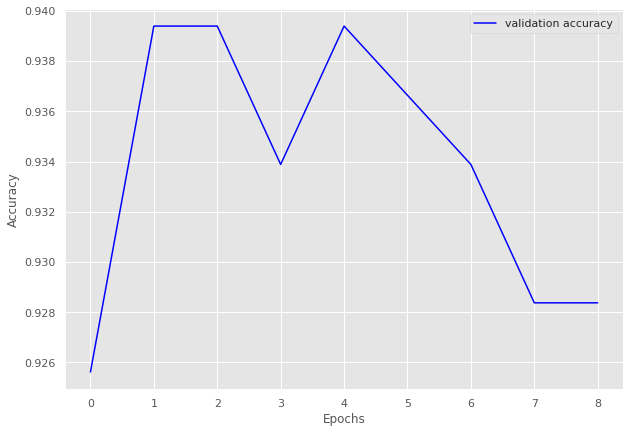

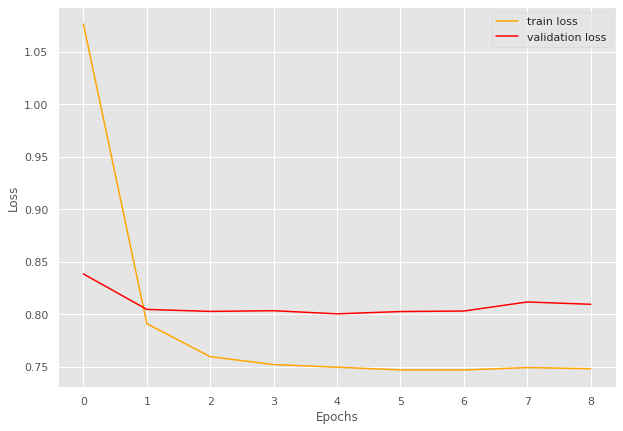

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.09batch/s, loss=1.69]


train loss 1.6906674609464758, validation loss 1.3870113641023636, validation accuracy 0.8238747553816047
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 17/17 [00:06<00:00,  2.78batch/s, loss=1.34]


train loss 1.3368684754652136, validation loss 1.2876243740320206, validation accuracy 0.898238747553816
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.08batch/s, loss=1.26]


train loss 1.2615750467076021, validation loss 1.2786169648170471, validation accuracy 0.8923679060665362
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=1.25]


train loss 1.2498001000460457, validation loss 1.266796588897705, validation accuracy 0.9060665362035225
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=1.24]


train loss 1.242741213125341, validation loss 1.265922948718071, validation accuracy 0.913894324853229
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  2.85batch/s, loss=1.24]


train loss 1.236754017717698, validation loss 1.2607842832803726, validation accuracy 0.9099804305283757
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.02batch/s, loss=1.23]


INFO: Early stopping counter 1 of 5
train loss 1.225629820543177, validation loss 1.2686437219381332, validation accuracy 0.9080234833659491
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.10batch/s, loss=1.22]


INFO: Early stopping counter 2 of 5
train loss 1.2159973803688497, validation loss 1.267490804195404, validation accuracy 0.9041095890410958
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.00batch/s, loss=1.22]


train loss 1.2240484462064856, validation loss 1.2556746155023575, validation accuracy 0.923679060665362
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.00batch/s, loss=1.23]


train loss 1.2260327339172363, validation loss 1.2503870129585266, validation accuracy 0.9178082191780822
Coarse label 8 Epoch 11
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=1.23]


INFO: Early stopping counter 3 of 5
train loss 1.225420685375438, validation loss 1.2544217705726624, validation accuracy 0.913894324853229
Coarse label 8 Epoch 12
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=1.23]


INFO: Early stopping counter 4 of 5
train loss 1.2255244675804586, validation loss 1.2549345642328262, validation accuracy 0.923679060665362
Coarse label 8 Epoch 13
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  2.99batch/s, loss=1.21]


train loss 1.2119412001441507, validation loss 1.249790608882904, validation accuracy 0.9158512720156555
Coarse label 8 Epoch 14
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.03batch/s, loss=1.23]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9009390746678883 and loss 1.266034839797194


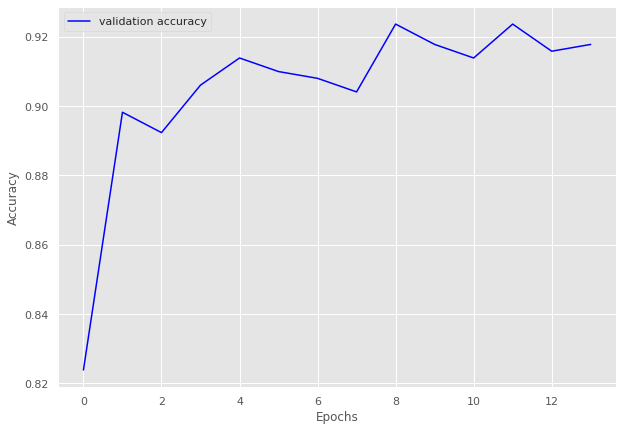

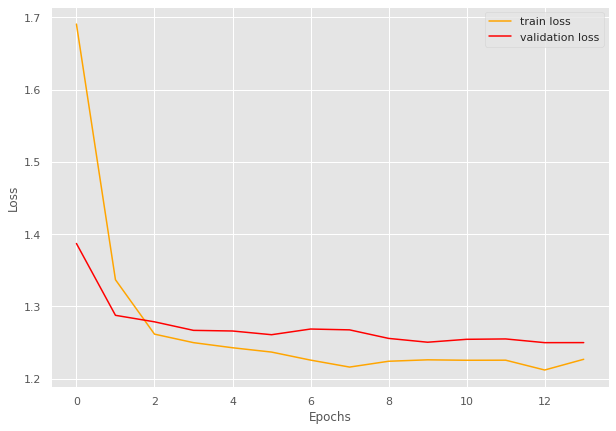

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  3.00batch/s, loss=1.92]


train loss 1.9225839149384272, validation loss 1.7400211095809937, validation accuracy 0.7854938271604939
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.99batch/s, loss=1.63]


train loss 1.6276009366625832, validation loss 1.6293078119104558, validation accuracy 0.8734567901234568
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 21/21 [00:06<00:00,  3.00batch/s, loss=1.55]


train loss 1.5521561872391474, validation loss 1.5798103375868364, validation accuracy 0.9012345679012346
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 21/21 [00:08<00:00,  2.42batch/s, loss=1.52]


train loss 1.5190819104512532, validation loss 1.5797585248947144, validation accuracy 0.8996913580246914
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.94batch/s, loss=1.5] 


train loss 1.503260714667184, validation loss 1.5699360045519741, validation accuracy 0.9027777777777778
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.95batch/s, loss=1.5] 


INFO: Early stopping counter 1 of 5
train loss 1.4959359509604317, validation loss 1.5730658661235462, validation accuracy 0.9120370370370371
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 21/21 [00:06<00:00,  3.01batch/s, loss=1.49]


train loss 1.4861815656934465, validation loss 1.5687628117474643, validation accuracy 0.9058641975308642
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.99batch/s, loss=1.48]


INFO: Early stopping counter 2 of 5
train loss 1.4805926652181716, validation loss 1.5713616826317527, validation accuracy 0.9074074074074074
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 21/21 [00:06<00:00,  3.00batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.475555488041469, validation loss 1.5740442601117222, validation accuracy 0.9074074074074074
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.99batch/s, loss=1.47]


INFO: Early stopping counter 4 of 5
train loss 1.4738811368034, validation loss 1.5801859118721702, validation accuracy 0.8996913580246914
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.99batch/s, loss=1.47]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9195911722141823 and loss 1.5454394631303114


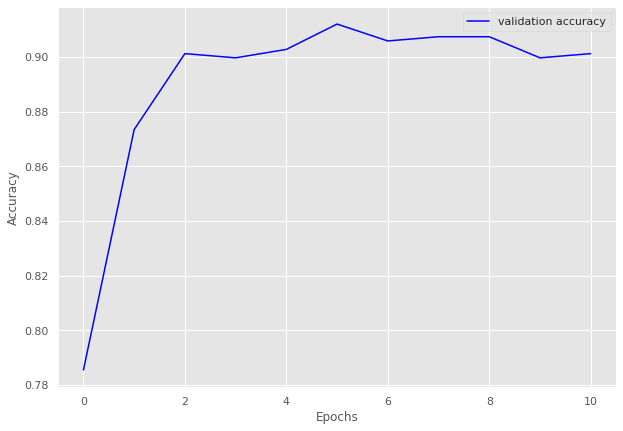

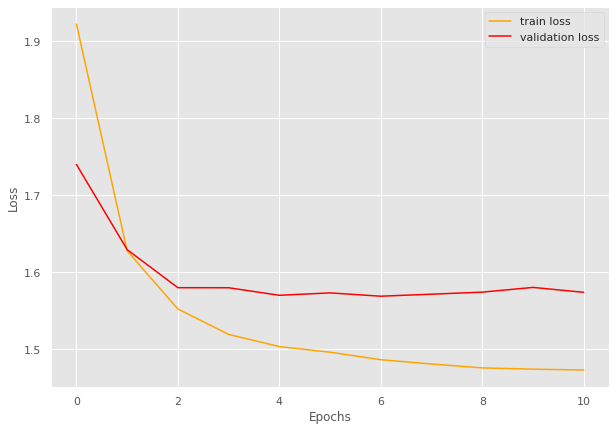

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=1.11]


train loss 1.1142551481723786, validation loss 0.8910733461380005, validation accuracy 0.8980263157894737
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.97batch/s, loss=0.799]


train loss 0.7990632951259613, validation loss 0.7888797640800476, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.756]


train loss 0.7562589943408966, validation loss 0.7755064487457275, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.01batch/s, loss=0.749]


train loss 0.7487078011035919, validation loss 0.7722824811935425, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.746]


train loss 0.7464439272880554, validation loss 0.772195327281952, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.07batch/s, loss=0.745]


INFO: Early stopping counter 1 of 5
train loss 0.7448112845420838, validation loss 0.7732903838157654, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.07batch/s, loss=0.745]


INFO: Early stopping counter 2 of 5
train loss 0.744568383693695, validation loss 0.7732506632804871, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.06batch/s, loss=0.745]


train loss 0.7446287930011749, validation loss 0.7711760640144348, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.744]


train loss 0.7444422304630279, validation loss 0.770453155040741, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.00batch/s, loss=0.744]


train loss 0.7443532824516297, validation loss 0.7678279757499695, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=0.744]


INFO: Early stopping counter 3 of 5
train loss 0.7439864695072174, validation loss 0.7684901475906372, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 12
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.08batch/s, loss=0.744]


INFO: Early stopping counter 4 of 5
train loss 0.7444813191890717, validation loss 0.769590163230896, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 13
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.92batch/s, loss=0.745]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9577978131594092 and loss 0.7856612263656244


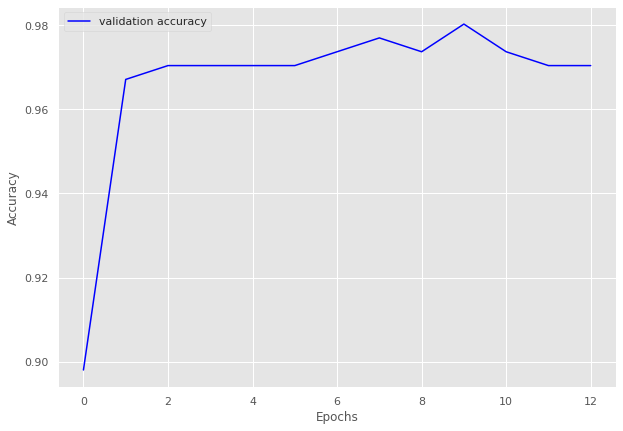

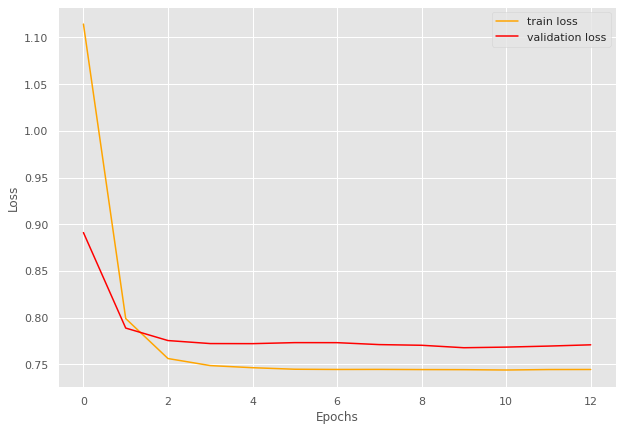

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.23batch/s, loss=1.65]


train loss 1.6492498397827149, validation loss 1.5043907642364502, validation accuracy 0.6
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.22batch/s, loss=1.34]


train loss 1.3378928065299989, validation loss 1.2879027366638183, validation accuracy 0.7896551724137931
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=1.15]


train loss 1.1511869549751281, validation loss 1.2077569246292115, validation accuracy 0.8517241379310345
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=1.11]


train loss 1.109569489955902, validation loss 1.1840587854385376, validation accuracy 0.8724137931034482
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=1.07]


train loss 1.0728456020355224, validation loss 1.1769432783126832, validation accuracy 0.8724137931034482
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.21batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.076988661289215, validation loss 1.1790749549865722, validation accuracy 0.8724137931034482
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.23batch/s, loss=1.08]


train loss 1.076178002357483, validation loss 1.176056694984436, validation accuracy 0.8689655172413793
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0659782767295838, validation loss 1.1914116859436035, validation accuracy 0.8551724137931035
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=1.06]


train loss 1.058368945121765, validation loss 1.169438862800598, validation accuracy 0.8827586206896552
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.16batch/s, loss=1.06]


train loss 1.0643725275993348, validation loss 1.1674282550811768, validation accuracy 0.8827586206896552
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=1.05]


train loss 1.054344654083252, validation loss 1.1607043504714967, validation accuracy 0.8931034482758621
Coarse label 12 Epoch 12
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.07batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0710428595542907, validation loss 1.1789411783218384, validation accuracy 0.8620689655172413
Coarse label 12 Epoch 13
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.20batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0620625019073486, validation loss 1.1912347078323364, validation accuracy 0.8517241379310345
Coarse label 12 Epoch 14
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.8817981135861931 and loss 1.167261738043565


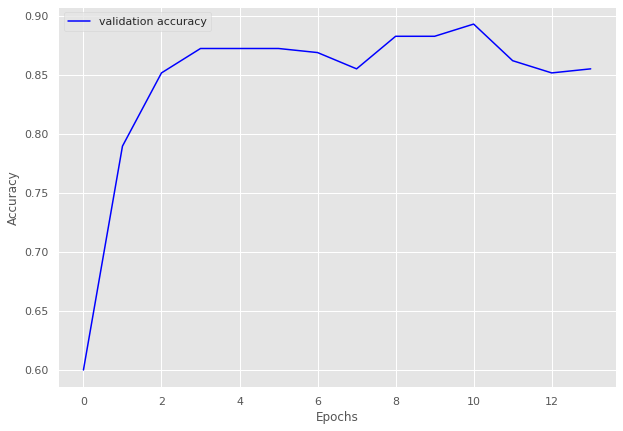

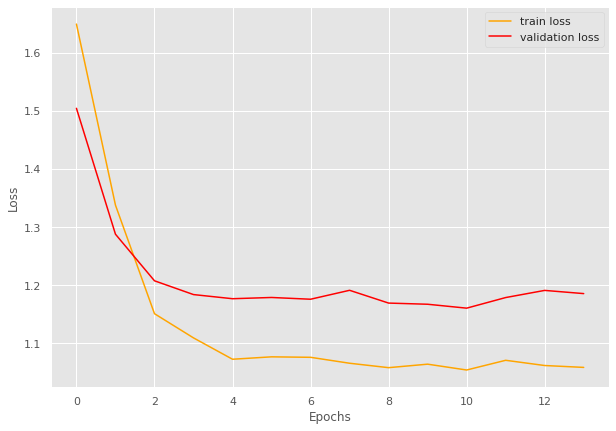

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.21batch/s, loss=0.836]


train loss 0.8361024061838785, validation loss 0.6834372282028198, validation accuracy 0.8918918918918919
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.24batch/s, loss=0.608]


train loss 0.6075356271531847, validation loss 0.6244528293609619, validation accuracy 0.9266409266409267
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.17batch/s, loss=0.587]


train loss 0.5873727401097616, validation loss 0.6145638704299927, validation accuracy 0.9227799227799228
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.08batch/s, loss=0.577]


train loss 0.5768363078435262, validation loss 0.6134952425956726, validation accuracy 0.918918918918919
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.24batch/s, loss=0.57] 


INFO: Early stopping counter 1 of 5
train loss 0.569571872552236, validation loss 0.6388434410095215, validation accuracy 0.918918918918919
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.25batch/s, loss=0.578]


INFO: Early stopping counter 2 of 5
train loss 0.5779230660862393, validation loss 0.6215421438217164, validation accuracy 0.9111969111969112
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.21batch/s, loss=0.601]


INFO: Early stopping counter 3 of 5
train loss 0.6008637150128683, validation loss 0.6329393982887268, validation accuracy 0.9034749034749034
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.25batch/s, loss=0.568]


INFO: Early stopping counter 4 of 5
train loss 0.5680195358064439, validation loss 0.6206986904144287, validation accuracy 0.915057915057915
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.22batch/s, loss=0.559]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9077340569877883 and loss 0.6415388149874551


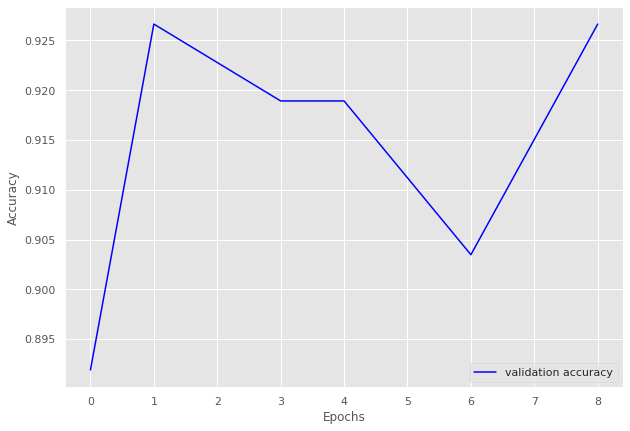

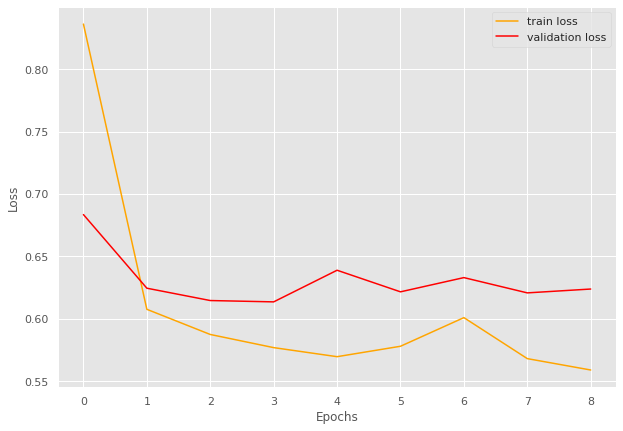

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.91batch/s, loss=1.4] 


train loss 1.4013569355010986, validation loss 1.1704840779304504, validation accuracy 0.8872053872053872
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=1.1] 


train loss 1.1011982215078253, validation loss 1.1181626558303832, validation accuracy 0.9276094276094277
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.97batch/s, loss=1.07]


train loss 1.0719945807206004, validation loss 1.113664722442627, validation accuracy 0.9276094276094277
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=1.06]


train loss 1.0646946116497642, validation loss 1.1092998027801513, validation accuracy 0.9276094276094277
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.97batch/s, loss=1.06]


train loss 1.0612147230851023, validation loss 1.1049958229064942, validation accuracy 0.9377104377104377
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0598203759444387, validation loss 1.106740653514862, validation accuracy 0.9377104377104377
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=1.06]


train loss 1.0572466411088641, validation loss 1.099665606021881, validation accuracy 0.9393939393939394
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.93batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.05211667638076, validation loss 1.1104289531707763, validation accuracy 0.930976430976431
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.87batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0528644574315924, validation loss 1.1040029168128966, validation accuracy 0.9377104377104377
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.96batch/s, loss=1.05]


train loss 1.0533069999594438, validation loss 1.0966512560844421, validation accuracy 0.9511784511784511
Coarse label 14 Epoch 11
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.97batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0526383676026996, validation loss 1.1042180061340332, validation accuracy 0.9343434343434344
Coarse label 14 Epoch 12
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.93batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.942654448714159 and loss 1.1024645409494076


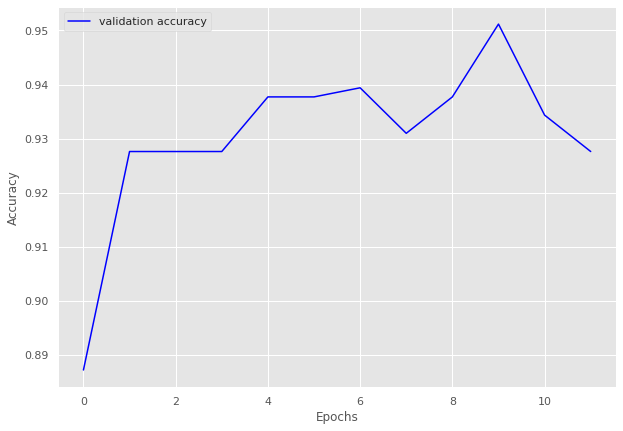

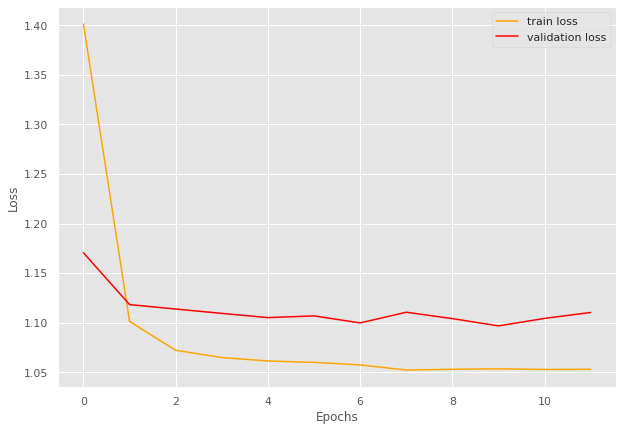

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=1.15]


train loss 1.1540368616580963, validation loss 0.9528374075889587, validation accuracy 0.8061224489795918
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.12batch/s, loss=0.838]


train loss 0.8383527815341949, validation loss 0.8498587012290955, validation accuracy 0.891156462585034
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.764]


train loss 0.7641733407974243, validation loss 0.8295319676399231, validation accuracy 0.9149659863945578
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=0.763]


INFO: Early stopping counter 1 of 5
train loss 0.7626816868782044, validation loss 0.8316996335983277, validation accuracy 0.9013605442176871
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=0.754]


INFO: Early stopping counter 2 of 5
train loss 0.7535532236099243, validation loss 0.8352131843566895, validation accuracy 0.9013605442176871
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.764]


INFO: Early stopping counter 3 of 5
train loss 0.7638243854045867, validation loss 0.8359713912010193, validation accuracy 0.8979591836734694
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.757]


INFO: Early stopping counter 4 of 5
train loss 0.7568856596946716, validation loss 0.8387860774993896, validation accuracy 0.9047619047619048
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.10batch/s, loss=0.753]


train loss 0.7525697410106659, validation loss 0.8198076128959656, validation accuracy 0.9217687074829932
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.14batch/s, loss=0.751]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9299820466786356 and loss 0.817009652717204


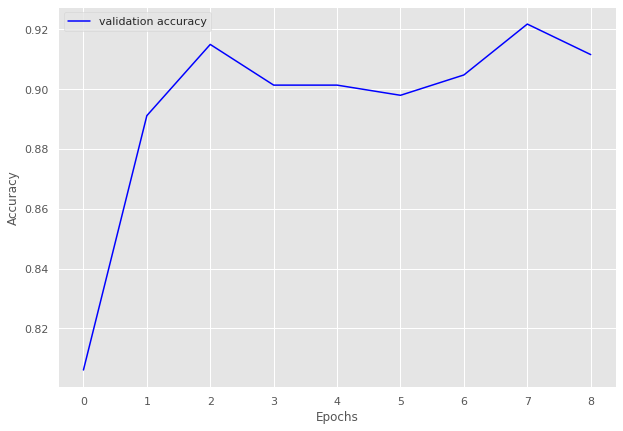

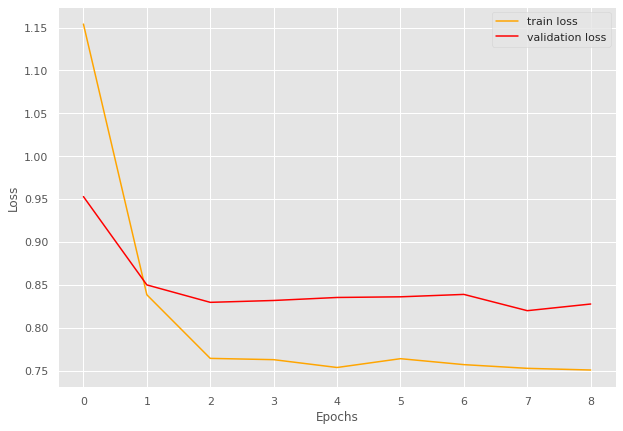

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.97batch/s, loss=0.87] 


train loss 0.8699389828575982, validation loss 0.7686069488525391, validation accuracy 0.8085106382978723
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.01batch/s, loss=0.598]


train loss 0.5981666578186883, validation loss 0.6541407585144043, validation accuracy 0.8971631205673759
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.99batch/s, loss=0.567]


train loss 0.5672676761945089, validation loss 0.6291270613670349, validation accuracy 0.9184397163120568
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.98batch/s, loss=0.562]


INFO: Early stopping counter 1 of 5
train loss 0.5617307557000054, validation loss 0.6311661720275878, validation accuracy 0.9113475177304965
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.95batch/s, loss=0.557]


train loss 0.5567867424752977, validation loss 0.6251895546913147, validation accuracy 0.9184397163120568
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.95batch/s, loss=0.558]


train loss 0.557836671670278, validation loss 0.62243093252182, validation accuracy 0.925531914893617
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.96batch/s, loss=0.554]


train loss 0.5536090731620789, validation loss 0.6206140875816345, validation accuracy 0.925531914893617
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.95batch/s, loss=0.552]


INFO: Early stopping counter 2 of 5
train loss 0.5524862541092767, validation loss 0.6227400898933411, validation accuracy 0.925531914893617
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.88batch/s, loss=0.552]


INFO: Early stopping counter 3 of 5
train loss 0.5520723594559563, validation loss 0.6265617728233337, validation accuracy 0.925531914893617
Coarse label 16 Epoch 10
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.99batch/s, loss=0.552]


INFO: Early stopping counter 4 of 5
train loss 0.5518871148427328, validation loss 0.6275615453720093, validation accuracy 0.925531914893617
Coarse label 16 Epoch 11
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.00batch/s, loss=0.552]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9343171897734359 and loss 0.6171748002893046


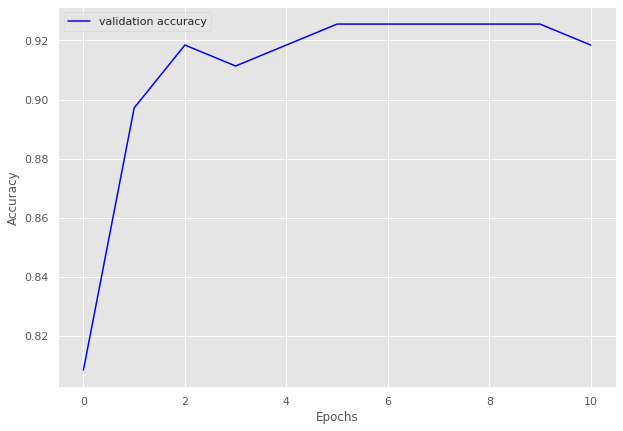

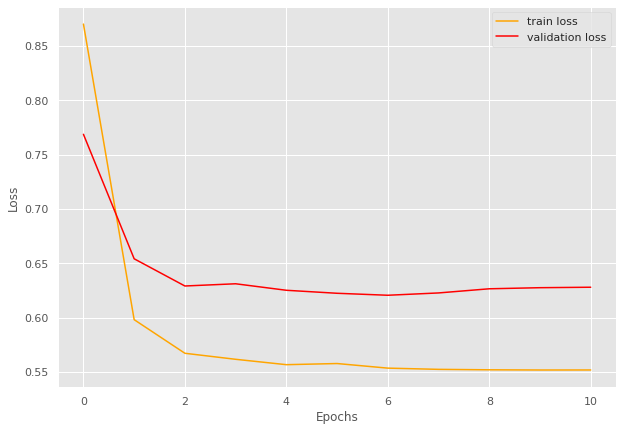

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 17 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.03batch/s, loss=1.17]


train loss 1.1691760420799255, validation loss 0.9820995569229126, validation accuracy 0.8058252427184466
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.96batch/s, loss=0.882]


train loss 0.8819161057472229, validation loss 0.8757635951042175, validation accuracy 0.8705501618122977
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.796]


train loss 0.7956911623477936, validation loss 0.8489590048789978, validation accuracy 0.8996763754045307
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.92batch/s, loss=0.762]


train loss 0.7618473768234253, validation loss 0.8430176258087159, validation accuracy 0.9093851132686084
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.99batch/s, loss=0.753]


train loss 0.7533216297626495, validation loss 0.8313078999519348, validation accuracy 0.9029126213592233
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.66batch/s, loss=0.747]


INFO: Early stopping counter 1 of 5
train loss 0.7471161961555481, validation loss 0.8340107321739196, validation accuracy 0.9061488673139159
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.00batch/s, loss=0.748]


INFO: Early stopping counter 2 of 5
train loss 0.7483906507492065, validation loss 0.8347945928573608, validation accuracy 0.9029126213592233
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.89batch/s, loss=0.75]


INFO: Early stopping counter 3 of 5
train loss 0.7495267868041993, validation loss 0.8341234564781189, validation accuracy 0.9029126213592233
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.745]


INFO: Early stopping counter 4 of 5
train loss 0.7449769496917724, validation loss 0.8351838827133179, validation accuracy 0.8996763754045307
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=0.745]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9150227617602428 and loss 0.8307226350508541


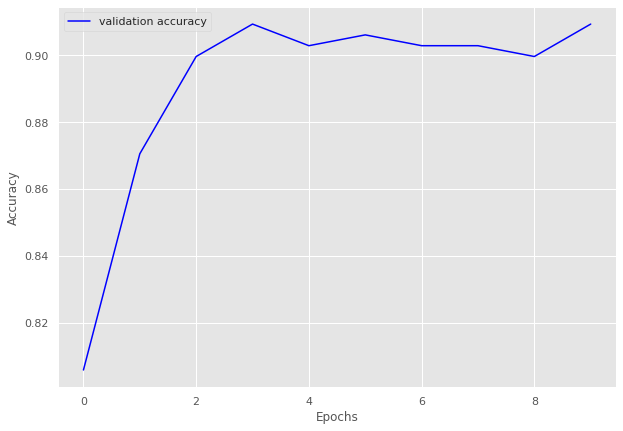

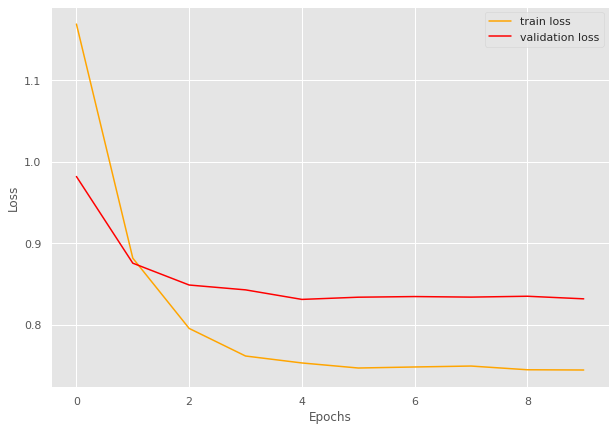

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 19 Epoch 1
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.71batch/s, loss=1.3] 


train loss 1.304359883069992, validation loss 1.2346015572547913, validation accuracy 0.5833333333333334
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.77batch/s, loss=1.02] 


train loss 1.0176478028297424, validation loss 1.0917295813560486, validation accuracy 0.8020833333333334
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.78batch/s, loss=0.899]


train loss 0.8994244784116745, validation loss 0.9734327495098114, validation accuracy 0.8229166666666666
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.72batch/s, loss=0.848]


train loss 0.847764864563942, validation loss 0.925430178642273, validation accuracy 0.8645833333333334
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.75batch/s, loss=0.821]


train loss 0.8206856101751328, validation loss 0.9032400846481323, validation accuracy 0.875
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.30batch/s, loss=0.768]


train loss 0.7677298486232758, validation loss 0.8936232924461365, validation accuracy 0.8854166666666666
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.68batch/s, loss=0.785]


train loss 0.7851207852363586, validation loss 0.8767664432525635, validation accuracy 0.90625
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.68batch/s, loss=0.769]


train loss 0.7694918513298035, validation loss 0.8726746737957001, validation accuracy 0.8958333333333334
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.66batch/s, loss=0.867]


train loss 0.8667901903390884, validation loss 0.8667655289173126, validation accuracy 0.90625
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.55batch/s, loss=0.768]


train loss 0.7676899880170822, validation loss 0.8639783561229706, validation accuracy 0.8958333333333334
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.77batch/s, loss=0.817]


INFO: Early stopping counter 1 of 5
train loss 0.8165448158979416, validation loss 0.873289555311203, validation accuracy 0.8645833333333334
Coarse label 19 Epoch 12
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.69batch/s, loss=0.756]


INFO: Early stopping counter 2 of 5
train loss 0.7564720809459686, validation loss 0.8755922913551331, validation accuracy 0.8645833333333334
Coarse label 19 Epoch 13
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.76batch/s, loss=0.773]


INFO: Early stopping counter 3 of 5
train loss 0.7734023183584213, validation loss 0.8769210875034332, validation accuracy 0.8645833333333334
Coarse label 19 Epoch 14
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.74batch/s, loss=0.819]


train loss 0.8186616003513336, validation loss 0.8588175773620605, validation accuracy 0.8854166666666666
Coarse label 19 Epoch 15
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.75batch/s, loss=0.756]


INFO: Early stopping counter 4 of 5
train loss 0.755939707159996, validation loss 0.8676721751689911, validation accuracy 0.90625
Coarse label 19 Epoch 16
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.46batch/s, loss=0.828]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.85431654676259 and loss 0.8909692521448489


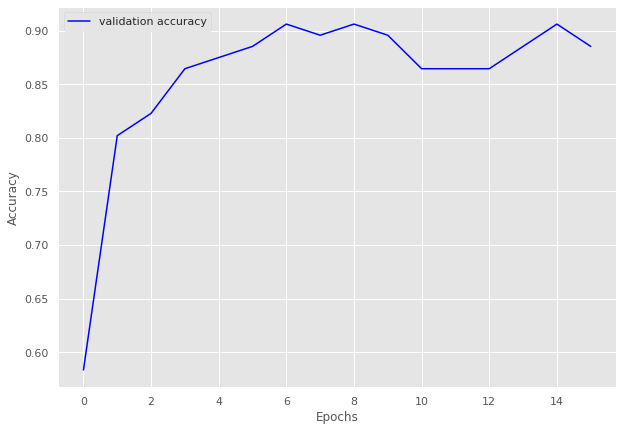

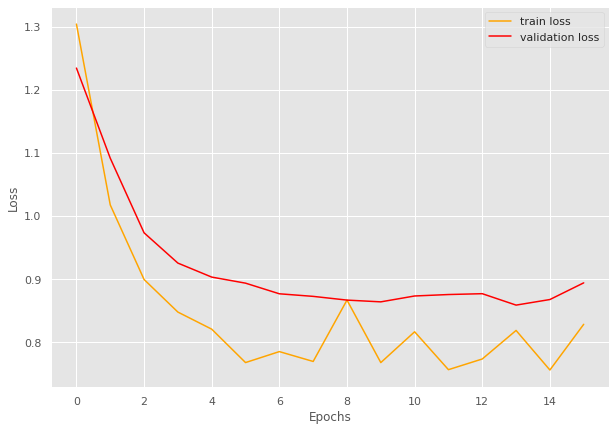

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Evaluating fine model 0
Evaluating fine model 1
Evaluating fine model 2
Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16
Evaluating fine model 17
Evaluating fine model 19
overall accuracy  is 0.7437528396183553
{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.93423053527980

Calculating for volume 25
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.21]


train loss 1.2111939979451043, validation loss 0.9767382315226963, validation accuracy 0.9277389277389277
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=0.984]


train loss 0.9843061630214963, validation loss 0.9723613347326007, validation accuracy 0.9370629370629371
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.02batch/s, loss=0.959]


train loss 0.9590522881065097, validation loss 0.9721534677914211, validation accuracy 0.9324009324009324
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=0.963]


train loss 0.9634471046073096, validation loss 0.9628202489444188, validation accuracy 0.9440559440559441
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=0.951]


train loss 0.9507262791906085, validation loss 0.9595357349940709, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:13<00:00,  2.12batch/s, loss=0.968]


INFO: Early stopping counter 1 of 5
train loss 0.9678910885538373, validation loss 0.9678853750228882, validation accuracy 0.9370629370629371
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.04batch/s, loss=0.93] 


train loss 0.9304510461432594, validation loss 0.9574341518538338, validation accuracy 0.9487179487179487
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.01batch/s, loss=0.94] 


INFO: Early stopping counter 2 of 5
train loss 0.9398988762072155, validation loss 0.9658585446221488, validation accuracy 0.9370629370629371
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=0.923]


train loss 0.9226096868515015, validation loss 0.9509508950369698, validation accuracy 0.9557109557109557
Coarse label 0 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:13<00:00,  2.01batch/s, loss=0.946]


INFO: Early stopping counter 3 of 5
train loss 0.9460528833525521, validation loss 0.9653810177530561, validation accuracy 0.9370629370629371
Coarse label 0 Epoch 11
-------------------------------


100%|██████████| 28/28 [00:17<00:00,  1.64batch/s, loss=0.943]


INFO: Early stopping counter 4 of 5
train loss 0.9434538036584854, validation loss 0.9668099284172058, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 12
-------------------------------


100%|██████████| 28/28 [00:16<00:00,  1.73batch/s, loss=0.942]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9372301048735349 and loss 0.9668282901539522


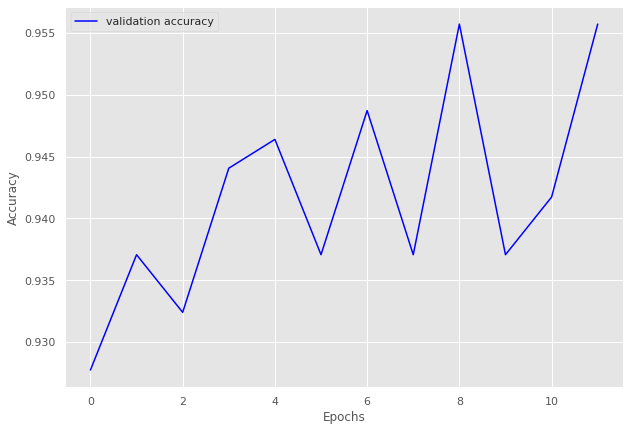

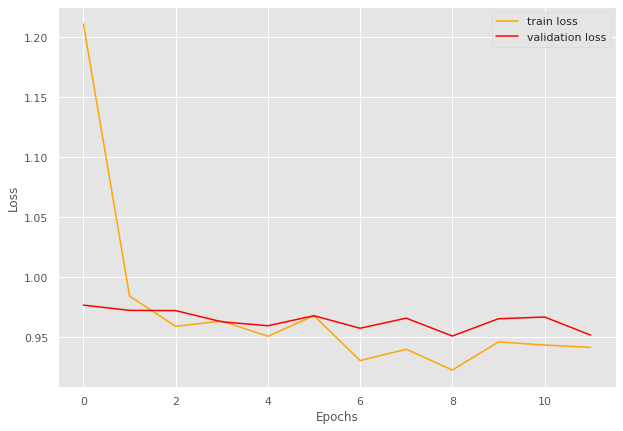

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 1 Epoch 1
-------------------------------


100%|██████████| 12/12 [00:07<00:00,  1.58batch/s, loss=1.45]


train loss 1.4474964340527852, validation loss 1.2759878635406494, validation accuracy 0.7849462365591398
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 12/12 [00:11<00:00,  1.03batch/s, loss=1.13]


train loss 1.1349161366621654, validation loss 1.1861074765523274, validation accuracy 0.8602150537634409
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 12/12 [00:07<00:00,  1.52batch/s, loss=1.08]


train loss 1.0826923350493114, validation loss 1.1519800821940105, validation accuracy 0.8817204301075269
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 12/12 [00:06<00:00,  1.98batch/s, loss=1.06]


train loss 1.0638809601465862, validation loss 1.1359192927678425, validation accuracy 0.9032258064516129
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 12/12 [00:10<00:00,  1.09batch/s, loss=1.05]


INFO: Early stopping counter 1 of 5
train loss 1.0522872110207875, validation loss 1.14237642288208, validation accuracy 0.8978494623655914
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 12/12 [00:09<00:00,  1.26batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.0509377121925354, validation loss 1.1469165881474812, validation accuracy 0.8817204301075269
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 12/12 [00:08<00:00,  1.35batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0470741391181946, validation loss 1.1367470820744832, validation accuracy 0.9032258064516129
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 12/12 [00:11<00:00,  1.05batch/s, loss=1.05]


train loss 1.046318789323171, validation loss 1.1256659030914307, validation accuracy 0.9247311827956989
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 12/12 [00:06<00:00,  1.77batch/s, loss=1.04]


INFO: Early stopping counter 4 of 5
train loss 1.044957846403122, validation loss 1.1264431079228718, validation accuracy 0.9247311827956989
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 12/12 [00:07<00:00,  1.68batch/s, loss=1.04]


train loss 1.0449671745300293, validation loss 1.118922233581543, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.99batch/s, loss=1.05]


train loss 1.0459735492865245, validation loss 1.118740200996399, validation accuracy 0.9247311827956989
Coarse label 1 Epoch 12
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.99batch/s, loss=1.04]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9337818696883853 and loss 1.1096822049882678


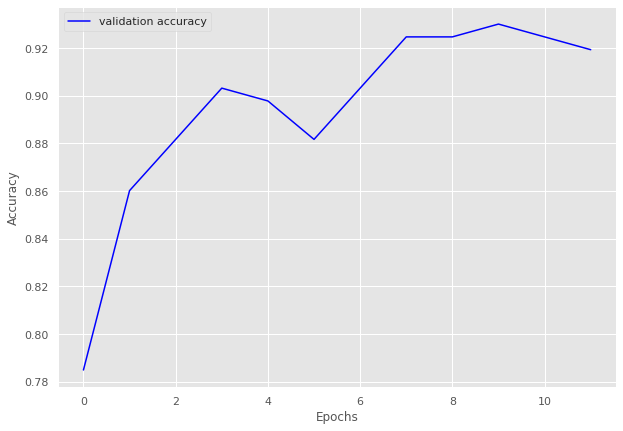

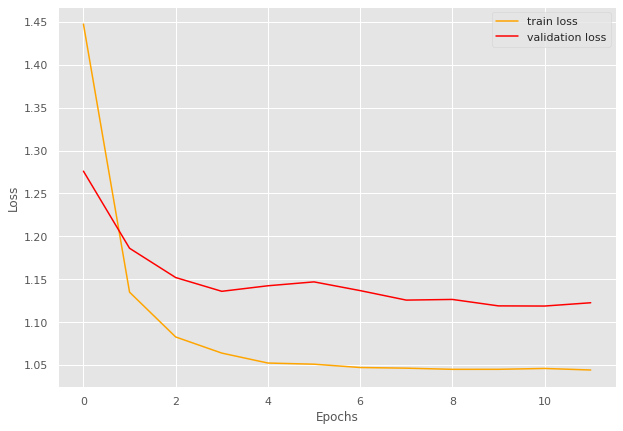

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 2 Epoch 1
-------------------------------


100%|██████████| 55/55 [00:19<00:00,  2.82batch/s, loss=1.8] 


train loss 1.8022237517616966, validation loss 1.5878195677484785, validation accuracy 0.8931034482758621
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.90batch/s, loss=1.56]


train loss 1.55534376447851, validation loss 1.5538131083760942, validation accuracy 0.9091954022988505
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 55/55 [00:19<00:00,  2.85batch/s, loss=1.52]


train loss 1.5176435947418212, validation loss 1.5389803307397025, validation accuracy 0.9287356321839081
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 55/55 [00:19<00:00,  2.88batch/s, loss=1.5] 


INFO: Early stopping counter 1 of 5
train loss 1.5046707023273815, validation loss 1.5435135875429427, validation accuracy 0.9264367816091954
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.92batch/s, loss=1.5] 


INFO: Early stopping counter 2 of 5
train loss 1.501566306027499, validation loss 1.5418989402907235, validation accuracy 0.9206896551724137
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.90batch/s, loss=1.5] 


train loss 1.4980163444172252, validation loss 1.5379961218152727, validation accuracy 0.9287356321839081
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.92batch/s, loss=1.49]


train loss 1.4898357304659757, validation loss 1.5338458333696638, validation accuracy 0.9333333333333333
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.92batch/s, loss=1.49]


train loss 1.4886896220120516, validation loss 1.5296426841190882, validation accuracy 0.9344827586206896
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.93batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4835315162485296, validation loss 1.5322883810315813, validation accuracy 0.9287356321839081
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.93batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4848463036797264, validation loss 1.5353337270872933, validation accuracy 0.9264367816091954
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 55/55 [00:19<00:00,  2.88batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9321015815085159 and loss 1.5304967570073396


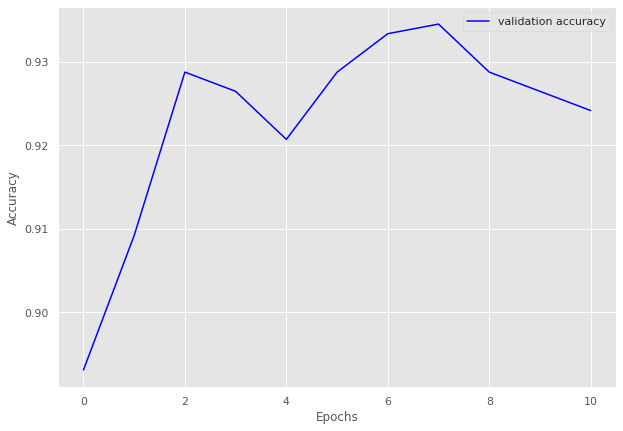

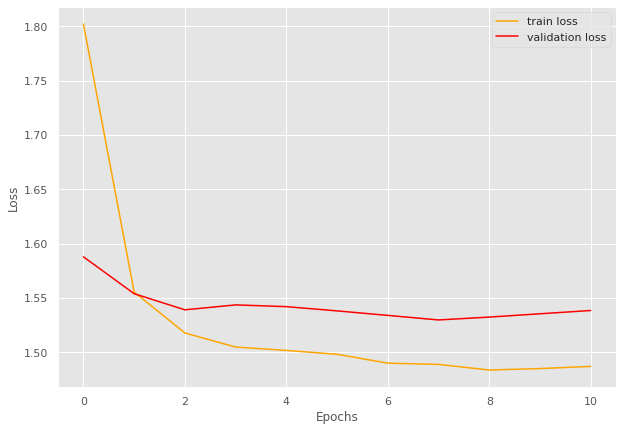

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.94batch/s, loss=1.4] 


train loss 1.3953189758154063, validation loss 1.2338775055749076, validation accuracy 0.8422330097087378
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.97batch/s, loss=1.13]


train loss 1.130325945524069, validation loss 1.139568533216204, validation accuracy 0.9150485436893204
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.94batch/s, loss=1.09]


train loss 1.0875676045050988, validation loss 1.1337234122412545, validation accuracy 0.9223300970873787
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.94batch/s, loss=1.08]


train loss 1.0797132803843572, validation loss 1.1168215785707747, validation accuracy 0.9344660194174758
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.97batch/s, loss=1.07]


train loss 1.0718710881013136, validation loss 1.110757895878383, validation accuracy 0.941747572815534
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.92batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0664663865016057, validation loss 1.1303866420473372, validation accuracy 0.9247572815533981
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.91batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0647458892602186, validation loss 1.1177541869027274, validation accuracy 0.9271844660194175
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.90batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0591070514458876, validation loss 1.1126443658556258, validation accuracy 0.9368932038834952
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.96batch/s, loss=1.06]


train loss 1.0624190202126136, validation loss 1.103543451854161, validation accuracy 0.9514563106796117
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.91batch/s, loss=1.06]


train loss 1.0582880331919744, validation loss 1.1020696333476476, validation accuracy 0.9368932038834952
Coarse label 4 Epoch 11
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.90batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.05536687374115, validation loss 1.10924688407353, validation accuracy 0.9393203883495146
Coarse label 4 Epoch 12
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.95batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9360605572555967 and loss 1.1083118660109383


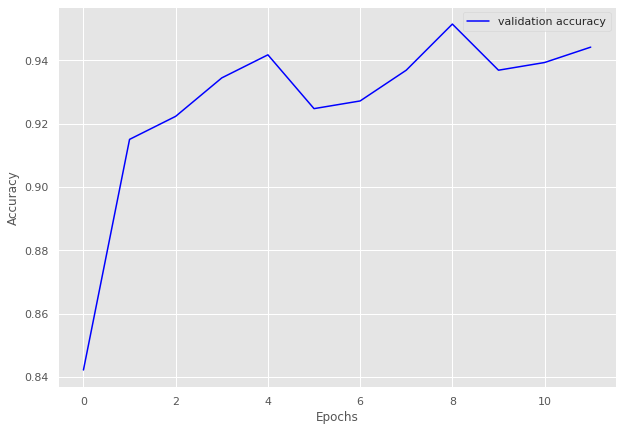

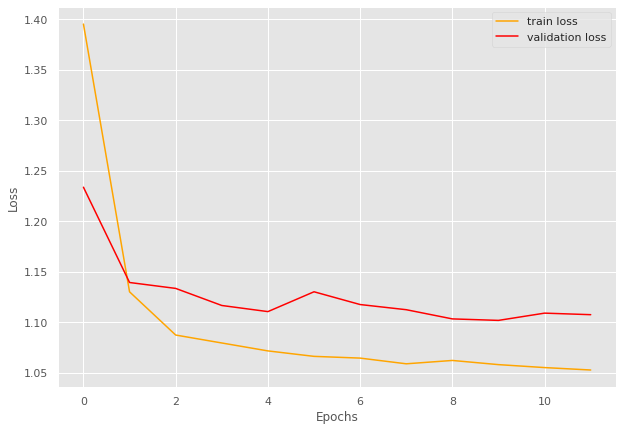

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.95batch/s, loss=0.458]


train loss 0.4582462817430496, validation loss 0.379669189453125, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.95batch/s, loss=0.33]


train loss 0.33036201894283296, validation loss 0.3433907429377238, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.92batch/s, loss=0.319]


train loss 0.31948937475681305, validation loss 0.3313848872979482, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=0.319]


INFO: Early stopping counter 1 of 5
train loss 0.3191604524850845, validation loss 0.34449735283851624, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.96batch/s, loss=0.315]


INFO: Early stopping counter 2 of 5
train loss 0.3149823933839798, validation loss 0.3459595739841461, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.94batch/s, loss=0.315]


INFO: Early stopping counter 3 of 5
train loss 0.31503120958805086, validation loss 0.3418254256248474, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.89batch/s, loss=0.314]


INFO: Early stopping counter 4 of 5
train loss 0.3137244522571564, validation loss 0.3340383569399516, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.95batch/s, loss=0.313]


train loss 0.31344794034957885, validation loss 0.33127252260843915, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.94batch/s, loss=0.313]


train loss 0.313388854265213, validation loss 0.32825390497843426, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.96batch/s, loss=0.313]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9787234042553191 and loss 0.33370176506669896


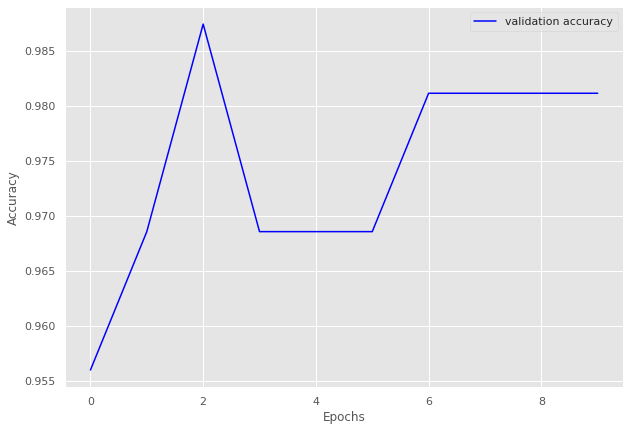

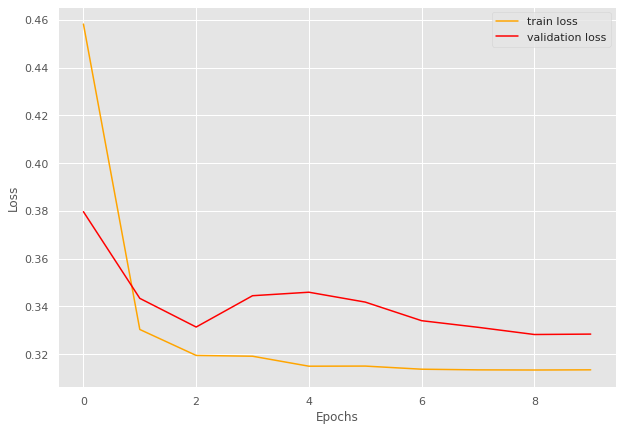

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.47]


train loss 1.4743316650390625, validation loss 1.262016847729683, validation accuracy 0.9137931034482759
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.97batch/s, loss=1.25]


train loss 1.2493261218070983, validation loss 1.2278447151184082, validation accuracy 0.9375
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.22]


train loss 1.2185948491096497, validation loss 1.2199830561876297, validation accuracy 0.9439655172413793
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=1.21]


INFO: Early stopping counter 1 of 5
train loss 1.2052563389142354, validation loss 1.2238835096359253, validation accuracy 0.9439655172413793
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.1997185190518698, validation loss 1.2205533236265182, validation accuracy 0.9418103448275862
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.02batch/s, loss=1.2]


INFO: Early stopping counter 3 of 5
train loss 1.2010278900464375, validation loss 1.2301991879940033, validation accuracy 0.9224137931034483
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1918422102928161, validation loss 1.2216713726520538, validation accuracy 0.9375
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9253390435403284 and loss 1.2411342154849658


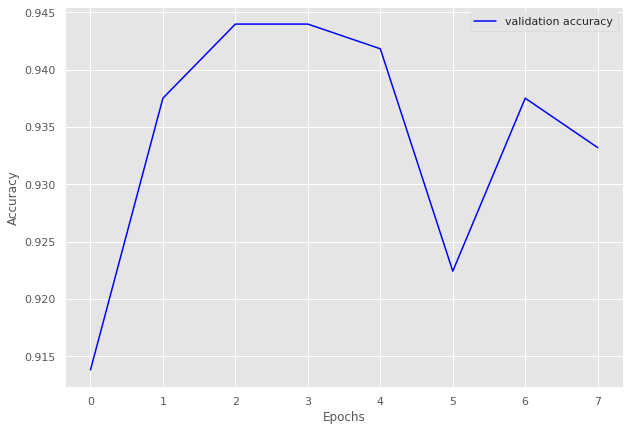

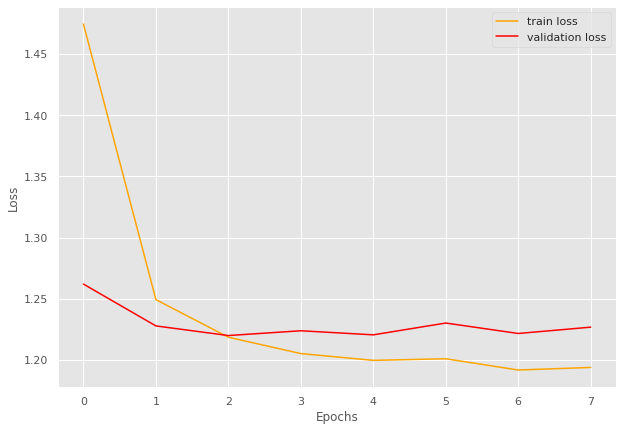

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 23/23 [00:08<00:00,  2.79batch/s, loss=0.943]


train loss 0.9431049720100735, validation loss 0.7836944858233134, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.94batch/s, loss=0.775]


train loss 0.7751212042310963, validation loss 0.7735063433647156, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.96batch/s, loss=0.759]


train loss 0.7593737996142843, validation loss 0.7723566591739655, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.89batch/s, loss=0.757]


train loss 0.7568572474562604, validation loss 0.7686352034409841, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.95batch/s, loss=0.75] 


INFO: Early stopping counter 1 of 5
train loss 0.7495522473169409, validation loss 0.7737195491790771, validation accuracy 0.9724517906336089
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.93batch/s, loss=0.751]


train loss 0.7505311577216439, validation loss 0.766946534315745, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.90batch/s, loss=0.747]


train loss 0.747131461682527, validation loss 0.7588595847288767, validation accuracy 0.9889807162534435
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.92batch/s, loss=0.748]


INFO: Early stopping counter 2 of 5
train loss 0.7477985257687776, validation loss 0.7598865628242493, validation accuracy 0.9834710743801653
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.94batch/s, loss=0.746]


INFO: Early stopping counter 3 of 5
train loss 0.7460641109425089, validation loss 0.7654195129871368, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 10
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.95batch/s, loss=0.748]


INFO: Early stopping counter 4 of 5
train loss 0.7480482407238173, validation loss 0.7694729566574097, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 11
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.93batch/s, loss=0.751]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9717359591539022 and loss 0.7721198651679727


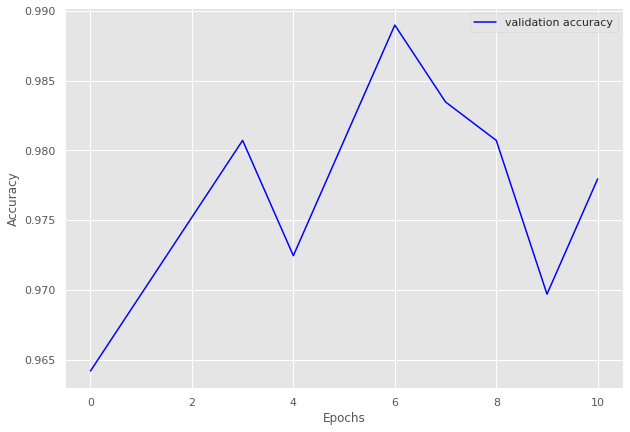

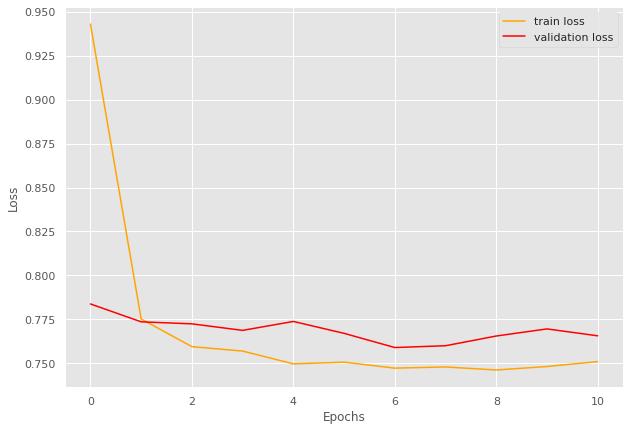

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.95batch/s, loss=1.51]


train loss 1.5145283576213953, validation loss 1.271439328789711, validation accuracy 0.8923679060665362
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 33/33 [00:10<00:00,  3.01batch/s, loss=1.26]


train loss 1.2604558792981235, validation loss 1.2401093989610672, validation accuracy 0.9295499021526419
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 33/33 [00:10<00:00,  3.00batch/s, loss=1.22]


train loss 1.2195671580054543, validation loss 1.2384758740663528, validation accuracy 0.9354207436399217
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.97batch/s, loss=1.2]


train loss 1.2028335766358809, validation loss 1.2359672337770462, validation accuracy 0.9354207436399217
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.96batch/s, loss=1.2] 


INFO: Early stopping counter 1 of 5
train loss 1.1985265666788274, validation loss 1.2466066181659698, validation accuracy 0.9197651663405088
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.86batch/s, loss=1.19]


INFO: Early stopping counter 2 of 5
train loss 1.1886297861735027, validation loss 1.2395643293857574, validation accuracy 0.9256360078277887
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.96batch/s, loss=1.2] 


train loss 1.203605471235333, validation loss 1.2321760952472687, validation accuracy 0.9315068493150684
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.96batch/s, loss=1.19]


train loss 1.1917139905871768, validation loss 1.228550300002098, validation accuracy 0.9393346379647749
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.98batch/s, loss=1.19]


train loss 1.1878928596323186, validation loss 1.2263177335262299, validation accuracy 0.9393346379647749
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 33/33 [00:15<00:00,  2.17batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1866007140188506, validation loss 1.2302307486534119, validation accuracy 0.9373776908023483
Coarse label 8 Epoch 11
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.95batch/s, loss=1.2] 


INFO: Early stopping counter 4 of 5
train loss 1.20434861833399, validation loss 1.234334409236908, validation accuracy 0.9334637964774951
Coarse label 8 Epoch 12
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.94batch/s, loss=1.2] 


train loss 1.2013792955514155, validation loss 1.2257795184850693, validation accuracy 0.9432485322896281
Coarse label 8 Epoch 13
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.94batch/s, loss=1.2] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9160067506166428 and loss 1.2502152368056874


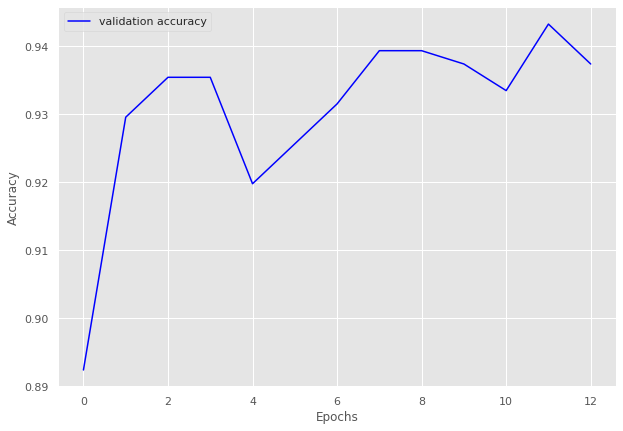

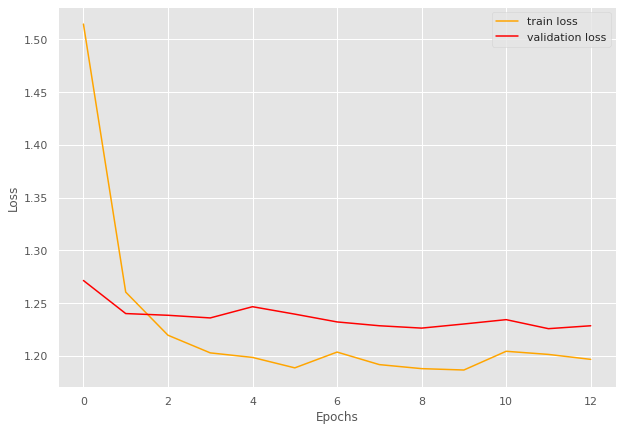

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=1.77]


train loss 1.7722403479785453, validation loss 1.6906591003591365, validation accuracy 0.8333333333333334
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=1.58]


train loss 1.5813796927289265, validation loss 1.6560994603417136, validation accuracy 0.8734567901234568
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=1.54]


train loss 1.544095367920108, validation loss 1.607025601647117, validation accuracy 0.9089506172839507
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=1.5] 


train loss 1.5043286870165569, validation loss 1.5481395504691384, validation accuracy 0.9120370370370371
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.93batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4943273823435714, validation loss 1.5663900050249966, validation accuracy 0.9135802469135802
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.90batch/s, loss=1.48]


train loss 1.4838959153105573, validation loss 1.5481356924230403, validation accuracy 0.9197530864197531
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=1.48]


INFO: Early stopping counter 2 of 5
train loss 1.4801622425637595, validation loss 1.5636869018728083, validation accuracy 0.9166666666666666
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.477785834452001, validation loss 1.5554506561972878, validation accuracy 0.9182098765432098
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4764899742312547, validation loss 1.5578147498044101, validation accuracy 0.9197530864197531
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9353284821154043 and loss 1.52842580415065


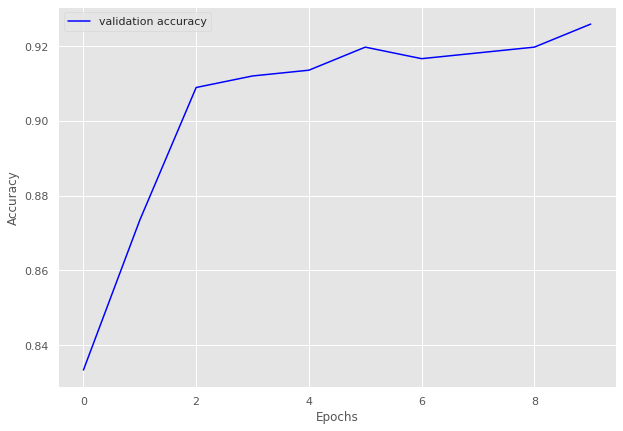

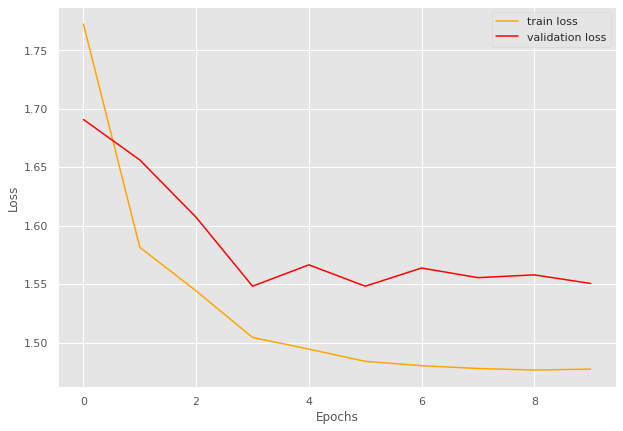

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.04batch/s, loss=0.957]


train loss 0.9570205092430115, validation loss 0.7906820058822632, validation accuracy 0.9539473684210527
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.04batch/s, loss=0.775]


train loss 0.7751026153564453, validation loss 0.7610500693321228, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.06batch/s, loss=0.764]


INFO: Early stopping counter 1 of 5
train loss 0.7635152816772461, validation loss 0.7616948246955871, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.04batch/s, loss=0.753]


train loss 0.752961066365242, validation loss 0.7586217880249023, validation accuracy 0.9901315789473685
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.01batch/s, loss=0.759]


train loss 0.7593099236488342, validation loss 0.7565101742744446, validation accuracy 0.9868421052631579
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.98batch/s, loss=0.756]


INFO: Early stopping counter 2 of 5
train loss 0.7563834697008133, validation loss 0.7616328716278076, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.763]


train loss 0.7629285454750061, validation loss 0.7510436773300171, validation accuracy 0.9967105263157895
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.04batch/s, loss=0.761]


INFO: Early stopping counter 3 of 5
train loss 0.7608858704566955, validation loss 0.7640039205551148, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.95batch/s, loss=0.755]


INFO: Early stopping counter 4 of 5
train loss 0.754989305138588, validation loss 0.7603466629981994, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 10
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.05batch/s, loss=0.755]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9656447053707328 and loss 0.7782937354511685


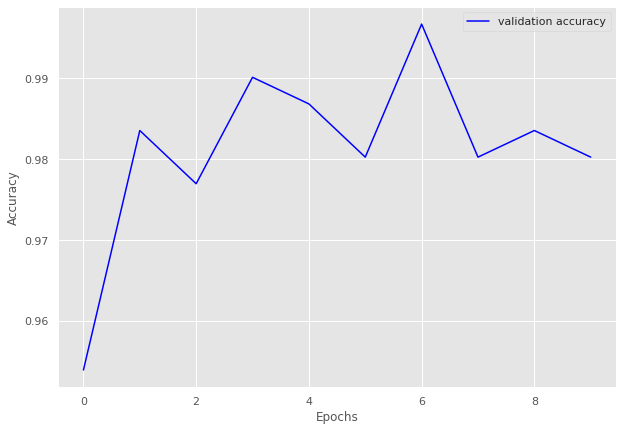

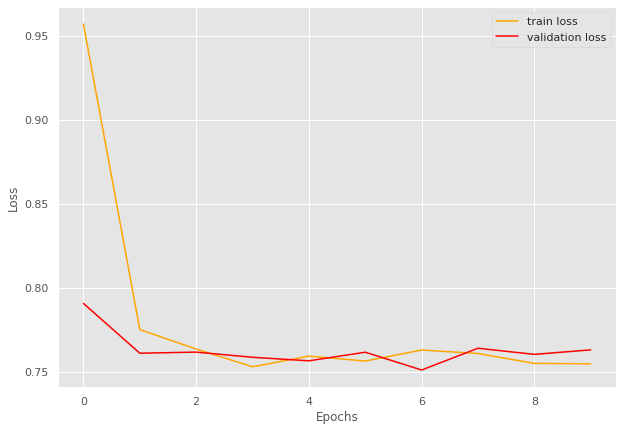

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.04batch/s, loss=1.5] 


train loss 1.499732626111884, validation loss 1.2917890787124633, validation accuracy 0.7758620689655172
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=1.16]


train loss 1.1625168762708966, validation loss 1.1648258924484254, validation accuracy 0.8724137931034482
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.06batch/s, loss=1.1]


train loss 1.1024746706611233, validation loss 1.1507506847381592, validation accuracy 0.8862068965517241
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.04batch/s, loss=1.09]


INFO: Early stopping counter 1 of 5
train loss 1.0878086780246936, validation loss 1.1555376768112182, validation accuracy 0.8793103448275862
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.04batch/s, loss=1.08]


train loss 1.0766802775232416, validation loss 1.150685453414917, validation accuracy 0.8862068965517241
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=1.08]


train loss 1.0791572834316052, validation loss 1.1423829555511475, validation accuracy 0.8896551724137931
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.05batch/s, loss=1.07]


train loss 1.0722284442500065, validation loss 1.1377223968505858, validation accuracy 0.906896551724138
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=1.07]


train loss 1.0665588629873175, validation loss 1.1313622713088989, validation accuracy 0.9137931034482759
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0659153022264178, validation loss 1.141209030151367, validation accuracy 0.903448275862069
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.96batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0670671839463084, validation loss 1.1489163875579833, validation accuracy 0.9
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.04batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0648996704503109, validation loss 1.1485570430755616, validation accuracy 0.9
Coarse label 12 Epoch 12
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.84batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9119453924914676 and loss 1.13193654841271


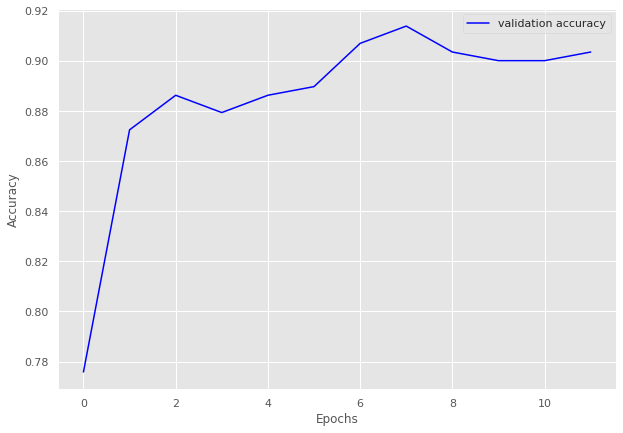

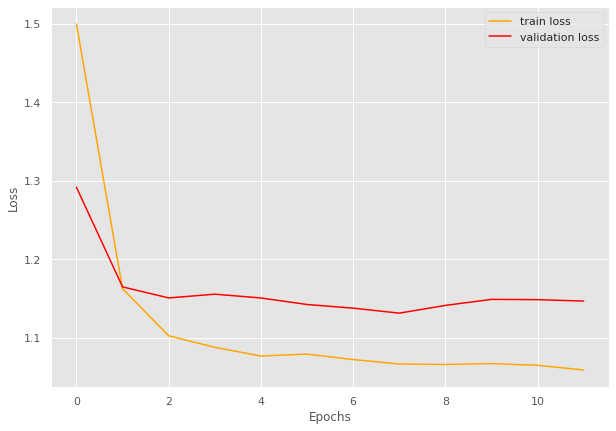

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.05batch/s, loss=0.746]


train loss 0.7463603335268357, validation loss 0.6005988836288452, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.05batch/s, loss=0.606]


train loss 0.6063221412546494, validation loss 0.5931420207023621, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.05batch/s, loss=0.585]


train loss 0.5849150454296785, validation loss 0.59255131483078, validation accuracy 0.9459459459459459
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.05batch/s, loss=0.573]


train loss 0.5726610842873069, validation loss 0.5844022631645203, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.02batch/s, loss=0.564]


INFO: Early stopping counter 1 of 5
train loss 0.5638102047583636, validation loss 0.5873977422714234, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.06batch/s, loss=0.568]


INFO: Early stopping counter 2 of 5
train loss 0.5683235666331123, validation loss 0.5876830816268921, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.05batch/s, loss=0.559]


train loss 0.559017959763022, validation loss 0.5833601117134094, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.03batch/s, loss=0.56] 


train loss 0.5595955883755404, validation loss 0.5810896515846252, validation accuracy 0.9613899613899614
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.04batch/s, loss=0.563]


INFO: Early stopping counter 3 of 5
train loss 0.562738365986768, validation loss 0.5870513081550598, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 10
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.04batch/s, loss=0.567]


INFO: Early stopping counter 4 of 5
train loss 0.5672122906236088, validation loss 0.5859566569328308, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 11
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.05batch/s, loss=0.567]


train loss 0.5669880509376526, validation loss 0.5788706541061401, validation accuracy 0.9691119691119691
Coarse label 13 Epoch 12
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.06batch/s, loss=0.575]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9354011791848243 and loss 0.6153119655906177


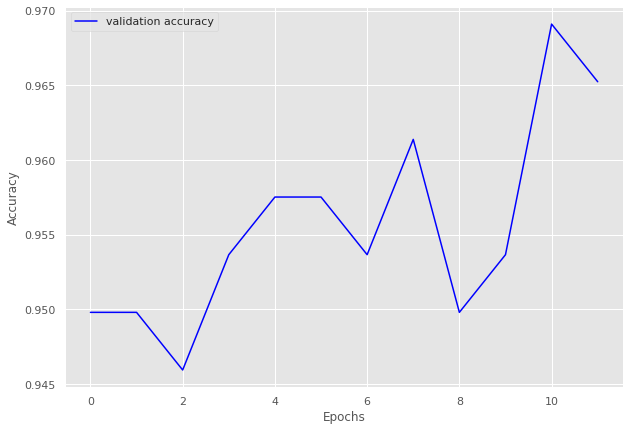

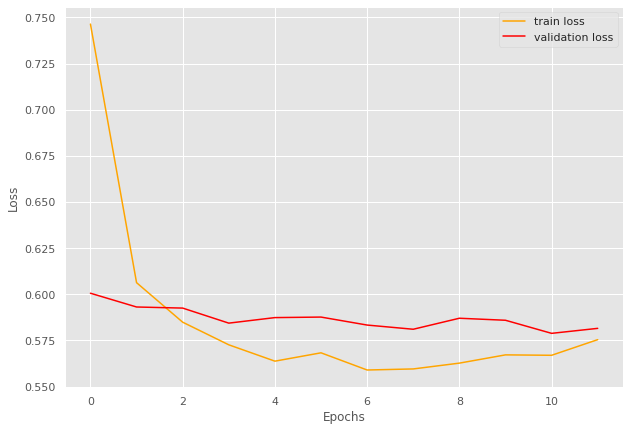

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 38/38 [00:25<00:00,  1.51batch/s, loss=1.26]


train loss 1.2611192245232432, validation loss 1.11611248254776, validation accuracy 0.9377104377104377
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 38/38 [00:25<00:00,  1.48batch/s, loss=1.09]


train loss 1.0900074651366787, validation loss 1.106819784641266, validation accuracy 0.9478114478114478
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 38/38 [00:31<00:00,  1.22batch/s, loss=1.08]


train loss 1.0761585988496478, validation loss 1.1029363751411438, validation accuracy 0.9478114478114478
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 38/38 [00:27<00:00,  1.39batch/s, loss=1.07]


train loss 1.069332740808788, validation loss 1.0965247988700866, validation accuracy 0.9545454545454546
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 38/38 [00:29<00:00,  1.28batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0646783270333942, validation loss 1.1045448541641236, validation accuracy 0.9427609427609428
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 38/38 [00:31<00:00,  1.22batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0608481545197337, validation loss 1.1026508688926697, validation accuracy 0.9461279461279462
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 38/38 [00:14<00:00,  2.54batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0685652494430542, validation loss 1.0994678378105163, validation accuracy 0.9494949494949495
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.062352811035357, validation loss 1.0979570388793944, validation accuracy 0.9562289562289562
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9539819055065342 and loss 1.090327798468726


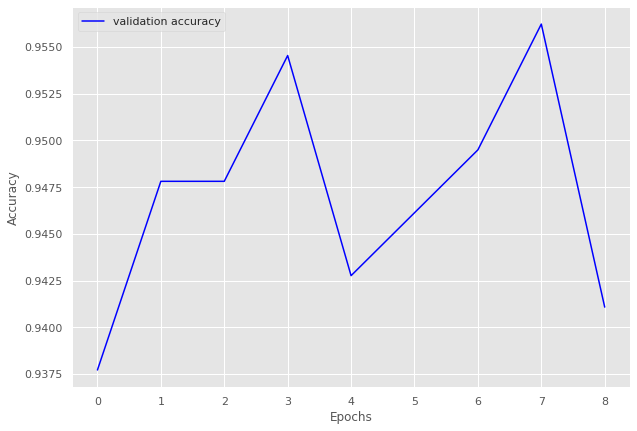

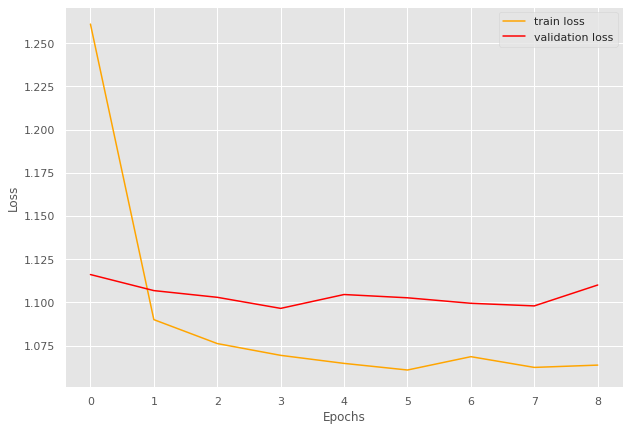

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.05]


train loss 1.0450484846767627, validation loss 0.8557170391082763, validation accuracy 0.8945578231292517
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=0.791]


train loss 0.7913642149222525, validation loss 0.816532826423645, validation accuracy 0.9251700680272109
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.96batch/s, loss=0.758]


INFO: Early stopping counter 1 of 5
train loss 0.7581054631032442, validation loss 0.8258143424987793, validation accuracy 0.9183673469387755
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=0.757]


train loss 0.7574507154916462, validation loss 0.8118290543556214, validation accuracy 0.9285714285714286
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.95batch/s, loss=0.76] 


train loss 0.7596084601000735, validation loss 0.8047734379768372, validation accuracy 0.9421768707482994
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.01batch/s, loss=0.753]


train loss 0.7528057161130404, validation loss 0.7999771952629089, validation accuracy 0.9489795918367347
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.03batch/s, loss=0.748]


train loss 0.7483958696064196, validation loss 0.7984953641891479, validation accuracy 0.9421768707482994
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=0.748]


INFO: Early stopping counter 2 of 5
train loss 0.7479286570298044, validation loss 0.8045042037963868, validation accuracy 0.9421768707482994
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=0.748]


INFO: Early stopping counter 3 of 5
train loss 0.7482064868274488, validation loss 0.8007825136184692, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=0.747]


INFO: Early stopping counter 4 of 5
train loss 0.7471236617941606, validation loss 0.8027868270874023, validation accuracy 0.9421768707482994
Coarse label 15 Epoch 11
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.04batch/s, loss=0.749]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9595297309518427 and loss 0.7843623050621578


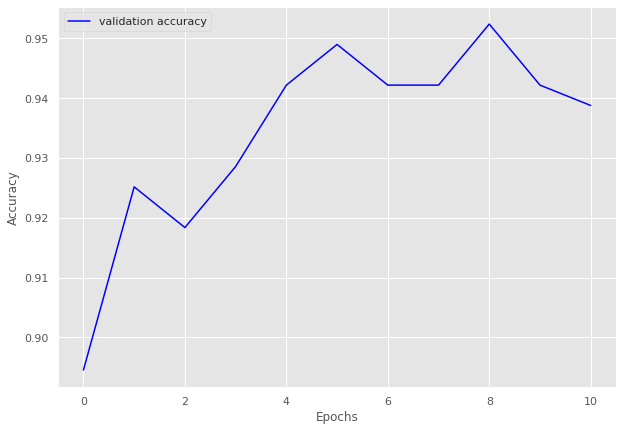

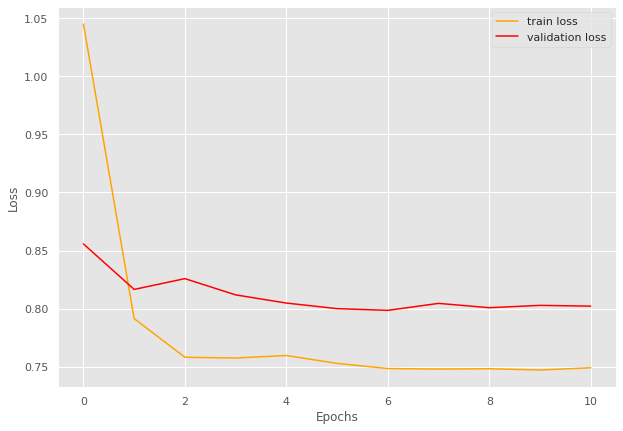

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.99batch/s, loss=0.754]


train loss 0.7544165021843381, validation loss 0.6377183437347412, validation accuracy 0.9184397163120568
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.94batch/s, loss=0.587]


train loss 0.586674647198783, validation loss 0.6056270003318787, validation accuracy 0.9432624113475178
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.94batch/s, loss=0.566]


INFO: Early stopping counter 1 of 5
train loss 0.5659256743060218, validation loss 0.6109413504600525, validation accuracy 0.9397163120567376
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.00batch/s, loss=0.559]


INFO: Early stopping counter 2 of 5
train loss 0.559031628900104, validation loss 0.6056816458702088, validation accuracy 0.9432624113475178
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.84batch/s, loss=0.556]


train loss 0.5561239388253953, validation loss 0.599925696849823, validation accuracy 0.950354609929078
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 18/18 [00:07<00:00,  2.42batch/s, loss=0.554]


INFO: Early stopping counter 3 of 5
train loss 0.553806314865748, validation loss 0.6102867364883423, validation accuracy 0.9432624113475178
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.95batch/s, loss=0.554]


INFO: Early stopping counter 4 of 5
train loss 0.5542291833294762, validation loss 0.6087897896766663, validation accuracy 0.950354609929078
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.98batch/s, loss=0.556]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.958303886925795 and loss 0.5923807781134078


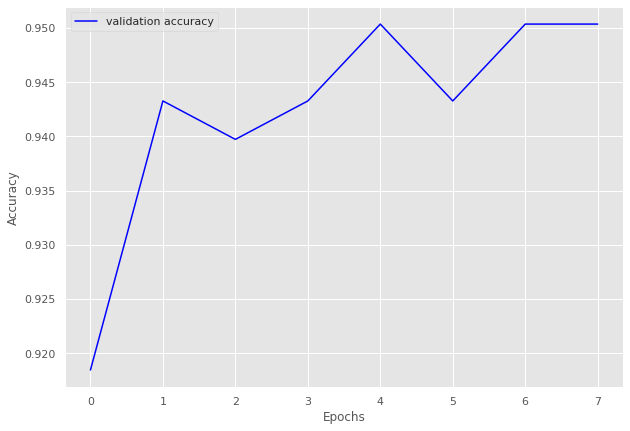

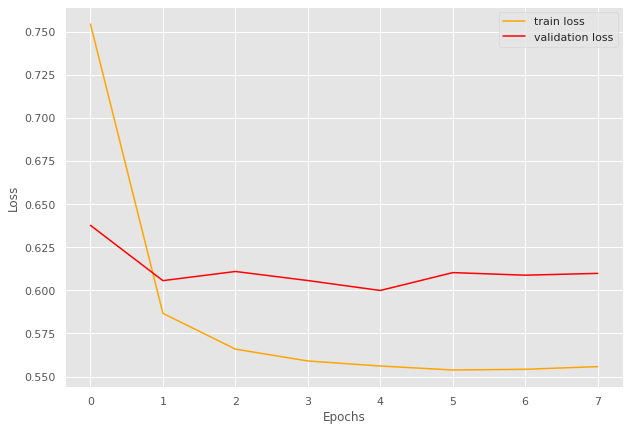

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 17 Epoch 1
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=1.04]


train loss 1.0383527010679245, validation loss 0.8718208909034729, validation accuracy 0.8705501618122977
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.01batch/s, loss=0.825]


train loss 0.8253874480724335, validation loss 0.8184833288192749, validation accuracy 0.9288025889967637
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.04batch/s, loss=0.787]


train loss 0.7868014365434647, validation loss 0.8177074551582336, validation accuracy 0.9223300970873787
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.781]


train loss 0.7805598348379135, validation loss 0.816672682762146, validation accuracy 0.9158576051779935
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 20/20 [00:07<00:00,  2.83batch/s, loss=0.768]


train loss 0.7679607480764389, validation loss 0.8069177389144897, validation accuracy 0.9288025889967637
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.97batch/s, loss=0.764]


INFO: Early stopping counter 1 of 5
train loss 0.7638038158416748, validation loss 0.8165763735771179, validation accuracy 0.9223300970873787
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.757]


INFO: Early stopping counter 2 of 5
train loss 0.7568072646856308, validation loss 0.8267513155937195, validation accuracy 0.9093851132686084
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.753]


INFO: Early stopping counter 3 of 5
train loss 0.7534696727991104, validation loss 0.814644968509674, validation accuracy 0.919093851132686
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.99batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.7509253323078156, validation loss 0.8194023370742798, validation accuracy 0.919093851132686
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.757]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.92798796216681 and loss 0.8158760838312645


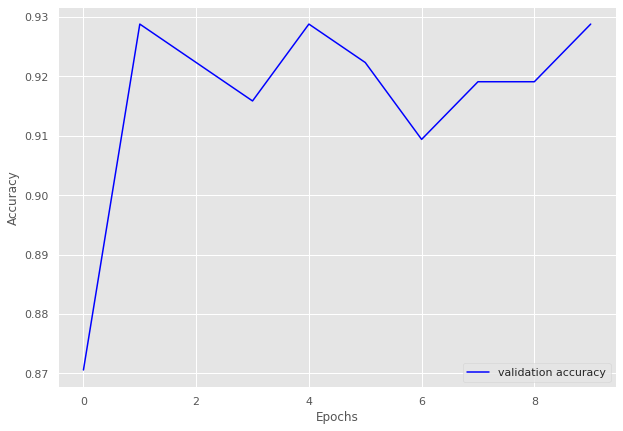

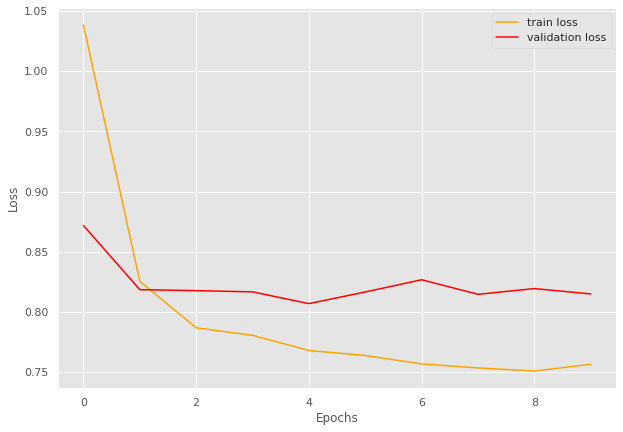

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 19 Epoch 1
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.31batch/s, loss=1.21]


train loss 1.2118334089006697, validation loss 1.0880828499794006, validation accuracy 0.71875
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.34batch/s, loss=0.903]


train loss 0.9033688647406442, validation loss 0.9275476634502411, validation accuracy 0.8541666666666666
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 7/7 [00:04<00:00,  1.55batch/s, loss=0.794]


train loss 0.7935368248394558, validation loss 0.8643452227115631, validation accuracy 0.8854166666666666
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.33batch/s, loss=0.765]


train loss 0.7649175695010594, validation loss 0.82049760222435, validation accuracy 0.9375
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.34batch/s, loss=0.755]


train loss 0.7553208129746574, validation loss 0.8100583553314209, validation accuracy 0.9375
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.37batch/s, loss=0.771]


INFO: Early stopping counter 1 of 5
train loss 0.7705180559839521, validation loss 0.8352474868297577, validation accuracy 0.90625
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.15batch/s, loss=0.769]


INFO: Early stopping counter 2 of 5
train loss 0.7691392387662616, validation loss 0.8712558448314667, validation accuracy 0.8958333333333334
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.30batch/s, loss=0.774]


INFO: Early stopping counter 3 of 5
train loss 0.7735623291560582, validation loss 0.8511974215507507, validation accuracy 0.90625
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.34batch/s, loss=0.777]


INFO: Early stopping counter 4 of 5
train loss 0.777464245046888, validation loss 0.8390262722969055, validation accuracy 0.90625
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.32batch/s, loss=0.767]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.920516304347826 and loss 0.8284633133722388


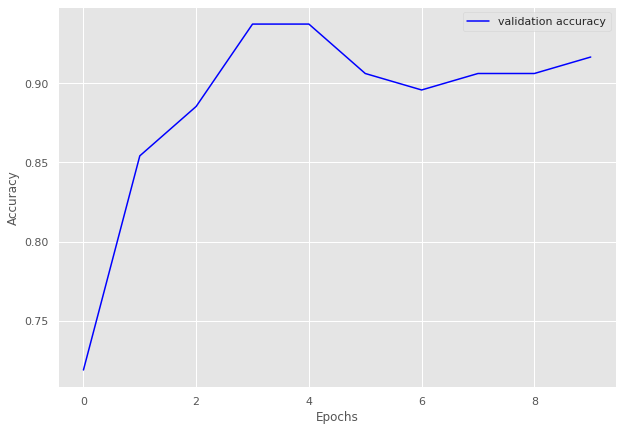

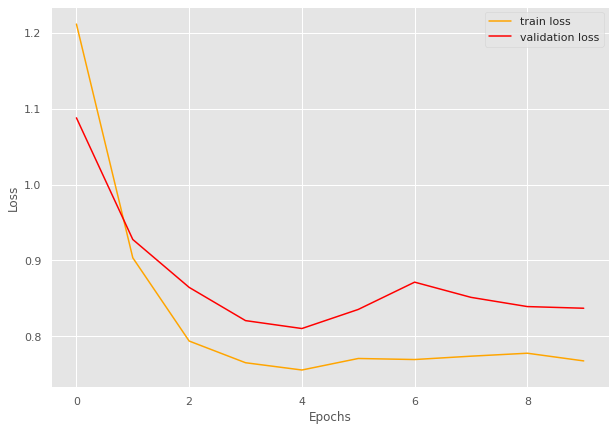

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Evaluating fine model 0
Evaluating fine model 1
Evaluating fine model 2
Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16
Evaluating fine model 17
Evaluating fine model 19
overall accuracy  is 0.7837479204626475
{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.93423053527980

Calculating for volume 35
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=1.14]


train loss 1.1409525246154972, validation loss 0.976343708378928, validation accuracy 0.9347319347319347
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.97batch/s, loss=0.964]


INFO: Early stopping counter 1 of 5
train loss 0.9636553743990456, validation loss 0.979125337941306, validation accuracy 0.9230769230769231
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=0.947]


train loss 0.946629169510632, validation loss 0.9576334697859628, validation accuracy 0.951048951048951
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=0.937]


train loss 0.9366651162868593, validation loss 0.9534953577177865, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=0.938]


INFO: Early stopping counter 2 of 5
train loss 0.9381835533351432, validation loss 0.9555292470114571, validation accuracy 0.951048951048951
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.936]


train loss 0.9356495054756723, validation loss 0.9488861220223563, validation accuracy 0.958041958041958
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.928]


INFO: Early stopping counter 3 of 5
train loss 0.9281929527840963, validation loss 0.9527094619614738, validation accuracy 0.9533799533799534
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:16<00:00,  2.55batch/s, loss=0.928]


INFO: Early stopping counter 4 of 5
train loss 0.9283122900055676, validation loss 0.9510627388954163, validation accuracy 0.951048951048951
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.923]


train loss 0.9233521542898039, validation loss 0.9353101083210537, validation accuracy 0.972027972027972
Coarse label 0 Epoch 10
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.96batch/s, loss=0.925]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9540925266903915 and loss 0.9516198458996686


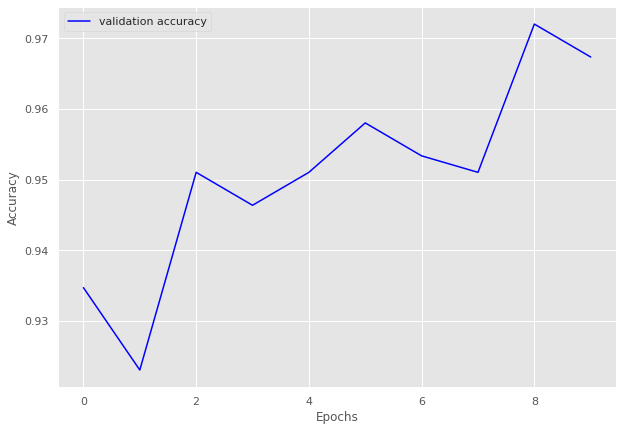

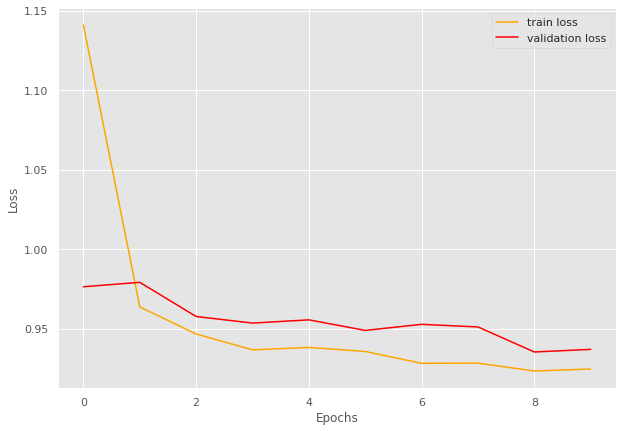

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 1 Epoch 1
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.97batch/s, loss=1.38]


train loss 1.3799136810832553, validation loss 1.1353172461191814, validation accuracy 0.9193548387096774
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.99batch/s, loss=1.12]


train loss 1.1160464684168498, validation loss 1.1069904963175456, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.91batch/s, loss=1.08]


train loss 1.0751002430915833, validation loss 1.102689504623413, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.99batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0651889509624906, validation loss 1.1087441444396973, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.98batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0572248299916585, validation loss 1.1219074726104736, validation accuracy 0.9086021505376344
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.93batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0502716037962172, validation loss 1.1079600254694622, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.99batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0516707168685064, validation loss 1.1115587155024211, validation accuracy 0.9247311827956989
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.96batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9595422966898243 and loss 1.086965799331665


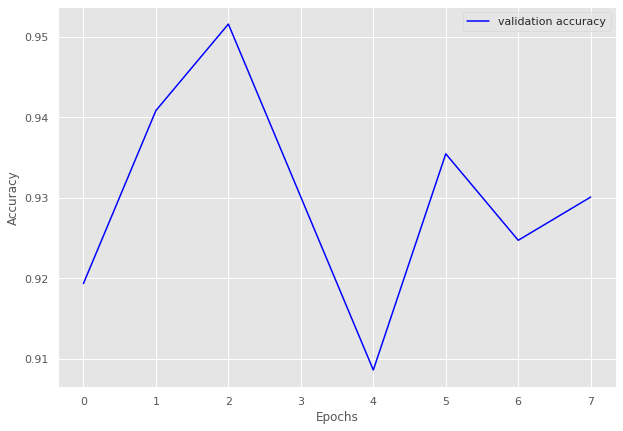

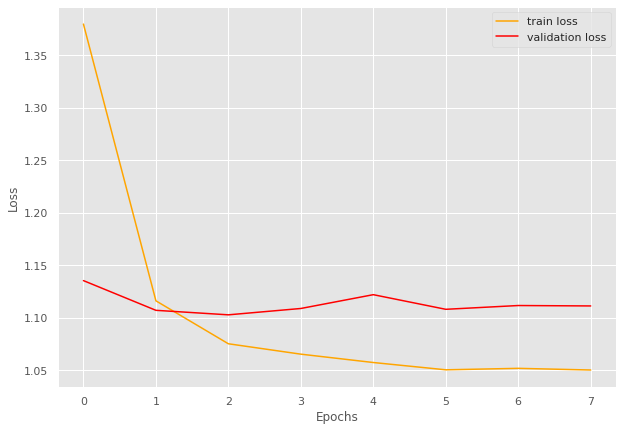

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 2 Epoch 1
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.93batch/s, loss=1.71]


train loss 1.7119581685008773, validation loss 1.5724848508834839, validation accuracy 0.8942528735632184
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.95batch/s, loss=1.55]


train loss 1.5459250542054694, validation loss 1.5589687143053328, validation accuracy 0.9080459770114943
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.91batch/s, loss=1.53]


train loss 1.5266623152307717, validation loss 1.5338550891195024, validation accuracy 0.9321839080459771
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.95batch/s, loss=1.51]


INFO: Early stopping counter 1 of 5
train loss 1.5144901620336326, validation loss 1.5427747028214591, validation accuracy 0.9183908045977012
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.94batch/s, loss=1.51]


train loss 1.5057003828416389, validation loss 1.5309850914137704, validation accuracy 0.9321839080459771
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.94batch/s, loss=1.5] 


train loss 1.5002775278436131, validation loss 1.52996221610478, validation accuracy 0.9333333333333333
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.93batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.494850777717958, validation loss 1.5316904272351946, validation accuracy 0.9344827586206896
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.94batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.4924361806317985, validation loss 1.5345267057418823, validation accuracy 0.9287356321839081
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.94batch/s, loss=1.5] 


INFO: Early stopping counter 4 of 5
train loss 1.5023717736623374, validation loss 1.5398574130875724, validation accuracy 0.9206896551724137
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.88batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9429824561403509 and loss 1.5195602391685188


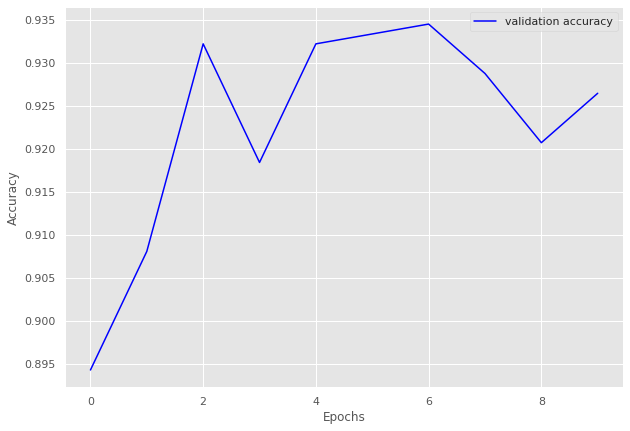

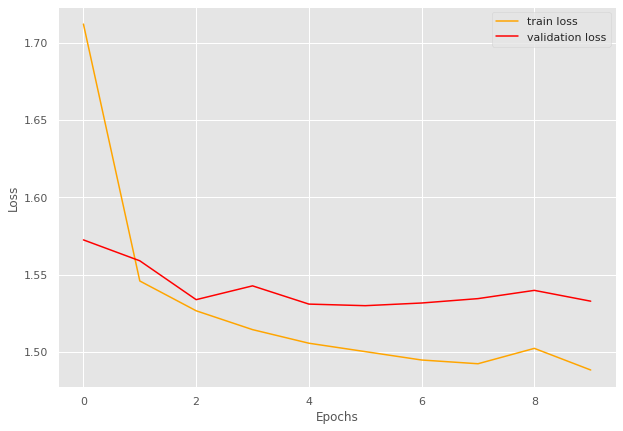

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.83batch/s, loss=1.32]


train loss 1.3222998839158278, validation loss 1.1601607629231043, validation accuracy 0.8907766990291263
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.95batch/s, loss=1.11]


train loss 1.114551761211493, validation loss 1.105742369379316, validation accuracy 0.9441747572815534
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.94batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.0814355061604426, validation loss 1.1122102056230818, validation accuracy 0.9393203883495146
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.071050802866618, validation loss 1.1068837983267648, validation accuracy 0.941747572815534
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.06]


train loss 1.0640888152978358, validation loss 1.0993436064038957, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0612198542325924, validation loss 1.1102744681494576, validation accuracy 0.941747572815534
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.96batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.0654074381559322, validation loss 1.103954826082502, validation accuracy 0.941747572815534
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9390334572490706 and loss 1.106003566349254


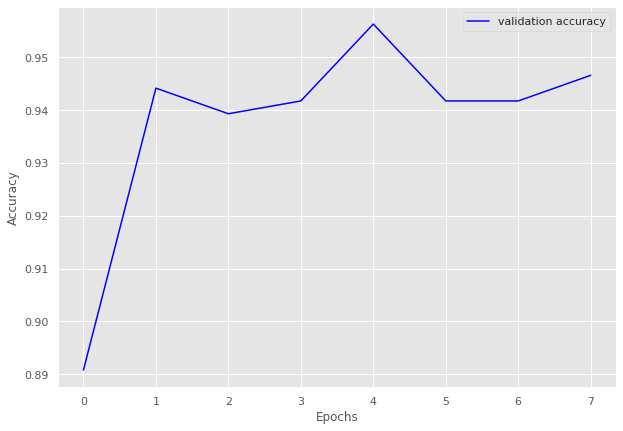

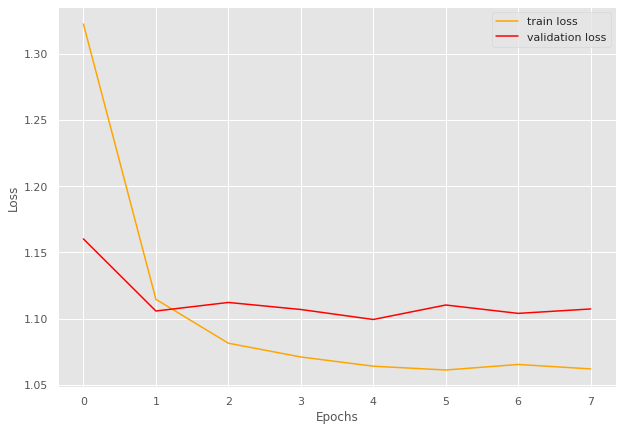

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.91batch/s, loss=0.428]


train loss 0.4282464583714803, validation loss 0.3354753355185191, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.88batch/s, loss=0.327]


train loss 0.32712268431981406, validation loss 0.327265997727712, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.94batch/s, loss=0.319]


INFO: Early stopping counter 1 of 5
train loss 0.31873077551523843, validation loss 0.32802918553352356, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.86batch/s, loss=0.317]


INFO: Early stopping counter 2 of 5
train loss 0.3172202706336975, validation loss 0.3306119938691457, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.96batch/s, loss=0.316]


INFO: Early stopping counter 3 of 5
train loss 0.31589938203493756, validation loss 0.33068681756655377, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.88batch/s, loss=0.316]


INFO: Early stopping counter 4 of 5
train loss 0.315651947259903, validation loss 0.32946627338727313, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.86batch/s, loss=0.315]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9846005774783445 and loss 0.3297860234072714


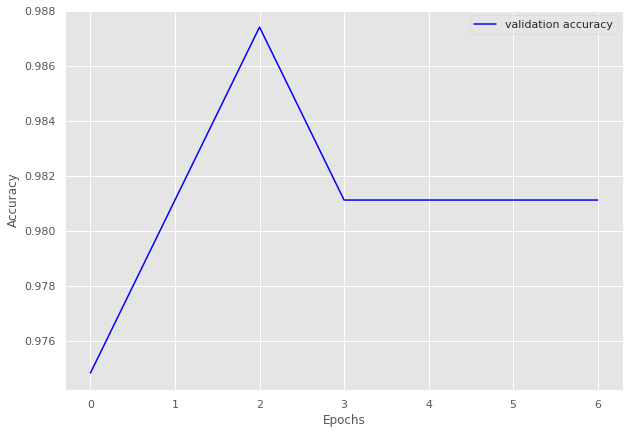

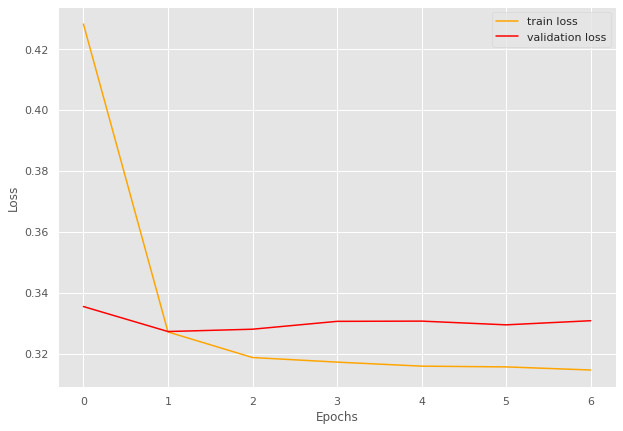

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 44/44 [00:15<00:00,  2.92batch/s, loss=1.39]


train loss 1.3919921517372131, validation loss 1.244031935930252, validation accuracy 0.9245689655172413
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.95batch/s, loss=1.23]


INFO: Early stopping counter 1 of 5
train loss 1.2291383851658215, validation loss 1.2459326833486557, validation accuracy 0.9181034482758621
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.94batch/s, loss=1.21]


train loss 1.2125825042074376, validation loss 1.2226778417825699, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.96batch/s, loss=1.2] 


train loss 1.1999848783016205, validation loss 1.207442581653595, validation accuracy 0.9568965517241379
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.96batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.200298398733139, validation loss 1.218139111995697, validation accuracy 0.9439655172413793
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.96batch/s, loss=1.21]


INFO: Early stopping counter 3 of 5
train loss 1.208429756489667, validation loss 1.216319963335991, validation accuracy 0.9418103448275862
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.96batch/s, loss=1.2]


INFO: Early stopping counter 4 of 5
train loss 1.197823632847179, validation loss 1.2288148403167725, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.94batch/s, loss=1.2] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9390745924584225 and loss 1.2273480365150853


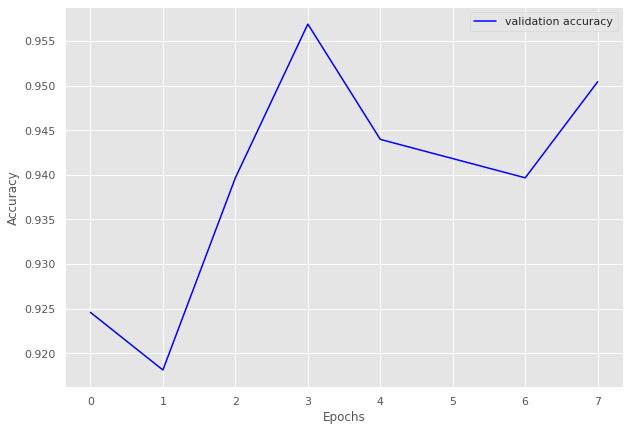

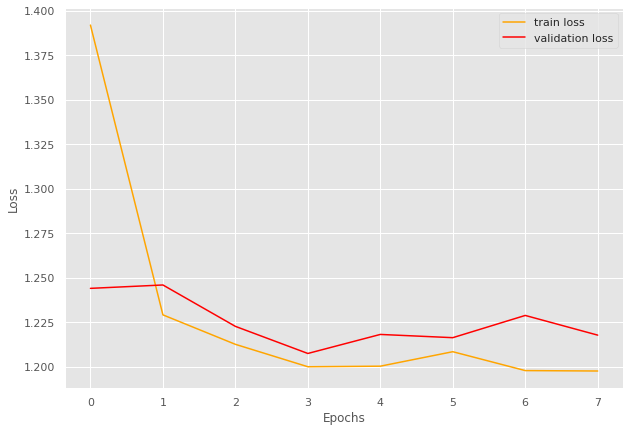

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.96batch/s, loss=0.882]


train loss 0.8820077776908875, validation loss 0.7862818439801534, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  3.00batch/s, loss=0.768]


INFO: Early stopping counter 1 of 5
train loss 0.7681100658008031, validation loss 0.795727401971817, validation accuracy 0.953168044077135
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.97batch/s, loss=0.76] 


INFO: Early stopping counter 2 of 5
train loss 0.7597887430872236, validation loss 0.7941409448782603, validation accuracy 0.953168044077135
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.94batch/s, loss=0.764]


train loss 0.763652333191463, validation loss 0.7824439803759257, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.94batch/s, loss=0.76] 


INFO: Early stopping counter 3 of 5
train loss 0.7598290477480207, validation loss 0.7840965787569681, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.96batch/s, loss=0.756]


train loss 0.7556613053594317, validation loss 0.7767047981421152, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.98batch/s, loss=0.756]


INFO: Early stopping counter 4 of 5
train loss 0.7561795626367841, validation loss 0.7807019054889679, validation accuracy 0.9641873278236914
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.95batch/s, loss=0.754]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9715968861771512 and loss 0.7721355191866557


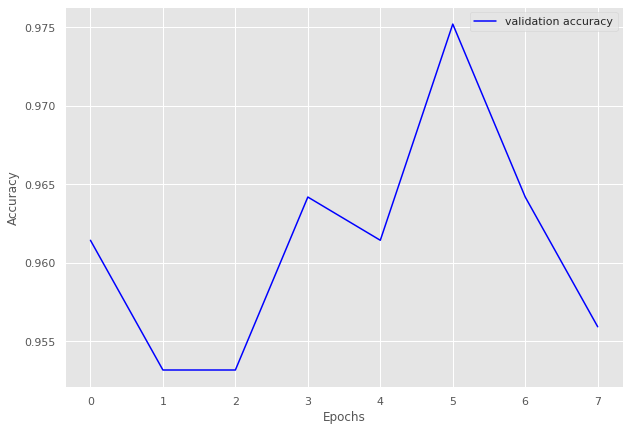

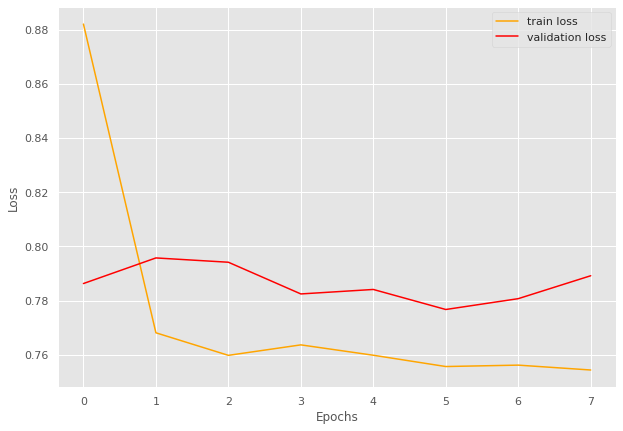

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.98batch/s, loss=1.44]


train loss 1.4367717188231799, validation loss 1.2626963704824448, validation accuracy 0.9080234833659491
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=1.25]


train loss 1.2469089201518468, validation loss 1.2446664720773697, validation accuracy 0.9217221135029354
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.96batch/s, loss=1.24]


train loss 1.2357213424176585, validation loss 1.2313289940357208, validation accuracy 0.9373776908023483
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.97batch/s, loss=1.21]


train loss 1.2054964109342925, validation loss 1.2194463461637497, validation accuracy 0.949119373776908
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=1.2] 


INFO: Early stopping counter 1 of 5
train loss 1.1995321293266452, validation loss 1.235861450433731, validation accuracy 0.923679060665362
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.91batch/s, loss=1.2]


INFO: Early stopping counter 2 of 5
train loss 1.1989781613252601, validation loss 1.226813554763794, validation accuracy 0.9412915851272016
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=1.2] 


INFO: Early stopping counter 3 of 5
train loss 1.1953026786142467, validation loss 1.227146953344345, validation accuracy 0.9412915851272016
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.92batch/s, loss=1.19]


train loss 1.1942554882594518, validation loss 1.2193403840065002, validation accuracy 0.9471624266144814
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=1.2] 


INFO: Early stopping counter 4 of 5
train loss 1.1993208612714494, validation loss 1.2217767387628555, validation accuracy 0.9393346379647749
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9300584094653287 and loss 1.234914585522243


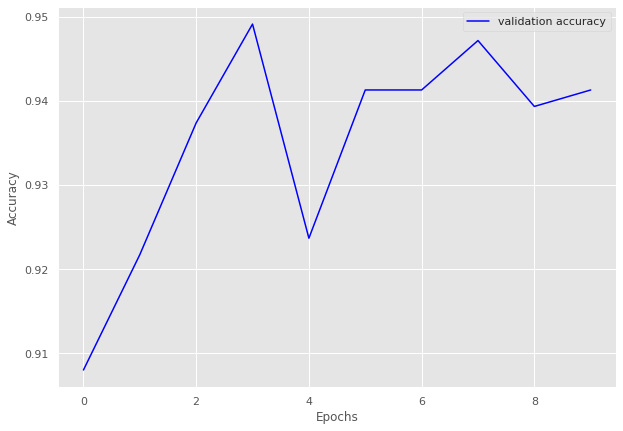

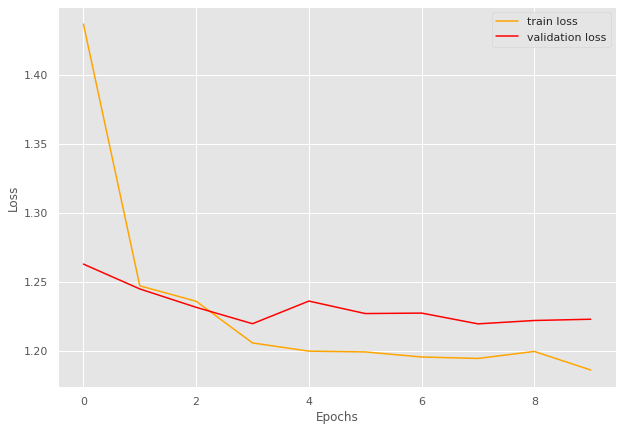

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.88batch/s, loss=1.76]


train loss 1.7586407895948066, validation loss 1.6353641531684182, validation accuracy 0.8626543209876543
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.89batch/s, loss=1.55]


train loss 1.553605718690841, validation loss 1.530883864922957, validation accuracy 0.9351851851851852
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.87batch/s, loss=1.52]


train loss 1.5196235668463784, validation loss 1.523440577767112, validation accuracy 0.941358024691358
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.88batch/s, loss=1.5]


train loss 1.5006088135672397, validation loss 1.5181304649873213, validation accuracy 0.9382716049382716
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.90batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4922668152168148, validation loss 1.533290440385992, validation accuracy 0.9367283950617284
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.84batch/s, loss=1.49]


train loss 1.4908550997249415, validation loss 1.5111647735942493, validation accuracy 0.9614197530864198
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.90batch/s, loss=1.48]


INFO: Early stopping counter 2 of 5
train loss 1.4843757211184891, validation loss 1.517550696026195, validation accuracy 0.9398148148148148
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.84batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.484570249182279, validation loss 1.5223422809080644, validation accuracy 0.9444444444444444
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.89batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4799908243241857, validation loss 1.5219493996013294, validation accuracy 0.9429012345679012
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.90batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9466650898770104 and loss 1.517922592342348


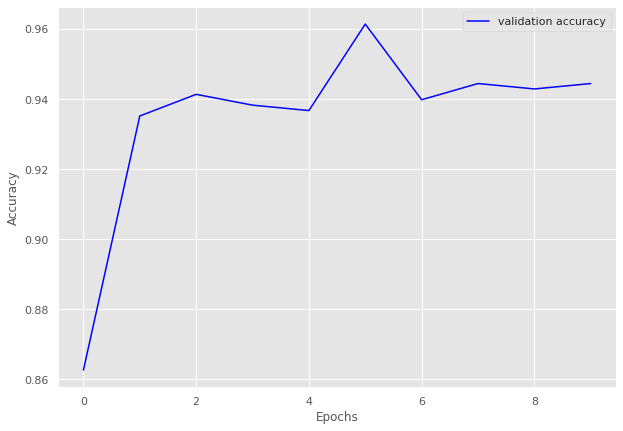

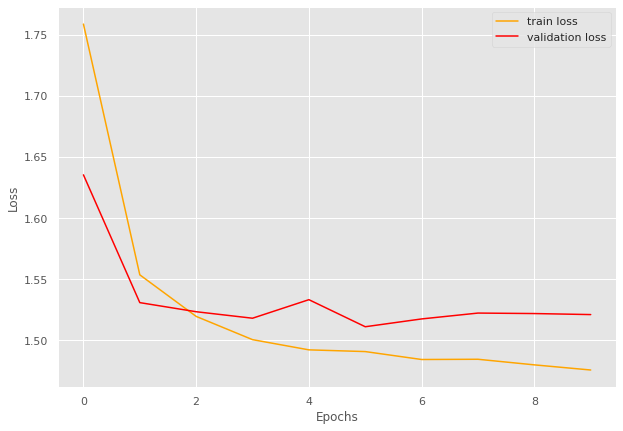

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.92batch/s, loss=0.925]


train loss 0.9249446268739372, validation loss 0.7772034883499146, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.91batch/s, loss=0.773]


train loss 0.7733821807236507, validation loss 0.7760213971138, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 29/29 [00:15<00:00,  1.85batch/s, loss=0.761]


train loss 0.7606180844635799, validation loss 0.7655261039733887, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 29/29 [00:17<00:00,  1.66batch/s, loss=0.754]


train loss 0.753868370220579, validation loss 0.7614448547363282, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 29/29 [00:23<00:00,  1.24batch/s, loss=0.751]


train loss 0.751306019980332, validation loss 0.7591379165649415, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 29/29 [00:20<00:00,  1.39batch/s, loss=0.749]


train loss 0.7489388934497175, validation loss 0.7590063214302063, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 29/29 [00:22<00:00,  1.26batch/s, loss=0.747]


train loss 0.7474738647197855, validation loss 0.7570515275001526, validation accuracy 0.9868421052631579
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 29/29 [00:20<00:00,  1.42batch/s, loss=0.747]


train loss 0.7467875768398416, validation loss 0.7548409461975097, validation accuracy 0.9901315789473685
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 29/29 [00:18<00:00,  1.53batch/s, loss=0.747]


INFO: Early stopping counter 1 of 5
train loss 0.7470687771665638, validation loss 0.757567310333252, validation accuracy 0.9901315789473685
Coarse label 11 Epoch 10
-------------------------------


100%|██████████| 29/29 [00:22<00:00,  1.27batch/s, loss=0.747]


INFO: Early stopping counter 2 of 5
train loss 0.7465398619914877, validation loss 0.756809139251709, validation accuracy 0.9868421052631579
Coarse label 11 Epoch 11
-------------------------------


100%|██████████| 29/29 [00:22<00:00,  1.31batch/s, loss=0.747]


INFO: Early stopping counter 3 of 5
train loss 0.7472740761164961, validation loss 0.7620271682739258, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 12
-------------------------------


100%|██████████| 29/29 [00:16<00:00,  1.71batch/s, loss=0.748]


INFO: Early stopping counter 4 of 5
train loss 0.7477668893748316, validation loss 0.7780730485916137, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 13
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.91batch/s, loss=0.758]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9683893627696939 and loss 0.7746516135003831


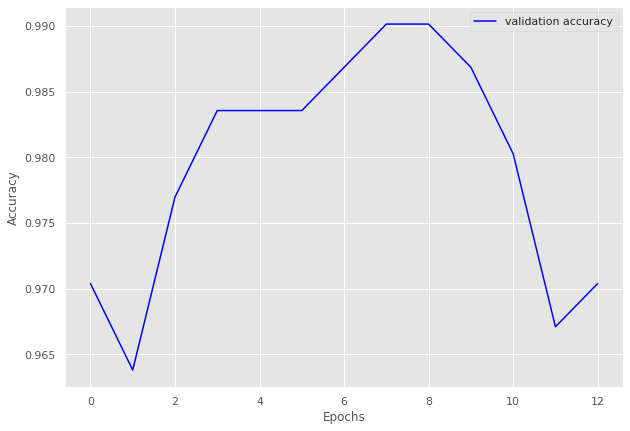

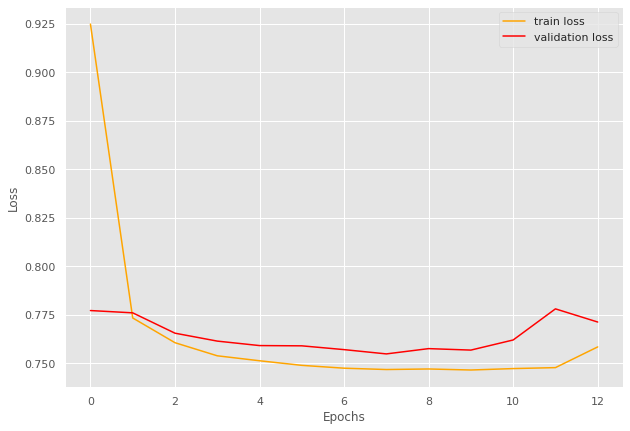

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.01batch/s, loss=1.4] 


train loss 1.3957163308347975, validation loss 1.1513242959976195, validation accuracy 0.9103448275862069
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.01batch/s, loss=1.13]


train loss 1.13145369717053, validation loss 1.1262593269348145, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.00batch/s, loss=1.11]


train loss 1.1106741002627782, validation loss 1.1140427112579345, validation accuracy 0.9275862068965517
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.09]


train loss 1.0949265105383736, validation loss 1.1052346229553223, validation accuracy 0.9448275862068966
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.01batch/s, loss=1.09]


INFO: Early stopping counter 1 of 5
train loss 1.0913315074784415, validation loss 1.1178930044174193, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=1.09]


INFO: Early stopping counter 2 of 5
train loss 1.087498779807772, validation loss 1.105443000793457, validation accuracy 0.9310344827586207
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.08]


INFO: Early stopping counter 3 of 5
train loss 1.0822614303656988, validation loss 1.1080791473388671, validation accuracy 0.9379310344827586
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:10<00:00,  2.79batch/s, loss=1.07]


train loss 1.0713554918766022, validation loss 1.0987033367156982, validation accuracy 0.9448275862068966
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.0676657472337996, validation loss 1.108108687400818, validation accuracy 0.9379310344827586
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.08]


train loss 1.0759308253015791, validation loss 1.0928927421569825, validation accuracy 0.9551724137931035
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.08]


train loss 1.0758790629250663, validation loss 1.087589693069458, validation accuracy 0.9620689655172414
Coarse label 12 Epoch 12
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.00batch/s, loss=1.07]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9441091577013907 and loss 1.1006576716899872


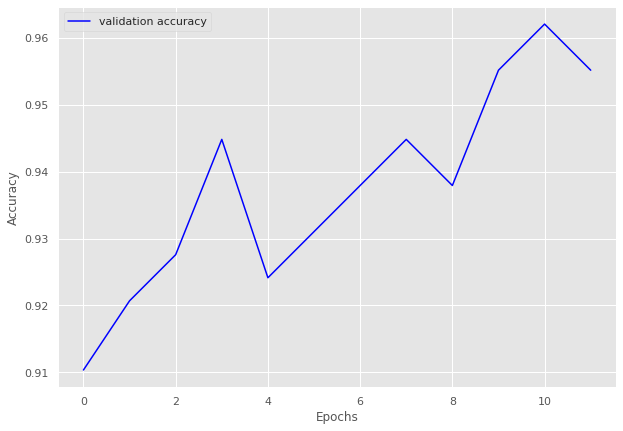

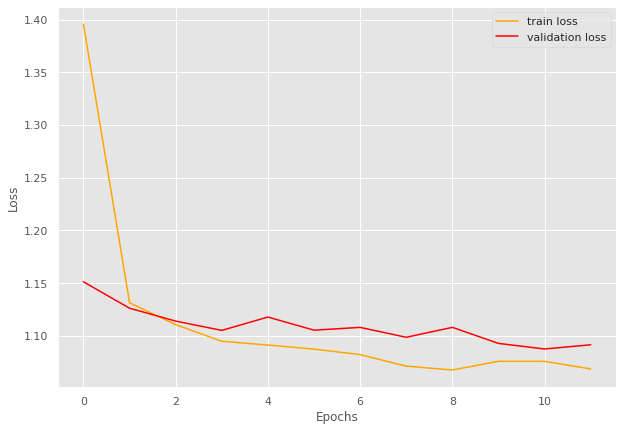

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.02batch/s, loss=0.702]


train loss 0.7022134184837341, validation loss 0.6153879880905151, validation accuracy 0.9266409266409267
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.00batch/s, loss=0.595]


train loss 0.5950071716308594, validation loss 0.5861383557319642, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.01batch/s, loss=0.58] 


INFO: Early stopping counter 1 of 5
train loss 0.5804328012466431, validation loss 0.5929877400398255, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.98batch/s, loss=0.581]


INFO: Early stopping counter 2 of 5
train loss 0.5806445932388306, validation loss 0.5982021570205689, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.95batch/s, loss=0.57] 


INFO: Early stopping counter 3 of 5
train loss 0.5696354365348816, validation loss 0.5913944959640502, validation accuracy 0.9420849420849421
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.97batch/s, loss=0.567]


INFO: Early stopping counter 4 of 5
train loss 0.5673057460784912, validation loss 0.5914937496185303, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.96batch/s, loss=0.57] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9402720283855707 and loss 0.6102986470708307


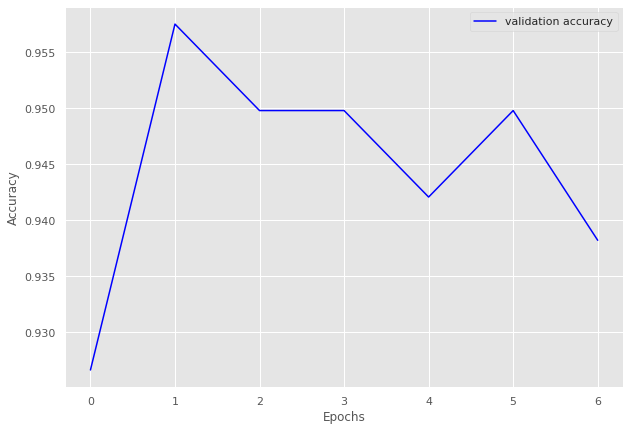

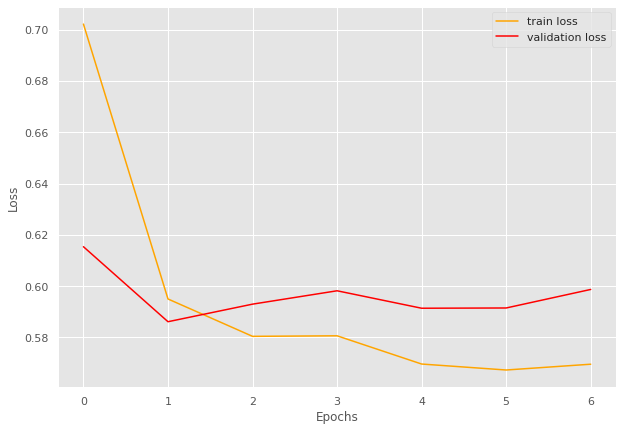

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 56/56 [00:18<00:00,  2.95batch/s, loss=1.22]


train loss 1.2239147467272622, validation loss 1.1025477290153503, validation accuracy 0.936026936026936
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.93batch/s, loss=1.09]


train loss 1.0909743436745234, validation loss 1.086403751373291, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.92batch/s, loss=1.08]


train loss 1.0761338919401169, validation loss 1.0846991896629334, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.91batch/s, loss=1.07]


train loss 1.0711586475372314, validation loss 1.0768170833587647, validation accuracy 0.9663299663299664
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.88batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.064469616327967, validation loss 1.086666965484619, validation accuracy 0.9562289562289562
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.89batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0641621691840035, validation loss 1.085011065006256, validation accuracy 0.9545454545454546
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.94batch/s, loss=1.06]


train loss 1.0637495986052923, validation loss 1.0757945656776429, validation accuracy 0.9713804713804713
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.91batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0596036868435996, validation loss 1.086833691596985, validation accuracy 0.9494949494949495
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.90batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0586282483169012, validation loss 1.0825599551200866, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9683030537301894 and loss 1.075515383579692


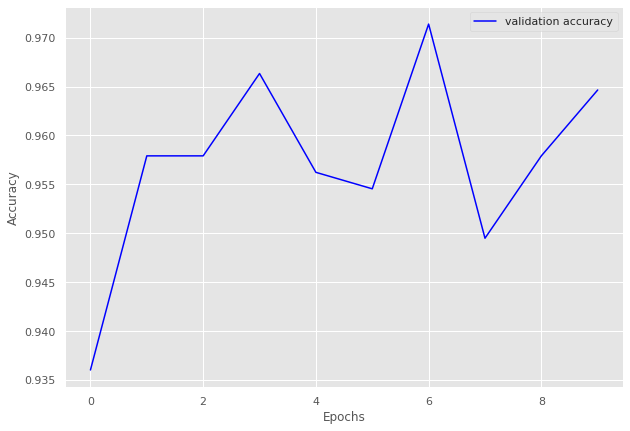

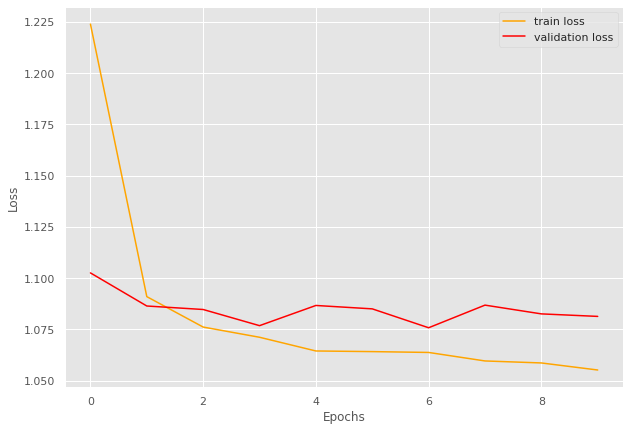

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=0.957]


train loss 0.9574703105858394, validation loss 0.8041130304336548, validation accuracy 0.935374149659864
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=0.776]


train loss 0.7764110309737069, validation loss 0.7923509478569031, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=0.766]


train loss 0.766029377068792, validation loss 0.7735688328742981, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=0.758]


INFO: Early stopping counter 1 of 5
train loss 0.7577561672244754, validation loss 0.7765074133872986, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=0.753]


train loss 0.7531341974224363, validation loss 0.7689327955245971, validation accuracy 0.9795918367346939
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.92batch/s, loss=0.749]


INFO: Early stopping counter 2 of 5
train loss 0.7489397036177772, validation loss 0.7757671356201172, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=0.749]


train loss 0.7492033094167709, validation loss 0.7674772500991821, validation accuracy 0.9761904761904762
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=0.747]


INFO: Early stopping counter 3 of 5
train loss 0.7469064763614109, validation loss 0.7721536874771118, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:10<00:00,  2.78batch/s, loss=0.747]


INFO: Early stopping counter 4 of 5
train loss 0.7470431008509227, validation loss 0.775114107131958, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:10<00:00,  2.74batch/s, loss=0.747]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9676577986437142 and loss 0.7754293928543726


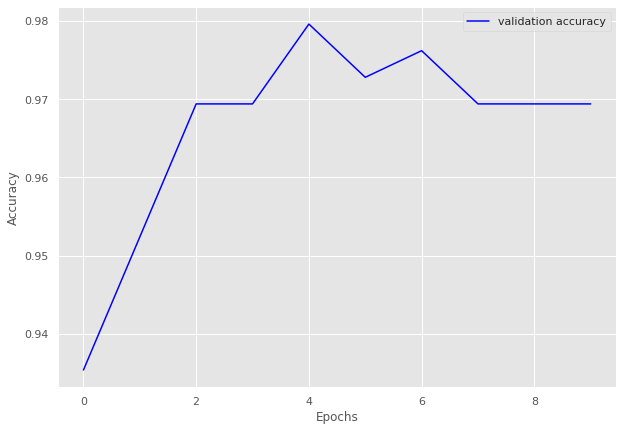

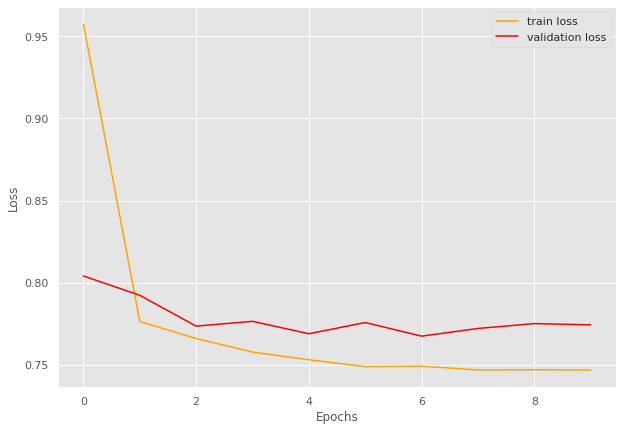

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.99batch/s, loss=0.715]


train loss 0.7151171785813791, validation loss 0.6242966532707215, validation accuracy 0.9290780141843972
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.90batch/s, loss=0.581]


train loss 0.5810098515616523, validation loss 0.5879413485527039, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.95batch/s, loss=0.571]


INFO: Early stopping counter 1 of 5
train loss 0.5708354910214742, validation loss 0.598428237438202, validation accuracy 0.9468085106382979
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.95batch/s, loss=0.567]


INFO: Early stopping counter 2 of 5
train loss 0.5666117535697089, validation loss 0.5981071829795838, validation accuracy 0.9574468085106383
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.98batch/s, loss=0.562]


INFO: Early stopping counter 3 of 5
train loss 0.5624835513256214, validation loss 0.6036486268043518, validation accuracy 0.9539007092198581
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.98batch/s, loss=0.562]


train loss 0.5623956278518394, validation loss 0.5876416802406311, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.96batch/s, loss=0.562]


INFO: Early stopping counter 4 of 5
train loss 0.5617815653483073, validation loss 0.5895647287368775, validation accuracy 0.9574468085106383
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.96batch/s, loss=0.565]


train loss 0.5649001465903388, validation loss 0.5834522247314453, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.95batch/s, loss=0.568]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9654797499320468 and loss 0.5868476516213911


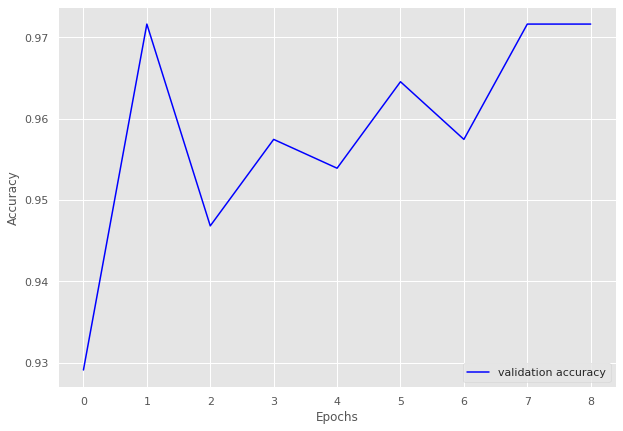

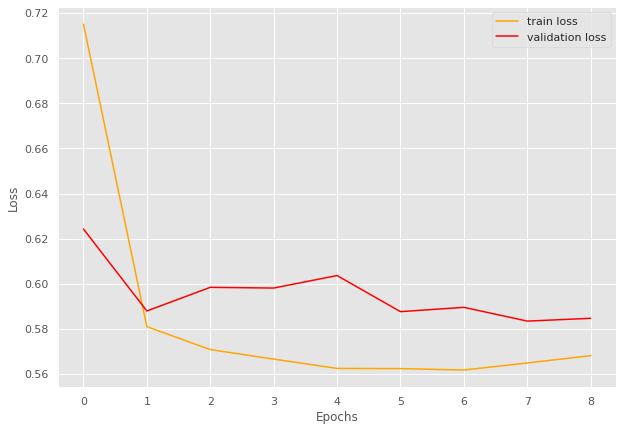

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 17 Epoch 1
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=0.983]


train loss 0.9826509912808736, validation loss 0.8514477372169494, validation accuracy 0.8867313915857605
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.02batch/s, loss=0.801]


train loss 0.8014722764492035, validation loss 0.8315670251846313, validation accuracy 0.919093851132686
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.97batch/s, loss=0.779]


INFO: Early stopping counter 1 of 5
train loss 0.7789529939492543, validation loss 0.8404798984527588, validation accuracy 0.8964401294498382
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=0.766]


train loss 0.7658802549044291, validation loss 0.8280598282814026, validation accuracy 0.912621359223301
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=0.773]


INFO: Early stopping counter 2 of 5
train loss 0.7731997470060984, validation loss 0.8340179800987244, validation accuracy 0.9061488673139159
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=0.775]


train loss 0.7751239895820617, validation loss 0.8221535444259643, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.769]


train loss 0.7689782361189524, validation loss 0.8143206477165222, validation accuracy 0.9352750809061489
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.03batch/s, loss=0.761]


INFO: Early stopping counter 3 of 5
train loss 0.7613679846127828, validation loss 0.8316870927810669, validation accuracy 0.9093851132686084
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=0.777]


INFO: Early stopping counter 4 of 5
train loss 0.7773453632990519, validation loss 0.8144015073776245, validation accuracy 0.9288025889967637
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=0.768]


train loss 0.7678738097349803, validation loss 0.8105308175086975, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 11
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.04batch/s, loss=0.757]


train loss 0.7565790096918742, validation loss 0.8093561053276062, validation accuracy 0.9320388349514563
Coarse label 17 Epoch 12
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=0.768]


train loss 0.7676654160022736, validation loss 0.8004541039466858, validation accuracy 0.941747572815534
Coarse label 17 Epoch 13
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.04batch/s, loss=0.771]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9377480158730159 and loss 0.8060897039988685


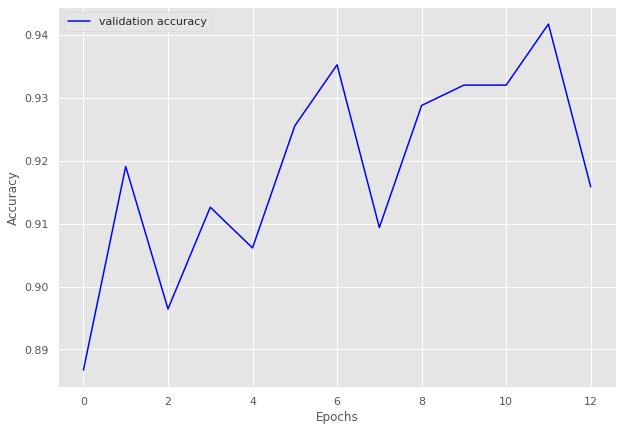

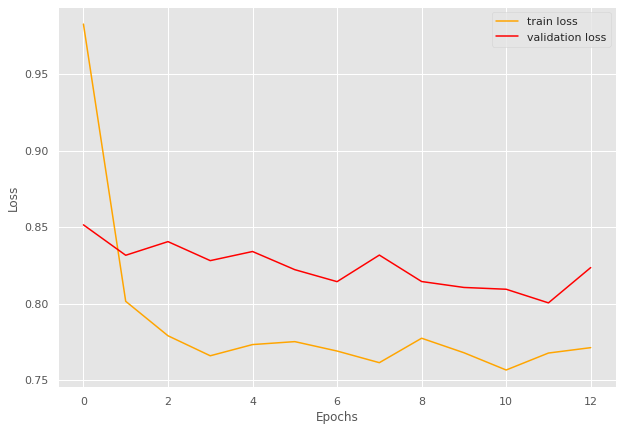

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 19 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.17batch/s, loss=1.12]


train loss 1.1184751987457275, validation loss 0.9280584156513214, validation accuracy 0.8958333333333334
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.07batch/s, loss=0.844]


train loss 0.8439635813236237, validation loss 0.8037388920783997, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.796]


train loss 0.7964909672737122, validation loss 0.7810796499252319, validation accuracy 0.96875
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.758]


train loss 0.7584249079227448, validation loss 0.773175448179245, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.21batch/s, loss=0.766]


train loss 0.7661417722702026, validation loss 0.7669669687747955, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.21batch/s, loss=0.757]


train loss 0.757446700334549, validation loss 0.7647512853145599, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.761]


INFO: Early stopping counter 1 of 5
train loss 0.7610265254974365, validation loss 0.7778656780719757, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.21batch/s, loss=0.767]


INFO: Early stopping counter 2 of 5
train loss 0.766572791337967, validation loss 0.7727455496788025, validation accuracy 0.96875
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.20batch/s, loss=0.762]


INFO: Early stopping counter 3 of 5
train loss 0.7622925460338592, validation loss 0.7746380269527435, validation accuracy 0.96875
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.11batch/s, loss=0.76]


INFO: Early stopping counter 4 of 5
train loss 0.76044921875, validation loss 0.7652986943721771, validation accuracy 1.0
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.20batch/s, loss=0.766]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9278996865203761 and loss 0.815129229426384


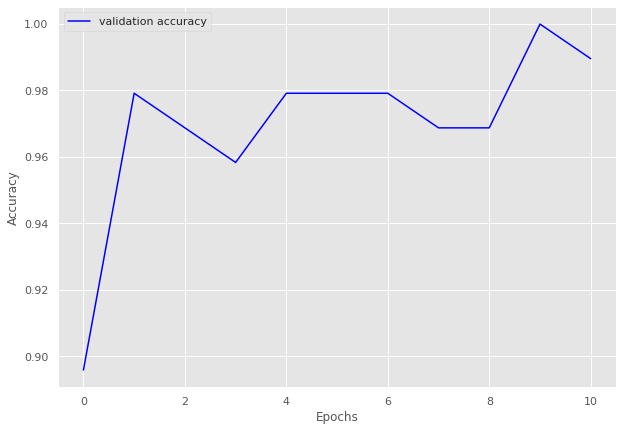

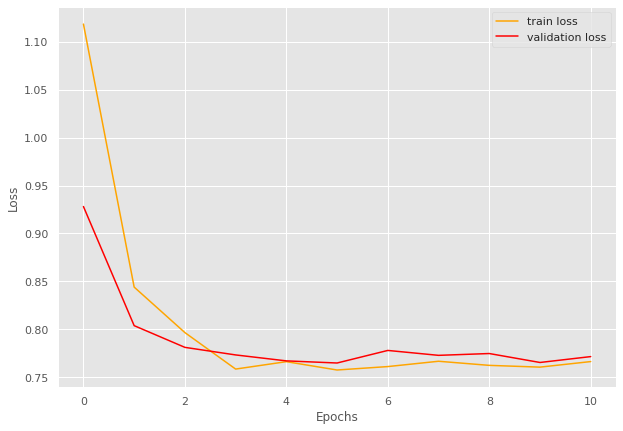

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Evaluating fine model 0
Evaluating fine model 1
Evaluating fine model 2
Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16
Evaluating fine model 17
Evaluating fine model 19
overall accuracy  is 0.7817751830821785
{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.93423053527980

Calculating for volume 55
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=1.07]


train loss 1.0701284329680836, validation loss 0.9655198965753827, validation accuracy 0.9393939393939394
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.90batch/s, loss=0.96] 


INFO: Early stopping counter 1 of 5
train loss 0.959834056742051, validation loss 0.9674369267054966, validation accuracy 0.9347319347319347
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.91batch/s, loss=0.945]


train loss 0.9453006640953177, validation loss 0.9624550598008292, validation accuracy 0.9393939393939394
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.90batch/s, loss=0.945]


INFO: Early stopping counter 2 of 5
train loss 0.9454700228045968, validation loss 0.9716611760003226, validation accuracy 0.9324009324009324
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.94] 


train loss 0.9397603913265116, validation loss 0.9386964014598301, validation accuracy 0.9673659673659674
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.948]


INFO: Early stopping counter 3 of 5
train loss 0.948322734412025, validation loss 0.9458457061222622, validation accuracy 0.958041958041958
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.92batch/s, loss=0.94] 


INFO: Early stopping counter 4 of 5
train loss 0.9399771059260649, validation loss 0.9564706427710397, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.94batch/s, loss=0.936]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9550475211918829 and loss 0.9511045754932966


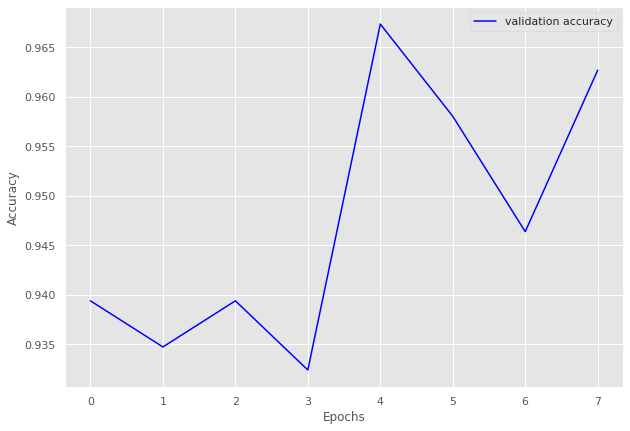

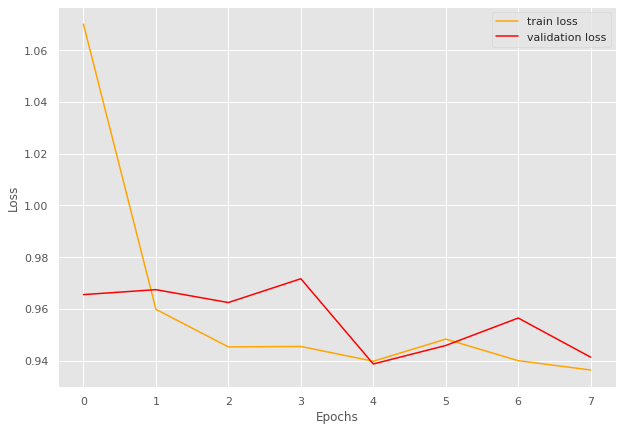

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 1 Epoch 1
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.91batch/s, loss=1.28]


train loss 1.2830730636914571, validation loss 1.1516905228296916, validation accuracy 0.8978494623655914
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.93batch/s, loss=1.09]


train loss 1.0935972531636555, validation loss 1.1071011225382488, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.08]


train loss 1.0751375039418538, validation loss 1.0999655723571777, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.96batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0675249258677164, validation loss 1.1032783190409343, validation accuracy 0.946236559139785
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.062937045097351, validation loss 1.103515386581421, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.97batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.065121555328369, validation loss 1.1055880784988403, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.94batch/s, loss=1.06]


train loss 1.0595093925793966, validation loss 1.097048322359721, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.95batch/s, loss=1.06]


train loss 1.0563996354738872, validation loss 1.095255732536316, validation accuracy 0.956989247311828
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.97batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0611260135968525, validation loss 1.0990111033121746, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.93batch/s, loss=1.05]


train loss 1.05008012453715, validation loss 1.084299921989441, validation accuracy 0.956989247311828
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.97batch/s, loss=1.05]


train loss 1.051479665438334, validation loss 1.0781174500783284, validation accuracy 0.967741935483871
Coarse label 1 Epoch 12
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.94batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9699292452830188 and loss 1.0752661007421989


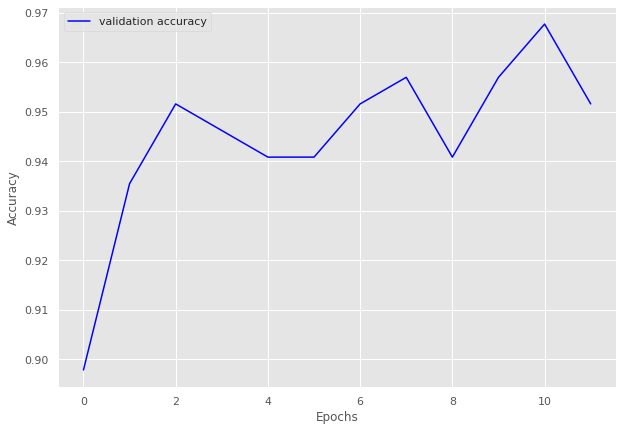

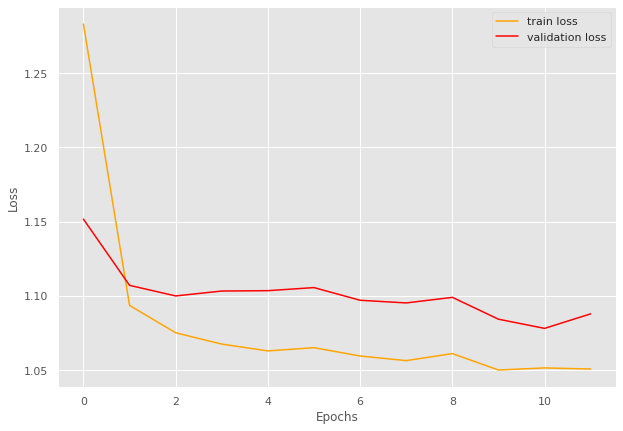

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 2 Epoch 1
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.88batch/s, loss=1.67]


train loss 1.6687290076791805, validation loss 1.5594215989112854, validation accuracy 0.906896551724138
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.90batch/s, loss=1.53]


train loss 1.532165652644025, validation loss 1.540357572691781, validation accuracy 0.9206896551724137
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.90batch/s, loss=1.52]


train loss 1.517536754155681, validation loss 1.5312362568719047, validation accuracy 0.9310344827586207
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.88batch/s, loss=1.51]


INFO: Early stopping counter 1 of 5
train loss 1.506509321449447, validation loss 1.5317167724881853, validation accuracy 0.9298850574712644
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 137/137 [00:46<00:00,  2.92batch/s, loss=1.5]


train loss 1.5016470390514736, validation loss 1.5199071509497506, validation accuracy 0.9402298850574713
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.5]


INFO: Early stopping counter 2 of 5
train loss 1.5007918420499258, validation loss 1.530284115246364, validation accuracy 0.9333333333333333
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 137/137 [00:46<00:00,  2.92batch/s, loss=1.5] 


train loss 1.495704438564551, validation loss 1.5182582565716334, validation accuracy 0.9448275862068966
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.89batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.4912676045494357, validation loss 1.519817624773298, validation accuracy 0.9402298850574713
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.5] 


INFO: Early stopping counter 4 of 5
train loss 1.4950589820416305, validation loss 1.528252192905971, validation accuracy 0.9344827586206896
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.89batch/s, loss=1.49]


train loss 1.4880001362222826, validation loss 1.50991404908044, validation accuracy 0.9505747126436782
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.943747624477385 and loss 1.5181679264191659


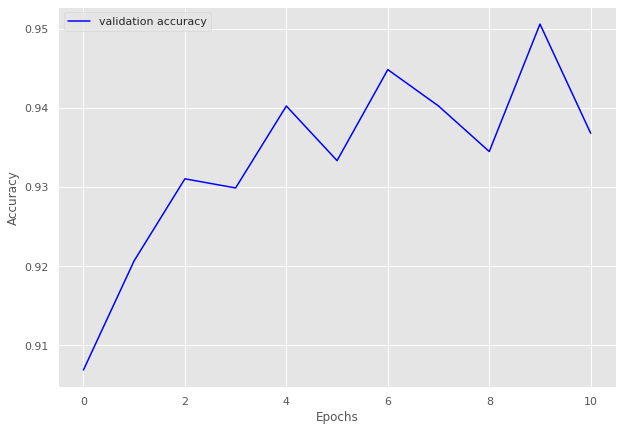

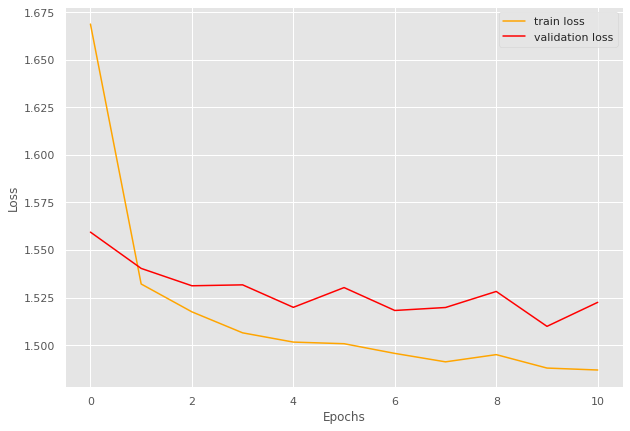

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=1.26]


train loss 1.257350729062007, validation loss 1.113309451511928, validation accuracy 0.9368932038834952
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.94batch/s, loss=1.1] 


train loss 1.0984974127549392, validation loss 1.1110944407326835, validation accuracy 0.9393203883495146
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.08]


train loss 1.0806948056587806, validation loss 1.1095099108559745, validation accuracy 0.9320388349514563
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0736608321850116, validation loss 1.1146913085665022, validation accuracy 0.9320388349514563
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.93batch/s, loss=1.07]


train loss 1.0684495705824633, validation loss 1.1050770623343331, validation accuracy 0.9393203883495146
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 65/65 [00:35<00:00,  1.85batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0681568072392391, validation loss 1.106414488383702, validation accuracy 0.9393203883495146
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 65/65 [00:41<00:00,  1.56batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.072887736100417, validation loss 1.1207827159336634, validation accuracy 0.9247572815533981
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 65/65 [00:46<00:00,  1.39batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.0698977250319262, validation loss 1.110228385244097, validation accuracy 0.941747572815534
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 65/65 [00:49<00:00,  1.32batch/s, loss=1.07]


train loss 1.0655469325872569, validation loss 1.0942613908222742, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 65/65 [00:39<00:00,  1.63batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9551918433056077 and loss 1.0891953747151262


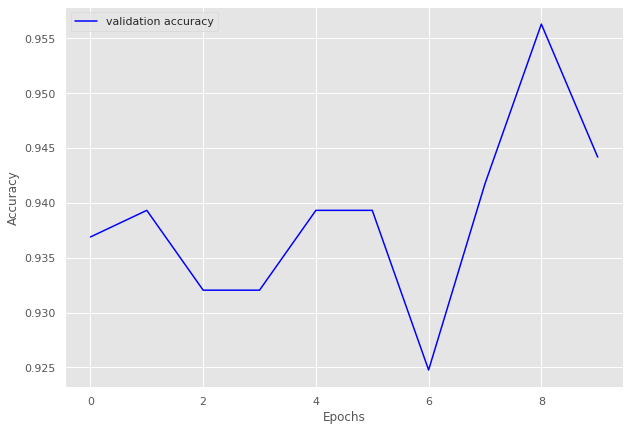

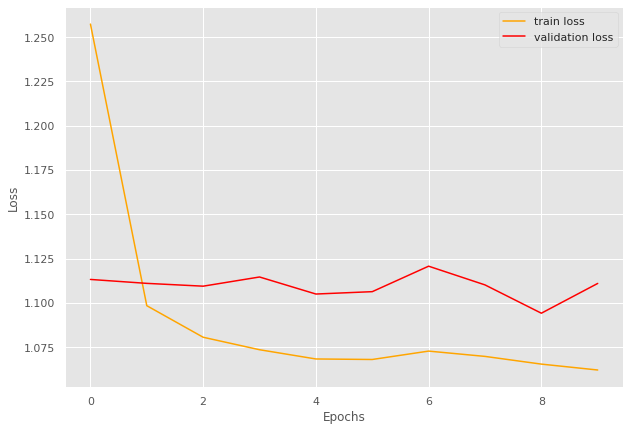

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.86batch/s, loss=0.398]


train loss 0.39837348461151123, validation loss 0.3368605474630992, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.94batch/s, loss=0.324]


INFO: Early stopping counter 1 of 5
train loss 0.3237377059459686, validation loss 0.34803759058316547, validation accuracy 0.9622641509433962
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.89batch/s, loss=0.323]


train loss 0.32300258994102476, validation loss 0.3275853594144185, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.92batch/s, loss=0.318]


INFO: Early stopping counter 2 of 5
train loss 0.31809444308280943, validation loss 0.3349057734012604, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.92batch/s, loss=0.317]


INFO: Early stopping counter 3 of 5
train loss 0.31650116443634035, validation loss 0.32969000935554504, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.88batch/s, loss=0.316]


INFO: Early stopping counter 4 of 5
train loss 0.31617380619049074, validation loss 0.3345748583475749, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.95batch/s, loss=0.315]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9861014593467686 and loss 0.3264152135538018


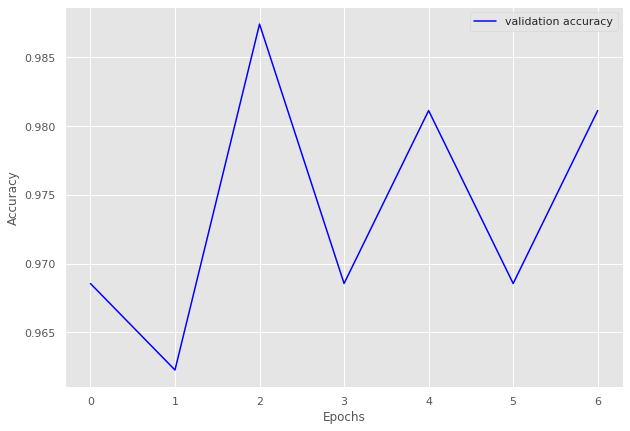

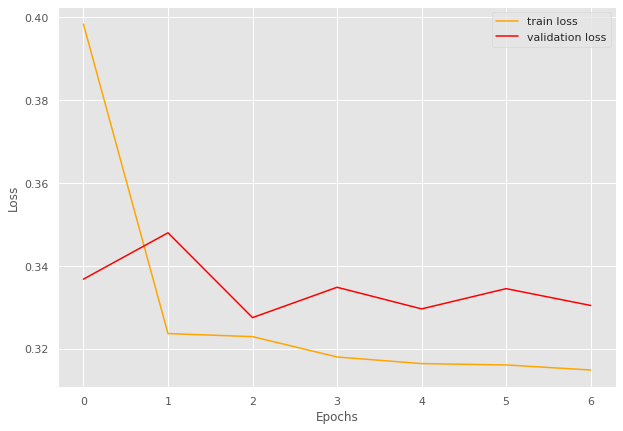

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 73/73 [00:25<00:00,  2.92batch/s, loss=1.36]


train loss 1.3611799364220607, validation loss 1.2696772068738937, validation accuracy 0.9008620689655172
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.94batch/s, loss=1.23]


train loss 1.2273463484359115, validation loss 1.2310985624790192, validation accuracy 0.9353448275862069
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.92batch/s, loss=1.22]


INFO: Early stopping counter 1 of 5
train loss 1.2185091025208774, validation loss 1.2313288152217865, validation accuracy 0.9310344827586207
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 73/73 [00:27<00:00,  2.69batch/s, loss=1.2] 


train loss 1.2010727320631889, validation loss 1.2259905338287354, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 73/73 [00:25<00:00,  2.86batch/s, loss=1.19]


INFO: Early stopping counter 2 of 5
train loss 1.194967163752203, validation loss 1.2338448911905289, validation accuracy 0.9288793103448276
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 73/73 [00:25<00:00,  2.90batch/s, loss=1.2] 


train loss 1.1989150406563118, validation loss 1.2200447022914886, validation accuracy 0.9461206896551724
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.94batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1892114061198822, validation loss 1.2248245775699615, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.93batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1918943254915002, validation loss 1.2290031015872955, validation accuracy 0.9353448275862069
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.93batch/s, loss=1.19]


train loss 1.1891426484878749, validation loss 1.2175823003053665, validation accuracy 0.9504310344827587
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.93batch/s, loss=1.18]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9586206896551724 and loss 1.2076658154978896


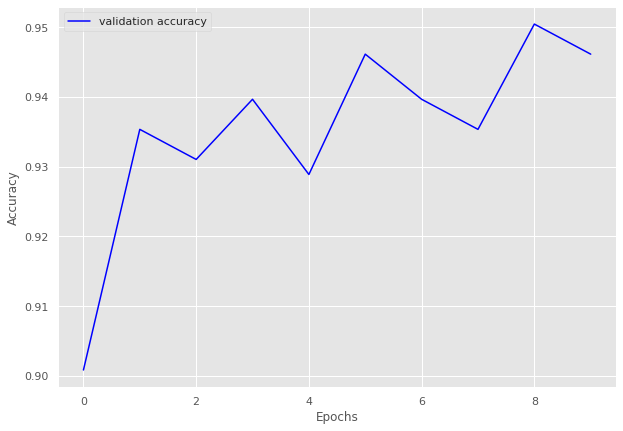

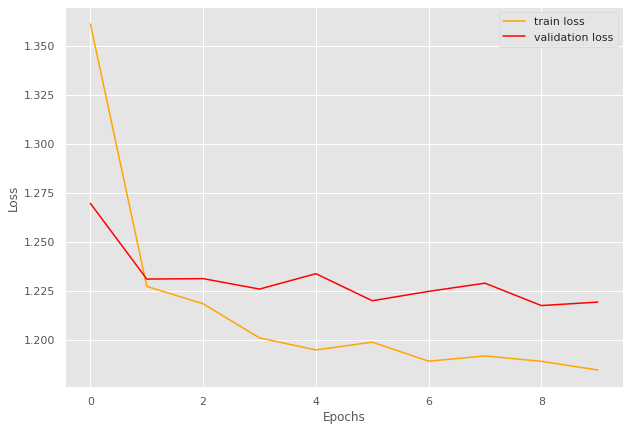

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.95batch/s, loss=0.846]


train loss 0.8464887347714655, validation loss 0.7847956120967865, validation accuracy 0.9559228650137741
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.92batch/s, loss=0.771]


train loss 0.7714578704587345, validation loss 0.7646847267945608, validation accuracy 0.9834710743801653
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.94batch/s, loss=0.765]


INFO: Early stopping counter 1 of 5
train loss 0.7652857046702812, validation loss 0.7697390417257944, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.91batch/s, loss=0.759]


INFO: Early stopping counter 2 of 5
train loss 0.7593341551978012, validation loss 0.7727503577868143, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.94batch/s, loss=0.758]


INFO: Early stopping counter 3 of 5
train loss 0.7577653311449906, validation loss 0.766008605559667, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.93batch/s, loss=0.758]


train loss 0.7579271680322187, validation loss 0.7550604144732157, validation accuracy 0.9889807162534435
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.91batch/s, loss=0.754]


INFO: Early stopping counter 4 of 5
train loss 0.7544531400861412, validation loss 0.7645767827828726, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 58/58 [00:22<00:00,  2.56batch/s, loss=0.752]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9775212636695019 and loss 0.7661138555178275


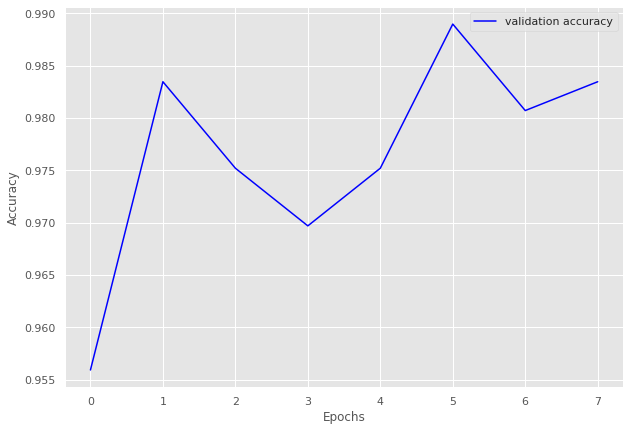

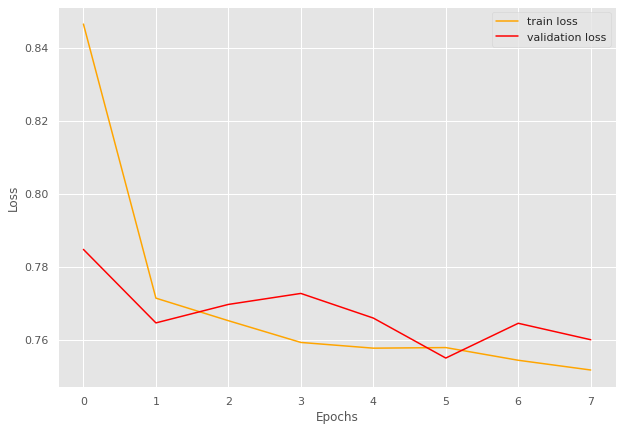

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.91batch/s, loss=1.38]


train loss 1.3755941685335136, validation loss 1.2579965591430664, validation accuracy 0.9197651663405088
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.23]


train loss 1.2294511397679646, validation loss 1.2503142207860947, validation accuracy 0.9119373776908023
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.92batch/s, loss=1.22]


INFO: Early stopping counter 1 of 5
train loss 1.2184243732028537, validation loss 1.2559117376804352, validation accuracy 0.9119373776908023
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.92batch/s, loss=1.21]


INFO: Early stopping counter 2 of 5
train loss 1.2124653053872378, validation loss 1.2637401670217514, validation accuracy 0.9001956947162426
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.91batch/s, loss=1.21]


train loss 1.2105118948736309, validation loss 1.2361972332000732, validation accuracy 0.9256360078277887
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.91batch/s, loss=1.2] 


train loss 1.1984806855519612, validation loss 1.2297319173812866, validation accuracy 0.9354207436399217
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.2]


train loss 1.1988579564624362, validation loss 1.2269847840070724, validation accuracy 0.9373776908023483
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 81/81 [00:28<00:00,  2.88batch/s, loss=1.19]


train loss 1.190511264918763, validation loss 1.2215190678834915, validation accuracy 0.9452054794520548
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.92batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1866825524671578, validation loss 1.2291526645421982, validation accuracy 0.9373776908023483
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.92batch/s, loss=1.19]


train loss 1.1869245252491516, validation loss 1.2205470204353333, validation accuracy 0.9452054794520548
Coarse label 8 Epoch 11
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1871200623335663, validation loss 1.223607912659645, validation accuracy 0.9412915851272016
Coarse label 8 Epoch 12
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.95batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9506920415224913 and loss 1.2147973367612657


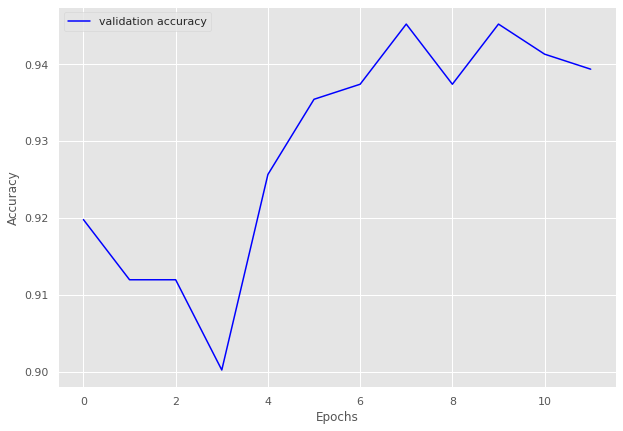

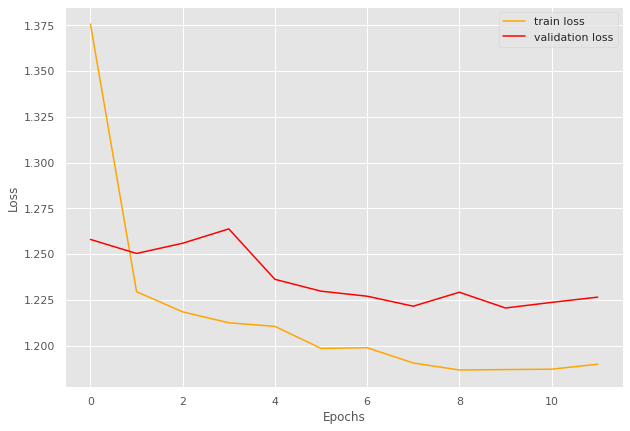

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.88batch/s, loss=1.65]


train loss 1.6523964241439222, validation loss 1.581089821728793, validation accuracy 0.9120370370370371
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.53]


train loss 1.5262626280971603, validation loss 1.5554352348501033, validation accuracy 0.9305555555555556
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.51]


INFO: Early stopping counter 1 of 5
train loss 1.5063879267842162, validation loss 1.5581979859958996, validation accuracy 0.9274691358024691
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.90batch/s, loss=1.5]


train loss 1.4978559449607252, validation loss 1.5451962839473377, validation accuracy 0.9290123456790124
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.5]


INFO: Early stopping counter 2 of 5
train loss 1.495163036327736, validation loss 1.5488216551867398, validation accuracy 0.9398148148148148
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 102/102 [00:34<00:00,  2.92batch/s, loss=1.49]


train loss 1.4885756969451904, validation loss 1.5190351334485142, validation accuracy 0.9537037037037037
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 102/102 [00:34<00:00,  2.92batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4847355940762688, validation loss 1.5385660474950618, validation accuracy 0.941358024691358
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4825984718752843, validation loss 1.5324488336389714, validation accuracy 0.9490740740740741
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9571379781420765 and loss 1.505501804144486


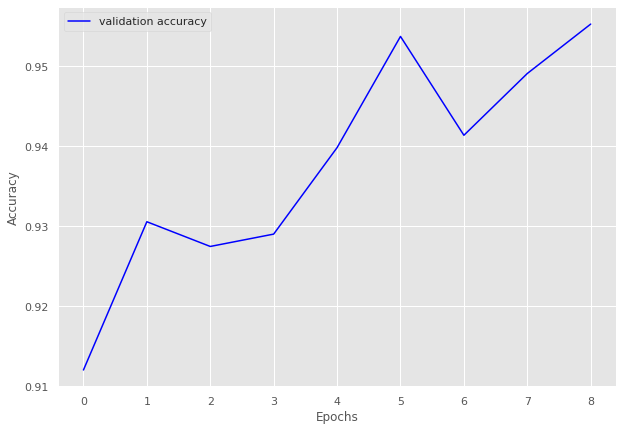

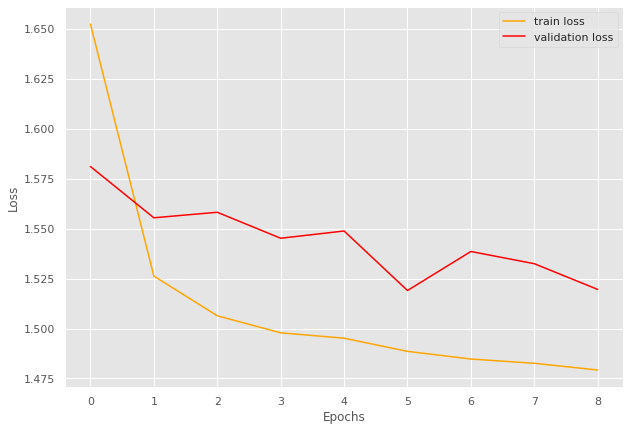

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.92batch/s, loss=0.861]


train loss 0.8614654031892618, validation loss 0.7769535183906555, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.90batch/s, loss=0.766]


INFO: Early stopping counter 1 of 5
train loss 0.7657322523494562, validation loss 0.7823396921157837, validation accuracy 0.9605263157894737
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.91batch/s, loss=0.761]


train loss 0.7607835891346136, validation loss 0.7673432350158691, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 48/48 [00:28<00:00,  1.71batch/s, loss=0.757]


train loss 0.7566796727478504, validation loss 0.7669894576072693, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 48/48 [00:31<00:00,  1.52batch/s, loss=0.753]


INFO: Early stopping counter 2 of 5
train loss 0.753283578902483, validation loss 0.7687506318092346, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 48/48 [00:40<00:00,  1.17batch/s, loss=0.75] 


train loss 0.7503685504198074, validation loss 0.7664488196372986, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 48/48 [00:35<00:00,  1.35batch/s, loss=0.749]


INFO: Early stopping counter 3 of 5
train loss 0.7494426568349203, validation loss 0.773001205921173, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 48/48 [00:38<00:00,  1.26batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.7508755785723528, validation loss 0.7677573800086975, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 48/48 [00:35<00:00,  1.35batch/s, loss=0.751]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9775362318840579 and loss 0.7654417997056787


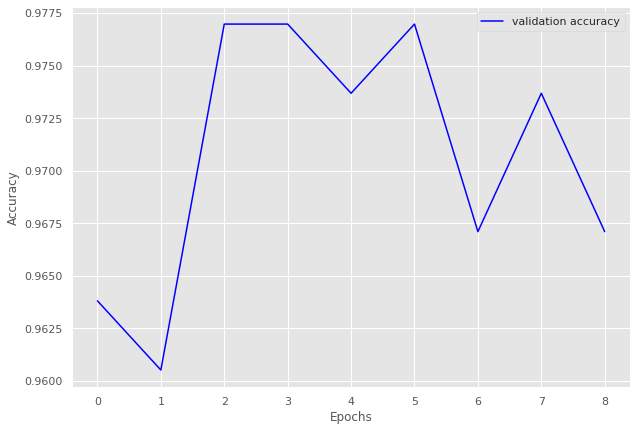

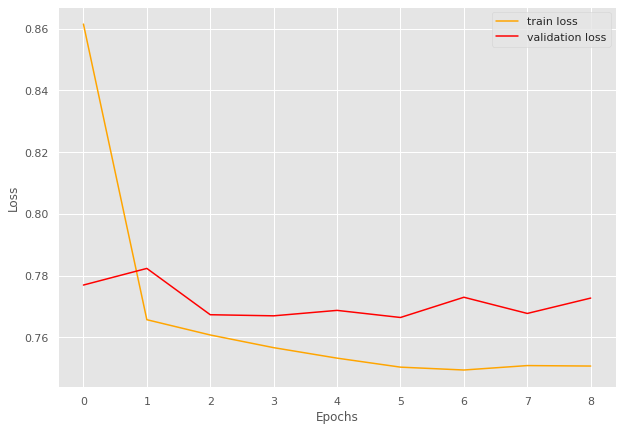

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9775362318840579
Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.97batch/s, loss=1.31]


train loss 1.3113381162933682, validation loss 1.16866135597229, validation accuracy 0.8724137931034482
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.93batch/s, loss=1.12]


train loss 1.1188101898068967, validation loss 1.1370096921920776, validation accuracy 0.906896551724138
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.94batch/s, loss=1.1] 


INFO: Early stopping counter 1 of 5
train loss 1.0997997936995134, validation loss 1.1400588035583497, validation accuracy 0.9
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.96batch/s, loss=1.1] 


INFO: Early stopping counter 2 of 5
train loss 1.095159447711447, validation loss 1.1372499942779541, validation accuracy 0.9103448275862069
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.92batch/s, loss=1.09]


train loss 1.0896541528079822, validation loss 1.1357332468032837, validation accuracy 0.906896551724138
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.94batch/s, loss=1.09]


train loss 1.0864642184713613, validation loss 1.1233570098876953, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.95batch/s, loss=1.09]


INFO: Early stopping counter 3 of 5
train loss 1.0868107676506042, validation loss 1.1340899229049684, validation accuracy 0.906896551724138
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.96batch/s, loss=1.08]


INFO: Early stopping counter 4 of 5
train loss 1.0832265174907187, validation loss 1.1265802145004273, validation accuracy 0.9172413793103448
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.97batch/s, loss=1.08]


train loss 1.0820847101833508, validation loss 1.1052544116973877, validation accuracy 0.9344827586206896
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.94batch/s, loss=1.08]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9507575757575758 and loss 1.0929868249666124


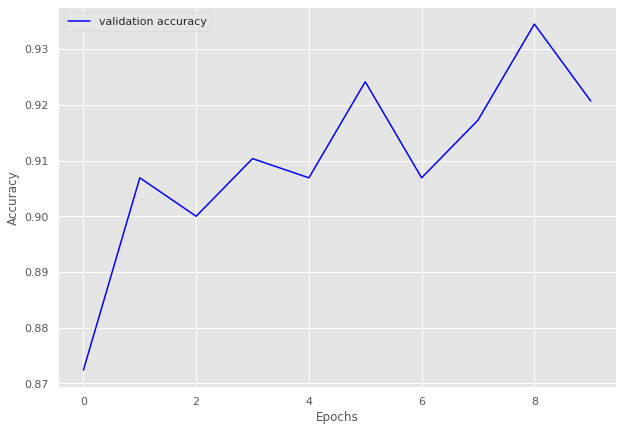

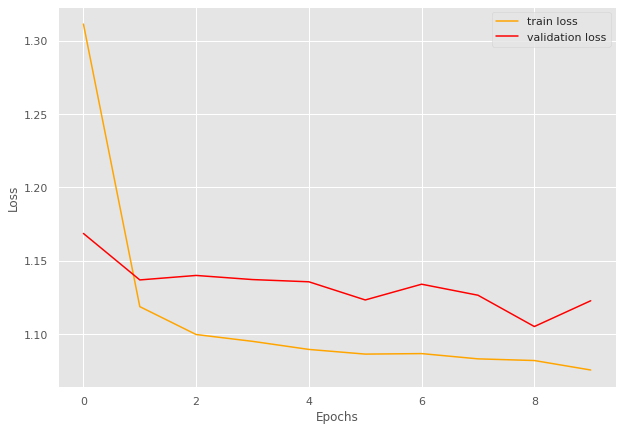

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.681]


train loss 0.6805958965929543, validation loss 0.5995253920555115, validation accuracy 0.9382239382239382
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.97batch/s, loss=0.593]


train loss 0.5928298351241321, validation loss 0.5968387007713318, validation accuracy 0.9343629343629344
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.586]


train loss 0.585766084310485, validation loss 0.5825843095779419, validation accuracy 0.9613899613899614
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.96batch/s, loss=0.575]


INFO: Early stopping counter 1 of 5
train loss 0.5746202701475562, validation loss 0.5955285787582397, validation accuracy 0.9420849420849421
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.83batch/s, loss=0.574]


INFO: Early stopping counter 2 of 5
train loss 0.5736124631835193, validation loss 0.5866440296173095, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.90batch/s, loss=0.571]


train loss 0.5712951974170964, validation loss 0.5770590662956238, validation accuracy 0.972972972972973
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.569]


INFO: Early stopping counter 3 of 5
train loss 0.5688748664972259, validation loss 0.5864003300666809, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.96batch/s, loss=0.57] 


INFO: Early stopping counter 4 of 5
train loss 0.5703610806930356, validation loss 0.5861724853515625, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.568]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9568560444254592 and loss 0.5935759528263195


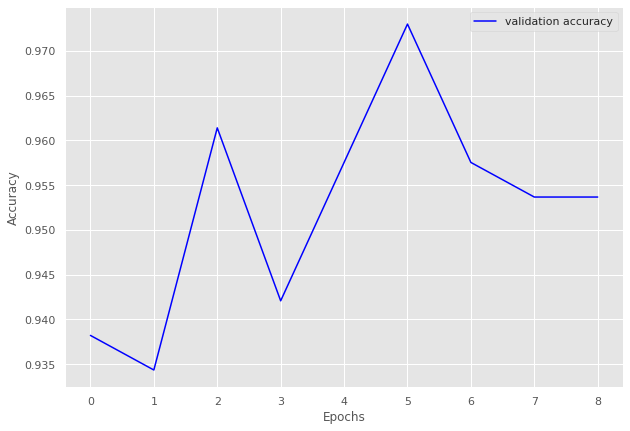

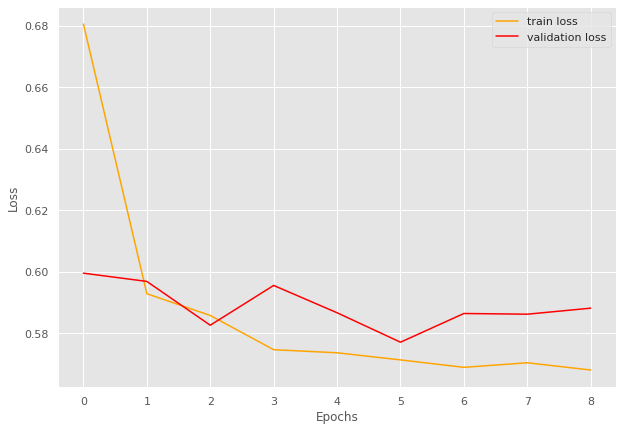

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.94batch/s, loss=1.17]


train loss 1.173102468886274, validation loss 1.0841723799705505, validation accuracy 0.9579124579124579
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.94batch/s, loss=1.09]


train loss 1.0859140005517514, validation loss 1.0746258020401, validation accuracy 0.9663299663299664
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.93batch/s, loss=1.07]


train loss 1.0689058392605884, validation loss 1.0700230121612548, validation accuracy 0.9713804713804713
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.88batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0698526806019721, validation loss 1.0738173723220825, validation accuracy 0.9696969696969697
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0690632475183366, validation loss 1.0746965050697326, validation accuracy 0.9663299663299664
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.93batch/s, loss=1.07]


train loss 1.0694040300998282, validation loss 1.0661102414131165, validation accuracy 0.9764309764309764
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.062971960990987, validation loss 1.06665540933609, validation accuracy 0.9747474747474747
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0612825244031054, validation loss 1.0700631022453309, validation accuracy 0.9713804713804713
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 94/94 [00:32<00:00,  2.92batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9631627906976744 and loss 1.0798919144130887


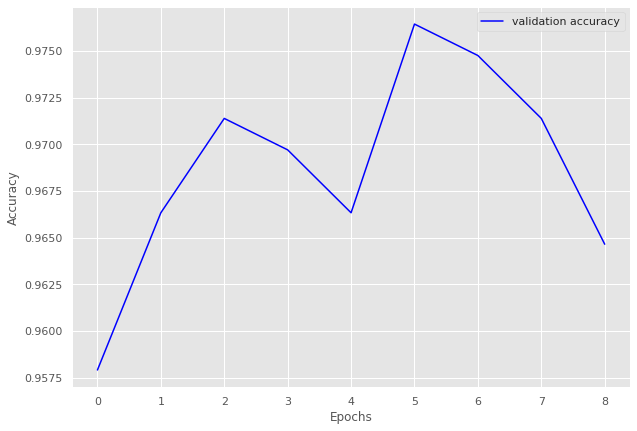

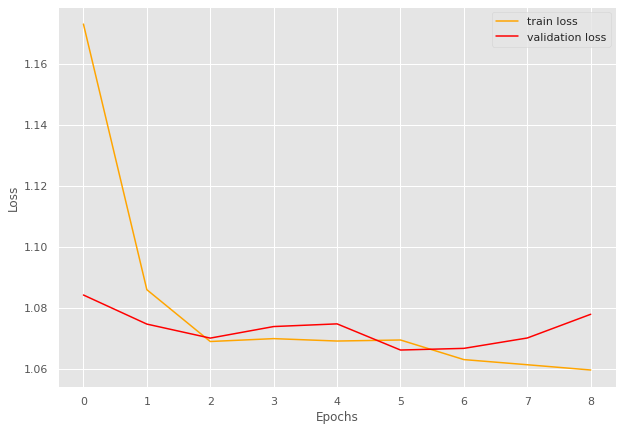

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9631627906976744
Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  3.01batch/s, loss=0.91] 


train loss 0.9102138547187156, validation loss 0.7825458526611329, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.91batch/s, loss=0.78] 


INFO: Early stopping counter 1 of 5
train loss 0.7801079179378266, validation loss 0.784671688079834, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.97batch/s, loss=0.776]


train loss 0.7763677949601031, validation loss 0.7653437376022338, validation accuracy 0.9795918367346939
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.96batch/s, loss=0.765]


train loss 0.7647106254354437, validation loss 0.7593216180801392, validation accuracy 0.9863945578231292
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.97batch/s, loss=0.771]


train loss 0.7706243662123985, validation loss 0.759041690826416, validation accuracy 0.9829931972789115
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.96batch/s, loss=0.772]


INFO: Early stopping counter 2 of 5
train loss 0.7716006332255424, validation loss 0.7639545321464538, validation accuracy 0.9761904761904762
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.98batch/s, loss=0.764]


INFO: Early stopping counter 3 of 5
train loss 0.7636573631712731, validation loss 0.7697258114814758, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.97batch/s, loss=0.759]


INFO: Early stopping counter 4 of 5
train loss 0.7586776677598345, validation loss 0.7680319905281067, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.96batch/s, loss=0.752]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9706103993971364 and loss 0.7714235427833739


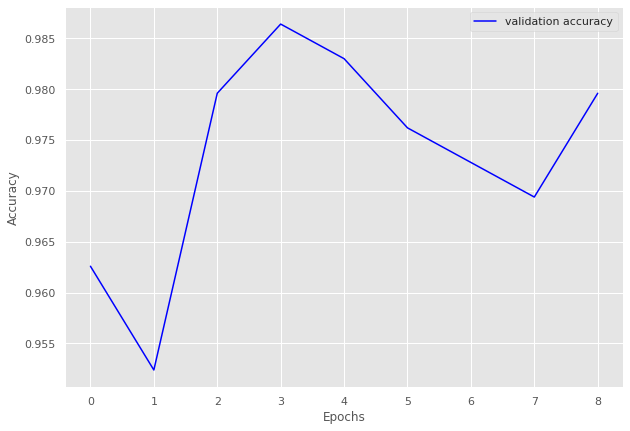

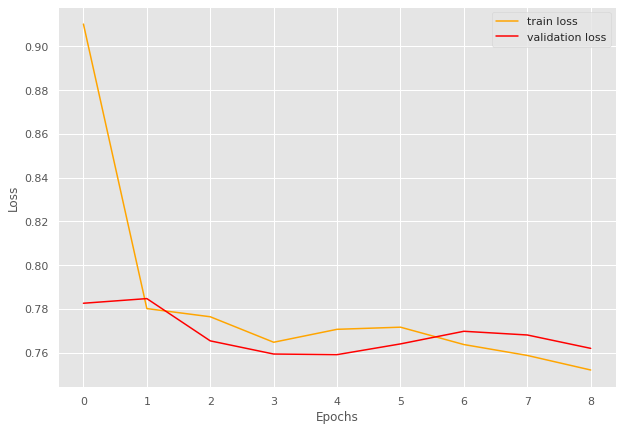

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.98batch/s, loss=0.672]


train loss 0.6719291528065999, validation loss 0.5861265659332275, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.97batch/s, loss=0.579]


train loss 0.5792232235272725, validation loss 0.5776410341262818, validation accuracy 0.975177304964539
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  3.00batch/s, loss=0.567]


train loss 0.5668963842921787, validation loss 0.5657342553138733, validation accuracy 0.9858156028368794
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.98batch/s, loss=0.565]


INFO: Early stopping counter 1 of 5
train loss 0.5649673846032884, validation loss 0.5776895403861999, validation accuracy 0.9787234042553191
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.97batch/s, loss=0.567]


INFO: Early stopping counter 2 of 5
train loss 0.5668445772594876, validation loss 0.5753719687461853, validation accuracy 0.9787234042553191
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.96batch/s, loss=0.567]


train loss 0.5668114436997308, validation loss 0.5657310843467712, validation accuracy 0.9893617021276596
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.99batch/s, loss=0.569]


INFO: Early stopping counter 3 of 5
train loss 0.5691108478440179, validation loss 0.5722825527191162, validation accuracy 0.9822695035460993
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.99batch/s, loss=0.56] 


train loss 0.560172352525923, validation loss 0.5602210164070129, validation accuracy 0.9929078014184397
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.98batch/s, loss=0.557]


INFO: Early stopping counter 4 of 5
train loss 0.5573886023627387, validation loss 0.5622916698455811, validation accuracy 0.9893617021276596
Coarse label 16 Epoch 10
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.97batch/s, loss=0.556]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.978021978021978 and loss 0.5728411361575126


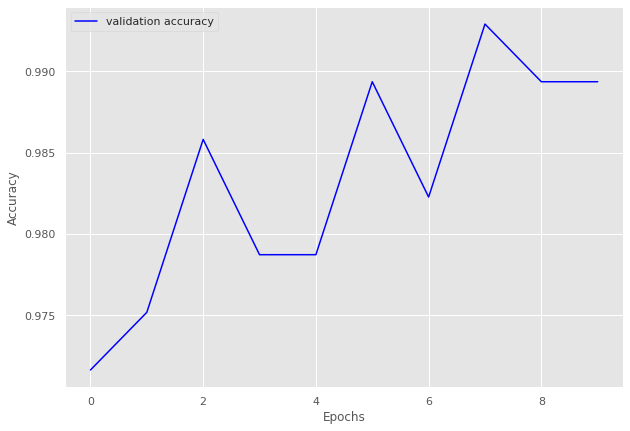

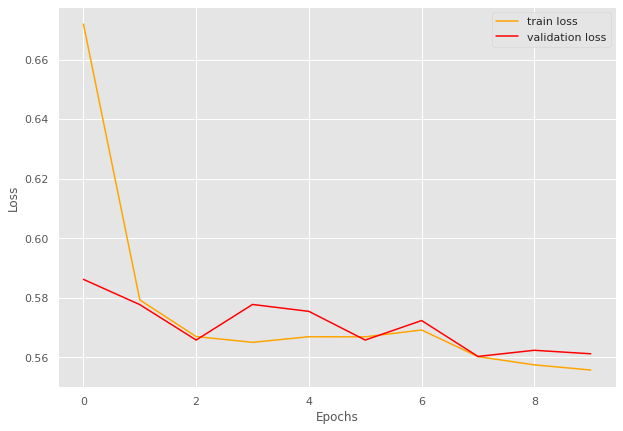

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 17 Epoch 1
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.97batch/s, loss=0.932]


train loss 0.9317865006777705, validation loss 0.8329407095909118, validation accuracy 0.912621359223301
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.98batch/s, loss=0.8]  


train loss 0.7996599516090082, validation loss 0.8198967814445496, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=0.777]


train loss 0.7765190017466642, validation loss 0.8082768678665161, validation accuracy 0.9352750809061489
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.96batch/s, loss=0.769]


train loss 0.7689335309729284, validation loss 0.7944129943847656, validation accuracy 0.9449838187702265
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=0.768]


INFO: Early stopping counter 1 of 5
train loss 0.7675029903042073, validation loss 0.8063782930374146, validation accuracy 0.9352750809061489
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 49/49 [00:20<00:00,  2.34batch/s, loss=0.764]


train loss 0.7638004920920547, validation loss 0.788759446144104, validation accuracy 0.9546925566343042
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.96batch/s, loss=0.763]


INFO: Early stopping counter 2 of 5
train loss 0.7629293519623426, validation loss 0.8013791799545288, validation accuracy 0.9449838187702265
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.98batch/s, loss=0.765]


INFO: Early stopping counter 3 of 5
train loss 0.7646082189618325, validation loss 0.8112299919128418, validation accuracy 0.9288025889967637
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 49/49 [00:17<00:00,  2.82batch/s, loss=0.761]


INFO: Early stopping counter 4 of 5
train loss 0.7605754355995022, validation loss 0.789529538154602, validation accuracy 0.9514563106796117
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.96batch/s, loss=0.759]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9509312320916905 and loss 0.7919342693957415


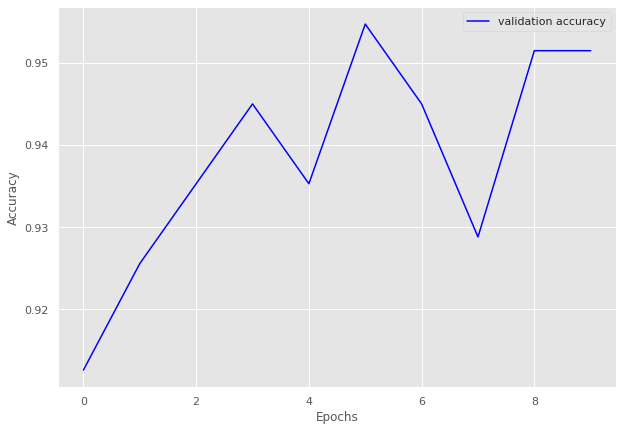

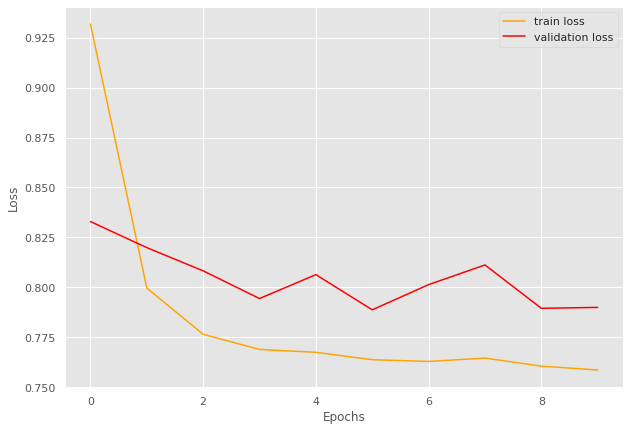

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 19 Epoch 1
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.04batch/s, loss=1.07]


train loss 1.0665498301386833, validation loss 0.8169211745262146, validation accuracy 0.9375
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  2.99batch/s, loss=0.8]  


train loss 0.800010409206152, validation loss 0.7681128084659576, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  2.98batch/s, loss=0.76] 


train loss 0.759505819529295, validation loss 0.7538689374923706, validation accuracy 0.9895833333333334
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.06batch/s, loss=0.756]


INFO: Early stopping counter 1 of 5
train loss 0.7563696838915348, validation loss 0.7550472915172577, validation accuracy 0.9895833333333334
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.01batch/s, loss=0.752]


INFO: Early stopping counter 2 of 5
train loss 0.7522257305681705, validation loss 0.7631215453147888, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.07batch/s, loss=0.75] 


INFO: Early stopping counter 3 of 5
train loss 0.7502300068736076, validation loss 0.7650143504142761, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.06batch/s, loss=0.749]


train loss 0.7494637109339237, validation loss 0.7489272654056549, validation accuracy 0.9895833333333334
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.08batch/s, loss=0.749]


train loss 0.7486560046672821, validation loss 0.7482067048549652, validation accuracy 1.0
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.07batch/s, loss=0.747]


INFO: Early stopping counter 4 of 5
train loss 0.7472935952246189, validation loss 0.751946359872818, validation accuracy 0.9895833333333334
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.07batch/s, loss=0.748]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9604072398190046 and loss 0.7799325840813773


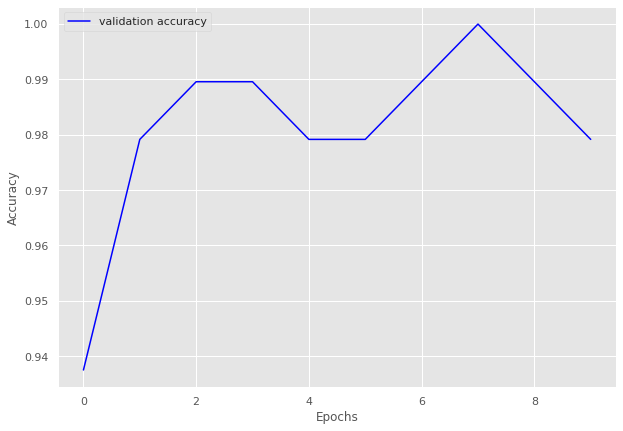

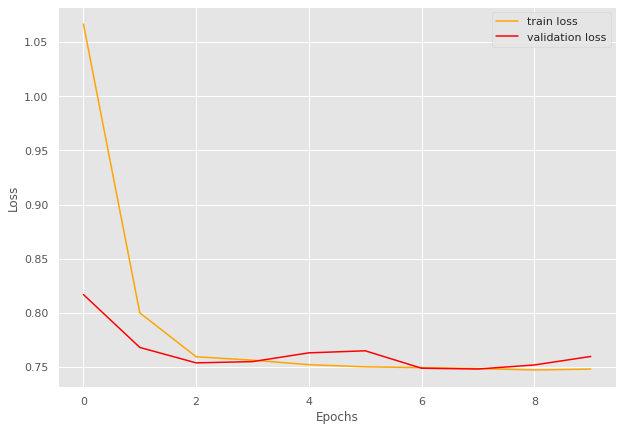

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Evaluating fine model 0
Evaluating fine model 1
Evaluating fine model 2
Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16
Evaluating fine model 17
Evaluating fine model 19
overall accuracy  is 0.8051371727403204
{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.93423053527980

Calculating for volume 85
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=1.04]


train loss 1.0382259717775046, validation loss 0.9601375034877232, validation accuracy 0.9440559440559441
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.93batch/s, loss=0.958]


train loss 0.9580082483247879, validation loss 0.9527798550469535, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.92batch/s, loss=0.947]


INFO: Early stopping counter 1 of 5
train loss 0.9473693988738804, validation loss 0.9534561889512199, validation accuracy 0.951048951048951
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.90batch/s, loss=0.955]


train loss 0.9554035034748393, validation loss 0.9406530346189227, validation accuracy 0.9673659673659674
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.93batch/s, loss=0.94] 


INFO: Early stopping counter 2 of 5
train loss 0.9404264775984877, validation loss 0.9442770651408604, validation accuracy 0.9603729603729604
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.94batch/s, loss=0.94] 


INFO: Early stopping counter 3 of 5
train loss 0.9401237543569793, validation loss 0.9483068925993783, validation accuracy 0.958041958041958
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.93batch/s, loss=0.941]


INFO: Early stopping counter 4 of 5
train loss 0.9406438858137218, validation loss 0.9597109130450657, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 109/109 [00:37<00:00,  2.93batch/s, loss=0.933]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9653579676674365 and loss 0.9396835877781823


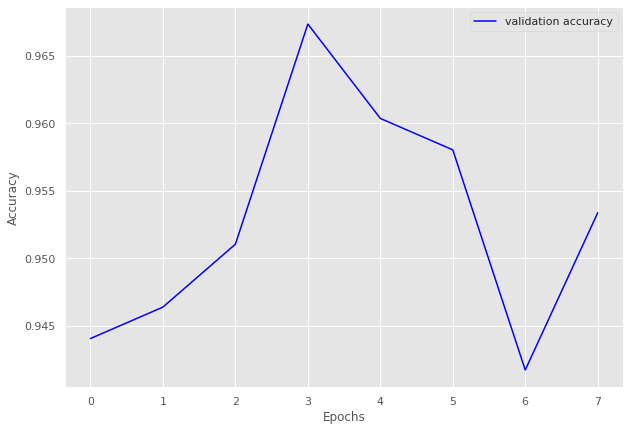

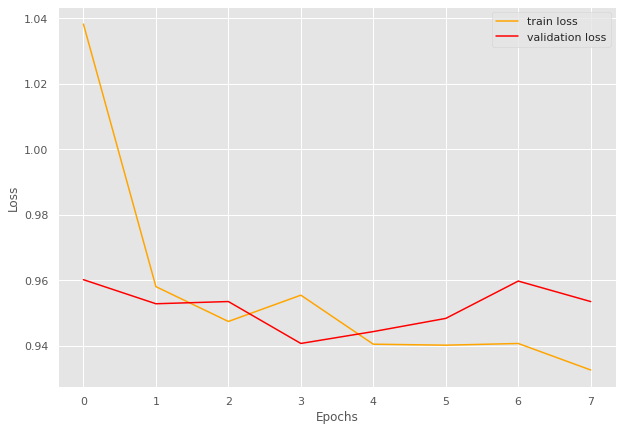

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9653579676674365
Coarse label 1 Epoch 1
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.93batch/s, loss=1.23]


train loss 1.2289111385954188, validation loss 1.1122289498647053, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.92batch/s, loss=1.09]


train loss 1.0896794872081026, validation loss 1.1096657117207844, validation accuracy 0.9247311827956989
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.90batch/s, loss=1.07]


train loss 1.0710693673884615, validation loss 1.1054292917251587, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.89batch/s, loss=1.06]


train loss 1.06006051631684, validation loss 1.099801739056905, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.90batch/s, loss=1.06]


train loss 1.059782144871164, validation loss 1.0932677586873372, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.91batch/s, loss=1.05]


INFO: Early stopping counter 1 of 5
train loss 1.0549002200999158, validation loss 1.1045129299163818, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.90batch/s, loss=1.05]


train loss 1.0512054194795324, validation loss 1.0770999987920125, validation accuracy 0.967741935483871
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.90batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.050575778839436, validation loss 1.0852793057759602, validation accuracy 0.9623655913978495
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.92batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.053765852400597, validation loss 1.091428558031718, validation accuracy 0.956989247311828
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.87batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0495911659078394, validation loss 1.0911191701889038, validation accuracy 0.946236559139785
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.91batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9647887323943662 and loss 1.077733529938592


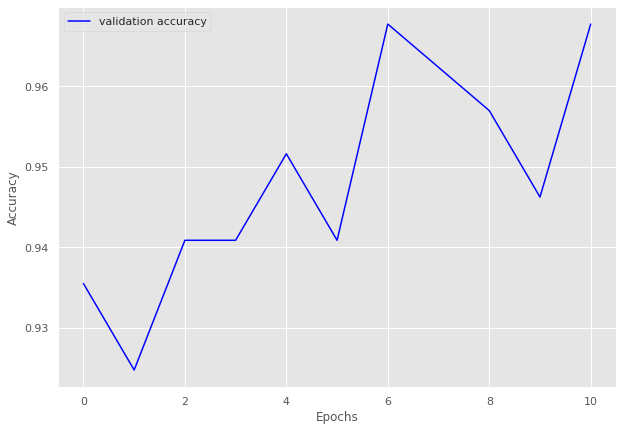

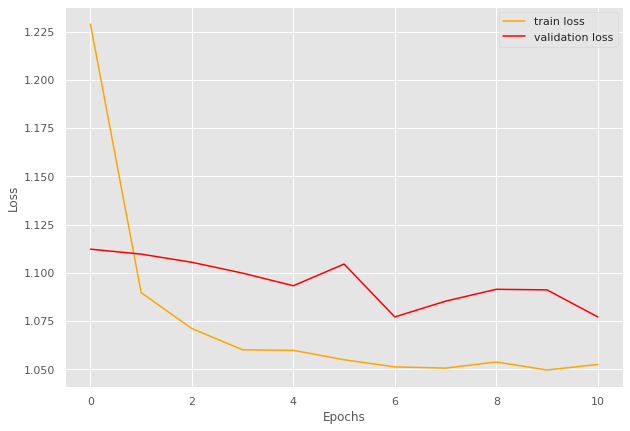

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 2 Epoch 1
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.91batch/s, loss=1.62]


train loss 1.6154433949427172, validation loss 1.5312869548797607, validation accuracy 0.9333333333333333
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.92batch/s, loss=1.53]


train loss 1.5289277212186294, validation loss 1.5212719099862235, validation accuracy 0.9390804597701149
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.91batch/s, loss=1.51]


train loss 1.509272289276123, validation loss 1.5209271311759949, validation accuracy 0.9402298850574713
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.92batch/s, loss=1.51]


train loss 1.505658349123868, validation loss 1.5146841151373727, validation accuracy 0.9448275862068966
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 220/220 [01:19<00:00,  2.75batch/s, loss=1.5]


train loss 1.5025544773448598, validation loss 1.5125874366079057, validation accuracy 0.9482758620689655
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.90batch/s, loss=1.5] 


train loss 1.4980088011784987, validation loss 1.504093314920153, validation accuracy 0.9597701149425287
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 220/220 [01:16<00:00,  2.89batch/s, loss=1.5]


INFO: Early stopping counter 1 of 5
train loss 1.4974942321127112, validation loss 1.5176311475890023, validation accuracy 0.9425287356321839
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.90batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4937759328972209, validation loss 1.5054068991116114, validation accuracy 0.9551724137931035
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 220/220 [02:22<00:00,  1.55batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.4915589132092215, validation loss 1.5076472333499364, validation accuracy 0.9528735632183908
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 220/220 [01:59<00:00,  1.84batch/s, loss=1.49]


INFO: Early stopping counter 4 of 5
train loss 1.4909451338377866, validation loss 1.5044580272265844, validation accuracy 0.9551724137931035
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.91batch/s, loss=1.49]


train loss 1.48917349468578, validation loss 1.502595101084028, validation accuracy 0.957471264367816
Coarse label 2 Epoch 12
-------------------------------


100%|██████████| 220/220 [01:15<00:00,  2.91batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9627800987466768 and loss 1.5022592118808202


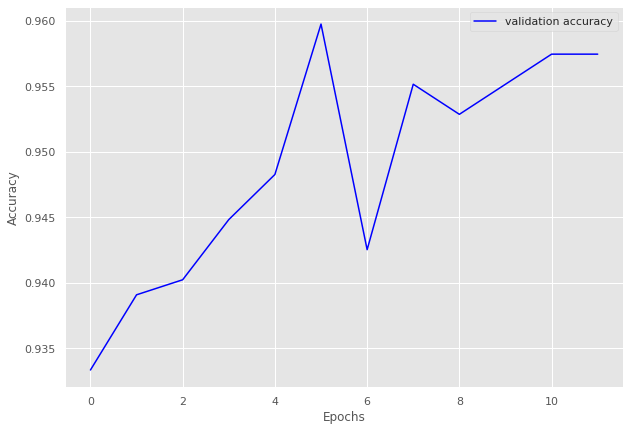

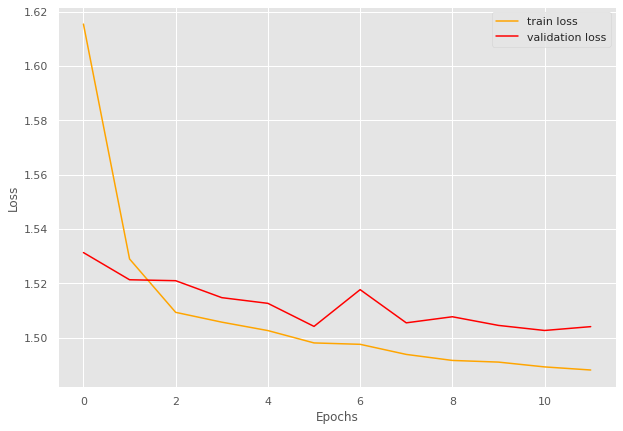

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.93batch/s, loss=1.2]


train loss 1.20149316237523, validation loss 1.1156539235796248, validation accuracy 0.9368932038834952
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.97batch/s, loss=1.1]


train loss 1.0990293071820185, validation loss 1.089335867336818, validation accuracy 0.9490291262135923
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.96batch/s, loss=1.08]


train loss 1.0817031585253203, validation loss 1.0874135494232178, validation accuracy 0.9538834951456311
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.94batch/s, loss=1.07]


train loss 1.0738173493972192, validation loss 1.0766871656690324, validation accuracy 0.9635922330097088
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.96batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0704569667577744, validation loss 1.083548971584865, validation accuracy 0.9611650485436893
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.96batch/s, loss=1.07]


train loss 1.0655263238228285, validation loss 1.0633081538336617, validation accuracy 0.9830097087378641
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0638784491098845, validation loss 1.0736315931592668, validation accuracy 0.9684466019417476
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.97batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0632299872545095, validation loss 1.067758423941476, validation accuracy 0.9781553398058253
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0597179050628955, validation loss 1.075771416936602, validation accuracy 0.9635922330097088
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 104/104 [00:35<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9654340836012861 and loss 1.0787275910377503


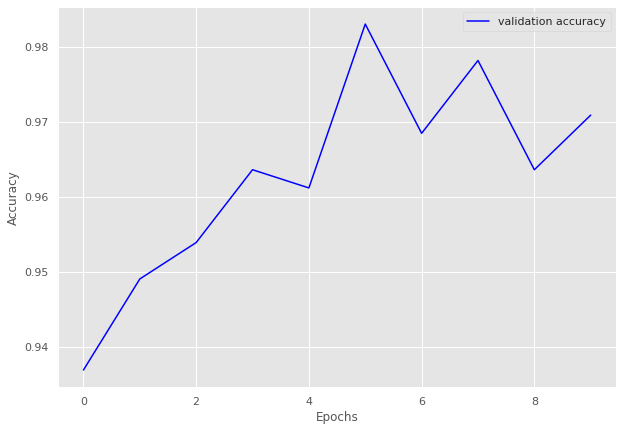

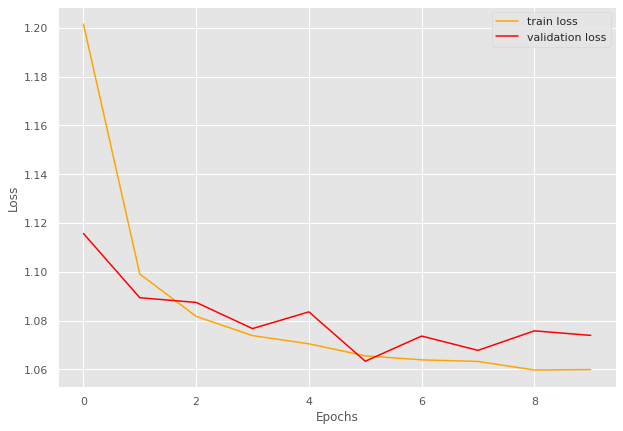

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9654340836012861
Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.92batch/s, loss=0.376]


train loss 0.37614720687270164, validation loss 0.3335420986016591, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.94batch/s, loss=0.328]


INFO: Early stopping counter 1 of 5
train loss 0.32797871604561807, validation loss 0.3370766242345174, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.91batch/s, loss=0.321]


train loss 0.3205258883535862, validation loss 0.3251363734404246, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 40/40 [00:14<00:00,  2.80batch/s, loss=0.32] 


train loss 0.32036765441298487, validation loss 0.3250329891840617, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.90batch/s, loss=0.322]


train loss 0.32228381335735323, validation loss 0.3214673002560933, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.94batch/s, loss=0.321]


INFO: Early stopping counter 2 of 5
train loss 0.32091293632984164, validation loss 0.3241642812887828, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.91batch/s, loss=0.319]


train loss 0.3186309918761253, validation loss 0.31965137521425885, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 40/40 [00:14<00:00,  2.81batch/s, loss=0.323]


INFO: Early stopping counter 3 of 5
train loss 0.32315642610192297, validation loss 0.32111944754918414, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.91batch/s, loss=0.323]


INFO: Early stopping counter 4 of 5
train loss 0.32290892452001574, validation loss 0.3206245501836141, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 10
-------------------------------


100%|██████████| 40/40 [00:13<00:00,  2.90batch/s, loss=0.32] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9812889812889813 and loss 0.3323199599981308


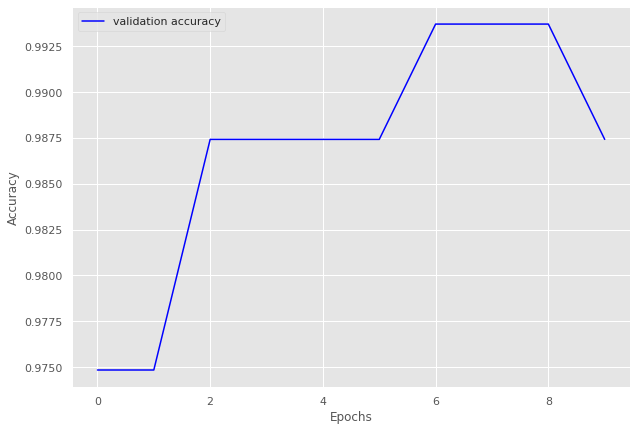

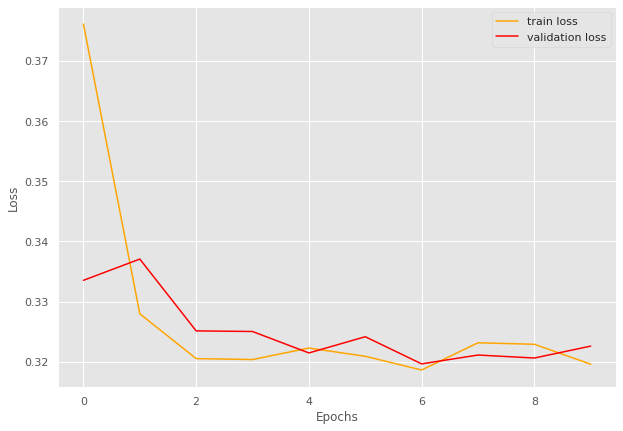

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.93batch/s, loss=1.31]


train loss 1.3138838242261837, validation loss 1.244726300239563, validation accuracy 0.9137931034482759
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.96batch/s, loss=1.23]


train loss 1.227457863652808, validation loss 1.2234809398651123, validation accuracy 0.9375
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.21]


train loss 1.2134153170463367, validation loss 1.2146068811416626, validation accuracy 0.9418103448275862
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.95batch/s, loss=1.2]


train loss 1.2041535571090176, validation loss 1.2095035314559937, validation accuracy 0.9525862068965517
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.2]


INFO: Early stopping counter 1 of 5
train loss 1.1996190843419132, validation loss 1.2160491347312927, validation accuracy 0.9439655172413793
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 117/117 [00:40<00:00,  2.92batch/s, loss=1.19]


INFO: Early stopping counter 2 of 5
train loss 1.1915250456231272, validation loss 1.2176786065101624, validation accuracy 0.9418103448275862
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.2]


INFO: Early stopping counter 3 of 5
train loss 1.1954823070102267, validation loss 1.2134066820144653, validation accuracy 0.9504310344827587
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.93batch/s, loss=1.19]


train loss 1.1902714947350004, validation loss 1.2016965597867966, validation accuracy 0.9612068965517241
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.19]


train loss 1.191274914986048, validation loss 1.199000984430313, validation accuracy 0.9633620689655172
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 117/117 [00:39<00:00,  2.94batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.194577999604054, validation loss 1.21492138504982, validation accuracy 0.9439655172413793
Coarse label 6 Epoch 11
-------------------------------


100%|██████████| 117/117 [00:40<00:00,  2.92batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9622775800711744 and loss 1.201670532876795


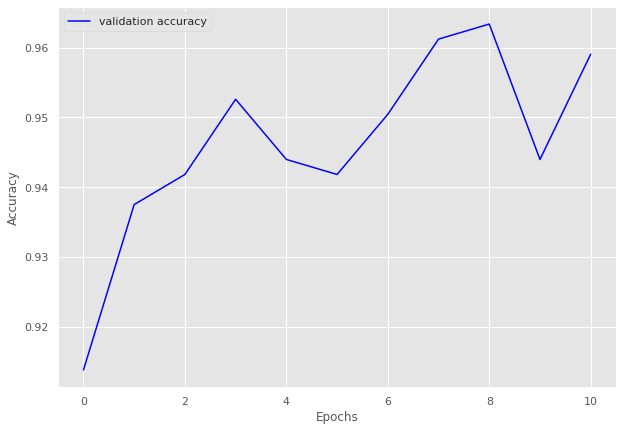

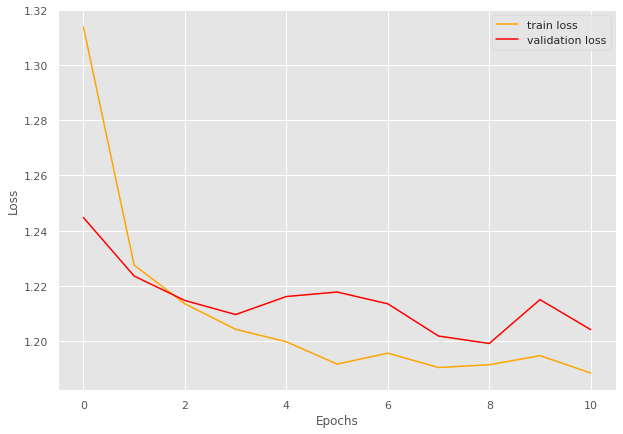

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.92batch/s, loss=0.825]


train loss 0.8253700072350709, validation loss 0.7597620487213135, validation accuracy 0.9834710743801653
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.92batch/s, loss=0.768]


train loss 0.7684620897407117, validation loss 0.7566726903120676, validation accuracy 0.9862258953168044
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.91batch/s, loss=0.762]


train loss 0.762401181070701, validation loss 0.7558790842692057, validation accuracy 0.9862258953168044
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.91batch/s, loss=0.759]


INFO: Early stopping counter 1 of 5
train loss 0.7594739159812098, validation loss 0.7586638430754343, validation accuracy 0.9862258953168044
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.92batch/s, loss=0.757]


train loss 0.7566043604975161, validation loss 0.7504711548487345, validation accuracy 0.9944903581267218
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.91batch/s, loss=0.754]


INFO: Early stopping counter 2 of 5
train loss 0.7540106650279916, validation loss 0.7513865530490875, validation accuracy 0.9944903581267218
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.92batch/s, loss=0.753]


INFO: Early stopping counter 3 of 5
train loss 0.75252551747405, validation loss 0.7527632315953573, validation accuracy 0.9917355371900827
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.92batch/s, loss=0.75] 


train loss 0.7496806894955428, validation loss 0.7498402098814646, validation accuracy 0.9944903581267218
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.91batch/s, loss=0.749]


INFO: Early stopping counter 4 of 5
train loss 0.7487035691738129, validation loss 0.7555488844712576, validation accuracy 0.9889807162534435
Coarse label 7 Epoch 10
-------------------------------


100%|██████████| 92/92 [00:31<00:00,  2.92batch/s, loss=0.751]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9808743169398907 and loss 0.7657583124107785


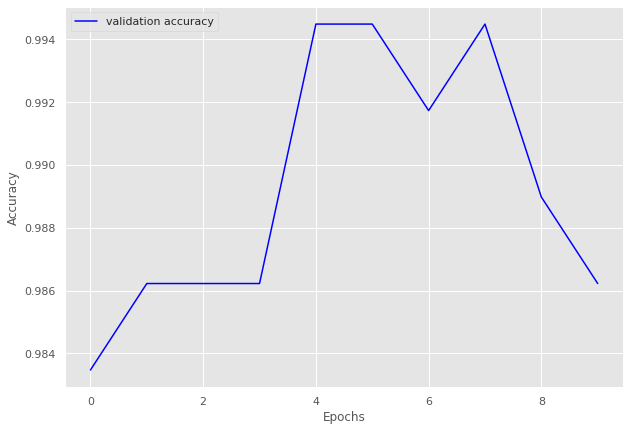

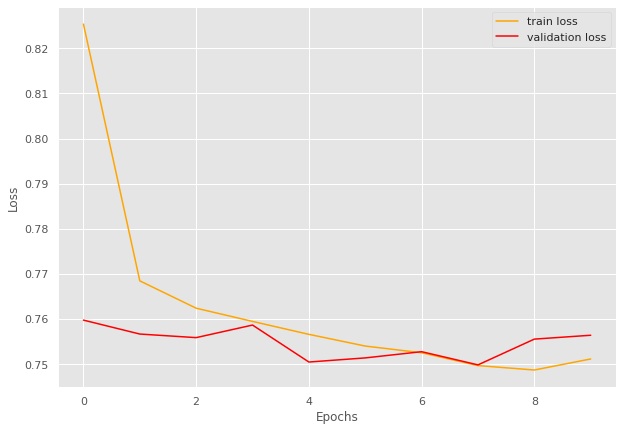

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.91batch/s, loss=1.34]


train loss 1.337393655333408, validation loss 1.2282756716012955, validation accuracy 0.9354207436399217
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 129/129 [00:49<00:00,  2.63batch/s, loss=1.23]


train loss 1.2277839590412702, validation loss 1.2146468460559845, validation accuracy 0.9471624266144814
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.92batch/s, loss=1.22]


train loss 1.2166726718577303, validation loss 1.2048408091068268, validation accuracy 0.9647749510763209
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.89batch/s, loss=1.21]


INFO: Early stopping counter 1 of 5
train loss 1.2086881491564965, validation loss 1.206465870141983, validation accuracy 0.958904109589041
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 129/129 [00:59<00:00,  2.15batch/s, loss=1.2]


INFO: Early stopping counter 2 of 5
train loss 1.1998413246731425, validation loss 1.2069984078407288, validation accuracy 0.9608610567514677
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 129/129 [01:33<00:00,  1.39batch/s, loss=1.2]


INFO: Early stopping counter 3 of 5
train loss 1.1986302128133848, validation loss 1.2182434052228928, validation accuracy 0.9471624266144814
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 129/129 [01:28<00:00,  1.46batch/s, loss=1.2]


train loss 1.2004547248515047, validation loss 1.2046858072280884, validation accuracy 0.9628180039138943
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.88batch/s, loss=1.2]


train loss 1.1951790160911029, validation loss 1.1918242871761322, validation accuracy 0.9765166340508806
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.92batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1928080625312274, validation loss 1.2057289332151413, validation accuracy 0.958904109589041
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 129/129 [00:44<00:00,  2.89batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9559300064808814 and loss 1.207761025428772


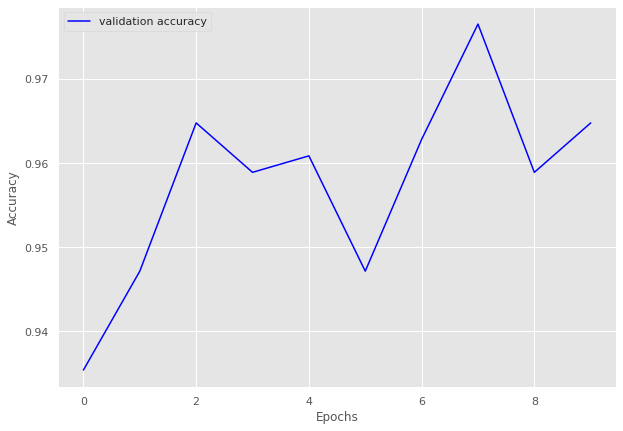

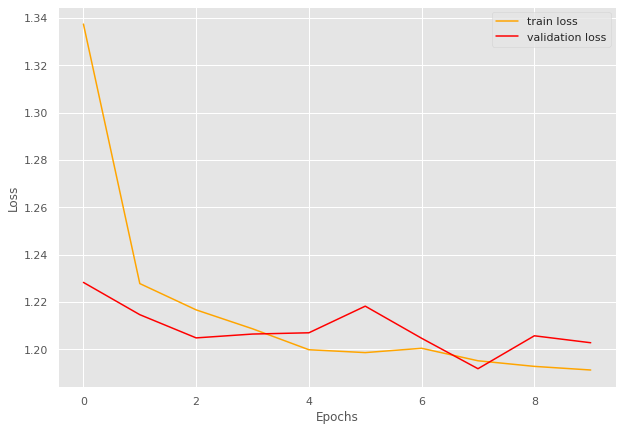

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.91batch/s, loss=1.62]


train loss 1.6158889159103114, validation loss 1.5457567193291404, validation accuracy 0.9320987654320988
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.90batch/s, loss=1.52]


train loss 1.5216967247746473, validation loss 1.532626672224565, validation accuracy 0.9459876543209876
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.91batch/s, loss=1.51]


train loss 1.5068523342624032, validation loss 1.5186045603318648, validation accuracy 0.9537037037037037
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.89batch/s, loss=1.5]


train loss 1.4972439046286365, validation loss 1.5172127160159024, validation accuracy 0.9475308641975309
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.90batch/s, loss=1.49]


train loss 1.4919611924996405, validation loss 1.5049768903038718, validation accuracy 0.9598765432098766
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.91batch/s, loss=1.49]


train loss 1.4883111386211372, validation loss 1.5044910257512873, validation accuracy 0.9645061728395061
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.89batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.487206242567191, validation loss 1.5060747103257612, validation accuracy 0.9614197530864198
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.89batch/s, loss=1.48]


INFO: Early stopping counter 2 of 5
train loss 1.4799539845413956, validation loss 1.5090240456841209, validation accuracy 0.9583333333333334
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.90batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.480170149744654, validation loss 1.518527789549394, validation accuracy 0.9567901234567902
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.89batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4806753243405395, validation loss 1.5186295400966296, validation accuracy 0.9567901234567902
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 163/163 [00:56<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9723926380368099 and loss 1.4924202272968907


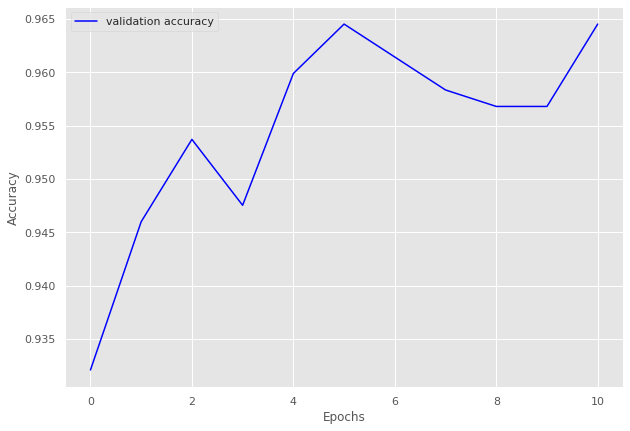

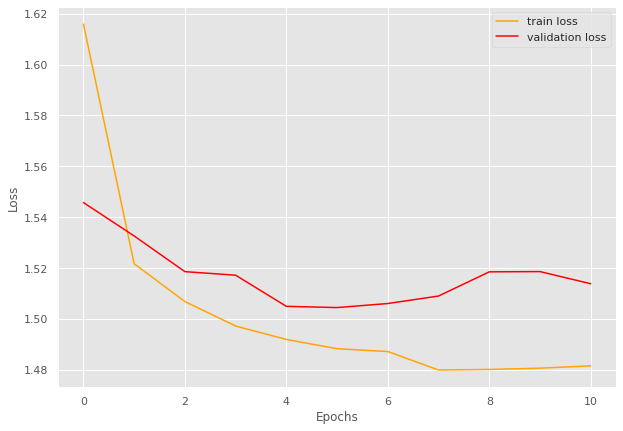

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9723926380368099
Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.93batch/s, loss=0.831]


train loss 0.83130609834349, validation loss 0.767492163181305, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.93batch/s, loss=0.765]


train loss 0.7648664465198269, validation loss 0.7614108562469483, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.93batch/s, loss=0.757]


train loss 0.7565757547106061, validation loss 0.7597454786300659, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.92batch/s, loss=0.756]


INFO: Early stopping counter 1 of 5
train loss 0.7558209772233839, validation loss 0.7624602079391479, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.88batch/s, loss=0.756]


train loss 0.7557830338354234, validation loss 0.7594388127326965, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 77/77 [00:49<00:00,  1.56batch/s, loss=0.758]


INFO: Early stopping counter 2 of 5
train loss 0.7581901287103628, validation loss 0.7707641363143921, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 77/77 [00:57<00:00,  1.33batch/s, loss=0.754]


INFO: Early stopping counter 3 of 5
train loss 0.7542518903682758, validation loss 0.7600583791732788, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 77/77 [00:57<00:00,  1.34batch/s, loss=0.753]


train loss 0.7527762674666071, validation loss 0.7586995482444763, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 77/77 [00:45<00:00,  1.69batch/s, loss=0.752]


INFO: Early stopping counter 4 of 5
train loss 0.7522410022747981, validation loss 0.7603150486946106, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 10
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.93batch/s, loss=0.751]


train loss 0.7509223052433559, validation loss 0.7572879076004029, validation accuracy 0.9868421052631579
Coarse label 11 Epoch 11
-------------------------------


100%|██████████| 77/77 [00:26<00:00,  2.93batch/s, loss=0.749]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9837133550488599 and loss 0.7613888859748841


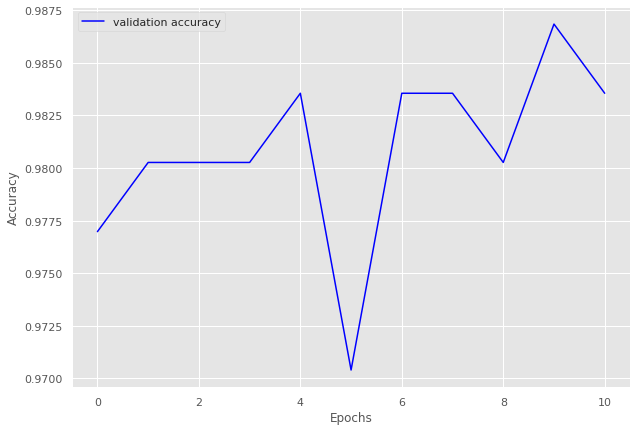

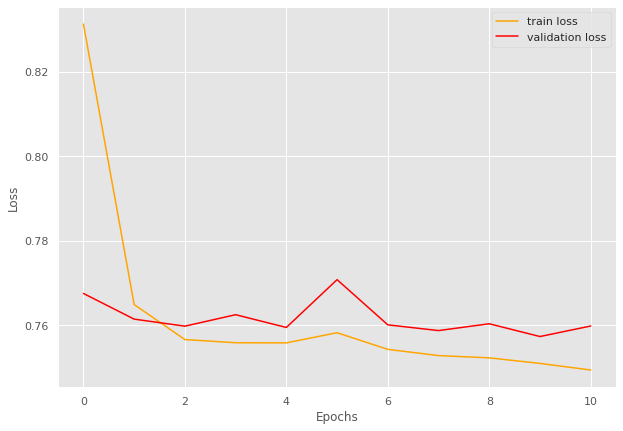

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.90batch/s, loss=1.24]


train loss 1.2398758288976308, validation loss 1.112596344947815, validation accuracy 0.9310344827586207
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.96batch/s, loss=1.12]


INFO: Early stopping counter 1 of 5
train loss 1.1174180620425456, validation loss 1.1240664720535278, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 74/74 [00:24<00:00,  2.97batch/s, loss=1.1] 


INFO: Early stopping counter 2 of 5
train loss 1.100826854641373, validation loss 1.1215795755386353, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.93batch/s, loss=1.09]


INFO: Early stopping counter 3 of 5
train loss 1.093831199246484, validation loss 1.1350277185440063, validation accuracy 0.903448275862069
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.96batch/s, loss=1.09]


train loss 1.0871559719781618, validation loss 1.1036318778991698, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.96batch/s, loss=1.09]


INFO: Early stopping counter 4 of 5
train loss 1.0861545881709538, validation loss 1.114957857131958, validation accuracy 0.9344827586206896
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 74/74 [00:24<00:00,  2.99batch/s, loss=1.08]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9375709421112373 and loss 1.1031986900738306


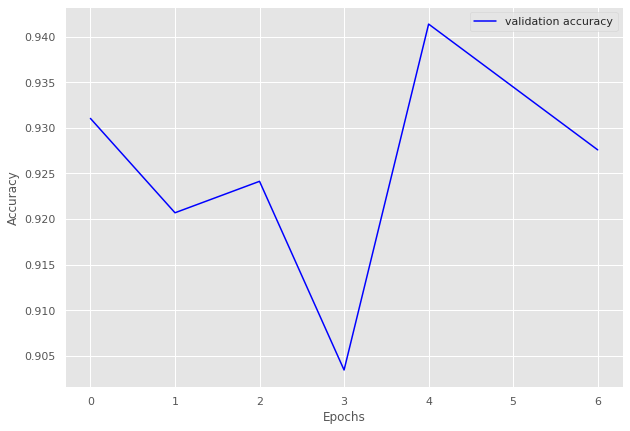

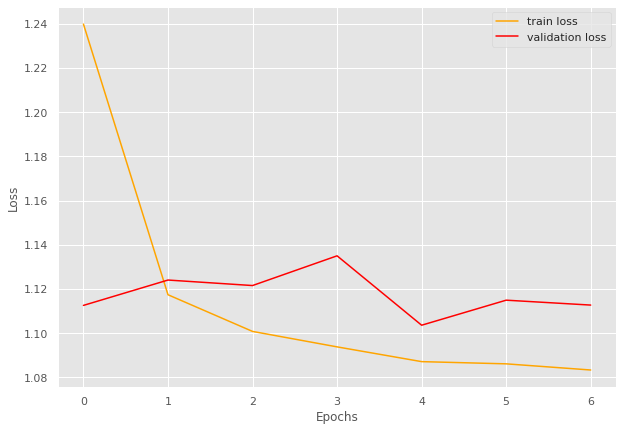

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 65/65 [00:23<00:00,  2.82batch/s, loss=0.662]


train loss 0.6617813284580524, validation loss 0.6042928457260132, validation accuracy 0.9343629343629344
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.93batch/s, loss=0.598]


train loss 0.5980950162960933, validation loss 0.602390444278717, validation accuracy 0.9343629343629344
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.93batch/s, loss=0.583]


train loss 0.5831521116770231, validation loss 0.5915721297264099, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=0.581]


train loss 0.5810113200774559, validation loss 0.5910586476325989, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.94batch/s, loss=0.577]


INFO: Early stopping counter 1 of 5
train loss 0.5766233765161954, validation loss 0.5966102838516235, validation accuracy 0.9420849420849421
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.91batch/s, loss=0.571]


train loss 0.5705225770290081, validation loss 0.5766480684280395, validation accuracy 0.9652509652509652
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.91batch/s, loss=0.572]


INFO: Early stopping counter 2 of 5
train loss 0.5716259562052213, validation loss 0.5904900550842285, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=0.569]


INFO: Early stopping counter 3 of 5
train loss 0.5689858794212341, validation loss 0.5969277024269104, validation accuracy 0.9459459459459459
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 65/65 [00:25<00:00,  2.55batch/s, loss=0.566]


train loss 0.5658241886358994, validation loss 0.5740855574607849, validation accuracy 0.972972972972973
Coarse label 13 Epoch 10
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.88batch/s, loss=0.563]


train loss 0.5634940651746897, validation loss 0.5732148051261902, validation accuracy 0.9768339768339769
Coarse label 13 Epoch 11
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.90batch/s, loss=0.564]


INFO: Early stopping counter 4 of 5
train loss 0.5643774289351243, validation loss 0.5927251696586608, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 12
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=0.564]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.970550576184379 and loss 0.5787296295166016


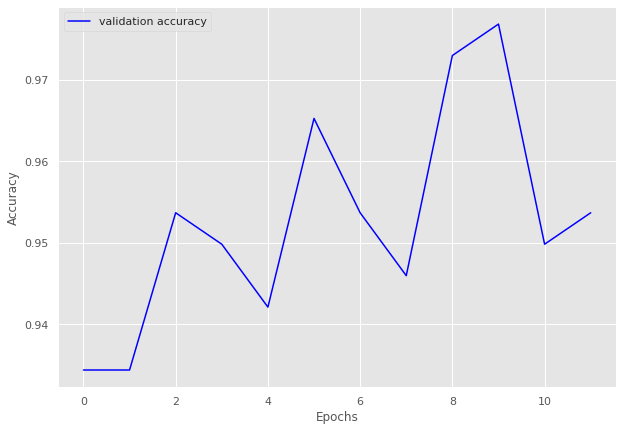

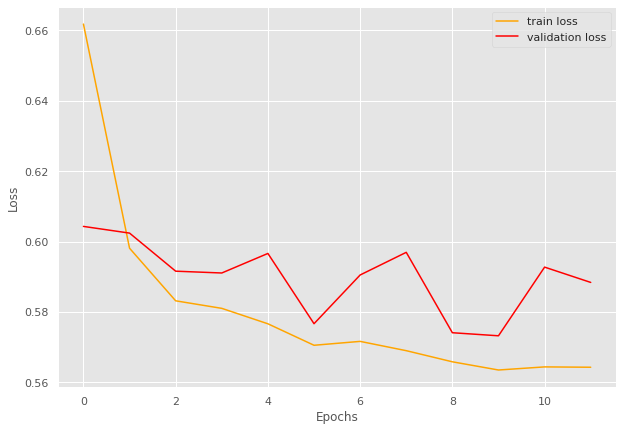

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 150/150 [00:55<00:00,  2.70batch/s, loss=1.15]


train loss 1.1457342672348023, validation loss 1.0871469974517822, validation accuracy 0.9545454545454546
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.93batch/s, loss=1.09]


INFO: Early stopping counter 1 of 5
train loss 1.0862116320927937, validation loss 1.088775634765625, validation accuracy 0.9528619528619529
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.92batch/s, loss=1.08]


train loss 1.0770712939898173, validation loss 1.0729241251945496, validation accuracy 0.968013468013468
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.93batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0726793416341145, validation loss 1.080341911315918, validation accuracy 0.9612794612794613
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.94batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0673311122258504, validation loss 1.075995683670044, validation accuracy 0.9646464646464646
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.93batch/s, loss=1.06]


train loss 1.0635950899124145, validation loss 1.0725555300712586, validation accuracy 0.968013468013468
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.93batch/s, loss=1.06]


train loss 1.0595193028450012, validation loss 1.065809464454651, validation accuracy 0.9764309764309764
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.93batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0598243395487468, validation loss 1.0773993492126466, validation accuracy 0.9646464646464646
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 150/150 [00:51<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.984941438929169 and loss 1.0590788167098473


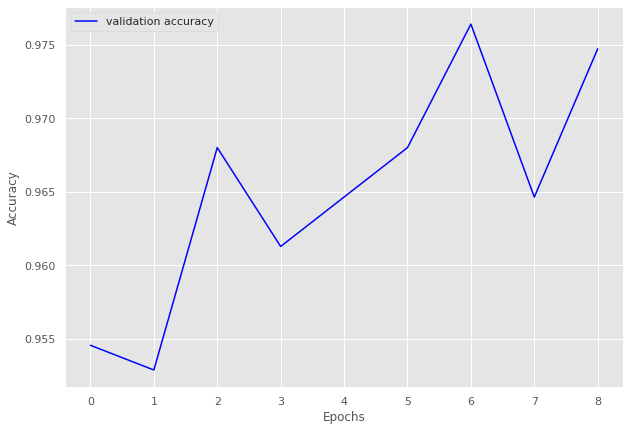

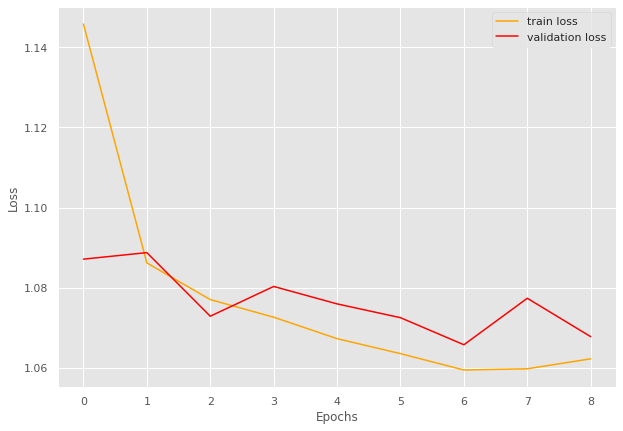

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.92batch/s, loss=0.861]


train loss 0.8608612353737289, validation loss 0.7800041913986206, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.95batch/s, loss=0.773]


train loss 0.7732996868120657, validation loss 0.7637688994407654, validation accuracy 0.9761904761904762
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.92batch/s, loss=0.764]


train loss 0.7635115465602359, validation loss 0.7570307135581971, validation accuracy 0.9863945578231292
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.89batch/s, loss=0.76] 


train loss 0.7603901616624884, validation loss 0.7548274159431457, validation accuracy 0.9897959183673469
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.85batch/s, loss=0.757]


INFO: Early stopping counter 1 of 5
train loss 0.7569439757514644, validation loss 0.7568060398101807, validation accuracy 0.9829931972789115
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.92batch/s, loss=0.752]


INFO: Early stopping counter 2 of 5
train loss 0.7519269778921798, validation loss 0.759717607498169, validation accuracy 0.9829931972789115
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.92batch/s, loss=0.754]


INFO: Early stopping counter 3 of 5
train loss 0.7535485923290253, validation loss 0.7647886395454406, validation accuracy 0.9761904761904762
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.92batch/s, loss=0.754]


INFO: Early stopping counter 4 of 5
train loss 0.7544573505182524, validation loss 0.7566182613372803, validation accuracy 0.9863945578231292
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.91batch/s, loss=0.752]


train loss 0.7519217350998441, validation loss 0.749616515636444, validation accuracy 0.9965986394557823
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 74/74 [00:25<00:00,  2.92batch/s, loss=0.749]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9796839729119639 and loss 0.7645942909376962


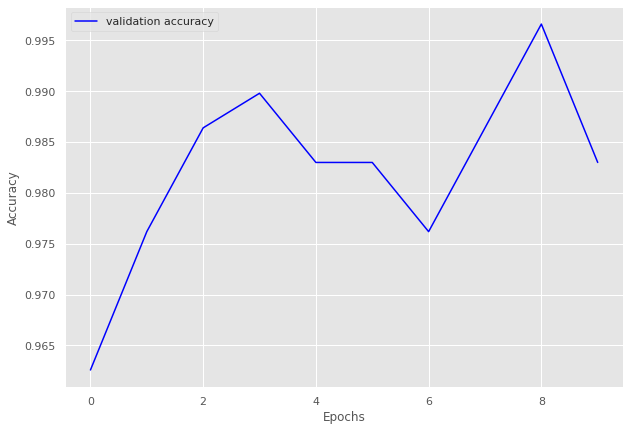

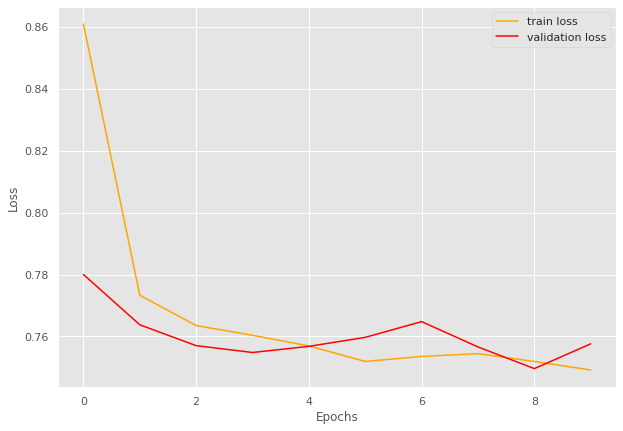

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.94batch/s, loss=0.647]


train loss 0.6465170282713124, validation loss 0.5941945552825928, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.93batch/s, loss=0.581]


train loss 0.5814329142301855, validation loss 0.5894392609596253, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.94batch/s, loss=0.569]


train loss 0.568805454482495, validation loss 0.5694271087646484, validation accuracy 0.9822695035460993
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.95batch/s, loss=0.566]


train loss 0.5662946205743602, validation loss 0.5667884588241577, validation accuracy 0.9858156028368794
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.95batch/s, loss=0.565]


INFO: Early stopping counter 1 of 5
train loss 0.5651202579619179, validation loss 0.5839550495147705, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.95batch/s, loss=0.563]


INFO: Early stopping counter 2 of 5
train loss 0.5627277241626256, validation loss 0.5792081236839295, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.94batch/s, loss=0.562]


INFO: Early stopping counter 3 of 5
train loss 0.5615242686070187, validation loss 0.5837018251419067, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 71/71 [00:23<00:00,  2.96batch/s, loss=0.564]


INFO: Early stopping counter 4 of 5
train loss 0.5639171373676246, validation loss 0.5922633409500122, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 71/71 [00:24<00:00,  2.96batch/s, loss=0.561]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9823529411764705 and loss 0.5705695876053402


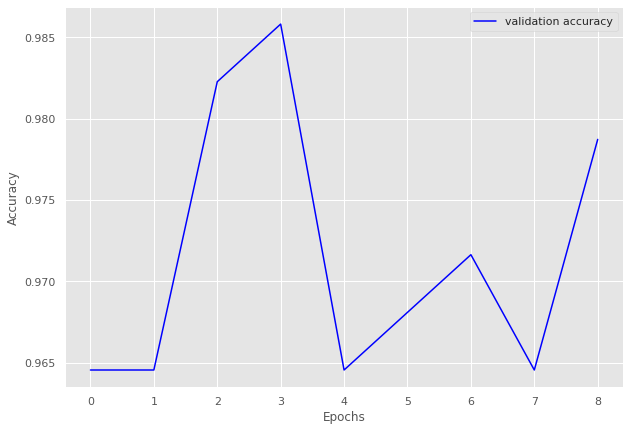

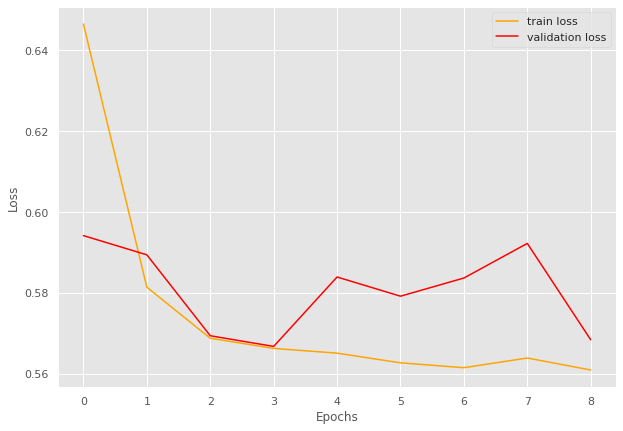

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 17 Epoch 1
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.92batch/s, loss=0.885]


train loss 0.8849411469239455, validation loss 0.7881235837936401, validation accuracy 0.9514563106796117
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.91batch/s, loss=0.785]


train loss 0.7854368709600889, validation loss 0.7767410397529602, validation accuracy 0.9644012944983819
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.93batch/s, loss=0.78] 


train loss 0.7804695107997992, validation loss 0.7640004277229309, validation accuracy 0.9805825242718447
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.92batch/s, loss=0.775]


INFO: Early stopping counter 1 of 5
train loss 0.7750008954451635, validation loss 0.7764911413192749, validation accuracy 0.9644012944983819
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.93batch/s, loss=0.769]


INFO: Early stopping counter 2 of 5
train loss 0.7687097359926273, validation loss 0.773680818080902, validation accuracy 0.9676375404530745
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.93batch/s, loss=0.764]


INFO: Early stopping counter 3 of 5
train loss 0.7635426819324493, validation loss 0.7750996947288513, validation accuracy 0.9644012944983819
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.94batch/s, loss=0.765]


INFO: Early stopping counter 4 of 5
train loss 0.7648955484231313, validation loss 0.7657313227653504, validation accuracy 0.9773462783171522
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.93batch/s, loss=0.761]


train loss 0.7609799198615246, validation loss 0.7624506831169129, validation accuracy 0.9805825242718447
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 78/78 [00:26<00:00,  2.90batch/s, loss=0.757]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.971030042918455 and loss 0.7738119443257649


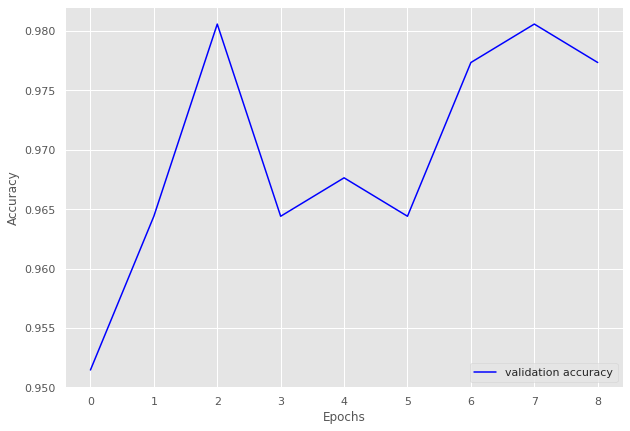

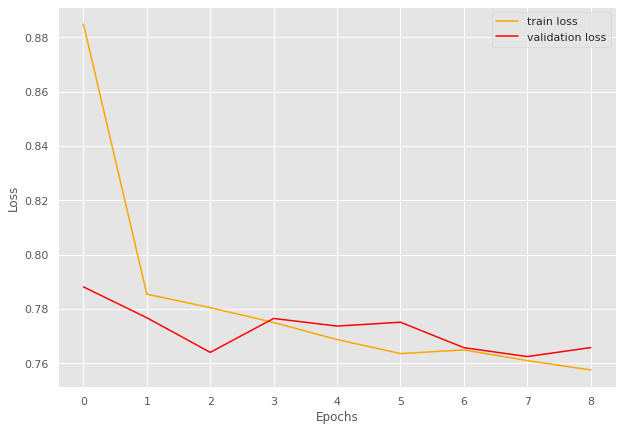

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 19 Epoch 1
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.95batch/s, loss=0.985]


train loss 0.9848277401924134, validation loss 0.8157167136669159, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.95batch/s, loss=0.773]


train loss 0.7726907753944396, validation loss 0.7762885689735413, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.98batch/s, loss=0.762]


train loss 0.7622173953056336, validation loss 0.7666244506835938, validation accuracy 0.96875
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.87batch/s, loss=0.756]


INFO: Early stopping counter 1 of 5
train loss 0.7560673236846924, validation loss 0.7784877419471741, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.99batch/s, loss=0.758]


train loss 0.7581774806976318, validation loss 0.7624324560165405, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.93batch/s, loss=0.761]


INFO: Early stopping counter 2 of 5
train loss 0.7613954997062683, validation loss 0.7659576833248138, validation accuracy 0.96875
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.93batch/s, loss=0.751]


train loss 0.7514727115631104, validation loss 0.7602507174015045, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.99batch/s, loss=0.751]


INFO: Early stopping counter 3 of 5
train loss 0.7506999707221985, validation loss 0.7640491425991058, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.97batch/s, loss=0.752]


train loss 0.7517903661727905, validation loss 0.7544579803943634, validation accuracy 0.9895833333333334
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.98batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.7513503670692444, validation loss 0.7613428235054016, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.99batch/s, loss=0.749]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9932432432432432 and loss 0.7520596861839295


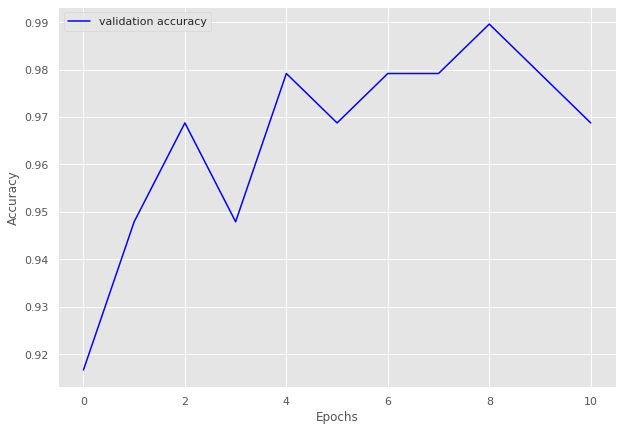

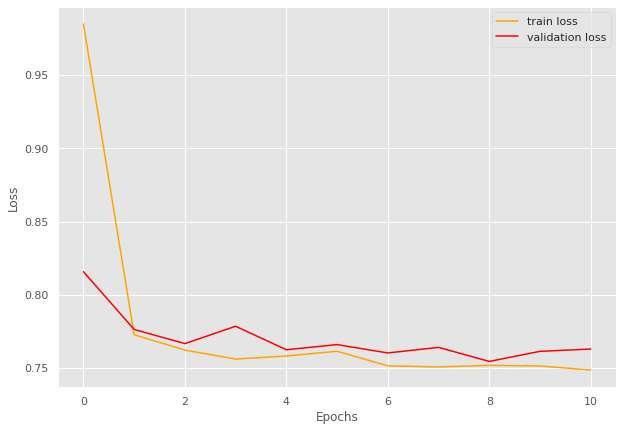

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Evaluating fine model 0
Evaluating fine model 1
Evaluating fine model 2
Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16
Evaluating fine model 17
Evaluating fine model 19
overall accuracy  is 0.8344865078580607
{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.93423053527980

Starting run 6
defaultdict(<class 'list'>, {10: [0], 15: [1, 38, 54, 62], 12: [2, 7, 12, 45, 49, 91], 17: [3, 25, 66, 83], 5: [4, 77], 8: [5, 60, 70, 73, 75, 78, 82], 1: [6, 53, 56, 58, 79, 80], 11: [8, 31, 51, 61], 0: [9, 17, 26, 55, 69], 7: [10, 23, 39, 67], 9: [11, 18, 34, 46, 57, 63, 68, 76, 92, 93], 2: [13, 19, 20, 36, 41, 42, 47, 48, 71, 88], 6: [14, 15, 22, 32, 35, 43, 52], 4: [16, 21, 24, 30, 64, 72], 13: [27, 29, 81], 14: [28, 33, 37, 44, 89, 90], 16: [40, 59, 87], 18: [50], 19: [65, 74, 84, 85], 3: [86]})
Calculating for volume 15
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.03batch/s, loss=1.36]


train loss 1.3632172686713082, validation loss 1.1151665619441442, validation accuracy 0.8251748251748252
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.00batch/s, loss=1.01]


train loss 1.008099798645292, validation loss 0.998600925718035, validation accuracy 0.9137529137529138
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.98batch/s, loss=0.942]


train loss 0.9423748297350747, validation loss 0.9852252091680255, validation accuracy 0.9207459207459208
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.03batch/s, loss=0.932]


train loss 0.9315453810351235, validation loss 0.9840952328273228, validation accuracy 0.9184149184149184
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.04batch/s, loss=0.928]


train loss 0.9276384838989803, validation loss 0.9820087637220111, validation accuracy 0.9254079254079254
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.98batch/s, loss=0.921]


train loss 0.9208982288837433, validation loss 0.9763040798051017, validation accuracy 0.9324009324009324
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.04batch/s, loss=0.924]


train loss 0.9237170347145626, validation loss 0.9672900608607701, validation accuracy 0.9393939393939394
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.04batch/s, loss=0.918]


INFO: Early stopping counter 1 of 5
train loss 0.918311072247369, validation loss 0.9751859051840646, validation accuracy 0.9370629370629371
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  2.94batch/s, loss=0.918]


INFO: Early stopping counter 2 of 5
train loss 0.9177563871656146, validation loss 0.9756455506597247, validation accuracy 0.9324009324009324
Coarse label 0 Epoch 10
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.01batch/s, loss=0.917]


INFO: Early stopping counter 3 of 5
train loss 0.9165231202329908, validation loss 0.9791950583457947, validation accuracy 0.9277389277389277
Coarse label 0 Epoch 11
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.02batch/s, loss=0.923]


INFO: Early stopping counter 4 of 5
train loss 0.9232007477964673, validation loss 0.9798140866415841, validation accuracy 0.9300699300699301
Coarse label 0 Epoch 12
-------------------------------


100%|██████████| 14/14 [00:04<00:00,  3.01batch/s, loss=0.923]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9265206150496667 and loss 0.9799972052159517


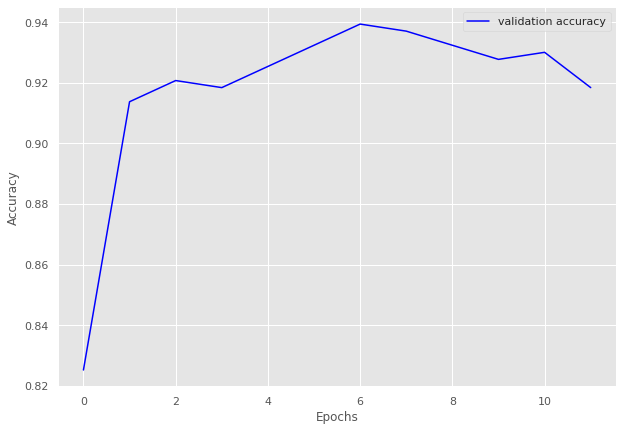

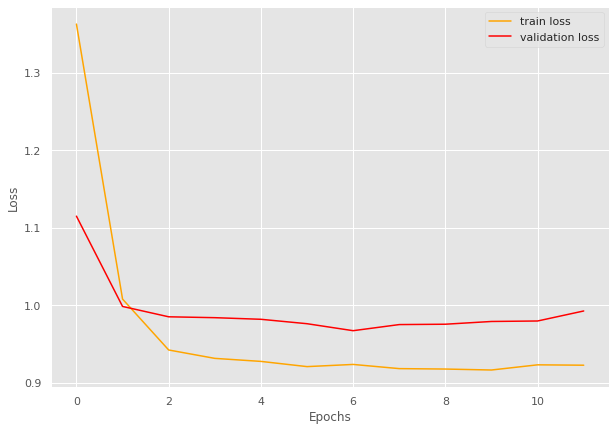

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 1 Epoch 1
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.75batch/s, loss=1.64]


train loss 1.6403289834658306, validation loss 1.4554496208826702, validation accuracy 0.7204301075268817
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.24]


train loss 1.2367023229599, validation loss 1.2218196392059326, validation accuracy 0.8602150537634409
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  3.00batch/s, loss=1.11]


train loss 1.1106969118118286, validation loss 1.1684234142303467, validation accuracy 0.8763440860215054
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.97batch/s, loss=1.07]


train loss 1.0745849013328552, validation loss 1.1552003224690754, validation accuracy 0.8817204301075269
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.98batch/s, loss=1.06]


train loss 1.0597084363301594, validation loss 1.1418992678324382, validation accuracy 0.9032258064516129
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.98batch/s, loss=1.05]


train loss 1.0534106691678364, validation loss 1.1367441018422444, validation accuracy 0.8978494623655914
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.05]


train loss 1.0463349024454753, validation loss 1.1359966198603313, validation accuracy 0.9139784946236559
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.05]


INFO: Early stopping counter 1 of 5
train loss 1.045288364092509, validation loss 1.1376148064931233, validation accuracy 0.9086021505376344
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.97batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.045178512732188, validation loss 1.139779806137085, validation accuracy 0.9032258064516129
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.78batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.045160949230194, validation loss 1.1417347590128581, validation accuracy 0.9032258064516129
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 6/6 [00:01<00:00,  3.00batch/s, loss=1.04]


INFO: Early stopping counter 4 of 5
train loss 1.0444681445757549, validation loss 1.1413387457529705, validation accuracy 0.8978494623655914
Coarse label 1 Epoch 12
-------------------------------


100%|██████████| 6/6 [00:02<00:00,  2.99batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9068458893404189 and loss 1.13840922832489


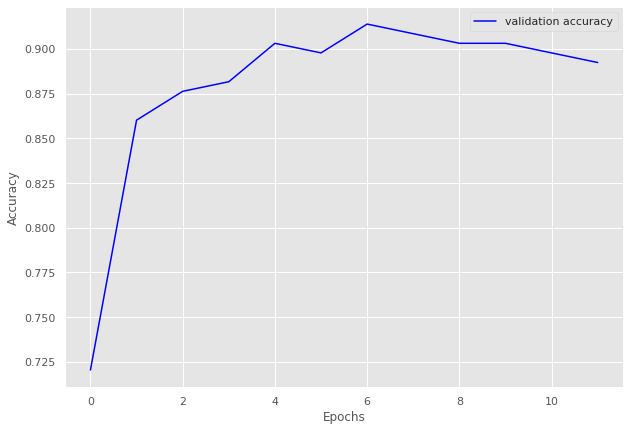

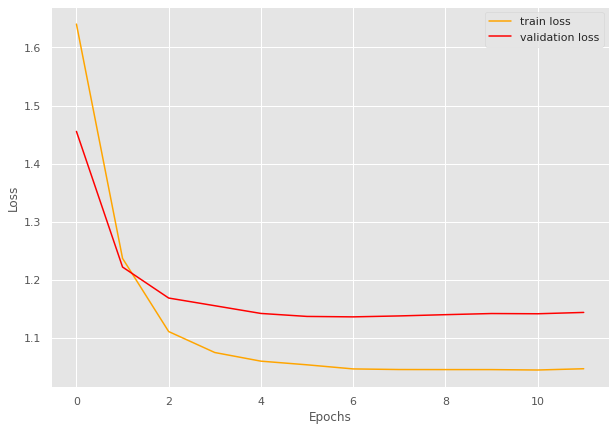

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 2 Epoch 1
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=1.94]


train loss 1.9421668691294534, validation loss 1.7206298964364188, validation accuracy 0.7689655172413793
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.62]


train loss 1.618166242327009, validation loss 1.5752294659614563, validation accuracy 0.8977011494252873
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=1.53]


train loss 1.5318845297609056, validation loss 1.5594838431903295, validation accuracy 0.9149425287356322
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=1.5] 


train loss 1.498511987073081, validation loss 1.5574070385524206, validation accuracy 0.9160919540229885
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=1.5] 


train loss 1.4989395695073264, validation loss 1.5541139926229204, validation accuracy 0.9160919540229885
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.94batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4860499501228333, validation loss 1.5736852032797677, validation accuracy 0.8931034482758621
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=1.48]


train loss 1.4847102846418108, validation loss 1.5494224854878016, validation accuracy 0.9149425287356322
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.00batch/s, loss=1.48]


INFO: Early stopping counter 2 of 5
train loss 1.4804847581045968, validation loss 1.5518085956573486, validation accuracy 0.9137931034482759
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.95batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4776388236454554, validation loss 1.5581596323422022, validation accuracy 0.9103448275862069
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.476094365119934, validation loss 1.5529228278568812, validation accuracy 0.9160919540229885
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.47]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9124572348561079 and loss 1.5509407648201152


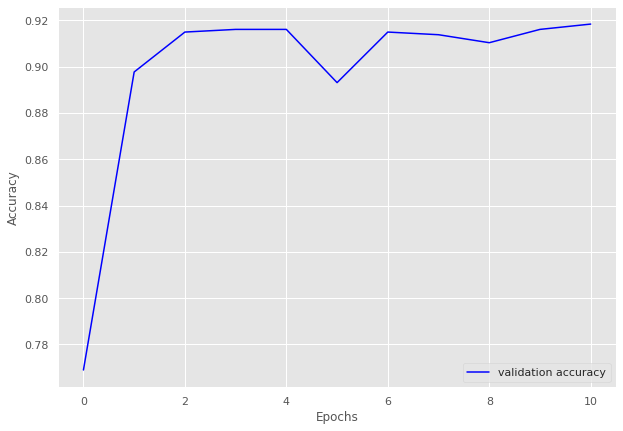

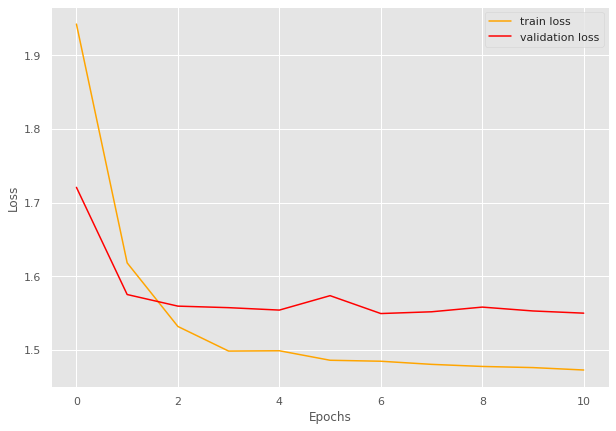

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.97batch/s, loss=1.53]


train loss 1.531245965224046, validation loss 1.3645336287362235, validation accuracy 0.7427184466019418
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.93batch/s, loss=1.2]


train loss 1.198293456664452, validation loss 1.1976149422781808, validation accuracy 0.8519417475728155
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.86batch/s, loss=1.12]


train loss 1.1198782645739043, validation loss 1.156481317111424, validation accuracy 0.9004854368932039
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.96batch/s, loss=1.08]


train loss 1.0824449062347412, validation loss 1.144620384488787, validation accuracy 0.9077669902912622
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.98batch/s, loss=1.07]


train loss 1.0658404735418467, validation loss 1.1420605182647705, validation accuracy 0.912621359223301
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.97batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.059074511894813, validation loss 1.14423782484872, validation accuracy 0.9101941747572816
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0585753184098463, validation loss 1.1436394963945662, validation accuracy 0.9053398058252428
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.88batch/s, loss=1.05]


train loss 1.053919086089501, validation loss 1.1383872372763497, validation accuracy 0.9174757281553398
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.98batch/s, loss=1.05]


train loss 1.05156449171213, validation loss 1.1366675070353918, validation accuracy 0.9150485436893204
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.94batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0509240168791552, validation loss 1.1389498029436385, validation accuracy 0.9053398058252428
Coarse label 4 Epoch 11
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.94batch/s, loss=1.05]


train loss 1.049315562615028, validation loss 1.1342453275408064, validation accuracy 0.9150485436893204
Coarse label 4 Epoch 12
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.96batch/s, loss=1.05]


train loss 1.0502841014128466, validation loss 1.1331103188650948, validation accuracy 0.9199029126213593
Coarse label 4 Epoch 13
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.94batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0502974803631122, validation loss 1.1386294194630213, validation accuracy 0.9101941747572816
Coarse label 4 Epoch 14
-------------------------------


100%|██████████| 13/13 [00:04<00:00,  2.95batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9049175667993178 and loss 1.1414616964080118


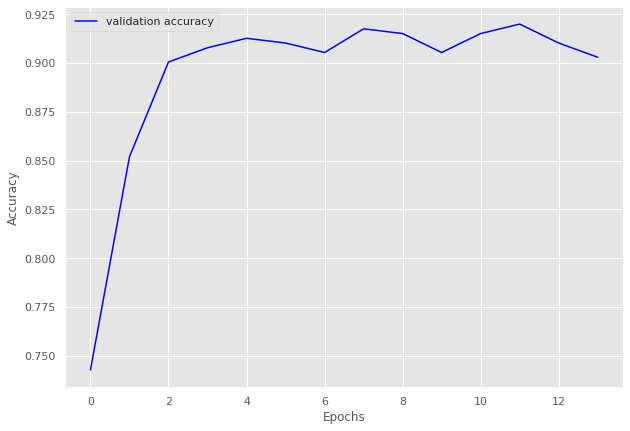

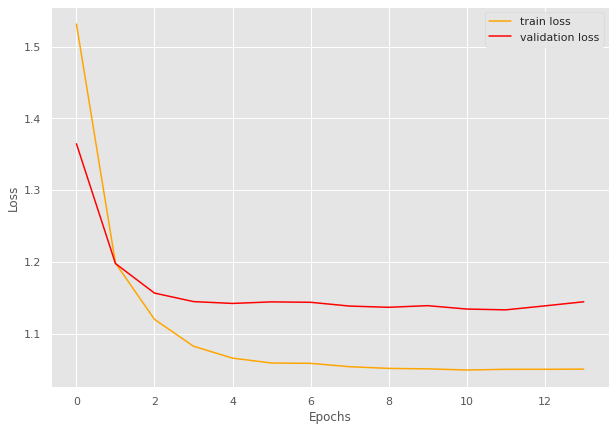

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.91batch/s, loss=0.553]


train loss 0.5527800619602203, validation loss 0.4912635087966919, validation accuracy 0.8490566037735849
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.94batch/s, loss=0.347]


train loss 0.34716315269470216, validation loss 0.37832145889600116, validation accuracy 0.9559748427672956
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.93batch/s, loss=0.32] 


train loss 0.31978009939193724, validation loss 0.35824745893478394, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.92batch/s, loss=0.314]


INFO: Early stopping counter 1 of 5
train loss 0.3142331063747406, validation loss 0.36101189255714417, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.96batch/s, loss=0.314]


INFO: Early stopping counter 2 of 5
train loss 0.31358840465545657, validation loss 0.3677857716878255, validation accuracy 0.949685534591195
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.89batch/s, loss=0.314]


INFO: Early stopping counter 3 of 5
train loss 0.31350303292274473, validation loss 0.37098632256189984, validation accuracy 0.949685534591195
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.88batch/s, loss=0.314]


INFO: Early stopping counter 4 of 5
train loss 0.3135995864868164, validation loss 0.37484751145044964, validation accuracy 0.9433962264150944
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 5/5 [00:01<00:00,  2.81batch/s, loss=0.313]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9462444771723122 and loss 0.3642655451630437


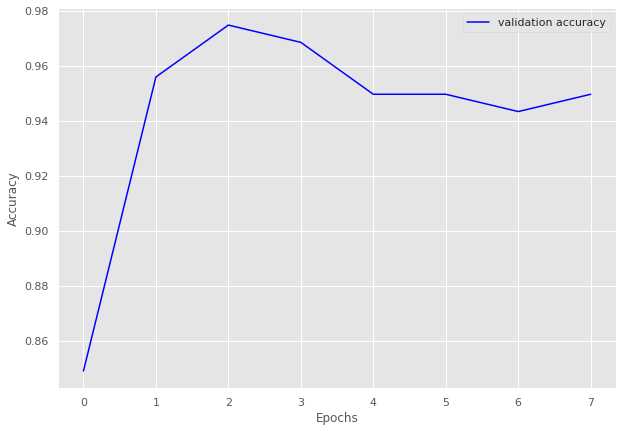

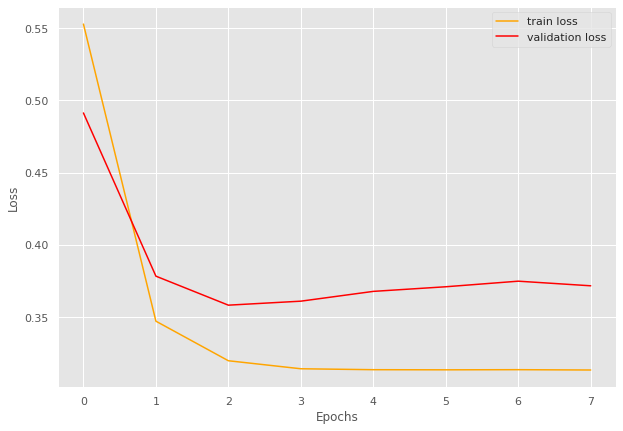

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  3.00batch/s, loss=1.61]


train loss 1.6120360612869262, validation loss 1.3199124038219452, validation accuracy 0.8599137931034483
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.03batch/s, loss=1.29]


train loss 1.2865671157836913, validation loss 1.2622765898704529, validation accuracy 0.9137931034482759
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.01batch/s, loss=1.23]


train loss 1.2290502309799194, validation loss 1.2523836195468903, validation accuracy 0.9181034482758621
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.02batch/s, loss=1.21]


train loss 1.2115827639897665, validation loss 1.238385334610939, validation accuracy 0.9288793103448276
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.96batch/s, loss=1.19]


train loss 1.1942397673924765, validation loss 1.2366959601640701, validation accuracy 0.9224137931034483
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.95batch/s, loss=1.19]


INFO: Early stopping counter 1 of 5
train loss 1.1919158935546874, validation loss 1.2368826866149902, validation accuracy 0.9331896551724138
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.02batch/s, loss=1.18]


INFO: Early stopping counter 2 of 5
train loss 1.1829630136489868, validation loss 1.2379762083292007, validation accuracy 0.9310344827586207
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.00batch/s, loss=1.18]


train loss 1.178834088643392, validation loss 1.2278902381658554, validation accuracy 0.9310344827586207
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.94batch/s, loss=1.18]


INFO: Early stopping counter 3 of 5
train loss 1.1795239766438803, validation loss 1.2312136441469193, validation accuracy 0.9310344827586207
Coarse label 6 Epoch 10
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  3.00batch/s, loss=1.18]


INFO: Early stopping counter 4 of 5
train loss 1.1769006808598836, validation loss 1.2410325855016708, validation accuracy 0.9181034482758621
Coarse label 6 Epoch 11
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.94batch/s, loss=1.18]


train loss 1.1830430030822754, validation loss 1.2265844196081161, validation accuracy 0.9375
Coarse label 6 Epoch 12
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.98batch/s, loss=1.18]


train loss 1.177395017941793, validation loss 1.2246918976306915, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 13
-------------------------------


100%|██████████| 15/15 [00:04<00:00,  3.03batch/s, loss=1.18]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9212648022171832 and loss 1.2457466611862182


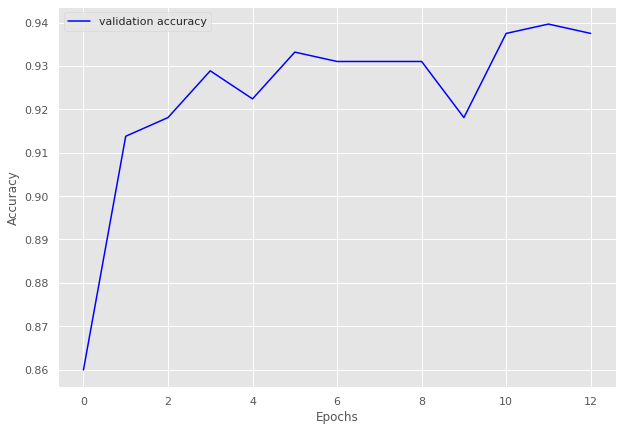

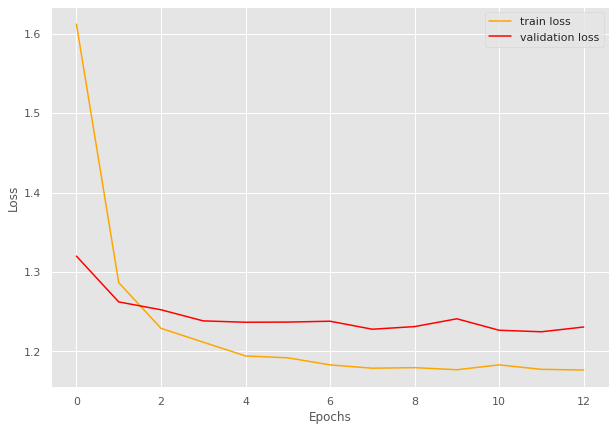

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.03batch/s, loss=1.07]


train loss 1.0655968685944874, validation loss 0.8274557888507843, validation accuracy 0.9338842975206612
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.95batch/s, loss=0.781]


train loss 0.7811023195584615, validation loss 0.7981805602709452, validation accuracy 0.9504132231404959
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.04batch/s, loss=0.752]


train loss 0.7519186089436213, validation loss 0.796913723150889, validation accuracy 0.9476584022038568
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.01batch/s, loss=0.748]


INFO: Early stopping counter 1 of 5
train loss 0.7479274819294611, validation loss 0.7979305783907572, validation accuracy 0.9504132231404959
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.07batch/s, loss=0.751]


train loss 0.7514599959055582, validation loss 0.7933261593182882, validation accuracy 0.953168044077135
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.05batch/s, loss=0.747]


INFO: Early stopping counter 2 of 5
train loss 0.7465754052003225, validation loss 0.7943940659364065, validation accuracy 0.9476584022038568
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.06batch/s, loss=0.753]


INFO: Early stopping counter 3 of 5
train loss 0.7528232932090759, validation loss 0.7935405770937601, validation accuracy 0.953168044077135
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.07batch/s, loss=0.753]


INFO: Early stopping counter 4 of 5
train loss 0.7526150445143381, validation loss 0.8049191832542419, validation accuracy 0.931129476584022
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 12/12 [00:06<00:00,  1.77batch/s, loss=0.753]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.958976833976834 and loss 0.786275183667942


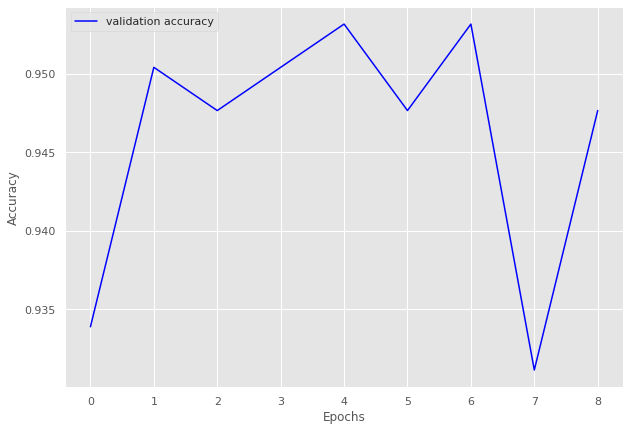

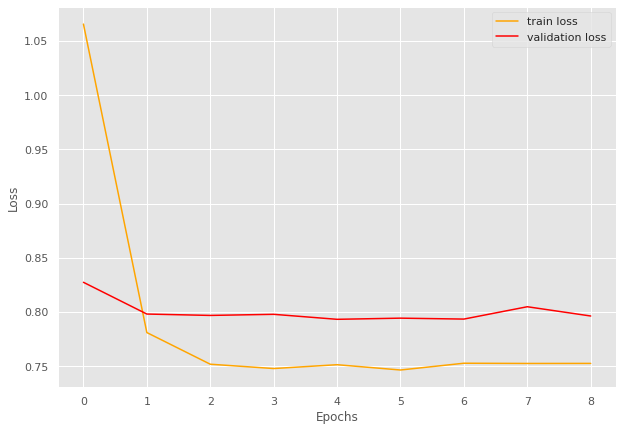

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 17/17 [00:10<00:00,  1.57batch/s, loss=1.69]


train loss 1.6859367034014534, validation loss 1.4302445352077484, validation accuracy 0.7632093933463796
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 17/17 [00:11<00:00,  1.49batch/s, loss=1.35]


train loss 1.3486206180909102, validation loss 1.2943016439676285, validation accuracy 0.8825831702544031
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 17/17 [00:13<00:00,  1.23batch/s, loss=1.25]


train loss 1.253401279449463, validation loss 1.2665814310312271, validation accuracy 0.9041095890410958
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 17/17 [00:09<00:00,  1.81batch/s, loss=1.22]


INFO: Early stopping counter 1 of 5
train loss 1.2221304598976583, validation loss 1.27222241461277, validation accuracy 0.898238747553816
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 17/17 [00:10<00:00,  1.59batch/s, loss=1.24]


INFO: Early stopping counter 2 of 5
train loss 1.2377127058365767, validation loss 1.2770151495933533, validation accuracy 0.8923679060665362
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 17/17 [00:10<00:00,  1.66batch/s, loss=1.23]


INFO: Early stopping counter 3 of 5
train loss 1.2322505081401152, validation loss 1.2678602933883667, validation accuracy 0.9041095890410958
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 17/17 [00:15<00:00,  1.09batch/s, loss=1.23]


train loss 1.2272493348402136, validation loss 1.2663386166095734, validation accuracy 0.9021526418786693
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 17/17 [00:14<00:00,  1.21batch/s, loss=1.23]


train loss 1.228018276831683, validation loss 1.2624770104885101, validation accuracy 0.9119373776908023
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 17/17 [00:12<00:00,  1.37batch/s, loss=1.23]


INFO: Early stopping counter 4 of 5
train loss 1.226957783979528, validation loss 1.263841450214386, validation accuracy 0.9021526418786693
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 17/17 [00:07<00:00,  2.17batch/s, loss=1.22]


train loss 1.2200248031055225, validation loss 1.2586953341960907, validation accuracy 0.913894324853229
Coarse label 8 Epoch 11
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.00batch/s, loss=1.22]


train loss 1.2180290081921745, validation loss 1.2525085508823395, validation accuracy 0.923679060665362
Coarse label 8 Epoch 12
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.01batch/s, loss=1.21]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.8996793403573065 and loss 1.2699857375917643


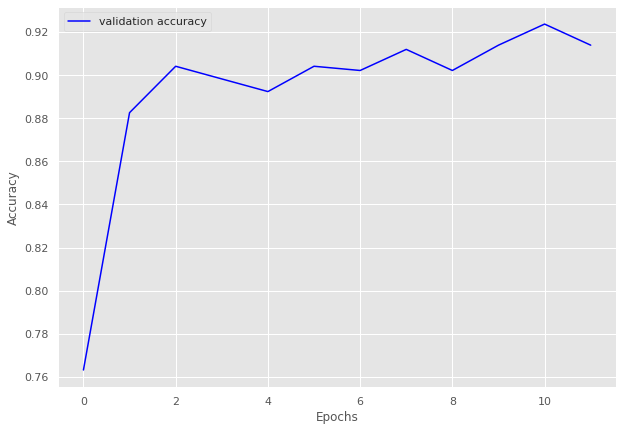

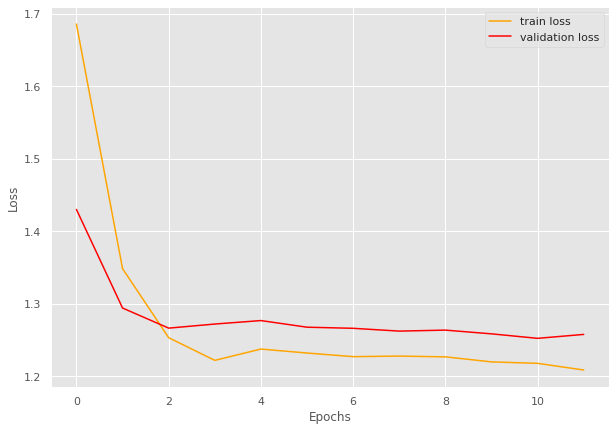

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.98batch/s, loss=1.94]


train loss 1.936906894048055, validation loss 1.7624686414545232, validation accuracy 0.7762345679012346
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.98batch/s, loss=1.63]


train loss 1.6295554297310966, validation loss 1.64252262765711, validation accuracy 0.8256172839506173
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.99batch/s, loss=1.56]


train loss 1.5645382234028407, validation loss 1.585731408812783, validation accuracy 0.8888888888888888
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.95batch/s, loss=1.52]


train loss 1.5186214049657185, validation loss 1.567135594107888, validation accuracy 0.8996913580246914
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.79batch/s, loss=1.5]


train loss 1.5043290456136067, validation loss 1.5591766509142788, validation accuracy 0.9089506172839507
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.95batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4920884200504847, validation loss 1.5608553019436924, validation accuracy 0.9012345679012346
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.79batch/s, loss=1.48]


train loss 1.4787866274515789, validation loss 1.5520178946581753, validation accuracy 0.9166666666666666
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.99batch/s, loss=1.47]


INFO: Early stopping counter 2 of 5
train loss 1.473399275825137, validation loss 1.5577324737202038, validation accuracy 0.9058641975308642
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 21/21 [00:06<00:00,  3.00batch/s, loss=1.47]


INFO: Early stopping counter 3 of 5
train loss 1.471724339893886, validation loss 1.5558685497804121, validation accuracy 0.9151234567901234
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.99batch/s, loss=1.47]


train loss 1.4693673962638492, validation loss 1.5457122651013462, validation accuracy 0.9259259259259259
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.96batch/s, loss=1.47]


INFO: Early stopping counter 4 of 5
train loss 1.4697714419591994, validation loss 1.5483009706843982, validation accuracy 0.9243827160493827
Coarse label 9 Epoch 12
-------------------------------


100%|██████████| 21/21 [00:07<00:00,  2.98batch/s, loss=1.47]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9170586107091172 and loss 1.546978109833822


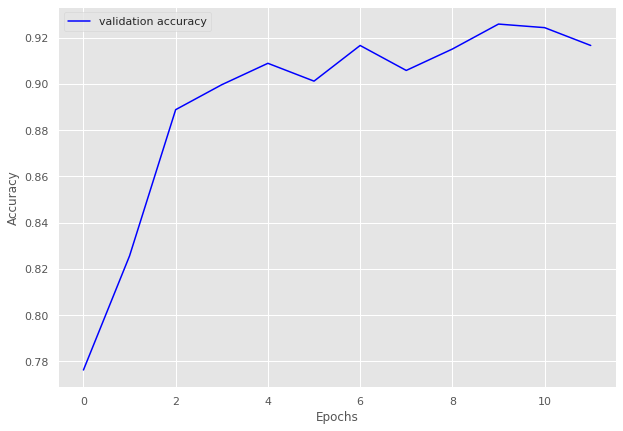

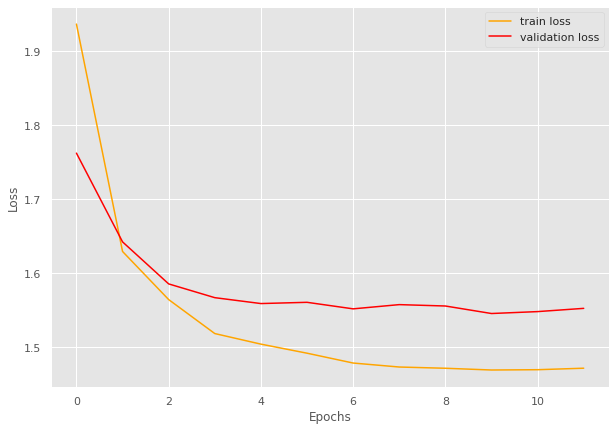

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.06batch/s, loss=1.11]


train loss 1.1101259887218475, validation loss 0.8724541068077087, validation accuracy 0.9013157894736842
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=0.801]


train loss 0.8009726941585541, validation loss 0.7900708913803101, validation accuracy 0.9539473684210527
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.758]


train loss 0.7579476654529571, validation loss 0.782443368434906, validation accuracy 0.9605263157894737
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.03batch/s, loss=0.75]


train loss 0.7497852087020874, validation loss 0.7810192465782165, validation accuracy 0.9605263157894737
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.748]


train loss 0.7478916049003601, validation loss 0.7768855094909668, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.98batch/s, loss=0.748]


train loss 0.7475359261035919, validation loss 0.7737031221389771, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.06batch/s, loss=0.746]


train loss 0.7460583567619323, validation loss 0.7720844864845275, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.01batch/s, loss=0.746]


INFO: Early stopping counter 1 of 5
train loss 0.7463311791419983, validation loss 0.7728630661964416, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=0.747]


INFO: Early stopping counter 2 of 5
train loss 0.7467094779014587, validation loss 0.7753596901893616, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=0.747]


train loss 0.7465516805648804, validation loss 0.7709972023963928, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=0.745]


train loss 0.7454110205173492, validation loss 0.7704794645309448, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 12
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=0.746]


INFO: Early stopping counter 3 of 5
train loss 0.7461214065551758, validation loss 0.7712809443473816, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 13
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.97batch/s, loss=0.746]


INFO: Early stopping counter 4 of 5
train loss 0.7460745692253112, validation loss 0.7759291410446167, validation accuracy 0.9638157894736842
Coarse label 11 Epoch 14
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.747]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9541530788413581 and loss 0.7886543906316524


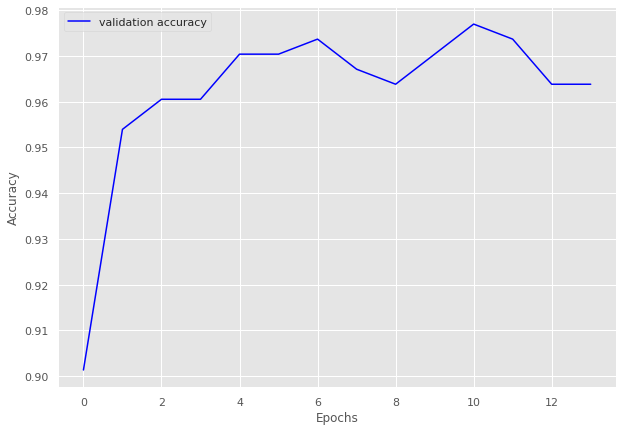

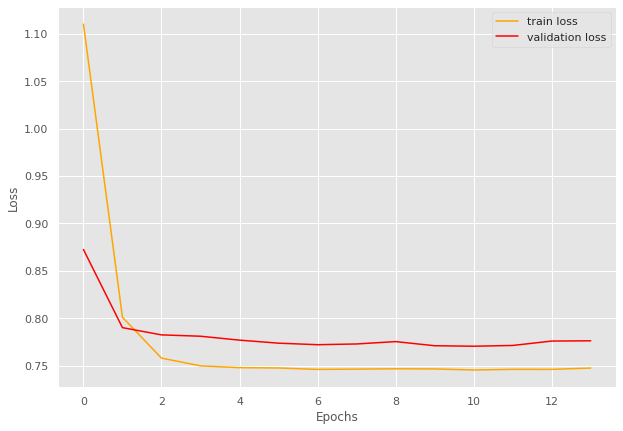

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.04batch/s, loss=1.66]


train loss 1.6642775774002074, validation loss 1.4410737991333007, validation accuracy 0.7068965517241379
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.90batch/s, loss=1.29]


train loss 1.2882429718971253, validation loss 1.2408096313476562, validation accuracy 0.8517241379310345
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.07batch/s, loss=1.14]


train loss 1.1444539546966552, validation loss 1.181286907196045, validation accuracy 0.8827586206896552
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=1.1]


train loss 1.0958219408988952, validation loss 1.1640419244766236, validation accuracy 0.9
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.16batch/s, loss=1.09]


INFO: Early stopping counter 1 of 5
train loss 1.0881853580474854, validation loss 1.1693887948989867, validation accuracy 0.8931034482758621
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.08batch/s, loss=1.08]


train loss 1.0754835963249207, validation loss 1.1544649600982666, validation accuracy 0.9
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.20batch/s, loss=1.08]


train loss 1.0783080101013183, validation loss 1.1404295921325684, validation accuracy 0.9137931034482759
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=1.09]


train loss 1.0924525499343871, validation loss 1.1393878936767579, validation accuracy 0.9137931034482759
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.20batch/s, loss=1.11]


INFO: Early stopping counter 2 of 5
train loss 1.1146671772003174, validation loss 1.156664490699768, validation accuracy 0.9
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=1.11]


INFO: Early stopping counter 3 of 5
train loss 1.1092618346214294, validation loss 1.1554624080657958, validation accuracy 0.906896551724138
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.22batch/s, loss=1.08]


INFO: Early stopping counter 4 of 5
train loss 1.0838011026382446, validation loss 1.1835719347000122, validation accuracy 0.8655172413793103
Coarse label 12 Epoch 12
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.15batch/s, loss=1.08]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.877583784868553 and loss 1.1717013441599333


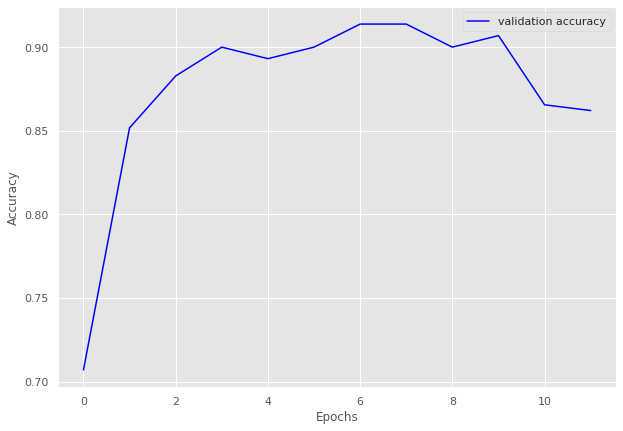

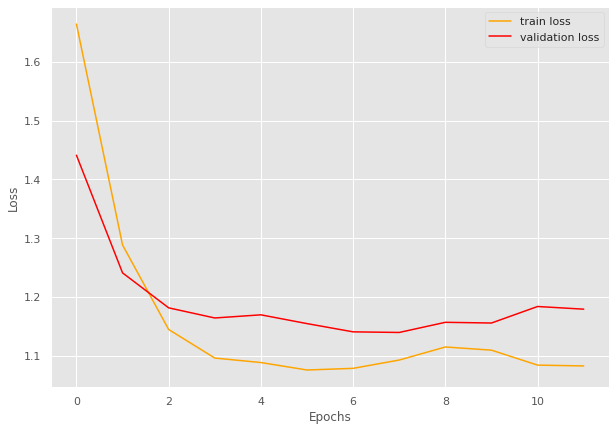

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.22batch/s, loss=0.851]


train loss 0.8511290947596232, validation loss 0.8006291151046753, validation accuracy 0.8455598455598455
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.15batch/s, loss=0.632]


train loss 0.6316015587912666, validation loss 0.7732316732406617, validation accuracy 0.8687258687258688
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.22batch/s, loss=0.594]


train loss 0.5937257210413615, validation loss 0.7226234912872315, validation accuracy 0.8957528957528957
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.18batch/s, loss=0.577]


INFO: Early stopping counter 1 of 5
train loss 0.57660397556093, validation loss 0.7437747955322266, validation accuracy 0.888030888030888
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.24batch/s, loss=0.593]


INFO: Early stopping counter 2 of 5
train loss 0.5931780801879035, validation loss 0.7349165678024292, validation accuracy 0.9034749034749034
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.24batch/s, loss=0.579]


train loss 0.5793866250250075, validation loss 0.7215612053871154, validation accuracy 0.8957528957528957
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.07batch/s, loss=0.561]


INFO: Early stopping counter 3 of 5
train loss 0.5612981385654874, validation loss 0.7481463074684143, validation accuracy 0.8803088803088803
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.21batch/s, loss=0.559]


INFO: Early stopping counter 4 of 5
train loss 0.5585475564002991, validation loss 0.7452169060707092, validation accuracy 0.8841698841698842
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.24batch/s, loss=0.569]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9231117141564903 and loss 0.6277353261198316


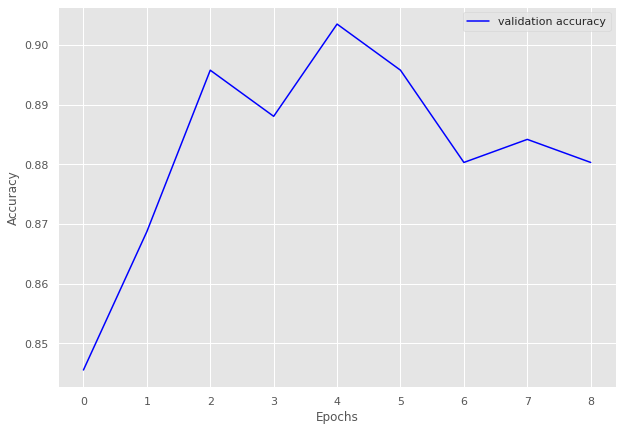

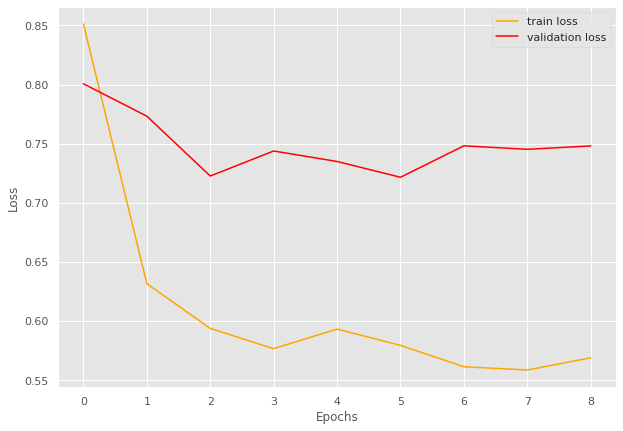

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.39]


train loss 1.38870622609791, validation loss 1.1667650938034058, validation accuracy 0.8922558922558923
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.95batch/s, loss=1.1] 


train loss 1.1000761860295345, validation loss 1.1269301652908326, validation accuracy 0.930976430976431
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=1.07]


train loss 1.0679061789261668, validation loss 1.1102661728858947, validation accuracy 0.9393939393939394
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.06]


train loss 1.0599313974380493, validation loss 1.1068682551383973, validation accuracy 0.9427609427609428
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0555619754289325, validation loss 1.109874927997589, validation accuracy 0.9377104377104377
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.93batch/s, loss=1.05]


train loss 1.052308816658823, validation loss 1.1047202110290528, validation accuracy 0.9444444444444444
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.88batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.0539514140078896, validation loss 1.1074669122695924, validation accuracy 0.9410774410774411
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.01batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0530790655236495, validation loss 1.1089233040809632, validation accuracy 0.936026936026936
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0527073835071765, validation loss 1.1111089944839478, validation accuracy 0.930976430976431
Coarse label 14 Epoch 10
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=1.05]


train loss 1.05215869451824, validation loss 1.1035496830940246, validation accuracy 0.9427609427609428
Coarse label 14 Epoch 11
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.93batch/s, loss=1.05]


train loss 1.0515266468650417, validation loss 1.0988393664360045, validation accuracy 0.9494949494949495
Coarse label 14 Epoch 12
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9419647255887279 and loss 1.1030234488301307


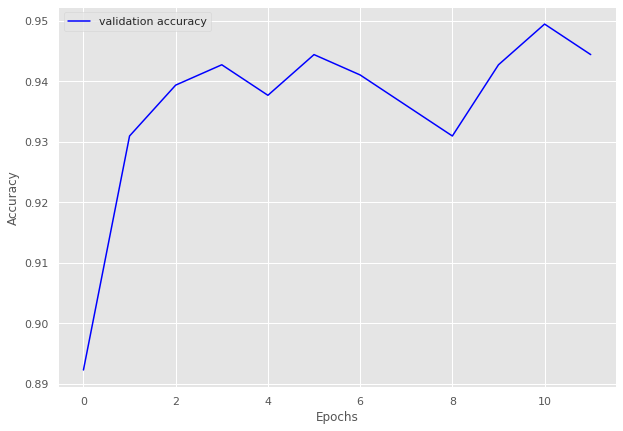

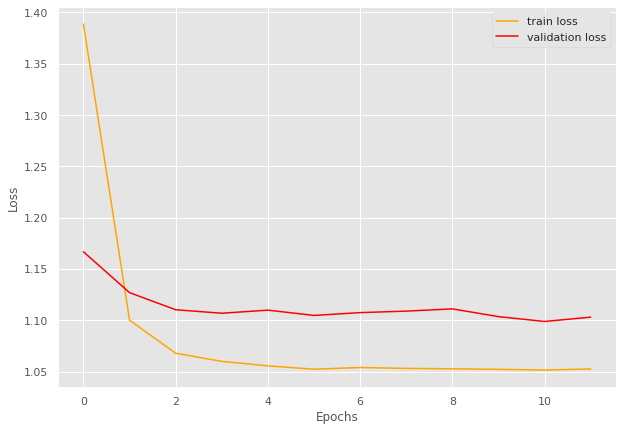

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=1.17]


train loss 1.1697138249874115, validation loss 0.9251899957656861, validation accuracy 0.8639455782312925
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.14batch/s, loss=0.834]


train loss 0.8340175807476043, validation loss 0.838376247882843, validation accuracy 0.9217687074829932
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.16batch/s, loss=0.777]


train loss 0.7769417405128479, validation loss 0.8215103268623352, validation accuracy 0.9183673469387755
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.00batch/s, loss=0.755]


train loss 0.7551577150821686, validation loss 0.8154189825057984, validation accuracy 0.9319727891156463
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.758]


INFO: Early stopping counter 1 of 5
train loss 0.7583410739898682, validation loss 0.8164911866188049, validation accuracy 0.935374149659864
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.748]


INFO: Early stopping counter 2 of 5
train loss 0.7484644234180451, validation loss 0.8280813813209533, validation accuracy 0.9149659863945578
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.16batch/s, loss=0.747]


INFO: Early stopping counter 3 of 5
train loss 0.747489470243454, validation loss 0.825512707233429, validation accuracy 0.9217687074829932
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.747]


INFO: Early stopping counter 4 of 5
train loss 0.7472309529781341, validation loss 0.8327569603919983, validation accuracy 0.9047619047619048
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.12batch/s, loss=0.749]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9188110911629762 and loss 0.8252766509599323


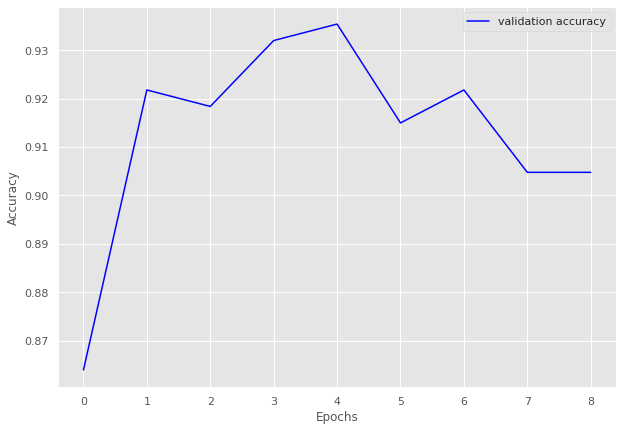

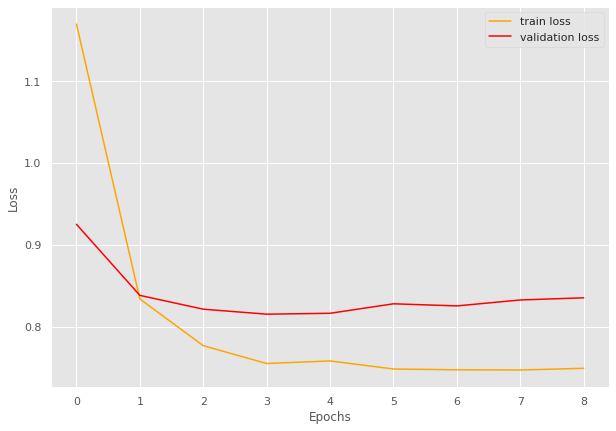

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.94batch/s, loss=0.883]


train loss 0.8825582398308648, validation loss 0.7626464247703553, validation accuracy 0.8333333333333334
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.01batch/s, loss=0.607]


train loss 0.6073767940203348, validation loss 0.6181274771690368, validation accuracy 0.9468085106382979
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.93batch/s, loss=0.567]


train loss 0.5665803220536973, validation loss 0.6115975260734559, validation accuracy 0.9468085106382979
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.97batch/s, loss=0.559]


INFO: Early stopping counter 1 of 5
train loss 0.5585804051823087, validation loss 0.6117951273918152, validation accuracy 0.9468085106382979
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.91batch/s, loss=0.555]


INFO: Early stopping counter 2 of 5
train loss 0.5548940300941467, validation loss 0.6200109362602234, validation accuracy 0.9397163120567376
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.94batch/s, loss=0.555]


INFO: Early stopping counter 3 of 5
train loss 0.5554243591096666, validation loss 0.6185332894325256, validation accuracy 0.9468085106382979
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 9/9 [00:02<00:00,  3.01batch/s, loss=0.553]


INFO: Early stopping counter 4 of 5
train loss 0.553286506070031, validation loss 0.6120089054107666, validation accuracy 0.9574468085106383
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  2.84batch/s, loss=0.553]


train loss 0.5526012182235718, validation loss 0.6041425108909607, validation accuracy 0.9539007092198581
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 9/9 [00:03<00:00,  3.00batch/s, loss=0.552]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9372271876948659 and loss 0.6142268580825705


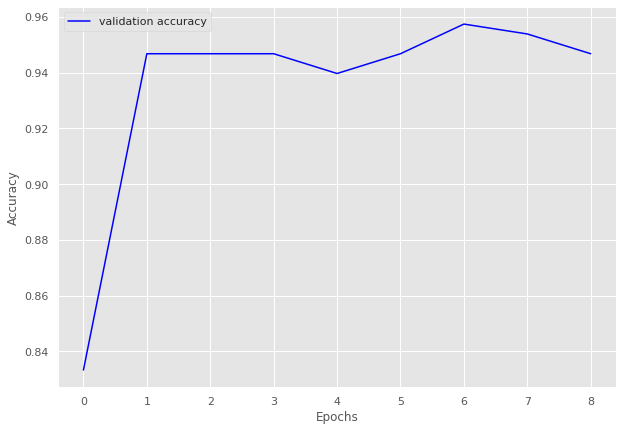

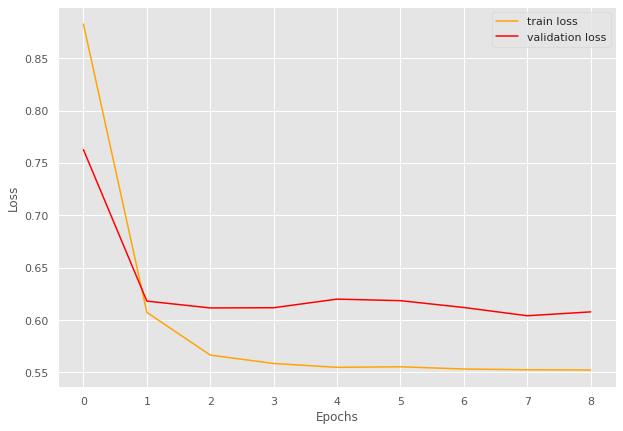

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 17 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=1.16]


train loss 1.1576981842517853, validation loss 0.9740333080291748, validation accuracy 0.7928802588996764
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.88batch/s, loss=0.87]


train loss 0.8702008187770843, validation loss 0.9002369046211243, validation accuracy 0.8446601941747572
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.03batch/s, loss=0.791]


train loss 0.7913159132003784, validation loss 0.8730957508087158, validation accuracy 0.8737864077669902
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=0.76]


train loss 0.7601121962070465, validation loss 0.8602441668510437, validation accuracy 0.8770226537216829
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.00batch/s, loss=0.754]


train loss 0.7537907242774964, validation loss 0.8529165983200073, validation accuracy 0.8932038834951457
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.94batch/s, loss=0.749]


INFO: Early stopping counter 1 of 5
train loss 0.748557859659195, validation loss 0.8534242391586304, validation accuracy 0.883495145631068
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.02batch/s, loss=0.749]


train loss 0.7487886250019073, validation loss 0.8478498220443725, validation accuracy 0.8996763754045307
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.03batch/s, loss=0.746]


train loss 0.7455779433250427, validation loss 0.8463452816009521, validation accuracy 0.9061488673139159
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.77batch/s, loss=0.745]


train loss 0.7448238790035248, validation loss 0.8391793012619019, validation accuracy 0.9061488673139159
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.98batch/s, loss=0.745]


train loss 0.7447889506816864, validation loss 0.8372660517692566, validation accuracy 0.9061488673139159
Coarse label 17 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.97batch/s, loss=0.745]


INFO: Early stopping counter 2 of 5
train loss 0.744614714384079, validation loss 0.8374152064323426, validation accuracy 0.9061488673139159
Coarse label 17 Epoch 12
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=0.744]


INFO: Early stopping counter 3 of 5
train loss 0.7442100167274475, validation loss 0.8386889457702636, validation accuracy 0.9029126213592233
Coarse label 17 Epoch 13
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.98batch/s, loss=0.744]


INFO: Early stopping counter 4 of 5
train loss 0.7442111253738404, validation loss 0.8382371544837952, validation accuracy 0.9029126213592233
Coarse label 17 Epoch 14
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.03batch/s, loss=0.744]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9174886191198786 and loss 0.8276606173400419


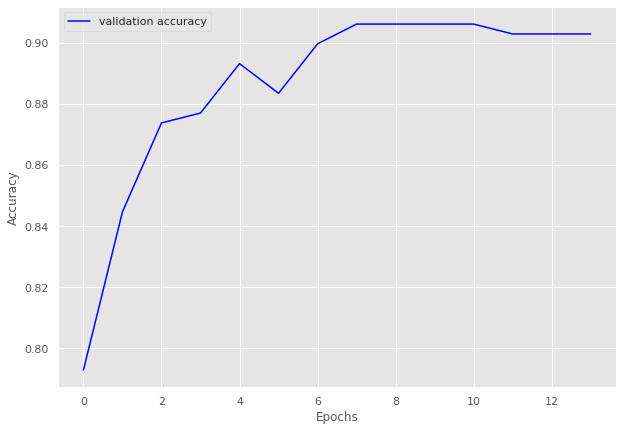

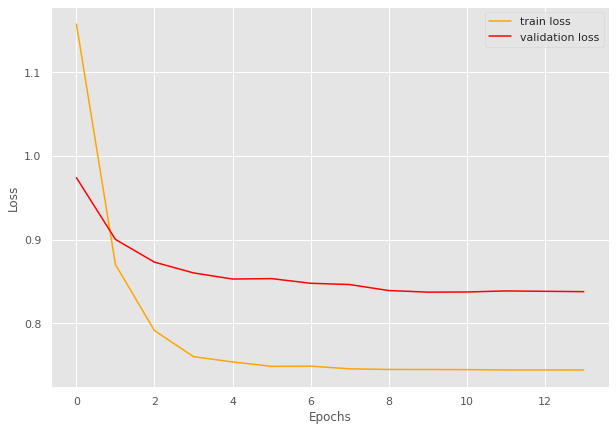

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 19 Epoch 1
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.67batch/s, loss=1.33]


train loss 1.3273691236972809, validation loss 1.2313205003738403, validation accuracy 0.7083333333333334
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.54batch/s, loss=0.989]


train loss 0.9892183095216751, validation loss 1.0539607405662537, validation accuracy 0.8020833333333334
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.76batch/s, loss=0.912]


train loss 0.9120376110076904, validation loss 0.9471337199211121, validation accuracy 0.8541666666666666
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.76batch/s, loss=0.814]


train loss 0.8142594993114471, validation loss 0.9092837572097778, validation accuracy 0.8645833333333334
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.72batch/s, loss=0.835]


train loss 0.8351525962352753, validation loss 0.9003181159496307, validation accuracy 0.8541666666666666
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.76batch/s, loss=0.825]


INFO: Early stopping counter 1 of 5
train loss 0.8249773234128952, validation loss 0.901659220457077, validation accuracy 0.84375
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.70batch/s, loss=0.847]


train loss 0.8470641821622849, validation loss 0.8986445665359497, validation accuracy 0.84375
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.76batch/s, loss=0.806]


INFO: Early stopping counter 2 of 5
train loss 0.8062498569488525, validation loss 0.8995479345321655, validation accuracy 0.84375
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.71batch/s, loss=0.766]


INFO: Early stopping counter 3 of 5
train loss 0.7655910402536392, validation loss 0.9102023243904114, validation accuracy 0.8333333333333334
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.69batch/s, loss=0.79] 


INFO: Early stopping counter 4 of 5
train loss 0.7898186296224594, validation loss 0.9171265363693237, validation accuracy 0.8229166666666666
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 4/4 [00:01<00:00,  3.78batch/s, loss=0.831]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.8333333333333334 and loss 0.9164177929913556


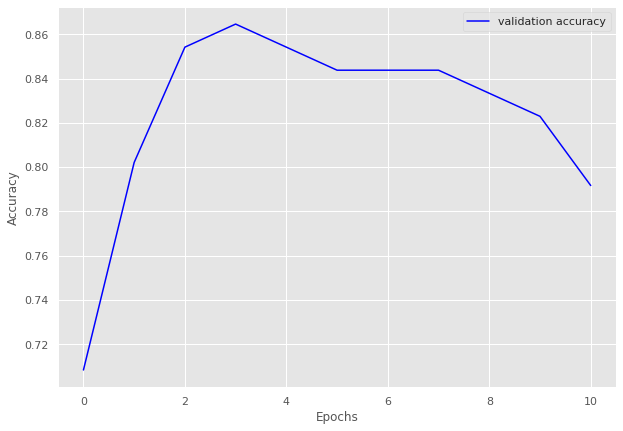

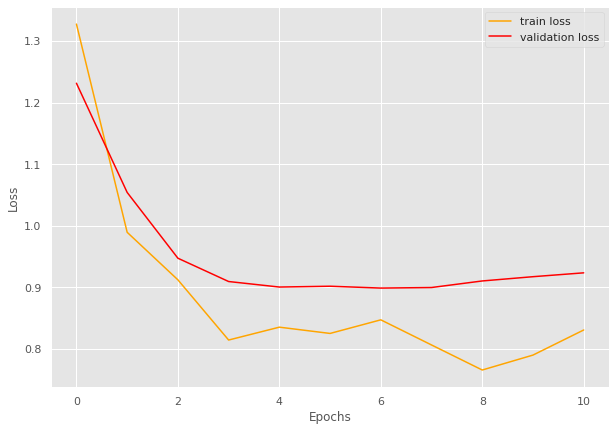

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Evaluating fine model 0
Evaluating fine model 1
Evaluating fine model 2
Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16
Evaluating fine model 17
Evaluating fine model 19
overall accuracy  is 0.7455352462167546
{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.93423053527980

Calculating for volume 25
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.02batch/s, loss=1.2] 


train loss 1.204429371016366, validation loss 1.0151714938027518, validation accuracy 0.8927738927738927
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.02batch/s, loss=0.989]


train loss 0.9892834914582116, validation loss 0.9848839810916356, validation accuracy 0.9230769230769231
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.03batch/s, loss=0.946]


INFO: Early stopping counter 1 of 5
train loss 0.9461583367415837, validation loss 0.9854535119874137, validation accuracy 0.9277389277389277
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=0.953]


train loss 0.9532833610262189, validation loss 0.9690664325441632, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=0.932]


train loss 0.9316358119249344, validation loss 0.9612480487142291, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.01batch/s, loss=0.942]


INFO: Early stopping counter 2 of 5
train loss 0.941574718270983, validation loss 0.9636265976088387, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.03batch/s, loss=0.96] 


INFO: Early stopping counter 3 of 5
train loss 0.960283351796014, validation loss 0.9626258271081107, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=0.932]


INFO: Early stopping counter 4 of 5
train loss 0.9321675917931965, validation loss 0.962834187916347, validation accuracy 0.9417249417249417
Coarse label 0 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=0.939]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9443244910549043 and loss 0.9601889264349844


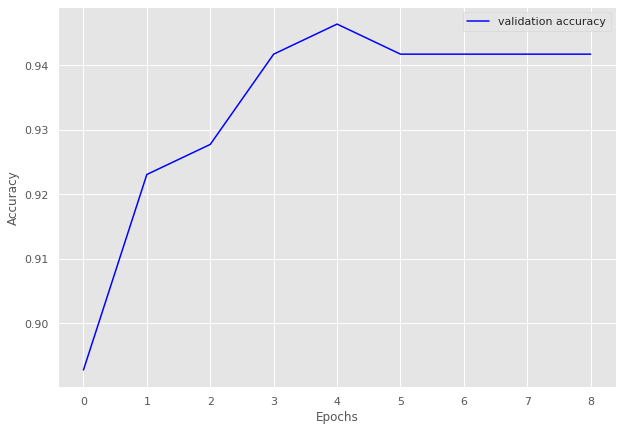

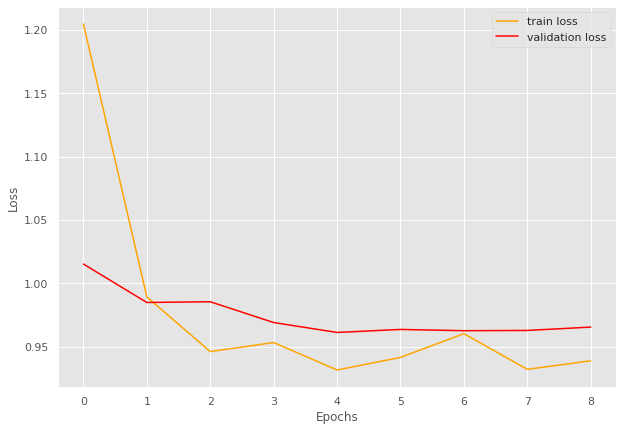

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 1 Epoch 1
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.98batch/s, loss=1.47]


train loss 1.465886930624644, validation loss 1.2151096264521282, validation accuracy 0.8602150537634409
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.96batch/s, loss=1.13]


train loss 1.1330842673778534, validation loss 1.1307291984558105, validation accuracy 0.9193548387096774
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.99batch/s, loss=1.08]


train loss 1.0848240653673809, validation loss 1.123610019683838, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0584344168504078, validation loss 1.1240506966908772, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 12/12 [00:03<00:00,  3.00batch/s, loss=1.06]


train loss 1.0569120446840923, validation loss 1.1112322409947712, validation accuracy 0.946236559139785
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.96batch/s, loss=1.05]


train loss 1.0520393550395966, validation loss 1.1085224151611328, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.84batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.0500229199727376, validation loss 1.1192171573638916, validation accuracy 0.9247311827956989
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.94batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0470716257890065, validation loss 1.1268057028452556, validation accuracy 0.9193548387096774
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.98batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0521959960460663, validation loss 1.1224117279052734, validation accuracy 0.9247311827956989
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 12/12 [00:04<00:00,  2.98batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9436968838526912 and loss 1.1031916936238606


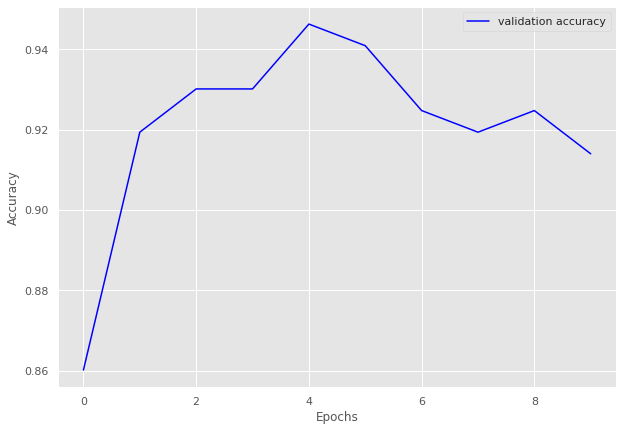

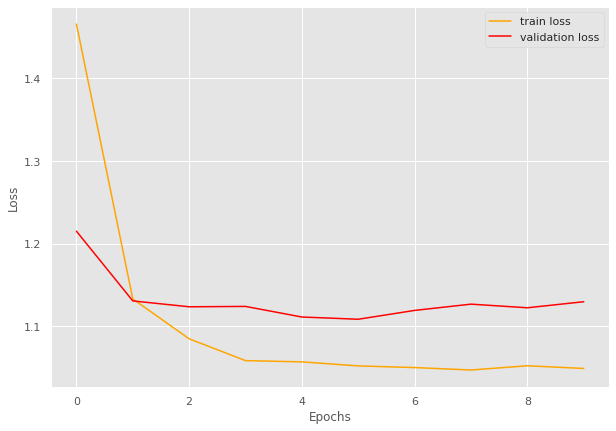

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 2 Epoch 1
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.92batch/s, loss=1.81]


train loss 1.8098269961097024, validation loss 1.6176461492265974, validation accuracy 0.8574712643678161
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 55/55 [00:19<00:00,  2.88batch/s, loss=1.57]


train loss 1.5650528127496892, validation loss 1.5446288670812334, validation accuracy 0.9298850574712644
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.93batch/s, loss=1.52]


train loss 1.5207647301933982, validation loss 1.5413787790707179, validation accuracy 0.9264367816091954
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.93batch/s, loss=1.51]


train loss 1.5105171311985364, validation loss 1.5407189982278007, validation accuracy 0.9298850574712644
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.91batch/s, loss=1.5] 


INFO: Early stopping counter 1 of 5
train loss 1.5006264426491478, validation loss 1.5429982117244176, validation accuracy 0.9218390804597701
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.94batch/s, loss=1.5]


train loss 1.4960803400386464, validation loss 1.5348013298852103, validation accuracy 0.9310344827586207
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 55/55 [00:20<00:00,  2.75batch/s, loss=1.5] 


INFO: Early stopping counter 2 of 5
train loss 1.4960645285519687, validation loss 1.553835732596261, validation accuracy 0.9103448275862069
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 55/55 [00:22<00:00,  2.45batch/s, loss=1.49]


train loss 1.4929308457808061, validation loss 1.5243287767682756, validation accuracy 0.9425287356321839
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 55/55 [00:19<00:00,  2.88batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4844956853172995, validation loss 1.528921663761139, validation accuracy 0.9356321839080459
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 55/55 [00:19<00:00,  2.80batch/s, loss=1.49]


INFO: Early stopping counter 4 of 5
train loss 1.4857834317467429, validation loss 1.5330438699041093, validation accuracy 0.9310344827586207
Coarse label 2 Epoch 11
-------------------------------


100%|██████████| 55/55 [00:18<00:00,  2.91batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9325577858880778 and loss 1.5302053163352523


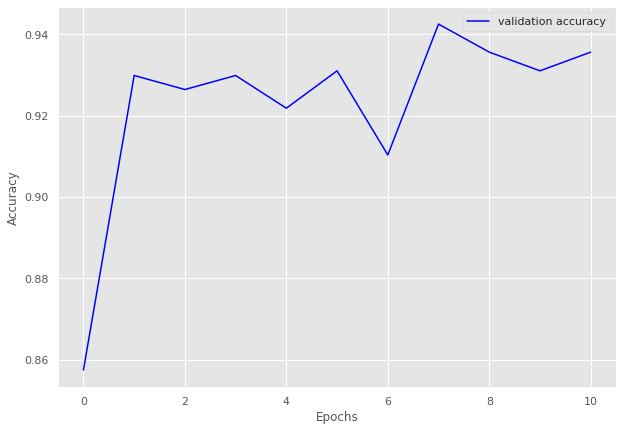

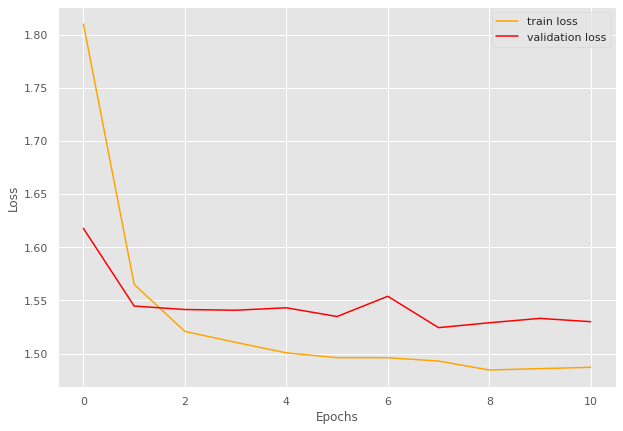

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.90batch/s, loss=1.39]


train loss 1.394076746243697, validation loss 1.2187948056629725, validation accuracy 0.837378640776699
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.96batch/s, loss=1.13]


train loss 1.130406645628122, validation loss 1.1480049576078142, validation accuracy 0.9101941747572816
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.90batch/s, loss=1.09]


train loss 1.093557825455299, validation loss 1.1452820982251848, validation accuracy 0.9053398058252428
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 26/26 [00:13<00:00,  1.98batch/s, loss=1.07]


train loss 1.0726129825298603, validation loss 1.1391679559435164, validation accuracy 0.9101941747572816
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.94batch/s, loss=1.07]


train loss 1.0650010429895842, validation loss 1.1241574457713537, validation accuracy 0.9320388349514563
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.91batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0643693071145277, validation loss 1.141825863293239, validation accuracy 0.9053398058252428
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.061315655708313, validation loss 1.1361110721315657, validation accuracy 0.9150485436893204
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 26/26 [00:09<00:00,  2.85batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0601837314092195, validation loss 1.1329549040113176, validation accuracy 0.9150485436893204
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.89batch/s, loss=1.06]


train loss 1.0576650775395906, validation loss 1.1235275949750627, validation accuracy 0.9199029126213593
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.91batch/s, loss=1.06]


train loss 1.058123726111192, validation loss 1.1131796155657088, validation accuracy 0.9296116504854369
Coarse label 4 Epoch 11
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.94batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.054320738865779, validation loss 1.135863150869097, validation accuracy 0.9150485436893204
Coarse label 4 Epoch 12
-------------------------------


100%|██████████| 26/26 [00:08<00:00,  2.92batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9354163311322274 and loss 1.1087145586403049


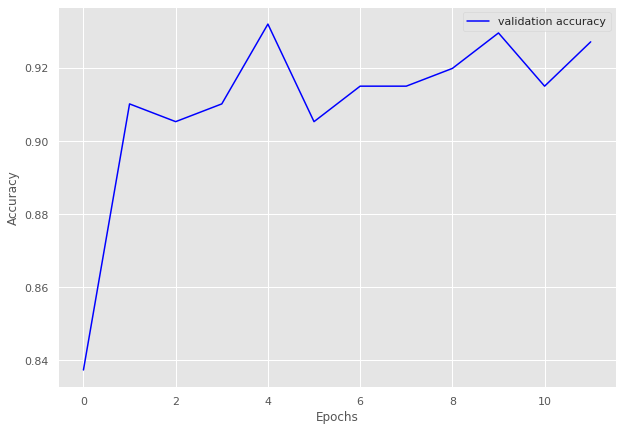

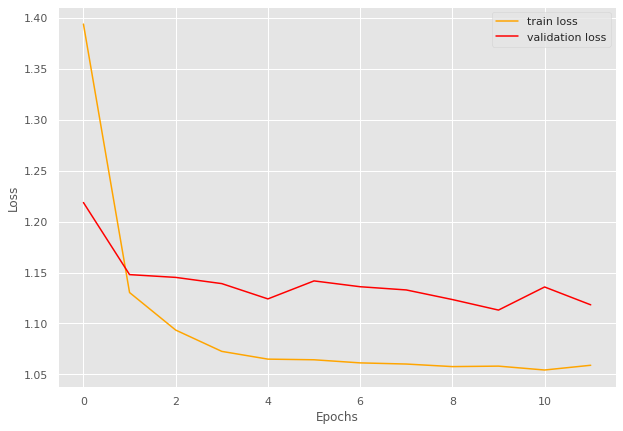

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:04<00:00,  2.47batch/s, loss=0.463]


train loss 0.4633180111646652, validation loss 0.34319300452868146, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=0.333]


train loss 0.33285958766937257, validation loss 0.33029259244600934, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.93batch/s, loss=0.319]


train loss 0.31853432655334474, validation loss 0.328009953101476, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.89batch/s, loss=0.318]


INFO: Early stopping counter 1 of 5
train loss 0.317556831240654, validation loss 0.32873083154360455, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.96batch/s, loss=0.316]


INFO: Early stopping counter 2 of 5
train loss 0.3159994065761566, validation loss 0.33025391896565753, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.94batch/s, loss=0.317]


INFO: Early stopping counter 3 of 5
train loss 0.31728032529354094, validation loss 0.32808863123257953, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.96batch/s, loss=0.315]


train loss 0.315091148018837, validation loss 0.3257895807425181, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  2.95batch/s, loss=0.315]


train loss 0.31519474387168883, validation loss 0.32498740156491596, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:05<00:00,  1.75batch/s, loss=0.315]


train loss 0.31467594802379606, validation loss 0.32495933771133423, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:05<00:00,  1.69batch/s, loss=0.315]


INFO: Early stopping counter 4 of 5
train loss 0.31536783576011657, validation loss 0.3277408878008525, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 11
-------------------------------


100%|██████████| 10/10 [00:06<00:00,  1.49batch/s, loss=0.315]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.982060909470171 and loss 0.3309713421683562


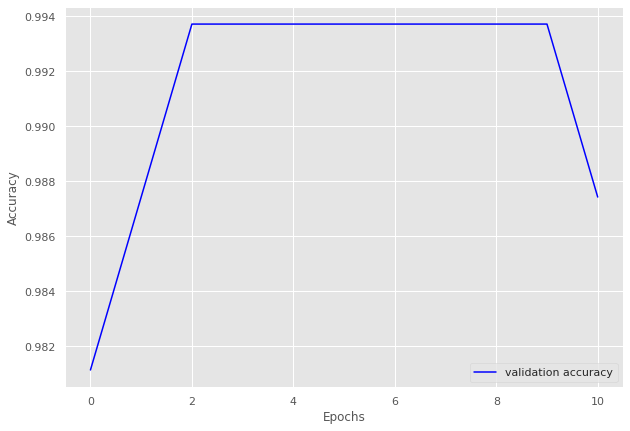

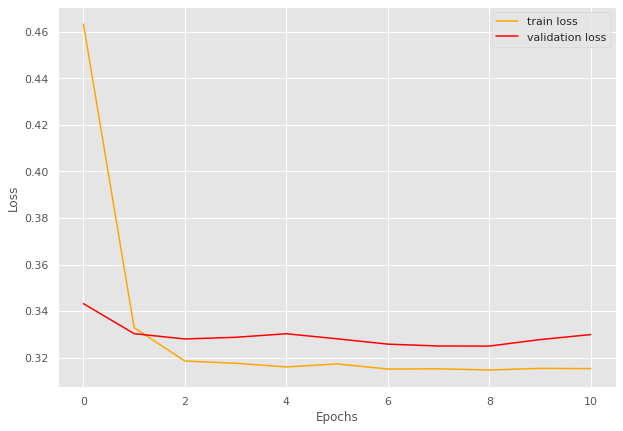

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 30/30 [00:20<00:00,  1.46batch/s, loss=1.46]


train loss 1.464826492468516, validation loss 1.2723701298236847, validation accuracy 0.8922413793103449
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:20<00:00,  1.50batch/s, loss=1.25]


train loss 1.246833829085032, validation loss 1.2412761598825455, validation accuracy 0.9224137931034483
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:24<00:00,  1.23batch/s, loss=1.21]


train loss 1.2134305397669474, validation loss 1.2298583686351776, validation accuracy 0.9375
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:21<00:00,  1.39batch/s, loss=1.21]


INFO: Early stopping counter 1 of 5
train loss 1.2149016459782918, validation loss 1.2468106299638748, validation accuracy 0.915948275862069
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:22<00:00,  1.35batch/s, loss=1.2]


INFO: Early stopping counter 2 of 5
train loss 1.2048250277837118, validation loss 1.2358424961566925, validation accuracy 0.9245689655172413
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:13<00:00,  2.20batch/s, loss=1.2] 


INFO: Early stopping counter 3 of 5
train loss 1.1995182156562805, validation loss 1.2335316389799118, validation accuracy 0.9375
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.91batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1883703152338663, validation loss 1.2532420307397842, validation accuracy 0.9137931034482759
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.99batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9329050678087081 and loss 1.2321040619503367


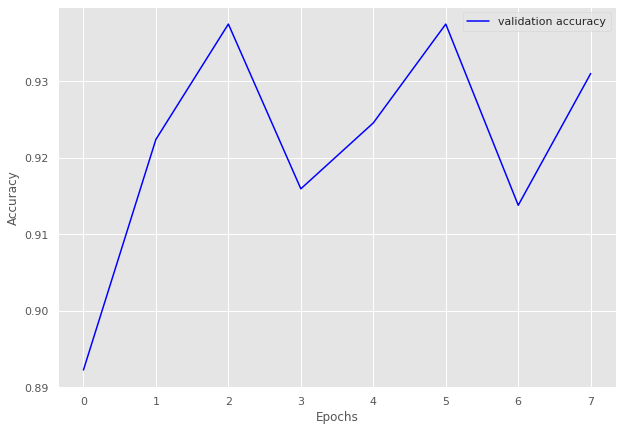

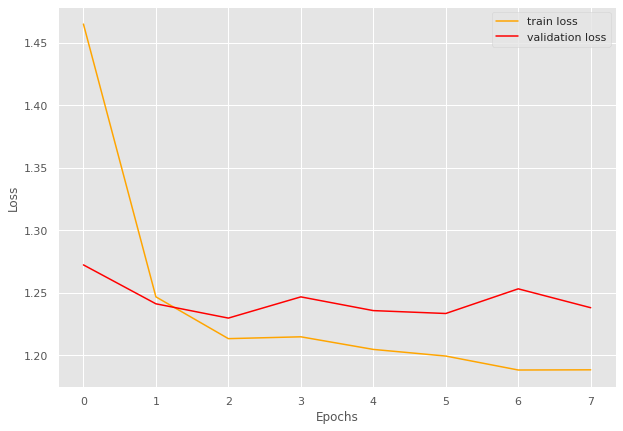

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.88batch/s, loss=0.942]


train loss 0.9420434184696364, validation loss 0.7751922706762949, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.89batch/s, loss=0.772]


train loss 0.7722738696181256, validation loss 0.7652107179164886, validation accuracy 0.977961432506887
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.89batch/s, loss=0.761]


INFO: Early stopping counter 1 of 5
train loss 0.761431028013644, validation loss 0.767861803372701, validation accuracy 0.977961432506887
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.92batch/s, loss=0.756]


INFO: Early stopping counter 2 of 5
train loss 0.7561014450114706, validation loss 0.7667098045349121, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.93batch/s, loss=0.754]


INFO: Early stopping counter 3 of 5
train loss 0.7543166564858478, validation loss 0.7728785375754038, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.96batch/s, loss=0.759]


INFO: Early stopping counter 4 of 5
train loss 0.7589906324510989, validation loss 0.7710548440615336, validation accuracy 0.9724517906336089
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 23/23 [00:07<00:00,  2.95batch/s, loss=0.757]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9697301239970825 and loss 0.7745339489260386


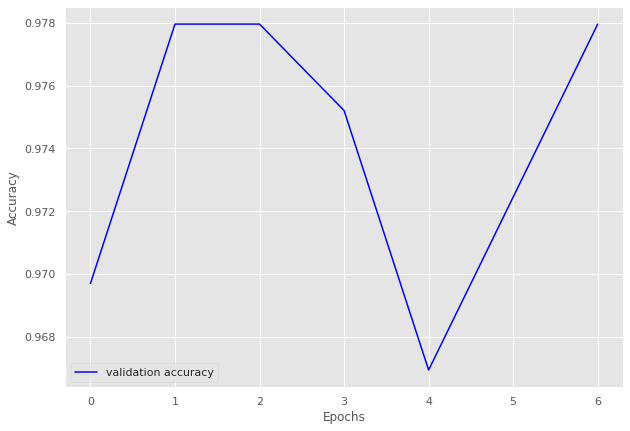

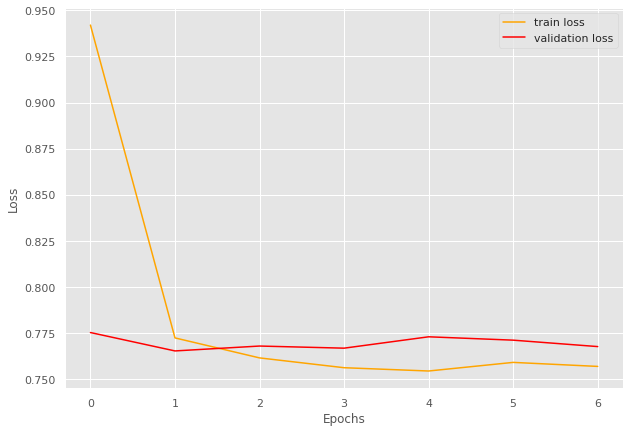

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.97batch/s, loss=1.53]


train loss 1.530773061694521, validation loss 1.279282107949257, validation accuracy 0.8923679060665362
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.95batch/s, loss=1.26]


train loss 1.2588758540875984, validation loss 1.249698594212532, validation accuracy 0.9217221135029354
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 33/33 [00:10<00:00,  3.01batch/s, loss=1.22]


train loss 1.2238779609853572, validation loss 1.2459334433078766, validation accuracy 0.9197651663405088
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 33/33 [00:10<00:00,  3.00batch/s, loss=1.21]


train loss 1.2121891036178127, validation loss 1.242418423295021, validation accuracy 0.9315068493150684
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.96batch/s, loss=1.2] 


INFO: Early stopping counter 1 of 5
train loss 1.1950000127156575, validation loss 1.2467928677797318, validation accuracy 0.9217221135029354
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.96batch/s, loss=1.2] 


train loss 1.2004904132900815, validation loss 1.2363412082195282, validation accuracy 0.9334637964774951
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.98batch/s, loss=1.19]


train loss 1.1919646804982966, validation loss 1.2339123785495758, validation accuracy 0.9334637964774951
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.96batch/s, loss=1.19]


INFO: Early stopping counter 2 of 5
train loss 1.1923496181314641, validation loss 1.2435933202505112, validation accuracy 0.9197651663405088
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.97batch/s, loss=1.19]


train loss 1.192736520911708, validation loss 1.232292965054512, validation accuracy 0.9295499021526419
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 33/33 [00:10<00:00,  3.00batch/s, loss=1.18]


train loss 1.183249780626008, validation loss 1.227078378200531, validation accuracy 0.9373776908023483
Coarse label 8 Epoch 11
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.94batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.186269142410972, validation loss 1.2285627722740173, validation accuracy 0.9412915851272016
Coarse label 8 Epoch 12
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.98batch/s, loss=1.2]


INFO: Early stopping counter 4 of 5
train loss 1.201612089619492, validation loss 1.256774440407753, validation accuracy 0.9060665362035225
Coarse label 8 Epoch 13
-------------------------------


100%|██████████| 33/33 [00:11<00:00,  2.97batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9200311566921978 and loss 1.244422064339819


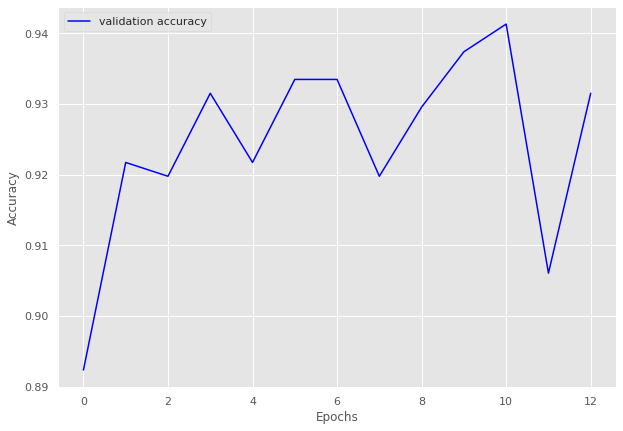

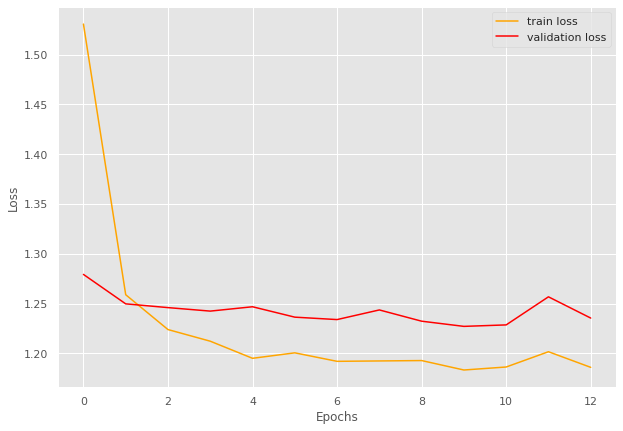

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=1.8] 


train loss 1.7987644614242926, validation loss 1.6345213868401267, validation accuracy 0.8966049382716049
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=1.57]


train loss 1.5730104533637441, validation loss 1.618676564910195, validation accuracy 0.9166666666666666
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=1.54]


train loss 1.544987637822221, validation loss 1.6160280921242454, validation accuracy 0.9151234567901234
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.90batch/s, loss=1.52]


train loss 1.5249983421186122, validation loss 1.5357029871507124, validation accuracy 0.9398148148148148
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=1.5] 


train loss 1.5038360270058238, validation loss 1.5289043188095093, validation accuracy 0.9382716049382716
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=1.49]


train loss 1.4870715228522695, validation loss 1.5057510896162554, validation accuracy 0.9537037037037037
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=1.49]


INFO: Early stopping counter 1 of 5
train loss 1.4867571621406368, validation loss 1.5139735286886042, validation accuracy 0.9475308641975309
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.487498946306182, validation loss 1.5074109380895442, validation accuracy 0.9506172839506173
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.4831460365434972, validation loss 1.5142466046593406, validation accuracy 0.9521604938271605
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=1.48]


train loss 1.478728489177983, validation loss 1.4979510307312012, validation accuracy 0.9629629629629629
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=1.47]


INFO: Early stopping counter 4 of 5
train loss 1.4729237672759266, validation loss 1.5050040049986406, validation accuracy 0.9567901234567902
Coarse label 9 Epoch 12
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9416828943322743 and loss 1.5211888232262305


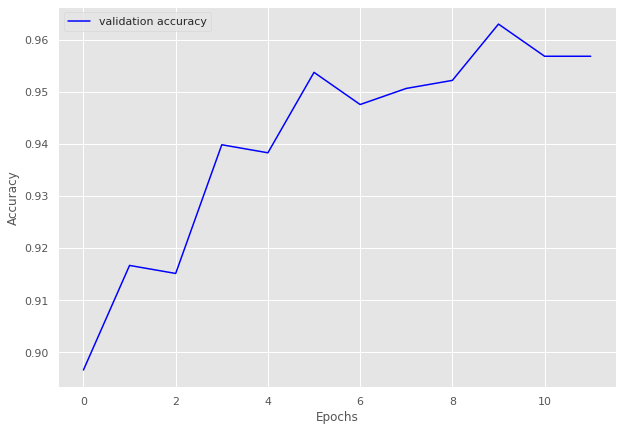

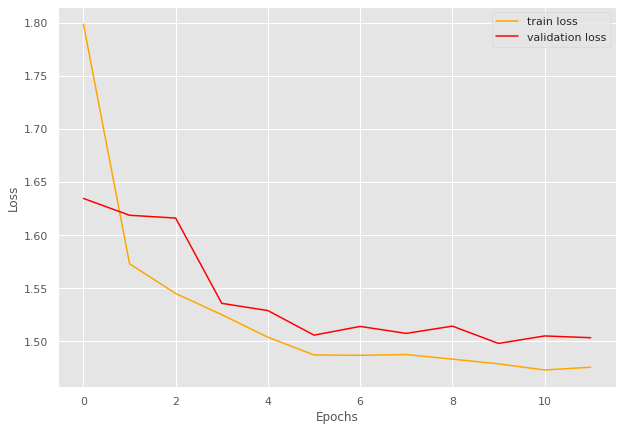

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.971]


train loss 0.9708943486213684, validation loss 0.8006786346435547, validation accuracy 0.9506578947368421
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.781]


train loss 0.7807761579751968, validation loss 0.7651453852653504, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.759]


train loss 0.7586952984333039, validation loss 0.7600085377693176, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.96batch/s, loss=0.756]


INFO: Early stopping counter 1 of 5
train loss 0.7559206306934356, validation loss 0.7607960343360901, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.00batch/s, loss=0.756]


INFO: Early stopping counter 2 of 5
train loss 0.7556215852499009, validation loss 0.7657648801803589, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.754]


INFO: Early stopping counter 3 of 5
train loss 0.7535958051681518, validation loss 0.7600359559059143, validation accuracy 0.9868421052631579
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.759]


INFO: Early stopping counter 4 of 5
train loss 0.7592351973056793, validation loss 0.7741346836090088, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.06batch/s, loss=0.754]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9649923896499238 and loss 0.7777713826960988


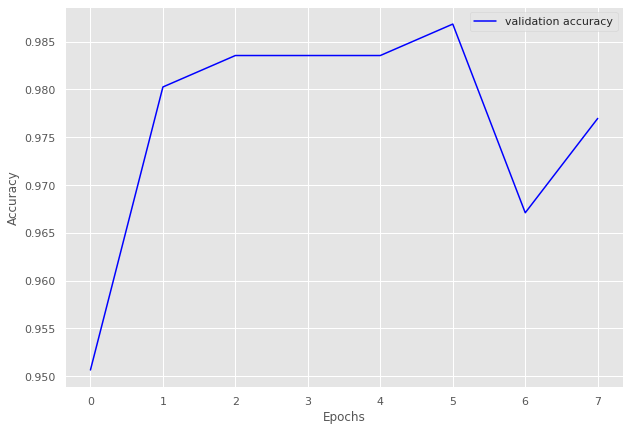

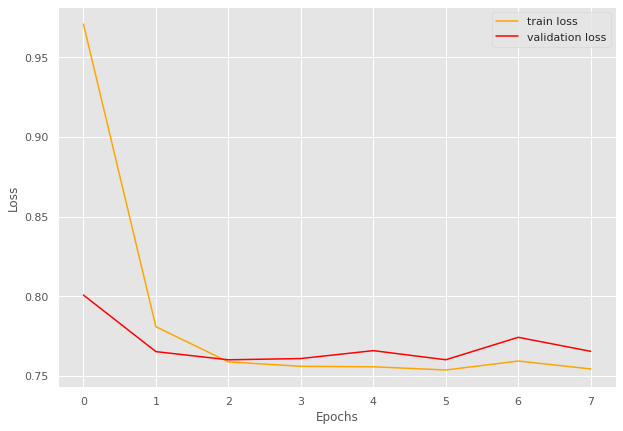

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.97batch/s, loss=1.52]


train loss 1.519631730882745, validation loss 1.2867457389831543, validation accuracy 0.7758620689655172
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.16]


train loss 1.1572647094726562, validation loss 1.1614898681640624, validation accuracy 0.8827586206896552
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=1.1] 


train loss 1.0995510691090633, validation loss 1.1577677011489869, validation accuracy 0.8862068965517241
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.07batch/s, loss=1.09]


train loss 1.087997122814781, validation loss 1.1455657243728639, validation accuracy 0.9
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.03batch/s, loss=1.08]


train loss 1.0781439417286922, validation loss 1.1424833536148071, validation accuracy 0.9137931034482759
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.79batch/s, loss=1.07]


train loss 1.0698050699735944, validation loss 1.1406668663024901, validation accuracy 0.9
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.05batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.078075189339487, validation loss 1.153281831741333, validation accuracy 0.8931034482758621
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.04batch/s, loss=1.07]


train loss 1.072223519024096, validation loss 1.1319946765899658, validation accuracy 0.9137931034482759
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.04batch/s, loss=1.08]


INFO: Early stopping counter 2 of 5
train loss 1.07559072971344, validation loss 1.1333617210388183, validation accuracy 0.906896551724138
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=1.06]


train loss 1.0645623583542674, validation loss 1.1232282876968385, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 11
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.07batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.0650689413673, validation loss 1.1238890409469604, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 12
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.01batch/s, loss=1.07]


INFO: Early stopping counter 4 of 5
train loss 1.0742019477643465, validation loss 1.1425293684005737, validation accuracy 0.903448275862069
Coarse label 12 Epoch 13
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.06batch/s, loss=1.08]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9098976109215017 and loss 1.1327657647754834


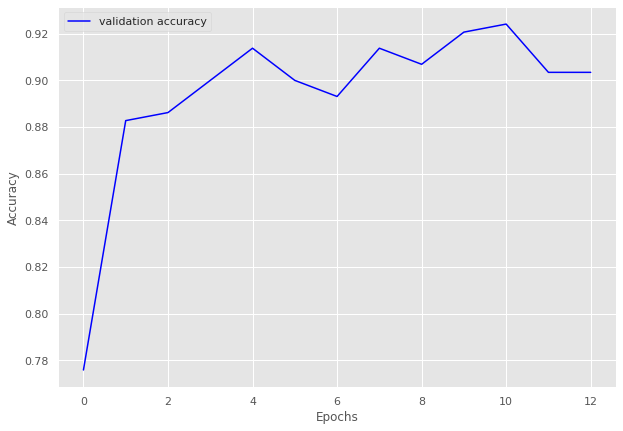

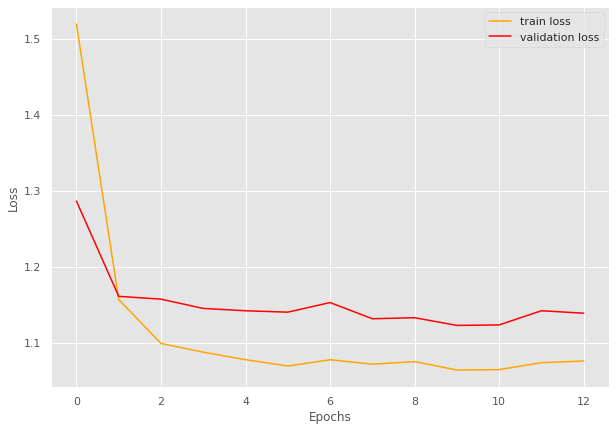

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.04batch/s, loss=0.755]


train loss 0.755313960944905, validation loss 0.640486192703247, validation accuracy 0.8918918918918919
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.06batch/s, loss=0.597]


train loss 0.5966968536376953, validation loss 0.635838782787323, validation accuracy 0.8918918918918919
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.05batch/s, loss=0.581]


train loss 0.580586149412043, validation loss 0.6229978799819946, validation accuracy 0.9073359073359073
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.05batch/s, loss=0.571]


INFO: Early stopping counter 1 of 5
train loss 0.5711363729308633, validation loss 0.6272320032119751, validation accuracy 0.8996138996138996
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  2.99batch/s, loss=0.565]


train loss 0.5651570698794197, validation loss 0.6149614810943603, validation accuracy 0.9227799227799228
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.05batch/s, loss=0.566]


INFO: Early stopping counter 2 of 5
train loss 0.5655514738138985, validation loss 0.6215421199798584, validation accuracy 0.9073359073359073
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.04batch/s, loss=0.563]


INFO: Early stopping counter 3 of 5
train loss 0.5630946474916795, validation loss 0.6243614315986633, validation accuracy 0.8957528957528957
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.07batch/s, loss=0.573]


INFO: Early stopping counter 4 of 5
train loss 0.5727572581347298, validation loss 0.627476179599762, validation accuracy 0.9073359073359073
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 17/17 [00:05<00:00,  3.01batch/s, loss=0.573]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9292489105357601 and loss 0.6210960814210235


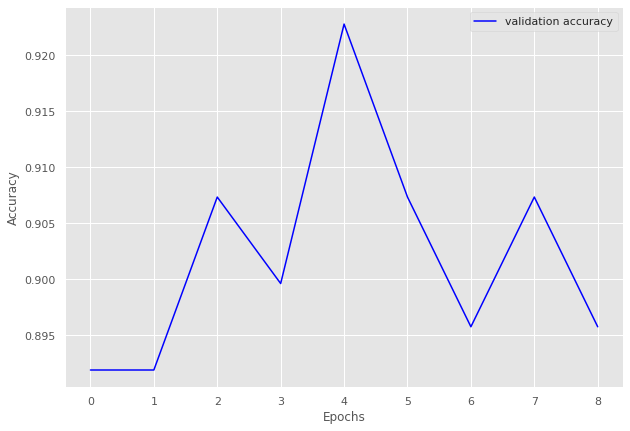

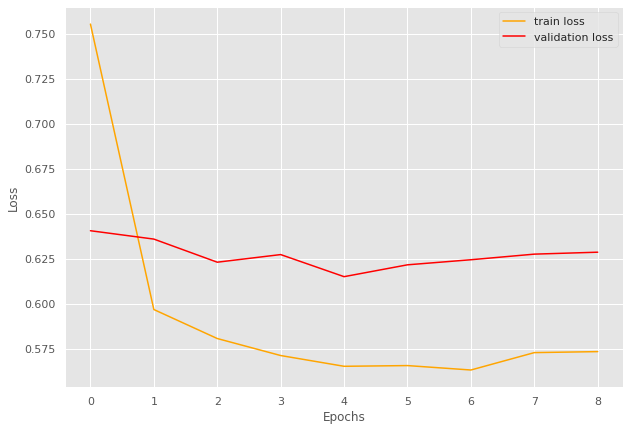

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.96batch/s, loss=1.26]


train loss 1.259666659330067, validation loss 1.1111856818199157, validation accuracy 0.9377104377104377
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.99batch/s, loss=1.09]


train loss 1.0873068037785982, validation loss 1.09906507730484, validation accuracy 0.9444444444444444
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.96batch/s, loss=1.07]


train loss 1.0709174934186434, validation loss 1.090934431552887, validation accuracy 0.9562289562289562
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.95batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.066611531533693, validation loss 1.0953415036201477, validation accuracy 0.9494949494949495
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.97batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.059279884162702, validation loss 1.0927819728851318, validation accuracy 0.9494949494949495
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.99batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0596493482589722, validation loss 1.0917689800262451, validation accuracy 0.9595959595959596
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0630064543924833, validation loss 1.1011069536209106, validation accuracy 0.9427609427609428
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 38/38 [00:12<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9574444320339551 and loss 1.0868391709668295


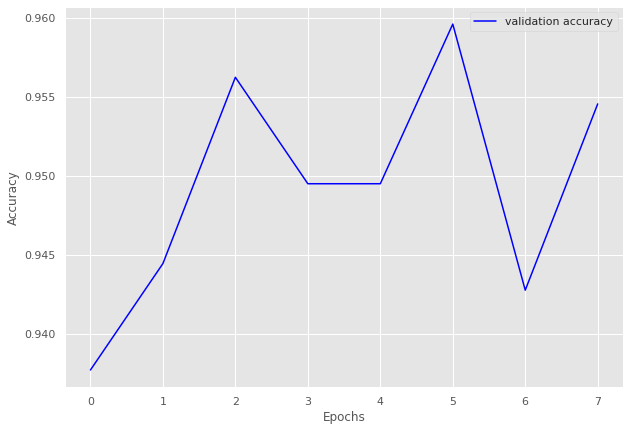

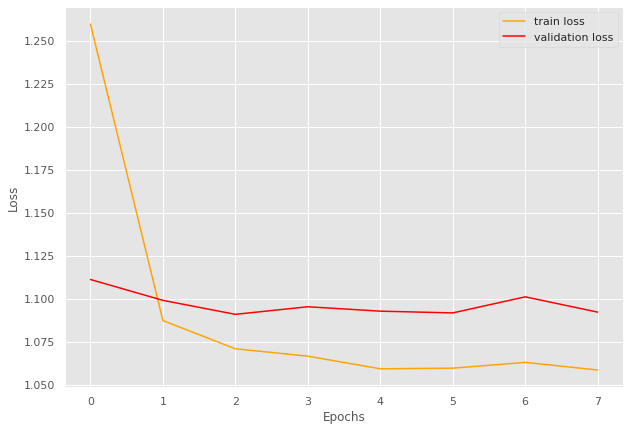

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=1.03]


train loss 1.032656679027959, validation loss 0.8289594411849975, validation accuracy 0.9217687074829932
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=0.788]


train loss 0.7875771271555048, validation loss 0.7859305500984192, validation accuracy 0.9591836734693877
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=0.77] 


INFO: Early stopping counter 1 of 5
train loss 0.7704850843078211, validation loss 0.791434931755066, validation accuracy 0.95578231292517
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=0.758]


train loss 0.7581511233982287, validation loss 0.7817101240158081, validation accuracy 0.9591836734693877
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.80batch/s, loss=0.756]


INFO: Early stopping counter 2 of 5
train loss 0.7559972248579326, validation loss 0.784095311164856, validation accuracy 0.9523809523809523
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.90batch/s, loss=0.75] 


INFO: Early stopping counter 3 of 5
train loss 0.7503880889792192, validation loss 0.7864015579223633, validation accuracy 0.95578231292517
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=0.749]


train loss 0.7491733023994848, validation loss 0.7780092120170593, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.99batch/s, loss=0.749]


INFO: Early stopping counter 4 of 5
train loss 0.7490059262827823, validation loss 0.7789091348648072, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.94batch/s, loss=0.752]


train loss 0.7517794088313454, validation loss 0.7755990028381348, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.94batch/s, loss=0.748]


train loss 0.7477308825442666, validation loss 0.7731744170188903, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 11
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.00batch/s, loss=0.747]


train loss 0.7474534856645685, validation loss 0.7699110627174377, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 12
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  2.98batch/s, loss=0.749]


train loss 0.7487826974768388, validation loss 0.766035509109497, validation accuracy 0.9829931972789115
Coarse label 15 Epoch 13
-------------------------------


100%|██████████| 19/19 [00:06<00:00,  3.02batch/s, loss=0.751]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9572688220664707 and loss 0.7871252800737109


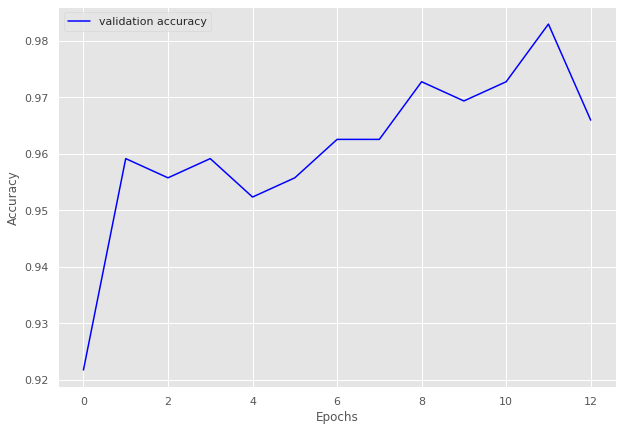

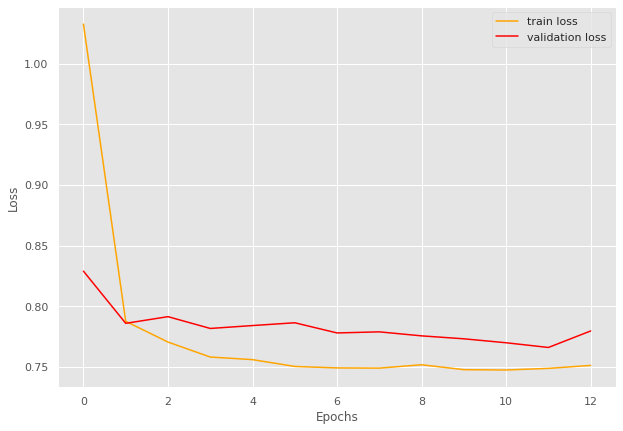

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.91batch/s, loss=0.765]


train loss 0.76485785179668, validation loss 0.6114264488220215, validation accuracy 0.9468085106382979
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.97batch/s, loss=0.582]


train loss 0.5815387103292677, validation loss 0.5881557822227478, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.98batch/s, loss=0.567]


INFO: Early stopping counter 1 of 5
train loss 0.5669225553671519, validation loss 0.6100010633468628, validation accuracy 0.950354609929078
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.97batch/s, loss=0.562]


INFO: Early stopping counter 2 of 5
train loss 0.5623482002152337, validation loss 0.6144981265068055, validation accuracy 0.950354609929078
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.97batch/s, loss=0.562]


INFO: Early stopping counter 3 of 5
train loss 0.5621048675643073, validation loss 0.6078423500061035, validation accuracy 0.9539007092198581
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.91batch/s, loss=0.561]


INFO: Early stopping counter 4 of 5
train loss 0.5613382293118371, validation loss 0.591510558128357, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.98batch/s, loss=0.559]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9510011778563016 and loss 0.6006933806547478


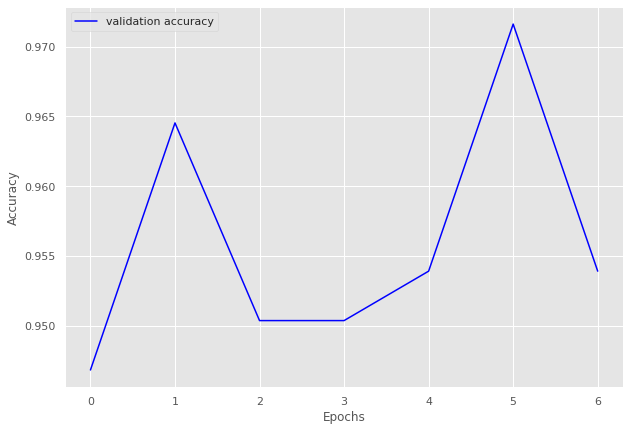

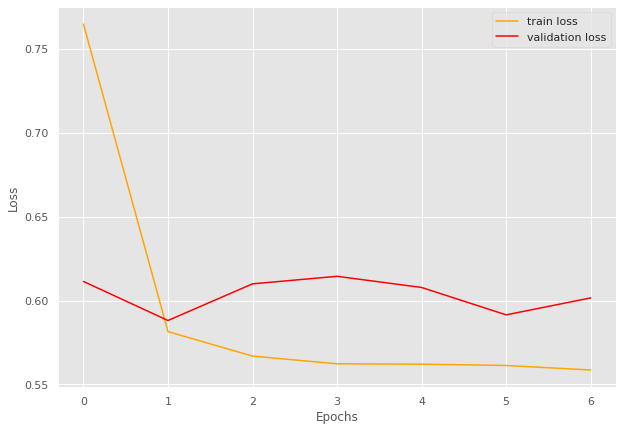

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 17 Epoch 1
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.01batch/s, loss=1.04]


train loss 1.040234810113907, validation loss 0.8843808531761169, validation accuracy 0.8640776699029126
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.98batch/s, loss=0.816]


train loss 0.8164096981287002, validation loss 0.831097400188446, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.99batch/s, loss=0.777]


train loss 0.776564770936966, validation loss 0.8180426120758056, validation accuracy 0.9288025889967637
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.99batch/s, loss=0.761]


train loss 0.7606155484914779, validation loss 0.8026131749153137, validation accuracy 0.941747572815534
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.99batch/s, loss=0.759]


INFO: Early stopping counter 1 of 5
train loss 0.7590917527675629, validation loss 0.8073010683059693, validation accuracy 0.941747572815534
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.95batch/s, loss=0.768]


train loss 0.7675151944160461, validation loss 0.8000209093093872, validation accuracy 0.941747572815534
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.93batch/s, loss=0.761]


INFO: Early stopping counter 2 of 5
train loss 0.7607562333345413, validation loss 0.8023079991340637, validation accuracy 0.941747572815534
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.758]


train loss 0.7580100715160369, validation loss 0.7961408495903015, validation accuracy 0.9546925566343042
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  2.96batch/s, loss=0.761]


INFO: Early stopping counter 3 of 5
train loss 0.7609047561883926, validation loss 0.8026632905006409, validation accuracy 0.9385113268608414
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.04batch/s, loss=0.752]


INFO: Early stopping counter 4 of 5
train loss 0.7521204352378845, validation loss 0.8012241005897522, validation accuracy 0.941747572815534
Coarse label 17 Epoch 11
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.02batch/s, loss=0.75] 


train loss 0.7499120891094208, validation loss 0.7944496393203735, validation accuracy 0.948220064724919
Coarse label 17 Epoch 12
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.01batch/s, loss=0.747]


train loss 0.7472412467002869, validation loss 0.788770878314972, validation accuracy 0.9546925566343042
Coarse label 17 Epoch 13
-------------------------------


100%|██████████| 20/20 [00:06<00:00,  3.03batch/s, loss=0.748]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9359415305245056 and loss 0.8088728981475307


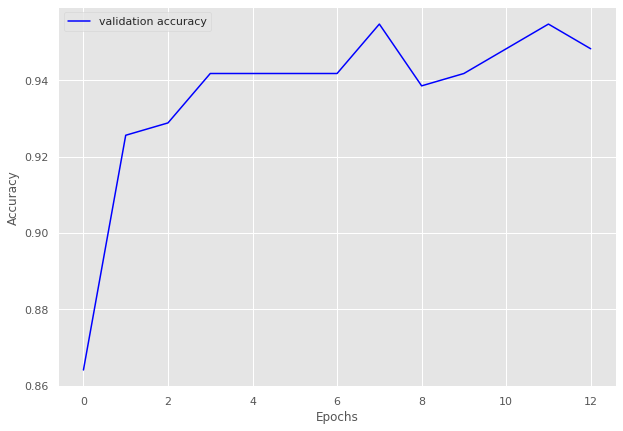

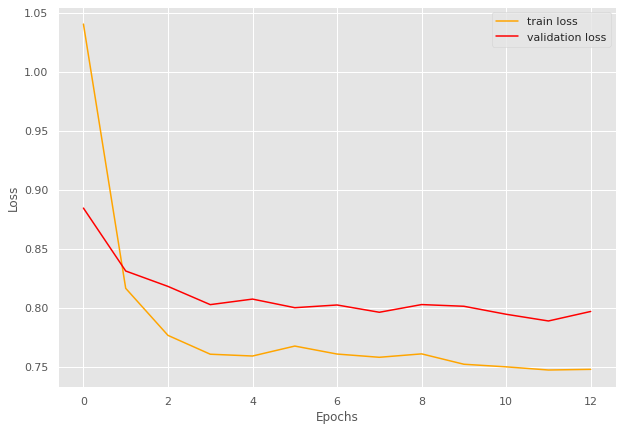

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 19 Epoch 1
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.34batch/s, loss=1.22]


train loss 1.2197458914348058, validation loss 1.0412160158157349, validation accuracy 0.78125
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.34batch/s, loss=0.883]


train loss 0.8827548793384007, validation loss 0.8850421011447906, validation accuracy 0.8854166666666666
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.33batch/s, loss=0.807]


train loss 0.8067942772592817, validation loss 0.8464333117008209, validation accuracy 0.8854166666666666
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.32batch/s, loss=0.77] 


INFO: Early stopping counter 1 of 5
train loss 0.7695508599281311, validation loss 0.8496348559856415, validation accuracy 0.875
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.32batch/s, loss=0.771]


train loss 0.7707143936838422, validation loss 0.8389327526092529, validation accuracy 0.9166666666666666
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.28batch/s, loss=0.75] 


train loss 0.7500058668000358, validation loss 0.8380730450153351, validation accuracy 0.8958333333333334
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.33batch/s, loss=0.756]


train loss 0.7555100577218192, validation loss 0.8197653293609619, validation accuracy 0.9375
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.33batch/s, loss=0.751]


train loss 0.7513106209891183, validation loss 0.8079657554626465, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.11batch/s, loss=0.747]


train loss 0.7467369522367205, validation loss 0.8035134971141815, validation accuracy 0.9375
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.33batch/s, loss=0.748]


INFO: Early stopping counter 2 of 5
train loss 0.7478416987827846, validation loss 0.8044655025005341, validation accuracy 0.9375
Coarse label 19 Epoch 11
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.32batch/s, loss=0.76] 


INFO: Early stopping counter 3 of 5
train loss 0.7601332323891776, validation loss 0.8083348274230957, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 12
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.26batch/s, loss=0.769]


INFO: Early stopping counter 4 of 5
train loss 0.7685501745768956, validation loss 0.8175002038478851, validation accuracy 0.9270833333333334
Coarse label 19 Epoch 13
-------------------------------


100%|██████████| 7/7 [00:02<00:00,  3.12batch/s, loss=0.788]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.860733695652174 and loss 0.8792618850003118


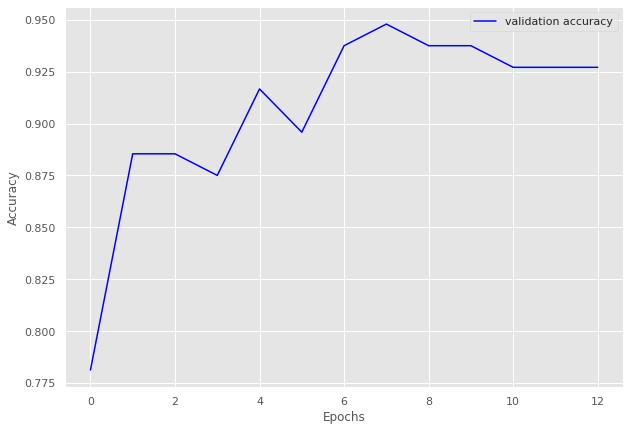

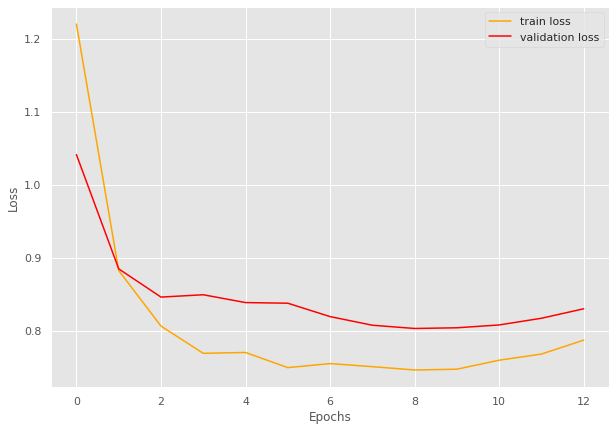

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Evaluating fine model 0
Evaluating fine model 1
Evaluating fine model 2
Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16
Evaluating fine model 17
Evaluating fine model 19
overall accuracy  is 0.7527133011170086
{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.93423053527980

Calculating for volume 35
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=1.14]


train loss 1.135062905346475, validation loss 0.9835003955023629, validation accuracy 0.9207459207459208
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=0.955]


INFO: Early stopping counter 1 of 5
train loss 0.9552048372059334, validation loss 0.989257446357182, validation accuracy 0.916083916083916
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.96batch/s, loss=0.951]


INFO: Early stopping counter 2 of 5
train loss 0.9506444204144362, validation loss 0.9835100940295628, validation accuracy 0.9207459207459208
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.93batch/s, loss=0.935]


train loss 0.9352422065851165, validation loss 0.9773849248886108, validation accuracy 0.9254079254079254
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.931]


train loss 0.9306924750165242, validation loss 0.9596004911831447, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=0.933]


INFO: Early stopping counter 3 of 5
train loss 0.9327411956903411, validation loss 0.964398341519492, validation accuracy 0.9393939393939394
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.90batch/s, loss=0.928]


INFO: Early stopping counter 4 of 5
train loss 0.928478742518076, validation loss 0.9618911828313556, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=0.922]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.949288256227758 and loss 0.9540580775250088


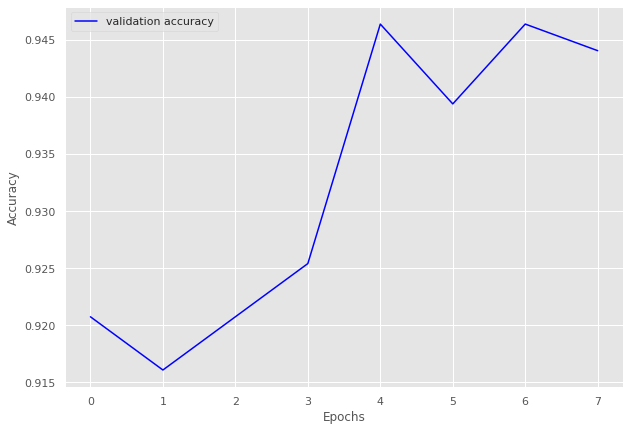

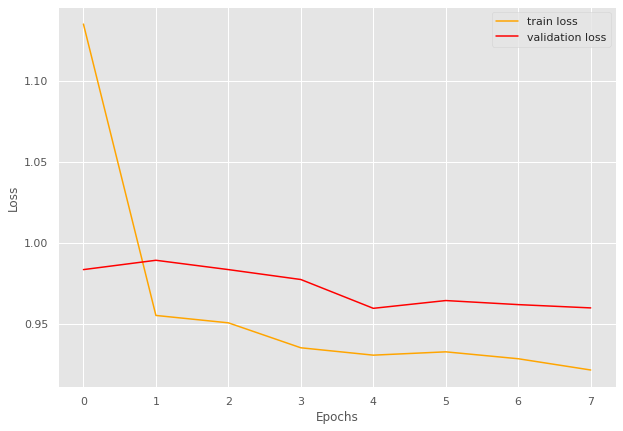

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 1 Epoch 1
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.00batch/s, loss=1.37]


train loss 1.369940009382036, validation loss 1.1738238334655762, validation accuracy 0.8924731182795699
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.96batch/s, loss=1.11]


train loss 1.1099861595365736, validation loss 1.1238837242126465, validation accuracy 0.9193548387096774
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.88batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0733743442429438, validation loss 1.1273127396901448, validation accuracy 0.9193548387096774
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.99batch/s, loss=1.07]


train loss 1.068138149049547, validation loss 1.1136345863342285, validation accuracy 0.9247311827956989
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.00batch/s, loss=1.06]


train loss 1.056908130645752, validation loss 1.1103534698486328, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.90batch/s, loss=1.05]


INFO: Early stopping counter 2 of 5
train loss 1.0529129571384854, validation loss 1.111844778060913, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.91batch/s, loss=1.05]


train loss 1.051794045501285, validation loss 1.102159857749939, validation accuracy 0.946236559139785
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.00batch/s, loss=1.05]


INFO: Early stopping counter 3 of 5
train loss 1.0532807442877028, validation loss 1.1078176895777385, validation accuracy 0.9354838709677419
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 18/18 [00:05<00:00,  3.00batch/s, loss=1.05]


train loss 1.0529575612809923, validation loss 1.1009010871251423, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 10
-------------------------------


100%|██████████| 18/18 [00:06<00:00,  2.99batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.0511879258685641, validation loss 1.107348918914795, validation accuracy 0.9301075268817204
Coarse label 1 Epoch 11
-------------------------------


100%|██████████| 18/18 [00:11<00:00,  1.63batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9591336330200245 and loss 1.0868832881634052


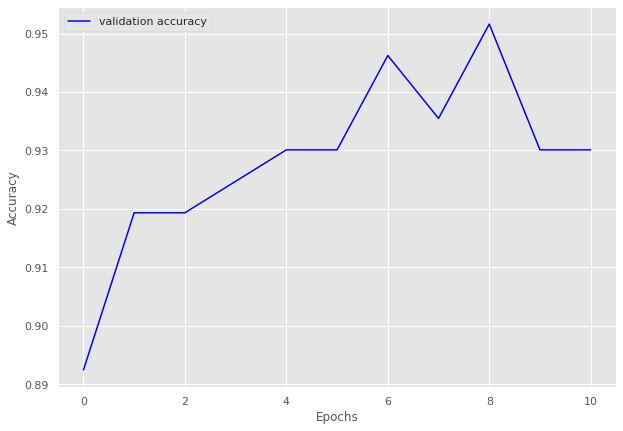

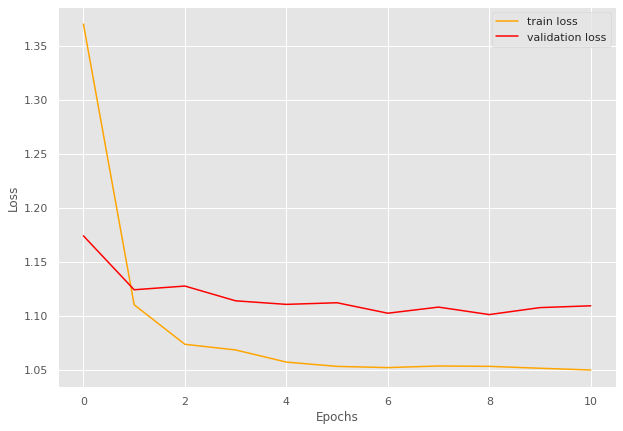

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 2 Epoch 1
-------------------------------


100%|██████████| 83/83 [00:53<00:00,  1.54batch/s, loss=1.73]


train loss 1.7266173592532974, validation loss 1.5596625804901123, validation accuracy 0.9091954022988505
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 83/83 [01:00<00:00,  1.38batch/s, loss=1.54]


train loss 1.5378924349704421, validation loss 1.5515124116625105, validation accuracy 0.9114942528735632
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 83/83 [00:58<00:00,  1.42batch/s, loss=1.52]


train loss 1.5207889726363033, validation loss 1.5388707433428084, validation accuracy 0.9252873563218391
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.94batch/s, loss=1.51]


train loss 1.5093340931168522, validation loss 1.529382356575557, validation accuracy 0.9298850574712644
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.94batch/s, loss=1.5] 


INFO: Early stopping counter 1 of 5
train loss 1.502934119787561, validation loss 1.5336978690964835, validation accuracy 0.9264367816091954
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.89batch/s, loss=1.5] 


train loss 1.4973334275096295, validation loss 1.5226910710334778, validation accuracy 0.9413793103448276
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.93batch/s, loss=1.49]


INFO: Early stopping counter 2 of 5
train loss 1.4927253780594791, validation loss 1.5302711299487524, validation accuracy 0.9344827586206896
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.95batch/s, loss=1.49]


INFO: Early stopping counter 3 of 5
train loss 1.487656952386879, validation loss 1.5262604355812073, validation accuracy 0.9367816091954023
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.93batch/s, loss=1.49]


INFO: Early stopping counter 4 of 5
train loss 1.4852462331932712, validation loss 1.528442919254303, validation accuracy 0.9333333333333333
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 83/83 [00:28<00:00,  2.92batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9373684210526316 and loss 1.5240690801396717


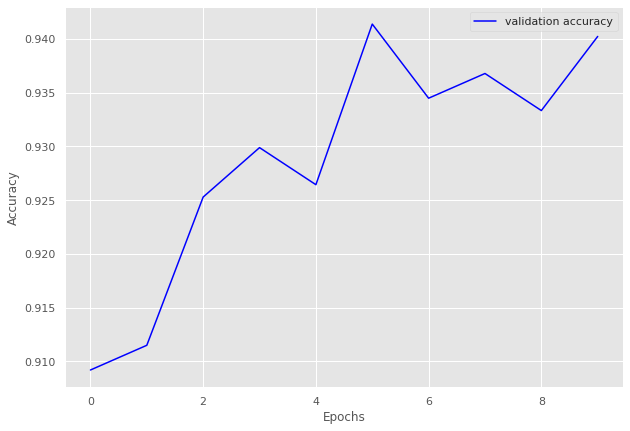

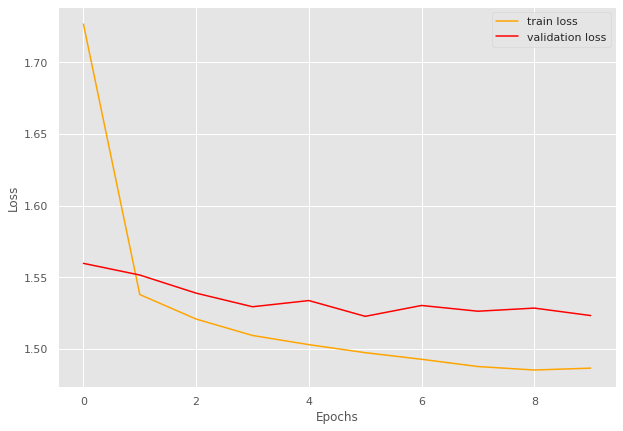

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9373684210526316
Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.35]


train loss 1.3452274921612861, validation loss 1.1861824137823922, validation accuracy 0.8543689320388349
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.12]


train loss 1.1245791912078857, validation loss 1.1461351428713118, validation accuracy 0.8980582524271845
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.94batch/s, loss=1.09]


train loss 1.0928297715309339, validation loss 1.1309479815619332, validation accuracy 0.9029126213592233
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.98batch/s, loss=1.09]


train loss 1.086143291913546, validation loss 1.1152984414781844, validation accuracy 0.9199029126213593
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.0802289858842506, validation loss 1.121873140335083, validation accuracy 0.9150485436893204
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.07]


train loss 1.0697450668383868, validation loss 1.105215106691633, validation accuracy 0.9393203883495146
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.94batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0667755542657313, validation loss 1.1134673357009888, validation accuracy 0.9223300970873787
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.97batch/s, loss=1.06]


train loss 1.0639789624091907, validation loss 1.1047758715493339, validation accuracy 0.9320388349514563
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0615147260519175, validation loss 1.1187068394252233, validation accuracy 0.9271844660194175
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.96batch/s, loss=1.06]


train loss 1.0611251378670716, validation loss 1.1003692490713937, validation accuracy 0.9368932038834952
Coarse label 4 Epoch 11
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0617881463124201, validation loss 1.1034000601087297, validation accuracy 0.9368932038834952
Coarse label 4 Epoch 12
-------------------------------


100%|██████████| 39/39 [00:13<00:00,  2.99batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9368029739776952 and loss 1.1070102158714743


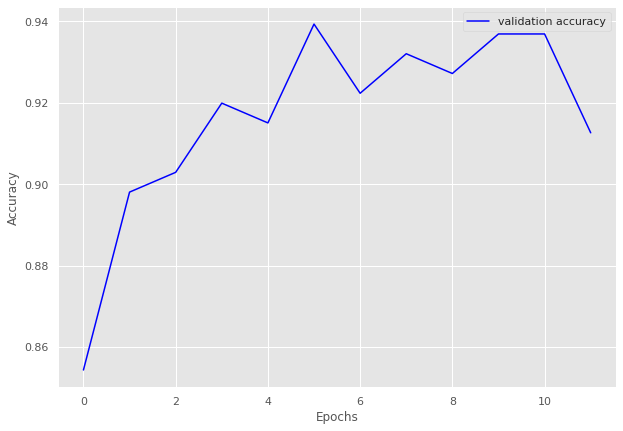

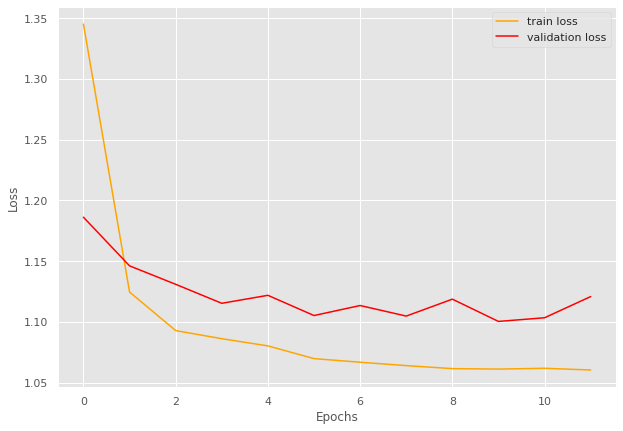

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.94batch/s, loss=0.423]


train loss 0.42273946007092794, validation loss 0.3415690064430237, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.94batch/s, loss=0.323]


INFO: Early stopping counter 1 of 5
train loss 0.32269920110702516, validation loss 0.3435775438944499, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.93batch/s, loss=0.318]


INFO: Early stopping counter 2 of 5
train loss 0.317927082379659, validation loss 0.3419704536596934, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.93batch/s, loss=0.32] 


INFO: Early stopping counter 3 of 5
train loss 0.3195435583591461, validation loss 0.34774861733118695, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.93batch/s, loss=0.318]


train loss 0.3178753932317098, validation loss 0.3389037648836772, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.95batch/s, loss=0.319]


INFO: Early stopping counter 4 of 5
train loss 0.3190076033274333, validation loss 0.3403806984424591, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.86batch/s, loss=0.321]


train loss 0.3207308709621429, validation loss 0.33241995175679523, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 15/15 [00:05<00:00,  2.93batch/s, loss=0.318]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9754571703561117 and loss 0.3388702923601324


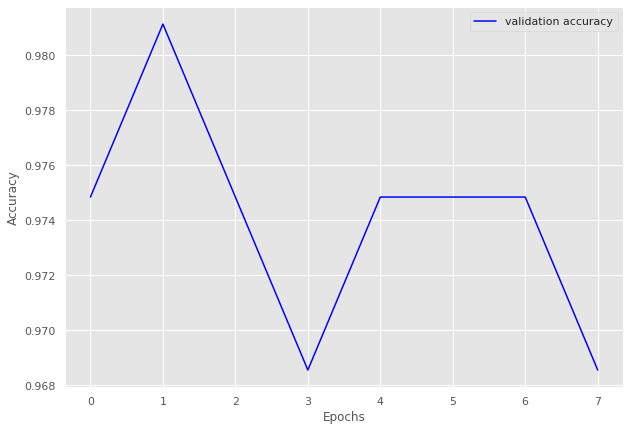

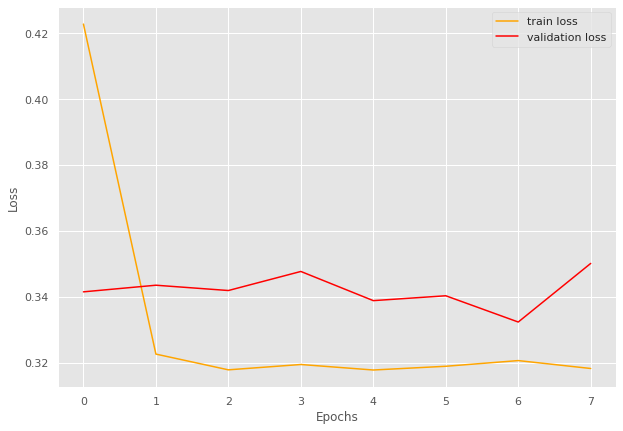

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.95batch/s, loss=1.4] 


train loss 1.4044110612435774, validation loss 1.242370069026947, validation accuracy 0.9224137931034483
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.95batch/s, loss=1.24]


train loss 1.2380225577137687, validation loss 1.2274468839168549, validation accuracy 0.9375
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.94batch/s, loss=1.22]


INFO: Early stopping counter 1 of 5
train loss 1.2189541079781272, validation loss 1.2281581461429596, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.95batch/s, loss=1.21]


INFO: Early stopping counter 2 of 5
train loss 1.2064730606295846, validation loss 1.2331777960062027, validation accuracy 0.9288793103448276
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 44/44 [00:15<00:00,  2.93batch/s, loss=1.21]


INFO: Early stopping counter 3 of 5
train loss 1.2060071419585834, validation loss 1.2314323335886002, validation accuracy 0.9396551724137931
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.96batch/s, loss=1.19]


train loss 1.1944504651156338, validation loss 1.2265756726264954, validation accuracy 0.9353448275862069
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 44/44 [00:15<00:00,  2.93batch/s, loss=1.19]


train loss 1.1876593313433907, validation loss 1.210373431444168, validation accuracy 0.9504310344827587
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.98batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1906321184201674, validation loss 1.2498618513345718, validation accuracy 0.9137931034482759
Coarse label 6 Epoch 9
-------------------------------


100%|██████████| 44/44 [00:14<00:00,  2.95batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9380866128766672 and loss 1.2286878309751812


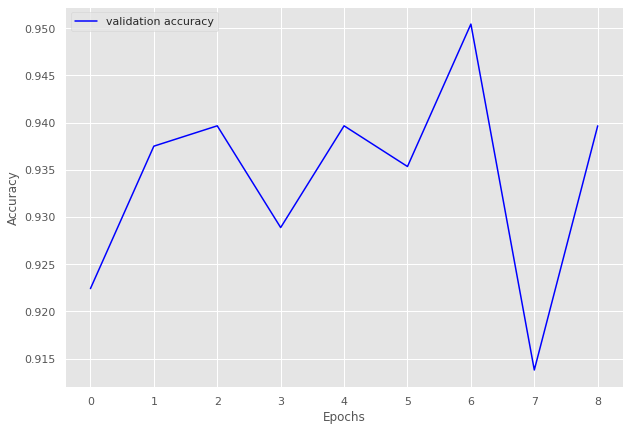

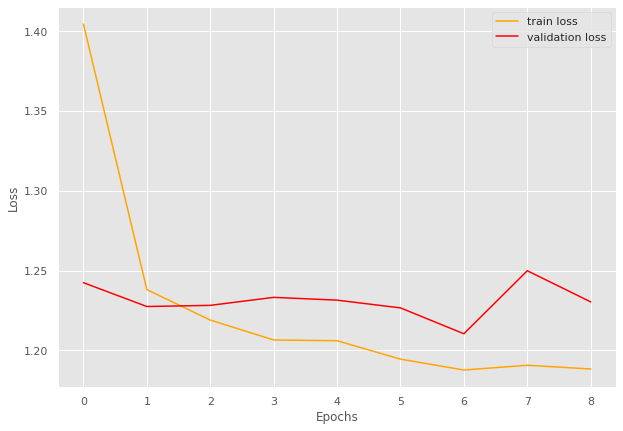

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.94batch/s, loss=0.89] 


train loss 0.8901882171630859, validation loss 0.7929817835489908, validation accuracy 0.953168044077135
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.95batch/s, loss=0.772]


train loss 0.7722248945917402, validation loss 0.7838218907515208, validation accuracy 0.9559228650137741
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.95batch/s, loss=0.771]


train loss 0.7706927503858294, validation loss 0.7788549164930979, validation accuracy 0.9614325068870524
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.97batch/s, loss=0.76] 


train loss 0.7598509022167751, validation loss 0.7744440535704294, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.95batch/s, loss=0.755]


train loss 0.7552811929157802, validation loss 0.7734325329462687, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.99batch/s, loss=0.757]


INFO: Early stopping counter 1 of 5
train loss 0.7571005123002189, validation loss 0.7814181645711263, validation accuracy 0.9559228650137741
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.94batch/s, loss=0.755]


train loss 0.7546157445226397, validation loss 0.7731012602647146, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 35/35 [00:12<00:00,  2.80batch/s, loss=0.754]


train loss 0.7543592504092625, validation loss 0.7695924242337545, validation accuracy 0.9724517906336089
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.98batch/s, loss=0.754]


train loss 0.7542031730924333, validation loss 0.7656562129656473, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 10
-------------------------------


100%|██████████| 35/35 [00:12<00:00,  2.86batch/s, loss=0.748]


INFO: Early stopping counter 2 of 5
train loss 0.7480397990771702, validation loss 0.7746438185373942, validation accuracy 0.9696969696969697
Coarse label 7 Epoch 11
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.95batch/s, loss=0.749]


INFO: Early stopping counter 3 of 5
train loss 0.7487955689430237, validation loss 0.7695915897687277, validation accuracy 0.9724517906336089
Coarse label 7 Epoch 12
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.95batch/s, loss=0.75] 


INFO: Early stopping counter 4 of 5
train loss 0.7503091182027545, validation loss 0.7711004515488943, validation accuracy 0.9669421487603306
Coarse label 7 Epoch 13
-------------------------------


100%|██████████| 35/35 [00:11<00:00,  2.99batch/s, loss=0.756]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9682305912055544 and loss 0.7746635802586873


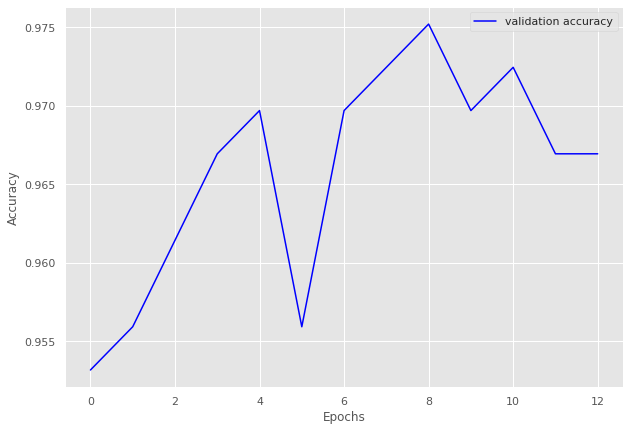

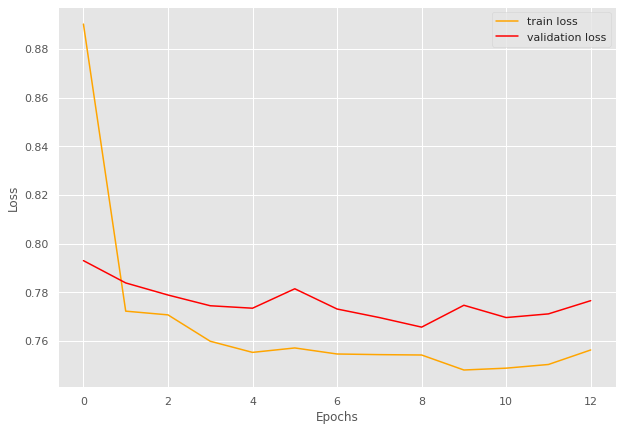

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=1.46]


train loss 1.455826457665891, validation loss 1.2599221020936966, validation accuracy 0.9217221135029354
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.96batch/s, loss=1.25]


train loss 1.2450196986295738, validation loss 1.2364465445280075, validation accuracy 0.9354207436399217
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.97batch/s, loss=1.22]


INFO: Early stopping counter 1 of 5
train loss 1.218639291062647, validation loss 1.238513857126236, validation accuracy 0.9217221135029354
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.93batch/s, loss=1.22]


train loss 1.2189404526535346, validation loss 1.2333070188760757, validation accuracy 0.9334637964774951
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.92batch/s, loss=1.21]


train loss 1.2092680833777603, validation loss 1.2207221984863281, validation accuracy 0.9510763209393346
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 49/49 [00:17<00:00,  2.88batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.199952415057591, validation loss 1.2240809202194214, validation accuracy 0.9432485322896281
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1923273947774147, validation loss 1.2238617688417435, validation accuracy 0.9393346379647749
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=1.19]


train loss 1.1929392279410849, validation loss 1.2162009477615356, validation accuracy 0.949119373776908
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.97batch/s, loss=1.19]


train loss 1.1927127594850502, validation loss 1.2089268118143082, validation accuracy 0.9608610567514677
Coarse label 8 Epoch 10
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1916760887418474, validation loss 1.2203863561153412, validation accuracy 0.9471624266144814
Coarse label 8 Epoch 11
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.93batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9399430882132694 and loss 1.2253858702523368


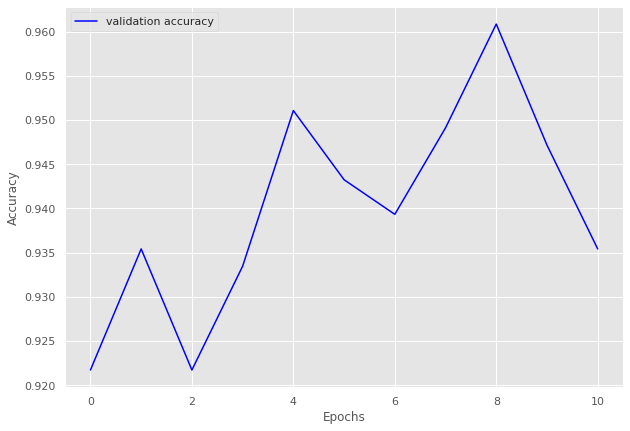

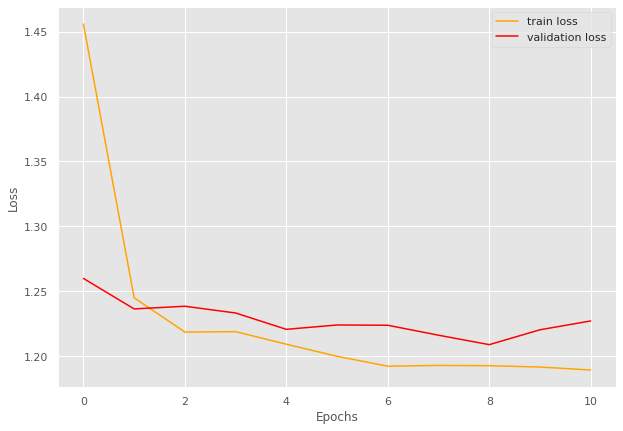

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 61/61 [00:25<00:00,  2.37batch/s, loss=1.73]


train loss 1.732342993626829, validation loss 1.6383907036347822, validation accuracy 0.8842592592592593
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.87batch/s, loss=1.55]


train loss 1.547317885961689, validation loss 1.5786947987296365, validation accuracy 0.9135802469135802
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.89batch/s, loss=1.52]


train loss 1.518852427357533, validation loss 1.5616622404618696, validation accuracy 0.9274691358024691
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.89batch/s, loss=1.5] 


train loss 1.5041815452888363, validation loss 1.5421988638964566, validation accuracy 0.9351851851851852
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 61/61 [00:20<00:00,  2.91batch/s, loss=1.49]


train loss 1.4938615247851512, validation loss 1.5331226804039695, validation accuracy 0.9398148148148148
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.90batch/s, loss=1.49]


train loss 1.4916634833226439, validation loss 1.5314987681128762, validation accuracy 0.9367283950617284
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.89batch/s, loss=1.49]


train loss 1.4878184932177183, validation loss 1.5247599970210681, validation accuracy 0.9351851851851852
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.89batch/s, loss=1.48]


INFO: Early stopping counter 1 of 5
train loss 1.4811912462359569, validation loss 1.531078652902083, validation accuracy 0.9382716049382716
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.89batch/s, loss=1.48]


INFO: Early stopping counter 2 of 5
train loss 1.4809572677143286, validation loss 1.5288442373275757, validation accuracy 0.9367283950617284
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.89batch/s, loss=1.48]


INFO: Early stopping counter 3 of 5
train loss 1.478504870758682, validation loss 1.541011712767861, validation accuracy 0.9351851851851852
Coarse label 9 Epoch 11
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.90batch/s, loss=1.48]


INFO: Early stopping counter 4 of 5
train loss 1.4784843374471195, validation loss 1.5452239188280972, validation accuracy 0.9290123456790124
Coarse label 9 Epoch 12
-------------------------------


100%|██████████| 61/61 [00:21<00:00,  2.88batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9433538315988647 and loss 1.5190504681795163


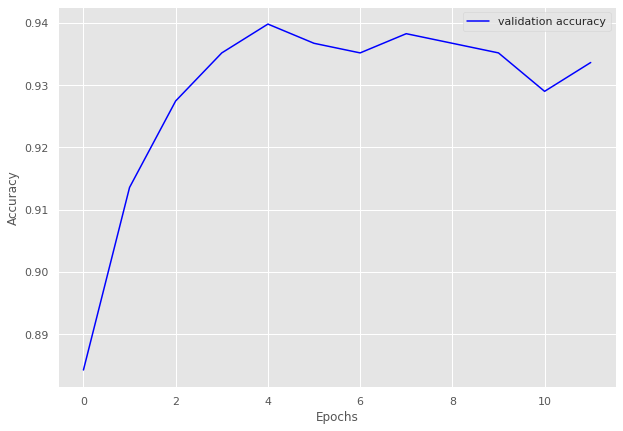

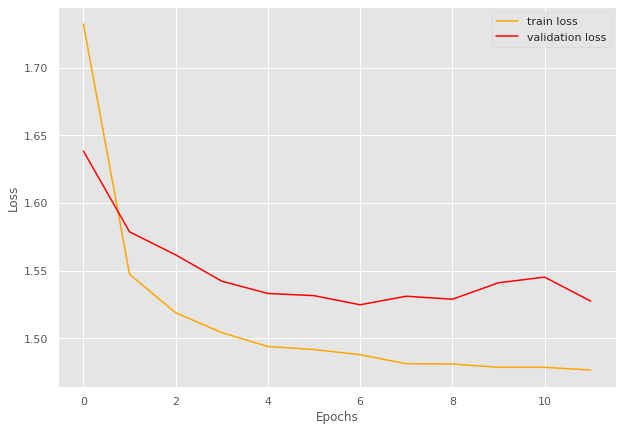

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.94batch/s, loss=0.916]


train loss 0.9155204912711834, validation loss 0.7851717829704284, validation accuracy 0.9605263157894737
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.90batch/s, loss=0.766]


train loss 0.7661510089348103, validation loss 0.7760854959487915, validation accuracy 0.9703947368421053
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 29/29 [00:09<00:00,  2.94batch/s, loss=0.76] 


train loss 0.759545019988356, validation loss 0.7627962350845336, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 29/29 [00:13<00:00,  2.13batch/s, loss=0.756]


INFO: Early stopping counter 1 of 5
train loss 0.75597600895783, validation loss 0.7794188737869263, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 29/29 [00:18<00:00,  1.56batch/s, loss=0.755]


INFO: Early stopping counter 2 of 5
train loss 0.7546384519544141, validation loss 0.7634235978126526, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 29/29 [00:17<00:00,  1.68batch/s, loss=0.75] 


train loss 0.7503881187274538, validation loss 0.7626332998275757, validation accuracy 0.9802631578947368
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 29/29 [00:20<00:00,  1.43batch/s, loss=0.752]


INFO: Early stopping counter 3 of 5
train loss 0.7515772868847025, validation loss 0.7644649863243103, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 29/29 [00:22<00:00,  1.30batch/s, loss=0.75] 


INFO: Early stopping counter 4 of 5
train loss 0.7502536917554921, validation loss 0.7698403358459472, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 9
-------------------------------


100%|██████████| 29/29 [00:20<00:00,  1.45batch/s, loss=0.75] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9701455092824887 and loss 0.7726678999643477


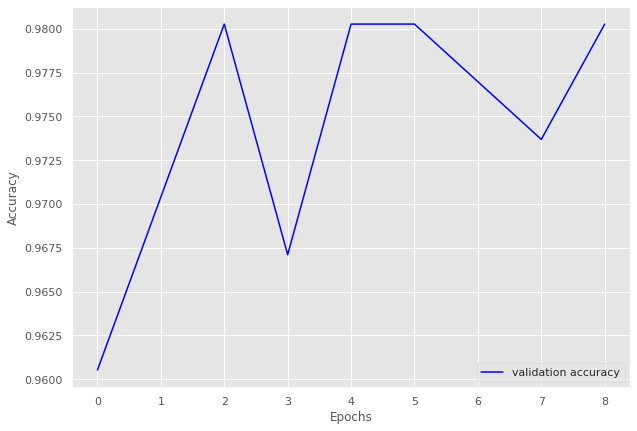

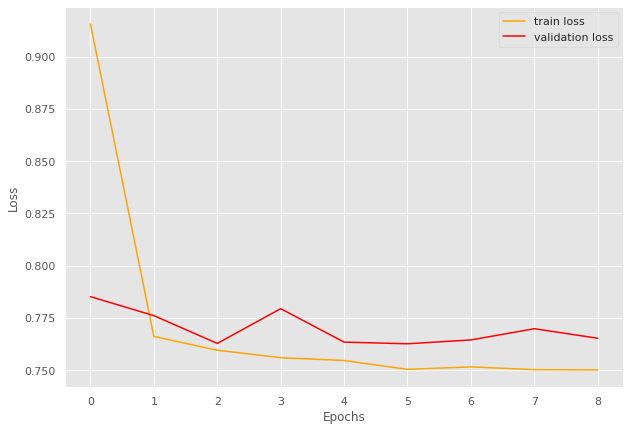

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 28/28 [00:24<00:00,  1.13batch/s, loss=1.4] 


train loss 1.3977793540273393, validation loss 1.176773190498352, validation accuracy 0.8758620689655172
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:22<00:00,  1.23batch/s, loss=1.13]


train loss 1.1333294212818146, validation loss 1.127756953239441, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:16<00:00,  1.71batch/s, loss=1.09]


INFO: Early stopping counter 1 of 5
train loss 1.094713066305433, validation loss 1.1282896757125855, validation accuracy 0.9172413793103448
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=1.08]


train loss 1.0833235595907484, validation loss 1.1260084629058837, validation accuracy 0.9103448275862069
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0743354899542672, validation loss 1.1261730432510375, validation accuracy 0.9172413793103448
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.01batch/s, loss=1.08]


train loss 1.076714622122901, validation loss 1.1047592639923096, validation accuracy 0.9448275862068966
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.83batch/s, loss=1.07]


train loss 1.0700025047574724, validation loss 1.1009052276611329, validation accuracy 0.9413793103448276
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.98batch/s, loss=1.07]


INFO: Early stopping counter 3 of 5
train loss 1.071843079158238, validation loss 1.1181517124176026, validation accuracy 0.9172413793103448
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.82batch/s, loss=1.08]


INFO: Early stopping counter 4 of 5
train loss 1.0786470302513667, validation loss 1.1025512218475342, validation accuracy 0.9448275862068966
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  3.01batch/s, loss=1.08]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9228548937286801 and loss 1.1214751780033112


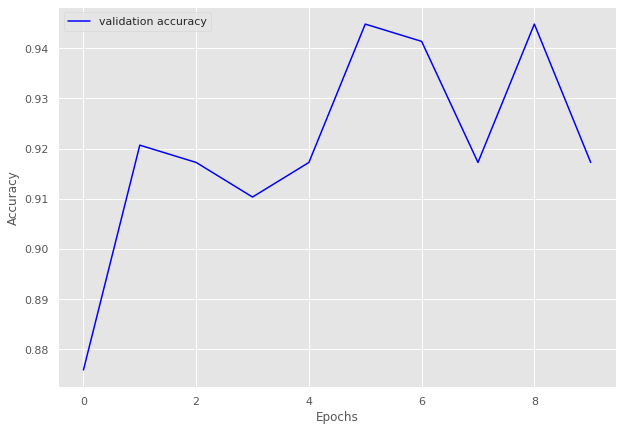

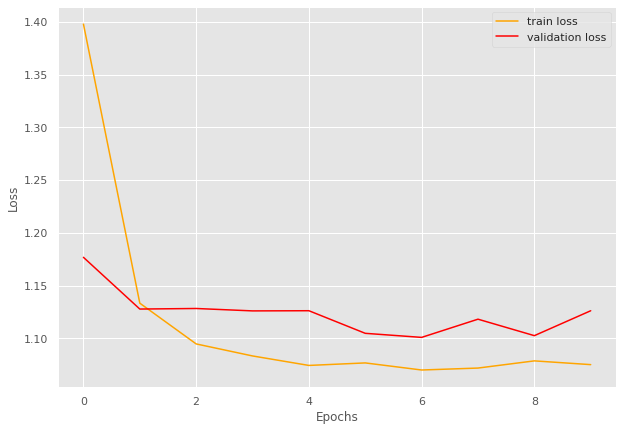

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.97batch/s, loss=0.713]


train loss 0.713046624660492, validation loss 0.6159733653068542, validation accuracy 0.9227799227799228
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.99batch/s, loss=0.602]


train loss 0.6021821331977845, validation loss 0.6005826592445374, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.97batch/s, loss=0.58] 


train loss 0.579776873588562, validation loss 0.5925200700759887, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.94batch/s, loss=0.575]


train loss 0.5749743413925171, validation loss 0.5835206031799316, validation accuracy 0.9613899613899614
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.99batch/s, loss=0.57] 


INFO: Early stopping counter 1 of 5
train loss 0.5696899795532226, validation loss 0.593923008441925, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.97batch/s, loss=0.567]


INFO: Early stopping counter 2 of 5
train loss 0.5669476890563965, validation loss 0.5985830307006836, validation accuracy 0.9382239382239382
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.97batch/s, loss=0.57] 


INFO: Early stopping counter 3 of 5
train loss 0.5699225831031799, validation loss 0.5906069159507752, validation accuracy 0.9575289575289575
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.00batch/s, loss=0.562]


INFO: Early stopping counter 4 of 5
train loss 0.5623411893844604, validation loss 0.5903127551078796, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  3.00batch/s, loss=0.564]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9509166173861621 and loss 0.6014710552287552


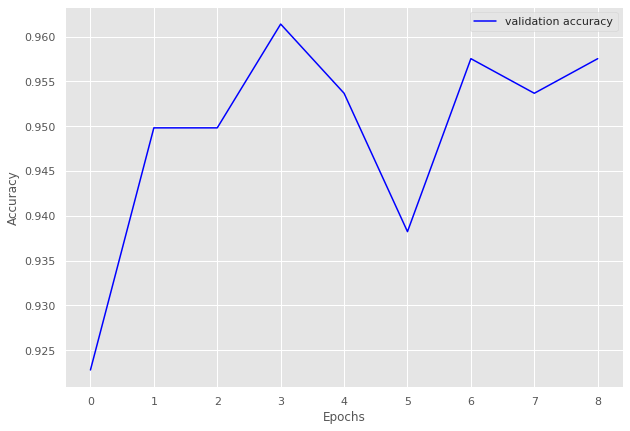

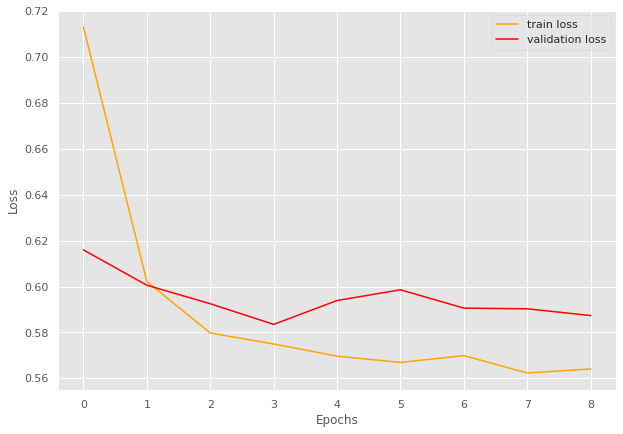

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.95batch/s, loss=1.23]


train loss 1.2296504569905145, validation loss 1.1007672786712646, validation accuracy 0.9444444444444444
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.92batch/s, loss=1.08]


train loss 1.0849790232522147, validation loss 1.0805844902992248, validation accuracy 0.9646464646464646
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.92batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0693089195660181, validation loss 1.0816329002380372, validation accuracy 0.9595959595959596
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.94batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.065911244068827, validation loss 1.0808459997177124, validation accuracy 0.9612794612794613
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.91batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0617975379739488, validation loss 1.0830321669578553, validation accuracy 0.9595959595959596
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.92batch/s, loss=1.06]


train loss 1.0601166146142142, validation loss 1.078499448299408, validation accuracy 0.9646464646464646
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.90batch/s, loss=1.06]


train loss 1.0580738144261497, validation loss 1.0765353441238403, validation accuracy 0.968013468013468
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.92batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0616048212562288, validation loss 1.0847450494766235, validation accuracy 0.9528619528619529
Coarse label 14 Epoch 9
-------------------------------


100%|██████████| 56/56 [00:19<00:00,  2.90batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9552892668470558 and loss 1.0875984381456845


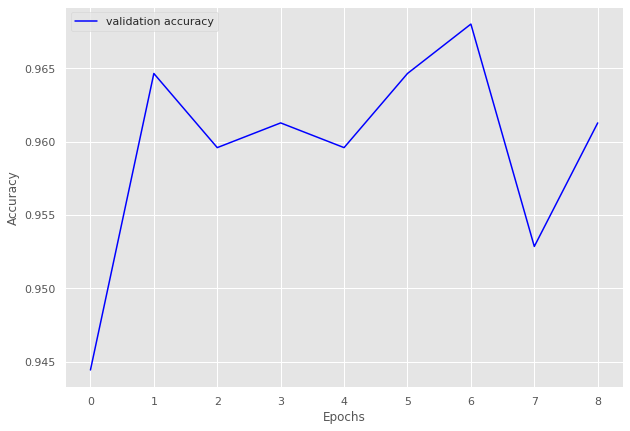

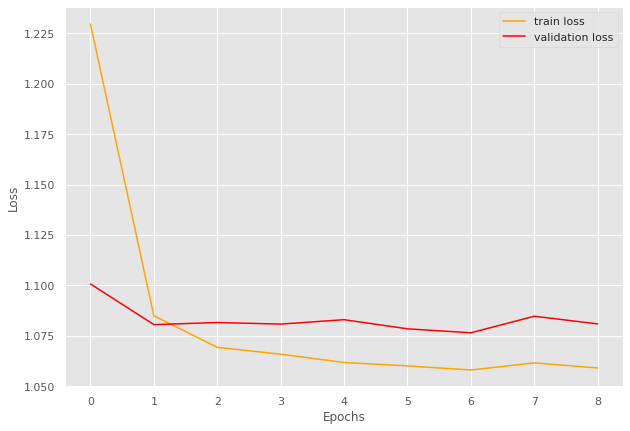

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=0.965]


train loss 0.9654434365885598, validation loss 0.7863511681556702, validation accuracy 0.95578231292517
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=0.78] 


train loss 0.7797598732369286, validation loss 0.7747001767158508, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=0.771]


INFO: Early stopping counter 1 of 5
train loss 0.7713575256722314, validation loss 0.7775494694709778, validation accuracy 0.9625850340136054
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.99batch/s, loss=0.764]


INFO: Early stopping counter 2 of 5
train loss 0.763686043875558, validation loss 0.7806878447532654, validation accuracy 0.9659863945578231
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.97batch/s, loss=0.757]


INFO: Early stopping counter 3 of 5
train loss 0.7566166009221759, validation loss 0.7808704257011414, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=0.752]


train loss 0.7522706453289304, validation loss 0.7708621263504029, validation accuracy 0.9761904761904762
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.94batch/s, loss=0.753]


train loss 0.7526835650205612, validation loss 0.7707995533943176, validation accuracy 0.9795918367346939
Coarse label 15 Epoch 8
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.93batch/s, loss=0.751]


train loss 0.7508264460733959, validation loss 0.7682672142982483, validation accuracy 0.9795918367346939
Coarse label 15 Epoch 9
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.96batch/s, loss=0.751]


INFO: Early stopping counter 4 of 5
train loss 0.7507546097040176, validation loss 0.7723800063133239, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 10
-------------------------------


100%|██████████| 28/28 [00:09<00:00,  2.94batch/s, loss=0.751]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9574856546687532 and loss 0.7845685700575511


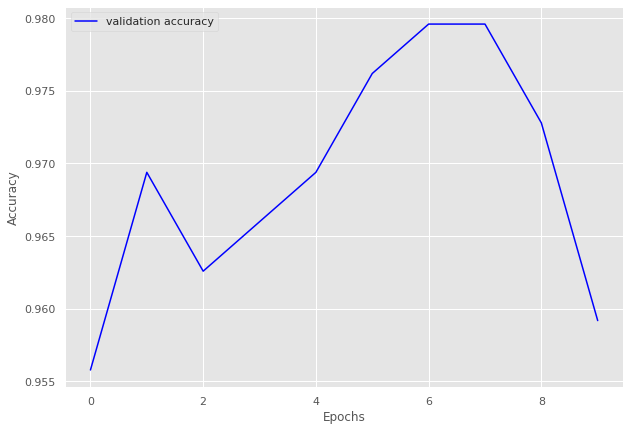

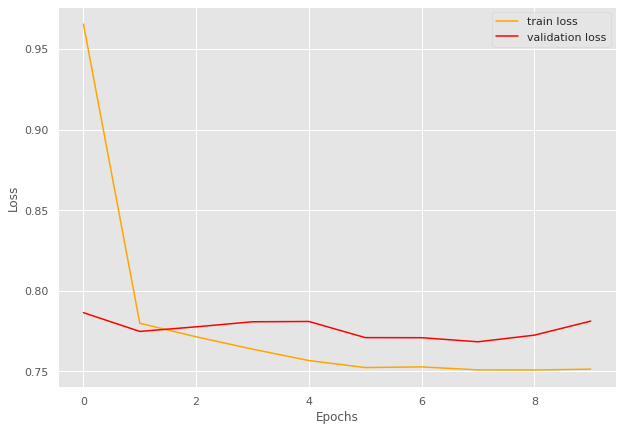

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.96batch/s, loss=0.704]


train loss 0.704162511560652, validation loss 0.6169556379318237, validation accuracy 0.9290780141843972
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.97batch/s, loss=0.578]


train loss 0.5780713823106554, validation loss 0.5974714279174804, validation accuracy 0.950354609929078
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.92batch/s, loss=0.57] 


train loss 0.570174429151747, validation loss 0.5795818209648133, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.96batch/s, loss=0.562]


INFO: Early stopping counter 1 of 5
train loss 0.5621638121428313, validation loss 0.5844764590263367, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.97batch/s, loss=0.561]


INFO: Early stopping counter 2 of 5
train loss 0.5605416165457832, validation loss 0.5818097352981567, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.97batch/s, loss=0.562]


INFO: Early stopping counter 3 of 5
train loss 0.5622261917149579, validation loss 0.5806706309318542, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.97batch/s, loss=0.558]


INFO: Early stopping counter 4 of 5
train loss 0.5583743298495257, validation loss 0.5956173539161682, validation accuracy 0.9574468085106383
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 27/27 [00:09<00:00,  2.99batch/s, loss=0.557]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9589562381081815 and loss 0.591747163698591


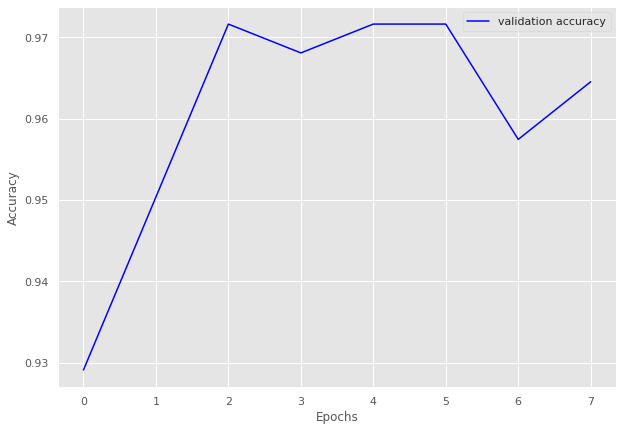

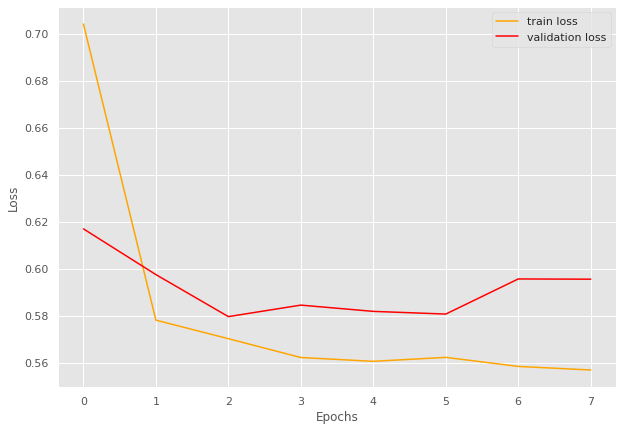

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 17 Epoch 1
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=0.984]


train loss 0.9838294684886932, validation loss 0.8443463444709778, validation accuracy 0.8932038834951457
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.01batch/s, loss=0.8]  


train loss 0.8004130601882935, validation loss 0.7899914383888245, validation accuracy 0.9579288025889967
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=0.788]


INFO: Early stopping counter 1 of 5
train loss 0.7884432156880696, validation loss 0.7950838685035706, validation accuracy 0.948220064724919
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.02batch/s, loss=0.776]


INFO: Early stopping counter 2 of 5
train loss 0.7757975041866303, validation loss 0.803114378452301, validation accuracy 0.941747572815534
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.03batch/s, loss=0.798]


INFO: Early stopping counter 3 of 5
train loss 0.7982174575328826, validation loss 0.8112226605415345, validation accuracy 0.9288025889967637
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.00batch/s, loss=0.786]


INFO: Early stopping counter 4 of 5
train loss 0.7859437068303426, validation loss 0.8051072239875794, validation accuracy 0.9385113268608414
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=0.767]


train loss 0.767376301685969, validation loss 0.7891858220100403, validation accuracy 0.9514563106796117
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:09<00:00,  3.00batch/s, loss=0.763]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9449404761904762 and loss 0.7983753179746961


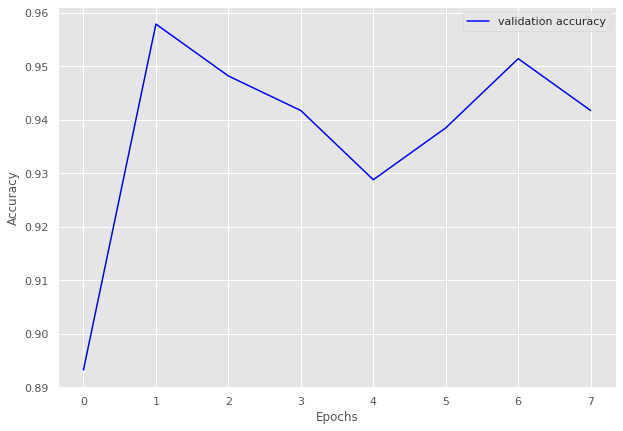

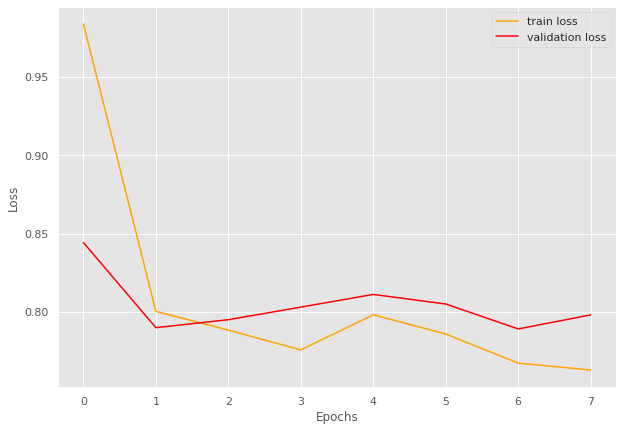

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 19 Epoch 1
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=1.15]


train loss 1.1458747744560243, validation loss 0.8793601393699646, validation accuracy 0.8958333333333334
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.16batch/s, loss=0.819]


train loss 0.818965482711792, validation loss 0.8313564658164978, validation accuracy 0.90625
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.765]


train loss 0.7650211036205292, validation loss 0.8022609353065491, validation accuracy 0.96875
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.05batch/s, loss=0.751]


INFO: Early stopping counter 1 of 5
train loss 0.7508886158466339, validation loss 0.8034469485282898, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.756]


INFO: Early stopping counter 2 of 5
train loss 0.7564776122570038, validation loss 0.8111222386360168, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.747]


train loss 0.7471156716346741, validation loss 0.800312876701355, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.06batch/s, loss=0.769]


INFO: Early stopping counter 3 of 5
train loss 0.7689991235733032, validation loss 0.8039308190345764, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.22batch/s, loss=0.754]


INFO: Early stopping counter 4 of 5
train loss 0.7535448908805847, validation loss 0.8019315898418427, validation accuracy 0.9479166666666666
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.19batch/s, loss=0.766]


train loss 0.7659873962402344, validation loss 0.7980184257030487, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 10/10 [00:03<00:00,  3.18batch/s, loss=0.761]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9318181818181818 and loss 0.8163015216588974


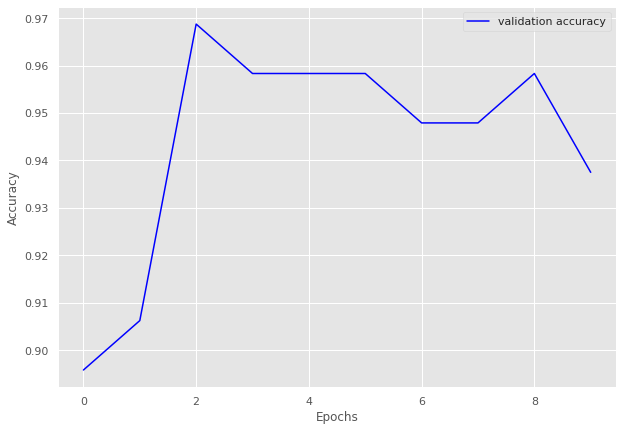

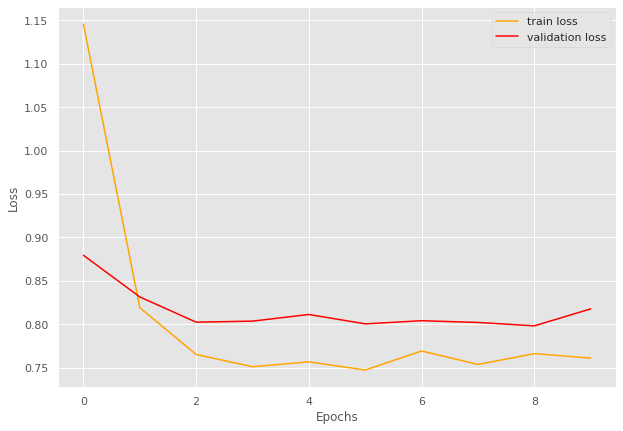

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Evaluating fine model 0
Evaluating fine model 1
Evaluating fine model 2
Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16
Evaluating fine model 17
Evaluating fine model 19
overall accuracy  is 0.7948222874704384
{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.93423053527980

Calculating for volume 55
Coarse label 0 Epoch 1
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.91batch/s, loss=1.07]


train loss 1.0652179744313746, validation loss 0.9616374288286481, validation accuracy 0.9393939393939394
Coarse label 0 Epoch 2
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.95batch/s, loss=0.956]


train loss 0.9557067646699793, validation loss 0.9539654936109271, validation accuracy 0.9463869463869464
Coarse label 0 Epoch 3
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.941]


train loss 0.9410671425216338, validation loss 0.9406261188643319, validation accuracy 0.9627039627039627
Coarse label 0 Epoch 4
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.88batch/s, loss=0.939]


INFO: Early stopping counter 1 of 5
train loss 0.9385801553726196, validation loss 0.9504618644714355, validation accuracy 0.958041958041958
Coarse label 0 Epoch 5
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.92batch/s, loss=0.933]


INFO: Early stopping counter 2 of 5
train loss 0.932706792564953, validation loss 0.9690948298999241, validation accuracy 0.9370629370629371
Coarse label 0 Epoch 6
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.938]


INFO: Early stopping counter 3 of 5
train loss 0.9383269241627525, validation loss 0.9441037092890058, validation accuracy 0.9603729603729604
Coarse label 0 Epoch 7
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.936]


INFO: Early stopping counter 4 of 5
train loss 0.9358045765582252, validation loss 0.9447093265397208, validation accuracy 0.9603729603729604
Coarse label 0 Epoch 8
-------------------------------


100%|██████████| 68/68 [00:23<00:00,  2.93batch/s, loss=0.932]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.954276907269458 and loss 0.9492845652533359


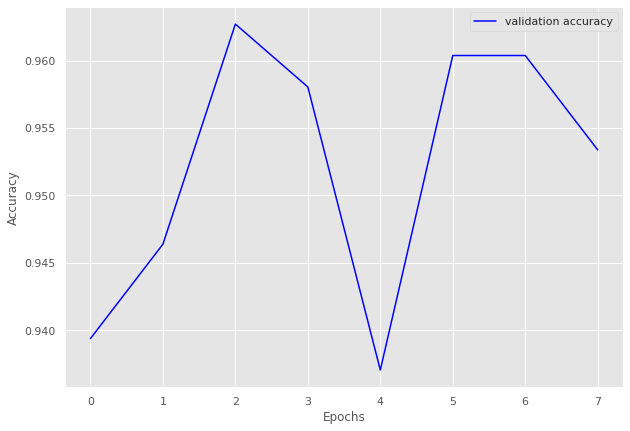

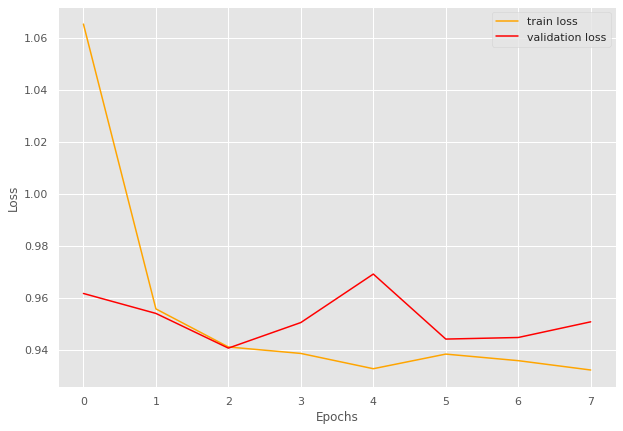

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 1 Epoch 1
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.94batch/s, loss=1.28]


train loss 1.2795607924461365, validation loss 1.1387858390808105, validation accuracy 0.9086021505376344
Coarse label 1 Epoch 2
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.98batch/s, loss=1.09]


train loss 1.0939622163772582, validation loss 1.1072322924931843, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 3
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.97batch/s, loss=1.07]


train loss 1.0725650588671367, validation loss 1.1067746480305989, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 4
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.95batch/s, loss=1.07]


train loss 1.0713081200917562, validation loss 1.0810415347417195, validation accuracy 0.967741935483871
Coarse label 1 Epoch 5
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 1 of 5
train loss 1.0615706086158752, validation loss 1.0925318400065105, validation accuracy 0.9516129032258065
Coarse label 1 Epoch 6
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 2 of 5
train loss 1.0613895297050475, validation loss 1.1018307606379192, validation accuracy 0.9408602150537635
Coarse label 1 Epoch 7
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.95batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0570716460545857, validation loss 1.0833431879679363, validation accuracy 0.9623655913978495
Coarse label 1 Epoch 8
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.97batch/s, loss=1.05]


INFO: Early stopping counter 4 of 5
train loss 1.050902815659841, validation loss 1.093851089477539, validation accuracy 0.946236559139785
Coarse label 1 Epoch 9
-------------------------------


100%|██████████| 30/30 [00:10<00:00,  2.95batch/s, loss=1.05]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9551886792452831 and loss 1.087005619649534


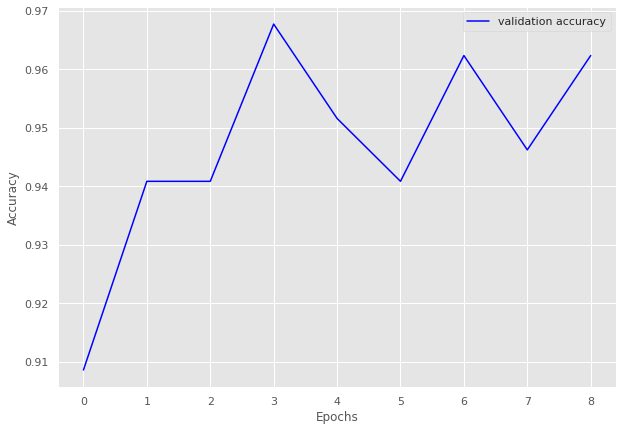

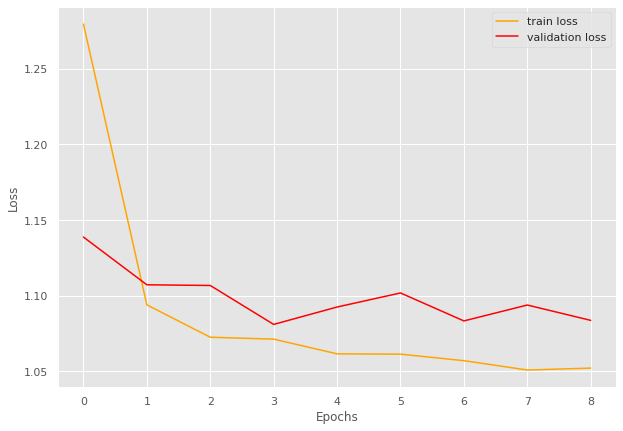

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 2 Epoch 1
-------------------------------


100%|██████████| 137/137 [00:52<00:00,  2.63batch/s, loss=1.66]


train loss 1.6610283338240464, validation loss 1.5308779648372106, validation accuracy 0.9344827586206896
Coarse label 2 Epoch 2
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.53]


train loss 1.5327139353230053, validation loss 1.522761012826647, validation accuracy 0.9413793103448276
Coarse label 2 Epoch 3
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.90batch/s, loss=1.52]


train loss 1.5155624769029825, validation loss 1.5175608907427107, validation accuracy 0.9482758620689655
Coarse label 2 Epoch 4
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.90batch/s, loss=1.51]


INFO: Early stopping counter 1 of 5
train loss 1.5085405929245217, validation loss 1.5221620883260454, validation accuracy 0.9436781609195403
Coarse label 2 Epoch 5
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.5]


INFO: Early stopping counter 2 of 5
train loss 1.5003567907932032, validation loss 1.5213484253202165, validation accuracy 0.9425287356321839
Coarse label 2 Epoch 6
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.89batch/s, loss=1.5]


INFO: Early stopping counter 3 of 5
train loss 1.5019708080013303, validation loss 1.521054208278656, validation accuracy 0.9402298850574713
Coarse label 2 Epoch 7
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.49]


train loss 1.4946189422677034, validation loss 1.5089426721845354, validation accuracy 0.9540229885057471
Coarse label 2 Epoch 8
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.91batch/s, loss=1.49]


INFO: Early stopping counter 4 of 5
train loss 1.4920592255835985, validation loss 1.512564241886139, validation accuracy 0.9494252873563218
Coarse label 2 Epoch 9
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.90batch/s, loss=1.49]


train loss 1.4888870402844283, validation loss 1.5065681764057703, validation accuracy 0.9563218390804598
Coarse label 2 Epoch 10
-------------------------------


100%|██████████| 137/137 [00:47<00:00,  2.90batch/s, loss=1.49]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9519827695426327 and loss 1.5097848340388267


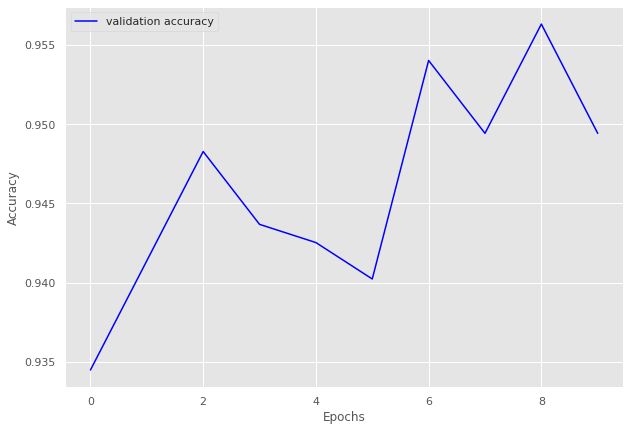

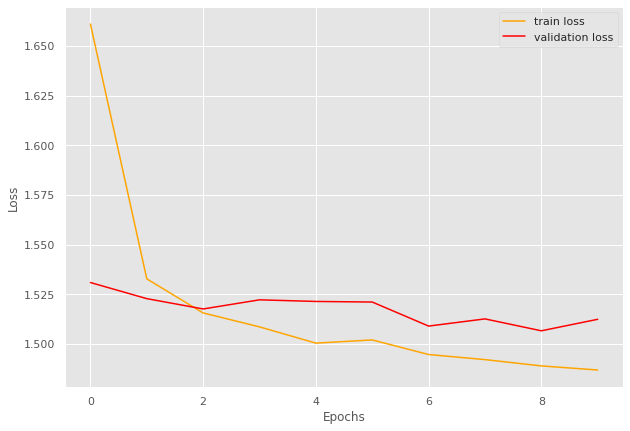

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 4 Epoch 1
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.98batch/s, loss=1.26]


train loss 1.258406349328848, validation loss 1.1258627346583776, validation accuracy 0.9247572815533981
Coarse label 4 Epoch 2
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.86batch/s, loss=1.11]


train loss 1.1069647513903105, validation loss 1.0950649976730347, validation accuracy 0.9514563106796117
Coarse label 4 Epoch 3
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.94batch/s, loss=1.08]


train loss 1.0840820165780873, validation loss 1.088877899306161, validation accuracy 0.9563106796116505
Coarse label 4 Epoch 4
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.08]


train loss 1.0790756408984845, validation loss 1.0816232306616647, validation accuracy 0.9611650485436893
Coarse label 4 Epoch 5
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.07]


INFO: Early stopping counter 1 of 5
train loss 1.0712779980439406, validation loss 1.083067195756095, validation accuracy 0.9635922330097088
Coarse label 4 Epoch 6
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.07]


train loss 1.0722202337705171, validation loss 1.0732874018805367, validation accuracy 0.970873786407767
Coarse label 4 Epoch 7
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.95batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.067603901716379, validation loss 1.075377651623317, validation accuracy 0.9684466019417476
Coarse label 4 Epoch 8
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.97batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0647590728906484, validation loss 1.073647447994777, validation accuracy 0.9684466019417476
Coarse label 4 Epoch 9
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.06]


train loss 1.0643257709649894, validation loss 1.0670315878731864, validation accuracy 0.9733009708737864
Coarse label 4 Epoch 10
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.92batch/s, loss=1.06]


train loss 1.0594733935136063, validation loss 1.0618799243654524, validation accuracy 0.9830097087378641
Coarse label 4 Epoch 11
-------------------------------


100%|██████████| 65/65 [00:21<00:00,  2.96batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0635737584187435, validation loss 1.0757306984492712, validation accuracy 0.9660194174757282
Coarse label 4 Epoch 12
-------------------------------


100%|██████████| 65/65 [00:22<00:00,  2.94batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9661926482425544 and loss 1.0788408255172988


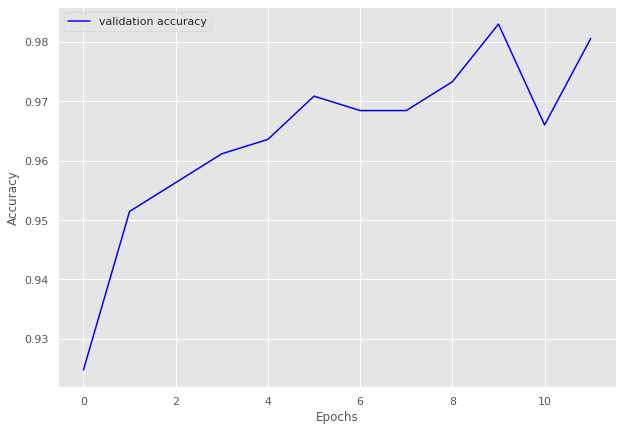

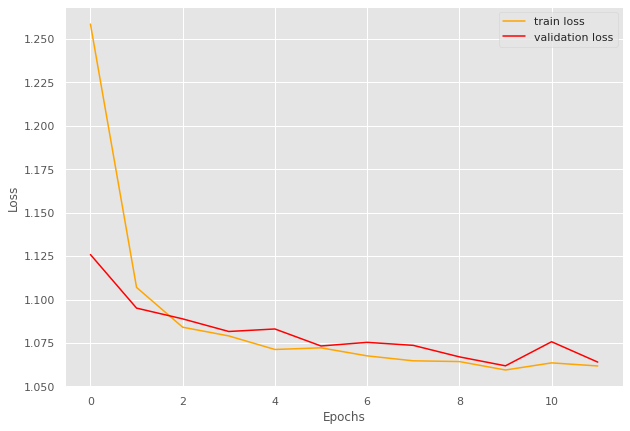

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 5 Epoch 1
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.91batch/s, loss=0.397]


train loss 0.39667011141777037, validation loss 0.3362916012605031, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 2
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.90batch/s, loss=0.333]


train loss 0.33340274572372436, validation loss 0.33588560422261554, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 3
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.94batch/s, loss=0.33] 


train loss 0.3297590327262878, validation loss 0.3344120681285858, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 4
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.89batch/s, loss=0.322]


train loss 0.32180166244506836, validation loss 0.3331216176350911, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 5
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.93batch/s, loss=0.324]


train loss 0.3241212809085846, validation loss 0.3305377662181854, validation accuracy 0.9811320754716981
Coarse label 5 Epoch 6
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.95batch/s, loss=0.323]


INFO: Early stopping counter 1 of 5
train loss 0.3226816999912262, validation loss 0.34093716740608215, validation accuracy 0.9685534591194969
Coarse label 5 Epoch 7
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.89batch/s, loss=0.321]


INFO: Early stopping counter 2 of 5
train loss 0.3209569776058197, validation loss 0.33333157499631244, validation accuracy 0.9748427672955975
Coarse label 5 Epoch 8
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.95batch/s, loss=0.319]


train loss 0.3193179976940155, validation loss 0.320120632648468, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 9
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.88batch/s, loss=0.318]


INFO: Early stopping counter 3 of 5
train loss 0.31796462297439576, validation loss 0.3223658303419749, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 10
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.87batch/s, loss=0.319]


train loss 0.3187445867061615, validation loss 0.3197688162326813, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 11
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.89batch/s, loss=0.318]


train loss 0.31775026440620424, validation loss 0.31914061307907104, validation accuracy 0.9937106918238994
Coarse label 5 Epoch 12
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.91batch/s, loss=0.317]


INFO: Early stopping counter 4 of 5
train loss 0.3167049312591553, validation loss 0.3226396044095357, validation accuracy 0.9874213836477987
Coarse label 5 Epoch 13
-------------------------------


100%|██████████| 25/25 [00:08<00:00,  2.90batch/s, loss=0.316]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9867963863794301 and loss 0.3260222064412158


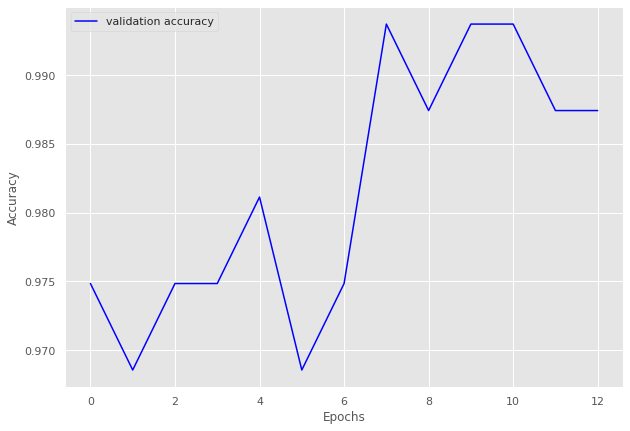

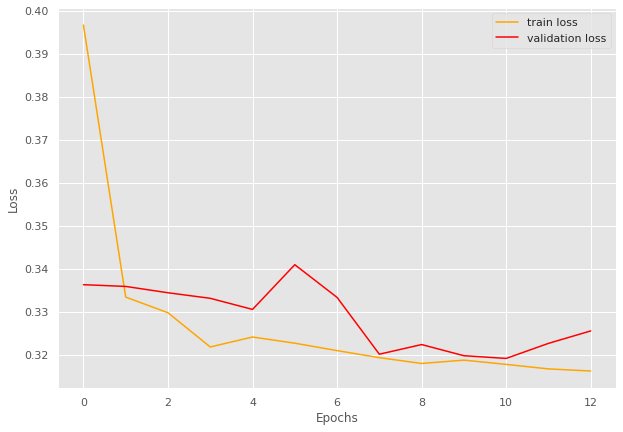

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 6 Epoch 1
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.93batch/s, loss=1.34]


train loss 1.3438979958834714, validation loss 1.2408427447080612, validation accuracy 0.915948275862069
Coarse label 6 Epoch 2
-------------------------------


100%|██████████| 73/73 [00:25<00:00,  2.88batch/s, loss=1.23]


INFO: Early stopping counter 1 of 5
train loss 1.2302528162525124, validation loss 1.2410420626401901, validation accuracy 0.9181034482758621
Coarse label 6 Epoch 3
-------------------------------


100%|██████████| 73/73 [00:25<00:00,  2.91batch/s, loss=1.22]


train loss 1.2175529231763866, validation loss 1.2293215543031693, validation accuracy 0.9310344827586207
Coarse label 6 Epoch 4
-------------------------------


100%|██████████| 73/73 [00:25<00:00,  2.90batch/s, loss=1.21]


train loss 1.2067221566422346, validation loss 1.2181199789047241, validation accuracy 0.9439655172413793
Coarse label 6 Epoch 5
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.93batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.203882388872643, validation loss 1.22573521733284, validation accuracy 0.9353448275862069
Coarse label 6 Epoch 6
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.94batch/s, loss=1.2] 


INFO: Early stopping counter 3 of 5
train loss 1.1988870819954023, validation loss 1.2200801223516464, validation accuracy 0.9375
Coarse label 6 Epoch 7
-------------------------------


100%|██████████| 73/73 [00:25<00:00,  2.88batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1933793417394978, validation loss 1.225990653038025, validation accuracy 0.9353448275862069
Coarse label 6 Epoch 8
-------------------------------


100%|██████████| 73/73 [00:24<00:00,  2.96batch/s, loss=1.19]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9529131985731273 and loss 1.212884789163416


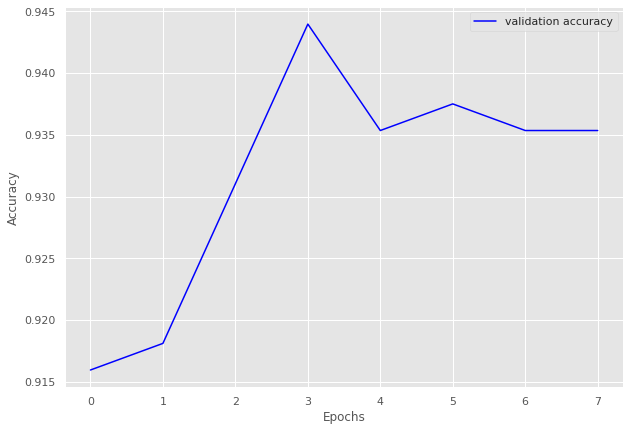

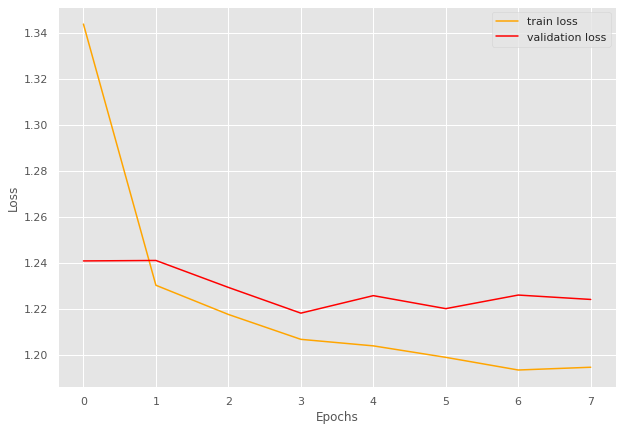

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 7 Epoch 1
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.94batch/s, loss=0.858]


train loss 0.8576588938976156, validation loss 0.7654308676719666, validation accuracy 0.9807162534435262
Coarse label 7 Epoch 2
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.97batch/s, loss=0.776]


INFO: Early stopping counter 1 of 5
train loss 0.7755542716075634, validation loss 0.7665345370769501, validation accuracy 0.9752066115702479
Coarse label 7 Epoch 3
-------------------------------


100%|██████████| 58/58 [00:19<00:00,  2.93batch/s, loss=0.774]


train loss 0.7744563355528075, validation loss 0.7626521388689677, validation accuracy 0.9834710743801653
Coarse label 7 Epoch 4
-------------------------------


100%|██████████| 58/58 [00:20<00:00,  2.89batch/s, loss=0.766]


train loss 0.7660136510585916, validation loss 0.7563387453556061, validation accuracy 0.9862258953168044
Coarse label 7 Epoch 5
-------------------------------


100%|██████████| 58/58 [00:30<00:00,  1.92batch/s, loss=0.764]


INFO: Early stopping counter 2 of 5
train loss 0.7638633220360197, validation loss 0.7574217816193899, validation accuracy 0.9862258953168044
Coarse label 7 Epoch 6
-------------------------------


100%|██████████| 58/58 [00:36<00:00,  1.57batch/s, loss=0.762]


INFO: Early stopping counter 3 of 5
train loss 0.7622108284769387, validation loss 0.7592423558235168, validation accuracy 0.9862258953168044
Coarse label 7 Epoch 7
-------------------------------


100%|██████████| 58/58 [00:45<00:00,  1.28batch/s, loss=0.755]


train loss 0.7545668380013828, validation loss 0.7556741635004679, validation accuracy 0.9862258953168044
Coarse label 7 Epoch 8
-------------------------------


100%|██████████| 58/58 [00:43<00:00,  1.32batch/s, loss=0.757]


INFO: Early stopping counter 4 of 5
train loss 0.7567402340214828, validation loss 0.7587436934312185, validation accuracy 0.9862258953168044
Coarse label 7 Epoch 9
-------------------------------


100%|██████████| 58/58 [00:45<00:00,  1.26batch/s, loss=0.756]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9811664641555286 and loss 0.7628750399901316


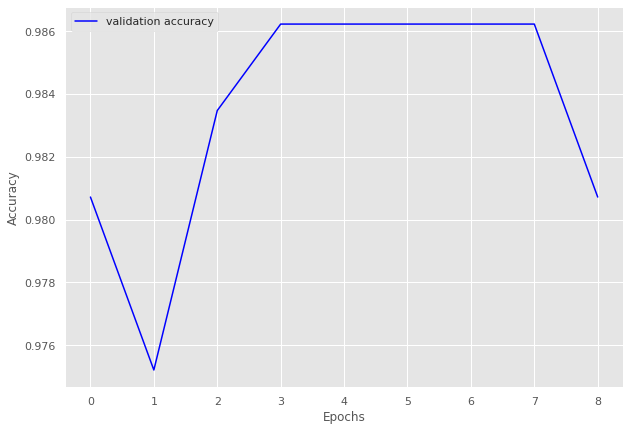

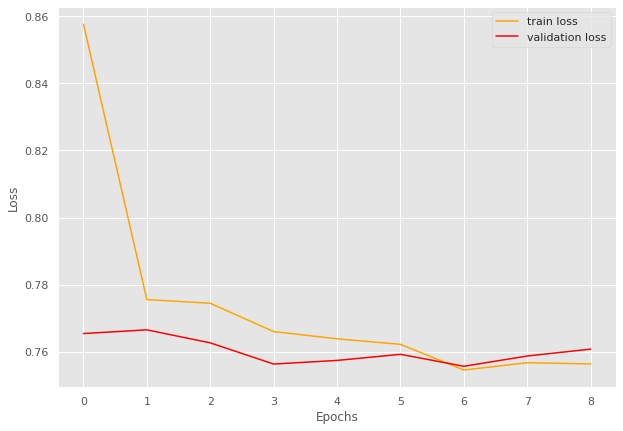

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 8 Epoch 1
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.37]


train loss 1.3670407357039276, validation loss 1.2390478551387787, validation accuracy 0.9256360078277887
Coarse label 8 Epoch 2
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.24]


train loss 1.239479215056808, validation loss 1.2265112102031708, validation accuracy 0.9412915851272016
Coarse label 8 Epoch 3
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.94batch/s, loss=1.22]


train loss 1.2150161369347279, validation loss 1.2027359753847122, validation accuracy 0.9628180039138943
Coarse label 8 Epoch 4
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.95batch/s, loss=1.21]


INFO: Early stopping counter 1 of 5
train loss 1.2084113536057648, validation loss 1.2080651372671127, validation accuracy 0.9569471624266145
Coarse label 8 Epoch 5
-------------------------------


100%|██████████| 81/81 [00:28<00:00,  2.88batch/s, loss=1.2]


train loss 1.1984099973866968, validation loss 1.1977559030056, validation accuracy 0.9706457925636007
Coarse label 8 Epoch 6
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.2] 


INFO: Early stopping counter 2 of 5
train loss 1.19810124679848, validation loss 1.2037437558174133, validation accuracy 0.9628180039138943
Coarse label 8 Epoch 7
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.92batch/s, loss=1.19]


INFO: Early stopping counter 3 of 5
train loss 1.1905217862423556, validation loss 1.20676489174366, validation accuracy 0.9569471624266145
Coarse label 8 Epoch 8
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.19]


INFO: Early stopping counter 4 of 5
train loss 1.1892910298006034, validation loss 1.2098343521356583, validation accuracy 0.9569471624266145
Coarse label 8 Epoch 9
-------------------------------


100%|██████████| 81/81 [00:27<00:00,  2.93batch/s, loss=1.2] 


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9455017301038062 and loss 1.2205866281300375


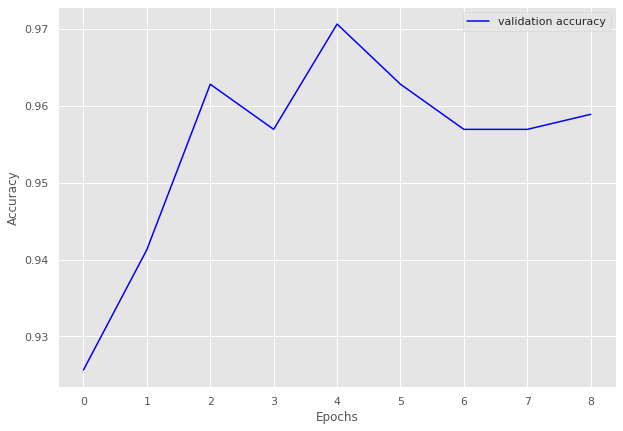

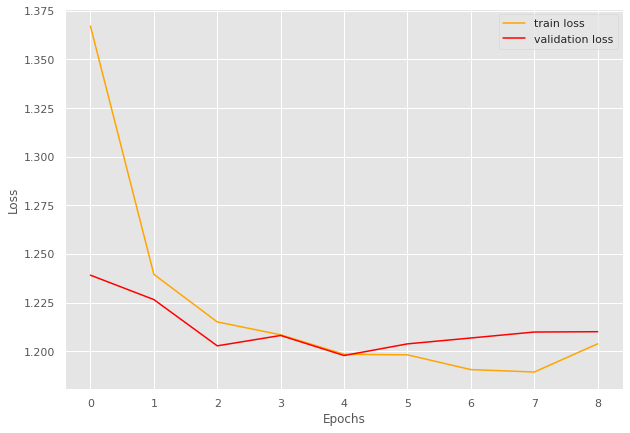

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9455017301038062
Coarse label 9 Epoch 1
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.66]


train loss 1.6629540908570384, validation loss 1.581606008789756, validation accuracy 0.8950617283950617
Coarse label 9 Epoch 2
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.89batch/s, loss=1.53]


train loss 1.5261420093330682, validation loss 1.5442932844161987, validation accuracy 0.9212962962962963
Coarse label 9 Epoch 3
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.90batch/s, loss=1.51]


INFO: Early stopping counter 1 of 5
train loss 1.5097627873514212, validation loss 1.5566523183475842, validation accuracy 0.9320987654320988
Coarse label 9 Epoch 4
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.89batch/s, loss=1.5]


INFO: Early stopping counter 2 of 5
train loss 1.4984995582524467, validation loss 1.562375166199424, validation accuracy 0.9151234567901234
Coarse label 9 Epoch 5
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.89batch/s, loss=1.49]


train loss 1.4928536193043578, validation loss 1.5289547660134055, validation accuracy 0.9444444444444444
Coarse label 9 Epoch 6
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.90batch/s, loss=1.5] 


INFO: Early stopping counter 3 of 5
train loss 1.4952168195855384, validation loss 1.5394547852602871, validation accuracy 0.9305555555555556
Coarse label 9 Epoch 7
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.91batch/s, loss=1.49]


INFO: Early stopping counter 4 of 5
train loss 1.4884905931996364, validation loss 1.53220242803747, validation accuracy 0.9367283950617284
Coarse label 9 Epoch 8
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.89batch/s, loss=1.49]


train loss 1.4852735540446114, validation loss 1.5237884738228538, validation accuracy 0.9475308641975309
Coarse label 9 Epoch 9
-------------------------------


100%|██████████| 102/102 [00:35<00:00,  2.89batch/s, loss=1.48]


train loss 1.4839140901378556, validation loss 1.5155310414054177, validation accuracy 0.9444444444444444
Coarse label 9 Epoch 10
-------------------------------


100%|██████████| 102/102 [00:40<00:00,  2.54batch/s, loss=1.48]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.95525956284153 and loss 1.5064600382162177


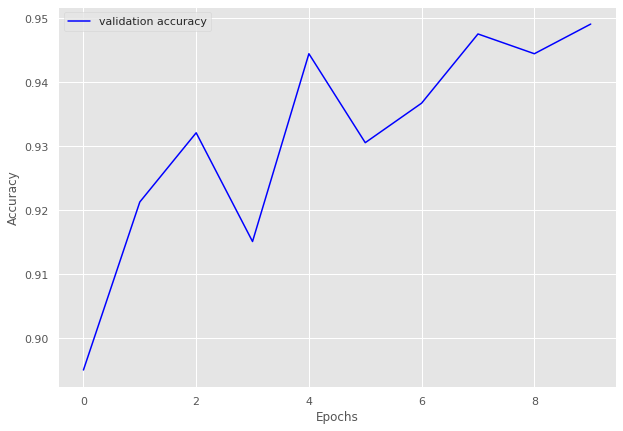

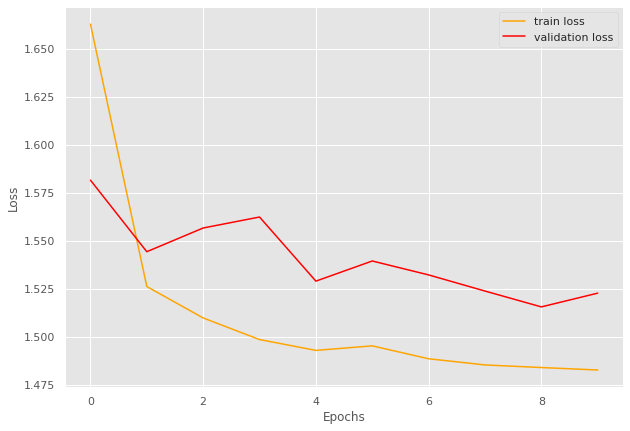

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 11 Epoch 1
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.91batch/s, loss=0.861]


train loss 0.8610061034560204, validation loss 0.7832846522331238, validation accuracy 0.9572368421052632
Coarse label 11 Epoch 2
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.90batch/s, loss=0.769]


train loss 0.7687221355736256, validation loss 0.7713356375694275, validation accuracy 0.9736842105263158
Coarse label 11 Epoch 3
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.91batch/s, loss=0.761]


INFO: Early stopping counter 1 of 5
train loss 0.7608779768149058, validation loss 0.7798972487449646, validation accuracy 0.9671052631578947
Coarse label 11 Epoch 4
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.87batch/s, loss=0.758]


train loss 0.7580572341879209, validation loss 0.7552743077278137, validation accuracy 0.9868421052631579
Coarse label 11 Epoch 5
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.89batch/s, loss=0.754]


INFO: Early stopping counter 2 of 5
train loss 0.7543755608300368, validation loss 0.7609895586967468, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 6
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.92batch/s, loss=0.755]


INFO: Early stopping counter 3 of 5
train loss 0.7550903297960758, validation loss 0.7674962162971497, validation accuracy 0.9769736842105263
Coarse label 11 Epoch 7
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.91batch/s, loss=0.75] 


INFO: Early stopping counter 4 of 5
train loss 0.7499949658910433, validation loss 0.7602211594581604, validation accuracy 0.9835526315789473
Coarse label 11 Epoch 8
-------------------------------


100%|██████████| 48/48 [00:16<00:00,  2.92batch/s, loss=0.749]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9797101449275363 and loss 0.762763418934562


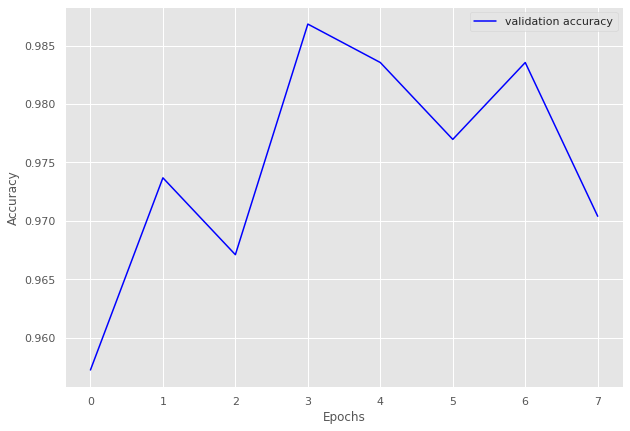

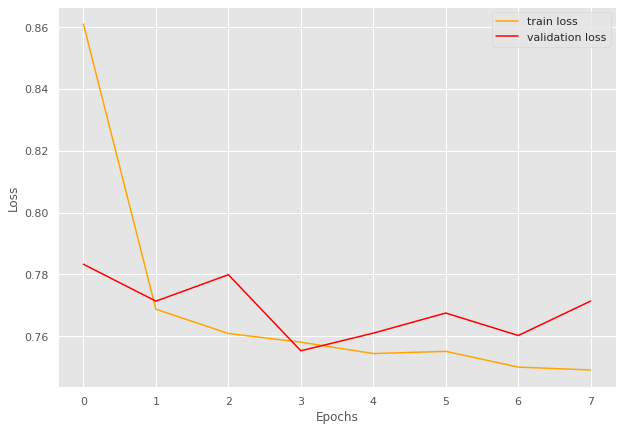

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 12 Epoch 1
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.98batch/s, loss=1.3] 


train loss 1.3011422779249109, validation loss 1.1434574604034424, validation accuracy 0.8931034482758621
Coarse label 12 Epoch 2
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.88batch/s, loss=1.12]


train loss 1.1195860297783562, validation loss 1.1168461322784424, validation accuracy 0.9275862068965517
Coarse label 12 Epoch 3
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.97batch/s, loss=1.1] 


train loss 1.0974506658056509, validation loss 1.1154595851898192, validation accuracy 0.9275862068965517
Coarse label 12 Epoch 4
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.93batch/s, loss=1.09]


INFO: Early stopping counter 1 of 5
train loss 1.0945520997047424, validation loss 1.11821129322052, validation accuracy 0.9206896551724137
Coarse label 12 Epoch 5
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.97batch/s, loss=1.09]


train loss 1.087938736314359, validation loss 1.1075146198272705, validation accuracy 0.9310344827586207
Coarse label 12 Epoch 6
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.96batch/s, loss=1.09]


train loss 1.0855261216992917, validation loss 1.0909118175506591, validation accuracy 0.9482758620689655
Coarse label 12 Epoch 7
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.95batch/s, loss=1.08]


INFO: Early stopping counter 2 of 5
train loss 1.0801571918570476, validation loss 1.0976929903030395, validation accuracy 0.9379310344827586
Coarse label 12 Epoch 8
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.98batch/s, loss=1.08]


INFO: Early stopping counter 3 of 5
train loss 1.080247630243716, validation loss 1.115085530281067, validation accuracy 0.9241379310344827
Coarse label 12 Epoch 9
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.97batch/s, loss=1.08]


INFO: Early stopping counter 4 of 5
train loss 1.0769264542538186, validation loss 1.1016819953918457, validation accuracy 0.9344827586206896
Coarse label 12 Epoch 10
-------------------------------


100%|██████████| 46/46 [00:15<00:00,  2.97batch/s, loss=1.08]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9382575757575757 and loss 1.1037831959270297


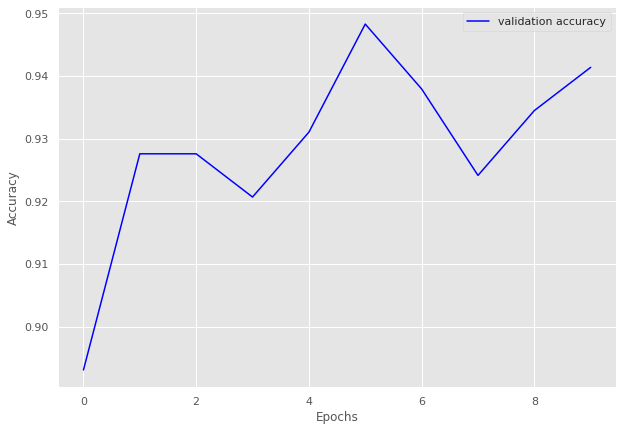

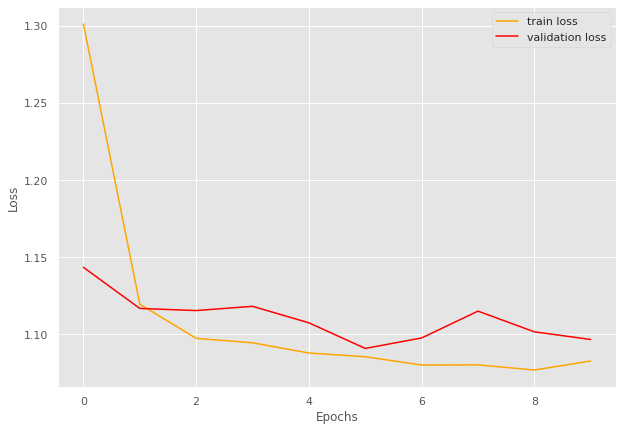

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9382575757575757
Coarse label 13 Epoch 1
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.685]


train loss 0.6848727362911876, validation loss 0.6650109052658081, validation accuracy 0.9266409266409267
Coarse label 13 Epoch 2
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.91batch/s, loss=0.598]


train loss 0.5976845011478518, validation loss 0.5902631044387817, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 3
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.587]


INFO: Early stopping counter 1 of 5
train loss 0.5870923545302414, validation loss 0.6032623291015625, validation accuracy 0.9420849420849421
Coarse label 13 Epoch 4
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.96batch/s, loss=0.578]


INFO: Early stopping counter 2 of 5
train loss 0.5781495905503994, validation loss 0.606996500492096, validation accuracy 0.9382239382239382
Coarse label 13 Epoch 5
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.573]


INFO: Early stopping counter 3 of 5
train loss 0.5729247535147318, validation loss 0.6033462643623352, validation accuracy 0.9498069498069498
Coarse label 13 Epoch 6
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.96batch/s, loss=0.569]


train loss 0.5693189676215009, validation loss 0.588907790184021, validation accuracy 0.9536679536679536
Coarse label 13 Epoch 7
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.94batch/s, loss=0.568]


train loss 0.5683920136312159, validation loss 0.5785137414932251, validation accuracy 0.9652509652509652
Coarse label 13 Epoch 8
-------------------------------


100%|██████████| 41/41 [00:14<00:00,  2.92batch/s, loss=0.57] 


INFO: Early stopping counter 4 of 5
train loss 0.5702072338360112, validation loss 0.5939497470855712, validation accuracy 0.9459459459459459
Coarse label 13 Epoch 9
-------------------------------


100%|██████████| 41/41 [00:13<00:00,  2.95batch/s, loss=0.575]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9564288765484835 and loss 0.5942602318686407


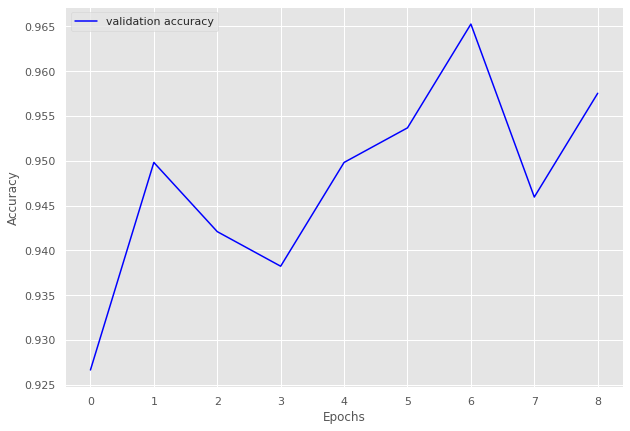

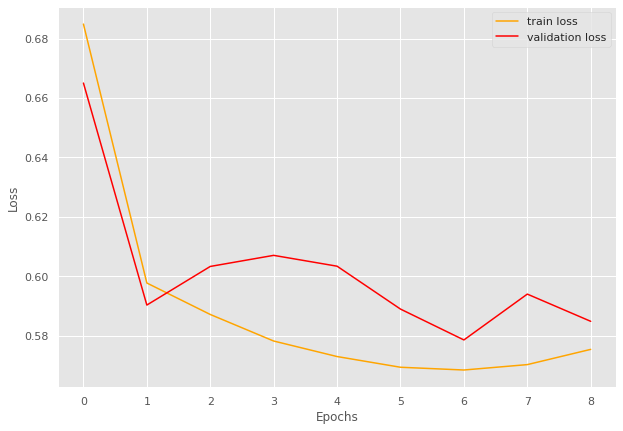

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 14 Epoch 1
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.17]


train loss 1.166932040072502, validation loss 1.07645024061203, validation accuracy 0.9663299663299664
Coarse label 14 Epoch 2
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.09]


train loss 1.087921533178776, validation loss 1.0701785206794738, validation accuracy 0.9713804713804713
Coarse label 14 Epoch 3
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.08]


INFO: Early stopping counter 1 of 5
train loss 1.0782007828671882, validation loss 1.076205313205719, validation accuracy 0.9646464646464646
Coarse label 14 Epoch 4
-------------------------------


100%|██████████| 94/94 [00:31<00:00,  2.95batch/s, loss=1.07]


train loss 1.0728490010220955, validation loss 1.0610958337783813, validation accuracy 0.9831649831649831
Coarse label 14 Epoch 5
-------------------------------


100%|██████████| 94/94 [00:59<00:00,  1.57batch/s, loss=1.07]


INFO: Early stopping counter 2 of 5
train loss 1.0695639988209338, validation loss 1.0682436943054199, validation accuracy 0.9730639730639731
Coarse label 14 Epoch 6
-------------------------------


100%|██████████| 94/94 [01:08<00:00,  1.38batch/s, loss=1.06]


INFO: Early stopping counter 3 of 5
train loss 1.0608504300421857, validation loss 1.0662923574447631, validation accuracy 0.9797979797979798
Coarse label 14 Epoch 7
-------------------------------


100%|██████████| 94/94 [01:11<00:00,  1.32batch/s, loss=1.06]


INFO: Early stopping counter 4 of 5
train loss 1.0643269432351945, validation loss 1.0684436559677124, validation accuracy 0.9730639730639731
Coarse label 14 Epoch 8
-------------------------------


100%|██████████| 94/94 [00:34<00:00,  2.73batch/s, loss=1.06]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9663255813953489 and loss 1.0767124664215815


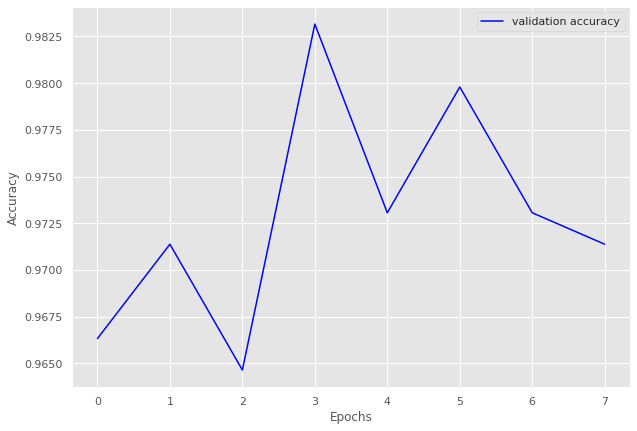

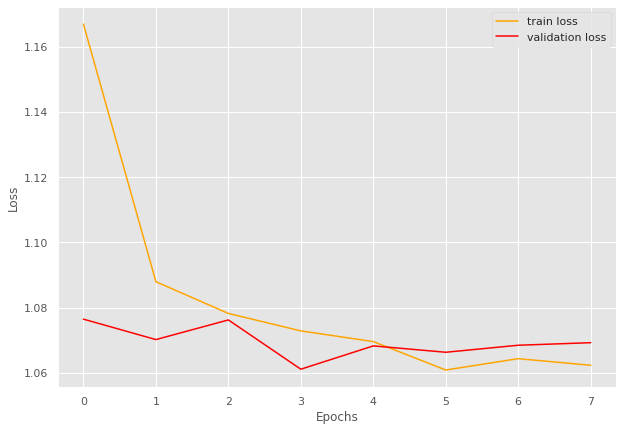

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Done training of a fine model with test accuracy 0.9663255813953489
Coarse label 15 Epoch 1
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.88batch/s, loss=0.897]


train loss 0.8970880470377334, validation loss 0.7960788130760192, validation accuracy 0.9489795918367347
Coarse label 15 Epoch 2
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.95batch/s, loss=0.782]


train loss 0.7816127348453441, validation loss 0.7695570468902588, validation accuracy 0.9795918367346939
Coarse label 15 Epoch 3
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.97batch/s, loss=0.768]


INFO: Early stopping counter 1 of 5
train loss 0.7683040093868336, validation loss 0.7722609996795654, validation accuracy 0.9693877551020408
Coarse label 15 Epoch 4
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.98batch/s, loss=0.763]


INFO: Early stopping counter 2 of 5
train loss 0.7630792412352054, validation loss 0.7808279633522034, validation accuracy 0.9591836734693877
Coarse label 15 Epoch 5
-------------------------------


100%|██████████| 47/47 [00:16<00:00,  2.90batch/s, loss=0.761]


INFO: Early stopping counter 3 of 5
train loss 0.7611189142186591, validation loss 0.7729230165481568, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 6
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.94batch/s, loss=0.772]


INFO: Early stopping counter 4 of 5
train loss 0.7721281254545171, validation loss 0.7800403714179993, validation accuracy 0.9727891156462585
Coarse label 15 Epoch 7
-------------------------------


100%|██████████| 47/47 [00:15<00:00,  2.96batch/s, loss=0.753]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9717407686510927 and loss 0.7714506118070512


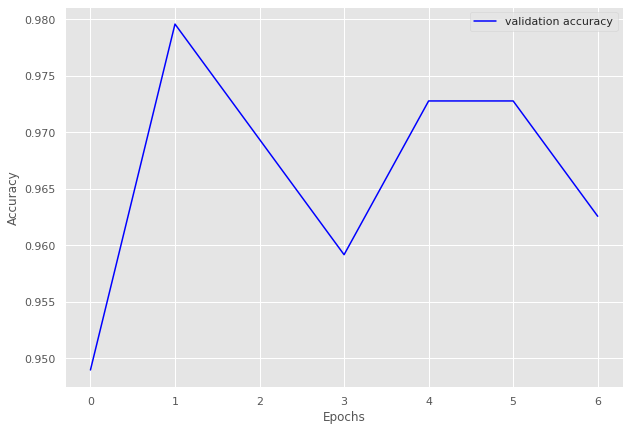

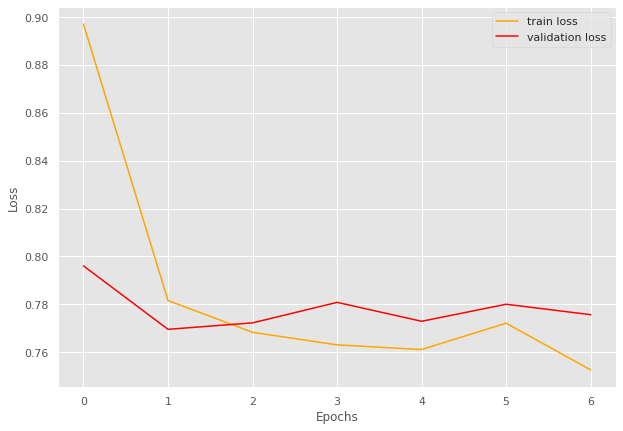

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 16 Epoch 1
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.95batch/s, loss=0.669]


train loss 0.669042174021403, validation loss 0.5894983172416687, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 2
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.98batch/s, loss=0.582]


train loss 0.5816857947243584, validation loss 0.5841174244880676, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 3
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.99batch/s, loss=0.578]


INFO: Early stopping counter 1 of 5
train loss 0.5784693638483683, validation loss 0.5875538468360901, validation accuracy 0.9574468085106383
Coarse label 16 Epoch 4
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.98batch/s, loss=0.574]


INFO: Early stopping counter 2 of 5
train loss 0.573694462246365, validation loss 0.5879202604293823, validation accuracy 0.9645390070921985
Coarse label 16 Epoch 5
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.90batch/s, loss=0.567]


train loss 0.5673490365346273, validation loss 0.5775308966636657, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 6
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.90batch/s, loss=0.563]


train loss 0.5629642486572266, validation loss 0.5759815692901611, validation accuracy 0.975177304964539
Coarse label 16 Epoch 7
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.98batch/s, loss=0.562]


train loss 0.5619910505082872, validation loss 0.5755265235900879, validation accuracy 0.9680851063829787
Coarse label 16 Epoch 8
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.99batch/s, loss=0.56] 


train loss 0.5600464595688714, validation loss 0.5711616635322571, validation accuracy 0.975177304964539
Coarse label 16 Epoch 9
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.95batch/s, loss=0.558]


INFO: Early stopping counter 3 of 5
train loss 0.5582045290205214, validation loss 0.5735076308250427, validation accuracy 0.975177304964539
Coarse label 16 Epoch 10
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.98batch/s, loss=0.558]


INFO: Early stopping counter 4 of 5
train loss 0.5576226711273193, validation loss 0.5756153225898742, validation accuracy 0.9716312056737588
Coarse label 16 Epoch 11
-------------------------------


100%|██████████| 45/45 [00:15<00:00,  2.98batch/s, loss=0.559]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9843014128728415 and loss 0.567947605252266


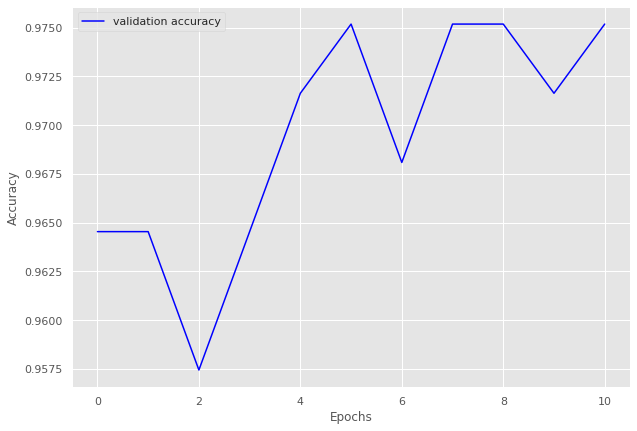

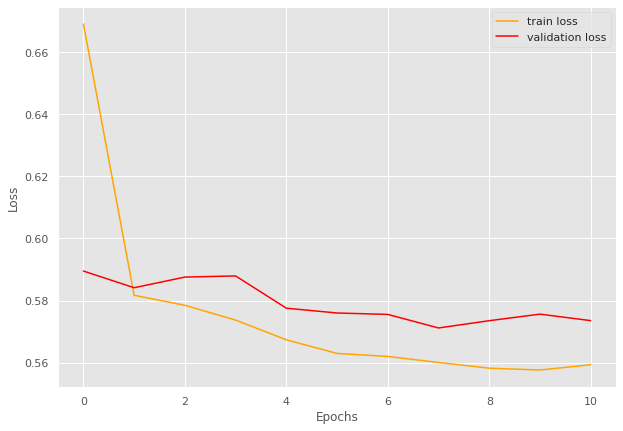

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 17 Epoch 1
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=0.929]


train loss 0.9289350619121474, validation loss 0.8157314896583557, validation accuracy 0.9255663430420712
Coarse label 17 Epoch 2
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=0.794]


train loss 0.7937930420953401, validation loss 0.7956369280815124, validation accuracy 0.948220064724919
Coarse label 17 Epoch 3
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=0.777]


INFO: Early stopping counter 1 of 5
train loss 0.7766303845814296, validation loss 0.7963428616523742, validation accuracy 0.9385113268608414
Coarse label 17 Epoch 4
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.92batch/s, loss=0.771]


train loss 0.77105228876581, validation loss 0.7924533128738404, validation accuracy 0.9546925566343042
Coarse label 17 Epoch 5
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=0.765]


train loss 0.7653283160559985, validation loss 0.7921905755996704, validation accuracy 0.9449838187702265
Coarse label 17 Epoch 6
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.92batch/s, loss=0.757]


INFO: Early stopping counter 2 of 5
train loss 0.7574609007154193, validation loss 0.8000866651535035, validation accuracy 0.948220064724919
Coarse label 17 Epoch 7
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=0.759]


INFO: Early stopping counter 3 of 5
train loss 0.7591852801186698, validation loss 0.7998266458511353, validation accuracy 0.9449838187702265
Coarse label 17 Epoch 8
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.95batch/s, loss=0.756]


train loss 0.756279064684498, validation loss 0.7878187894821167, validation accuracy 0.9579288025889967
Coarse label 17 Epoch 9
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=0.756]


train loss 0.7559127880602466, validation loss 0.7811913847923279, validation accuracy 0.9611650485436893
Coarse label 17 Epoch 10
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.93batch/s, loss=0.753]


train loss 0.7534833088213083, validation loss 0.7770221114158631, validation accuracy 0.9644012944983819
Coarse label 17 Epoch 11
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.94batch/s, loss=0.752]


INFO: Early stopping counter 4 of 5
train loss 0.7521231563723817, validation loss 0.7770646333694458, validation accuracy 0.9676375404530745
Coarse label 17 Epoch 12
-------------------------------


100%|██████████| 49/49 [00:16<00:00,  2.98batch/s, loss=0.755]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9570200573065902 and loss 0.787398633631793


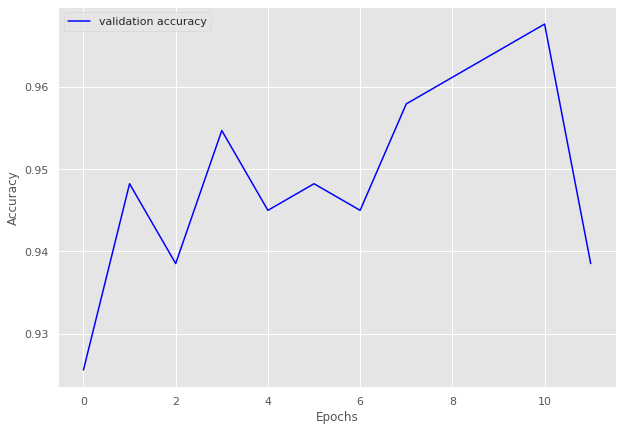

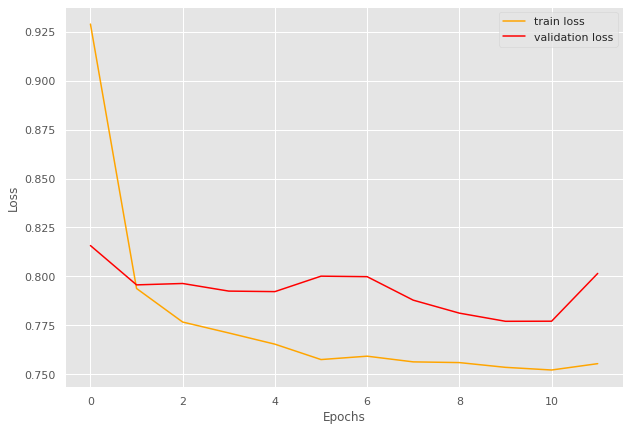

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Coarse label 19 Epoch 1
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  2.98batch/s, loss=1.07]


train loss 1.0672937855124474, validation loss 0.8454485833644867, validation accuracy 0.9375
Coarse label 19 Epoch 2
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.05batch/s, loss=0.802]


train loss 0.8018736727535725, validation loss 0.7814756333827972, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 3
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.07batch/s, loss=0.763]


train loss 0.7630715519189835, validation loss 0.7640990018844604, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 4
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.08batch/s, loss=0.759]


INFO: Early stopping counter 1 of 5
train loss 0.7587049566209316, validation loss 0.7655692994594574, validation accuracy 0.96875
Coarse label 19 Epoch 5
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  2.97batch/s, loss=0.75] 


train loss 0.750364076346159, validation loss 0.7583731412887573, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 6
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.06batch/s, loss=0.757]


INFO: Early stopping counter 2 of 5
train loss 0.7570481151342392, validation loss 0.7612868845462799, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 7
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  2.98batch/s, loss=0.753]


INFO: Early stopping counter 3 of 5
train loss 0.7527787387371063, validation loss 0.7712674140930176, validation accuracy 0.9583333333333334
Coarse label 19 Epoch 8
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.06batch/s, loss=0.759]


INFO: Early stopping counter 4 of 5
train loss 0.7594478726387024, validation loss 0.7637205421924591, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 9
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  3.05batch/s, loss=0.754]


train loss 0.7541103921830654, validation loss 0.7581019997596741, validation accuracy 0.9791666666666666
Coarse label 19 Epoch 10
-------------------------------


100%|██████████| 16/16 [00:05<00:00,  2.98batch/s, loss=0.756]


INFO: Early stopping counter 5 of 5
INFO: Early stopping
Done! Saved model with test accuracy 0.9445701357466063 and loss 0.794714195387704


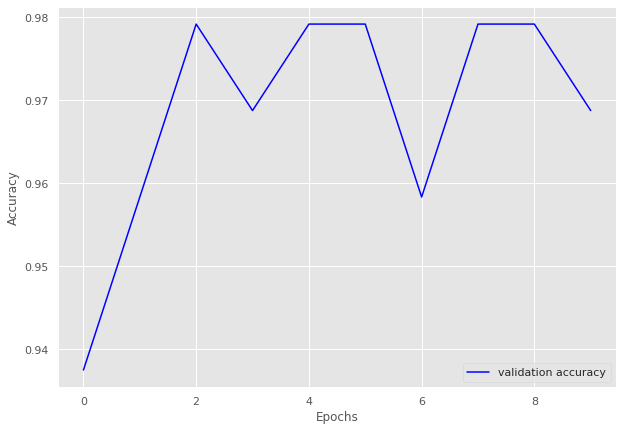

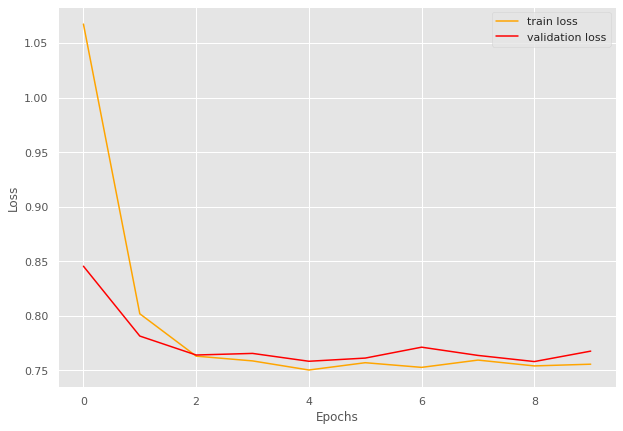

{'0': {'coarse': {}, 'fine': {'15': {'0': 0.9163151449176759, '1': 0.9299781181619255, '2': 0.9183605017776884, '4': 0.9141557703240477, '5': 0.957658321060383, '6': 0.918745275888133, '7': 0.9631595881595881, '8': 0.9039166284928997, '9': 0.912807525325615, '11': 0.9576059850374065, '12': 0.8733694561509131, '13': 0.9011759384893713, '14': 0.947383978717115, '15': 0.9235986435268302, '16': 0.9349407607565995, '17': 0.8990895295902883, '19': 0.829736211031175}, '25': {'0': 0.9396977174583591, '1': 0.9390934844192634, '2': 0.9342305352798054, '4': 0.9358995007247544, '5': 0.9724655819774718, '6': 0.9326195574589579, '7': 0.9669948942377826, '8': 0.9084772166688303, '9': 0.9356359536742851, '11': 0.9752120026092629, '12': 0.9176336746302617, '13': 0.9264291207382722, '14': 0.9558807103764101, '15': 0.9479990956364458, '16': 0.9578327444051825, '17': 0.927128116938951, '19': 0.9245923913043478}, '35': {'0': 0.9494661921708185, '1': 0.9660809154066203, '2': 0.9390350877192982, '4': 0.95669

Evaluating fine model 0
Evaluating fine model 1
Evaluating fine model 2
Evaluating fine model 4
Evaluating fine model 5
Evaluating fine model 6
Evaluating fine model 7
Evaluating fine model 8
Evaluating fine model 9
Evaluating fine model 11
Evaluating fine model 12
Evaluating fine model 13
Evaluating fine model 14
Evaluating fine model 15
Evaluating fine model 16


In [ ]:
for run, seed in enumerate(seeds):
    print('Starting run %s' %run)
    #set manual seed
    torch.manual_seed(seed)
    np.random.seed(seed)

    accuracies['%s' %run] = {'coarse':{}, 'fine':{}, 'whole':{}}

    #load clusters data
    tasksim_clusters = pickle.load(open(teamdrive_root +'icons_experiment/generated_clusters/rf_tasksim_clusters_00_2.p', 'rb'))
    fine_to_coarse, coarse_to_fine = create_label_dictionaries(tasksim_clusters)
    print(coarse_to_fine)

    number_of_clusters = len(coarse_to_fine.keys())
    stacked_fine_labels = []
    for i in range(0, number_of_clusters):
        stacked_fine_labels +=coarse_to_fine[i]

    for volume in volumes:
        print('Calculating for volume %s' %volume)

        #prepare data
        train_df = df[df['%s_%s' %(volume, run)] == 'train']
        test_df = df[df['%s_%s' %(volume, run)] == 'test']
        valid_df = df[df['%s_%s' %(volume, run)] == 'valid']

        # prepare dataloaders
        batch_size = 64
        epochs= 40

        test_dataset = IconDataset(test_df, test_transform, "")
        train_dataset = IconDataset(train_df, train_transform, "")
        validation_dataset = IconDataset(valid_df, test_transform, "")

        dl_train = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
        dl_test = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
        dl_valid = DataLoader(validation_dataset, batch_size=batch_size, shuffle=False)

        # train coarse model 
        print('Start training a coarse model')
        gc.collect() 
        torch.cuda.empty_cache()
        #Load fine tuned model 
        model = Resnext50(number_of_clusters, name="coarse_model_Resnext50_icons_volume_%s_%s" %(volume, run))
        model.state_dict(torch.load(fine_tuned_model_path))
        optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
        model.to(device)
        loss_fn = torch.nn.CrossEntropyLoss().to(device)

        test_accuracy =train_and_validate(epochs, model, loss_fn, optimizer, 
                                                            dl_train, dl_test, dl_valid,
                                                            mode="coarse", fine_to_coarse=fine_to_coarse,
                                                            model_path = teamdrive_root+'models/hierarchical/%s.pth' %model.name )
        accuracies['%s' %run]['coarse']['%s' %volume] = test_accuracy
        with open(teamdrive_root + 'icons_experiment/volume_hierarchical_accuracies_2.p', 'wb') as handle:
            pickle.dump(accuracies, handle)
        print("Done training of a coarse model with test accuracy %s" %test_accuracy)

        #fine classifiers training
        accuracies['%s' %run]['fine']['%s' % volume] = {}
        for coarse_label in range(0, number_of_clusters):
            if len(coarse_to_fine[coarse_label])>1:
                gc.collect() 
                torch.cuda.empty_cache()
                dl_train, dl_valid, dl_test =  filter_data(train_dataset, test_dataset, validation_dataset, 
                                                           filter_by_coarse=True, coarse_label=coarse_label, 
                                                           coarse_to_fine=coarse_to_fine, batch_size=batch_size)

                # Initialize the model
                #Load fine tuned model
                model = Resnext50(len(coarse_to_fine[coarse_label]),name="fine_model_coarse_label_%s_icons_volume_%s_%s" %(coarse_label,volume, run))
                model.state_dict(torch.load(fine_tuned_model_path))
                optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)             
                model.to(device)
                loss_fn = torch.nn.CrossEntropyLoss().to(device)
                test_accuracy =train_and_validate(epochs, model, loss_fn, optimizer,
                                                  dl_train, dl_test, dl_valid, 
                                                  mode="fine", coarse_label=coarse_label,
                                                  lookup=coarse_to_fine[coarse_label],
                                                  model_path = teamdrive_root+'models/hierarchical/%s.pth' %model.name )
                accuracies['%s' %run]['fine']['%s' %volume]['%s' %coarse_label] = test_accuracy
                with open(teamdrive_root + 'icons_experiment/volume_hierarchical_accuracies_2.p', 'wb') as handle:
                    pickle.dump(accuracies, handle)
                print("Done training of a fine model with test accuracy %s" %test_accuracy)

        #whole model evaluation
        print('Starting model evaluation...')
        dl_test = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

        #loading models
        gc.collect() 
        torch.cuda.empty_cache()
        model_coarse = torch.load(teamdrive_root+'models/hierarchical/coarse_model_Resnext50_icons_volume_%s_%s.pth' %(volume, run))
        fine_models = {}
        for i in range(0,number_of_clusters):
            if len(coarse_to_fine[i])>1:
                fine_models['fine_model_' + str(i)] = torch.load(teamdrive_root+'models/hierarchical/fine_model_coarse_label_%s_icons_volume_%s_%s.pth' %(i, volume, run))

        coarse_predicts = []
        targets = []
        model_coarse.to(device)
        model_coarse.eval()
        for counter, (images, labels) in enumerate(dl_test):
            imageGPU = images.to(device)
            outputs = torch.Tensor.cpu(model_coarse(imageGPU))
            coarse_predicts.append(outputs.detach().numpy())
            targets.append(labels)
        targets = np.hstack(targets)  


        #reformat coarse prediction
        coarse_prediction = np.vstack(coarse_predicts)
        column_num = 0
        for i in range(0, number_of_clusters):
            cluster_len = len(coarse_to_fine[i])
            for rep in range(cluster_len-1):
                coarse_prediction = np.insert(coarse_prediction, column_num, coarse_prediction[:,column_num], axis=1)
            column_num +=cluster_len
        fine_prediction= []

        for i in range(0,number_of_clusters):
            gc.collect() 
            torch.cuda.empty_cache()
            if len(coarse_to_fine[i]) == 1:
                fine_prediction.append(np.ones((len(coarse_prediction),1)))
            else:
                predicts = []
                print("Evaluating fine model %s" %i)
                fine_model = fine_models['fine_model_%s' %i]
                fine_model.to(device)
                fine_model.eval()
                for counter, (images, labels) in enumerate(dl_test):
                    imageGPU = images.to(device)
                    outputs = torch.Tensor.cpu(fine_model(imageGPU))
                    predicts.append(outputs.detach().numpy())   
                predicts = np.vstack(predicts)
                fine_prediction.append(predicts)                          

        #reformat fine_prediction
        fine_prediction = np.hstack(fine_prediction)
        result = np.multiply(fine_prediction, coarse_prediction)
        result = np.argmax(result, axis=1)
        result_decoded = [stacked_fine_labels[i] for i in result]   
        final_acc = accuracy_score(targets, result_decoded) 
        print("overall accuracy  is %s" %final_acc)
        accuracies['%s' %run]['whole']['%s' %volume] = final_acc
        with open(teamdrive_root + 'icons_experiment/volume_hierarchical_accuracies_2.p', 'wb') as handle:
            pickle.dump(accuracies, handle)




In [14]:
accuracies

{'0': {'coarse': {},
  'fine': {'15': {'0': 0.9163151449176759,
    '1': 0.9299781181619255,
    '2': 0.9183605017776884,
    '4': 0.9141557703240477,
    '5': 0.957658321060383,
    '6': 0.918745275888133,
    '7': 0.9631595881595881,
    '8': 0.9039166284928997,
    '9': 0.912807525325615,
    '11': 0.9576059850374065,
    '12': 0.8733694561509131,
    '13': 0.9011759384893713,
    '14': 0.947383978717115,
    '15': 0.9235986435268302,
    '16': 0.9349407607565995,
    '17': 0.8990895295902883,
    '19': 0.829736211031175},
   '25': {'0': 0.9396977174583591,
    '1': 0.9390934844192634,
    '2': 0.9342305352798054,
    '4': 0.9358995007247544,
    '5': 0.9724655819774718,
    '6': 0.9326195574589579,
    '7': 0.9669948942377826,
    '8': 0.9084772166688303,
    '9': 0.9356359536742851,
    '11': 0.9752120026092629,
    '12': 0.9176336746302617,
    '13': 0.9264291207382722,
    '14': 0.9558807103764101,
    '15': 0.9479990956364458,
    '16': 0.9578327444051825,
    '17': 0.927128116